In [27]:
#in this notebook we will be using gurobi to solve Random Linear Programs
#we first have to install gurobi
%pip install KDEpy
!pip install gurobipy>=10


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [300]:
import gurobipy as gp
from gurobipy import *
import pandas as pd
import numpy as np
import math
import random
import matplotlib.pyplot as plt
import statistics
from scipy.stats import norm
from KDEpy import FFTKDE
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split



In [30]:
#first we define the method to generate the b matrix
def construct_b(m):
    
    b_matrix = np.random.uniform(-1.0, high=1.0, size=(m))
    return b_matrix
    
def check_b(b_matrix, n):
    #we find b-
    b_minus=[]
    for i in range(len(b_matrix)):
        b_minus.append(max(0, -1*b_matrix[i]))
    
    #find ||b-||2 and regenerate b whenever it does not fullfill
    absolute_b = math.sqrt(sum(b_minus) ** 2)
    returning = False
    if(absolute_b <= (n/10)):
        return True
    else:
        for i in range(len(b_matrix)):
            if(b_matrix[i]<0):
                b_matrix[i] = np.random.uniform(-1.0,1.0)
        check_b(b_matrix, n)
        return False

In [31]:
#Now we want to generate the A and c matrices, we dont do this with the b matrix, since the b stays in the loop
#We generate A and c using Normal(0,1) distributions.
def generate_A(m,n):
    A_matrix = np.random.normal(loc=0.0, scale=1.0, size=(m,n))
    return A_matrix

def generate_c(n):
    c_matrix = np.random.normal(loc=0.0, scale=1.0, size=(n))
    return c_matrix    

In [32]:
#now we want to generate our program using gorubi
def linear_program(A, b, c, relaxed):
    
    solution = []
    
    try:
        m = gp.Model('ILP')
        #set printing to nothing to make sure the file does not become too large.
        m.setParam('OutputFlag', 0)
        #add variable
        if(relaxed):
            x = m.addMVar(shape=len(c), lb=0.0, ub=1.0, vtype=GRB.CONTINUOUS, name="x")
        else:
            x = m.addMVar(shape=len(c), vtype=GRB.BINARY, name="x")

        # Set objective
        m.setObjective(c @ x, GRB.MAXIMIZE)

        #now we need to set the constraints
        m.addConstr(A@x <= b)

        # Optimize model
        m.optimize()
        
        solution = m.ObjVal
        
        print(x.X)
        print('Obj: %g' % m.ObjVal)

    except gp.GurobiError as e:
        print('Error code ' + str(e.errno) + ": " + str(e))

    except AttributeError:
        print('Encountered an attribute error')
    if(solution==[]):
        return 0
    else:
        return solution

In [33]:
#now we want to make a loop where we try multiple A and c matrices
def the_loop(m,n,trials):
    
    IPGAP = []
    b = construct_b(m)
    check_b(b, n)
    
    for i in range(trials):
        A = generate_A(m, n)
        c = generate_c(n)
        
        #find the integrality gaps and keep when both the LP and its relaxation find a solution.
        original_LP = linear_program(A, b, c, False)
        if not (original_LP==0):
            relaxed_LP = linear_program(A, b, c, True)
            print(str(relaxed_LP) + ' relaxed ')
            print(str(original_LP) + ' original ')
            IPGAP.append(relaxed_LP - original_LP)

    return IPGAP

In [154]:
#find empirical distribution function
def process(data):
    x = np.sort(data)
    n = x.size
    y = np.arange(1, n+1) / n
    plt.scatter(x=x, y=y, s = 4);
    plt.xlabel('Integrality gap', fontsize=15)
    plt.ylabel('cumulative probability', fontsize=15)
    print('mean: ' + str(statistics.mean(data)))
    print('median: ' + str(statistics.median(data)))
    print('standard deviation:' + str(np.std(data)))
    plt.axvline(x = statistics.mean(data), color = 'b', label = 'axvline - full height')
    plt.show

In [393]:
#find kernel density estimator.
def kernelDensity(data):
    x, y = FFTKDE(kernel='gaussian', bw='silverman').fit(data).evaluate()
    plt.plot(x, y, label='KDE /w silverman')
    y = FFTKDE(kernel='gaussian', bw='ISJ').fit(data).evaluate(x)
    plt.plot(x, y, label='KDE /w ISJ')
    plt.xlabel('Integrality gap', fontsize=15)
    plt.ylabel('density', fontsize=15)
    plt.legend()

In [156]:
data = the_loop(20,50,10000)

[0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0.
 0. 0.]
Obj: 6.78206
[0.         0.         1.         0.82953673 1.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         0.72393085 0.
 0.         0.         0.         0.         0.89241572 0.
 0.         1.         0.42309462 1.         0.61286881 1.
 0.00694091 0.         0.01308188 0.         0.87634028 0.36146368
 1.         1.         0.53280346 0.54990695 0.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.        ]
Obj: 10.6484
10.648432714682585 relaxed 
6.782056256665378 original 
[ 0.  1. -0. -0. -0. -0.  1.  0.  1.  1.  1. -0.  1. -0. -0. -0.  0.  1.
  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.
 -0.  1. -0.  1.  1. -0. -0.  0. -0. -0. -0.  1. -0.  1.]
Obj: 5.45239
[0.38808586 1.         0.         0.5956935

[-0. -0. -0. -0. -0. -0. -0.  0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.]
Obj: 9.91864
[1.         0.         0.         0.27236625 0.         0.22614802
 0.2406987  0.         1.         1.         1.         0.
 0.         1.         0.62412271 1.         0.73691136 1.
 1.         0.         0.54039665 0.42025128 0.73718873 1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.17828874 1.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.09881846 0.22905984 1.         0.
 1.         0.        ]
Obj: 12.6207
12.620718065901707 relaxed 
9.9186395679359 original 
[ 1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  0.  1. -0. -0.  0.  1.
 -0.  1. -0.  1. -0. -0. -0.  0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.
 -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 9.8

[ 0. -0.  1.  1.  0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.
  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  0. -0.
 -0.  1. -0.  1. -0.  1. -0. -0.  1.  0. -0. -0.  0. -0.]
Obj: 9.6503
[0.65474759 0.         0.76169953 0.5504607  0.27263636 0.
 1.         1.         1.         1.         0.81128911 0.
 0.41870625 0.         0.         1.         1.         1.
 0.78044076 1.         0.         0.84486467 1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.44914592 0.         0.
 0.         0.        ]
Obj: 11.6302
11.630198613375047 relaxed 
9.650298312711685 original 
[-0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  0.  0.  0.  1.  1.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0.  1.  1.  0. -0.  1.  1.  1.  0.  0. -0.  1.  0.]
Obj: 15.851
[0.

[-0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.]
Obj: 7.14499
[0.         0.         0.         0.         0.         0.53872562
 0.1209227  0.         0.50925103 0.         1.         0.63522786
 1.         0.07705869 0.         0.93756819 0.         0.
 0.         0.         0.         0.80269454 1.         1.
 0.         0.         0.         0.         0.         0.7197153
 1.         0.         0.69832024 1.         0.         0.
 0.         1.         0.25881705 0.         0.         0.
 0.         0.         1.         1.         0.         0.04707406
 1.         0.        ]
Obj: 14.1304
14.130402490528725 relaxed 
7.144990085890034 original 
[-0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.
 -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. 

[ 1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.
 -0.  0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.
 -0.  1.  1.  1.  1. -0. -0.  0. -0.  1.  1. -0.  0. -0.]
Obj: 12.2751
[0.20889935 0.32808467 0.56218335 1.         1.         0.19044429
 0.         0.02266952 1.         0.         1.         0.75555441
 0.         0.         0.00806758 0.71659429 1.         0.
 0.         0.26026574 0.         1.         1.         0.
 0.         0.76523892 0.30516925 1.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.50127738 0.         0.         1.         1.
 0.00470182 0.        ]
Obj: 14.3257
14.325724114841096 relaxed 
12.275140811694497 original 
[-0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1

[-0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  0.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 11.6569
[0.         0.39211597 0.         0.35731494 0.58088096 0.
 0.         0.         1.         0.         1.         0.63959576
 0.         1.         0.         1.         0.         1.
 0.         1.         0.24805198 1.         1.         0.
 0.15397856 0.         0.         0.         1.         1.
 0.74580098 0.         0.         1.         1.         0.
 0.         0.         0.36520861 0.         1.         1.
 0.14441527 1.         0.67304396 1.         1.         0.27462966
 0.         0.        ]
Obj: 15.4268
15.426847851920657 relaxed 
11.656942032469553 original 
[-0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0

[ 1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
 -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: 13.1257
[1.         0.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 0.0563913  0.58403569 0.         0.         0.18031551 0.76752352
 0.71844197 1.         0.         0.99496152 0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.43324868 1.         0.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.        ]
Obj: 14.9408
14.94082539755234 relaxed 
13.125653504889799 original 
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1.
 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1.
 0. 0.]
Obj: 12.7545
[1.         0.         0.18730493 0.       

[-0. -0.  1.  1.  0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  0.  1.  1. -0.  0. -0. -0.  1. -0. -0.  1. -0.
  1.  1. -0. -0. -0. -0.  1. -0.  0. -0. -0.  1. -0.  1.]
Obj: 5.50368
[0.         0.         0.66135629 0.86879623 0.         1.
 0.         0.         0.15776479 0.         1.         1.
 0.         0.         0.         0.         0.14412042 0.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.35470334 0.         0.74071753 0.
 0.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.24859825 0.
 0.         0.         0.         0.74632866 0.         0.
 0.         1.        ]
Obj: 7.48794
7.4879423207797275 relaxed 
5.503681634782011 original 
[-0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.
 -0.  1.  0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1.]
Obj: 12.9745
[

[ 1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  0.  1. -0.  0.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0.  1. -0.  0. -0. -0.  1.  1.  1.  1. -0.  0.  0.]
Obj: 11.5306
[1.         0.         0.15401405 0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         0.4640046  0.75409623 0.
 0.         1.         0.15375853 0.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.26119216 1.         0.76047396 1.         0.
 0.67324107 1.         0.74440902 1.         1.         0.
 1.         0.        ]
Obj: 14.148
14.147977486520496 relaxed 
11.53058644284155 original 
[-0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.]
Obj: 7.36831
[0

[-0.  0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.
 -0.  1.  1. -0. -0.  1.  1. -0.  0.  0. -0.  1.  1.  1. -0.  1. -0.  1.
 -0. -0.  1. -0. -0. -0.  0.  1. -0.  1. -0.  1. -0.  0.]
Obj: 18.7919
[0.         0.53253579 0.18581396 0.12890552 0.71446816 1.
 0.25247553 1.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.37228844 1.         1.         0.         0.         1.
 1.         0.         1.         0.24400636 0.         1.
 1.         0.55016354 0.01427494 1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.7195565  1.         0.17987505 1.         0.         1.
 0.         0.01631966]
Obj: 22.1471
22.147085034746556 relaxed 
18.791859125501304 original 
[-0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.]
Obj: 10.5164


[-0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.
 -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.]
Obj: 4.98452
[0.         0.         1.         1.         0.         0.12764838
 0.         0.89764819 1.         0.         1.         0.85041847
 0.18538992 0.         0.         0.23811946 1.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.3453583  0.31483775 0.         0.         0.
 0.         0.         1.         0.         0.48775875 1.
 0.         0.         0.         0.69119457 0.         0.
 1.         0.        ]
Obj: 10.6904
10.690447814161402 relaxed 
4.984524305367253 original 
[-0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0.  0.  1.  1. -0.  1. -0.  1.  0.  1.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.

[ 1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  0. -0. -0.  1.
 -0.  1.  1.  1.  1.  0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.
 -0.  0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.]
Obj: 10.6382
[1.         0.         0.         1.         1.         1.
 0.75112213 0.         0.         0.         0.         0.
 0.51092045 1.         0.         0.         0.         1.
 0.         0.28621872 1.         0.99036223 1.         0.95937565
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         0.         0.7355653  0.19584516
 1.         0.         0.92271594 1.         0.         1.
 0.43568228 0.         0.         1.         0.60589329 0.0704852
 1.         0.        ]
Obj: 14.631
14.630970546674954 relaxed 
10.63820295095992 original 
[-0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  0.  0.  1. -0. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  0. -0.  0. -0.  1.  1. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -

[ 1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.
 -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.]
Obj: 10.9168
[1.         1.         0.         0.63251369 1.         1.
 0.         1.         0.46313258 0.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         0.33799794 1.
 1.         0.         0.98670671 0.92052453 0.         1.
 0.         0.         0.36989157 0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.38547864 1.         0.         1.         0.82319812
 0.33119359 1.        ]
Obj: 12.172
12.17204631067496 relaxed 
10.916814979506318 original 
[1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0.
 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1.
 0. 0.]
Obj: 3.83754
[1.         0.         0.         1.        

[ 1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 7.35767
[1.         0.         1.         1.         1.         0.72333818
 0.95133921 0.21832091 0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.99546961 0.         0.         0.         0.         0.
 1.         0.         0.24664003 0.         0.         1.
 0.         0.         1.         0.         0.         0.77340142
 0.         0.10542662 1.         0.75953607 0.08567942 1.
 0.         1.         0.72046289 1.         0.         0.
 0.         0.        ]
Obj: 9.4883
9.488302779902224 relaxed 
7.357665993293874 original 
[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.
  1.  0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  0. -0.]


[-0. -0. -0.  1. -0.  0.  1.  0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.
 -0.  0.  1. -0. -0.  1. -0.  0. -0.  1. -0. -0. -0. -0.  1.  0.  0. -0.
  1. -0.  1. -0. -0. -0. -0.  1.  0. -0. -0.  1.  0. -0.]
Obj: 4.02122
[0.19201831 0.         0.         0.49007763 0.         0.40936861
 1.         0.         1.         1.         0.         0.
 0.         0.3286946  0.         0.         0.         1.
 0.         1.         1.         0.         0.         0.25834129
 0.         0.         0.         1.         0.         0.
 0.         0.08609294 1.         0.49219612 0.         0.
 1.         0.         1.         0.26836715 0.         0.
 0.         0.96830078 0.53303757 0.         0.         1.
 0.         0.        ]
Obj: 6.18386
6.18385500896718 relaxed 
4.02121688262089 original 
[-0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.]
O

 1.         1.        ]
Obj: 26.437
26.43696528179428 relaxed 
24.838773431913058 original 
[-0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  0.  1.  1.  1.  1. -0.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  0.  1.  1.  1. -0. -0.  1. -0.  1.
  0. -0.  0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.]
Obj: 9.83041
[0.         0.         0.29008471 0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.8304457  0.34988357 1.         1.         1.         0.
 0.6605491  1.         0.         0.         0.         0.
 0.36997183 0.         1.         0.01141294 1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.3987499  0.88427396 0.3469038  0.
 1.         0.61958511 0.63748235 0.         0.         1.
 0.         1.        ]
Obj: 11.5762
11.57620005902914 relaxed 
9.8304148080852 original 
[-0.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  0.  1.  0. -0.  1. -0. -0.
 -0.  1.  1. -0.  0.  0. -0.  1.  1.  0.  1. -0.  1.  1.

[ 1.  1. -0.  1. -0.  0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 9.96987
[0.11280504 0.24625671 0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         0.67081968
 0.         0.         0.01765863 0.         0.         1.
 0.         0.         0.93645028 1.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.29095206 0.         0.17309326 0.
 0.         0.         1.         0.16546351 0.20213515 1.
 0.         0.13923864]
Obj: 11.9598
11.959770943398686 relaxed 
9.969869692738836 original 
[-0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.
  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.]
Obj: 9

[ 1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.
 -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
 -0.  1.  0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  0.]
Obj: 15.4551
[0.56815792 0.02105053 1.         1.         0.98387784 1.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.34859171 0.         0.40393987 0.
 1.         0.         0.63968422 1.         0.         0.
 0.         1.         0.         1.         1.         0.9095472
 0.         0.         1.         0.18277799 0.31182813 0.
 1.         0.        ]
Obj: 18.9201
18.920098574898176 relaxed 
15.455081419958555 original 
[ 1.  1. -0.  0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.
 -0.  0. -0.  1.  0. -0.  1.  1.  1.  1.  0. -0.  1. -0.  1.  1.  1.  1.
  1.  0.  1. -0.  0.  0.  1. -0.  0. -0.  1.  1.  1.  1.]
Obj: 1

[-0.  1.  1. -0.  1.  0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  0.  1. -0.
 -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 10.3061
[0.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.83268222 0.         0.         0.47350315 0.
 0.53877363 0.         1.         0.         0.         0.
 0.33518212 0.         1.         0.57488378 1.         0.
 1.         1.         0.56251645 0.         0.         0.
 0.         0.77974717 1.         0.         1.         0.71482994
 0.66505218 0.         0.         0.23268657 0.         0.04599463
 0.51421379 1.        ]
Obj: 13.8824
13.882365280158126 relaxed 
10.306145611088763 original 
[ 1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0. -0.  0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  0.
  0. -0.  1. -0. -0. -0.  1.  0.  1.  1.  1.  1. -0. -0

[ 1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.
  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.
 -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.]
Obj: 10.4131
[0.         0.         0.98228873 0.50736298 1.         0.
 0.         1.         0.         0.         1.         0.2510628
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         0.         0.69180281
 0.         0.33564806 1.         1.         1.         0.
 0.58398342 1.         0.         1.         0.         0.
 1.         0.75482061 0.         0.         0.         0.35052536
 1.         1.        ]
Obj: 11.7203
11.720310000979916 relaxed 
10.413061888538929 original 
[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0.
 0. 0.]
Obj: -0.512472
[0.         0.         0.

[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.]
Obj: 7.78009
[0.17348353 0.60177121 1.         0.         0.         0.
 0.         0.2672509  0.42995338 1.         1.         0.
 0.95678998 1.         0.         0.         0.5007737  1.
 0.         0.         0.61370116 0.         0.         1.
 0.         0.         0.12558336 0.         0.         0.
 1.         0.         0.         1.         1.         0.35282916
 0.2186495  0.         0.         0.66704579 1.         0.
 0.         0.43190417 0.         0.15373911 0.         0.38947796
 0.         1.        ]
Obj: 12.9874
12.987381946921523 relaxed 
7.7800866077624145 original 
[1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1.
 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0.
 0. 0.]
Obj: 4.41502
[1.         0.         0.95857386 

[ 1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.]
Obj: 6.70963
[1.         1.         0.         0.         1.         1.
 0.         0.         0.         0.62033145 1.         0.
 0.         0.04334542 0.45325336 0.         0.         0.
 0.         0.         1.         0.00236679 1.         0.1798056
 0.         0.19571101 0.42315582 1.         0.         0.
 0.         0.         1.         0.68837751 0.81627282 1.
 0.         0.         0.         0.         0.         1.
 0.27066915 0.         1.         1.         0.         0.
 1.         0.        ]
Obj: 10.0759
10.07587193625499 relaxed 
6.709631809809793 original 
[-0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.]
Obj: 6.8

[-0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.
  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.]
Obj: 2.47054
[0.         1.         0.         1.         0.43303268 0.30686941
 0.         0.         0.41075065 0.         0.49413176 0.
 0.         1.         1.         0.53839487 0.         0.2203311
 1.         0.         0.         0.         0.         1.
 0.63955695 1.         0.69260803 0.         1.         0.
 0.         0.         0.44971938 0.         0.         1.
 0.89386991 0.         0.         1.         0.95587308 0.
 1.         0.         0.         1.         0.77224187 0.
 0.         0.        ]
Obj: 5.96604
5.966038121933415 relaxed 
2.470536341071874 original 
[-0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1.  1.  0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.]


[-0. -0. -0. -0.  0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  0.  1.
 -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  0. -0. -0. -0. -0.  1. -0.
 -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.]
Obj: 10.9128
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 1.90799175e-01
 7.21936704e-01 1.00000000e+00 1.00000000e+00 0.00000000e+00
 1.68153928e-01 4.69312805e-01 0.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00 0.00000000e+00 5.74714505e-02
 1.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 8.69957727e-01 1.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 2.45014429e-01 4.92684829e-01
 0.00000000e+00 0.00000000e+00 1.00000000e+00 1.51060860e-02
 0.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 0.00000000e+00 2.50412487e-04 0.00000000e+00 7.63861772e-01
 0.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00]
Obj: 15.6554
15.655

[1.         0.22922559 0.         0.         0.         0.
 0.2063968  0.         0.         0.24077058 0.         1.
 0.82063735 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.96969792 1.
 0.68068081 1.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.24363286 0.44751577 0.         0.         0.
 0.30261067 0.80195886]
Obj: 12.3998
12.399828000659484 relaxed 
9.03341253063981 original 
[-0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
 -0.  1.  1.  0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.]
Obj: 8.76317
[0.         0.         1.         0.         0.         0.
 0.         0.         0.78012087 0.         1.         0.09085611
 0.         0.         1.         1.         0.         0.
 0.         1.         0.         

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0.
 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1.]
Obj: 0.784953
[0.         0.         0.         0.         0.         1.
 0.63078028 0.14052215 0.         0.         1.         0.37511738
 0.73257077 0.09549606 0.         0.         0.         0.
 1.         0.         1.         0.         0.68067965 0.
 0.69314925 0.         1.         0.         0.78300601 0.
 1.         0.66032811 0.70179249 0.         0.         0.
 1.         0.         0.36373253 1.         0.         0.
 0.48881374 1.         0.         0.         0.         1.
 0.09422842 1.        ]
Obj: 7.08861
7.088612205201709 relaxed 
0.7849528806054344 original 
[ 0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.
 -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  0. -0.]
Obj: 12.7529
[0.         0.         0.         1.      

[-0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0.  0. -0. -0. -0. -0.  1.  1. -0.  0.  1. -0. -0. -0.  0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.]
Obj: 7.95221
[1.         0.         0.         1.         0.82525875 0.
 0.43245363 1.         1.         1.         0.40077706 0.
 0.         0.         0.03278906 0.         0.         0.20647308
 0.         0.         1.         0.         0.23536832 0.
 0.         0.         0.         0.35642295 1.         0.
 0.13102514 0.15827084 0.         0.         1.         0.
 0.         0.         0.02599488 1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.15127628 1.        ]
Obj: 13.6195
13.619509810911607 relaxed 
7.952212576019373 original 
[-0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  0.  1. -0. -0.
  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.]
Obj: 2

[-0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0.  1. -0.  0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  0. -0. -0.  1.  1.  1.  1.  1. -0.]
Obj: 8.81669
[0.         0.46337436 0.         0.         0.1402912  0.
 0.25120104 1.         0.         1.         0.11474004 1.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         0.63086621 0.         0.
 0.2148878  1.         0.82378969 0.         0.         0.
 0.         1.         0.52848544 0.         0.         0.
 1.         0.         1.         1.         1.         0.40854583
 0.         0.         1.         1.         0.76857792 1.
 1.         0.29898031]
Obj: 10.734
10.733984481638059 relaxed 
8.81668763701076 original 
[-0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 6.0

[1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0.
 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1.
 1. 0.]
Obj: 10.1294
[0.71025774 0.99713991 1.         0.61907184 0.         1.
 0.         0.         0.         1.         1.         0.13971802
 0.49130132 1.         0.         0.         0.         1.
 1.         1.         0.96268581 0.         0.         0.
 0.78357792 0.         0.         1.         1.         0.24403283
 0.16766311 1.         0.         1.         1.         0.88733719
 0.77766835 0.04321431 1.         0.         0.37694969 1.
 0.         0.         0.         0.         1.         1.
 0.47326145 0.        ]
Obj: 14.1335
14.13347801324651 relaxed 
10.129394046112369 original 
[ 1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  0.  1. -0.  1. -0. -0. -0.  1.
  0. -0. -0. -0. -0.  0. -0.  1.  1.  1. -0.  0.  1.  1. -0. -0. -0. -0.
 -0. -0.  0.  1. -0.  0. -0. -0. -0. -0.  1.  0. -0.  1.]
Obj: 7.6655
[0.40281691 0.         0.   

[-0. -0. -0.  1.  1. -0.  0. -0. -0.  1.  0. -0. -0.  1.  1.  1.  1. -0.
  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.]
Obj: 12.5431
[1.         0.         0.         0.65928593 0.76484161 0.
 0.71524628 0.         0.         0.469917   1.         0.
 0.         1.         1.         1.         1.         0.06812752
 0.66469065 0.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.01827734 0.3191155  0.         0.         1.
 1.         0.         0.         0.         0.81675852 1.
 1.         0.         1.         0.         1.         0.
 1.         1.        ]
Obj: 14.442
14.442024180118695 relaxed 
12.543143779666519 original 
[1. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1.
 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0.
 1. 1.]
Obj: 15.3438
[1.         0.         1.         0.4560555

[ 1.  1. -0. -0. -0. -0. -0.  1.  0.  0.  1.  1.  1. -0.  0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0.  0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.
  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.]
Obj: 8.72461
[1.00000000e+00 4.99263912e-01 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 7.80030421e-01 0.00000000e+00 1.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 6.37696785e-02 0.00000000e+00 6.70530796e-01 0.00000000e+00
 1.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 8.31527471e-05 1.00000000e+00 0.00000000e+00 1.00000000e+00
 1.74998387e-01 0.00000000e+00 0.00000000e+00 4.09495353e-01
 0.00000000e+00 0.00000000e+00 1.00000000e+00 2.10657092e-04
 1.00000000e+00 1.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00 2.09878614e-01 1.00000000e+00
 9.47397221e-02 7.86293661e-02]
Obj: 10.9534
10.953

 -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 12.6259
[0.         0.         0.64999533 0.22650212 0.         1.
 0.         0.         0.         1.         0.         0.
 1.         0.8015252  0.         1.         1.         1.
 1.         0.24813301 1.         0.78515698 0.         0.14435931
 0.         1.         1.         1.         0.71186648 0.
 1.         1.         1.         1.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.         0.         1.         0.         0.65240335 0.
 0.8513701  0.        ]
Obj: 13.9406
13.940595909797059 relaxed 
12.625863467733847 original 
[-0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.
 -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.
 -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.]
Obj: 10.8386
[0.         0.         1.         0.51491333 0.         0.
 0.2106778  1.         0.         1.         1.         1.
 1.         1.      

[0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0.
 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1.
 0. 1.]
Obj: 7.56806
[0.         0.         0.         1.         0.84120595 0.
 1.         0.         0.         0.         1.         0.94646937
 0.07951201 0.         1.         0.         1.         0.03182302
 0.         1.         0.         0.         1.         0.3409085
 0.         0.         0.21668071 0.         1.         0.38995071
 0.31182498 1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.78751966 1.         0.         1.
 0.         1.        ]
Obj: 10.2061
10.2060966195193 relaxed 
7.568063294145333 original 
[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.]
Obj: 12.4052
[9.82809965e-01 0.0000

[1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0.
 1. 0.]
Obj: 13.2438
[1.         1.         1.         0.34680556 0.         0.06000814
 1.         0.         0.         1.         0.         1.
 0.74565563 0.04661488 1.         0.17807319 1.         1.
 0.06869739 0.         1.         0.         1.         0.
 0.07992134 0.         0.7502593  1.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.29209474 1.         1.         0.         1.         0.
 0.         0.        ]
Obj: 14.9658
14.965785564576235 relaxed 
13.243764548743329 original 
[ 1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.
  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.]
Obj: 13.1654
[1.         0.         1.         0.      

[ 0.  0.  1.  0.  1. -0.  1.  1.  0. -0.  1.  1.  1.  0. -0.  1. -0. -0.
  1.  0. -0. -0. -0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.
  0. -0. -0.  1. -0.  1.  0. -0.  1.  1.  1. -0. -0.  1.]
Obj: 13.6883
[0.17413737 0.         1.         0.         1.         0.
 0.88418045 1.         0.         0.         1.         1.
 0.84900069 0.         0.         1.         0.         0.43805331
 0.32204948 1.         0.         0.         0.         0.57677001
 0.31620815 0.70426911 0.36224934 1.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.1107506  0.         0.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.        ]
Obj: 16.2923
16.29233755143216 relaxed 
13.68825128320482 original 
[0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 5.60675
[0.         1.         0.44248881 0.

[-0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.]
Obj: 19.7864
[0.         1.         0.         0.         1.         1.
 1.         0.88758197 0.         0.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.74806742 0.         0.94413614 0.78197342 0.
 0.22372735 1.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.36490713 1.        ]
Obj: 20.759
20.758958807022644 relaxed 
19.786358092408125 original 
[ 1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.
  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.]
Obj: 16.9028
[

[0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 4.96262
[0.         0.         0.         0.         1.         0.
 0.64306486 0.73296727 0.         0.04779333 0.         0.
 1.         0.         0.82554767 0.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.09264087 1.         0.         0.         0.         0.
 0.27661287 0.         0.06802419 1.         0.         0.
 0.         0.         0.         0.         1.         0.04554959
 0.         0.         0.         0.46968863 1.         0.
 0.         0.        ]
Obj: 6.78297
6.7829671785556345 relaxed 
4.962624187798745 original 
[ 1. -0. -0.  1. -0.  1. -0.  1.  1.  0.  1.  0. -0. -0. -0. -0.  1.  1.
 -0.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.]
Obj: 14.1692
[1.         1.         0.87584815 1.       

[ 1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.
 -0.  0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.]
Obj: 13.7439
[1.         0.         0.         0.         0.         1.
 0.         0.86686572 1.         1.         0.         0.8277283
 0.39483075 0.         0.         0.77756863 1.         0.
 0.         0.72735979 0.         1.         0.         1.
 1.         0.         0.         0.         0.77568111 1.
 1.         0.         0.         1.         1.         1.
 0.80501051 0.05873077 0.         0.08628824 0.82145337 1.
 1.         1.         0.         0.         1.         0.
 0.         1.        ]
Obj: 16.9239
16.923886996892186 relaxed 
13.743925118977469 original 
[0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1.
 1. 0.]
Obj: 6.42313
[0.         1.         0.49323048 0.       

[ 1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  0. -0. -0.  1.  1. -0. -0. -0.
  1. -0.  1.  0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  0.  1.  1.  0.
 -0.  1.  1. -0.  0. -0. -0.  0.  1.  1. -0.  1.  0.  1.]
Obj: 18.4391
[1.         1.         1.         0.         0.88059258 1.
 1.         0.         0.48435441 1.         0.         0.60945753
 0.         1.         1.         0.         0.         0.
 1.         1.         0.98896339 0.44787449 1.         1.
 0.         0.         0.         0.64007466 0.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.72704062 0.         0.
 0.2919181  0.         1.         1.         0.         1.
 0.         1.        ]
Obj: 20.6435
20.643494949296713 relaxed 
18.439136423436786 original 
[ 1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  0. -0.  1.  1.  1. -0.  1. -0.
 -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  0. -0. -0. -0.]
Obj: 

[-0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.
  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.]
Obj: 6.98859
[0.         1.         1.         0.         1.         0.59696305
 0.         0.         0.11825528 0.42855194 1.         1.
 0.         1.         0.         0.47538176 1.         0.
 1.         1.         0.         0.         1.         0.
 0.59857721 0.         0.         0.84778914 1.         0.25626453
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.74426576 1.         1.         0.         0.         1.
 0.         0.        ]
Obj: 8.62897
8.628973940828576 relaxed 
6.988594484467938 original 
[-0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.
  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.]

 -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  0.]
Obj: 12.4989
[1.         0.         0.         0.73805921 0.         1.
 0.         1.         0.         1.         0.         0.
 0.         0.72007298 0.16596078 0.         0.         1.
 0.         0.         0.         1.         0.         0.67035817
 0.68082917 0.         1.         0.         1.         1.
 1.         0.         0.94743981 1.         0.         0.
 0.03254656 1.         1.         1.         0.         0.9003465
 0.         0.62126818 0.26549664 1.         1.         0.38782229
 1.         1.        ]
Obj: 14.2509
14.250867805743448 relaxed 
12.498931806800524 original 
[-0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  0.
 -0.  1.  1. -0.  1.  1.  1.  0. -0. -0. -0. -0.  1. -0.]
Obj: 7.09178
[0.         0.56729802 1.         0.57502309 0.         0.
 1.         0.         0.13213032 0.         0.93911323 1.
 1.  

[ 1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0.  1.
 -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.
 -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.]
Obj: 8.4129
[1.         1.         0.         1.         0.         0.
 0.         0.         0.04289835 0.         0.         1.
 0.         1.         0.         0.         0.9784994  0.61660691
 0.         1.         0.         0.         0.         1.
 0.82371901 0.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.51295434 0.90521879 0.         1.         0.         0.
 0.         0.47398167 0.         1.         1.         0.
 1.         0.        ]
Obj: 10.682
10.6820470000007 relaxed 
8.412901145279392 original 
[1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0.
 0. 1.]
Obj: 15.2594
[1.         0.         1.         0.         0.

[-0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 10.0979
[0.         1.         1.         0.         0.         1.
 0.         1.         0.33131224 0.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.96445024 0.         0.24103367 0.         1.         1.
 0.23775964 1.         0.86050788 1.         1.         0.
 1.         0.         0.82851958 0.94622221 0.         1.
 0.12501232 1.         0.8970642  1.         0.         0.
 0.         0.3725803 ]
Obj: 12.2166
12.216580535919217 relaxed 
10.097901747957335 original 
[-0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.
  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.
 -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.]
Obj: 19.2724


[ 1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  0. -0.  1. -0.  1.  1. -0.  1.
  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.
 -0.  0.  0. -0.  1.  1. -0. -0. -0.  0. -0. -0. -0.  1.]
Obj: 20.8529
[0.77015881 1.         0.01819181 1.         1.         1.
 1.         1.         1.         1.         0.55473061 0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.28475498 0.30414831 0.         1.         1.
 0.         0.         0.13819029 0.         0.         0.
 0.         0.47801063]
Obj: 22.3937
22.393747719695153 relaxed 
20.852943441070416 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  0. -0. -0.  1.  1. -0.
  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  0.  0. -0. -0. -0.  1. -0.  1.
  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.]
Obj: 10.3234


[-0. -0. -0.  1.  1.  1. -0.  0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.
  1.  1. -0. -0.  1.  1. -0.  1.  0. -0. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.]
Obj: 13.6214
[0.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.62167593 0.3638421  0.         0.         0.
 1.         1.         0.         0.         0.58897643 1.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.75646316 1.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.84027747]
Obj: 14.5859
14.585914533228605 relaxed 
13.62137639481709 original 
[-0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 9.28691
[

[-0.  1. -0. -0.  1.  1.  0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  0. -0. -0. -0. -0.  1.  0.  1.
  0. -0.  1. -0. -0. -0.  0. -0. -0.  0. -0. -0.  1. -0.]
Obj: 2.09715
[0.         0.31502795 0.52117867 0.         1.         1.
 1.         1.         0.         0.71443597 1.         1.
 0.         0.         0.         0.         0.         0.49337366
 1.         0.         0.         1.         0.         0.
 1.         0.         0.7309771  0.95951105 0.61996436 0.
 0.         0.         0.         0.88562773 0.         0.55154259
 1.         0.         0.93916465 1.         0.         0.
 0.         0.         0.         0.50457509 0.         0.
 0.42000198 0.        ]
Obj: 7.35365
7.353649275486378 relaxed 
2.097146963282832 original 
[-0.  1.  0. -0.  0. -0.  0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  0.
 -0.  0. -0.  1. -0.  1. -0.  0. -0.  0. -0.  1. -0. -0.  1.  1. -0.  1.
 -0.  0.  0.  0.  0.  1. -0.  1. -0.  1.  1. -0.  1. -0.]

[1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1.
 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
Obj: 8.04966
[1.         0.         1.         1.         0.58757618 0.48154018
 1.         0.         0.         1.         0.44463103 0.
 0.         0.         0.         0.42723632 0.         1.
 0.98283899 0.         0.         0.         1.         0.41214484
 1.         0.         0.         0.         0.76751656 1.
 0.8479473  1.         0.         0.         0.         1.
 1.         0.33655781 0.         0.         1.         0.
 0.         0.         1.         0.17694271 0.         1.
 0.         0.        ]
Obj: 11.5924
11.592378954879248 relaxed 
8.049663314464953 original 
[ 1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.]
Obj: 17.2529
[1.         0.         1.         1

[ 1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.
  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.
  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  0.  1. -0.  1.]
Obj: 17.2034
[1.         0.         0.37417375 0.17674281 1.         0.30304067
 1.         0.84392116 0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.70645967 0.18898234 0.64404916 1.
 1.         0.         0.         0.         0.18036826 0.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.67096638 0.         1.         0.
 1.         0.84610586 1.         1.         0.05173615 1.
 0.         0.00107768]
Obj: 20.8405
20.840488146417453 relaxed 
17.203363231705186 original 
[0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0.
 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 1.]
Obj: 18.4106
[0.         1.         0.         1.      

[0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1.
 1. 0.]
Obj: 11.742
[0.         1.         0.         0.         0.         0.37339261
 1.         0.52355537 1.         0.         1.         0.
 0.         0.         0.         0.         0.77958393 0.
 0.         0.         0.3307781  0.         0.         1.
 1.         0.70385872 0.         1.         1.         0.
 0.64757108 0.         1.         0.15477016 0.         1.
 1.         0.44354612 0.         1.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.7701448 ]
Obj: 14.7263
14.72630419891555 relaxed 
11.742002687042183 original 
[0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0.
 1. 0.]
Obj: 4.71492
[0.63302047 0.         1.         0.         1.         0.
 0.         1.         0.         0

[ 1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  0.  0.  0. -0. -0. -0.  0.
 -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  0.  1.  1.
  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.]
Obj: 9.82087
[1.         0.         0.         1.         0.         1.
 0.64441198 0.         0.79062379 0.         1.         0.7702561
 0.13590669 0.39577827 0.         0.         0.26047246 0.09590667
 0.         1.         0.         0.         0.         0.
 0.         1.         0.60929057 0.         0.         0.
 1.         1.         1.         0.86934573 1.         1.
 0.60060642 0.         0.         0.93355564 0.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.        ]
Obj: 13.011
13.01098885836717 relaxed 
9.820865560327771 original 
[ 1.  1.  1. -0. -0. -0. -0.  1. -0.  0. -0.  0.  0. -0. -0. -0.  0. -0.
  1.  1.  1.  1. -0.  0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  0.  1.  1.]
O

[0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1.
 1. 0.]
Obj: 10.2651
[0.         0.         0.         0.         0.54171392 1.
 0.         0.492311   0.         1.         0.         0.54351775
 0.         0.         0.69964823 0.         0.         0.
 0.94903553 1.         1.         0.61702839 0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.54433939 0.84482509 0.23567981 1.         1.
 0.         0.59557555 0.         1.         1.         0.29880909
 1.         0.36052735 0.         0.         1.         1.
 1.         0.26834105]
Obj: 14.2419
14.24189286071837 relaxed 
10.265129761727772 original 
[-0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.
 -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 7.87432
[0.         0.01599456 1.         0

[-0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0. -0.  1.  0.  0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.
  0.  0.  1. -0.  1.  1.  0. -0.  1.  1.  1.  0.  1. -0.]
Obj: 11.9776
[0.         0.         1.         0.         1.         0.12076399
 0.         0.         0.         0.         0.         0.
 1.         0.36006485 1.         0.         0.         0.
 0.         0.         1.         0.38096202 0.         0.
 0.         1.         0.         1.         0.         0.
 0.69935072 1.         1.         1.         1.         0.
 0.9470944  1.         1.         0.55804889 1.         1.
 0.2448881  0.         0.61608088 0.93262144 0.12166476 0.90743053
 1.         0.        ]
Obj: 14.8798
14.87981662374842 relaxed 
11.97755925802826 original 
[ 1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  0. -0.  1.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.
  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.]

[-0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  0.  1. -0. -0.  0. -0.
  1. -0.  0. -0. -0. -0. -0. -0.  1.  1.  1.  0.  0. -0. -0.  0. -0.  0.
 -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.]
Obj: 3.84371
[0.58669348 0.         1.         0.0619577  0.56967993 0.
 0.         1.         0.         0.63675861 0.23835029 0.
 0.         0.0682358  0.         0.         0.         0.
 0.55133229 0.         1.         0.         0.         0.
 0.28682231 0.         1.         0.24805153 1.         0.
 0.64134207 0.28448998 0.         1.         0.         1.
 0.33350339 1.         1.         0.         0.         0.
 0.         1.         0.         0.45337714 0.         1.
 0.80746398 0.        ]
Obj: 9.69508
9.695080258374905 relaxed 
3.8437132240973404 original 
[0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1.
 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1.
 0. 0.]
Obj: 20.8119
[0.29899262 1.         0.         1.         0.6987

[-0.  0. -0.  0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  0.
  0.  1.  0. -0.  1.  1.  0. -0.  0. -0.  1. -0. -0.  1.  1.  0. -0.  0.
  0.  1.  1.  1.  0.  0.  1.  0. -0.  0.  1. -0. -0.  0.]
Obj: 5.7165
[0.         0.         0.         0.19807108 0.         1.
 1.         0.         0.19202877 0.         0.         0.
 0.         0.         0.         0.8532614  1.         0.
 0.         0.68648128 0.44424103 0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         1.         0.31939426 0.         1.
 1.         0.3519603  0.         0.         0.35954416 0.
 0.         0.04041357]
Obj: 10.0049
10.004925741089526 relaxed 
5.71649860226435 original 
[-0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.
 -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.]
Obj: 4.84019
[0.

[ 1. -0.  0.  1.  1.  0.  0.  1.  1. -0. -0. -0. -0.  0.  0.  1.  1.  1.
  0. -0.  0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  0. -0.  1.
  1. -0.  0. -0.  0. -0.  1.  0. -0.  1. -0. -0.  1. -0.]
Obj: 13.1669
[1.         0.         0.         1.         1.         0.05750585
 0.         1.         1.         0.         0.         0.17849946
 0.         0.35883562 0.         0.         0.         1.
 0.         0.28448807 0.         1.         0.35696189 1.
 0.         1.         0.         1.         1.         0.
 1.         1.         0.         0.60671838 0.         0.48173035
 1.         0.         0.         0.         0.21453068 0.
 1.         0.56745443 0.         1.         0.         0.
 0.71291587 0.        ]
Obj: 14.8336
14.833614324539758 relaxed 
13.16685155651391 original 
[1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0.
 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0.
 0. 0.]
Obj: 16.8824
[1.         0.         0.  

[-0. -0. -0. -0. -0.  0.  0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.
 -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  0. -0.  1. -0. -0.
 -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  0.]
Obj: 5.75179
[0.         0.         0.         0.         0.         0.67500289
 0.         0.         0.         1.         0.         0.92322756
 1.         1.         0.         1.         1.         0.47527621
 0.         1.         1.         0.93043901 0.         1.
 0.         0.         0.         0.89589139 1.         1.
 0.         0.59953123 0.16626374 1.         0.         0.
 0.         0.         0.65190794 0.         1.         0.71910128
 0.         0.         0.9003967  1.         0.         1.
 1.         0.        ]
Obj: 8.4309
8.430897210959827 relaxed 
5.751790625675211 original 
[-0. -0.  1. -0.  1.  1.  0. -0. -0.  1.  1. -0. -0. -0.  0.  1. -0. -0.
 -0.  1.  1. -0. -0. -0.  0.  1.  0.  0.  1.  0. -0.  1.  1.  1. -0. -0.
 -0. -0. -0.  0.  0. -0.  1. -0.  1.  1.  

 -0.  1.  0.  1.  1. -0.  0.  1.  1. -0. -0.  1. -0.  1.]
Obj: 11.4473
[0.         0.         1.         0.         1.         0.
 0.45610811 0.         0.67544573 0.         1.         0.
 1.         0.63020468 0.         1.         0.2534946  1.
 0.         0.         0.6895347  0.         1.         0.
 0.         0.         0.         0.74763417 0.         1.
 1.         1.         1.         0.         0.         1.
 0.         0.7597827  1.         1.         1.         0.
 0.33733007 1.         0.         0.         0.         0.51217326
 0.         1.        ]
Obj: 14.0763
14.076280942681736 relaxed 
11.447293090388106 original 
[-0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  0. -0.  1.
 -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.]
Obj: 11.3329
[0.         0.         1.         0.         0.29941483 0.
 0.64871985 0.27712402 0.53829888 0.         1.         0.51115964
 0.         

[ 1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  0. -0.]
Obj: 6.04256
[1.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         0.35181136 0.
 0.         0.         0.         0.64163516 0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.484472   0.25725983 1.         0.54336467 0.4562724
 1.         0.10187838 0.         0.         0.         0.
 1.         0.         0.37432392 0.         0.         0.
 0.         0.        ]
Obj: 12.4573
12.457336458816778 relaxed 
6.042561458643533 original 
[-0. -0. -0.  0.  0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0. -0. -0.  0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  0.  1.
 -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.]
Obj: 11

  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0.]
Obj: 5.56785
[1.         0.94545396 0.69362621 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.7368933  1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.64390409 1.         0.         1.         0.         0.
 0.         0.01795037 1.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.58787029 0.
 0.         0.48900187]
Obj: 8.06228
8.062277914853723 relaxed 
5.567847815217515 original 
[ 1. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.
  1.  1.  0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  0. -0. -0. -0.
 -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.]
Obj: 10.2556
[1.         0.         1.         0.         0.71305098 1.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.     

[-0.  1. -0.  0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.
  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 7.6652
[0.38314465 1.         0.55118894 0.         0.         0.59898045
 1.         0.         0.         1.         1.         0.72690917
 0.         0.         0.05355733 1.         0.         0.36859155
 1.         0.18172887 0.         1.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         0.50568914
 0.6579302  0.92180233 0.         0.         0.         0.
 0.8634564  0.69211622 0.         1.         1.         0.
 0.         0.        ]
Obj: 12.4561
12.456054401351883 relaxed 
7.665195879039977 original 
[ 1.  1. -0.  1. -0. -0.  0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.
 -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.
  1. -0.  1. -0.  1.  0. -0.  1.  1. -0. 

[ 1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
  0. -0. -0.  0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.]
Obj: 2.72672
[0.24758366 0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.         0.55841476 0.         0.
 0.48832971 0.         0.         0.         0.         0.91440763
 0.         0.         0.         1.         0.51644797 0.41196501
 0.0100462  0.         0.49903114 0.41831761 0.         0.
 0.33467514 0.         0.         0.         1.         0.
 0.67153511 0.         0.         0.22481057 1.         0.
 0.         0.        ]
Obj: 8.76727
8.767268868730062 relaxed 
2.7267248863868674 original 
[0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1.
 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1. 1.
 1. 0.]
Obj: 12.772
[0.         0.         0.         0.

[-0.  0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
  1.  0.  1.  1.  0.  1.  1. -0.  1.  0.  0. -0. -0.  1.]
Obj: 3.94444
[5.26132375e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 3.13611094e-01 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 9.97751139e-01 1.00000000e+00 1.00000000e+00 0.00000000e+00
 6.01935017e-04 0.00000000e+00 0.00000000e+00 0.00000000e+00
 8.33790897e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 7.11349292e-01 0.00000000e+00 0.00000000e+00
 0.00000000e+00 5.70078447e-02 7.77018412e-01 1.00000000e+00
 8.33356942e-01 1.00000000e+00 1.00000000e+00 0.00000000e+00
 0.00000000e+00 9.33844834e-01 1.00000000e+00 0.00000000e+00
 1.00000000e+00 3.60775512e-01 0.00000000e+00 0.00000000e+00
 0.00000000e+00 1.00000000e+00]
Obj: 7.57061
7.5706

[-0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0.
  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  0. -0.  1.  1.
 -0. -0.  1. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1. -0.]
Obj: 4.34709
[0.         1.         0.17731255 0.         0.         0.60685748
 0.43265215 1.         0.         1.         1.         0.
 0.00628986 0.         1.         0.         0.52142814 1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.62722854 0.1456075  0.         0.44595416
 0.06797502 0.         1.         0.32915524 0.         0.12715362
 0.         0.85708372 0.         0.         0.         0.
 1.         0.        ]
Obj: 11.9517
11.951656467758996 relaxed 
4.347085796495528 original 
[-0.  0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
  0. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0. -0.

[-0. -0.  0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  0. -0.  0.  1.  1. -0.
  0.  1. -0. -0.  1.  1. -0. -0.  0.  0. -0. -0.  1. -0.  1. -0. -0.  0.
 -0. -0.  1.  0.  1.  1. -0. -0. -0. -0.  1.  0.  1. -0.]
Obj: 4.30196
[0.         0.         0.17003565 0.         1.         0.94521523
 1.         0.         0.         0.         0.35238097 0.
 0.29438042 0.         0.         0.99437718 1.         0.
 0.         1.         0.         0.         0.30483124 1.
 0.         0.         0.5753182  0.90481668 0.         0.
 0.         0.         1.         0.41053843 0.         0.00556464
 0.         0.         1.         0.47467499 0.08080586 0.
 0.         0.         0.         0.         1.         0.38940348
 0.8113177  0.        ]
Obj: 8.6005
8.60050426760217 relaxed 
4.301955868979821 original 
[-0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
 -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1

[ 1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.]
Obj: 19.0283
[1.         0.         1.         0.60650342 0.         1.
 0.         1.         1.         0.         0.66323051 1.
 0.         0.         1.         0.         0.         0.
 0.         0.90759801 0.         0.         1.         1.
 0.         0.95937032 0.37380503 0.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.88893417 0.         0.89018218 0.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         1.        ]
Obj: 20.4494
20.44941389525838 relaxed 
19.02834811615375 original 
[-0.  1. -0. -0. -0.  0.  0. -0.  0.  0.  1.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  0.  1. -0.  1.
 -0. -0.  1. -0. -0. -0. -0. -0.  0. -0.  1.  1. -0. -0.]
Obj: 9.64354
[0

[0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0.
 0. 1.]
Obj: 3.72195
[0.         0.         0.         0.14147441 0.66951156 0.
 0.         1.         0.         0.         1.         0.16973455
 0.         0.07657652 0.3520687  1.         1.         0.
 0.84495535 0.         0.         0.         0.68834981 0.
 0.22611865 0.         0.86534494 0.         0.         0.58851542
 0.         0.52726585 0.         0.823242   0.         0.
 0.         0.         0.         0.         0.91147271 0.16552482
 1.         1.         0.65087594 1.         1.         0.
 0.         1.        ]
Obj: 10.2166
10.216596475639742 relaxed 
3.7219496421430986 original 
[-0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  0.  1.  0. -0.
 -0. -0. -0.  1. -0. -0.  1. -0. -0.  0.  1.  1. -0.  1. -0. -0.  0.  0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  0. -0. -0.]
Obj: 13.67
[0.         0.         0.   

[ 0.  1.  1.  1. -0.  1. -0.  0. -0.  1.  1. -0.  1.  1.  1. -0.  0. -0.
  0. -0.  1.  1. -0.  0. -0.  0. -0.  1.  1.  1. -0. -0.  0. -0.  1.  1.
  1.  1.  1.  1.  1.  1. -0. -0.  0. -0. -0. -0. -0. -0.]
Obj: 16.6878
[0.         1.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         0.39360223 0.         1.
 0.         0.         1.         0.         1.         1.
 1.         0.69297358 1.         0.58139514 0.34360206 0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 17.6188
17.6188102338978 relaxed 
16.687778283911815 original 
[-0. -0. -0. -0. -0. -0. -0. -0.  1.  0.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  0. -0. -0. -0. -0.  1. -0.  1.
  1. -0.  1. -0.  1.  0. -0.  0. -0. -0.  1. -0. -0.  0.]
Obj: 6.60197
[0

 0. 0.]
Obj: 10.5175
[0.         0.         0.         1.         0.         0.58543798
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.5478683  0.         1.
 1.         0.         1.         0.68551687 0.         1.
 0.         0.99136689 1.         1.         1.         1.
 0.         0.         0.         0.33102934 0.         0.83998397
 1.         0.7431524  0.         0.         1.         0.73845161
 0.         0.        ]
Obj: 11.6639
11.663914497477382 relaxed 
10.51748923819555 original 
[ 1. -0. -0.  1.  1.  1.  0.  1.  1. -0.  1.  0. -0. -0.  1.  1.  1.  1.
  0.  1. -0.  0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  0. -0.
  0.  0.  1. -0.  1. -0. -0.  0. -0.  0.  0.  1. -0.  0.]
Obj: 12.5161
[1.         0.         0.         0.61356979 0.79564094 1.
 0.14829517 1.         1.         0.         1.         0.21061449
 0.         0.         1.         1.         1.

 -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 13.5398
[0.15610828 0.45089707 1.         0.         1.         0.
 1.         0.23177818 0.         1.         1.         0.
 0.         0.         0.         0.         1.         0.36176817
 1.         1.         0.         1.         1.         0.
 0.         0.09780573 1.         0.         0.05710953 1.
 0.         1.         0.         1.         0.38259943 1.
 0.         0.         1.         0.         1.         0.
 0.33793919 1.         1.         0.         0.         0.
 0.         0.07554778]
Obj: 14.6831
14.683136926202861 relaxed 
13.539820916170079 original 
[-0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.]
Obj: 8.01602
[0.23326678 1.         1.         0.         1.         1.
 1.         0.60017354 0.50673453 0.         0.         0.
 0.75740585 1.      

[0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1.
 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.
 1. 0.]
Obj: 5.83466
[0.         0.         0.         1.         0.         0.
 1.         0.         0.50597029 0.91392774 0.         0.
 0.         0.         0.         0.21520322 1.         1.
 1.         1.         0.11268102 0.22784773 0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.08580283 1.         1.         0.         0.
 0.96633476 0.48319085 0.         0.26174077 0.         0.
 1.         0.         0.         0.21047709 1.         1.
 1.         0.        ]
Obj: 8.99672
8.996724842914317 relaxed 
5.834655249260951 original 
[ 1.  1.  1.  1.  1. -0. -0.  0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.
 -0. -0.  1.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.
 -0.  0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.]
Obj: 6.6669
[1.         1.         1.         1.         1.      

[ 1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  0. -0. -0.  1. -0.  1.
  1.  1.  0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.]
Obj: 12.683
[1.         0.         0.         0.         1.         0.
 0.91467049 1.         0.32844085 1.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.83454922 1.         0.7906585  1.
 0.         0.         0.         0.0381419  0.19220687 1.
 0.         0.         0.         0.22459942 0.12236905 0.04638439
 0.         0.         0.02722049 0.         0.         1.
 0.         0.         1.         0.81361788 0.         1.
 1.         0.        ]
Obj: 14.1445
14.14450430262139 relaxed 
12.683014845123997 original 
[-0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 4.

 -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.]
Obj: 7.35526
[1.         0.         1.         0.         0.02717296 0.
 0.         0.         0.4665153  0.         1.         0.
 0.86170602 0.99478415 0.         0.         0.         0.
 0.79050504 0.         1.         0.         0.         0.
 0.         1.         0.13262692 0.         0.         1.
 1.         0.         0.43019305 0.0389045  1.         0.
 0.         0.         0.         1.         0.         0.
 0.22794691 0.         0.         1.         0.36847001 0.
 1.         0.01700882]
Obj: 10.0977
10.0977285129772 relaxed 
7.3552560040099175 original 
[-0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 7.44027
[0.         0.         0.         0.         0.95838239 0.
 0.         1.         1.         0.         0.         0.
 0.78099178 0.70927911 0.     

Encountered an attribute error
[0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0.
 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 1.
 0. 0.]
Obj: 18.9006
[0.         0.         1.         0.5869177  0.63793907 1.
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         0.76393139
 1.         1.         1.         1.         0.         1.
 0.         0.        ]
Obj: 19.6197
19.61968989641032 relaxed 
18.900612008731823 original 
[ 0. -0.  0.  1. -0. -0.  1. -0.  0. -0. -0.  0.  1. -0.  1. -0.  0. -0.
 -0. -0. -0.  1.  1. -0.  0. -0. -0.  1.  1. -0.  0. -0. -0. -0.  0. -0.
  1.  1.  1.  1.  1.  1.  0.  1. -0.  1.  1. -0. -0.  1.]
Obj: 13.9396
[0.         

[1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0.
 1. 1.]
Obj: 1.71775
[0.         1.         0.         0.         1.         0.
 1.         0.         0.64521068 0.58233524 0.6639005  0.
 0.         1.         0.         0.97011681 1.         0.82098174
 0.         1.         0.90042397 0.         0.58461729 0.
 1.         0.         0.         0.62682423 0.         0.
 0.         0.         0.         0.1859757  0.         0.
 0.         1.         0.         0.7315475  0.         0.
 1.         1.         0.         1.         0.         0.42200347
 0.84177878 0.98026121]
Obj: 8.95257
8.952569782226652 relaxed 
1.7177522999162689 original 
[ 1.  0. -0. -0.  1.  0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0.  1. -0.  1.  1. -0. -0.  0.  1. -0. -0.  1.  1.  1.  1.  1.  1.
  0. -0.  1. -0.  1.  0.  0.  1.  0.  1. -0. -0. -0. -0.]
Obj: 14.7962
[1.         1.         0.32509455 0

[ 0. -0.  1.  0.  0. -0. -0. -0.  1.  0. -0. -0.  1.  0.  1. -0.  0.  0.
  1. -0. -0.  0. -0. -0. -0.  0. -0.  1. -0.  0. -0. -0.  1.  1.  1.  1.
 -0.  0.  1.  1.  0.  1. -0. -0.  0.  1. -0.  0.  1. -0.]
Obj: 8.63988
[0.19462553 0.         1.         0.00481348 0.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.15055848 1.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.00123479 1.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.51490088 1.         0.86226858 0.63286193 1.
 0.         0.         0.         1.         0.         0.76898996
 1.         0.        ]
Obj: 9.89587
9.8958682039932 relaxed 
8.639883712399994 original 
[-0.  1.  1.  1.  1.  0. -0. -0. -0.  0. -0.  0.  1. -0. -0.  0. -0.  0.
  0. -0.  1.  1. -0.  1. -0.  1.  0. -0. -0.  0. -0.  1.  0.  1. -0. -0.
 -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  0.  1.]
Obj: 12.2

[ 1.  1.  1.  1. -0.  1.  1.  1.  1.  0.  1. -0. -0. -0.  1. -0.  0. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  0. -0. -0. -0.
 -0.  0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.]
Obj: 4.56749
[1.         1.         0.03140391 1.         0.         0.
 0.49937968 1.         1.         0.83689801 0.         0.
 0.         0.         1.         0.         0.         0.
 0.63800832 0.         0.         0.         0.         0.
 1.         0.         1.         0.58632162 1.         0.
 0.         0.         0.38273903 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.93888246 0.76250859 0.         0.34544106 1.         0.5633516
 1.         0.489123  ]
Obj: 7.89348
7.893483496585659 relaxed 
4.5674943222697895 original 
[ 1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.]
Obj: 5.

[-0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.
  1.  1. -0. -0.  1.  1.  1. -0.  0.  1.  1.  1. -0. -0.  1. -0.  1.  0.
  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  0.  1.]
Obj: 16.6541
[0.         1.         0.         1.         1.         0.
 0.09456968 0.         0.29243115 1.         0.92918362 1.
 1.         0.55206505 0.         1.         0.         1.
 0.52899578 0.94369286 0.         0.         1.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         1.
 0.51403263 0.         0.         0.         1.         0.
 0.         1.        ]
Obj: 17.5859
17.58588813952807 relaxed 
16.654131821839982 original 
[-0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.
  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 12.9279
[

 -0. -0.  1.  0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.]
Obj: 10.4865
[1.         1.         1.         0.         1.         0.98358239
 0.         1.         1.         0.01557284 1.         0.34999819
 0.29937584 0.         0.         0.         0.59875872 1.
 0.         0.03425496 0.         0.25365459 0.         1.
 0.         0.         0.37609416 1.         0.         0.
 0.65264261 0.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.8328572  1.        ]
Obj: 12.5054
12.50538551523953 relaxed 
10.486489265623389 original 
[1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1.
 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0.
 0. 1.]
Obj: 8.08122
[1.         1.         0.         0.         1.         0.
 0.68028689 0.         0.61444856 0.         0.65143601 0.99870665
 0.         0.         0.         0.         0.1936104 

[ 1. -0.  0.  1. -0. -0. -0.  1. -0.  0.  1.  0. -0. -0. -0.  0. -0.  1.
 -0.  1.  0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  0. -0.  1. -0.  0.
  0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 3.49561
[1.         0.         0.         1.         0.         0.
 0.         0.7903691  0.         0.40598891 0.96386647 0.34656995
 0.         0.         0.         1.         0.         0.79905596
 0.         1.         0.57158434 0.06066622 1.         1.
 0.         0.         0.         0.80197769 0.         0.
 0.         0.92996094 0.         1.         0.         0.00406452
 0.92871566 0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
Obj: 6.88874
6.888742956273894 relaxed 
3.495611189190691 original 
[-0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.
  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. 

[ 1.  1. -0. -0. -0.  1.  1. -0.  0. -0.  1.  1. -0. -0. -0.  1.  1.  1.
  1.  1. -0.  1. -0.  1. -0.  0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0.  1.  0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.]
Obj: 15.9634
[0.54000347 1.         1.         0.         0.         1.
 0.64854072 0.         0.         0.         1.         0.44848249
 0.         0.         0.96210782 0.         1.         1.
 1.         0.96179632 0.         1.         0.         1.
 0.         0.         1.         1.         0.         0.51591016
 0.         0.         0.         0.55558155 0.82061004 0.56342097
 0.         0.58511155 1.         0.82572507 1.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.        ]
Obj: 19.6319
19.63193014427598 relaxed 
15.963360474403885 original 
[-0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.
  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.

[-0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  0.  0.  0.  1.  1.
  1.  1.  1.  0. -0. -0.  1. -0.  0.  1.  1. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  0. -0. -0. -0.]
Obj: 15.4955
[0.         0.         0.         1.         1.         0.
 0.48326066 0.         0.         0.         1.         0.
 0.         1.         0.         0.91878925 1.         1.
 1.         0.00629939 0.         0.         0.         0.9830526
 0.47013795 0.         0.         1.         0.2857748  0.00560056
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         0.77717427
 1.         0.28868333 1.         0.81388244 1.         0.
 0.         0.        ]
Obj: 19.0118
19.0117911349683 relaxed 
15.495487182526734 original 
[-0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.
 -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  

[-0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.]
Obj: 12.5604
[0.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.69224517 0.91515593 0.         0.         0.         1.
 0.         0.39817647 1.         0.         0.         0.
 0.         0.3142612  0.82346986 0.         0.         0.
 1.         0.8139147  0.71697716 0.         0.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         1.         0.         0.72978663 0.
 0.         0.        ]
Obj: 14.9472
14.94720021852085 relaxed 
12.560370301206936 original 
[ 1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  0. -0.  1. -0.  1. -0.
  1. -0. -0.  0.  1.  1. -0. -0.  1.  1.  0.  1. -0.  1. -0. -0.  1. -0.
 -0.  0. -0. -0. -0. -0. -0.  1. -0. -0.  0.  1. -0. -0.]
Obj: 8.19537
[

[-0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.]
Obj: 7.29919
[0.         0.         1.         1.         1.         0.
 0.         0.         0.90393792 0.         0.         0.
 1.         1.         1.         0.         0.02495559 0.
 1.         0.         0.         0.81389703 0.         1.
 0.         0.97334152 0.         1.         1.         0.
 0.         0.15508052 0.         1.         0.14475094 0.68303137
 0.         0.07110985 0.         0.         1.         0.
 0.         1.         0.49496496 1.         0.         0.
 1.         0.75931176]
Obj: 9.80621
9.80621177451053 relaxed 
7.299186317359406 original 
[ 1.  1.  0.  1.  0.  0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
  0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.
  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 13.

[ 1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  0.
 -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.
  1. -0.  0.  1.  1.  1.  1. -0. -0.  1.  0. -0. -0. -0.]
Obj: 13.7927
[1.         0.         0.         0.93852737 0.         1.
 0.         1.         0.         1.         0.         0.
 0.00206558 0.         1.         1.         1.         1.
 0.2983896  0.         0.         0.00727344 0.         1.
 1.         1.         0.         1.         1.         0.83178445
 1.         1.         1.         0.         0.         0.
 1.         0.         0.         0.93651083 0.23613909 1.
 1.         0.         0.         1.         1.         0.
 0.         0.        ]
Obj: 15.5135
15.513451781122495 relaxed 
13.79271722601158 original 
[-0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  0.  1.
 -0. -0.  1.  0. -0.  1. -0.  0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  0. -0.  1.  1.  1. -0. -0. -0.  1.]
Obj: 7

[-0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.]
Obj: 11.277
[0.00000000e+00 4.17008533e-03 1.00000000e+00 0.00000000e+00
 0.00000000e+00 1.00000000e+00 1.14765683e-01 1.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 7.36087212e-01
 3.50688711e-01 0.00000000e+00 1.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 1.00000000e+00
 1.00000000e+00 1.00000000e+00 1.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 2.99443025e-01 4.03048764e-01 0.00000000e+00
 1.00000000e+00 0.00000000e+00 8.30141369e-02 0.00000000e+00
 0.00000000e+00 6.42044610e-01 9.92991209e-05 8.46732279e-01
 5.08389157e-01 1.00000000e+00 1.00000000e+00 0.00000000e+00
 4.65423087e-01 1.00000000e+00]
Obj: 17.3526
17.3525

[ 1.  1. -0.  0.  1.  1.  0. -0. -0.  1. -0.  0.  0.  0. -0.  0. -0.  1.
 -0.  1. -0.  0.  0.  1. -0.  0.  0. -0.  1.  1.  0.  1.  1.  1. -0. -0.
  0. -0.  0.  1. -0.  0.  1.  1.  0. -0.  1.  1.  1.  1.]
Obj: 8.84353
[0.66225711 1.         0.         0.61581068 1.         0.84380879
 1.         0.39934745 0.         0.67676365 0.         0.16109145
 0.         0.11901429 0.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.70494893 1.         1.
 0.11314175 1.         0.70135631 1.         0.         0.22730518
 0.02999297 0.         1.         1.         0.59398281 0.
 0.         1.         0.         0.         0.30888578 1.
 1.         1.        ]
Obj: 14.3008
14.300841170373776 relaxed 
8.84353214311606 original 
[ 1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  0. -0. -0.  1. -0.
 -0.  1.  1.  1.  0.  1.  0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.
  0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. 

[-0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.]
Obj: 14.6513
[0.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         0.74894539 0.
 0.         0.         0.60008983 0.         0.         0.90553975
 0.80779682 1.         0.         0.         0.04085511 1.
 0.         1.         0.         0.79675349 0.16772992 0.
 0.81253371 1.         1.         0.05787436 1.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         0.52165818 1.         0.
 0.         1.        ]
Obj: 17.0824
17.08242145771148 relaxed 
14.651310294492385 original 
[-0.  0. -0.  0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  0.  1. -0. -0. -0. -0.
  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.]
Obj: 6

[ 1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1.  1. -0. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.]
Obj: 5.3216
[1.         0.90636991 0.         0.6689362  0.         0.
 1.         0.         0.         0.         0.         0.09705558
 0.         0.         1.         1.         1.         1.
 0.48621532 0.         0.         1.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         0.08268265
 0.32004788 0.58631838 0.         0.         0.         1.
 0.37158597 0.02997968 0.         0.         0.         0.
 1.         0.        ]
Obj: 8.88266
8.882664541304809 relaxed 
5.3216007461284365 original 
[-0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.]

[-0. -0. -0.  1. -0. -0.  1. -0.  0. -0. -0. -0. -0.  1. -0. -0.  0.  0.
 -0. -0.  1.  0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  0. -0.  1. -0.
 -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.]
Obj: 14.2894
[1.         0.         0.         1.         0.         0.48122762
 1.         0.         1.         0.         0.         0.16103795
 0.         1.         0.         0.         0.3118366  0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.91228749 0.         1.         0.
 0.         0.         0.20001111 0.         1.         0.
 0.         0.         1.         0.         1.         0.76132529
 1.         0.         1.         1.         1.         1.
 1.         1.        ]
Obj: 16.1644
16.164433444390397 relaxed 
14.289422387829635 original 
[-0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  0.  1. -0.  1.  0.  1.  0.  0.  1. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0

[ 1. -0. -0.  0.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.
  1.  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1. -0. -0.  1.  1.  0.
  1.  1.  1.  0.  1.  0. -0.  1.  1.  1. -0.  0.  1. -0.]
Obj: 27.9743
[1.         0.         0.         1.         1.         1.
 1.         0.         0.36584152 1.         1.         0.
 0.         1.         0.920087   0.         0.         1.
 0.         1.         0.51384116 0.         1.         0.96741573
 1.         0.45532662 0.         1.         1.         0.18399402
 1.         0.         0.64730916 1.         1.         0.86354681
 1.         1.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.        ]
Obj: 30.3285
30.328530990975775 relaxed 
27.974312439153284 original 
[-0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.
  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0

  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 9.32259
[1.         0.         0.         0.77494448 1.         0.65823422
 0.         0.         0.42937464 1.         0.         0.
 0.         1.         0.         1.         0.9238389  0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.53657824 0.         1.
 1.         0.48561095 0.         0.         1.         0.
 1.         0.         0.         0.9164659  0.         0.
 0.         0.         0.         1.         0.46912297 0.28777988
 0.         0.95697766]
Obj: 11.679
11.679040502076981 relaxed 
9.32259098752964 original 
[-0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.
  0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0. -0.  1. -0.
  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.]
Obj: 6.40272
[0.         1.         0.         0.1831028  0.         0.
 0.         1.         0.         0.         0.         0.37842724
 1.    

[1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.
 0. 1.]
Obj: 11.2449
[1.         0.         0.         0.         1.         0.62278419
 0.         1.         1.         0.         0.40407038 1.
 1.         0.10753131 0.         1.         0.         0.17195704
 0.0317484  1.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         0.26296552 1.         0.         0.39316683 1.
 0.         1.         0.         0.         1.         0.
 0.04273231 1.        ]
Obj: 12.8322
12.832180020663703 relaxed 
11.244897951513343 original 
[-0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.
 -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.
 -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.]
Obj: 13.1973
[0.         0.         0.86366517 

[-0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  0. -0. -0.
 -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.]
Obj: 1.41603
[1.         0.         0.         0.         0.         0.
 0.26510206 1.         0.5233261  0.         0.         0.
 0.56638289 1.         0.         0.78058263 1.         0.
 0.         1.         0.23876532 0.         0.71672855 0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.97625595 0.04568781 0.         0.
 0.         0.92906927 0.16157359 0.         1.         1.
 0.         0.         1.         0.59771651 0.         0.67448304
 0.         0.15237325]
Obj: 6.47656
6.476560595694265 relaxed 
1.4160313674229648 original 
[0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1.
 0. 0.]
Obj: 11.5925
[0.         1.         0.         1.       

[-0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.
 -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.]
Obj: 9.13383
[0.         1.         1.         0.74879432 0.75025504 0.09883426
 0.         0.         1.         0.         0.48088716 0.06403349
 0.         0.         1.         0.06534192 0.         1.
 0.08904176 0.         1.         1.         0.75359019 1.
 1.         0.         1.         0.         0.74547083 1.
 0.84345094 1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         0.82287094 0.         0.
 0.         0.        ]
Obj: 11.0693
11.069330452361973 relaxed 
9.133831284580404 original 
[-0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  0.  1.
 -0.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  0. -0.  1. -0. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.

[ 0. -0. -0. -0. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.
 -0.  0. -0. -0. -0.  0.  1. -0. -0. -0. -0.  1. -0. -0.]
Obj: 3.26811
[1.         0.76742255 0.         0.         0.         1.
 0.         0.23758188 0.         0.04796304 0.         1.
 0.         0.         0.         1.         0.         0.53751486
 0.         0.         0.         0.41136857 0.         1.
 1.         0.         0.40809008 1.         0.         0.
 0.         0.         0.05200175 0.         1.         1.
 0.         0.         0.         0.79196116 0.         0.63685884
 1.         0.         0.2143569  0.         0.         1.
 0.         0.        ]
Obj: 8.00709
8.007091108039644 relaxed 
3.2681132442790966 original 
[-0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.
  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.

[-0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.]
Obj: 9.66031
[0.         0.32195531 0.         0.         0.40164338 0.55314848
 1.         0.30058064 0.         0.         1.         1.
 0.48403115 0.         1.         1.         0.         0.
 0.29541185 0.         0.         0.13583763 0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         0.         1.         0.57323855 1.         1.
 1.         0.        ]
Obj: 12.2423
12.24230933263387 relaxed 
9.660305679784816 original 
[ 1.  0. -0.  1.  1.  0.  0. -0. -0.  1. -0. -0.  0. -0.  1. -0.  1.  0.
  1.  0.  1. -0. -0. -0.  1. -0.  0.  1.  1. -0. -0.  1. -0. -0.  1.  1.
  1.  1.  1.  0.  1.  1.  0. -0.  0.  0. -0.  0.  1.  0.]
Obj: 17

[-0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.
 -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.
  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.]
Obj: 14.4377
[0.         0.88711404 1.         0.         1.         0.
 1.         0.         0.65276053 0.         1.         1.
 0.         0.         1.         0.         0.         0.66694484
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         0.57099273 1.
 0.         1.         1.         0.64348935 0.         0.00225045
 0.         0.09065632 0.         1.         0.         0.72996134
 1.         1.         0.         0.         0.         0.
 0.31382831 0.        ]
Obj: 18.0189
18.018891004733202 relaxed 
14.437694179829844 original 
[ 1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.
  0. -0. -0. -0.  1.  1.  0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0

[-0. -0. -0.  0. -0.  0.  1.  1. -0. -0. -0.  0.  1.  0.  1.  1. -0.  1.
  1. -0.  1. -0. -0.  1.  1. -0.  0. -0. -0.  0. -0. -0.  1.  1. -0. -0.
 -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.]
Obj: 19.4919
[0.         0.         0.         0.49532339 0.         0.36807165
 1.         0.97905151 0.16318252 0.         0.13935929 0.44051434
 1.         1.         1.         1.         0.         1.
 0.97283583 0.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         0.26026416
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.08490704
 0.         0.         0.         1.         1.         1.
 0.         1.        ]
Obj: 20.7035
20.703518994532487 relaxed 
19.491915572138776 original 
[ 1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  0. -0. -0.  1.
  0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  0. -0.  1.  1. -0. -0.  0.
  1. -0.  1. -0.  1. -0. -0. -0.  1. -0

[0.         1.         1.         0.         0.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.44163898 0.         1.         1.         0.88953597
 0.         0.99797571 1.         0.         1.         1.
 0.         0.         0.68512404 1.         0.         0.89286065
 1.         0.         0.         1.         0.28981244 0.82464092
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.        ]
Obj: 17.6259
17.625912795091374 relaxed 
15.760806232640046 original 
[ 1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.
 -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  0. -0.  1.
 -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  0. -0.  1.]
Obj: 3.73643
[0.85143417 0.74912433 0.7553784  0.         0.08843455 1.
 0.         0.         1.         0.         1.         0.
 0.         0.39653138 1.         0.         1.         0.
 0.         0.  

[ 1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.
 -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.]
Obj: 15.6345
[1.         1.         0.         0.         0.91862744 0.89450877
 1.         1.         0.059231   1.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         0.44507899 0.         0.
 1.         0.         0.24652398 0.00746048 0.         0.66031248
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         0.79969782 1.         1.
 1.         1.         0.48131284 0.         0.33628985 0.
 1.         0.        ]
Obj: 19.0869
19.086933263918255 relaxed 
15.634463805666575 original 
[ 1.  1. -0. -0. -0.  0. -0.  1. -0.  0. -0.  0.  0. -0.  1.  1.  0. -0.
  1. -0.  1. -0.  0. -0.  1.  1. -0.  0.  1.  1.  1.  1.  0.  0.  0.  1.
  1. -0. -0. -0.  1. -0.  0.  0.  0.  0. -0. -0.  0. -0

[-0. -0. -0.  1.  1.  0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.
 -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0.  1. -0. -0.  0.  0.  0.  1.  0.  1. -0. -0.  1.]
Obj: 13.78
[0.         1.         0.         1.         1.         0.9219659
 0.         0.08489916 0.20610825 0.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.14981454 0.         1.         0.70781079 1.         0.81348692
 0.         0.74507567]
Obj: 14.981
14.981023876290825 relaxed 
13.780014946549406 original 
[-0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0.  1.  0. -0.  1.
  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.]
O

[ 1. -0. -0.  1.  0. -0. -0. -0. -0.  1.  0. -0.  1. -0. -0. -0. -0. -0.
  1.  1.  1. -0. -0. -0.  1.  1.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.]
Obj: 6.79051
[0.83144677 0.         0.         0.         0.08494192 0.
 0.         0.32164005 0.         0.88989144 0.         0.
 1.         0.         0.79374369 0.         0.         0.
 1.         1.         1.         0.59900722 0.         0.
 0.35378223 0.         0.         0.56836784 0.         0.
 0.         0.         0.         1.         0.         0.41158107
 0.         0.         0.         0.         0.36659097 0.
 0.         0.         0.         1.         0.36440637 1.
 1.         1.        ]
Obj: 10.6187
10.618721614745972 relaxed 
6.790507350577121 original 
[-0. -0.  1. -0.  1. -0. -0.  0.  1. -0.  1.  1.  0.  0.  0.  1.  1.  1.
 -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  0.  1. -0.  1.  1. -0.
  0.  1.  0. -0.  1.  0.  1.  1. -0.  0.  1. -0.  0.  0.]
Obj: 1

[-0. -0. -0. -0. -0. -0.  0.  1.  1.  1.  1. -0.  1.  0. -0.  1. -0. -0.
 -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.
 -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 7.33253
[0.61853498 0.         0.         0.         0.         0.
 0.         0.         1.         0.16050496 0.         0.23812893
 0.05947922 0.         0.27722111 0.51547591 0.         0.
 0.         0.16788353 0.         0.         1.         1.
 1.         1.         0.         0.5848981  0.         1.
 0.         1.         0.         0.81776896 0.76464883 1.
 0.         1.         0.         0.95731646 0.99687631 0.56381093
 1.         0.         0.41485773 0.         0.         0.
 0.         0.        ]
Obj: 10.4921
10.492132438365372 relaxed 
7.33253449645885 original 
[0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0.
 1. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 0.]
Obj: 7.37585
[0.         0.         0.68697469 0.

[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 6.77216
[0.         0.1677428  0.         0.43757123 0.33869967 1.
 0.         0.56408876 0.28400677 0.         0.         0.
 0.         0.         1.         0.         0.         0.21133099
 0.         1.         0.         0.         1.         0.83078292
 0.         0.83977445 0.14002397 0.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.86521943 0.         1.         0.         0.         0.
 0.         0.        ]
Obj: 10.3809
10.380917283833623 relaxed 
6.772160118396677 original 
[-0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.

[ 1.  1.  1.  1. -0.  0.  1.  0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.
  1.  0.  1.  1.  0. -0. -0.  1.  0. -0. -0.  1.  1. -0.  1. -0.  1.  1.
  1.  1. -0.  1.  1.  1. -0. -0.  0.  1. -0. -0. -0.  1.]
Obj: 22.9979
[1.         1.         1.         1.         0.         0.9521744
 1.         0.         0.         1.         1.         0.
 1.         0.88799604 0.         1.         0.         0.
 1.         1.         1.         1.         0.53167076 0.
 0.         1.         0.         0.         0.         1.
 1.         1.         1.         0.49965953 1.         1.
 0.418866   0.98617779 0.         1.         0.         0.11469637
 0.         0.         0.00962837 0.94262491 0.         0.
 0.38168739 1.        ]
Obj: 25.823
25.8230461100623 relaxed 
22.9978862626731 original 
[-0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1.  1.  1.]
Obj

[1.         0.         0.         1.         1.         0.
 0.72650022 0.         0.39006414 0.         1.         0.
 0.27821477 0.04797092 0.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         0.99437988 1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.09322105 1.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.24325121]
Obj: 12.6402
12.640213282414926 relaxed 
10.843779864412562 original 
[ 1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.]
Obj: 9.37637
[0.19948855 0.16494117 1.         0.         0.         1.
 0.83117877 0.58228094 1.         0.         0.         0.20004745
 0.         0.         1.         1.         0.         0.
 0.         0.         0.       

[0.         0.25230089 1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.48610652 0.0188325  0.         0.60572385 0.
 0.         0.         0.70597533 0.         0.741825   0.
 0.0213739  0.         1.         0.         0.         0.
 0.         0.         0.02675971 0.         0.97343501 1.
 1.         0.         1.         1.         0.30093061 0.
 0.94116685 1.        ]
Obj: 12.3443
12.344258952480118 relaxed 
8.091274336849725 original 
[1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
Obj: 11.0027
[1.         0.         0.         0.54537136 1.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         0.58070395 0.
 0.         0.         0.         1.         0.         0.
 0.         0.71096164 0.       

[-0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  0.  1.
 -0.  1.  1. -0. -0. -0.  1. -0. -0.  0.  1. -0.  1.  1. -0.  1. -0. -0.
  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.]
Obj: 13.6159
[0.         0.10806732 1.         1.         0.         1.
 0.68339476 0.         0.         0.52585405 1.         0.
 0.91927279 0.85825892 0.         1.         0.         0.
 0.53160789 1.         1.         0.         0.         0.
 0.9617539  0.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.28966896 1.         1.         0.13290496 0.
 1.         0.         1.         0.83097828 0.68148165 0.
 1.         0.        ]
Obj: 18.6451
18.64514584254586 relaxed 
13.615931998503186 original 
[1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1.
 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1.
 0. 0.]
Obj: 13.6197
[0.02657829 0.         0.         1.         1.    

 -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.]
Obj: 10.0938
[0.         0.         0.         0.         0.64537084 1.
 0.         0.         1.         0.         0.         1.
 0.         0.12103486 0.21640466 1.         1.         1.
 1.         0.         1.         0.11046348 1.         0.
 0.         0.         0.56571177 0.         0.         0.33327804
 0.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         0.03388326 0.
 0.17087064 0.        ]
Obj: 12.0285
12.02846236604195 relaxed 
10.093793872932537 original 
[-0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.
  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.
  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.]
Obj: 7.82671
[0.69537201 1.         0.0045273  0.         0.         0.
 0.         0.63869699 0.         1.         0.38225715 1.
 0.         0.       

[0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0.
 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 1.]
Obj: 12.5834
[0.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.36169012 1.         0.         0.         0.27393928
 0.         1.         0.         0.         0.         0.
 1.         0.         0.16745924 0.         0.59120851 0.3344898
 1.         0.         1.         0.         1.         0.51203514
 1.         0.76552095 0.47014885 0.83891736 1.         0.
 0.38740367 0.         0.         0.90056213 0.         0.12066917
 0.         1.        ]
Obj: 16.6615
16.661503530894876 relaxed 
12.583429784257627 original 
[-0.  1.  1.  0.  0.  1. -0.  1.  1.  0. -0. -0.  1. -0.  0. -0.  1. -0.
  1. -0.  0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.
  0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.]
Obj: 12.2668
[0.         1.     

[ 1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.
  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.]
Obj: 14.6608
[0.36841042 1.         0.         0.84564041 0.74302228 0.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         0.09270115 0.5232344  1.
 1.         0.23506052 0.3674644  0.         0.         1.
 1.         1.         1.         0.3357507  1.         0.
 1.         0.         1.         1.         1.         0.
 0.59642816 0.         0.         0.         1.         0.
 1.         1.         0.         1.         0.54211512 1.
 0.         0.6208987 ]
Obj: 17.1848
17.18481074032576 relaxed 
14.660791418224107 original 
[ 1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  0. -0.  1.  1.  1.  1.
 -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.
 -0. -0. -0.  0. -0.  0. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 10.3092
[

[ 0.  1.  1. -0.  0. -0.  0. -0.  1.  1. -0.  0.  0. -0. -0.  1.  1.  1.
  1. -0.  1.  0.  0.  1.  1.  0.  0.  0. -0.  1.  1.  1. -0. -0. -0.  0.
  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1.]
Obj: 14.4091
[0.         1.         1.         0.         0.98929256 0.
 0.         0.         1.         0.         0.         0.47988433
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         0.08817664 0.         1.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         0.14822759 0.
 0.54482578 0.         0.         0.         0.90093468 0.
 0.         0.         1.         0.81658173 1.         1.
 1.         0.60369989]
Obj: 15.168
15.168029315236467 relaxed 
14.409129530744273 original 
[-0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  0. -0.  1. -0.  1. -0. -0. -0.  0. -0. -0. -0. -0. -0.  1. -0.  1.
 -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.]
Obj: 7

[-0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  0.  1.  1.  0.  0.  0.
 -0. -0.  1.  1.  1.  1. -0.  1.  1.  0. -0. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  0.  1.  1. -0.  1. -0.  1. -0.  1.]
Obj: 18.5777
[0.         0.38074389 1.         0.60268338 0.00713262 0.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.73515706 1.         0.17334581 0.
 0.         0.         1.         1.         1.         1.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.74934608 0.         0.57554464 1.
 0.         0.         0.         0.         0.4930973  0.69682989
 1.         1.         0.         0.91065403 1.         1.
 0.94947362 1.        ]
Obj: 20.3323
20.33233206784581 relaxed 
18.57774405050466 original 
[ 1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  0.  1.  0. -0. -0.
 -0. -0.  1.  1. -0.  0. -0.  1. -0. -0.  1.  1.  1. -0.]
Obj: 12

[ 0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0.  1.  1. -0. -0. -0.  0. -0.  1.  1. -0. -0.  1. -0.  0. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.]
Obj: 10.0329
[1.         1.         0.25212335 1.         0.         0.
 0.         0.36090041 0.         0.         0.         0.35886897
 0.         0.         1.         0.         0.         1.
 0.59326739 0.         1.         1.         0.         0.40436747
 0.         0.         0.         0.79912536 1.         0.54731057
 0.19358638 1.         0.         1.         0.         0.
 1.         1.         0.65796683 0.         0.37752436 0.
 0.         0.95249343 1.         0.         0.         1.
 0.         0.        ]
Obj: 13.6745
13.674461145100706 relaxed 
10.032936593788863 original 
[-0. -0.  0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  0.
  1.  1. -0. -0. -0. -0. -0.  1.  0.  1. -0. -0.  1.  1.  0.  1.  1.  1.
 -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1

[0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1.
 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 1.]
Obj: 8.16825
[0.         0.         0.         0.         0.         0.
 0.         0.1437061  0.         1.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.95014498 0.
 0.25134415 0.         1.         0.158836   0.         1.
 0.         1.         0.         1.         0.70961829 0.42523938
 1.         1.         0.         1.         0.41737981 0.
 0.         0.         0.         0.65960635 0.         0.
 0.         0.72080563]
Obj: 10.745
10.74496651651594 relaxed 
8.168254076263855 original 
[ 0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  0. -0. -0.  1.  1.
  1.  0.  0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1.  0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  0.]
Obj: 14.7895
[0.93975468 1.         0.67135147 0.         

[-0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  0. -0.  0.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0.  0.  1.  0. -0.  1.  1. -0. -0. -0. -0.]
Obj: 2.48215
[0.         0.         0.         1.         0.         0.84146869
 0.         1.         0.         0.         0.         0.
 0.0526741  0.         0.21948471 0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.13835119 0.         0.36459967 1.         0.54617781
 0.79373969 0.82165497 0.         0.9091713  0.         0.
 0.         1.         0.         0.21876138 0.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.        ]
Obj: 6.26099
6.260986810590294 relaxed 
2.482154235672998 original 
[-0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  0.  1.  1.  1. -0. -0. -0.  1.
  1.  1.  1. -0.  0.  1. -0. -0. -0.  1. -0.  0. -0.  1.  0.  0.  1. -0.
  1.  1.  1.  1. -0.  0. -0. -0. -0.  0. -0.  1. -0.  1.]

[ 1.  1.  0.  1. -0.  0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1.  0. -0. -0. -0. -0.  0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 10.3719
[0.33212873 1.         0.         0.83003848 0.         1.
 1.         1.         0.         0.38103346 0.         0.
 1.         0.         0.17398242 0.         0.72572266 0.
 0.         0.         0.         0.38344346 0.         1.
 1.         0.78669187 1.         0.         0.         0.71616463
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         0.         0.
 0.46153804 1.         0.         0.         0.8272666  0.
 0.         1.        ]
Obj: 13.6967
13.69667203926848 relaxed 
10.371947882942461 original 
[1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.
 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1.
 1. 0.]
Obj: 11.7437
[0.90126193 0.         0.47710455 0.       

[-0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.]
Obj: 7.59693
[0.49906836 0.5283353  0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.35345549 0.         0.3756365  0.         0.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         0.         0.
 0.15144423 0.         0.         0.18513066 0.         0.
 0.         0.80093267 0.38039195 0.6455242  1.         0.
 0.         1.         1.         1.         0.         1.
 0.04584588 1.        ]
Obj: 8.9272
8.927195817464236 relaxed 
7.596926253845849 original 
[-0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.  0.  0. -0.  1. -0.  1.
 -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  0.  1.]
Obj: 17.7882
[0.

[ 1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0. -0.  1. -0.  1.  0. -0.  1.  1. -0. -0. -0.  1.  0.  1. -0.  1.
  1.  0.  1. -0. -0.  1. -0.  0. -0. -0. -0.  1.  1. -0.]
Obj: 13.9005
[1.         0.         1.         0.         0.         0.
 0.97920483 0.5303068  0.         0.         0.4426606  0.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.65816826 0.         1.         1.         0.         0.14059974
 0.         1.         0.12674618 1.         0.         1.
 0.         1.         0.         0.         0.         0.
 0.13759371 0.         0.         0.         0.37329111 1.
 1.         0.        ]
Obj: 16.2921
16.292126565837883 relaxed 
13.900488847214135 original 
Encountered an attribute error
[ 1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  0. -0.  1. -0.  1.  1.  1.
  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  0.
  1.  1.  1. -0. -0. -0.  1. -0.

[0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.
 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0.
 1. 1.]
Obj: 3.44171
[0.36320192 0.         0.         1.         0.52477655 1.
 0.         1.         1.         0.         0.53392267 1.
 1.         0.         0.         0.         0.         0.15388113
 1.         0.         0.         0.         1.         0.78573707
 1.         0.         1.         0.         0.28055419 0.34722771
 0.32733984 0.         0.         0.         1.         0.13717387
 0.25720853 0.         0.19619565 0.         0.         1.
 1.         0.         0.         0.         0.76876679 0.
 0.7277761  0.84257451]
Obj: 7.33515
7.335151746844054 relaxed 
3.4417066636703475 original 
[ 1. -0. -0.  1.  1.  1. -0.  0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  0.  1.  1.  0. -0.  1.
  1.  1. -0. -0.  1.  0. -0.  1. -0. -0.  1.  0.  1. -0.]
Obj: 7.80413
[1.         0.     

[ 1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.
  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 8.23401
[0.52430425 0.         0.40782388 1.         0.         1.
 0.         1.         0.         0.76658181 0.27470221 0.
 0.         1.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         0.0406587  0.         0.
 0.38308944 0.         1.         0.         0.         0.
 0.04796598 0.         0.         1.         0.         0.01156125
 0.         0.         0.61484657 0.30414009 1.         1.
 0.         0.        ]
Obj: 10.5248
10.524772336177577 relaxed 
8.234011706662582 original 
[1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0.
 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0.
 1. 1.]
Obj: 15.0322
[1.         0.         0.37805476 0.       

[-0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1.  1.  1.  1.  0. -0.  1. -0. -0. -0.  0. -0. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.]
Obj: -3.32516
[0.         0.         0.         0.38237025 0.         0.
 0.         0.         0.15653906 0.         0.         0.
 0.         0.         0.         0.52396873 0.         0.
 0.         0.         0.         0.         1.         0.74260754
 0.         0.         0.70430075 1.         0.68951401 0.
 0.         0.         0.95629238 0.         1.         0.
 0.         0.57877423 0.         0.75204507 1.         0.
 0.         0.03739185 0.         0.         0.         1.
 1.         0.        ]
Obj: 9.10099
9.100990597855636 relaxed 
-3.3251598069544577 original 
[-0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  0. -0. -0.  1. -0.
  1. -0.  1. -0.  0. -0. -0.  1. -0.  1.  1. -0.  1. -0.]
Obj:

[ 1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.
  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.  0.  1.
 -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.]
Obj: 15.7764
[1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.18508575 1.         0.67210178 0.         0.
 1.         1.         1.         0.         1.         0.71929226
 1.         0.40286365 0.53940674 0.         0.         0.59251226
 0.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.        ]
Obj: 16.6783
16.67834652973084 relaxed 
15.776384057977868 original 
[ 1.  1.  1. -0.  1. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.
  1. -0. -0. -0.  0.  1.  0. -0.  1. -0.  1. -0. -0.  1.

[ 1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1. -0.  1.
 -0. -0.  0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.
 -0. -0.  1.  1.  1.  1.  1.  0. -0. -0. -0. -0. -0. -0.]
Obj: 8.05073
[0.77047846 1.         1.         0.         0.55614783 0.
 0.         1.         0.         0.         0.         0.14235838
 1.         0.         0.         0.76100397 0.         1.
 0.         0.         0.36358921 0.05081587 0.         0.91288509
 1.         0.         0.         1.         0.38378331 0.
 1.         0.6219699  1.         1.         1.         0.
 0.         0.         0.         0.53756355 0.62780027 1.
 1.         1.         0.         0.         0.77723172 0.
 0.         0.        ]
Obj: 11.0142
11.014233453751315 relaxed 
8.050727724097623 original 
[-0. -0. -0.  0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  0. -0.  0.  1.
 -0. -0. -0.  1.  0. -0. -0.  1. -0.  1.  1. -0. -0.  0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.

[ 1.  1.  1.  1. -0.  1. -0.  1.  1.  0. -0.  1.  1.  1. -0.  1. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.
 -0.  0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.]
Obj: 8.85796
[0.7166166  1.         1.         0.29852386 0.         1.
 0.         1.         1.         0.20417231 0.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.14168728 1.         0.         0.
 0.37975443 0.         0.         0.41464279 0.         0.
 0.20414863 1.         0.         0.         0.60347829 0.
 0.         0.         1.         0.25048202 1.         0.98351262
 0.         0.         1.         0.96198059 0.25988482 0.
 0.         0.32457695]
Obj: 11.0418
11.041800378678726 relaxed 
8.857962855145942 original 
[-0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.
 -0. -0. -0.  0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.]
Obj: 7

[-0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.
 -0.  1.  1. -0.  1. -0. -0.  0.  1.  1.  1. -0. -0.  0.]
Obj: 17.4213
[0.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.81864385 0.96239442 1.         1.         1.         0.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.20462574 1.         0.17900146 1.         0.05437559
 0.         0.        ]
Obj: 20.9607
20.960717330621442 relaxed 
17.421261109605215 original 
[-0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 

[-0.  1.  0. -0. -0.  0. -0. -0.  0. -0. -0.  0. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  0.
 -0. -0. -0. -0. -0. -0. -0. -0.  0. -0.  0. -0. -0.  1.]
Obj: 8.7209
[1.         1.         0.         0.42920541 0.         0.861374
 0.         0.         0.         0.         0.         0.41033188
 0.         0.         0.71487727 0.         0.         0.
 1.         0.         0.         1.         0.11797475 0.
 1.         1.         0.         1.         1.         1.
 1.         0.71915908 1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.30943316 0.         0.         0.         0.10494095
 0.         1.        ]
Obj: 10.6546
10.654643680539948 relaxed 
8.720904799088354 original 
[1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 9.29401
[1.         1.         0.     

[ 1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  0.  1.  1.  1. -0.
 -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.
 -0. -0.  1.  0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.]
Obj: 18.3459
[1.         1.         0.         0.         0.0938863  0.77048959
 0.         0.         0.         0.         0.27465467 1.
 1.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.43639056 0.         1.         0.         1.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.77801174 0.         0.         0.38186276
 0.79375938 0.         0.         1.         1.         1.
 1.         1.        ]
Obj: 20.1053
20.10531465610625 relaxed 
18.34592430227243 original 
[-0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.]

[ 0.  0. -0.  1. -0.  1. -0. -0.  0.  0. -0.  1. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0. -0.  0. -0. -0.  0.  1.  0.  1.  1. -0. -0. -0.  0. -0.
  0.  1. -0.  1.  1.  0.  0.  1.  0.  0. -0.  1.  1. -0.]
Obj: 12.7763
[0.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         0.35908495
 0.         1.         1.         1.         0.53975189 1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.31571981 1.         0.20629309 0.07427684
 1.         0.         0.         0.         0.         0.
 0.07918886 1.         0.         1.         0.80150959 1.
 0.23204963 1.         0.78815892 0.         0.         1.
 1.         0.        ]
Obj: 14.0534
14.05336211057293 relaxed 
12.776298047174247 original 
[ 1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.
 -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.

[0.         0.40873436 0.         1.         0.         0.
 0.         1.         0.         1.         1.         0.86626226
 0.         0.         0.         0.         0.         0.
 0.85538335 0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.74162936 0.         0.         0.
 0.86419964 0.         0.         0.6612635  1.         0.51837202
 0.         0.        ]
Obj: 13.1925
13.192497577560674 relaxed 
11.844635220037535 original 
[-0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.]
Obj: 13.4882
[0.         1.         0.3083964  0.         1.         1.
 1.         1.         0.         0.         0.2107799  0.16879558
 1.         0.         0.9621259  0.         0.         1.
 0.         0.  

[ 1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.]
Obj: 11.3269
[1.         1.         0.47082873 0.         0.         0.0083371
 0.67434879 0.         1.         1.         1.         0.87755078
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         1.
 0.01064262 0.         1.         0.         0.         1.
 0.         0.         1.         1.         1.         0.05416858
 0.         1.         0.         0.         1.         1.
 0.         0.00687935]
Obj: 13.5127
13.512747067493448 relaxed 
11.326878538065172 original 
[-0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.
  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.

[1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0.
 1. 0. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0.
 1. 1.]
Obj: 19.5102
[1.         1.         0.         0.         0.         1.
 1.         1.         0.         1.         0.         0.87716606
 1.         1.         1.         0.         0.66363969 1.
 0.16575911 1.         0.         1.         1.         0.13300429
 0.40432006 0.         0.         1.         1.         0.
 0.1205507  1.         1.         1.         1.         1.
 0.         0.         0.         0.         0.44532953 1.
 0.         0.30915747 1.         0.         1.         0.60400782
 0.91912405 1.        ]
Obj: 20.5969
20.596890855619655 relaxed 
19.510161121506176 original 
[ 0.  0. -0.  1.  1. -0. -0.  1.  0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
  1.  0. -0.  1.  1.  1. -0.  1.  1.  0.  1.  1.  0. -0.  0. -0.  1.  1.
  1. -0.  1.  0. -0. -0.  1.  1.  0. -0.  1. -0. -0.  1.]
Obj: 13.8543
[0.         0.         0. 

[ 1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0.
 -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  1. -0.  1.  0. -0.  1. -0.  0. -0.  0.]
Obj: 0.305116
[1.         0.         0.         1.         0.         0.
 0.07730163 0.         1.         0.         0.         0.61926785
 0.4698585  0.         0.         0.         0.39744675 0.21769106
 1.         0.38043636 0.40781301 0.         0.         1.
 0.         0.81568749 0.03160438 0.         0.         1.
 0.         0.         0.         0.         0.25750316 0.
 0.         0.53653331 0.47540382 0.23454919 1.         0.
 1.         0.         0.         1.         0.         0.
 1.         1.        ]
Obj: 8.46248
8.46248396165483 relaxed 
0.3051155617949537 original 
[-0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.

[-0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.]
Obj: 11.8658
[0.3726618  1.         0.46724229 1.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.13223018 1.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.56612718 0.26976375 0.24123956
 0.30965188 1.         1.         1.         1.         1.
 0.         1.        ]
Obj: 13.139
13.138985349610373 relaxed 
11.86584397060044 original 
[-0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0.  0.  1.  1. -0. -0.  1. -0.  0. -0. -0.  1.
 -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: -3

[ 1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0.  1. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  0.  1. -0.
  1. -0.  1. -0. -0.  1. -0.  1.  1.  0. -0. -0.  1. -0.]
Obj: 14.5842
[1.         1.         1.         0.         0.28646255 0.78693227
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.93801501 0.         0.         0.06243477 0.
 0.         0.         0.         0.         0.20591904 0.
 1.         1.         0.         0.36669214 1.         0.
 0.82599936 0.         1.         0.19179582 0.         1.
 0.         0.54555172 1.         0.06368448 0.         0.
 1.         0.10633077]
Obj: 17.0937
17.093691388006352 relaxed 
14.584205355272555 original 
[ 1.  1.  1. -0.  1.  0. -0.  0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.
  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  0. -0. -0.
  1. -0. -0. -0.  1.  1. -0. -0.  0.  1. -0. -0.  1. -0.]
Obj: 

[-0. -0. -0.  1. -0.  1.  1. -0.  0.  1. -0. -0.  0.  1. -0.  1.  1.  1.
 -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.]
Obj: 5.54878
[0.         0.19006675 0.21923687 0.         0.         0.83093849
 0.33603088 0.         0.         1.         0.         0.
 0.         0.86323387 0.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.97164113 0.         0.         0.         0.80871071
 0.         0.         0.         0.         0.         0.
 0.         0.         0.98809589 0.         0.         1.
 0.         0.         1.         0.8976347  1.         1.
 1.         0.        ]
Obj: 10.4601
10.460087864381835 relaxed 
5.548781225703226 original 
[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.

[ 1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  0. -0.
  0. -0. -0.  0.  1.  1. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1. -0.  0. -0.  1.  1.  1.  1. -0.  0.]
Obj: 15.6683
[1.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.06473105 1.
 1.         0.95144747 0.         0.         0.         0.
 1.         1.         0.         0.77447906 0.65786139 1.
 0.         0.59952564 0.         0.51665059 1.         0.83495316
 0.         0.         0.         0.         0.         1.
 0.         0.         1.         0.98587535 0.68544021 0.
 0.         0.         0.46159014 1.         1.         1.
 0.         0.05998106]
Obj: 18.7397
18.73970484405619 relaxed 
15.66831550470945 original 
[0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1.
 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0.
 0. 0.]
Obj: 4.93147
[0.         1.         1.         1.        

[ 1.  0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.
  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.]
Obj: 15.6293
[1.         0.08368612 0.         0.35956695 1.         0.
 1.         1.         1.         1.         0.28809822 1.
 0.         0.         1.         0.         0.00132368 0.99432084
 0.         1.         0.         1.         1.         1.
 1.         0.89805273 1.         1.         0.         0.
 0.83233228 1.         0.         0.         0.99782469 1.
 0.33445675 0.99895002 1.         1.         1.         0.
 0.72904636 0.59196691 0.2179891  0.38094122 0.         0.
 1.         0.        ]
Obj: 18.8251
18.82507786148018 relaxed 
15.629264927758062 original 
[-0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  0.  1.
 -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.
 -0. -0. -0.  0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.]
Obj: 1

 -0.  1. -0. -0. -0. -0.  1. -0. -0.  0.  1.  0. -0.  1.]
Obj: 9.68022
[1.         1.         0.         1.         0.43389128 1.
 0.37498795 1.         0.         0.         0.         0.13080551
 1.         1.         0.         0.06006162 0.14307565 1.
 0.         0.         0.21207547 0.58150418 0.         0.
 1.         0.         0.         1.         0.         0.
 0.09853126 1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.03614832 0.         0.         1.         1.
 0.         1.        ]
Obj: 12.1475
12.14751716538271 relaxed 
9.68022391033348 original 
[ 1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0. -0. -0.  1.
  1.  0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.
  1. -0.  1.  0. -0. -0.  1. -0. -0.  0. -0. -0.  1. -0.]
Obj: 7.44901
[1.         0.9521989  0.         1.         0.         0.
 0.         0.         0.29588609 1.         1.         0.
 0.52103831 0.16672839 

[ 1. -0. -0.  0. -0. -0. -0. -0.  0. -0.  1. -0. -0.  1.  1.  1. -0. -0.
  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.]
Obj: 9.95162
[0.47600162 0.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         1.         0.86812439 1.         0.65005562
 0.63374673 0.         0.14634044 0.         1.         0.
 0.76427336 1.         0.         0.39795122 1.         0.
 0.         1.         0.         0.01553133 0.49163653 0.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 0.83392381 1.        ]
Obj: 12.6182
12.618243865360018 relaxed 
9.951619571618963 original 
[-0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.
 -0. -0. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  1.  0.  1. -0.  0. -0.  1. -0. -0.  1.  1. -0.  0.]
Obj: 7

[0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0.
 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1.
 0. 0.]
Obj: 4.8102
[0.         0.         0.         0.04154042 0.53757726 0.
 0.         0.10377057 0.77310431 1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.30756357 0.         0.27087036
 0.         0.5342688  1.         0.33455041 1.         0.57004065
 1.         0.         1.         1.         0.1138449  0.
 0.         0.         0.         0.08903685 0.         0.
 0.         0.06343407 1.         0.65324299 1.         1.
 0.         0.0158243 ]
Obj: 8.59755
8.597546692207255 relaxed 
4.810197557987885 original 
[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: 14.2808
[1.         0.         0.         1. 

[ 1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0.  0. -0. -0.  1.  0.  1. -0.  0.  1. -0.  1.  1.  1.
  0. -0.  0. -0. -0.  1. -0.  1.  1.  0. -0. -0. -0. -0.]
Obj: 5.66959
[0.89679765 0.99550547 0.         0.         0.         1.
 1.         1.         0.         1.         0.36846203 0.
 0.47834137 1.         0.         0.         1.         0.
 0.         1.         0.         0.         0.00714192 0.44082254
 0.         0.         1.         0.         0.89655573 0.
 0.         0.14254343 0.         0.36629247 1.         1.
 0.84654515 0.         1.         0.         0.1337996  1.
 0.         1.         1.         0.92089573 0.         0.
 0.         0.        ]
Obj: 10.2448
10.244802944195545 relaxed 
5.66959414142312 original 
[-0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 2.

[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.
 -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.]
Obj: 6.29428
[0.         0.167321   0.         0.         0.29858777 0.
 0.         0.69173481 0.         0.         1.         1.
 0.9395956  0.         0.74549225 1.         0.         1.
 0.         0.         0.         0.         0.33275434 1.
 0.24926205 0.         0.         0.         0.15435762 1.
 0.         0.         1.         0.90381168 1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.70941407 0.22229334 1.         0.10352998 0.
 0.         1.        ]
Obj: 10.3318
10.331808044859926 relaxed 
6.29427655111722 original 
[ 1.  1. -0.  0.  1.  0.  1. -0.  1. -0.  1. -0.  0. -0. -0.  1.  1. -0.
  1. -0.  1. -0. -0.  1. -0.  1.  0. -0.  1.  1. -0. -0. -0.  1.  1.  1.
  1.  0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.]
Obj: 14.6512
[1

[-0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.
 -0. -0.  0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.]
Obj: 8.44907
[0.         0.65920665 1.         0.         0.         0.
 0.         0.         0.         0.18302772 1.         0.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.22215834 0.         1.         0.
 0.         0.         1.         0.62693996 1.         0.
 0.         0.78171884 0.40668795 0.10782886 0.         1.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.        ]
Obj: 11.331
11.33101081663254 relaxed 
8.449069526518867 original 
[-0.00000000e+00  1.00000000e+00  1.00000000e+00 -0.00000000e+00
 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00  1.00000000e+00
  1.00000000e+00  1.00000000e+00 -0.00000000e+00  1.00000000e+00
  1.00000000e+00 -0.00000

[-0.  1.  1.  1. -0.  0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  0.
 -0. -0.  0. -0.  0.  0. -0.  0. -0.  1.  0.  1. -0.  1.]
Obj: 0.339688
[0.         0.         0.56290696 0.49842338 0.         0.
 0.         1.         0.         0.         0.         0.
 0.3284251  0.         0.48079587 0.         1.         1.
 0.         1.         0.12872925 0.42188768 0.         0.
 0.         0.         0.         0.         1.         0.1740571
 0.         0.         0.85442804 0.         0.3526742  0.95661471
 0.         0.         0.         0.         0.00342583 0.57208176
 0.07635391 0.         0.         0.         0.         1.
 0.         1.        ]
Obj: 4.91012
4.910118116553542 relaxed 
0.3396883092514207 original 
[-0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.

[-0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  0. -0. -0.  0.  0.
  1. -0. -0. -0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  1. -0.  0. -0.  1.
 -0. -0.  0. -0. -0. -0.  1.  0.  1. -0. -0.  1.  1. -0.]
Obj: 7.34515
[0.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         1.         0.
 0.35058815 0.71963817 0.         0.         1.         0.89652309
 0.17758832 0.         0.         0.         0.86302222 0.73419635
 0.29186303 1.         0.54163377 1.         0.         1.
 0.09828527 1.         0.         1.         0.         1.
 0.         0.         0.0216429  0.         0.         0.
 0.19580228 1.         1.         0.         0.         1.
 1.         0.        ]
Obj: 9.81647
9.816470379503683 relaxed 
7.345151059218799 original 
[ 1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  0. -0.  1.  0.  1. -0.  1.
  0. -0. -0. -0.  1. -0.  0. -0.  0. -0. -0. -0. -0.  0. -0. -0.  1.  1.
 -0.  1. -0.  0. -0. -0. -0.  1.  1.  0. -0. -0. -0.  0.]

[-0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.]
Obj: 8.11285
[0.         0.99203892 0.         0.         0.         0.3175713
 0.96973031 1.         0.         1.         1.         0.38518633
 0.04961687 0.         0.21996025 0.         0.         1.
 0.82593152 1.         0.         0.         0.28763189 0.
 0.         1.         1.         1.         0.         0.92813483
 1.         0.44826455 0.         0.         0.         0.
 0.03940461 1.         0.         0.66683276 0.         1.
 1.         0.         0.         1.         1.         0.
 1.         0.        ]
Obj: 13.1307
13.130713283276421 relaxed 
8.112854813449722 original 
[1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0.
 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0.
 1. 1.]
Obj: 12.2685
[1.         0.         1.   

Encountered an attribute error
[-0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0.]
Obj: 4.96872
[0.         0.         1.         0.         0.         1.
 0.87567805 0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.42346368 0.
 1.         0.59679868 1.         0.         0.3918318  0.16791107
 1.         0.62313258 0.         1.         0.24973418 0.
 1.         0.         0.         0.12312917 1.         0.
 0.         0.         0.         0.0297909  1.         0.67880329
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 9.00008
9.000084533079917 relaxed 
4.968715238203227 original 
[ 1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  0.  1.  1. -0. -0.
  1. -0.  1.  1.  1. -0.  1. -0.  0. -0. -0.  1.  1.  1. -0. -0. -0. -0.
  1.  1.  1.  1. -0.  0.  

  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 13.1741
[1.         0.         0.         0.         1.         1.
 0.13820147 0.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.29841445 0.         0.         0.34479105 0.         0.34371443
 1.         0.54544922 0.48329044 0.39446479 0.         1.
 0.         0.         0.99371452 0.         0.         1.
 0.2926897  0.        ]
Obj: 14.8588
14.858826913855767 relaxed 
13.1740776438056 original 
[ 1.  1.  0. -0.  0.  1. -0.  1.  1. -0. -0.  1.  0. -0.  0.  1.  0.  1.
  1. -0. -0. -0.  1.  1.  0.  1. -0. -0. -0. -0.  1.  1.  1.  0.  1.  1.
 -0. -0.  0. -0. -0. -0.  1.  1. -0.  1.  0.  1.  0.  0.]
Obj: 13.674
[0.8914815  1.         0.         0.         0.44848646 1.
 0.         1.         1.         0.         0.         0.85511665
 1.         0. 

[ 1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  0.
  1.  1.  1.  0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  1.  1.  1.  0.  1.  1.  1. -0.]
Obj: 11.9945
[1.         0.         0.         0.         0.         1.
 0.82508223 0.         0.39732245 1.         1.         0.68012791
 0.         1.         0.         0.         0.         0.04293546
 1.         0.91158062 1.         0.25228565 0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.6843706  0.71435612 1.         0.69462337 1.
 0.         0.         0.         0.         0.         0.
 0.59100465 0.70318301 1.         0.         1.         1.
 0.79686536 0.        ]
Obj: 15.2591
15.25906042037335 relaxed 
11.994461543693271 original 
[ 1. -0.  1.  0.  1.  1. -0. -0. -0.  0.  1.  1. -0.  1.  1.  1. -0.  0.
  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.
  0. -0.  1. -0. -0.  1.  0.  1.  1. -0. -0. -0.  0.  1.

[-0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.
 -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  0. -0.]
Obj: 17.9237
[0.         0.         0.         0.16276893 0.         0.53907448
 0.         0.         1.         1.         0.10766318 1.
 0.         0.         1.         0.         0.01565169 0.
 0.         1.         0.         1.         1.         1.
 0.         0.         1.         0.         0.28777524 1.
 0.         1.         0.29062416 0.         1.         0.
 0.68614975 1.         1.         1.         1.         0.
 0.         1.         0.94316934 0.32752204 0.         0.
 0.36446162 0.41335478]
Obj: 20.4222
20.422197112814484 relaxed 
17.92367802903153 original 
[ 1. -0.  0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  0. -0. -0. -0. -0.  1.
 -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.
 -0.  0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.]
Obj: 1

[-0.  1.  1. -0.  1.  1. -0.  0. -0.  1. -0.  1.  0.  1.  1. -0. -0.  1.
  1.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1.  1.  0.  1.  1. -0. -0. -0.]
Obj: 18.7424
[0.         1.         1.         0.20833552 0.         1.
 0.         0.         0.88838492 0.47490053 0.         1.
 0.         1.         1.         0.         0.         1.
 1.         1.         0.797966   1.         0.99001961 0.
 0.04812305 1.         0.         0.         0.         0.
 1.         1.         0.         0.3973427  1.         0.83826342
 0.         0.80204215 0.         0.4301786  0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.12577267]
Obj: 22.8918
22.891795293078605 relaxed 
18.742382456404357 original 
[ 1. -0.  0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.
  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  0.
 -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  0.  1. -0.]
Obj: 

[-0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.
  0. -0.  1.  0.  0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.
  1. -0.  0.  1.  1. -0. -0. -0. -0. -0.  0. -0.  1.  1.]
Obj: 11.0962
[0.         1.         0.         0.         1.         1.
 0.         0.31693248 0.         0.30000756 0.1746096  0.2680398
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.72918932
 1.         1.         0.65517904 1.         0.         1.
 0.         0.         1.         0.11839497 0.         0.78568177
 1.         0.         0.18600109 0.98838081 1.         0.
 0.36861422 0.         0.         0.         0.8887356  0.
 1.         1.        ]
Obj: 14.1342
14.134231370245457 relaxed 
11.096177075666903 original 
[ 1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.
 -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.

[ 0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  0. -0.  1. -0.  0.  1.  1.
  1.  1. -0.  1. -0.  0. -0. -0.  1.  1.  1.  1.  1.  0. -0.  1.  1. -0.
  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.]
Obj: 19.511
[0.65573613 0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.32952706
 0.         1.         0.         0.         0.89322015 1.
 1.         1.         0.         1.         0.         1.
 0.01145624 0.         0.         1.         1.         1.
 1.         0.18983875 0.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.50216401 1.         0.         0.56957669
 0.         0.83479392]
Obj: 22.4086
22.40855572321837 relaxed 
19.511043136465485 original 
[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  0.  1. -0. -0.
 -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  0. -0.
  1. -0.  1. -0.  1.  0.  1. -0. -0. -0. -0.  1. -0.  1.]

[ 0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  0.  0. -0.  1. -0.
  0.  1. -0.  0.  1.  1.  1. -0. -0.  1.  1.  1.  0. -0. -0.  1. -0.  1.
 -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.]
Obj: 8.30743
[0.76297869 1.         0.         0.         0.         0.
 1.         0.         1.         0.         0.16180608 0.
 1.         0.99722743 0.54129825 0.         1.         0.
 0.60195546 0.31517185 0.         0.749429   1.         1.
 1.         0.         0.         1.         0.77510563 1.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.14029576 0.         1.         1.         1.
 1.         0.        ]
Obj: 10.4102
10.410189545172043 relaxed 
8.307430640649716 original 
[-0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  0.  1.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.
  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 8.01118
[

[-0.  0.  1. -0.  1. -0. -0.  1.  0.  1.  0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0. -0.  0. -0. -0. -0. -0.  0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0.  0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.]
Obj: -1.01249
[0.         0.         1.         0.         0.54077539 0.
 0.1761794  0.01706742 0.         0.90909241 0.         0.
 0.         0.         0.         1.         1.         0.
 0.         0.80090998 0.         0.29052194 0.37050943 0.29897215
 0.03720716 0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         0.46733908 0.         0.         0.
 0.         0.64332306 0.         0.         0.         0.
 1.         0.84160674]
Obj: 5.8887
5.888696114429137 relaxed 
-1.0124898376859417 original 
[-0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 

[ 1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 4.91275
[1.         0.         1.         1.         0.49707408 0.36603461
 1.         0.         1.         0.         0.         1.
 0.         0.69725889 0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.25492258
 1.         1.         1.         1.         1.         0.
 0.83309459 0.3151229  0.         0.71063681 0.         0.36420785
 0.         0.         0.         0.         0.         0.88103893
 0.         1.         0.         0.         0.         0.
 0.         0.74521978]
Obj: 7.77979
7.779793926422977 relaxed 
4.912745085383649 original 
[-0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.
  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.
  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. 

[ 1.  1.  0. -0. -0.  1. -0. -0. -0. -0.  0.  0.  0. -0. -0.  1.  1. -0.
 -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  0. -0. -0. -0. -0.  1.
 -0.  1. -0.  0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  0.]
Obj: 5.89027
[1.         1.         0.71013833 0.         0.         1.
 0.         0.         0.         0.         0.05650213 0.73825323
 0.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         0.
 1.         0.22955889 0.         1.         0.         0.
 0.83056999 0.         0.         0.         0.         0.9875872
 0.         0.         0.         0.         0.48202849 1.
 0.         0.         0.         0.         1.         0.
 0.         0.2092152 ]
Obj: 8.13035
8.130351377856236 relaxed 
5.890269637752866 original 
[ 1. -0. -0. -0.  1.  1.  0. -0.  0. -0.  0.  1. -0.  1. -0.  1. -0.  1.
 -0.  0.  1. -0. -0. -0. -0. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.]


Encountered an attribute error
Encountered an attribute error
[1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1.
 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0.
 0. 1.]
Obj: 20.7439
[1.         0.         0.         0.         0.         1.
 0.         1.         0.03832521 0.         1.         1.
 1.         0.54437664 1.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.         0.15190978 1.         0.
 0.         1.         1.         0.         1.         0.2794688
 0.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         0.86460753]
Obj: 22.0738
22.07384513033502 relaxed 
20.74392419397048 original 
[-0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  0.
  0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0. -0.  0. -0.  1. -0. -0. -0. -0. -0.  

[-0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  0.  1. -0. -0.]
Obj: 9.68298
[0.         0.         0.26382431 0.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.18997156 1.         0.2388659  0.5354012  0.         0.
 0.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         0.85674967 0.56747349 1.
 0.85425162 0.92755982 0.         1.         1.         0.70990279
 0.         0.         1.         1.         1.         0.1931735
 0.73153802 0.        ]
Obj: 11.6945
11.694503259339962 relaxed 
9.682979578049276 original 
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 0.]
Obj: -3.004
[0.         0.80038259 0.72648868 0. 

[-0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.]
Obj: 4.74776
[0.         1.         0.         0.93395464 0.96211197 0.
 1.         0.         0.35921803 1.         0.         0.54594152
 0.         0.         1.         0.         1.         1.
 0.         0.02309887 0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.91877387
 0.         0.         0.40050961 1.         0.         1.
 0.         1.         1.         0.22733492 0.         0.
 0.22700845 0.42279033 1.         0.         0.         0.
 0.         1.        ]
Obj: 6.77315
6.773150687168142 relaxed 
4.74776045851679 original 
[ 1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.
  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.
 -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.]


[ 1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.
 -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.
  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.]
Obj: 17.3147
[0.90626638 0.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         0.13970153 1.         0.         0.58732765
 0.         0.90272732 1.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         1.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.5064656  0.         0.26109786 0.
 0.         1.        ]
Obj: 19.1673
19.16733981558273 relaxed 
17.314744626667945 original 
[ 1.  1. -0. -0.  1. -0. -0.  0.  1.  1. -0. -0.  0.  1. -0. -0.  0.  1.
  1. -0.  0. -0.  0.  1. -0. -0.  1.  1.  0. -0.  1.  1.  1. -0. -0.  0.
 -0.  1.  1.  0. -0. -0.  0.  1.  1.  1.  0.  0. -0.  1.]
Obj: 1

[ 1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.
  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.]
Obj: 11.6418
[1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         0.70989871 1.
 0.55425497 1.         0.         1.         0.         1.
 1.         1.         1.         0.65130334 0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.31137753
 0.         1.         0.5611415  0.         0.         0.
 0.67969365 0.         1.         0.         0.         1.
 0.26219339 0.13825382]
Obj: 14.9844
14.984372856442986 relaxed 
11.641791352497146 original 
[-0.  1.  1. -0.  1.  0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  0.  1.  1.
 -0.  0.  1.  0. -0. -0.  1.  0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.
  1.  0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.]
Obj: 

[1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0.
 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0.
 0. 0.]
Obj: 13.9123
[1.         0.         1.         1.         0.         1.
 0.01627311 1.         0.32256755 0.         0.         1.
 0.         0.79726995 0.         1.         0.         1.
 1.         0.         0.12819764 0.         0.         1.
 1.         1.         0.         0.         0.98535215 0.8879968
 0.         0.         0.         1.         1.         1.
 1.         1.         0.77440401 0.29562362 0.         0.
 1.         1.         0.         0.10849814 0.         0.
 0.         0.72522775]
Obj: 15.8369
15.836873717451272 relaxed 
13.912256711383657 original 
[ 1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.
  1.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.]
Obj: 13.3371
[1.         1.         0.         1.       

[1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1.
 0. 1.]
Obj: 14.6299
[0.64567399 0.         1.         0.         0.         1.
 0.         1.         1.         0.10336738 0.         0.
 1.         1.         1.         1.         1.         0.64848838
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.60328518
 0.         0.         1.         1.         0.         0.64322109
 0.         0.61949985 0.05588309 0.         1.         0.
 0.40597851 0.         1.         1.         1.         1.
 0.         0.74645135]
Obj: 17.2987
17.298718127124886 relaxed 
14.629939781725373 original 
[ 1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.]
Obj: 7.9898
[1.         1.         1.  

[0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1.
 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1.]
Obj: 9.66051
[0.         0.         0.         0.93720662 1.         0.
 1.         1.         0.10174086 0.         1.         1.
 0.         0.         0.92832278 0.         0.         0.68675531
 0.         0.59850978 0.         1.         1.         1.
 1.         0.62955008 0.74577241 0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.22491584 0.         0.         1.         0.05677486 0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
Obj: 12.2985
12.298487104672946 relaxed 
9.66051179085539 original 
[0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1.
 1. 0.]
Obj: 3.85561
[0.         0.         0.60519638 0.86434726 0.         1.
 0.         0.         0.         0

[1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0.
 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 1.
 0. 0.]
Obj: 9.74114
[0.94542681 0.         0.         0.         0.28371836 0.
 1.         0.36961777 0.44011107 1.         0.23667027 0.
 0.         0.         1.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         0.01724153 0.         1.         0.34123967
 0.         0.59584509 1.         0.90675016 0.         0.
 1.         0.52054024 0.         0.         0.         0.24803334
 0.         1.         0.09692074 1.         1.         1.
 0.         0.        ]
Obj: 11.9018
11.901788805511089 relaxed 
9.741136569556923 original 
[-0. -0. -0. -0.  1.  1.  1.  0. -0.  0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0.  1.  0. -0. -0.  0.  0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
  1. -0.  1.  1. -0. -0.  1.  0. -0.  1.  1. -0. -0. -0.]
Obj: 5.69969
[0.         0.         0.         0

[ 1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.
 -0.  0. -0.  1. -0. -0. -0. -0.  0.  1.  1.  1. -0.  1.  0.  0. -0. -0.
 -0.  1. -0.  1.  0.  1.  0.  1. -0.  1.  1. -0.  0. -0.]
Obj: 8.72723
[1.         0.         1.         0.08470312 0.41010322 0.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.59847928 0.         0.         0.42937685
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.51333339 0.70123427 1.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.03819471
 1.         1.         0.         1.         0.95799438 0.
 0.47154065 0.70952394]
Obj: 13.0214
13.021400164130274 relaxed 
8.727225878597935 original 
[ 1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.

[-0. -0.  1.  0. -0.  1. -0. -0.  0.  1. -0. -0. -0.  0. -0. -0. -0. -0.
  0. -0. -0. -0.  0.  0.  0.  0.  0.  1.  0. -0.  0.  1.  0. -0.  0.  0.
  1. -0. -0. -0. -0.  1.  0. -0. -0. -0. -0.  0.  0.  1.]
Obj: 1.07612
[0.         0.         1.         0.32876608 0.         1.
 0.         0.         0.81848809 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.70145789 0.         0.         0.         0.         0.
 0.65862368 0.         0.         1.         0.         0.
 0.         1.         0.26730045 0.         0.0338508  0.
 1.         0.         0.         0.         0.10293549 0.
 0.46376438 0.         0.01453394 0.         0.         0.64374646
 0.58875296 1.        ]
Obj: 5.03497
5.034971280694279 relaxed 
1.0761175707163964 original 
[ 0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1.
  1.  0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
  0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.]
Obj: 1

[ 1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  0.  1. -0.  1.  1.  1.  1.
  1. -0.  1. -0.  1.  0. -0.  0. -0. -0.  1. -0.  0.  1.  1. -0. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  0.  1.  1.]
Obj: 15.8902
[0.77163746 1.         1.         1.         1.         1.
 0.         1.         0.         0.         0.29850644 0.42103243
 1.         0.         1.         1.         0.65913936 0.
 1.         0.         1.         1.         1.         1.
 0.9294672  0.0082098  0.09524947 0.         0.78698937 0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.06985501 0.05388246 1.
 0.         0.         0.70082668 1.         1.         0.
 1.         1.        ]
Obj: 18.2897
18.289737048853812 relaxed 
15.890168983117617 original 
[ 1. -0.  0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.
  1. -0. -0. -0.  1.  0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.]
Obj: 

[0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1.
 1. 1.]
Obj: 13.9711
[0.         0.         1.         0.         0.         0.29654335
 0.51179609 0.         0.91566997 0.         0.92107857 1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.01272723 0.         0.8353363  1.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         0.39836053 1.
 0.03142902 0.         0.         0.         1.         0.30092791
 0.95709517 1.        ]
Obj: 18.1725
18.172453890324068 relaxed 
13.971110821202569 original 
[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  0.  1. -0.  1.
 -0.  1. -0. -0. -0.  0.  1. -0.  0.  1. -0.  1.  1. -0.]
Obj: 5.40544
[0.         0.         0.         

[-0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.
  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 4.00702
[0.         0.         0.         0.         0.         0.11739338
 0.         0.         0.83646057 0.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.0299064  0.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.06812121
 0.59318676 0.         1.         0.         0.         1.
 0.97499466 0.         0.14264367 1.         0.         1.
 0.         0.         0.         1.         0.80820554 0.36871492
 0.39012164 1.        ]
Obj: 9.68413
9.684125053802486 relaxed 
4.007023650371357 original 
[-0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.
 -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. 

 -0.  1.  1. -0.  0.  1. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 9.96329
[0.         0.78270944 1.         0.         1.         1.
 0.62132133 0.         0.32387252 0.         0.64944693 1.
 0.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.49660395 0.57172561
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         0.37040905 0.         1.         1.
 0.         1.         1.         0.         0.         0.2541011
 0.         0.        ]
Obj: 11.4103
11.410344005755299 relaxed 
9.963290693125874 original 
[1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1.
 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 16.0709
[1.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         0.         0.
 0.  

[-0. -0.  0.  0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.
  1. -0.  1. -0.  1. -0.  0. -0. -0. -0. -0. -0.  0.  1.  1.  1. -0. -0.
  1.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.]
Obj: 16.2797
[0.         0.         1.         0.         1.         1.
 0.         0.36316816 1.         0.70507379 0.         0.
 1.         1.         1.         1.         1.         0.
 0.0713201  0.         1.         0.         1.         0.
 0.         0.         0.         0.98255889 0.         0.
 0.38222662 0.37675787 0.97505336 1.         0.74236075 0.
 1.         1.         0.         0.         0.         0.75862415
 1.         1.         0.         1.         0.         0.
 1.         0.        ]
Obj: 19.0676
19.06758218671269 relaxed 
16.279749960416495 original 
[1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1.
 0. 0.]
Obj: 6.32457
[1.         0.         0.45339685 1.       

[ 1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.
  1. -0. -0.  1. -0.  1.  0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  0. -0.  1. -0.  1. -0. -0.  1. -0.  0. -0. -0.]
Obj: 6.89058
[1.         0.71378657 1.         0.         1.         0.
 0.29437714 1.         0.         0.         0.         1.
 0.         0.         0.16072139 0.         0.10636518 0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.36990578 0.         1.         0.19386357
 0.18859351 0.         0.         0.         1.         0.
 0.67148025 0.         0.         0.         1.         0.
 1.         0.         0.         0.74471018 0.         0.
 0.01239156 0.        ]
Obj: 11.7419
11.741900791384799 relaxed 
6.890578562008133 original 
[ 1. -0.  1. -0.  0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.
 -0. -0.  1. -0. -0.  0.  1. -0.  1. -0.  0.  1. -0.  1.  1.  0. -0.  1.
 -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  0.  1. -0. -0.]
Obj: 1

[ 1. -0.  1. -0. -0.  1.  0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.
 -0. -0. -0.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.
  0.  1. -0. -0.  1. -0.  1.  0. -0. -0. -0.  1.  1.  1.]
Obj: 17.6392
[1.         0.         0.67223351 0.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.80842277 0.         0.         0.
 1.         0.82629969 0.         0.         1.         1.
 1.         0.         0.         0.5987614  0.79059721 0.
 1.         1.         0.         0.09398281 1.         0.
 0.42324877 0.04811944 0.         0.         0.         1.
 1.         1.        ]
Obj: 19.9947
19.99469536520018 relaxed 
17.639178211619722 original 
[0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0.
 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0.
 1. 0.]
Obj: 8.36187
[0.         0.         0.72618027 1.         0.    

[ 1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.
  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.]
Obj: 8.3146
[1.         1.         0.         0.         0.         0.09462179
 0.         0.         1.         0.         0.63756593 1.
 0.         1.         1.         0.         0.62563796 1.
 0.34724767 0.9011081  0.         0.02448252 0.         0.
 0.         0.         0.         0.94024068 0.16070811 0.
 1.         1.         1.         0.34168226 0.         0.
 0.         0.06901484 0.39092257 0.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         1.        ]
Obj: 10.5393
10.539342737967367 relaxed 
8.31459614491366 original 
[0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0.
 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1.
 0. 0.]
Obj: 15.887
[0.46316801 0.         0.40944157 1.         0

[ 1.  1. -0.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  0. -0. -0.  1.  0.  1.
  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  0.  1. -0.  1.]
Obj: 11.3401
[1.         1.         0.         1.         0.         0.
 0.         0.         0.07159901 0.         0.         0.
 0.         0.76471656 0.11310678 1.         0.07199623 0.
 1.         0.         1.         0.         1.         0.
 0.63986011 0.63179983 0.         1.         0.         0.42996894
 0.         0.         0.12807821 1.         1.         1.
 1.         1.         1.         0.76313141 0.         0.
 1.         1.         1.         0.         1.         1.
 0.         1.        ]
Obj: 12.3026
12.302581372387774 relaxed 
11.340107062189231 original 
[-0. -0. -0. -0. -0.  1. -0.  0.  1. -0. -0. -0. -0.  1. -0. -0.  0.  1.
  1.  1.  0. -0.  1. -0.  1.  0.  1. -0.  0.  0.  1.  1.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  0.  1.]
Obj: 

 -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.]
Obj: 10.1831
[0.97862678 0.         0.         0.         1.         0.
 1.         0.         0.98866698 0.         0.         1.
 0.         0.92651223 0.         0.         0.         0.
 1.         0.37693111 1.         0.         0.         0.
 0.40737512 1.         0.         1.         0.17822037 0.2101051
 0.6867447  1.         0.         0.         0.25635292 0.
 0.         1.         0.         0.         1.         0.
 1.         1.         0.13652475 1.         0.         0.11711573
 1.         1.        ]
Obj: 14.2679
14.267913065125397 relaxed 
10.183100838849892 original 
[ 1.  1.  0.  1. -0.  1.  0. -0. -0. -0. -0.  1.  0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.
 -0. -0.  1. -0.  1. -0.  1. -0.  1.  0.  1. -0.  1. -0.]
Obj: 14.9198
[1.         1.         1.         1.         0.         1.
 0.72627674 0.56509498 0.         0.5096373  0.1162213  1.
 0.         0

[1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.
 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 0. 1.]
Obj: 5.58826
[1.         1.         0.58241585 1.         0.55822048 0.
 0.         0.         0.         0.         0.         0.1648989
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.01718258 0.         0.         1.         0.40474584 0.
 0.18954675 0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.55907396 0.47159889 0.         0.         0.
 0.47871737 0.51166788]
Obj: 8.69555
8.695554891613096 relaxed 
5.588259722670707 original 
[1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0.
 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 0.981841
[1.         0.         0.71181717 1.         0.10177561 0.
 1.         0.         0.97237217 0

[ 1. -0. -0. -0. -0.  1. -0. -0.  0.  0. -0.  0.  1. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  0. -0.  0. -0. -0.
 -0.  0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.]
Obj: 7.81767
[1.         0.         0.5530202  0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.19911031 0.         0.46166435 0.         0.         1.
 0.37702667 0.45732767 1.         0.         0.29922439 0.
 1.         1.         0.37969878 0.01592643 1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.78942658 0.
 0.         0.         1.         1.         0.         1.
 1.         0.528311  ]
Obj: 10.7905
10.790453158788223 relaxed 
7.817673694759648 original 
[ 1. -0.  1.  1.  0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.
 -0. -0.  1.  0. -0. -0.  1. -0.  1.  0.  0.  0. -0. -0. -0.  1.  1.  1.
  0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.]
Obj: 7.81775
[

[-0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.
  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 5.26263
[0.         0.47338866 0.0066159  0.         0.         1.
 0.         0.         0.72505491 1.         0.         0.
 1.         0.         0.         0.40117747 0.         0.
 0.95926945 0.6780021  0.25343863 0.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.45439618 0.         1.         0.
 1.         0.         0.         0.         0.53030991 0.
 0.         0.         1.         0.         0.         0.
 0.65444526 0.14353397]
Obj: 9.63102
9.631016910603371 relaxed 
5.2626330117534 original 
[1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0.
 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 12.4049
[1.         0.         0.         0.46568882 0.2847758

[-0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  0.
  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.]
Obj: 8.69909
[0.30615217 1.         0.42703191 1.         1.         1.
 0.         0.67304936 0.         0.         1.         0.
 1.         0.         0.         0.         0.88969342 0.48869508
 0.         1.         0.7190469  1.         0.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         1.         0.04402733 0.34972945 0.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.51107583
 0.         0.        ]
Obj: 11.9137
11.91372772348646 relaxed 
8.69908731482121 original 
[-0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.
 -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.]


20.639277646428305 relaxed 
19.27912325596874 original 
[-0.  1.  1.  1. -0. -0.  1.  0.  1.  1. -0.  0.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0.  1. -0.  0. -0. -0.  1.  0.  1.  1. -0. -0.  1. -0. -0.
  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.]
Obj: 15.7174
[0.         0.         0.88466934 1.         0.         0.
 1.         0.8246291  1.         1.         0.         1.
 0.         0.         0.         0.         0.54764072 0.
 0.15667554 1.         1.         0.         1.         0.
 1.         0.79254432 0.         1.         0.76220607 1.
 1.         0.         0.         1.         0.13969201 0.
 1.         1.         0.         0.         0.97001103 1.
 1.         0.         0.         0.         0.         1.
 1.         0.        ]
Obj: 17.6076
17.607594279487795 relaxed 
15.717411933047483 original 
[ 1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0.  1

[1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1.
 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0.
 1. 0.]
Obj: 6.88378
[0.7411365  0.         0.8858093  0.         0.         0.80631187
 1.         0.58369336 0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.37748309 0.         0.80747777
 0.         1.         0.         0.14515748 0.93370326 1.
 0.         0.         0.11186826 0.         1.         0.
 0.         0.07701291 0.65408364 0.66142441 1.         0.
 0.         0.         1.         1.         0.         0.
 1.         0.        ]
Obj: 9.71913
9.719126495051574 relaxed 
6.883781472121555 original 
[ 1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.
 -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.]
Obj: 12.1392
[0.0537673  0.         0.         0.

[ 1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  0.
  1. -0.  1. -0.  1. -0.  0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  0.
 -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 3.95993
[1.         0.         1.         0.         0.90635723 1.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         0.49821361 1.         0.
 0.82017567 1.         0.         0.         0.         1.
 0.6849315  0.9542461  0.         1.         0.         0.
 0.3450456  1.         0.         0.         0.69721587 0.72992341
 0.         0.         0.26616504 1.         0.         0.
 0.         0.        ]
Obj: 6.90872
6.908718874355381 relaxed 
3.959927195472786 original 
[ 1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  0. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0.  1. -0.  0.  0.  0. -0.  1.  1. -0.]
Obj: 16

[ 1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.
  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.]
Obj: 12.7471
[1.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.10263625 1.         1.         0.84089682 0.         1.
 0.         0.         1.         0.         0.51151686 0.
 1.         0.         1.         0.         1.         1.
 0.80631585 1.         0.         0.11274341 0.         1.
 0.35971003 1.         0.         0.23344387 0.         1.
 0.         0.        ]
Obj: 15.0862
15.086210605942966 relaxed 
12.747121601658533 original 
[ 1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.
  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.]
Obj: 13.5608


[-0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  0.  1.  1. -0.
  1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.]
Obj: 8.98565
[0.         0.         0.17496359 1.         0.         1.
 0.         0.         0.45113854 1.         0.00486428 0.
 0.61561616 0.23066065 0.39641481 1.         0.4006438  0.40175189
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         0.41447255
 1.         1.         1.         0.41443741 0.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.70012967 0.         0.         0.
 1.         1.        ]
Obj: 11.4526
11.452644278398937 relaxed 
8.985646595488074 original 
[-0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  0. -0.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  0.  1.  1. -0. -0.  1.  1.  1.
  1. -0. -0. -0.  1. -0. -0.  0.  0. -0. -0. -0.  1.  1.

[ 0.  1. -0.  1.  0.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  0.
  1. -0.  0.  1.  1.  1.  0. -0.  0.  1.  0.  0.  1. -0. -0. -0.  0.  1.
  1.  0. -0.  0.  1. -0.  1.  1.  1. -0. -0.  1.  0. -0.]
Obj: 12.6252
[0.70839782 1.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         0.94416363 0.96151783 0.
 0.95129297 0.         0.         0.8568312  0.         0.
 1.         0.         0.         0.         0.         1.
 1.         0.76515908 0.         0.         0.15093537 0.
 1.         1.         0.46574351 0.         0.         1.
 0.         0.        ]
Obj: 14.4262
14.426171020657444 relaxed 
12.625159411611632 original 
Encountered an attribute error
[-0.  1. -0.  1. -0. -0.  0.  1.  0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.

[-0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0.  1.  1. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 2.13252
[0.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         0.92418741 0.52704071
 0.         0.         0.08766594 0.60299403 0.37868116 1.
 0.         0.18150217 0.         1.         1.         0.
 0.         0.         0.         0.2509144  0.         0.
 1.         0.         0.89162869 0.82565082 0.18546114 0.
 1.         0.         0.         0.         0.97826682 0.
 0.         1.         1.         0.         0.         0.
 0.37027074 0.        ]
Obj: 7.89501
7.895010309005162 relaxed 
2.132516603535061 original 
[ 1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 3.

[0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1.
 0. 1.]
Obj: 1.73208
[0.         0.94158724 0.97730328 0.         0.7451241  1.
 0.         0.05861346 0.         0.         0.         0.
 0.19163952 0.         0.         1.         0.         0.61862473
 0.         0.         0.         0.049847   0.         1.
 0.         0.         0.         0.         0.         0.
 0.29657602 0.         0.15298886 0.         0.         1.
 0.         0.59333218 0.         0.         0.         1.
 1.         0.         0.28649873 1.         0.         0.19344109
 0.         1.        ]
Obj: 5.20376
5.203759428423234 relaxed 
1.732077284325639 original 
[ 1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0.  0.  1.  1.  1. -0. -0. -0.  0. -0. -0.  1.]
Obj: 11.1019
[1.         0.         0.         0.

[ 1. -0.  1. -0. -0. -0.  1.  1.  1.  0.  1. -0. -0. -0. -0. -0.  1. -0.
  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  0.  1. -0.  1. -0.  0.  1.
  1. -0. -0. -0. -0.  0.  1. -0.  1. -0.  0.  1.  1. -0.]
Obj: 11.7467
[1.         0.         1.         0.         0.         0.
 0.76293741 0.86644839 1.         0.         0.         0.
 0.         0.33940075 0.         1.         1.         0.
 1.         1.         0.10678644 1.         0.         0.
 0.07279637 0.         1.         0.         0.         0.
 0.93113485 0.         1.         0.         0.29744463 1.
 1.         0.         0.38763059 0.         0.68464632 0.
 1.         0.         1.         0.         0.97379661 1.
 1.         0.61943074]
Obj: 17.1641
17.16405403266646 relaxed 
11.746748787357184 original 
[-0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0.  1.  0.  1. -0.  1.  1. -0. -0. -0.  0.
 -0.  1. -0.  0. -0.  1.  1.  0. -0.  1. -0. -0.  1. -0.]
Obj: 11.5829
[

[-0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.]
Obj: 14.7161
[0.         0.         0.11182314 0.         0.26691036 0.
 1.         0.         1.         1.         1.         1.
 1.         0.49441626 0.         0.         0.2975861  1.
 1.         0.         0.         0.         1.         0.73057066
 0.92060001 0.         0.         0.4268917  0.         1.
 0.         0.         0.         0.08725871 0.         0.
 0.         0.         1.         0.         0.99985995 0.
 1.         0.72887293 0.97051676 1.         0.         1.
 1.         0.        ]
Obj: 16.2327
16.232652031195048 relaxed 
14.716089164358756 original 
[-0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.
 -0.  1.  0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.]
Obj: 

[0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0.
 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1.
 1. 0.]
Obj: 16.8122
[0.         1.         0.         1.         0.         0.42657258
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         0.72214469 0.85483403
 0.         1.         1.         0.         1.         0.
 0.94981304 0.         1.         1.         0.         0.
 1.         0.         1.         0.6712922  0.         1.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         1.         1.
 0.59703673 0.90249071]
Obj: 19.0379
19.037879673089044 relaxed 
16.812180161404363 original 
[-0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.
  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 7.91685
[0.         1.         0.         

[-0.  1.  1. -0. -0. -0. -0. -0.  0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  0.  0.  1.
  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.]
Obj: 8.64322
[0.52173763 1.         1.         0.         0.         0.39839191
 0.81670945 0.         1.         0.         0.         0.
 0.         0.87405219 0.99588476 0.         0.         0.
 0.10466843 0.         0.         0.         0.         1.
 0.         0.         0.         0.51605222 0.         0.
 0.         1.         0.         0.         0.9794551  0.36295339
 1.         0.37080595 1.         0.         0.         0.96190657
 1.         0.         0.28603815 0.         0.         0.
 1.         0.67414809]
Obj: 13.1483
13.148277305197615 relaxed 
8.643217730563487 original 
[ 1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  0. -0. -0.  0.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0.  1.  0. -0. -0.  1.
  1. -0.  0. -0.  1.  1. -0. -0. -0.  1.  1. -0.

[ 1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.]
Obj: 10.9198
[1.         0.         0.         1.         1.         1.
 0.         0.19769432 0.76202842 0.95051494 0.         1.
 1.         0.         1.         0.         0.76585668 1.
 1.         0.         1.         0.         0.75891884 0.
 0.         0.         0.         0.         0.         0.02729108
 1.         0.58079505 0.56638814 0.69260123 0.         0.
 1.         0.53704311 1.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.38388053]
Obj: 13.5461
13.546074255836103 relaxed 
10.919840292845365 original 
[ 1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
  0. -0. -0.  1. -0. -0. -0.  0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.
 -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.]
Obj: 

 0.00000000e+00 0.00000000e+00]
Obj: 10.0376
10.037586302514361 relaxed 
6.324915271727614 original 
[0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0.
 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 1.]
Obj: 13.9674
[0.         0.         0.         1.         0.         0.
 0.17207055 0.03026605 0.33066379 0.         0.         1.
 0.         0.8842333  0.         1.         0.         1.
 0.         0.89490404 0.         1.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.66140159 0.         0.         1.         0.66277316
 1.         1.         0.         0.         1.         0.
 0.         0.53053869 1.         0.         0.         0.
 0.         1.        ]
Obj: 15.5086
15.508607445813524 relaxed 
13.967406820812878 original 
[-0. -0.  1. -0. -0.  1.  1. -0.  1.  0.  1.  1. -0. -0. -0.  0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  0.  0.  1. -0. -0.
  1.  1.  1.

[-0. -0. -0. -0.  0. -0. -0.  1.  1. -0.  1.  1. -0.  0. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  0. -0.  1. -0.  0.
  1.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.]
Obj: 11.8455
[0.         0.81674693 0.         0.         0.26900475 0.
 0.         0.49230412 1.         0.40477514 1.         1.
 0.         1.         0.         0.         1.         0.
 0.94031406 0.         0.19739932 0.         0.         0.
 1.         0.         1.         1.         0.39098194 1.
 0.         1.         0.         0.         0.         0.
 1.         0.28422405 1.         0.38531325 1.         1.
 0.         0.         0.53058347 0.         0.         0.
 1.         0.        ]
Obj: 14.2395
14.23946751573506 relaxed 
11.84551422761785 original 
[-0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.]
Obj: 10.3321
[0

[ 1.  0.  0. -0. -0.  1. -0. -0.  1.  0. -0. -0.  1.  0.  1.  0. -0.  1.
  0. -0.  1.  1. -0. -0.  1.  1.  1.  0.  0.  1.  0.  0.  1. -0. -0. -0.
 -0.  1. -0. -0.  1.  0.  1. -0.  1.  0.  0. -0. -0.  0.]
Obj: 8.00988
[1.         0.         0.51418258 0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.31614422 0.         1.         0.         0.         0.99951244
 0.02207161 0.         1.         1.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.18278611 0.33603798 1.         0.         0.         0.
 0.         1.         0.         0.         0.74010656 0.
 1.         0.         1.         1.         0.83373409 0.53127668
 0.55648286 0.        ]
Obj: 10.2678
10.267789869884377 relaxed 
8.009883239884982 original 
[ 1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
 -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0.

[-0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  0.  1. -0. -0.  1. -0. -0.
 -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.
  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.]
Obj: 10.0386
[0.         0.         0.         0.54322065 0.50218198 0.
 0.51289523 0.         1.         0.         0.         1.
 0.6566083  0.         0.         0.49357909 0.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.27135498 0.         1.         0.
 1.         0.5312924  0.21836157 0.         1.         0.63274568
 0.         0.         0.         1.         1.         0.
 1.         0.76990394]
Obj: 12.2439
12.243936715227443 relaxed 
10.038627323340448 original 
[ 1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  0. -0. -0.
  1.  1.  1.  0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.
 -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.]
Obj: 

[0.         1.         1.         0.93458685 1.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.96788571 1.         1.         0.
 1.         1.         1.         0.         0.87066377 1.
 0.         0.         0.         1.         1.         0.79112159
 1.         1.         0.         0.66709155 0.         0.
 0.43682259 0.28726132 1.         1.         0.         1.
 1.         0.17023171 1.         1.         1.         1.
 1.         1.        ]
Obj: 20.1979
20.197865184026103 relaxed 
18.352560380434163 original 
[ 1. -0.  1.  1. -0. -0. -0.  1.  1.  0.  1. -0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  0.
 -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.]
Obj: 13.0493
[0.48828937 0.         0.69525997 1.         0.         0.
 0.         1.         1.         1.         0.87650523 0.
 1.         1.         0.78578059 0.         1.         1.
 0.         0.         0.       

[-0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  0. -0.  1.
 -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 2.99163
[0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.44431601 0.
 0.         0.75715736 0.         0.         0.         0.74446084
 0.         1.         0.         0.         0.         0.05973555
 0.         1.         0.45058408 0.         0.         0.47628768
 0.14229827 0.         1.         0.         0.25021802 0.
 0.         0.         0.         1.         0.26277039 0.00557154
 1.         1.        ]
Obj: 9.35012
9.35012023745889 relaxed 
2.991625764768198 original 
[0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0.
 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 1. 1.]
Obj: 15.3046
[0.         0.       

[-0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.
 -0. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.
 -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.]
Obj: -0.837083
[0.         0.39084887 0.         0.19603177 0.35514808 0.
 0.55566003 0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.1330921
 0.24660608 0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.90972471 0.03202597 0.         0.         0.57440106 0.
 0.         0.         0.         0.12727312 0.70625416 0.1662916
 0.         1.         0.         1.         1.         0.
 0.         1.        ]
Obj: 8.0633
8.06330364332261 relaxed 
-0.8370825730307706 original 
[ 1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.
  0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.
 -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  0.  1. -0.]

[1. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
Obj: -0.350208
[1.         1.         1.         0.         1.         0.1053894
 0.         0.         0.64541757 0.         0.         0.
 0.00722831 0.         0.36793353 0.36658501 0.07184347 0.5020499
 0.         0.92973493 0.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.70861841 0.         0.         0.59092872 0.         0.
 0.         0.         0.         0.         0.55262516 0.
 0.         0.35047415 0.         0.         0.         0.
 0.         0.        ]
Obj: 7.83597
7.835971903548054 relaxed 
-0.35020845299122594 original 
[0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0.
 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1.
 0. 1.]
Obj: 17.0566
[0.         1.         1.         1.         0.         1.
 1.         0.         0

[ 1. -0.  1. -0. -0.  0. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.]
Obj: 3.05598
[0.         0.         1.         0.2717368  0.         0.
 0.         0.0158628  0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.83598311 0.60541251 1.         0.         1.         0.
 1.         0.         0.         0.         0.         0.67969421
 0.         1.         0.3874012  1.         0.         0.
 0.         0.44665605 0.67217625 0.         0.07349206 0.83146518
 0.         0.         1.         0.         0.         0.
 1.         0.46496123]
Obj: 7.81432
7.814315358791857 relaxed 
3.0559780753368955 original 
[ 1.  0.  0.  0.  1. -0.  0.  0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  0.
 -0. -0. -0.  1.  1.  1.  0.  0.  1.  0.  0.  1.  1.  0.  1. -0.  1.  1.
  0.  0.  1.  1.  0.  0. -0. -0.  1.  0. -0.  0. -0.  1.

[ 1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  0. -0.  1.  1.  0.  1.  1.  1. -0.  1.  0.  0.  1.  1. -0.  1.
  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 13.8161
[0.96055782 0.         1.         1.         0.35563731 0.
 1.         0.         0.         0.         0.45223431 0.
 0.         1.         0.         0.         0.         0.57169727
 0.         1.         0.34937673 0.         0.         1.
 1.         1.         1.         1.         0.         1.
 0.73317167 0.7025294  1.         1.         0.8524479  1.
 1.         0.         0.         0.         1.         0.
 0.16817163 1.         1.         1.         0.54653439 0.
 0.         0.        ]
Obj: 15.7481
15.748080218246367 relaxed 
13.816065420008098 original 
[-0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0.  1.]
Obj: 

[0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1.
 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1.
 0. 0.]
Obj: 8.54578
[0.         0.         1.         0.18958969 0.         1.
 1.         0.66830825 0.         0.90676972 0.18373589 0.
 0.         0.         0.         0.         0.36638943 1.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.29212534 0.         1.         0.48152883
 0.56508507 1.         0.18143801 0.         0.92228569 0.
 1.         0.         0.         0.         0.87886078 0.
 0.         0.         1.         0.         0.         1.
 0.         0.        ]
Obj: 11.2694
11.269367379348209 relaxed 
8.54578440678323 original 
[-0. -0. -0. -0. -0. -0.  1. -0.  0.  1. -0. -0.  1. -0.  0.  1. -0. -0.
 -0.  1. -0.  0. -0. -0. -0.  1. -0. -0. -0.  0.  0.  1.  0.  1. -0.  1.
  1. -0.  1.  1.  0. -0. -0. -0. -0.  1.  0.  0. -0. -0.]
Obj: 2.78548
[0.         0.         0.3954287  1.        

[-0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.
 -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1.]
Obj: 5.69877
[0.         1.         0.         0.         1.         0.
 0.34982086 1.         0.         0.         0.         0.
 1.         0.2549521  1.         0.87562818 1.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         0.         0.83629732 0.
 0.         0.         1.         0.69074958 1.         0.
 0.61713029 1.         1.         1.         0.         0.58444789
 1.         0.50644357]
Obj: 7.38099
7.380990145669648 relaxed 
5.69876602873773 original 
[-0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  0. -0.
 -0.  1.  1. -0. -0.  0.  1. -0. -0. -0.  0.  0. -0.  1. -0.  1.  1. -0.
 -0.  1.  0.  0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.]
Obj: 5.5

[0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0. 0.
 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1.
 1. 1.]
Obj: 10.4328
[0.39528316 0.         0.         0.         0.50317719 0.
 1.         0.         1.         0.36063805 0.         0.
 0.         0.         1.         0.         1.         0.88613594
 0.         0.         0.         1.         0.         0.
 0.         0.69991262 1.         1.         0.         0.61619588
 0.         0.         0.60079476 1.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.36984563 0.         0.30005397 0.         0.87169346 1.
 1.         1.        ]
Obj: 13.2748
13.274829342582583 relaxed 
10.432840473239846 original 
[ 1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
 -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.
  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.]
Obj: 14.2918
[1.         0.58105077 1.         

[ 1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.
  1.  0.  1.  1.  0.  1.  1. -0. -0.  0.  0. -0. -0.  1.  1. -0.  0. -0.
 -0. -0.  0.  0.  0. -0. -0.  1. -0.  0. -0.  0. -0. -0.]
Obj: 7.56032
[0.11565139 0.49607465 0.43992129 0.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.97834    0.         1.         0.         1.         1.
 1.         0.         1.         0.47608835 0.         1.
 1.         0.         0.         0.75031906 0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.47809264
 0.23361306 1.         0.         0.         0.         0.
 0.22298586 1.        ]
Obj: 8.36877
8.368765007515051 relaxed 
7.560323703654487 original 
[ 1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.]
Obj: 10

[1.         0.         0.         0.         0.         0.03941897
 1.         1.         0.         0.         0.37851127 1.
 0.         1.         0.         0.         0.         1.
 0.13805918 0.03902291 0.         0.         0.94912919 0.
 0.         1.         0.80050257 0.         0.03077758 1.
 0.         0.90449108 1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.41263326 0.88999405 1.         0.         0.1859442  0.
 0.         1.        ]
Obj: 13.5095
13.509469529867394 relaxed 
10.900346189382384 original 
[ 1. -0.  1.  1.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  0.  1.  1.  1. -0.  0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 10.5122
[1.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.15915189 1.         1.         1.
 0.54433751 0.         0.7461609

[ 1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0.
  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 20.2971
[0.44695396 0.47082542 0.         0.38086383 1.         0.
 0.1532264  1.         0.         1.         1.         1.
 0.         1.         1.         0.47673763 0.         0.
 1.         1.         1.         1.         1.         0.72633432
 1.         1.         0.         1.         1.         0.
 0.         1.         1.         0.96893741 0.         0.5418812
 0.         1.         1.         0.97745161 0.6064745  0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
Obj: 23.1825
23.18246609200617 relaxed 
20.297124615067915 original 
[ 1. -0. -0.  1. -0. -0.  1.  0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
  0.  0.  0.  1.  1.  1. -0. -0.  0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
 -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.]

[-0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.]
Obj: 2.73905
[0.         1.         0.         0.51138858 0.         0.39109491
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         0.74070315 0.         0.
 1.         0.         0.         0.         0.05368537 0.
 0.6182259  0.         1.         1.         0.         1.
 0.33786831 0.         1.         0.         1.         0.
 1.         0.04069163 0.         0.         0.20282538 0.08764559
 0.327685   0.         1.         0.         0.         0.
 0.44661395 0.        ]
Obj: 6.63352
6.633517013330595 relaxed 
2.7390527327480862 original 
[ 1. -0.  1.  0. -0.  0.  0. -0. -0.  1. -0.  1.  0.  1.  0.  1. -0.  0.
  1. -0.  1.  0.  1. -0.  1.  1.  1.  1.  0.  0.  1. -0.  0.  0. -0.  0.
 -0. -0.  1.  1.  1.  0.  1. -0. -0. -0. -0. -0.  0. -0.

[ 0. -0.  1.  1.  0. -0.  0. -0. -0.  1.  1. -0.  1. -0.  0.  1. -0.  1.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0.  1.  1.  0.  1. -0. -0.  0.]
Obj: 12.1401
[0.17790528 0.         0.         1.         0.2435057  0.
 0.59702065 0.         0.         0.42695323 1.         0.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         0.15332295 0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         0.3901135  0.
 0.         1.         1.         0.2381855  1.         0.
 0.         1.        ]
Obj: 14.0404
14.040419592990892 relaxed 
12.140076940102713 original 
[-0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.
 -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.
 -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.]
Obj: 15.1172


[0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1.
 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 8.6411
[0.78259475 0.72613981 0.         0.         1.         0.21586304
 0.         1.         0.         0.36663697 0.         1.
 1.         0.         0.14474388 0.70010587 1.         1.
 1.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.51035949 0.
 0.         0.88717167 0.         0.         0.         1.
 0.         0.56472156 1.         1.         0.         1.
 0.32614617 1.         0.         0.         0.         0.
 0.         0.68074711]
Obj: 11.6741
11.67405414882692 relaxed 
8.641097749576417 original 
[ 1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  0.
  1. -0.  1. -0.  1.  1. -0. -0.  1.  0. -0.  1. -0. -0. -0. -0.  0. -0.
  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.]
Obj: 17.2942
[1.         1.         1.         1.         

[ 1. -0.  0.  0. -0. -0.  1.  0.  0. -0. -0. -0.  0.  0. -0. -0. -0.  1.
  0.  1.  0.  1. -0.  1.  0.  1.  1.  0. -0.  0.  1. -0. -0. -0. -0. -0.
  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  0.  1. -0.  0.]
Obj: 8.56196
[1.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.11194138 0.         0.         1.
 0.61302749 1.         0.28605458 1.         0.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         1.         0.3636733
 0.         0.         0.         0.40004436 0.17055496 0.03997206
 0.         1.        ]
Obj: 9.4153
9.415302667095567 relaxed 
8.561962496916202 original 
[1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0.
 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 0.
 0. 0.]
Obj: 13.5328
[0.         0.         0.         1.  

[-0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  0.  0. -0. -0.  1. -0. -0.
  1. -0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0.  1.  1. -0.  0.  1.  0. -0. -0.  1.  1. -0.  1.]
Obj: 6.58845
[0.00000000e+00 0.00000000e+00 1.00000000e+00 1.08922392e-01
 0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 2.66755395e-01 1.00000000e+00
 1.00000000e+00 0.00000000e+00 6.02907755e-01 1.00000000e+00
 5.49347350e-01 0.00000000e+00 3.28658833e-01 1.51114574e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 2.01036832e-01 1.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 3.52284941e-01
 0.00000000e+00 0.00000000e+00 1.00000000e+00 2.85104634e-01
 0.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 0.00000000e+00 5.81244398e-04 1.00000000e+00 9.95534852e-01
 0.00000000e+00 1.00000000e+00]
Obj: 9.53955
9.5395

[0.         1.         0.03773311 0.         1.         0.
 0.         1.         0.35610229 1.         0.         0.25835446
 0.98601476 0.46670689 1.         0.8479301  0.         0.
 0.6318822  0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         1.         0.         0.63889295
 0.         0.         0.85578195 0.         0.         1.
 0.         1.         0.         1.         0.         0.
 0.         0.14182444]
Obj: 14.3275
14.327482310316572 relaxed 
12.142528191979043 original 
[-0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.
  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.]
Obj: 13.8577
[0.         0.73456693 0.         0.         0.         0.
 0.         0.         0.27978687 0.         0.         0.
 0.         0.         0.37300093 0.         0.         1.
 0.         0.         1

[-0.  1.  0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  0.  1. -0.  1. -0. -0.
 -0. -0.  1. -0.  0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0.  1.  1. -0.  0. -0. -0.  1. -0. -0. -0.]
Obj: 8.32714
[0.         1.         0.35259177 0.         0.         0.
 0.84681342 1.         1.         1.         0.         1.
 0.40656051 1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.26268048 0.80060529
 0.         1.         0.         0.         1.         0.
 1.         0.         1.         0.0101827  1.         0.
 0.50470479 0.         0.61953803 0.         0.44295475 1.
 0.         1.         0.         0.23695572 1.         0.
 0.         0.        ]
Obj: 10.0752
10.075150707783637 relaxed 
8.32713716288297 original 
[-0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  0.
 -0.  1. -0. -0. -0.  1.  0. -0. -0.  1.  1. -0.  1. -0.  0.  0.  1.  1.
 -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.]
Obj: 13

 0.09382341 0.        ]
Obj: 15.0996
15.099584854944764 relaxed 
13.384616268941649 original 
[ 1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  0. -0.  0.  1.  1.  1. -0.  1.
 -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.
  0.  1.  1. -0.  0. -0.  1. -0.  1.  1.  0. -0. -0. -0.]
Obj: 16.2833
[1.         0.         0.         1.         0.74425179 0.
 0.         0.72497085 0.19119344 1.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.46477675 0.         1.         0.         1.
 0.         0.48673626 0.78993949 0.         1.         0.
 0.89150382 0.         1.         1.         1.         1.
 0.95213943 1.         0.         0.         0.         0.
 1.         0.         1.         1.         0.20470256 0.
 0.         0.        ]
Obj: 18.3637
18.36374193175983 relaxed 
16.28331510207349 original 
[-0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.
  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.

[ 1. -0.  1. -0. -0.  1. -0.  0.  1.  1.  1.  0. -0. -0.  0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0.  0. -0.  1. -0.  1. -0. -0.  0.  0. -0.  1. -0.
 -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.]
Obj: 9.3127
[1.         0.         1.         0.         0.         1.
 0.         0.         1.         0.18751909 1.         1.
 0.         0.         1.         0.         0.88217617 0.
 0.         1.         0.         1.         0.         0.06674336
 0.         0.31543039 1.         0.         0.49835004 0.
 0.         0.         1.         0.         1.         0.18753855
 0.         0.         0.         0.8896868  1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.        ]
Obj: 10.3069
10.306913946026699 relaxed 
9.312696120289363 original 
[-0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0.  1.  0. -0.  1. -0.  1. -0. -0.]

[-0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.
  1.  1. -0. -0.  0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.]
Obj: 13.9525
[0.         1.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.49226582
 0.         0.         0.         0.36118306 0.         1.
 1.         1.         0.         0.         0.         0.
 0.47151821 1.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.14957569
 0.         0.         0.85479107 0.38884476 1.         0.94976138
 0.         1.         0.         0.         1.         0.
 1.         0.34663487]
Obj: 15.671
15.670951001441722 relaxed 
13.952507211639873 original 
[-0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.

[-0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.
  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.
 -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.]
Obj: 18.7495
[0.         1.         0.         0.         1.         0.
 0.         0.89621179 0.27986698 1.         0.         1.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.7990596  0.         0.         1.         0.
 0.         1.         1.         1.         0.39989268 1.
 0.         0.         0.         0.         0.61619992 0.
 1.         0.         0.         1.         0.         1.
 0.82105731 0.6337444 ]
Obj: 20.1222
20.12222584202835 relaxed 
18.749475414174807 original 
[ 0. -0. -0.  0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  0. -0. -0. -0. -0.
 -0.  1.  0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.
 -0.  1. -0. -0. -0.  0.  1. -0. -0. -0.  1.  1.  1. -0.]
Obj: 8.37566
[

[-0.  0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  0. -0. -0.  1. -0.  1.
  0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.
 -0. -0.  1.  1. -0. -0.  0. -0.  1.  1. -0.  1. -0.  1.]
Obj: -5.28586
[0.         0.49929953 0.         0.         0.         0.
 0.73016469 0.99356442 1.         0.         0.33975967 0.99323556
 0.         0.         0.         0.21167424 1.         0.2814084
 0.         0.34078322 0.85564302 0.86913527 0.         0.
 0.         0.         0.         0.26904056 0.         0.
 1.         0.         0.19826799 0.         0.         0.
 0.         0.         0.78760722 0.         0.         0.
 0.         0.         0.31378522 1.         0.         1.
 0.         0.39175292]
Obj: 1.78542
1.7854168843716558 relaxed 
-5.285859141131687 original 
[1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1.
 1. 1.]
Obj: 13.5871
[1.         0.         0.         

[ 1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.
  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 11.6491
[1.         0.         0.         0.         0.         1.
 1.         1.         0.         0.58126509 0.         0.9807967
 0.         0.         0.         0.         1.         1.
 1.         0.85122123 0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.6755123  0.85039949 1.         0.
 0.         0.73923838 0.         0.         1.         0.
 0.3818444  0.7042854  0.         0.4765302  0.         0.
 1.         0.        ]
Obj: 14.9564
14.95643559947096 relaxed 
11.649138951502627 original 
[-0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  0.  1. -0. -0. -0.
  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.]
Obj: 13

[-0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.]
Obj: 7.86846
[0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.70734369 0.03883701 0.
 0.         0.         0.         1.         1.         0.65535197
 0.         0.         1.         0.01081931 0.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.05849227 0.
 0.64229837 0.46671155 1.         0.82882312 0.         1.
 0.         0.72815368]
Obj: 10.226
10.226010898961386 relaxed 
7.868463899395035 original 
[ 1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.
 -0.  1.  1. -0.  1.  1. -0.  1.  1.  0. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.]
Obj: 9.

[-0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.]
Obj: 5.72178
[0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.7214974  1.         0.
 0.35670223 0.         0.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         0.73709349 0.         0.
 0.53993538 0.00456026 0.17931337 0.         0.         0.
 0.         0.         1.         0.         0.38648657 1.
 1.         0.         1.         0.         0.10190935 0.
 1.         0.        ]
Obj: 9.35423
9.354225529999757 relaxed 
5.72177997091943 original 
[-0.  0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0. -0.  1. -0.  1.  1.  1.  0.  1.  1. -0. -0.  1. -0. -0.  1.  1.
  0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.]
Obj: 16.0607
[0.

  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.]
Obj: 19.6327
[0.         0.         1.         1.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.05024172 0.
 0.95838325 0.94019118 1.         1.         1.         0.95324306
 1.         0.65390953 1.         0.         1.         1.
 0.39526086 1.        ]
Obj: 20.9738
20.97376700114814 relaxed 
19.632748043264098 original 
[0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 1.56145
[0.         0.         0.         0.         1.         1.
 0.         0.         1.         0.79601497 1.         1.
 1.         0.74728408 0.         1.         0.         0.
 0.32140811 

[ 1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1. -0.
 -0.  0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.
  1. -0.  0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.]
Obj: 19.7796
[0.7015562  1.         0.23811874 1.         1.         1.
 1.         1.         0.82788711 1.         0.44336533 0.79317427
 1.         1.         1.         1.         1.         0.34600219
 0.         0.         1.         1.         0.         0.
 1.         0.         0.66848763 1.         0.59182652 0.
 0.55208501 1.         0.         0.         0.41969281 0.
 1.         0.         0.         0.31047962 0.         0.
 0.         0.06747361 1.         1.         0.         1.
 1.         1.        ]
Obj: 22.968
22.968024280523746 relaxed 
19.779614136005137 original 
[ 1. -0.  1.  1.  1. -0.  1.  1.  0.  1.  1. -0.  1.  1.  1. -0. -0.  1.
  0. -0. -0. -0.  1. -0.  0. -0.  0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  0. -0.

[-0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.]
Obj: 16.3952
[0.         0.68424352 1.         0.         0.         0.
 0.         0.87880895 1.         0.30246707 1.         1.
 1.         0.         0.         1.         0.33435781 0.
 1.         0.96011575 0.         1.         1.         0.
 0.         1.         1.         1.         1.         0.
 0.53868197 0.         1.         0.74824795 1.         1.
 0.70771746 0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.11077163 1.
 1.         0.85527592]
Obj: 19.2634
19.263416530195766 relaxed 
16.39522509605661 original 
[ 1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  0.
 -0.  1. -0. -0.  1.  1. -0.  1.  0. -0.  1.  1.  1.  1.  1. -0.  1. -0.
 -0.  1. -0. -0. -0. -0.  0.  1.  1.  1. -0.  1. -0.  1.]
Obj: 14.5353
[

[ 1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.]
Obj: 8.09435
[1.         0.         0.         1.         1.         1.
 0.24409322 1.         0.74437263 0.         0.         0.
 0.12865971 0.         1.         1.         0.         0.
 0.44990193 1.         1.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.02218912 0.37654845 0.         0.         0.         0.30722736
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.02476078 0.         0.
 1.         0.09440586]
Obj: 10.7237
10.723668169903181 relaxed 
8.094346131938979 original 
[-0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.
  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 1

[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0.
 1. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0.
 1. 0.]
Obj: 17.4268
[0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.68224545 0.         1.
 0.         0.         0.17717673 0.         0.         1.
 1.         0.39453585 1.         1.         0.86922468 0.
 1.         1.         1.         0.89017422 0.         1.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.70325337 0.56883074 0.
 1.         0.        ]
Obj: 19.5818
19.581824397838364 relaxed 
17.426762608966648 original 
[ 1.  1. -0.  1.  1.  1. -0.  0. -0.  0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  0.  1.  1.  1.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.]
Obj: 10.3597
[0.50953445 1.         0.         1.         1.   

[0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.79325096 0.         0.         1.         0.
 0.         0.37248923 0.         1.         0.         1.
 0.         1.         0.18083231 0.         1.         0.56984839
 0.74486223 0.         1.         1.         0.         0.
 0.75413874 1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.56884176 0.
 1.         0.        ]
Obj: 14.4482
14.448190526439685 relaxed 
12.678684426992948 original 
[0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1.
 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1.
 1. 0.]
Obj: 7.69681
[0.64559618 0.26155341 0.         0.         0.0774307  0.
 0.         1.         0.         0.         0.06129415 0.17916943
 1.         1.         0.         1.         0.         0.
 0.80467754 0.         0.70664048 1.         0.50256699 1.
 0.         0. 

[0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0.
 0. 1.]
Obj: 9.85181
[0.46679998 0.18145389 1.         1.         0.         0.
 0.41367298 1.         0.         1.         0.         0.
 1.         0.         0.78062332 0.         0.         0.43948251
 0.58692744 1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.84420042
 1.         0.61030445 0.         0.         1.         1.
 0.94367419 0.         0.03617057 0.         0.81881638 0.1861775
 1.         0.         0.         0.         1.         0.
 0.72262862 1.        ]
Obj: 12.4001
12.400067533203385 relaxed 
9.85181121754554 original 
[ 1.  1. -0. -0.  1.  1.  1. -0.  1.  0. -0.  0.  1.  1. -0.  1.  0. -0.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  0.  1.  1.  1.]
Obj: 11.9774
[1.         1.         0.    

[ 1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.]
Obj: 15.9336
[1.         0.         1.         1.         0.77754634 0.
 1.         1.         0.17053749 0.         0.08980171 0.
 0.79286217 1.         0.         0.         0.66528522 1.
 0.33238864 0.         0.         0.         0.         0.88251648
 0.         1.         1.         0.27203081 1.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.5576021  0.07634313
 0.         0.         0.         1.         1.         1.
 1.         1.        ]
Obj: 17.9837
17.98365766285482 relaxed 
15.93364987051083 original 
[1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1.
 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0.
 0. 0.]
Obj: 20.8472
[1.         0.         0.38404315 1.

[-0. -0.  1. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0.  0. -0.  1. -0. -0. -0.  0. -0.  1.  1.  1. -0.
 -0. -0. -0.  1.  1. -0. -0.  1.  0. -0. -0. -0. -0.  1.]
Obj: 1.55903
[0.         0.18025121 0.         0.90905973 1.         0.16442129
 1.         0.         0.         0.         1.         0.
 0.         0.21067867 0.07110944 0.         0.         0.
 0.         1.         0.23510338 0.         0.56170182 0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.61582365 0.         0.         0.
 0.         0.         0.06569435 1.         1.         0.
 0.         1.         0.         0.24521478 0.29096132 1.
 0.1109278  0.0325048 ]
Obj: 7.97384
7.973835736311234 relaxed 
1.5590349182801426 original 
[ 1.  1. -0. -0. -0.  1. -0. -0.  1.  1.  0.  1.  1.  1.  1. -0.  1.  1.
 -0. -0.  0. -0.  1. -0.  1. -0. -0. -0.  1.  0.  1. -0.  0. -0.  0. -0.
 -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  0. -0.]
Obj: 1

[ 1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.]
Obj: 7.33743
[1.         0.         0.         0.         0.85799055 0.
 0.         0.62669229 0.         0.         0.         0.
 0.         0.63148598 0.         0.         0.         0.
 0.         0.96283628 1.         0.         1.         1.
 0.         0.98835128 0.         0.         0.         0.51575608
 0.         0.         1.         0.12610108 0.         0.48896423
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.95704078]
Obj: 9.88073
9.880733803611951 relaxed 
7.337429199294882 original 
[-0.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0. -0.  1. -0.  1. -0. -0. -0.  0. -0.  1.  1.  1. -0. -0.  1. -0. -0.
 -0.  1. -0. -0.  1.  1. -0.  1. -0.  0.  1. -0.  1.  1.]

[ 1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  0. -0.  1. -0.  1.  0.
  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.]
Obj: 10.6918
[0.93103292 0.         0.         0.         1.         1.
 0.78256889 1.         0.         0.         1.         1.
 0.         0.         1.         0.38258158 1.         0.
 0.40429922 1.         0.36899102 1.         1.         0.97291047
 1.         0.94795317 0.         1.         1.         0.79373961
 0.         0.         0.         0.         1.         0.
 1.         0.21204423 0.36645372 1.         1.         0.
 0.7158938  0.         1.         0.         0.03741999 0.
 1.         0.        ]
Obj: 13.7877
13.7876572336453 relaxed 
10.691792926499344 original 
Encountered an attribute error
[-0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0. -0. -

[ 1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 9.25676
[0.25679276 1.         0.34331274 1.         1.         0.
 0.         0.         1.         0.36033438 0.88651353 0.
 0.         0.         1.         0.45255373 0.07282824 1.
 0.         0.48015102 1.         0.05448698 0.         0.
 1.         0.         0.10089273 1.         0.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         0.         0.54014403 0.         0.26335209
 0.         0.        ]
Obj: 12.7503
12.750282225323954 relaxed 
9.256760447685416 original 
[-0.  0.  1. -0. -0. -0.  1.  0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.
  1.  1.  0.  0. -0.  0.  0.  1.  0.  1.  1.  0.  0. -0.  1. -0. -0.  1.
  1.  1. -0.  0.  0. -0.  0.  0.  1.  1.  1. -0.  1.  1.]
Obj: 1

[1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0.
 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0.
 0. 0.]
Obj: 4.81804
[0.53069933 0.90094219 0.         0.         0.         0.
 1.         0.68862624 0.         0.         0.         1.
 1.         0.         0.         0.58028897 0.         1.
 1.         0.         0.14900874 0.         0.         0.
 1.         0.17699613 1.         0.         0.         0.84389696
 0.26858046 0.         0.         0.21654491 0.         0.
 0.         0.55868663 1.         0.         1.         0.
 0.         0.         0.         0.90508798 0.86934705 0.
 0.         0.        ]
Obj: 7.7393
7.739297715397438 relaxed 
4.818042030989199 original 
[-0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0.  1.  0. -0.
 -0. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 6.76667
[0.         0.57075786 0.         1.         

[-0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
 -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 1.67961
[0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.734172   0.         0.82472683 1.         0.46309034 0.
 0.         0.88119869 0.         1.         0.21472443 0.
 1.         0.         0.         0.47923568 0.         1.
 0.         0.82204108 1.         0.         0.73389717 1.
 0.         1.         0.47800539 0.         0.         0.5255804
 0.         0.         0.         0.         0.         0.
 0.         0.10747105]
Obj: 6.79813
6.798127291030274 relaxed 
1.679606276861776 original 
[ 1. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0.  1.  0. -0.  0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  0. -0. -0. -0.  1.  1. -0.
  1.  1. -0.  1.  0. -0.  1.  1. -0. -0.  1. -0. -0.  1.]
Obj: 9.4

[ 1.  0.  1.  1.  0.  1.  1.  0.  1. -0. -0. -0.  1.  0. -0. -0.  0.  0.
 -0.  0. -0. -0.  1. -0.  0.  1.  1.  0.  0.  0.  1. -0.  0.  1. -0.  0.
  0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  0.  0.]
Obj: 9.99644
[1.         0.06804918 0.         0.54476722 0.         0.85121033
 0.02459103 0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.6675441  0.14689072 1.         0.         0.         0.43528652
 1.         0.         0.39765146 1.         0.23502103 0.36939432
 0.31120459 1.         0.         1.         0.54655549 1.
 0.         0.         0.         0.         1.         1.
 0.         1.        ]
Obj: 13.2926
13.292589397262873 relaxed 
9.996441586389837 original 
[ 1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  1. -0.
  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  0.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.

[ 0. -0. -0.  0.  1.  1. -0. -0.  1.  1. -0. -0.  0.  1.  1.  0.  1.  0.
 -0. -0. -0.  0. -0.  1. -0.  1.  1.  0.  0.  0.  1.  1. -0.  1.  1.  0.
 -0.  0.  0.  1. -0.  0. -0.  0.  1. -0.  0. -0. -0.  1.]
Obj: 8.98109
[0.         0.         0.         0.         1.         1.
 0.         0.         0.83808888 1.         0.         0.
 0.76379839 1.         1.         1.         1.         0.8697286
 0.         0.         0.         0.         0.         1.
 0.         1.         0.72486774 0.         0.         0.
 1.         0.         0.         1.         0.         0.97953041
 0.         0.24515482 0.         0.35632379 0.         0.24425522
 0.         0.         1.         0.         1.         0.
 0.         1.        ]
Obj: 11.0802
11.080188213465743 relaxed 
8.98109387358896 original 
[ 0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  0. -0. -0.  1. -0.  1.  1.
 -0.  1. -0.  1.  0.  1. -0.  0.  1. -0.  1.  0. -

[-0. -0. -0. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  0.  1.  1.  1.
 -0. -0. -0.  0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.]
Obj: 2.30373
[0.59438845 0.80604341 0.         0.         1.         0.
 0.         0.45512652 0.         0.         0.         0.
 0.28998444 0.         0.         0.         0.57296634 0.43632952
 0.         1.         0.9040651  0.         1.         0.93468737
 0.         1.         0.         0.         0.43204398 0.
 0.         0.41801522 1.         0.87448325 1.         0.84113904
 0.083534   0.47183539 0.         0.         1.         0.45680679
 0.         0.         1.         1.         0.         0.
 1.         0.        ]
Obj: 7.43591
7.435905213351563 relaxed 
2.3037279518389484 original 
[-0. -0. -0.  1.  0.  1. -0.  0.  1.  0. -0. -0. -0. -0.  1.  1. -0. -0.
  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  0. -0.  1.  1. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.

[ 1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.
 -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.
 -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.]
Obj: 15.7741
[1.         0.34961449 0.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 0.40370637 0.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 1.         0.27520814 0.         0.7721834  0.         0.18996608
 1.         1.         0.71487891 0.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.74880093 1.         0.         0.         0.         1.
 0.         1.        ]
Obj: 16.6411
16.64107554322091 relaxed 
15.774064149479923 original 
[-0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.]
Obj: 1

[1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0.
 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1.
 0. 1.]
Obj: 17.8939
[1.         1.         0.         0.         1.         0.
 0.         0.18779212 1.         1.         1.         0.
 0.10467537 1.         1.         0.41076985 0.8272155  0.
 0.         1.         0.24653342 1.         0.36394943 0.
 0.55829563 0.02168308 0.98425446 0.         1.         1.
 0.         0.15413404 0.         0.         1.         1.
 1.         0.         1.         0.         0.32893817 0.
 0.         0.         1.         0.43289716 1.         1.
 0.         1.        ]
Obj: 20.3451
20.34506969226988 relaxed 
17.893863800047065 original 
[ 1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 14.7443
[1.         0.92739081 0.         0.         0.    

[ 1.  0. -0.  0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.
 -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  0. -0. -0. -0.]
Obj: 6.23491
[0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.89226237 1.         0.72006465 0.         0.49128113
 1.         0.38709529 0.         0.         0.         0.64397531
 0.         0.97501993 0.         1.         0.         0.79224093
 1.         0.12395584 0.         0.         0.         0.05781121
 0.         1.         1.         0.         1.         0.
 0.10464715 0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 11.5049
11.504945180194797 relaxed 
6.234911834503523 original 
[ 1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  0.
  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.

[-0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.
  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.]
Obj: 7.09068
[0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.65719259 0.         1.         0.         0.2866407
 0.         0.         0.         0.         0.         0.64548981
 0.         1.         0.         0.         0.         1.
 1.         0.28802225 0.         0.         1.         1.
 1.         1.         0.09757699 0.         0.         0.
 1.         0.53764733 0.65120627 0.         0.5249561  0.87302761
 0.25116076 0.46060644]
Obj: 10.1305
10.130456617452763 relaxed 
7.090678205282267 original 
[ 1.  0.  1.  0. -0. -0.  1.  0. -0. -0. -0.  0.  1. -0.  1. -0.  0. -0.
 -0.  0.  1. -0. -0. -0.  0.  1.  1.  0.  1.  0. -0. -0.  1.  0.  1. -0.
  1.  1.  0.  1.  1. -0. -0.  1. -0.  1. -0. -0. 

[ 1.  1.  1. -0. -0.  1.  1.  0. -0.  0. -0. -0.  1.  1.  1.  1.  1.  0.
 -0. -0.  1.  1. -0. -0. -0. -0. -0.  0.  1.  0.  0.  1. -0.  1. -0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.]
Obj: 14.9042
[1.         1.         1.         0.44813231 0.19186617 1.
 1.         1.         0.         0.         0.         0.
 0.6513477  1.         0.32457997 1.         1.         0.54524379
 0.         0.03335023 1.         1.         0.         0.
 0.         0.01268765 0.         0.29343165 1.         0.40841578
 1.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         0.51561833 0.
 0.12604242 0.08598202 0.         0.         1.         1.
 1.         1.        ]
Obj: 17.1876
17.187610450978788 relaxed 
14.904189598329449 original 
[ 0.  1.  1. -0.  1. -0.  0. -0. -0.  0.  1. -0. -0. -0. -0. -0.  0. -0.
  0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  0. -0.  0

[ 1.  1. -0.  0.  1.  1.  1.  0.  1.  1. -0. -0. -0. -0.  1. -0.  0.  0.
  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.
  0. -0. -0. -0.  1.  1. -0. -0.  1.  0.  1. -0. -0. -0.]
Obj: 16.2779
[1.         1.         0.         1.         0.41635739 1.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.06193502 0.24853634 0.79020011
 1.         0.         0.20848922 1.         1.         0.76115094
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.48854448 1.         0.         1.         0.
 0.98001535 0.24233206]
Obj: 18.7042
18.70421259490752 relaxed 
16.27790810112014 original 
[1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1.
 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0.
 0. 0.]
Obj: 14.8027
[0.83159627 1.         1.         0.

[-0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.
 -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.]
Obj: 10.9678
[0.         0.61498817 0.         0.98492229 0.78380991 1.
 0.45408381 0.64070155 0.         1.         1.         1.
 1.         0.26998466 0.33168855 0.         0.         0.
 0.54667878 0.         1.         1.         0.         0.
 0.         0.         1.         1.         0.         0.15539332
 0.         0.         1.         0.         1.         0.
 0.         0.19953683 0.         1.         0.         1.
 0.32059844 0.         0.30459276 0.25990401 1.         0.08235769
 0.         0.        ]
Obj: 16.113
16.113009197445127 relaxed 
10.967807826038236 original 
[1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0.
 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0.
 1. 0.]
Obj: 16.2838
[1.         0.         0.53457288 0

  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.]
Obj: 9.93663
[0.         0.22711757 0.         0.         1.         1.
 0.         0.         0.86409973 0.2816996  0.         1.
 0.83371654 0.         0.         1.         1.         0.07556923
 0.         1.         0.         1.         0.28405829 0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         0.87861267 0.29981201 0.
 0.         1.         0.         0.         0.         1.
 0.153649   0.        ]
Obj: 12.8694
12.869414111186357 relaxed 
9.936629189918483 original 
[ 0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0.  1.  0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  0. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.]
Obj: 4.58878
[0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.83746702 0.         0.
 0.         0.       

[-0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.]
Obj: 17.3635
[0.         0.         0.         1.         1.         0.
 0.         1.         1.         0.60135527 0.         1.
 0.         1.         0.96177437 0.         1.         1.
 0.         0.17099752 0.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.35709145 0.         0.         0.         0.
 0.         0.88045463 0.50930458 1.         1.         1.
 0.         0.00967965 1.         0.         0.49238354 0.
 1.         1.        ]
Obj: 20.4224
20.422388062020495 relaxed 
17.363501168586836 original 
[ 1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.
 -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.]
Obj: 9.15656


[-0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.
  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.]
Obj: 14.2913
[0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.76744674 1.
 1.         1.         1.         1.         0.67670118 0.46959319
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         0.67965964
 0.49611446 1.         0.21679508 1.         0.         0.23881967
 1.         1.         0.         1.         0.10198278 0.45902389
 1.         0.77259507 0.         0.         1.         1.
 1.         1.        ]
Obj: 16.1514
16.151369879304763 relaxed 
14.291301494650673 original 
[-0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0. -0

[-0. -0. -0. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  0.  1. -0.  1. -0.  0. -0.  1.  0.  0.  0. -0. -0. -0. -0.  1.
  1.  1.  1. -0.  1. -0.  0. -0. -0. -0.  0.  1. -0.  1.]
Obj: 4.80779
[0.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.87936658 0.         0.         0.         0.
 0.         1.         0.82009505 1.         0.         1.
 0.19142237 0.31182849 0.         0.47985849 0.         0.98725686
 0.41214311 0.         0.25908323 0.         0.         1.
 1.         1.         1.         0.         0.64525495 0.
 0.83407845 0.         0.         0.         0.         1.
 0.         0.45729295]
Obj: 8.68105
8.68104649602827 relaxed 
4.807787445227202 original 
[-0. -0. -0. -0.  0. -0.  1. -0.  0. -0.  1. -0. -0.  0.  0. -0.  1.  1.
  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  0. -0. -0.  0. -0.  0. -0. -0.
 -0. -0. -0. -0.  1.  0.  0.  1.  1. -0.  1. -0. -0.  0.]
Obj: -0.

[-0.  1.  1. -0. -0.  1.  0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  0.
 -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  0. -0. -0.  1. -0.
 -0. -0.  1.  1.  1.  1.  1.  1.  0. -0.  1.  1.  1. -0.]
Obj: 9.48217
[0.         1.         0.60077149 0.         0.         0.59575564
 1.         1.         1.         0.         1.         0.7672495
 0.         0.         0.         0.00268152 0.13726108 0.
 0.         0.42113244 1.         1.         0.         0.51248043
 0.95397656 1.         1.         0.         0.71919874 0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.67685267 0.         0.         0.         0.21846587 0.57606922
 1.         0.        ]
Obj: 12.0282
12.028196352408669 relaxed 
9.482165997335791 original 
[ 1. -0.  1. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0.  0.  1.  1. -0.  1. -0. -0.  1.  1.  0. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. 

[ 1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.]
Obj: 11.9701
[1.         0.         1.         0.         0.79540018 1.
 0.         0.         0.         0.         0.         0.8846162
 0.         0.         0.         0.4843815  0.         0.9517679
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.30007683 1.         0.         1.         0.         0.
 0.88447258 1.         0.38903183 1.         0.         1.
 0.90985373 0.        ]
Obj: 13.1836
13.183570039276265 relaxed 
11.970077372223493 original 
[-0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.]

[ 1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.
 -0.  0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.]
Obj: 11.479
[0.46592652 0.27000156 0.         1.         1.         0.17181614
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.75911355 0.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.98407656
 0.         0.         1.         1.         1.         0.
 0.         0.84793136 0.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.04848421 0.        ]
Obj: 13.1256
13.125582424947028 relaxed 
11.478972293137486 original 
[-0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  0. -0. -0.  1.  1.  0.
 -0.  1.  1. -0.  1. -0.  0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0.  1. -0.  0.  0.  1.  1.  1.  1.  1.  1.

  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 18.092
[0.0314163  1.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.15616819 0.48230387 0.         0.
 0.         0.16694257 1.         0.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.1788411  0.         1.         1.         1.         0.61634692
 0.85727871 0.         0.         0.38717343 1.         0.
 0.63407781 1.         0.         0.2487735  0.         0.
 0.         0.        ]
Obj: 20.2135
20.21353607792132 relaxed 
18.09202583059384 original 
[-0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.]
Obj: 15.4431
[0.52310986 0.         1.         0.         0.         0.78058833
 0.35916615 0.         0.         0.55299261 0.         1.
 1.         1. 

[-0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: 8.32879
[1.         1.         1.         0.         0.         0.
 1.         0.35245226 0.97684451 0.83525195 0.         0.
 1.         0.         0.         1.         0.         0.
 0.43761934 0.         0.         0.30735949 0.93601043 0.
 0.52069676 0.         0.69731984 0.         0.84808153 1.
 1.         0.32826857 0.         0.0593079  0.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.        ]
Obj: 12.0233
12.023265573425244 relaxed 
8.328785804536142 original 
[0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0.
 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0.
 0. 0.]
Obj: 18.3618
[0.         1.         1.         0.         0.2288

[0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0.
 1. 0.]
Obj: 8.8921
[0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         0.6735229  0.
 0.         0.25519734 0.         0.41890674 0.93775053 0.
 0.19371293 0.         1.         0.         1.         0.
 0.24577006 0.74095176 1.         1.         1.         0.
 0.         0.         0.         0.67690951 0.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.        ]
Obj: 11.4378
11.43782571083151 relaxed 
8.892097773547013 original 
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1.
 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1.
 1. 0.]
Obj: 2.83616
[0.         0.         0.         0.         0.         0.
 0.79706739 1.         0.         0.        

 -0. -0. -0.  1.  1.  1.  1.  1. -0.  0. -0. -0.  1.  1.]
Obj: 10.7204
[0.         0.         1.         0.         0.         0.
 1.         0.61648381 0.         0.72075297 0.         1.
 0.         1.         0.         0.15349567 0.         1.
 1.         0.         0.         0.4011249  0.         1.
 0.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.03187807 0.         0.         1.         1.         1.
 1.         0.9133333  0.         0.33316798 0.         0.
 1.         0.51346092]
Obj: 12.8185
12.818495642507685 relaxed 
10.720390533310562 original 
[ 1. -0.  1. -0.  1. -0.  1. -0.  1.  0.  1.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. -0.  1.  0. -0.  1.  0. -0. -0. -0. -0.  1.  0. -0. -0. -0. -0.
  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  0.]
Obj: 10.0112
[1.         0.         0.89614201 0.         0.47368687 0.
 0.78811266 0.         1.         0.         0.93829601 1.
 0.         0.         0.   

[0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0.
 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0.
 0. 0.]
Obj: 21.422
[0.11231878 1.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.06808742 1.         0.         0.
 0.09403898 0.39718453 1.         0.21056945 0.         1.
 1.         1.         1.         1.         1.         0.81607218
 1.         0.         0.         1.         1.         0.
 1.         1.         0.5244119  0.         0.         0.
 0.13913614 0.43320277]
Obj: 23.6088
23.60877007071025 relaxed 
21.422041589885882 original 
[-0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.
  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.
  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 15.4027
[0.         0.         0.         0.        

[ 1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  0. -0. -0.  1.  1.  1. -0.  0.
 -0.  0.  1.  1. -0.  0. -0. -0.  1.  0. -0.  1.  1.  1.  1. -0.  1.  1.
  0.  1.  1.  1. -0.  1. -0. -0. -0.  0.  1. -0.  1. -0.]
Obj: 16.6025
[1.         0.         0.         0.15251368 0.         1.
 0.         0.         0.         1.         0.51835389 0.
 0.         1.         1.         1.         0.         0.26333153
 0.         1.         1.         1.         0.         0.43668246
 0.         0.         1.         0.38511506 0.         0.99254548
 1.         1.         1.         0.         1.         1.
 0.83365441 1.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.        ]
Obj: 17.7556
17.755596075093077 relaxed 
16.602519988039262 original 
[ 1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.
  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0

[ 1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.]
Obj: 5.44272
[1.         0.         0.         0.14190538 0.28914167 0.
 0.         0.         0.         0.25450264 1.         0.66961747
 0.         0.         0.5503966  0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.58228429 0.19007685 0.         1.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.76695991 0.28471297 1.         0.         1.
 0.05897309 0.        ]
Obj: 7.45194
7.451944354789998 relaxed 
5.44272037857938 original 
[ 0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  0.  1. -0.  1. -0.
 -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.]
Obj: 10.

[ 1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.
 -0. -0. -0.  1. -0.  0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  0.
  0. -0.  1.  0. -0. -0. -0. -0.  1.  0.  1.  1.  0.  0.]
Obj: 13.6259
[0.43817268 0.72976748 0.         0.         1.         0.
 1.         1.         0.         0.36891532 1.         0.
 0.         1.         0.40904894 0.73622643 0.         1.
 0.         0.         0.         1.         0.         0.68800789
 0.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.36730753 1.         0.         0.
 0.47626447 0.         1.         0.5184292  1.         1.
 0.         0.24040342]
Obj: 16.4476
16.447598277626007 relaxed 
13.625869140244713 original 
[ 0. -0.  0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.
  0.  1.  0.  1. -0.  0.  0. -0.  0.  0.  0. -0.  0.  0.  1. -0. -0. -0.
  0.  0.  1.  0. -0.  0.  1.  1.  1. -0.  1.  0.  0.  1.]
Obj: 

 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 12.6527
[0.         1.         1.         0.99199907 0.55855711 0.02136834
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         0.17322128 0.         0.         0.86553165
 0.         0.         0.05443741 0.         1.         0.13262504
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         0.31872416 0.
 0.52582697 0.21460228 0.         0.         0.         0.
 0.         1.        ]
Obj: 16.1355
16.135465246685623 relaxed 
12.652701450287053 original 
[ 1.  0. -0.  1.  0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.
 -0. -0.  1. -0.  1.  1.  1.  0.  1.  1.  1. -0.  1.  1. -0.  0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1.  0.  0. -0.  1. -0.  1. -0.]
Obj: 12.5714
[1.         0.35341176 0.         1.         1.         0.
 0.         1.         0.         1.         1.         1.
 0. 

[ 0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.
  1.  1. -0. -0.  1. -0. -0.  0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.]
Obj: 10.5772
[0.         1.         1.         0.         0.75883017 0.
 1.         1.         0.         0.42967792 1.         0.
 0.         0.83748338 0.         1.         0.70298433 1.
 0.89386784 0.22811943 0.98034768 0.         1.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.49165648 0.         1.         0.         0.
 0.         0.         0.         0.64116938 0.13750425 1.
 0.         1.        ]
Obj: 12.5449
12.544941112568887 relaxed 
10.57717603574928 original 
[ 0. -0.  1. -0.  1.  1. -0.  1. -0.  0. -0. -0. -0. -0.  1.  0. -0.  1.
  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  0. -0.  1. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 1.61597
[

[ 1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 6.09529
[0.81828688 1.         0.81326445 0.         0.25918158 0.
 1.         0.         0.         0.65133171 0.         1.
 0.         0.57569919 0.         0.         0.         0.
 1.         1.         0.33650499 0.         0.64242798 0.
 0.76156114 0.26782587 0.         1.         0.         0.
 0.         0.45634327 0.         0.         0.         0.
 0.         0.57666071 0.         1.         0.         0.
 0.         0.         1.         0.64975058 0.13295978 1.
 0.         0.6087812 ]
Obj: 14.2873
14.28729020031313 relaxed 
6.095293112415289 original 
[ 1. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  0.  0. -0.
  0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  0.  1. -0.  1.  1.
 -0.  0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.]
Obj: 12.2794
[1

[ 1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  0. -0. -0.  0.  0. -0.  0.
 -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  0.  1.  1. -0. -0.
 -0.  1. -0. -0. -0.  0.  1. -0. -0. -0. -0. -0.  1.  1.]
Obj: 7.22567
[1.         1.         0.         0.82648975 1.         1.
 0.         0.70243525 1.         0.         0.         0.43971127
 0.         0.36139728 0.         0.14186178 1.         0.
 0.         0.         1.         0.         0.         1.
 0.94358721 1.         0.         0.         0.         1.
 0.         1.         0.39717038 1.         0.         0.
 0.         1.         0.34701391 0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         1.        ]
Obj: 8.68709
8.687089217041263 relaxed 
7.225669164124736 original 
[1. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1.
 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 1.]
Obj: 13.6608
[1.         1.         0.52824458 0.        

[1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.78020708 1.         0.74352239 0.         0.
 0.         0.         0.         1.         0.67212084 1.
 1.         0.63755355 0.         0.         0.         0.
 1.         0.         0.61534387 1.         1.         0.
 0.         0.8591603  0.         1.         1.         0.
 1.         1.         0.01330324 0.05517813 1.         0.
 1.         0.        ]
Obj: 17.7068
17.706844861314497 relaxed 
15.305001341432758 original 
[-0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.
 -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.]
Obj: 8.81875
[0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         0.84757438
 0.         0.         0.       

[ 1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  0. -0.  1.  1. -0.
 -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.  0. -0. -0. -0.  1.  1.  1. -0.
  0. -0. -0.  1.  1. -0.  1.  0. -0. -0. -0.  0. -0. -0.]
Obj: 7.94814
[1.         1.         0.         0.34448236 1.         0.
 0.         0.         0.31897965 1.         0.         0.
 0.         0.86445257 0.20309566 1.         1.         0.
 0.33152826 1.         0.         0.86223576 1.         1.
 0.         1.         0.55967606 1.         1.         0.
 0.         0.         1.         0.         1.         0.47910457
 0.30391831 0.         0.         1.         1.         0.
 1.         0.77822391 0.         0.         0.         0.23871787
 0.         0.        ]
Obj: 11.2645
11.264516732360956 relaxed 
7.948135380231462 original 
[-0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.
 -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  0.

[ 1.  1. -0.  0.  0. -0. -0.  0. -0. -0. -0.  1.  0.  1. -0.  1. -0. -0.
  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  0.  1. -0.
  1.  1.  0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.]
Obj: 11.4919
[0.40113483 1.         0.         0.13351877 0.20026711 0.
 0.         0.         0.         0.         0.         0.
 0.15637643 0.94733233 0.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.62136731 0.         0.
 1.         1.         1.         0.70005488 1.         0.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.        ]
Obj: 12.6962
12.696197097435764 relaxed 
11.491922535398638 original 
Encountered an attribute error
Encountered an attribute error
[ 1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. 

  1.  1.  1. -0.  1.  0.  1.  1. -0. -0.  1. -0. -0.  1.]
Obj: 12.748
[0.         0.         0.54458894 0.         0.         1.
 0.         0.         0.         1.         0.78648447 1.
 0.03131599 0.         0.         0.50888016 0.06442973 1.
 1.         0.         0.16688345 0.         0.         0.41747407
 0.         1.         0.         0.91598418 0.         0.
 0.         0.         0.         1.         1.         1.
 0.86555184 1.         0.2679918  0.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.91537085]
Obj: 16.2036
16.203615212863227 relaxed 
12.747996397966025 original 
[ 1.  1. -0.  0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.
  1.  1. -0. -0. -0.  0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1.  1.  1. -0. -0. -0. -0.  0.  1. -0. -0.  1. -0.]
Obj: 11.654
[0.24935582 1.         0.         0.06567347 0.         0.34243396
 1.         1.         0.37537159 0.97903677 1.         0.
 0.         1.

[-0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0.  1. -0. -0.  0.  1. -0.
 -0. -0.  1. -0. -0.  1.  1. -0. -0.  0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.]
Obj: 3.4262
[1.         0.5644712  0.49266724 1.         0.         0.
 1.         0.         0.         1.         0.         0.09192591
 1.         0.         0.         0.         0.46214095 0.41741992
 0.         0.         1.         0.         0.15177294 1.
 0.         0.         0.92904383 1.         0.         0.
 0.         0.07422839 0.02381508 0.         0.         0.
 0.         0.         0.23941193 1.         0.66840146 0.
 0.         0.         1.         0.         1.         1.
 0.69758699 0.        ]
Obj: 8.72842
8.728418744083749 relaxed 
3.4262000536454953 original 
[-0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  0. -0.
 -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.]

[0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 4.49587
[0.7216326  1.         0.26215463 0.0296468  0.         0.
 0.         1.         1.         0.         0.         0.74102795
 1.         0.         0.         0.         1.         0.07826389
 1.         0.95707141 0.         1.         0.53973062 0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         0.         0.51198257
 0.59758133 0.         0.         0.         1.         0.
 1.         0.        ]
Obj: 10.6476
10.647613347292427 relaxed 
4.495865398964173 original 
[ 0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.]
Obj: 1.65328
[0.         0.         0.  

[-0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  0. -0. -0. -0.  1. -0. -0.
  1.  1.  1.  1.  1.  0. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 14.0561
[0.         1.         0.         1.         0.         0.60849421
 0.         0.         0.         1.         1.         0.2487454
 0.         0.         0.         1.         0.         0.77605908
 1.         1.         1.         1.         0.01238271 0.
 0.48365129 0.         0.         1.         0.         0.
 0.00338102 0.48447661 0.         0.         1.         0.6370159
 0.21522294 0.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.        ]
Obj: 17.0268
17.02679278684638 relaxed 
14.056103926071167 original 
[ 1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.
 -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0.  1. -

  1.  1. -0.  0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.]
Obj: 14.7099
[0.         0.12294116 0.         1.         1.         0.
 0.         0.         0.35115389 0.         0.         0.
 0.14638877 1.         0.39946657 0.15902515 0.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.66984382 0.37203228 0.
 0.         1.         0.52169927 0.         1.         0.
 0.         1.        ]
Obj: 16.1388
16.138779560205005 relaxed 
14.709947547477624 original 
[-0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.]
Obj: 9.99254
[0.         0.23538114 1.         0.26841063 0.39179787 0.33316011
 0.         0.34307932 0.         0.         0.51956188 0.
 0.13759016 0.675516

[ 1.  1.  1. -0.  1.  0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  0.
  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.]
Obj: 10.1457
[0.         1.         1.         0.         1.         0.62816314
 0.         0.         1.         0.97559131 0.39530824 1.
 0.80876005 0.         0.         0.         0.         0.45944423
 1.         0.35505073 1.         0.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.73697153 1.         0.         1.         0.         0.78196207
 0.43100295 0.         0.         0.         0.         0.50578896
 0.         0.         1.         0.         1.         0.
 0.         0.        ]
Obj: 14.1624
14.162430967732675 relaxed 
10.145667133905548 original 
[ 1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.
  1. -0. -0.  1.  1.  0. -0. -0.  0. -0. -0.  1. -0.  1.  0. -0. -0. -0.
 -0. -0. -0.  1.  1.  0.  1.  1.  0.  1

[-0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.
 -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.
  1.  1. -0.  0.  1. -0.  0. -0.  1.  1.  1.  1.  1.  0.]
Obj: 11.98
[0.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         0.85031715 1.
 0.         0.97646743 0.32323806 0.         0.81986644 0.
 0.17366373 0.         0.         0.         0.         1.
 0.63131567 0.24027835 1.         0.66323778 0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.00456857 1.         1.
 1.         0.        ]
Obj: 14.4628
14.462844443601488 relaxed 
11.97997649616477 original 
[-0. -0. -0. -0. -0.  0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.
  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.]
Obj: 13.4753
[0.

[-0. -0.  0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  0.  1.
 -0.  1.  1. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 3.81697
[0.         0.15414146 0.         1.         0.13256805 0.
 0.3263177  1.         1.         1.         1.         0.
 0.         0.19712666 1.         0.         0.20288324 0.68035712
 0.64348898 1.         0.47430744 0.         0.         0.
 0.         0.         0.         1.         0.31278075 0.
 0.         1.         0.         0.         1.         0.30842413
 1.         0.         0.         1.         1.         0.
 0.1091018  0.01510891 0.         0.         0.         0.
 0.         0.        ]
Obj: 7.64551
7.6455118695134585 relaxed 
3.8169716507216336 original 
[-0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.
  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.
  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0

[ 0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 0.968058
[1.         0.         0.         1.         0.         1.
 0.43610267 0.         0.         0.         0.         0.72458081
 0.         0.         0.         0.55761163 0.         0.57676967
 0.         0.         0.         0.71752898 0.         0.
 0.03721123 0.         0.         0.13444477 0.42175503 0.
 0.         0.         0.88341972 1.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.84474276 0.         0.         0.25543943 1.         0.
 0.         1.        ]
Obj: 8.97975
8.979748558972423 relaxed 
0.9680582577591499 original 
[1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 0. 1.
 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1.
 1. 1.]
Obj: 8.83853
[0.10002191 0.         0.         

Encountered an attribute error
[ 1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  0.
  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 11.3092
[1.         0.3841826  1.         0.         1.         0.01023441
 1.         0.         0.         0.         0.         0.61124962
 1.         0.         0.81345628 0.15689044 1.         0.
 0.         0.         0.41564623 0.         1.         0.
 0.         0.         0.23601363 0.         0.20510675 0.
 1.         0.29108969 1.         1.         1.         0.
 1.         1.         1.         0.29322479 1.         1.
 0.         0.         0.         1.         1.         0.
 0.         0.        ]
Obj: 14.0069
14.006876846376565 relaxed 
11.309225536501865 original 
[-0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.
  1.  1.  1.  1.  1. -0.

  1. -0. -0.  0. -0. -0.  1.  0. -0.  1. -0. -0.  1.  1.]
Obj: 9.02027
[0.         1.         0.80206134 0.         0.         0.
 1.         0.28516408 0.91548147 0.         1.         0.
 0.40914533 0.         0.         0.62804699 0.         0.
 0.         0.         1.         0.         0.         0.32965196
 0.         0.22078779 1.         0.8506532  0.         1.
 0.         1.         0.68627718 0.         0.         0.
 1.         0.46011183 0.         1.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.56675181]
Obj: 10.9964
10.996386089546412 relaxed 
9.020269718190645 original 
[1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 0.]
Obj: -0.873079
[1.         0.71787293 1.         0.         0.         0.
 1.         0.         1.         0.         0.         0.82388652
 0.         1.         1.         0.67569635 0.         0.
 0

[-0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.
  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.
  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.]
Obj: 15.6056
[0.         0.43605978 0.         1.         1.         1.
 1.         1.         0.         0.88042291 1.         1.
 1.         1.         0.85733968 0.84115203 1.         0.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         1.         0.85717414 0.
 1.         0.34551494 1.         1.         0.89750866 1.
 1.         0.61677629 0.         0.         1.         1.
 0.         0.94541318 0.         1.         0.         0.
 0.         0.        ]
Obj: 17.0849
17.084905130280305 relaxed 
15.605640618493084 original 
[ 1. -0.  1.  1.  1. -0. -0.  1. -0.  0. -0. -0.  1. -0.  0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.]
Obj: 8.05797


[ 1.  0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
  0. -0. -0.  0. -0. -0. -0. -0.  1.  0.  0. -0.  0.  1.  0.  0. -0.  1.
 -0. -0.  0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  0. -0.]
Obj: 2.97391
[1.         0.         0.         0.63874395 0.         0.
 0.         0.48906625 0.         0.         0.         0.
 1.         0.         0.         0.6940504  1.         0.65302478
 0.54275183 1.         0.         0.         0.         0.
 0.44653976 0.         0.79416874 0.         0.         0.
 0.         1.         0.3353994  0.14814574 0.         1.
 0.         0.         0.         0.         0.         0.09881567
 0.         1.         0.         0.60694265 1.         0.
 0.36069031 0.46670627]
Obj: 9.19767
9.197666452638474 relaxed 
2.9739118964644855 original 
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 7.32421
[0.32203206 0.         0.16479407 0

[0.         0.         0.         0.         1.         0.
 1.         0.00445507 0.1935092  0.         0.         0.88434462
 0.         0.         1.         0.06060884 0.24407731 1.
 0.         0.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.71730551 0.18851351 0.         0.         0.02051564 0.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.72017109 0.         0.7119934
 1.         0.        ]
Obj: 13.1222
13.122221869500592 relaxed 
11.31555533347937 original 
[-0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  0.  0.  1. -0.
  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  0. -0. -0. -0.]
Obj: 18.1293
[0.         0.         0.         0.         0.78091977 1.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         0.64492228 0.         1.
 1.         0.         1. 

 -0.  1.  1. -0. -0.  0. -0.  1. -0. -0.  1. -0.  1.  1.]
Obj: 22.2921
[1.         0.         1.         1.         0.         0.90230355
 1.         0.         0.         0.         1.         0.70577218
 0.58994155 1.         0.         1.         0.0128507  1.
 0.         1.         1.         1.         1.         0.29365834
 1.         1.         0.         1.         0.         0.
 0.         0.42554896 0.         0.63861247 0.         1.
 0.         1.         1.         0.         0.         1.
 0.81417621 1.         0.         1.         1.         0.
 1.         1.        ]
Obj: 24.4473
24.447268104361005 relaxed 
22.29205181580229 original 
[ 1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.
 -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.]
Obj: 17.8538
[0.40627714 1.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         1.
 0.  

[ 1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.
  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0.  1.  0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.]
Obj: 11.9457
[0.91273927 0.         0.3232348  0.         1.         1.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.0467174  1.         0.3679785
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         0.06386201
 0.         0.5578797  0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 0.59275064 0.47435152]
Obj: 15.2469
15.24687849321349 relaxed 
11.945737378155119 original 
[ 1.  1.  0.  0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  0.  1. -0.
  1.  0. -0.  1.  1.  0.  0. -0.  1. -0.  0.  0. -0.  0.  0.  0. -0. -0.
 -0. -0.  1.  1. -0.  1.  0.  1.  0.  1. -0.  1.  0.  0.]

[-0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  0. -0. -0. -0. -0. -0. -0.
 -0.  1.  0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  0.]
Obj: 9.62896
[0.11177632 0.         0.7944388  0.         1.         0.7719284
 1.         0.         0.         0.         0.         0.
 0.53622235 0.         0.         0.         0.17681216 0.
 0.16304695 0.         0.27388452 1.         1.         0.03646573
 0.         0.         1.         0.         1.         1.
 0.19324893 0.         0.75372143 1.         0.         0.
 0.         1.         0.         0.7002386  1.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.24294936]
Obj: 11.9119
11.911874996415985 relaxed 
9.628960105697049 original 
[-0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.
 -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.]

[0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0.
 0. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0.
 0. 1.]
Obj: 14.8586
[0.         0.         1.         1.         0.         0.
 0.         1.         0.         0.         1.         0.47370019
 0.27754387 1.         0.         1.         0.         0.83423944
 1.         0.         0.86676704 1.         0.38224685 0.
 0.         1.         1.         0.         0.06637075 1.
 1.         0.36039789 0.         1.         1.         0.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.1984689  0.         1.         0.
 0.         1.        ]
Obj: 16.2762
16.276190269592597 relaxed 
14.858649324192527 original 
[ 1.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  0. -0.  1.  1.  1. -0.
 -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.]
Obj: 20.5406
[1.         0.98317947 0.         

[-0.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.
 -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  0.  0.  1.
 -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.]
Obj: 3.24742
[0.         0.86638969 0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.77406464 1.         1.         0.31607618
 0.         1.         0.81490648 1.         0.         0.
 1.         0.38050511 0.8103115  0.23023221 0.11410684 0.
 0.64879821 0.         0.         0.         0.         0.
 0.         0.         0.84218546 0.         1.         0.
 0.59815986 0.         0.02655683 0.33496183 0.         0.
 1.         1.        ]
Obj: 8.52488
8.524878741070916 relaxed 
3.2474154009831873 original 
[0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 0.957457
[0.         0.         0.         0.      

[ 1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.
 -0. -0.  0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  0.  1.
 -0. -0. -0. -0. -0. -0.  0.  1.  1. -0. -0.  1. -0.  1.]
Obj: 9.54093
[1.         1.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         0.26767025 1.         0.         1.
 0.         0.         1.         0.31164358 0.         0.
 0.02347858 0.         0.         0.         0.97865538 1.
 0.         1.         0.11935317 0.63434301 0.         1.
 0.         0.         0.         0.         0.         0.
 0.36502202 0.89452065 0.90350128 0.         0.         1.
 0.         1.        ]
Obj: 11.4526
11.452632626556348 relaxed 
9.54093124524455 original 
[-0.  0. -0.  0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.
  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.]
Obj: 7.71717
[0

[ 0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  0. -0.  0.  1. -0.  1. -0.
 -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.]
Obj: 18.2349
[1.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.69798033 0.         0.         0.         0.
 0.         0.44026911 1.         0.         0.         1.
 0.01388852 1.         1.         0.40644735 0.         0.10079952
 0.         0.9098362  1.         0.         1.         0.
 0.         1.         1.         1.         0.41960968 1.
 1.         1.         0.         1.         0.         0.
 0.         0.444998  ]
Obj: 19.6841
19.68413037618576 relaxed 
18.234927745038956 original 
[ 0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.
 -0.  1. -0. -0.  1. -0. -0.  1.  0. -0. -0.  1. -0. -0.  1. -0.  0.  1.
 -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.  0.]
Obj: 1

[ 1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.]
Obj: 8.14008
[1.         0.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         0.24728916
 0.22728709 0.14611763 0.         0.36953872 1.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.85690572 0.         0.         0.21947376 0.
 0.35245651 0.         0.45929505 0.0214408  0.         0.
 1.         0.         0.         0.30029012 0.         0.
 0.         1.         0.0038127  1.         1.         0.
 0.         0.06017573]
Obj: 11.9486
11.948648826302778 relaxed 
8.14007730584697 original 
Encountered an attribute error
[0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.
 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 12.0378
[0.11582977 1

[-0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  0. -0.  1.  1. -0.
 -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.
  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 13.0434
[0.         0.18400697 0.         0.         0.         0.
 1.         1.         0.         0.61566226 1.         1.
 0.         0.44831738 0.         1.         1.         0.
 0.         0.41194117 0.         0.         0.         1.
 0.         1.         0.         1.         0.         0.34320236
 0.         1.         1.         1.         0.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.31238748 0.         0.         1.         0.
 0.41654606 0.        ]
Obj: 13.8624
13.862438959468518 relaxed 
13.04339164197517 original 
[-0.  1.  1.  1.  1. -0. -0.  0.  1.  1.  1.  1.  1. -0. -0.  0.  1.  1.
 -0.  1. -0. -0.  1.  0.  1. -0.  0. -0. -0.  1. -0. -0. -0.  1.  1.  1.
  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  0.  1.]
Obj: 1

[-0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0.  1. -0.  1.  1.  0. -0. -0. -0.  0. -0. -0. -0.]
Obj: 4.98425
[0.         0.00708494 0.         0.         0.17763779 0.64177055
 0.         1.         0.54389991 1.         0.         0.
 1.         0.         1.         0.2447328  0.33995601 0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.55805534
 0.         0.08211098 1.         0.62095946 1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 7.09563
7.095630252691834 relaxed 
4.984250024315287 original 
[-0.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0.  0. -0. -0. -0.  0.  1.  1.
  0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  0.  1.  1.  0.  0.
  0.  1.  1. -0.  0.  1.  0. -0.  0.  1.  0. -0.  1.  1.]

[-0. -0.  1. -0.  1.  1.  0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  0. -0.
  0. -0.  1.  0. -0.  1. -0.  1.  1.  0.  1.  1.  1.  0. -0.  1.  1.  1.
  1. -0.  1. -0.  0. -0. -0.  0.  0. -0. -0. -0. -0.  0.]
Obj: 15.7234
[0.         0.         0.17374233 0.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.67603151 0.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.93066648 0.14932135 0.         1.         1.         1.
 1.         0.02574922 1.         0.         0.         0.
 0.         0.         0.55564817 0.         0.         0.
 0.15571869 0.        ]
Obj: 16.9791
16.979061694845626 relaxed 
15.72336629620802 original 
[ 1.  1.  0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  0.  0.
  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  0.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.]
Obj: 12.0988
[

[ 1. -0. -0.  1. -0. -0.  1.  1. -0.  0. -0.  0.  0.  1.  1. -0. -0.  1.
  1. -0.  1. -0. -0. -0. -0.  0. -0.  0.  1. -0.  1.  1.  1.  1. -0.  0.
  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  0.  1. -0. -0.]
Obj: 12.7588
[1.         0.         0.         0.72539219 0.4004559  0.
 1.         1.         0.         1.         0.         0.09707253
 0.60561278 1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.71826179 0.
 0.         0.30151414 0.         0.         1.         0.
 1.         1.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         0.6976027  0.58072096 1.
 0.         0.        ]
Obj: 14.1437
14.143704107149318 relaxed 
12.758828560123966 original 
[ 1.  0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.
  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 

[-0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.]
Obj: -2.15731
[0.         0.48367407 0.         0.         0.         0.
 1.         0.02844691 0.         0.         0.20166077 0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.68493301 0.03704604 0.         0.         1.         0.92315295
 0.77518634 0.         0.95833942 0.         1.         0.
 1.         0.         0.         0.98087814 0.96630081 0.53452944
 0.2022027  0.         0.         0.         0.68885721 0.
 0.         0.43672811]
Obj: 4.98624
4.986236283068111 relaxed 
-2.1573073059985637 original 
[-0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -

 -0. -0.  1.  1.  0.  1.  0.  0. -0.  0.  1. -0.  1. -0.]
Obj: 8.75583
[0.         0.         1.         0.         0.25052659 0.
 1.         1.         0.         1.         1.         0.
 1.         0.         0.83660679 0.         0.         0.
 0.         0.27235993 0.         1.         0.         0.
 0.65276013 1.         0.         0.         1.         1.
 0.         0.         0.40876551 1.         0.         0.91568962
 0.35974413 0.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.09292632 0.        ]
Obj: 10.6898
10.689786944211326 relaxed 
8.755829757845332 original 
[-0.  1.  1.  0. -0.  1. -0.  1. -0. -0.  0.  0. -0. -0. -0.  1.  0.  1.
  1.  1. -0.  0.  0.  1.  1.  0. -0. -0.  0. -0.  1.  1.  1.  0.  1. -0.
 -0. -0.  0.  1.  0.  0. -0.  1. -0. -0.  1. -0. -0.  1.]
Obj: 6.14259
[0.         1.         0.         0.63140612 0.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.       

[0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0.
 1. 0.]
Obj: 2.25415
[0.         1.         0.         0.         1.         0.12094506
 0.         0.92785943 0.         1.         0.         0.
 0.73644105 0.29782183 0.         0.75281884 0.         0.
 0.3604343  0.         0.         0.         0.24883639 0.
 0.38694948 0.         0.06258946 0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.93755419 0.         0.09433551
 1.         0.         0.         1.         1.         0.
 0.         0.        ]
Obj: 8.10615
8.106147478205958 relaxed 
2.25415385223366 original 
[-0.  1.  1. -0.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  1. -0.  1.  1. -0.  1. -0.  1.  0. -0. -0.  1. -0.  1. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  0.  1. -0.  1. -0. -0.  1.  1.  1.]
Obj: 9.53387
[0.         0.24535121 1.         0. 

[ 0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0.
  1.  1.  1.  1.  0. -0.  0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 3.98703
[0.         1.         1.         0.         0.         1.
 1.         1.         1.         0.         0.58779854 0.39843791
 0.         0.         0.74081364 0.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.87530716 0.         0.09592212 0.13077155 0.
 0.         0.         0.01914647 0.00148851 0.         0.
 1.         0.52650382 0.         0.83482333 0.         0.
 0.25702938 1.         0.         0.         0.         0.35190263
 0.         1.        ]
Obj: 8.63134
8.631344408005635 relaxed 
3.987034990241561 original 
[-0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.
  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0.]

[ 0.  1. -0.  0. -0.  1. -0.  1.  0. -0. -0.  0.  1.  1. -0.  1.  1.  1.
  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  0. -0. -0.  1.  1. -0.  1. -0.
  1.  1.  1. -0. -0.  0.  1. -0. -0. -0.  1. -0.  0.  1.]
Obj: 17.8267
[0.         1.         0.         0.95815173 0.         1.
 0.         1.         0.0294773  0.         0.         0.80976965
 1.         1.         0.         1.         1.         1.
 1.         0.         0.34619633 0.         0.         0.
 1.         0.         1.         1.         0.25898768 0.23075534
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         0.03191132
 1.         0.         0.         0.         1.         0.
 0.04347684 1.        ]
Obj: 19.2445
19.24445492219983 relaxed 
17.82672673019543 original 
[ 1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. 

Encountered an attribute error
[-0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.
  0.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  0.  1.]
Obj: 11.4664
[0.         0.48804933 0.         0.         0.80412026 0.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.88128041 0.         0.
 0.96458193 0.         0.09877886 0.         0.         0.
 0.         0.         0.         0.         0.43141352 1.
 0.         1.         1.         0.3314095  0.         0.
 0.         1.         0.7099157  0.         0.90859249 1.
 0.         1.         1.         0.         0.         1.
 0.         1.        ]
Obj: 14.4815
14.481462087672659 relaxed 
11.466405110012595 original 
[-0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.

Obj: 11.4849
[1.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.45987765 0.04891793 0.58843613 0.         1.         1.
 1.         0.         1.         0.76899729 1.         1.
 0.         0.62500664 0.         1.         0.         1.
 0.         0.         0.         0.14485099 0.58399586 0.25144319
 0.         0.         0.         0.         1.         1.
 1.         0.31955285]
Obj: 13.2685
13.268465609315351 relaxed 
11.484904364514167 original 
[-0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  0. -0.  1. -0.  1. -0.  1. -0.
  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  0.  1.  0.  1.  1.  1. -0.  1.
  0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  0.  1.  1.  1.]
Obj: 17.344
[0.18271753 1.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.      

[1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0.
 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0.
 0. 0.]
Obj: 11.4949
[1.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.36224245 0.         0.         1.
 1.         0.52392205 0.         0.         0.85179157 0.
 0.         1.         0.04065824 1.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         0.13160585
 0.         0.        ]
Obj: 13.3785
13.378500340633185 relaxed 
11.494872779183511 original 
[ 1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  0. -0. -0. -0.  1.  0.  1.
  0.  1. -0. -0.  1.  1.  1. -0.  0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0.  0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.]
Obj: 14.9771
[1.         1.         0.         0.      

[0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0.
 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1.
 1. 1.]
Obj: 5.43871
[0.         0.         0.43508929 1.         0.2249912  1.
 1.         1.         0.         0.         0.         0.
 1.         0.         1.         0.96377521 0.         0.
 0.         1.         0.         0.         1.         0.35980579
 0.         0.75857245 0.91896934 1.         0.89679271 1.
 1.         0.28800663 0.         1.         0.75452704 1.
 1.         0.         0.49825672 0.         0.         0.
 0.         0.         1.         0.77629563 0.04867786 0.33441841
 1.         0.        ]
Obj: 9.1985
9.19849990765652 relaxed 
5.43871105017859 original 
[-0.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.
  0.  1.  1. -0. -0.  1.  1.  0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.
 -0.  1.  1.  0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 17.8741
[0.         1.         1.         1.   

[ 1. -0.  1.  1. -0. -0. -0.  1.  1.  0. -0.  1.  0.  0. -0.  0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0.  1.  0.  1.  0.  1.  1.  1. -0.  0. -0.  0.
 -0.  1.  1. -0.  1.  1.  1. -0.  1.  0. -0. -0.  1. -0.]
Obj: 14.3885
[1.         0.         0.82904579 1.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.64988277 0.         0.17066054 0.41582591 0.         1.
 0.         0.         0.22317139 0.         1.         0.68220373
 0.         1.         0.68426102 1.         0.         1.
 1.         1.         0.         0.11418746 0.         0.41379766
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         0.36801038 0.         0.
 1.         0.        ]
Obj: 15.7175
15.717530942209972 relaxed 
14.388478628654747 original 
[-0. -0. -0.  0. -0. -0.  0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.
  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  0.  0.  1.  1.  1.  1. -0.
 -0. -0. -0. -0.  0. -0. -0.  1.  1.  1.  1. -0. -0. -0

[-0.  1. -0.  1. -0.  1.  1.  0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.
 -0. -0.  0.  0.  1. -0.  0.  1. -0. -0.  1. -0.  0. -0.  0. -0.  1.  0.
  1.  0.  1. -0. -0. -0. -0.  1. -0.  0.  1.  0. -0.  1.]
Obj: 13.6616
[0.         1.         0.         0.53206881 0.         1.
 1.         0.         0.27470208 1.         0.         0.
 1.         0.17601399 0.48697322 0.         0.         0.14892104
 0.48934099 0.         0.         0.54604639 1.         0.79457182
 1.         1.         0.         0.         1.         0.
 0.56948641 0.09411756 1.         0.         1.         0.65111679
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         0.69495076
 0.         1.        ]
Obj: 17.8262
17.82617162770925 relaxed 
13.661618365820127 original 
[ 1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.
  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.

[-0. -0.  1.  1. -0.  1.  0.  1.  0.  1.  1. -0.  0.  1.  1. -0.  0.  1.
 -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  0.  1. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  0.]
Obj: 17.725
[0.         0.         1.         0.         0.         1.
 0.70974278 1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.59173773 1.
 0.         0.4294653  1.         0.76344959 0.         0.
 0.         1.         0.         0.         1.         0.
 1.         0.46103298 0.92203848 0.         0.         1.
 0.84836513 0.03336109 0.         0.         0.         1.
 1.         0.         1.         0.         1.         1.
 0.         0.        ]
Obj: 19.604
19.603981008015143 relaxed 
17.72497789468989 original 
[0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1.
 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 8.12651
[0.         0.         0.07004948 0.         0.      

[ 1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.]
Obj: 3.08758
[1.         0.86124045 0.         1.         1.         0.57954537
 1.         0.         1.         0.72090051 0.73570212 0.6035433
 0.         0.00374842 0.         0.         0.69448663 0.19636096
 0.73919504 0.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.91894687 0.43817467
 1.         0.         0.         0.         0.         0.75783542
 0.71228659 0.70641023 0.         0.         0.46474746 0.
 0.         1.        ]
Obj: 10.0832
10.083169224900807 relaxed 
3.08758481316113 original 
[ 1.  1. -0. -0.  1.  1.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
  1. -0. -0. -0.  1.  0. -0. -0.  1.  1.  0.  1.  1.  1.  1. -0.  0.  1.
 -0. -0.  1.  1. -0.  1. -0. -0.  

  0.  1.  0.  0. -0.  0. -0.  1.  0.  1. -0.  0. -0.  1.]
Obj: 10.1101
[0.         0.         0.         0.         0.96373638 0.
 0.         0.         1.         1.         1.         0.
 1.         0.34838177 0.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.19577193 0.         0.96692619 0.         0.         0.
 0.24865104 1.         0.         1.         0.         0.
 0.         1.        ]
Obj: 11.3476
11.347602971387426 relaxed 
10.110132496187976 original 
[ 0. -0. -0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  0. -0. -0. -0. -0.  1.  1. -0. -0.  0.  1.  1. -0. -0.  1.
  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  0.  0.  1.]
Obj: 11.8405
[0.42089728 0.         0.         1.         1.         0.85666432
 0.         1.         1.         0.58255282 1.         0.81185744
 1.         

[0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1.
 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1.
 0. 0.]
Obj: 5.77228
[0.19264184 1.         0.         0.         0.31576267 1.
 0.         0.         0.         1.         0.         0.7236744
 0.39481127 1.         0.         0.         0.35329074 0.68579577
 0.         0.         0.         1.         0.         0.70032195
 0.         0.         0.         0.54094846 1.         1.
 0.15476102 1.         1.         0.39844102 0.         0.
 0.23762787 0.         1.         1.         1.         1.
 0.         0.         0.         0.20874903 0.23665446 0.91475691
 0.         0.        ]
Obj: 11.3036
11.303575698474361 relaxed 
5.772279434047638 original 
[0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 0.
 0. 1.]
Obj: 15.0243
[0.         1.         0.53848021 0.89431557 0.67595733 1.
 0.        

[ 1.  1.  1. -0. -0. -0.  1.  0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  0.
 -0. -0. -0. -0.  1.  0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.
 -0.  1. -0. -0. -0. -0. -0.  0.  1.  1.  0.  1. -0.  1.]
Obj: 16.4428
[1.         1.         1.         0.         0.29505771 0.
 1.         0.12041628 0.         0.         0.         0.09167772
 0.48716863 0.         0.         1.         0.         0.70729217
 0.         0.         0.04814237 0.         1.         0.10917169
 0.19539856 1.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.16958869 1.         1.         0.39461549 1.
 0.         1.        ]
Obj: 19.3803
19.380329866320526 relaxed 
16.442775205752405 original 
[1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0.
 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1.
 0. 0.]
Obj: 5.45459
[0.         0.         0.1

[-0.  0. -0.  1. -0.  0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1. -0.  0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  0.  1.  0.  1. -0.
 -0.  1.  0. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1.  1.]
Obj: 10.0928
[0.10070491 0.         0.50003762 1.         0.         1.
 0.1102246  0.         0.10776244 0.         0.         1.
 0.27717862 0.         0.         0.         0.26842908 0.
 1.         1.         0.         0.         1.         0.24326679
 1.         0.60501533 0.         0.58716263 0.         1.
 0.42798584 1.         1.         0.58407431 1.         0.14334321
 0.         1.         0.         0.         0.         0.70882095
 1.         1.         0.         0.15641322 1.         1.
 1.         1.        ]
Obj: 13.9697
13.969710707681369 relaxed 
10.092810112550126 original 
[ 1.  0. -0.  1. -0.  1.  0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  0.  1. -0. -0.
  0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1

[ 1. -0. -0.  0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.]
Obj: 9.6869
[1.         0.         0.         0.         0.         1.
 0.         0.97578303 0.         0.         0.         0.
 0.96780813 0.         0.         0.         1.         1.
 0.         1.         1.         0.         0.1917221  0.
 1.         0.         0.         1.         0.         0.
 0.10639593 1.         0.         0.         1.         1.
 0.         0.         0.53660388 0.         0.         1.
 0.         0.63257954 0.         1.         0.         0.
 0.6903572  1.        ]
Obj: 11.7037
11.703677728333258 relaxed 
9.686903365807117 original 
[1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0.
 0. 0.]
Obj: 8.25371
[0.90411281 0.         0.         0.36120351 0.90557

[1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1.
 1. 0.]
Obj: 10.0259
[1.         1.         1.         0.         0.50436831 1.
 0.         0.         0.         1.         0.         0.31276775
 1.         1.         0.         0.         0.41736602 0.
 1.         0.74896619 0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.92010714
 0.         0.         0.         0.16435976 0.         1.
 0.         1.         0.44183193 1.         0.         0.
 0.         0.74713278 0.         0.         0.85112646 0.98095644
 1.         0.        ]
Obj: 14.5479
14.547926613519262 relaxed 
10.025893116737103 original 
[-0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.
 -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.]
Obj: 10.6075
[0.         1.         0. 

[-0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.
  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.]
Obj: 5.70839
[0.         1.         0.36636111 0.         1.         1.
 0.3408089  0.         0.         0.         0.         0.02080646
 0.         0.         0.         0.         0.08307821 0.
 0.         0.         0.         1.         1.         0.7720825
 0.         1.         1.         0.         0.         0.
 0.12992568 0.         0.18650517 0.         1.         1.
 0.94629233 0.46609675 0.         0.         0.         0.8940085
 1.         0.         1.         1.         0.         0.
 0.         0.        ]
Obj: 10.457
10.457010726578696 relaxed 
5.708389005426657 original 
[-0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.
 -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0

[ 1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  0.  1. -0. -0. -0. -0. -0.
  1.  1.  1.  1.  0.  0. -0. -0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  1.
  1. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 9.84465
[1.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.46519402
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.88332226 0.71686965
 0.         0.         1.         0.         1.         1.
 0.21494381 1.         0.93188119 1.         1.         1.
 1.         0.09867906 0.78193399 0.         1.         0.48211794
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 12.3013
12.301330167993589 relaxed 
9.844654121323524 original 
[-0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.
  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.

[-0. -0.  1.  0. -0. -0. -0.  1. -0. -0.  0. -0.  0. -0. -0.  1. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0.  0. -0. -0.  1.  0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 2.37919
[0.         0.         0.47904714 0.37671336 0.         0.
 0.81796927 0.24207066 0.45651889 0.         1.         0.
 0.         0.         0.18032742 0.69558953 0.         1.
 0.         0.         0.         0.49997535 0.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         0.         0.45602175 0.
 0.         1.         0.         0.         0.42311921 0.70269493
 0.         1.         1.         0.         0.         0.
 0.         1.        ]
Obj: 9.34146
9.34145802860386 relaxed 
2.379193972496707 original 
[ 1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 10.

[-0. -0.  0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.]
Obj: 1.77835
[0.         0.         0.33673549 0.         0.16116962 0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.19768194
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.35080762 0.5013373  0.32868693
 0.26161851 0.         0.         0.         0.         1.
 0.         0.         0.         0.28572979 0.         0.
 0.18714778 0.         0.         0.         0.58668929 0.
 0.15051443 0.39292171]
Obj: 5.90302
5.903017758898974 relaxed 
1.7783546351345576 original 
[ 1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.
  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.

[ 1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.
 -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.]
Obj: 12.3437
[1.         0.98813503 1.         1.         0.         1.
 0.43951735 0.         1.         1.         1.         0.79102703
 0.         0.         0.         1.         0.82699786 1.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.         0.87107738 1.         0.90646858
 0.         0.         1.         1.         0.0366626  0.
 0.83304475 1.         0.         1.         1.         0.
 0.         0.         0.         0.565509   1.         0.
 0.         0.        ]
Obj: 15.05
15.050012322727545 relaxed 
12.343693767334498 original 
[-0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  0. -0. -0.  0.
  0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  0. -0.  0. -0. -0.  1. -0. -0.]

[1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0.
 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0.
 0. 1.]
Obj: 6.97986
[0.93473195 0.04997836 0.         0.         0.         0.90576886
 0.         1.         1.         0.48825729 0.         1.
 0.77855942 0.23374529 0.3573974  0.         0.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         0.         1.         0.60404475
 0.50129939 0.93243668 0.         0.         1.         0.
 0.60788477 1.         0.         0.         0.         0.
 0.         0.66656518 0.         1.         0.         1.
 0.         1.        ]
Obj: 11.1313
11.131300423970146 relaxed 
6.979863862949862 original 
[-0. -0. -0. -0. -0. -0. -0. -0.  1.  0.  1. -0.  1. -0. -0.  1. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  0. -0.
 -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 11.5706
[0.         0.34716945 0.         0

[-0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.
  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.]
Obj: 10.6349
[0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.07656735 0.25770732
 0.         0.         0.14365582 1.         0.         1.
 1.         1.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         0.01333183 0.
 0.65927925 1.         0.         0.         0.22932122 0.
 0.34413725 0.66986548 1.         0.7073951  0.95409568 1.
 0.56582044 1.        ]
Obj: 12.395
12.394954388973655 relaxed 
10.634861703231547 original 
[ 1.  1.  1. -0.  0.  1. -0. -0. -0.  1. -0.  1.  0. -0. -0. -0. -0.  1.
 -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.
 -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.]
Obj: 1

[ 1. -0.  1. -0. -0.  1.  0.  0.  1.  1.  0. -0. -0.  0.  1. -0. -0. -0.
  1. -0. -0.  0. -0.  0. -0. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 5.27719
[1.         0.         1.         1.         0.         1.
 0.65046827 0.         0.26163606 1.         0.         0.
 0.         0.         1.         0.46028904 0.         0.
 1.         0.         0.         0.09068332 0.52702776 0.09591746
 0.         0.         0.59268397 0.         0.88675278 1.
 0.         0.63926472 0.         0.30181273 0.         1.
 0.60734322 0.         0.         0.         1.         0.
 0.         0.03609552 1.         0.         0.         0.18538172
 0.         0.80485966]
Obj: 10.8967
10.89674924637542 relaxed 
5.277186684331637 original 
[-0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.]

[ 1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  0.
 -0.  1.  1.  1.  0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.]
Obj: 13.6364
[0.02636412 0.         1.         0.         0.29048705 1.
 1.         0.         0.         1.         0.98341738 1.
 0.         0.         1.         1.         0.         0.16049285
 0.         0.79563728 1.         0.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.60827974 0.64712683 0.         0.26315293 1.         0.
 0.         0.         0.         1.         0.79720889 1.
 1.         1.        ]
Obj: 16.3585
16.35845567224193 relaxed 
13.63636889599403 original 
[ 1.  0.  1.  0. -0.  1.  1.  0.  0. -0.  0. -0.  1.  1. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  0.  0.  0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.
 -0.  0.  0. -0.  1. -0. -0. -0. -0.  0.  1. -0.  0.  1.]
Obj: 15

[-0. -0. -0. -0.  0.  1. -0. -0. -0. -0.  0.  1. -0.  1.  1.  1.  0.  1.
  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  0. -0.  1.  0. -0.  0. -0.  1.
 -0. -0. -0.  1.  0.  1. -0. -0.  1.  0.  1. -0.  1. -0.]
Obj: 10.2832
[0.         0.70473571 0.         0.15980345 1.         0.
 0.         0.         0.         0.06822657 0.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         1.         0.
 0.         0.2799865  0.         0.18072543 0.         0.58445
 0.         0.         0.         1.         0.26554378 0.
 0.         0.         1.         0.28013018 0.96116258 0.
 0.66949756 0.        ]
Obj: 13.239
13.239022249633576 relaxed 
10.283178000775004 original 
[-0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  0.  0.
  1.  1. -0.  1.  0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0. -0. -0.  0.
 -0.  0. -0. -0. -0. -0.  1. -0.  1.  0. -0.  1.  0.  0.]
Obj: 2.52

[0. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1.
 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1.
 0. 0.]
Obj: 10.175
[0.         0.         0.         1.         0.59254082 0.11568485
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         0.6750051  0.         0.
 1.         0.         0.         0.         0.         0.81766686
 0.         0.         0.3353018  1.         0.         0.
 0.24746463 0.3858605  1.         0.8781625  0.         1.
 0.         0.         1.         0.48143423 0.08459358 1.
 0.         0.        ]
Obj: 15.3831
15.383060375331825 relaxed 
10.174966321034344 original 
[1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0.
 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1.
 1. 1.]
Obj: 11.8201
[0.59597108 0.         0.         1.         0.         0.
 0.03430963 0.         0. 

[-0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.
  1.  1. -0.  1. -0.  1.  0.  1.  1.  1.  1.  0. -0.  1. -0. -0.  0. -0.
 -0.  1.  1.  1.  1. -0.  1. -0.  0. -0.  1.  1.  1.  1.]
Obj: 19.4789
[0.46434937 0.8655985  1.         1.         0.45716506 1.
 0.         0.         1.         0.30997425 1.         0.
 0.78494179 0.04065891 0.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.85788321 1.         1.         1.         1.         0.
 0.         1.         0.         0.         0.67126651 0.
 0.         1.         1.         0.18559043 1.         0.
 0.01638797 0.         0.973355   0.         1.         1.
 1.         1.        ]
Obj: 21.3149
21.31489851833154 relaxed 
19.478853459827338 original 
[ 1. -0.  1. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1. -0. -0.  1. -0. -0.
  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
  1. -0.  1. -0. -0.  0.  1. -0. -0.  1.  1. -0.  0. -0.]
Obj: 6.45425
[

[-0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.
 -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.]
Obj: 10.0396
[0.         0.         0.         1.         0.82950562 1.
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         0.21677819 0.
 0.         0.         1.         1.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         0.20927621 0.
 0.         0.07259491 0.         0.37938561 0.         1.
 1.         0.2986445  1.         0.         0.08711886 0.
 0.3352179  0.        ]
Obj: 11.7631
11.763092016179693 relaxed 
10.03955732450875 original 
[ 0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.
  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.
  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 9.35369
[

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0.
 0. 0.]
Obj: -1.64255
[0.04334241 0.35232289 0.         0.78802612 0.         0.
 0.         0.         0.00617733 0.         0.         0.
 0.         0.01350832 1.         0.37954101 0.         0.
 0.         0.         1.         0.40715896 0.         0.
 0.         0.         0.         0.         0.7230737  0.
 0.66432687 0.         1.         0.82339786 0.         0.
 0.         1.         0.         0.31678119 1.         0.
 0.94683452 0.         1.         0.         0.         0.
 0.         0.        ]
Obj: 6.85963
6.859633451783921 relaxed 
-1.6425510639529513 original 
[0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1.
 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 4.15925
[0.         0.         0.         1.         0.         0.
 0.         0.         0.62311231 1.    

[-0. -0.  1.  1. -0. -0. -0.  0. -0. -0. -0.  0.  1.  1.  0.  1. -0. -0.
 -0. -0. -0.  1.  0.  1.  1.  1.  1. -0.  0.  1. -0. -0. -0.  1.  1.  0.
  0. -0.  0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.]
Obj: 12.0226
[0.         0.         1.         0.58354844 0.         0.
 0.         0.36741154 0.36463439 0.         0.         0.
 1.         1.         1.         1.         0.76094443 0.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.16262204 0.         0.69741397 0.53273464
 0.         0.         0.         1.         1.         1.
 0.5044623  0.         0.2578517  0.20077742 1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.95484096]
Obj: 15.2676
15.2676045244003 relaxed 
12.022634561972232 original 
[1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0.]
Obj: 13.2802
[1.         0.         0.99516886 0.03876963

[-0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.
 -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
 -0.  1.  0. -0.  1. -0.  1.  0.  0. -0.  1. -0.  1. -0.]
Obj: 10.457
[0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.89921818 0.93023592 0.
 0.         0.         0.         0.         0.         1.
 0.41559059 0.71343568 0.80529056 0.94731716 1.         0.25518363
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 0.         1.         0.         0.16903269 1.         0.26751694
 1.         0.         0.         0.         1.         0.92712485
 0.7114682  0.        ]
Obj: 12.7577
12.757697866215771 relaxed 
10.45698669565015 original 
[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. 

[-0. -0.  0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0.  0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  1.  0.  1. -0. -0.  1. -0.  1.  1.  1.  1.]
Obj: 18.488
[0.         0.         0.9397324  1.         1.         0.
 1.         0.         0.38449391 0.         0.         1.
 0.         0.         0.66231951 0.         0.23335195 0.24526343
 1.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.72274351
 1.         0.         0.62916526 0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.28193355 1.         0.93206586 1.
 0.88178406 1.        ]
Obj: 23.7425
23.74251971794697 relaxed 
18.487979921776745 original 
[0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1.
 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0.
 1. 1.]
Obj: 12.5784
[0.         0.         1.         1.

[-0. -0. -0. -0.  1.  0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.
  1. -0.  1. -0.  1.  0.  0. -0. -0. -0.  0.  1.  1.  1. -0. -0.  1. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1.]
Obj: 15.2834
[0.         0.         0.         0.         0.53358248 0.
 0.         1.         0.         0.         1.         0.
 0.02304565 0.         0.         1.         1.         0.
 1.         0.         1.         0.0360317  0.67669278 0.86638712
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         0.4886103  0.60663481
 1.         0.65644624 0.         0.         0.         0.13549963
 1.         0.31961994 0.         0.         0.27559946 0.
 0.         0.10764776]
Obj: 17.629
17.628997735853 relaxed 
15.283384653446618 original 
[-0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.
 -0. -0.  0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  0.  1.  1.  0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1

[ 0.  1. -0.  1.  1. -0.  1. -0. -0.  0.  1.  1. -0. -0.  1. -0.  1. -0.
 -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0.  1.  1. -0. -0.  0.  1. -0. -0.  1. -0.  1. -0.]
Obj: 13.2665
[0.         1.         0.         1.         0.68206492 0.
 1.         0.         0.         0.         1.         1.
 1.         0.         1.         0.         1.         0.31562593
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         1.         0.82674897 0.
 0.         0.05797522 0.         0.59893337 1.         0.
 1.         0.        ]
Obj: 14.1953
14.195303309034474 relaxed 
13.266533703457183 original 
[ 1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.
  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 

[ 0.  0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.
  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.
  1.  1. -0. -0. -0.  1.  0.  1.  1.  0. -0.  1. -0. -0.]
Obj: 15.2332
[0.93502302 1.         0.         1.         1.         0.9163307
 1.         0.95605258 0.         0.         0.         0.
 1.         0.         0.         1.         0.98155843 0.
 1.         1.         0.         0.         0.         0.46086694
 0.93768854 0.         0.         0.         1.         1.
 1.         0.         0.28721941 0.         0.         0.76462709
 0.30622274 1.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.        ]
Obj: 17.4551
17.455076482197363 relaxed 
15.233248941388357 original 
Encountered an attribute error
[1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0.
 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1.
 0. 0.]
Obj: 11.1

[-0.  0.  1. -0. -0.  1.  1. -0.  0.  1. -0.  0. -0. -0.  1. -0. -0. -0.
 -0.  1.  1. -0. -0.  0. -0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.
  1.  0.  1. -0.  1. -0. -0.  1.  1.  1.  0.  1.  0. -0.]
Obj: 12.4915
[0.         0.33517381 1.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.02026739
 0.14915927 0.83779534 1.         0.         0.         0.
 0.         0.58211841 1.         1.         0.         0.14655303
 1.         1.         0.48770158 0.50046907 1.         0.
 1.         0.34291883 1.         0.         1.         0.
 0.         0.9217074  0.17177939 1.         0.         1.
 0.         0.        ]
Obj: 15.8193
15.819278132122111 relaxed 
12.491534411341103 original 
[-0.  0. -0.  1.  1.  1.  1.  1.  0. -0. -0.  1.  1. -0.  0.  1.  0. -0.
  0. -0. -0.  1. -0.  1.  0.  1.  0. -0.  0.  1. -0.  0.  0. -0.  1.  0.
 -0.  1. -0. -0. -0. -0.  1.  0. -0.  0.  0.  0.  0.  1

[ 1.  1. -0. -0.  0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  1.  1. -0. -0.  1.  1. -0.  0.  0. -0. -0.  1.]
Obj: 7.85312
[0.78738824 1.         0.         0.         0.         0.
 0.         0.31366748 1.         0.90836169 0.03481287 1.
 1.         0.57052528 0.         0.         0.         0.
 0.         0.27181841 0.         1.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.78178033 1.         0.2985423  0.         1.         0.92314269
 1.         0.         1.         1.         0.         0.31729443
 0.24613149 1.         0.         0.27266946 1.         0.
 0.         1.        ]
Obj: 9.72561
9.725608245856213 relaxed 
7.8531217067742665 original 
[ 1.  0. -0.  1. -0.  0.  1.  1.  1.  1. -0.  1.  1.  0. -0. -0.  1.  1.
  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.
  1. -0.  1.  1. -0.  0.  1. -0. -0. -0.  0.  1. -0. -0.

[-0. -0.  1.  1. -0. -0. -0.  1.  1.  0. -0. -0.  1. -0.  1. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  0. -0. -0.  1. -0. -0.  0. -0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0.  0.  1. -0.  1.  1. -0. -0.]
Obj: 13.2726
[1.         0.         1.         1.         0.         0.
 0.         0.73289922 1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.5379443  1.         1.         0.         0.47089776
 0.43884314 1.         0.         0.         0.4757824  1.
 0.         0.         0.40779636 0.         1.         1.
 0.         0.         0.         0.         1.         0.33545494
 0.90650761 0.64416931 1.         0.         1.         1.
 0.         0.28757793]
Obj: 15.6511
15.651086264398993 relaxed 
13.272566560231134 original 
[ 1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.
  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0

[ 1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.]
Obj: 10.9317
[0.58001191 1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.99786193
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.68004734 1.         0.
 1.         0.7875207  1.         0.         1.         0.
 0.76044624 0.         0.74548318 1.         0.         1.
 0.30358843 0.78471244 1.         0.         0.         1.
 1.         0.         1.         1.         0.         0.49370763
 1.         0.02845429]
Obj: 13.4067
13.406702119339993 relaxed 
10.931673580725674 original 
[ 1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  1.
 -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  0.  1.  1. -0. -0. -0.
  1.  1.  1.  1.  1. -0.  0. -0. -0. -0. -0. -0.  1.  1

[0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1.
 0. 1.]
Obj: 14.2757
[0.         0.06548534 0.         0.03945394 0.         1.
 0.         0.20777884 1.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         0.79558215 0.
 1.         0.88660489 1.         0.         1.         0.
 0.         1.         0.5983048  0.         0.6941573  0.1140885
 0.05056352 0.         0.76917278 0.         0.20535096 0.02361114
 0.61949472 0.09472162 0.         0.         0.         1.
 0.         1.        ]
Obj: 18.3589
18.35886065841082 relaxed 
14.275704669783888 original 
[ 1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  0. -0.  1.  1.  0. -0.
 -0.  0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  0.  1.  1.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0.  1.]
Obj: 1.64209
[1.         0.         1.         0.

[-0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.
  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 13.5151
[0.         0.46621194 0.         1.         0.69306094 0.
 1.         0.032281   1.         0.13570559 0.46050927 0.
 1.         0.         0.         1.         0.7506981  0.
 1.         1.         0.11912383 0.         0.89354083 0.4715815
 0.         0.         0.49031494 0.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
Obj: 18.4384
18.43839887035959 relaxed 
13.515084685499668 original 
[ 1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0.  1.  0.  1. -0. -0.  0. -0.  0. -0.  0.
 -0. -0.  0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  1.  1.]
Obj: 9.

[ 1.  1.  0. -0.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.]
Obj: 12.7395
[0.97878741 0.43388498 0.41496335 0.         1.         1.
 0.         0.55005164 1.         0.         0.         1.
 0.         0.         0.14236964 0.         0.         0.
 1.         0.88695822 0.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         0.62560413 0.         0.         0.         0.75737198
 1.         0.         0.7317447  0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.        ]
Obj: 15.2887
15.28871264545506 relaxed 
12.739485326867062 original 
[-0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
 -0. -0.  1. -0. -0. -0.  1.  0. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1.  0. -0.  1.  1.  1. -0. -0. -0.  1.  1.]
Obj: 1

[-0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  0.]
Obj: 11.1293
[0.         0.         0.         0.         1.         0.12048009
 0.         0.         0.         0.         0.04910364 0.
 1.         0.         1.         0.         1.         0.
 0.84136531 1.         1.         1.         0.         0.
 0.         0.68125032 1.         0.10677975 1.         0.
 1.         1.         1.         0.         0.66802938 0.43771808
 0.         0.         0.         1.         0.24592524 0.
 1.         1.         1.         0.87142495 0.         1.
 0.         0.        ]
Obj: 12.7205
12.720531785437387 relaxed 
11.129320545712554 original 
[-0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0.  1. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  0.  1.
 -0. -0.  1. -0. -0. -0.  0. -0. -0. -0.  1. -0. -0. -0

[1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 5.1873
[1.         1.         0.         0.30811237 1.         0.46061663
 1.         0.99773866 1.         0.         0.570215   0.
 0.10682047 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         0.42049979
 0.70629709 0.         0.         0.         1.         0.70272096
 1.         0.         0.         0.         1.         0.
 0.36052022 0.         0.28512977 1.         0.674356   0.
 0.         0.00413105]
Obj: 12.7375
12.737477261182267 relaxed 
5.187297339322011 original 
[ 1. -0. -0. -0.  0.  1.  1. -0.  0. -0.  0.  1. -0.  1. -0.  1. -0.  1.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 7.95871
[1.         0.         0.   

[-0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0.  1.  0. -0.  1.  1. -0. -0.  1.  1. -0.  0. -0. -0.
  1.  1.  0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.]
Obj: 8.65538
[0.08867131 0.83953991 1.         0.18244256 0.         0.78330786
 0.         1.         0.         1.         0.         1.
 0.         0.83269959 1.         1.         0.29373777 0.
 1.         0.         1.         0.         0.         1.
 0.         0.         1.         0.17278835 0.         0.
 1.         1.         0.         0.         0.         0.
 0.59940028 0.         0.         0.02334818 0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.        ]
Obj: 11.23
11.230046642978778 relaxed 
8.655378102572204 original 
[-0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  0. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.
 -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.]
Obj: 10.

[-0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  0.  1.  1.  1.
  1. -0.  1.  1. -0. -0.  1.  0. -0.  1. -0.  0.  0.  1. -0.  1. -0. -0.
  1. -0.  1. -0.  1.  0.  1. -0.  1.  1. -0.  1.  1. -0.]
Obj: 15.0178
[0.         0.         0.32572968 1.         1.         1.
 0.         0.         0.         0.         0.21995263 0.
 1.         0.         1.         1.         0.73542391 1.
 1.         0.         1.         1.         0.03980498 0.27653631
 0.75040747 0.         0.         0.         0.         0.
 0.         1.         0.         0.95894384 0.         0.
 1.         0.         0.73483851 0.         0.65665775 0.17322765
 1.         0.         1.         1.         0.         0.32819705
 1.         0.        ]
Obj: 18.9453
18.94534941108292 relaxed 
15.017790058164783 original 
[-0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.
  0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  0.  1.
 -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  0.

[ 1.  1. -0. -0.  0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.
 -0.  1. -0. -0. -0.  0.  1.  0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.
  0.  0.  1. -0.  1.  0.  1.  0. -0.  1. -0. -0. -0. -0.]
Obj: 10.6869
[1.         1.         0.         0.         0.06876994 1.
 0.84818871 0.         0.         0.54169678 1.         0.
 0.         1.         0.75596629 1.         1.         0.15747232
 0.         1.         0.         0.         0.         0.60914247
 1.         0.50907838 0.         1.         0.         1.
 1.         1.         1.         0.         0.         0.55758817
 0.47509647 0.05421114 0.97415202 0.         1.         0.
 1.         0.82193651 0.         1.         0.         0.
 0.         0.        ]
Obj: 13.206
13.206044699660227 relaxed 
10.686861361590898 original 
[-0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.
 -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.

[-0.  1. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  1.  1. -0.  0. -0. -0.  1. -0. -0. -0.  1. -0.
  1.  0.  1. -0. -0. -0.  1.  1.  0. -0. -0. -0.  1.  1.]
Obj: 4.09037
[0.         0.         0.         0.36641746 0.         0.
 0.         0.24436544 0.         0.         0.56357253 0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.97297956 1.         0.         0.         0.30889315 0.
 0.26726806 0.         0.57349868 0.         1.         0.0777672
 0.09868534 0.         0.94635645 1.         0.89737128 1.
 0.10508446 0.         1.         0.         0.         0.
 1.         1.        ]
Obj: 9.69779
9.697787581515591 relaxed 
4.090367424049974 original 
[-0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.]
Obj: 16.

[0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1.
 0. 1.]
Obj: 6.59088
[0.         0.         0.         0.         1.         0.
 0.         0.         1.         0.         1.         0.71425398
 0.         0.         1.         0.         0.         1.
 0.         0.20639318 0.         0.11154247 0.         0.
 0.         1.         0.         0.07156962 0.         0.44180803
 1.         0.87303018 0.27470247 0.         0.03772601 0.75253198
 1.         1.         1.         0.70894634 0.86394482 0.
 0.         0.         0.         1.         0.         0.49445709
 0.46443005 1.        ]
Obj: 9.68894
9.688943077550906 relaxed 
6.590876621514052 original 
[ 1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.]
Obj: 10.587
[1.         0.       

[1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 1.
 0. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1.
 1. 0.]
Obj: 18.0713
[1.         0.01844521 1.         0.46567049 0.04397092 0.
 1.         0.         0.         0.         0.66483509 0.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         0.56997254 0.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         0.34381247 0.         1.
 1.         0.        ]
Obj: 19.0745
19.07453068124054 relaxed 
18.071306436151175 original 
[-0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.]
Obj: 7.68498
[0.         0.         0.         0.         1.    

  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.]
Obj: 10.1464
[0.20673535 1.         1.         0.         1.         0.
 0.         0.8011999  0.         1.         0.         0.44877379
 0.         0.         1.         0.23771947 1.         0.
 0.         0.89926642 0.         0.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.813154   0.         0.39868523 0.         0.50295606
 1.         0.         0.00281763 0.         1.         0.
 1.         0.         0.         1.         0.         0.
 1.         1.        ]
Obj: 12.3891
12.389144679021319 relaxed 
10.146379988824425 original 
[0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1.
 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1.
 1. 0.]
Obj: 17.7286
[0.         0.         0.         1.         1.         0.
 1.         1.         0.15623036 0.11417721 0.19321471 1.
 1.         0.         1.         0.         0.76138363 0.
 0.

[-0. -0. -0.  0. -0.  1. -0.  1.  1.  1. -0. -0.  0.  1.  1.  1. -0. -0.
 -0.  1.  1. -0.  0.  1.  0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
  1. -0.  1.  0. -0.  1.  0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 9.27207
[0.         0.         0.         0.64904955 0.83156183 1.
 0.         0.97250242 1.         1.         0.         0.
 0.         0.19658512 1.         1.         0.79839476 0.
 0.         1.         1.         0.         0.18336957 1.
 0.         0.03051288 1.         0.6427951  0.         0.
 0.         0.27236412 0.         0.         0.         0.
 0.         0.         0.71979414 0.         0.         0.67168883
 0.         1.         0.         0.         0.         0.
 1.         0.        ]
Obj: 13.3699
13.36993459642298 relaxed 
9.27206544919018 original 
[-0. -0.  1.  1. -0. -0.  0.  1.  1. -0. -0. -0.  0. -0.  0. -0. -0. -0.
 -0. -0. -0. -0.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0.  1. -0.  0. -0. -0.  0. -0. -0.  1.  0.  1.  0. -0.]
Obj: 6.8

[ 1.  1. -0. -0. -0. -0.  1.  0. -0.  1.  1. -0. -0.  1. -0.  0. -0.  1.
  1.  0. -0. -0.  0.  1.  1.  1.  1.  0.  1.  1. -0.  1. -0. -0.  0. -0.
  1. -0. -0.  1. -0. -0.  0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 11.1139
[0.8705372  0.6172569  0.         0.         0.         0.69135144
 1.         0.         0.         1.         1.         0.
 0.         1.         0.51575724 0.         0.         1.
 1.         0.66747404 0.         0.         0.         1.
 1.         0.         0.61556764 0.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.16135968 1.         0.90610731 0.
 0.         0.85702467 1.         0.         0.         0.83278972
 0.         0.        ]
Obj: 15.1965
15.19649019468471 relaxed 
11.113869352209068 original 
[-0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.

[-0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.
 -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.
 -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0.]
Obj: 11.6791
[0.         0.08530075 1.         1.         1.         0.
 0.         0.23077822 0.         0.36384716 1.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.22583745 0.         0.         1.         0.88712267
 0.         0.         0.97145887 0.         1.         1.
 0.         0.80968351 1.         0.         0.         0.76199759
 0.         0.        ]
Obj: 12.8239
12.823888998945973 relaxed 
11.679117777323507 original 
[ 1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0

[-0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.
 -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.
 -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.]
Obj: 12.8055
[0.         1.         1.         1.         0.65784133 0.25229867
 1.         0.         1.         0.         0.         1.
 0.35157257 1.         0.         1.         0.         1.
 0.         1.         0.65260723 0.86948104 0.         0.
 0.6738124  1.         1.         0.         0.87348301 1.
 0.         0.         0.         1.         0.         0.26100073
 0.         1.         1.         1.         1.         0.56980709
 0.         1.         0.         1.         0.         0.
 1.         1.        ]
Obj: 15.3268
15.326820916844902 relaxed 
12.805480595539315 original 
[ 1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.
 -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0

[-0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.]
Obj: 7.69625
[0.         1.         0.41673847 1.         0.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.73859661 0.         0.10281305 0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.55647372 0.
 0.         0.77083212 1.         0.1032283  1.         0.
 1.         1.         0.82891308 0.         1.         0.
 0.         0.         1.         0.38897127 0.         1.
 0.         0.09891734]
Obj: 11.162
11.162007540751073 relaxed 
7.696250417192508 original 
[ 1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  0. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.
  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  0. -0.  1. -0.]
Obj: 5.56143
[0

[-0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.]
Obj: -2.07689
[0.         0.38016635 0.         0.08636381 0.         0.
 0.         0.         0.         0.         0.         0.85518288
 0.         1.         0.         0.         0.         0.51708873
 1.         0.         0.46979496 0.55595083 1.         0.
 0.         0.         0.         0.40759162 0.78007329 0.20218073
 1.         0.         0.         0.         0.         0.
 0.         0.         0.52408308 0.         0.         0.
 0.         0.         0.         0.         0.52676213 0.
 0.60873256 0.        ]
Obj: 4.50865
4.508652357506525 relaxed 
-2.0768877424382564 original 
[0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1.
 1. 0.]
Obj: 12.9838
[0.         0.         1.

[-0.  0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.
  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.
 -0. -0.  1. -0. -0. -0.  0. -0. -0. -0.  1.  1.  1. -0.]
Obj: 13.499
[0.         1.         0.         1.         0.98207966 1.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         0.15455701 0.
 0.         0.         1.         0.         1.         0.27764212
 0.5300511  0.         0.         1.         1.         1.
 0.         0.2502256  1.         0.03394561 0.76373254 0.
 1.         0.         0.         0.         1.         1.
 1.         0.        ]
Obj: 14.5615
14.561483629647924 relaxed 
13.499035581698084 original 
[0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0.
 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 17.3364
[0.         0.         0.         1.       

[ 1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.
  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.]
Obj: 11.9659
[0.27731403 0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.05012194
 0.         0.         0.91752574 0.         0.         0.
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         0.29124436 1.         0.
 1.         0.         0.22017554 1.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.        ]
Obj: 13.8131
13.813061149720847 relaxed 
11.965858412824614 original 
[ 1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.
 -0. -0.  1.  0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1.  1.  1. -0.  0.  1.  1.  1.  1.]
Obj: 

[-0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0. -0.  1.  1.]
Obj: 6.0241
[0.         0.71343848 1.         0.         1.         0.54886075
 0.         0.         0.         0.         0.         0.
 0.         0.         0.82265797 0.         1.         0.
 0.         0.         0.70474298 0.         0.         0.
 0.         0.92672024 0.         0.         0.         1.
 1.         0.         0.         0.69348726 0.         0.49899968
 0.         0.         1.         0.         1.         0.29220529
 0.08852027 0.06710486 0.         0.         0.         0.
 1.         1.        ]
Obj: 9.95874
9.958742636594327 relaxed 
6.0241047127854745 original 
[-0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  0. -0.  1.  1. -0.  1.  1.
 -0. -0. -0. -0. -0.  0. -0.  1.  0. -0.  1.  1.  0.  0. -0. -0. -0.  0.
  0. -0. -0.  1.  0. -0. -0. -0. -0.  1. -0. -0. 

[-0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.
  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.
  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 10.02
[0.         1.         1.         1.         1.         1.
 0.54720835 1.         0.         0.         1.         0.02006122
 1.         1.         0.         0.         0.         1.
 0.51516255 0.         1.         0.         1.         1.
 0.55796345 1.         0.45151548 1.         0.62109432 1.
 1.         0.94048888 0.         0.         1.         0.
 1.         0.         0.         0.92087793 0.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.        ]
Obj: 11.2364
11.23639450448873 relaxed 
10.020018178447751 original 
[-0.  1. -0.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.
 -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  0.]
Obj: 4.9

[-0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  0.  1. -0. -0.  1. -0.  1.  1.  1.  0.  1.  1. -0. -0.]
Obj: 8.50467
[0.         0.97693201 0.         1.         0.         0.
 1.         1.         0.52031736 0.         0.         0.
 1.         0.12124353 0.         0.65717979 1.         0.
 0.         0.         0.         0.07965119 0.98154383 1.
 0.         0.         1.         0.         0.         1.
 0.         0.53700086 0.         1.         0.         0.
 0.76225371 1.         0.         0.44533215 0.8549399  0.
 1.         0.47226963 0.44031476 0.         0.03761731 1.
 0.         0.8904108 ]
Obj: 12.1623
12.162288655648803 relaxed 
8.504674132454332 original 
[ 1. -0.  1.  1. -0. -0.  1.  0.  1.  1. -0.  1.  1.  0.  1. -0.  1.  1.
 -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.
  1.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  0. -0.  1.]
Obj: 22.8403
[

[ 1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  0. -0. -0.  1. -0.  1.
 -0. -0.  1.  1.  1. -0.  0. -0.  0. -0.  1. -0. -0.  1.]
Obj: 4.4254
[1.         1.         1.         1.         0.         1.
 0.         0.         0.46600873 0.3697852  0.         0.
 0.8349844  0.         0.         0.         0.         0.02074953
 0.         0.         0.68195143 0.21443963 0.         0.26863607
 0.         0.         1.         0.         0.         0.
 0.57237004 0.         0.         1.         0.         0.71784675
 0.         0.         0.         1.         1.         0.45362074
 1.         0.         1.         0.         1.         0.
 0.         0.        ]
Obj: 11.4488
11.44882154982512 relaxed 
4.425400502830284 original 
[ 1. -0.  0. -0. -0. -0.  1.  1.  1.  0.  0.  1.  1. -0.  0. -0. -0.  1.
  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  0.  1.  1.
 -0. -0. -0.  0. -0. -0. -0.  1.  1. -0. -

[-0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.
  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.]
Obj: 12.2372
[0.61729117 0.         0.33604422 1.         0.         1.
 0.         1.         0.         0.93528042 0.51380142 0.
 1.         1.         0.96152822 0.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.25063296 0.82023634 1.         1.         0.         0.
 0.         0.         0.         0.         1.         0.63070241
 0.77705766 1.         1.         0.         1.         0.18969364
 0.         0.         1.         0.         1.         0.
 0.         1.        ]
Obj: 13.8275
13.827503824718718 relaxed 
12.237229741048722 original 
[0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0.
 0. 1. 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0.
 0. 0.]
Obj: 14.1844
[0.         0.         0.         

[ 1. -0.  0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.
  0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.
 -0.  0.  0. -0.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0.]
Obj: 6.25213
[1.         0.0966371  0.96657212 1.         0.30430945 0.
 0.         0.39143705 1.         0.         1.         0.83827541
 0.         0.         0.69745236 0.         0.         0.
 0.76160435 0.         0.         1.         1.         0.
 0.6705737  0.         0.         0.         0.         0.
 0.         0.         0.         0.93481464 1.         1.
 0.         0.68022892 0.1537225  0.         0.         1.
 0.         0.         0.         0.         0.28553827 1.
 0.         0.        ]
Obj: 8.44315
8.443153914906127 relaxed 
6.252128918838442 original 
[ 0.  0.  1.  1. -0.  0.  1.  1. -0.  1.  1.  0. -0.  0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  0.  0.  1. -0. -0.  1. -0.
  0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  0. -0.]
Obj: 11

[-0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.]
Obj: 14.1291
[0.         1.         1.         0.         0.23363676 0.
 0.         1.         1.         0.76076931 0.         0.43244894
 1.         1.         0.         0.29511512 0.77175757 0.
 1.         0.         1.         1.         1.         0.
 0.         0.9522764  0.         1.         0.         1.
 1.         0.50048587 1.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.        ]
Obj: 17.3107
17.310740204873508 relaxed 
14.12911300406586 original 
[-0.  1. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.
 -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.
  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 1

[ 1.  0.  1.  1.  0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  0.  1. -0.  1.
  1.  1. -0.  1.  1.  1.  0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.]
Obj: 17.0477
[1.         0.41720106 0.62862727 1.         0.         1.
 0.         0.89356297 0.         1.         0.         0.
 0.         1.         0.24572316 1.         0.         1.
 0.72385651 1.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.39042015 0.         0.69058886 1.         1.         0.33075892
 0.         0.         0.         0.         1.         0.
 0.         1.         0.70863357 0.         1.         0.
 0.         1.        ]
Obj: 18.5596
18.55956792686499 relaxed 
17.04765576469954 original 
[ 1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.
  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.]
Obj: 13

[-0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  0. -0. -0.  1. -0.
 -0. -0. -0. -0.  0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.
  1. -0.  1.  1. -0.  0.  1.  1.  1. -0.  0. -0.  1.  1.]
Obj: 7.20881
[0.         0.99628862 1.         1.         1.         0.
 0.90001902 0.         0.         0.         1.         0.72321461
 0.         1.         1.         0.12859097 1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.88730614 1.         1.         0.         1.
 0.01519704 0.         0.         0.         0.35343986 1.
 1.         0.         0.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.65517137 0.99935547]
Obj: 9.95451
9.95451346518939 relaxed 
7.208807150626372 original 
[0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1.
 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1.
 0. 0.]
Obj: 8.93709
[0.         0.         0.18659396 0.12055721 

[0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 5.39878
[1.         0.         0.         0.         0.         1.
 0.30490532 0.         0.         0.48276474 0.         0.62090481
 1.         0.         0.         1.         0.         0.5280214
 0.         0.28962368 1.         0.1950397  0.         0.59127555
 0.         0.         0.53284803 0.         0.         0.13197247
 0.17245196 0.         1.         0.         0.         1.
 1.         1.         0.         0.65976767 0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 10.1531
10.1531471445286 relaxed 
5.398782728798576 original 
[ 1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  0.
  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  0. -0. -0. -0.]
Obj: 4.97232
[1.         0.        

[ 1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  0.  1.  1. -0. -0.  0. -0.  1.  1.  0.  1.  0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.]
Obj: 12.7914
[1.         0.         1.         1.         1.         0.
 0.         0.         1.         0.         0.42367312 1.
 0.8024508  0.         0.95508841 1.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.52321179 0.         0.17850501 0.
 0.         0.14432725 1.         0.         1.         0.36115127
 0.         0.         0.         0.         0.79621298 1.
 1.         0.         0.         1.         1.         0.
 1.         0.00646466]
Obj: 15.0588
15.058792101009477 relaxed 
12.791446265514866 original 
[-0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.
  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.]
Obj: 

[-0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  0.  1. -0.
  0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.]
Obj: 7.57189
[0.55565882 0.         1.         0.3662677  1.         0.25431933
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         0.2012011  1.
 0.77477395 1.         0.         0.         0.22762893 1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         0.         0.84669413 0.
 0.19071699 0.         0.         0.         1.         1.
 0.95473172 0.5925665  0.         0.         0.         1.
 0.         0.63359745]
Obj: 9.83999
9.839986507129916 relaxed 
7.571889170163485 original 
[ 1.  1. -0. -0. -0. -0. -0.  1.  0.  1. -0. -0. -0.  1.  1.  1. -0.  1.
  0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0.  1.  0.  1. -0. -0. -0. -0.]
Obj: 21

[ 1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.]
Obj: 7.41118
[1.         0.03491278 0.11229834 0.         0.11289771 1.
 0.06995983 0.18060287 0.5065849  1.         0.         0.7132394
 1.         0.         0.         0.         0.         1.
 0.         0.         0.53239741 1.         0.11040022 1.
 1.         0.         1.         0.3931474  1.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.1737173  0.         0.18004678 0.         0.35644305 0.
 0.         1.        ]
Obj: 11.0242
11.024223979353993 relaxed 
7.411178712357632 original 
[ 0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.]
Obj: 3.

[ 1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.]
Obj: 13.6725
[1.         0.44847476 0.         0.65048624 1.         0.
 0.         0.         0.94943634 0.         0.         1.
 0.55901978 1.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.20549247 1.         1.         0.         1.         0.
 0.         0.89978571 0.         0.         0.         0.44157661
 1.         0.         1.         1.         0.29212192 1.
 0.         0.        ]
Obj: 16.6001
16.600105180934236 relaxed 
13.672543540006702 original 
[ 1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.
  0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.
  0. -0. -0. -0. -0.  1.  1. -0.  0.  1.  1. -0.  1. -0.]
Obj: 

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0.
 1. 1.]
Obj: 1.62445
[0.         0.         0.         0.         0.         0.18542785
 1.         0.         0.         0.         0.         1.
 0.26811789 0.         0.         0.         0.         0.30522794
 0.         0.         0.         0.         1.         0.79134643
 0.         0.         0.         0.96840973 0.         0.
 0.60609343 1.         0.         0.32584927 0.41571754 0.
 0.         0.         0.21163908 1.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.         1.        ]
Obj: 4.98174
4.981739436223875 relaxed 
1.6244506913430026 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.
  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.]
Obj: 7.54251
[0.15749258 0.         0.  

[1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0.
 0. 1.]
Obj: 7.19362
[1.         1.         1.         0.08542289 0.85057595 0.
 0.         1.         0.         1.         0.         0.
 0.42578146 0.87286376 1.         1.         0.         0.
 0.         0.         0.         0.78333254 0.         0.35889231
 1.         1.         0.         0.         1.         0.04591523
 0.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.46527176
 0.         0.         0.         1.         0.81947525 0.15620267
 0.06588888 1.        ]
Obj: 10.9654
10.965411175957751 relaxed 
7.1936197264018995 original 
[0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0.
 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0.
 0. 1.]
Obj: 10.922
[0.7099036  0.         1.         0.         1.         0.
 0.       

[ 1. -0. -0. -0. -0.  1.  0. -0. -0.  0.  0.  0. -0.  1. -0. -0.  0.  1.
  1.  1. -0. -0. -0.  0.  1. -0. -0. -0.  1.  1.  0.  1.  1. -0. -0. -0.
  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 5.59751
[0.81613715 0.         0.         0.66190157 0.         1.
 0.         0.         0.         0.59100666 0.         0.3432812
 0.         0.23142088 0.         0.         0.         1.
 1.         1.         0.10732938 0.         0.         0.
 0.8705029  1.         0.         0.         1.         1.
 0.43618328 1.         0.80184518 0.         0.         0.
 1.         1.         1.         1.         0.         0.94488742
 0.         1.         0.         0.         0.         0.4865577
 0.         0.69438439]
Obj: 9.73307
9.733068161337542 relaxed 
5.597507995998697 original 
[-0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.
  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0

[1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1.
 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0.
 1. 0.]
Obj: 3.7606
[0.         0.         0.         0.         1.         0.
 0.10474304 0.24843543 1.         1.         1.         0.
 0.75617454 0.         0.         0.79478866 0.39854727 0.
 0.         0.         0.         0.         0.86267597 0.27250297
 0.         0.87327766 0.         1.         0.         1.
 0.         1.         0.         0.         0.63850621 0.
 0.43685606 0.13449879 0.         0.         0.         1.
 1.         0.         0.         1.         0.09601224 0.
 0.98909445 0.576876  ]
Obj: 8.50296
8.502963080377299 relaxed 
3.760596310121032 original 
[-0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 5.73967
[0.         0.         0.         1.         

[-0. -0. -0. -0. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.
  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.]
Obj: 4.92059
[0.         0.62689665 0.         0.         0.         0.
 0.         0.14011556 0.         1.         1.         0.98582256
 0.         0.         0.         0.13124108 1.         0.
 1.         0.         0.1545646  0.         1.         0.
 0.94508235 0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         1.         1.
 0.         1.         0.73621957 1.         1.         0.2836432
 0.09144526 0.        ]
Obj: 11.5386
11.538631931822662 relaxed 
4.920592222687081 original 
[ 1. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.
 -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0.  0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.]

[ 1. -0. -0. -0. -0.  1.  1. -0.  0. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  0.
 -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.]
Obj: 13.0479
[1.         0.10771027 0.         0.         0.         1.
 1.         0.         1.         0.         0.92532174 0.19352433
 1.         0.         0.08629389 1.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.3004767  0.         1.         1.
 1.         0.         0.         0.         0.         0.70035063
 0.48810079 1.         0.         1.         1.         1.
 0.         1.         0.48241776 1.         1.         0.61524588
 0.         0.        ]
Obj: 15.1667
15.166657311944926 relaxed 
13.047880488186342 original 
[-0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  0.  1.  1. -0.  0.  1. -0.  1.
 -0. -0.  1. -0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  1. -0.  0.  0.  1.
  1. -0.  1.  0.  1.  1. -0.  1. -0.  1. -0.  0

[-0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.]
Obj: 11.3852
[0.         0.38065748 1.         1.         0.         0.
 0.73431936 0.00954824 0.70223541 1.         0.         1.
 0.         0.         0.68469812 0.         0.         0.
 0.29416504 0.         0.01958927 0.         0.79786308 0.
 1.         0.         0.         0.         1.         1.
 1.         0.         0.         0.37098795 0.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.74741445 1.         0.         0.         1.
 1.         1.        ]
Obj: 14.1263
14.126308108789368 relaxed 
11.385165621880137 original 
[-0.  1. -0. -0.  0. -0.  0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  0.  1.  0. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0.  0.  1. -0.  0. -0.  0.  1.]
Obj: 2.09391


[0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0.
 0. 0.]
Obj: 13.0205
[0.         0.         0.         1.         1.         1.
 1.         0.04652331 0.         0.         1.         0.
 0.23913189 0.44932927 0.         0.         0.         0.57237615
 0.         0.51512508 0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         0.3714997  0.         1.         0.
 1.         0.36073725 0.         0.         0.         1.
 0.         1.         0.         1.         0.         0.23848115
 0.         0.        ]
Obj: 15.077
15.077041753122934 relaxed 
13.020517176009273 original 
[-0. -0.  0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0. -0. -0.  0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 11.7347
[0.         0.         0.83309039 0

[-0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  0. -0. -0.
 -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.]
Obj: 6.52917
[0.         0.         0.336349   0.76987707 0.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.55719776 0.         0.2347011  0.         1.
 0.         0.         0.         0.         1.         0.
 0.61305724 0.         1.         0.52309228 0.         0.
 0.         0.         1.         0.31467258 0.         0.
 1.         0.         0.         0.         1.         0.86057275
 1.         1.        ]
Obj: 11.2997
11.299707497333198 relaxed 
6.5291718328299595 original 
[-0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.
  0.  1.  1. -0.  1. -0.  1.  0.  1. -0.  1. -0. -0. -0.  0. -0. -0.  1.
  1.  1. -0. -0.  1.  0. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 

[ 1. -0. -0.  1.  1.  1. -0.  1.  0.  1.  1.  1. -0. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.
  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.]
Obj: 10.413
[0.         0.         0.         0.19927266 0.         1.
 0.         0.39252717 0.         0.68279365 0.62047359 0.44815948
 0.         0.         1.         0.         1.         0.10640021
 0.         0.         0.         0.41000806 0.         1.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.89991584 0.         0.
 0.0648764  1.         0.84574995 1.         0.         0.78374641
 0.         0.         1.         0.84838031 1.         1.
 0.         0.        ]
Obj: 12.4284
12.428434177323155 relaxed 
10.412974699390157 original 
[1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1.
 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1.
 0. 0.]
Obj: 12.0868
[1.         1.         0.  

[ 1.  1.  1. -0.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1. -0. -0.  0. -0.
  1.  0. -0. -0.  0. -0. -0.  1. -0.  1. -0.  0. -0.  0. -0. -0. -0. -0.
 -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  0.]
Obj: 18.6179
[1.         1.         0.         0.         0.84215127 1.
 1.         0.18794112 1.         0.91582289 0.43625997 1.
 0.79647948 1.         0.         0.         0.893219   0.
 1.         0.73225637 0.21043963 0.         0.         0.
 0.         0.23387997 0.         1.         0.         0.56806442
 0.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.89919298 1.         0.7593656  1.         0.         1.
 1.         1.        ]
Obj: 26.4614
26.46141667762499 relaxed 
18.617923710439513 original 
[-0. -0.  1. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1. -0. -0.  1.  1. -0.
  1. -0. -0.  0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.
  0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  0.]
Obj: 8

[-0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  0. -0. -0. -0. -0. -0.  0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0.  1. -0.  0.  1.  1.  0.
  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.]
Obj: 9.53848
[0.         1.         1.         0.         0.         0.
 0.30234784 0.56306493 0.         0.39361212 1.         1.
 0.         0.         0.         0.         0.         0.46763916
 0.         0.         0.         0.         0.         0.
 0.483177   0.         0.         0.         0.         0.
 1.         0.         1.         1.         1.         0.18165867
 1.         0.31490552 0.         0.         1.         0.
 0.69172947 0.         0.         1.         0.         1.
 0.         0.        ]
Obj: 12.5414
12.541388554152945 relaxed 
9.53847714846079 original 
[0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 1. 1.
 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0.]
Obj: 5.82258
[0.13612022 0.2507698  0.         0.

[-0.  1. -0. -0.  0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  0.
  1. -0. -0.  0.  1.  1. -0.  0. -0.  1. -0.  0.  1.  1.]
Obj: 16.9486
[0.         1.         0.         0.         0.30108659 1.
 0.         1.         0.         1.         1.         1.
 1.         0.         1.         0.         0.46736273 0.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         0.83614217 0.
 0.         1.         0.         1.         1.         0.74510664
 1.         0.         0.         1.         1.         0.
 0.         0.80827922 0.         1.         0.         0.06952178
 0.         1.        ]
Obj: 18.7503
18.750292635280275 relaxed 
16.94856936910912 original 
[ 1. -0. -0.  0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  0. -0.  1.
 -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.
  1.  0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.

[-0.  0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  0.  1. -0.  1.  1. -0.  1.
 -0. -0.  0.  0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  0.  0.
  0. -0.  0.  0.  0. -0.  0.  1.  1. -0.  1. -0. -0.  1.]
Obj: 9.52353
[0.         0.         0.17548617 0.         0.72726614 0.
 0.         0.         1.         1.         0.         0.41178498
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         0.28622092
 0.         1.         1.         0.45160464 1.         0.
 1.         0.         1.         0.9846897  0.         0.
 1.         0.         0.         0.         0.         0.
 0.44916213 0.         1.         0.         1.         0.
 0.         1.        ]
Obj: 11.8824
11.882356970873664 relaxed 
9.523532405031023 original 
[-0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  0.  1. -0.
  0. -0. -0.  1. -0. -0.  1.  0.  1.  1. -0.  1.  1.  0. -0. -0.  0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  0.  1. -0.

 -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 7.12242
[0.22796912 0.         0.         0.1153331  0.         1.
 0.65540973 0.         0.         1.         0.         0.48699381
 0.         1.         0.         0.68762715 0.         0.
 0.         0.         0.         0.9891507  1.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.99289774 0.         0.44607562 1.
 0.5532188  1.         0.29943931 1.         0.         0.
 0.         0.         0.         0.28763632 1.         0.02816201
 1.         0.        ]
Obj: 9.31705
9.317045132659421 relaxed 
7.1224202405328585 original 
Encountered an attribute error
[-0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.
  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.
 -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 16.2403
[0.         0.         1.         0.97814797 0.71209135 0.
 0.         0.         0.27208295 1.     

[-0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0.  1.  1.  1.  1.
 -0.  1.  1. -0.  1.  0. -0.  1.  1.  0.  1. -0.  0.  1. -0.  1.  1.  0.
 -0.  0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.]
Obj: 19.3512
[0.         1.         1.         1.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.34344281 1.         1.         1.
 0.         1.         1.         0.         1.         0.33779621
 0.         1.         0.1711334  0.15703416 1.         0.
 0.31136065 1.         0.         1.         1.         0.23085338
 0.         1.         1.         0.         0.         1.
 0.         1.         1.         0.89104572 0.         0.
 1.         0.        ]
Obj: 20.694
20.694026203612832 relaxed 
19.351231046061294 original 
[-0.  1. -0.  1.  1.  1.  0. -0.  1.  0.  1.  1. -0.  1. -0.  1.  1. -0.
  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.
  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.

[-0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.
 -0.  1.  1.  0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.
  1.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.]
Obj: 21.7922
[0.         1.         0.11393518 0.         0.         0.69487801
 1.         1.         1.         0.         0.49128994 1.
 1.         1.         0.         0.27559851 1.         0.
 0.         0.41972559 0.62693238 0.         0.23646334 0.
 0.3770538  0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.34841298
 1.         1.         1.         1.         1.         0.
 1.         0.08783749 1.         1.         0.         1.
 0.         0.        ]
Obj: 23.9368
23.93684327740374 relaxed 
21.79215931623124 original 
[ 1. -0.  1.  1. -0. -0. -0. -0. -0.  0. -0.  0. -0.  1. -0.  0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1.  0.  1. -0. -0. -0. -0. -0. -0.]

[ 0.  1.  1.  0. -0. -0. -0. -0.  1. -0. -0.  0.  1.  1. -0. -0. -0. -0.
  1.  1. -0. -0. -0.  0.  1.  1. -0. -0.  0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.]
Obj: 3.01151
[0.99716935 1.         1.         0.         0.30585605 0.
 0.         0.         1.         0.62930123 0.         0.23888318
 0.27583149 1.         0.19617442 0.         0.10748124 0.
 0.56400293 0.08299727 0.         0.         0.         0.
 1.         1.         0.         0.10431401 1.         0.
 0.         0.         0.73914831 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.05989281
 0.         0.        ]
Obj: 6.02084
6.02083600058662 relaxed 
3.0115057271375325 original 
[-0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0. -0.  1.  0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.]

 0. 1.]
Obj: 18.8127
[1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         0.02623065
 0.         1.         0.55781545 1.         0.         0.46658997
 1.         0.83064017 1.         1.         0.         0.88050314
 0.41542551 0.         0.         0.         1.         1.
 0.31392695 0.         0.         0.         1.         1.
 1.         0.         0.91107144 1.         1.         0.
 0.         1.        ]
Obj: 20.7961
20.796130087735698 relaxed 
18.812729863877898 original 
[-0. -0.  1. -0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1. -0.  1.  1.  1.
 -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  0. -0. -0.  1.
  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.]
Obj: 16.7042
[1.         0.         1.         0.         1.         0.0373969
 1.         1.         0.64754108 1.         1.         0.55246265
 1.         0.89055582 0.         1.   

[-0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1.  1.  1.
 -0. -0.  0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1.  1.  0.
  1.  0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.]
Obj: 2.83352
[0.         0.         1.         0.37126956 0.87645868 0.73016263
 0.         0.         0.         0.         0.         0.88348969
 0.84361025 0.07782331 0.         1.         0.69536932 1.
 0.         0.         0.         1.         0.21254535 0.
 0.         0.         1.         0.05634739 0.         0.
 0.86887373 0.         0.         0.57437629 0.18887656 0.58205865
 1.         0.         0.         0.59847832 0.         1.
 0.         0.         1.         0.1090535  0.04129735 1.
 0.         0.        ]
Obj: 8.06472
8.064721279202065 relaxed 
2.8335155595523935 original 
[-0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  0.  1.
  1. -0.  1. -0.  1.  1.  1.  0. -0. -0.  1. -0.  0. -0. -0. -0. -0.  1.
  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.

[-0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.
  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  0. -0. -0.  0. -0.  1.
 -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  0.]
Obj: 17.0508
[0.         0.         0.         1.         1.         0.
 0.08459076 0.         0.         0.27686676 0.         0.
 0.         0.80739036 1.         1.         0.         0.
 1.         1.         0.14855901 0.07153166 0.92829929 0.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         0.39205551 0.         0.47551132
 0.         1.         0.         1.         1.         1.
 0.70159942 1.         1.         0.         0.51330055 0.
 1.         1.        ]
Obj: 20.6489
20.648850179037115 relaxed 
17.050784583210284 original 
[1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1.
 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 8.54416
[1.         0.         0.3963792  1.      

[-0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.
  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.]
Obj: 13.0925
[0.         0.         0.50560708 1.         0.         1.
 1.         0.         1.         0.         0.         0.79275707
 1.         0.         0.         1.         0.         0.
 0.43643092 0.22352394 0.         0.85619296 0.         1.
 0.         1.         0.         0.77413532 1.         0.64532934
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.         0.75430978 0.66144138 1.
 0.         0.72747452]
Obj: 16.0389
16.03891198285636 relaxed 
13.092543078756291 original 
[-0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  0.  1. -0.  1.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  0.
  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  0.  1.

 -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.]
Obj: 12.4472
[0.         0.         0.         0.         0.         1.
 1.         0.09214924 0.         0.         0.         0.28082483
 0.         0.         1.         1.         0.         0.
 0.         1.         0.         1.         1.         0.84389646
 0.         1.         0.         0.         0.         0.65788016
 0.9482224  0.         1.         1.         0.         0.36162123
 0.         1.         1.         0.76906642 0.75694452 1.
 0.33210945 0.         0.         0.         0.51002194 1.
 0.14012031 0.17477659]
Obj: 14.5365
14.53646059597156 relaxed 
12.447221244980502 original 
[1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1.
 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1.
 0. 0.]
Obj: 17.1244
[1.         1.         1.         0.05573862 0.80427828 0.03435754
 0.         0.         1.         1.         0.         0.
 0.39752267 0.         1.         1.   

[ 1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.
  1. -0.  1.  0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.]
Obj: 3.59688
[0.71676157 0.         0.         0.         0.85469181 0.
 0.99886867 0.         0.56219621 0.         0.         0.
 0.29256747 0.46201116 0.         1.         0.         0.
 1.         0.         1.         0.34880756 0.         0.
 0.         0.         0.         0.         0.19379734 0.
 0.         1.         0.30616383 0.         0.76129929 0.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.40067522]
Obj: 6.94792
6.947922232863221 relaxed 
3.5968778183657575 original 
[-0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.
  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.
  1.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.]
Obj: 17.6045
[

[-0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.
 -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.]
Obj: 14.8005
[0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.93051895 0.
 0.         0.53111607 1.         0.         1.         1.
 0.5609897  1.         0.2875788  1.         1.         0.
 1.         1.         0.         1.         0.45351463 0.
 1.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         0.11399622 0.
 1.         0.         1.         0.         1.         0.26988487
 0.         1.        ]
Obj: 16.1303
16.1302507800772 relaxed 
14.800505819415324 original 
[ 1. -0.  1. -0. -0. -0.  1.  1.  0.  1. -0.  1. -0.  1.  1. -0.  0. -0.
 -0. -0. -0.  1.  0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.
 -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.]
Obj: 29

[ 1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  0. -0.  1.  1.
  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  0. -0.]
Obj: 12.7156
[1.         1.         1.         0.22092998 1.         0.
 1.         0.57148202 0.         0.         0.         0.
 1.         1.         0.89221672 0.         0.74511541 1.
 1.         0.73578638 0.         1.         1.         0.0460267
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.15538968
 0.         1.         0.         0.         1.         0.
 0.59459958 0.        ]
Obj: 15.5284
15.52839406777653 relaxed 
12.71560596484677 original 
[-0. -0. -0.  1. -0. -0.  1.  0.  0. -0.  1.  1.  1. -0.  1.  1.  0.  1.
  0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  0.  1.  0. -0.
 -0.  1.  0.  1.  1. -0. -0. -0.  1.  1.  1.  0.  0. -0.]


[ 1.  0.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.
  1.  0.  0.  0.  0.  1. -0.  1.  1.  0.  0.  0.  0.  1.  1.  0.  0.  0.
  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  0.  0.  0.  0.]
Obj: 0.0380629
[0.53594924 0.         1.         1.         0.5758458  1.
 1.         0.47432929 0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 1.         0.         1.         0.18174245 0.         0.
 0.         0.         1.         0.15691939 0.         1.
 0.1800667  1.         0.25176394 0.         0.         0.
 0.         0.         0.         0.16709453 0.         0.65989769
 1.         1.         0.         0.         0.45988411 0.
 0.         0.        ]
Obj: 12.1588
12.158813134140537 relaxed 
0.03806293033895891 original 
[-0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.]
Ob

[0.         1.         0.         1.         0.         0.
 1.         0.         0.         0.11826747 0.72307767 0.
 0.         0.         0.         0.         1.         0.77721448
 1.         1.         0.         0.29087459 0.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.32923132 0.         1.         0.         1.
 0.         0.         0.         0.         0.         0.14667191
 0.         0.10812256 1.         1.         0.90076273 0.
 1.         0.        ]
Obj: 18.9363
18.936338917685806 relaxed 
16.49556826902527 original 
[-0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  0. -0. -0.
 -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.]
Obj: 9.72951
[0.         1.         0.70132505 0.         0.         0.
 1.         0.         0.93690286 0.40842002 0.73732316 1.
 0.         1.         0.37838675 0.07070509 1.         0.
 0.52830976 0.99770557 1.

[-0. -0.  0.  1.  1.  1.  0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1.  0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.
 -0. -0.  1.  1. -0. -0. -0.  0.  1.  1.  1.  1.  1. -0.]
Obj: 9.3884
[0.         0.         0.41044845 1.         1.         1.
 0.         1.         0.36365308 0.         0.         0.65190015
 0.         0.         0.         0.59056391 0.         0.8699879
 0.         1.         1.         0.         0.28325283 1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.75344145 0.61306645 0.2128481  0.         0.
 0.         0.         0.5052368  1.         1.         1.
 1.         0.        ]
Obj: 11.2514
11.251399829012326 relaxed 
9.3883950032832 original 
[-0.  1.  0.  1.  0. -0.  0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  0. -0.
  1.  0. -0.  1.  0.  0. -0. -0.  1.  0.  0. -0.  0.  1.  1.  0.  1.  1.
  0.  0. -0. -0. -0. -0. -0.  0. -0.  0.  1.  0.  1.  1.]
Ob

[ 1. -0.  1. -0.  0. -0.  1. -0.  0. -0.  1. -0.  0.  1.  1. -0.  1. -0.
 -0. -0.  0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.]
Obj: 0.674878
[1.         0.         1.         0.         0.         0.30300219
 0.93041469 0.51926927 0.         0.         0.         0.
 0.95979739 1.         1.         0.         1.         0.
 0.53315035 1.         0.57236029 0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.36118192 0.         0.         1.         0.87595851 0.
 0.         0.         0.         0.50059888 1.         0.
 0.         0.         1.         0.84112074 0.4749904  1.
 0.74428814 0.        ]
Obj: 4.33049
4.330494092437742 relaxed 
0.6748782026566629 original 
[ 1.  1. -0. -0. -0.  1.  1.  1.  0. -0.  1. -0.  1. -0.  1. -0. -0.  1.
  0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  0. -0. -0.  1.
  1. -0.  1.  1.  1.  0.  1. -0. -0.  1. -0.  1. -0.  1.]
Obj: 

[-0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  0.
  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  0. -0.  0.
 -0.  0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.]
Obj: 10.9497
[0.         1.         0.23880343 0.         1.         0.10251507
 1.         0.         0.53664581 0.28214268 0.         0.26819463
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         0.05936877 1.
 0.         0.8946188  0.         0.07341477 0.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.78473254 0.         0.         1.         0.
 1.         0.        ]
Obj: 13.9932
13.99320955386566 relaxed 
10.949664169958385 original 
[ 1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.

[ 1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  0.
 -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.]
Obj: 7.34482
[1.         1.         0.         1.         0.         0.09116364
 0.         0.         0.14948816 0.         0.68190153 1.
 0.         0.77254219 1.         1.         0.         1.
 1.         0.17584966 1.         0.         0.         0.
 0.         0.25205631 0.         1.         0.47358642 1.
 0.26711084 0.60596378 1.         0.         0.02215322 0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.21162485
 0.79537275 0.01414393]
Obj: 10.746
10.74595292211566 relaxed 
7.344818810649119 original 
[ 1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.
 -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.]


[1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0.
 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 15.1403
[1.         0.         1.         0.         0.66145771 1.
 1.         0.         1.         1.         0.         0.10707959
 0.         0.         0.         0.         0.         0.
 0.64887276 1.         0.         1.         0.         0.
 0.         0.74464397 1.         1.         0.         0.89688918
 0.69178369 0.26100068 0.         0.         1.         1.
 0.         0.         0.         0.         0.         0.87293001
 0.         0.54937898 1.         0.38896725 0.50883279 0.
 0.         0.        ]
Obj: 19.0822
19.08224744549099 relaxed 
15.140290159336002 original 
[-0.  1.  0.  0.  1. -0.  0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.
  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  0. -0.  1.  0.  1.  1. -0.
 -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.]
Obj: 13.3384
[0.         1.         0.78

[0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0.
 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0.
 1. 1.]
Obj: 6.01817
[0.         0.48769298 0.07187268 0.         0.         1.
 0.         0.58625904 0.65732702 0.34324882 0.         0.4643286
 0.         0.         1.         0.86618736 0.19011093 0.
 0.81884075 1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.3212715
 1.         0.         0.         1.         0.         0.75278755
 1.         0.80057398 1.         0.         1.         0.
 1.         0.         0.67402846 0.         1.         1.
 0.28998339 1.        ]
Obj: 12.0098
12.009809432684074 relaxed 
6.018166666552235 original 
[ 0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  0.  1.  1. -0. -0.  1. -0.  1.
 -0.  1. -0. -0.  1.  0.  1.  1. -0. -0. -0.  1. -0.  0.  1.  1. -0.  0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.]
Obj: 8.90896
[0.35035907 1.         0.    

[0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0.
 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 0.]
Obj: 5.80381
[0.10118548 0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.08744589
 0.         0.         0.         0.         0.         0.
 1.         0.93201903 0.         1.         1.         0.
 0.         0.23368012 1.         0.         0.         0.77177093
 0.24387091 1.         1.         1.         0.         0.
 0.         0.         0.11819294 0.39051084 0.         0.
 0.         1.         0.         0.         0.13534467 1.
 0.98024232 0.43521746]
Obj: 9.0868
9.086802950568156 relaxed 
5.803811994758623 original 
[-0. -0.  0.  1.  1. -0. -0. -0. -0.  1. -0.  0.  0. -0. -0. -0. -0. -0.
  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 2.94849
[0.         0.03319867 0.         1. 

[ 1.  1.  1. -0. -0. -0.  0. -0.  1. -0.  0. -0.  1.  1.  1.  1. -0.  1.
 -0.  0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0.  1.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0.]
Obj: 11.0309
[1.         0.07171935 0.76065329 0.         0.         0.
 1.         1.         1.         0.         0.00512838 0.
 1.         1.         1.         0.34765028 0.49398823 1.
 0.         0.         0.         1.         0.79129409 1.
 1.         1.         1.         0.         0.80687573 0.2514193
 0.9302893  0.8057206  0.482305   0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 13.5997
13.599651825869723 relaxed 
11.03085482083022 original 
[-0. -0. -0.  1. -0. -0.  0.  0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.
  1.  1.  0.  1.  1.  1.  1. -0.  1.  0.  1.  1. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  0.  1.]
Obj: 17

[-0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  0.  1. -0.
  1. -0. -0.  1. -0.  1.  0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.
  0.  1.  1. -0. -0. -0.  0. -0.  1.  0.  1. -0.  0.  1.]
Obj: 14.7549
[0.         0.         1.         0.         1.         0.
 0.96285405 0.64180866 1.         0.         0.12734448 1.
 1.         1.         0.60864188 0.         1.         1.
 0.39060269 0.         0.         1.         0.04039294 1.
 0.91233946 0.63445455 1.         0.99182142 1.         1.
 1.         0.         1.         0.         0.08925974 0.
 0.         1.         1.         0.         0.         0.
 0.         0.36831433 1.         0.         1.         0.
 0.         1.        ]
Obj: 18.0866
18.08657133788292 relaxed 
14.754866825811868 original 
[ 1.  0. -0. -0. -0. -0. -0.  0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.
  1. -0. -0. -0.  1. -0.  0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.
 -0. -0.  0.  0.  1. -0. -0. -0.  0. -0.  1. -0.  1.  1.]
Obj: 14.4086
[

[-0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0. -0.  0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.]
Obj: 5.11919
[0.         0.         0.91986885 0.49803804 0.         0.
 0.         1.         0.         1.         0.76482322 0.
 0.         0.         0.         0.         0.6591619  0.
 0.         0.         1.         1.         0.20114233 0.
 0.         0.78483951 0.84613381 0.         1.         1.
 0.         1.         1.         0.33347206 0.         0.21376413
 0.         0.         0.         0.         0.         0.9295
 0.         1.         0.         0.84400301 1.         0.
 0.01946055 1.        ]
Obj: 10.0039
10.00386372776807 relaxed 
5.119191520350402 original 
[-0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  0.  1.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.]
Obj

[-0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.
  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  0. -0.  1. -0.]
Obj: 16.0166
[0.         0.         1.         0.         0.         0.
 1.         0.89299573 0.         0.71139182 0.         0.
 1.         1.         1.         0.         0.         0.5619861
 0.81835238 1.         0.         0.         1.         1.
 0.21061609 0.         1.         1.         1.         0.
 1.         0.         1.         0.42138863 0.         0.42497972
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.09164443]
Obj: 18.4627
18.462672500908553 relaxed 
16.016645352842666 original 
[-0. -0.  0. -0. -0. -0. -0. -0.  1. -0.  0. -0. -0.  0. -0.  1.  0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  0.  1. -0.
 -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  0. -0.

[-0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.]
Obj: 6.45423
[0.         0.         0.         0.         0.87636362 1.
 0.         0.96350218 0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.9631022  1.         1.         0.         0.         0.
 0.91602002 1.         0.         1.         1.         0.7588522
 0.         0.         0.66516101 0.56654693 0.         0.
 1.         0.         0.         0.         0.83488533 0.
 0.         0.28538301 0.0566487  1.         0.         0.
 0.01194956 0.        ]
Obj: 10.6787
10.678733928075403 relaxed 
6.4542272548679795 original 
[ 1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 8

[-0. -0. -0. -0. -0. -0.  1.  0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1. -0.  0.  1.  1.  0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.
 -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  0.]
Obj: 5.2853
[0.         0.16748664 0.         0.         1.         0.15677847
 1.         0.78216015 0.         1.         0.         1.
 0.         0.         1.         0.78343639 0.         0.
 0.         0.         0.48049502 0.         1.         1.
 0.19010887 0.         1.         0.07817314 0.         0.
 1.         0.         1.         0.         0.2090672  0.
 0.         0.59719337 1.         0.         0.         0.
 0.11494274 0.         0.         0.         0.         0.02127454
 0.         0.        ]
Obj: 7.47022
7.470223306750441 relaxed 
5.2853033275838595 original 
[ 1. -0.  0. -0. -0.  0.  0.  0.  1. -0.  0.  1. -0.  1.  1.  0. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  0.  1. -0. -0. -0.  0.  0.  1.
  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  0. -0.]

[ 1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.
  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.
  0.  1.  1.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 7.87518
[0.80315798 0.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         0.92291555
 0.         0.         1.         1.         0.4168656  1.
 1.         0.         1.         0.         0.         1.
 0.         0.01369291 0.         0.         0.         0.41105228
 0.         1.         0.         0.         0.         0.
 0.718645   0.82130766 1.         0.         1.         0.
 0.         0.         0.42444099 0.         0.         0.
 0.         0.        ]
Obj: 9.89365
9.89364670586031 relaxed 
7.8751792377954715 original 
[ 1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.
  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.]

[ 1. -0. -0.  1. -0.  1.  0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.
  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1.  1.  1.  1. -0.  0. -0.  1. -0. -0.]
Obj: 6.65617
[1.         0.         0.         1.         0.         1.
 0.         0.97957331 0.19043896 1.         0.         1.
 1.         0.         0.         0.68699593 0.         0.
 1.         0.49060334 0.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.51018764 0.7820435  0.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.58816642 1.         0.         0.         0.08825945 0.6153054
 0.         1.        ]
Obj: 10.3672
10.367247004229066 relaxed 
6.656171814289584 original 
Encountered an attribute error
[-0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.
 -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  0.  1.  1.  1.  1. -0. -0.  

[-0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.
  1. -0.  0. -0. -0. -0.  1.  0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.
  1.  0.  1.  1.  0.  1. -0.  1.  1.  1. -0.  1. -0.  1.]
Obj: 19.8712
[0.         0.         0.         0.         0.         0.
 0.         0.31618467 1.         0.         1.         0.
 1.         1.         0.31143481 1.         1.         0.1004072
 1.         0.         0.         0.32176599 0.18500076 0.
 1.         1.         0.         0.         0.77051356 1.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         0.68571484
 0.         0.94755096]
Obj: 21.1261
21.126068500191426 relaxed 
19.87123477926543 original 
[ 1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  0.  1. -0.
 -0.  1.  1. -0.  1.  1.  0. -0. -0.  0. -0.  1.  0. -0.  0.  0. -0. -0.
 -0.  1. -0.  0.  0. -0.  1.  0. -0. -0.  1. -0. -0.  1.]

[-0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.]
Obj: 6.71184
[0.         0.         1.         1.         0.         0.51325078
 0.63866302 0.         0.         0.         0.23038572 0.
 1.         0.         0.         0.         0.         0.90575166
 0.         0.25198885 0.         0.         0.         1.
 0.9431969  1.         0.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.65268262 0.343098
 0.         0.         0.2746977  0.         0.         1.
 0.89433578 0.        ]
Obj: 8.13308
8.133077500012199 relaxed 
6.711843711700643 original 
[ 1.  1.  0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  0. -0. -0.  1.  0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.
 -0.  0.  1. -0. -0. -0.  0. -0. -0.  1.  1. -0. -0

[-0.  1. -0.  1. -0.  0.  1.  1. -0.  1. -0. -0.  1.  1.  0. -0. -0. -0.
  1.  1. -0. -0. -0.  0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.
 -0.  1.  0. -0.  0.  1. -0. -0. -0.  1.  1. -0.  1. -0.]
Obj: 7.34429
[0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 8.24617644e-01 1.00000000e+00 1.00000000e+00
 8.85648443e-04 3.27468405e-01 0.00000000e+00 0.00000000e+00
 1.00000000e+00 1.00000000e+00 3.24907550e-01 0.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 3.88370554e-01
 0.00000000e+00 1.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 3.66704018e-01 0.00000000e+00
 1.56321123e-01 4.57716392e-01 0.00000000e+00 0.00000000e+00
 0.00000000e+00 1.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00]
Obj: 9.12596
9.1259

[-0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  1.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 4.08095
[0.         0.         0.         0.         0.56814214 0.
 0.         0.32361544 0.         0.         0.         0.8828137
 1.         0.         0.         1.         0.         0.
 0.89654543 0.86377307 1.         0.         0.         0.99781379
 0.         1.         0.         0.         0.25562445 1.
 0.47473799 0.         0.         0.36578628 1.         1.
 1.         1.         0.65686173 0.         0.         0.
 1.         0.         0.49388159 0.         0.         0.
 0.         0.        ]
Obj: 8.30175
8.301748706309176 relaxed 
4.0809454417899875 original 
[ 1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.
 -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  0. -0. -0. -0.  1. -0.  1.  1.  1.  0.  1. -0.  1.]

[-0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.]
Obj: 5.42708
[0.         0.         0.         0.55863476 0.03205319 0.
 0.         0.         0.80164187 1.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.29306926
 0.         1.         1.         0.         0.         0.18312202
 0.         0.07892008 0.         0.         0.         0.
 0.         0.85306066 0.73846068 1.         0.9039572  1.
 0.         1.         1.         0.         0.         0.
 1.         0.        ]
Obj: 9.52529
9.52528974213425 relaxed 
5.427082496320281 original 
[0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0.
 0. 0.]
Obj: 7.26489
[0.         0.         0.         0.6

[-0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.
  0. -0.  1.  0.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
  1.  1.  0.  1.  1.  1. -0. -0.  1.  1.  0. -0. -0. -0.]
Obj: 10.2178
[0.         0.         0.         0.         0.         0.96796504
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         0.9938677  0.
 0.48242786 0.44382635 1.         0.         1.         0.80075825
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.26992483 0.55308906 1.         0.51207272 1.         1.
 0.         0.         1.         1.         0.765674   0.
 0.         0.09731015]
Obj: 16.0898
16.089772915556864 relaxed 
10.217787504369358 original 
[ 1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.
 -0.  1.  1. -0.  0. -0. -0.  1. -0. -0.  1. -0. -0.  1

[-0. -0.  1.  0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.
  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 5.69421
[0.04838795 0.65992428 1.         0.23951066 0.         0.
 1.         1.         0.60415512 0.         1.         0.
 0.         0.         0.         1.         0.46782161 0.
 1.         1.         1.         1.         0.         0.
 0.04756591 0.         0.         1.         0.86446725 0.
 0.         0.         0.4059928  0.54712256 0.82493585 0.
 1.         0.         0.         0.21955751 0.         1.
 0.         0.         0.76313748 0.         0.         0.
 0.         1.        ]
Obj: 8.2884
8.288396273690841 relaxed 
5.694213679113945 original 
[-0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 15.0939
[0.

[-0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.]
Obj: 18.0067
[0.         0.50923642 0.         1.         0.         1.
 0.         0.         0.         0.         1.         0.65077456
 0.33898837 0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         0.35804231
 0.         1.         0.         0.         0.         0.60317191
 1.         0.         0.         1.         1.         0.89406441
 0.         0.46981602 1.         0.42965957 1.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.        ]
Obj: 20.3621
20.36205761231343 relaxed 
18.00671972757163 original 
[ 1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. 

[-0. -0. -0.  1.  1. -0.  1.  0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.
  1.  1. -0.  1. -0. -0.  0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.]
Obj: 2.07393
[0.         0.         0.50355591 0.         1.         0.
 0.         0.         1.         1.         0.63355857 0.
 1.         0.26713334 0.         0.         1.         0.
 0.         1.         0.         1.         0.26358199 0.
 0.         0.44768916 0.21500289 0.         0.51693673 0.
 1.         0.         0.60582436 0.         1.         1.
 0.         0.         0.         0.35921592 0.         0.235217
 0.         0.         0.7987294  0.         0.         0.30337848
 1.         0.        ]
Obj: 6.2296
6.229603718584655 relaxed 
2.073927844130224 original 
[ 0.  1.  1. -0.  1.  1. -0.  0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  0.  1. -0. -0.
 -0. -0.  0.  1. -0. -0. -0.  1.  1. -0.  1.  0. -0. -0.]
Ob

[-0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.
 -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.
  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.]
Obj: 13.6483
[0.62414047 1.         1.         0.63967688 1.         0.
 1.         1.         0.         0.29759715 0.2539586  0.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         0.49534303 1.
 0.         0.         0.         1.         1.         0.
 0.39870738 0.01360212 0.         0.         1.         1.
 0.35161993 0.         0.62196552 0.         0.         0.
 1.         0.83018259 0.05317176 0.         0.         0.
 1.         0.1134421 ]
Obj: 15.5293
15.529274282392196 relaxed 
13.648310431279402 original 
[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.]
Obj: 5.36811


[1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0.
 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1.
 1. 1.]
Obj: 11.6967
[1.         1.         0.         0.         1.         0.
 0.57270995 1.         1.         1.         1.         0.33420814
 0.0477755  1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.21723712 0.7153064  0.         1.         0.
 0.         1.         0.05026009 0.         0.         0.
 0.30884236 1.         0.         0.06863047 0.43191774 1.
 1.         1.        ]
Obj: 13.9836
13.98359079971346 relaxed 
11.696696798989779 original 
[-0.  1. -0.  1.  1. -0.  1. -0.  0. -0. -0. -0. -0.  0. -0.  1.  1. -0.
 -0. -0. -0.  1.  1. -0.  1. -0.  0. -0. -0. -0.  1.  1.  1. -0. -0.  1.
  1.  0.  1.  1.  1.  1. -0. -0.  1.  0. -0. -0.  1.  1.]
Obj: 9.47284
[0.         1.         0.         0.2069853

[ 1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.
  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.]
Obj: 17.861
[1.         0.         1.         0.59484597 1.         0.
 0.23840077 0.         0.         0.2607871  0.         0.
 1.         0.         0.88855541 0.19890837 1.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         0.25980645
 0.81126345 1.         0.         1.         1.         0.
 0.95109368 0.         1.         0.         0.         1.
 0.         1.        ]
Obj: 19.7662
19.76624575397398 relaxed 
17.86096699514429 original 
[ 1.  1.  1.  1.  1.  1. -0. -0.  0.  1.  1.  1.  1.  1. -0. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  0.  1.  1. -0.  1. -0.
 -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 14.

[ 1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.]
Obj: 11.8145
[1.         1.         1.         1.         0.         0.09917942
 1.         1.         0.         0.81237872 1.         0.
 1.         1.         0.11906651 0.         1.         0.12232471
 0.         0.90199981 0.         0.         0.         0.
 0.         0.13647375 0.         0.         0.30262521 1.
 0.65431816 0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         0.31538843 0.
 0.7235082  0.        ]
Obj: 15.081
15.080982430352233 relaxed 
11.81449065218287 original 
[0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0.
 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0.
 0. 0.]
Obj: 8.00704
[0.11308825 0.         1.         0.

[-0.  0. -0.  1.  0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0. -0.  0.  1.  0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  0. -0.  1.]
Obj: 8.56644
[0.         1.         0.         0.52277177 0.24067626 0.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.36858197
 0.         0.         0.24259844 1.         0.         0.
 0.         1.         0.         0.         0.3311594  1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.14558786
 0.25236935 1.        ]
Obj: 10.2541
10.254069961833629 relaxed 
8.566435182375638 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.

[-0.  1. -0.  0.  1. -0.  0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.
 -0.  0. -0. -0. -0.  1.  0.  1.  1. -0.  0.  1.  1. -0.  0. -0. -0.  1.
  1. -0.  1.  1. -0. -0. -0.  0.  1. -0.  1. -0.  1. -0.]
Obj: 10.1845
[0.         0.         0.         0.9105074  1.         0.
 1.         0.         0.06125121 0.72813501 1.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.39956881 1.         0.         0.         0.74145083 1.
 1.         0.         0.70038137 0.         0.         1.
 0.78136652 0.         1.         0.97649817 0.         0.
 0.         0.41774378 0.78370494 0.         1.         0.
 1.         0.        ]
Obj: 13.4157
13.41568678861492 relaxed 
10.184507588747364 original 
[ 1.  1.  1. -0. -0.  1.  1. -0. -0.  0. -0.  1. -0.  1.  1.  1.  1.  1.
 -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  0. -0. -0.
 -0.  0. -0. -0.  1.  1. -0.  0.  1. -0.  0.  0. -0. -0.]
Obj: 6.29988
[

[-0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.
  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.
  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.]
Obj: 11.4549
[0.13001377 0.         0.93628332 0.87951687 0.         0.
 1.         0.         0.44453434 0.         0.35363219 1.
 0.         0.         0.96062426 0.48953402 0.         0.
 1.         0.         0.         1.         0.         0.39270559
 0.         1.         0.99745498 1.         1.         0.73985332
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         0.69660849 1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.        ]
Obj: 13.9419
13.941889282085379 relaxed 
11.454905578893687 original 
[-0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1

[-0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.
 -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.]
Obj: 17.9277
[0.         1.         0.39949672 0.         0.         0.
 0.81038426 0.         1.         0.         0.         0.60934175
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.17392973 1.         0.94758949 0.
 0.         1.         1.         0.51471023 1.         0.
 0.         0.         0.57050393 0.         1.         0.
 0.         0.         0.22402403 0.         0.         1.
 0.36623464 1.        ]
Obj: 22.0366
22.03662616179422 relaxed 
17.9276937614371 original 
[ 1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.]
Obj: 22.

[ 1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.
  1.  1.  1. -0. -0.  0.  1. -0. -0.  1.  1. -0.  0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.]
Obj: 8.43307
[1.         0.57333438 0.         1.         0.         1.
 0.61535851 1.         0.         1.         0.         0.
 0.39253321 0.         1.         0.22411953 0.         0.70054105
 1.         0.0054303  0.         0.         0.         0.
 1.         0.         0.         1.         0.34759326 0.8538316
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.20315941 1.         0.62465801 0.73710885 1.         0.
 0.         0.        ]
Obj: 11.1249
11.124946265962448 relaxed 
8.433074747955883 original 
[-0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  0.  1.
 -0. -0.  1.  0.  1. -0.  1. -0.  0. -0. -0. -0. -0.  1.]

[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  0. -0.  1.
 -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0.  1.  1.  1.  1.
 -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.]
Obj: 8.22602
[0.         1.         0.         0.         0.         0.
 0.         0.93504757 0.29559649 0.         0.45459195 0.5457959
 1.         1.         1.         1.         0.         0.1295942
 0.         0.93543464 1.         1.         0.         0.97711154
 1.         0.         0.         0.         0.         0.69335163
 0.         0.         1.         1.         1.         1.
 0.         0.         0.78118104 0.86557945 1.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.        ]
Obj: 10.0765
10.076491900223902 relaxed 
8.226018364653482 original 
[-0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0. -0. -0.  0. -0. -0. -0. -0.
  1. -0.  1.  1.  0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  0.  0.  1.  0.
  0. -0.  1.  1. -0.  0. -0. -0. -0.  1. -

[-0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.
  1.  1. -0. -0.  0. -0. -0. -0.  0. -0.  0. -0.  1. -0.  1.  0.  1.  1.
 -0. -0.  1.  1. -0.  1.  0.  1. -0. -0.  1. -0.  1.  1.]
Obj: 6.04629
[0.         1.         1.         0.11067022 0.61351726 1.
 1.         0.         0.         1.         0.64385751 0.11421552
 1.         0.27569939 1.         0.98447525 0.         0.16269383
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.99419235 0.
 1.         0.62537447 0.         0.50438449 0.13071118 1.
 0.         0.         1.         1.         0.         1.
 0.         1.         0.         0.         0.31511937 0.
 0.04790023 1.        ]
Obj: 10.0608
10.060838163607752 relaxed 
6.046287878098601 original 
[ 1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  0.  1.  1. -0. -0.
 -0. -0.  1.  1. -0.  0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.

Encountered an attribute error
[-0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.
 -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.]
Obj: 19.573
[0.         0.         1.         0.         0.         1.
 0.05945394 1.         0.19241142 0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         0.         0.15017887 1.
 0.         0.         1.         1.         1.         1.
 0.         0.62162741 0.         0.         0.         1.
 0.41273177 1.         0.         1.         0.         0.
 1.         0.        ]
Obj: 20.2186
20.218611411375772 relaxed 
19.573030115399238 original 
[ 1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. 

[1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 1.47555
[1.         0.         0.         0.         0.         0.14368733
 0.         1.         0.         0.         0.19038403 0.78266616
 0.63654549 0.         0.         0.16334587 1.         0.
 0.         0.0852998  0.         0.14639865 0.12433872 0.78697551
 0.79756802 0.         0.         0.         0.         0.
 0.54313649 0.         1.         1.         0.69417106 0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.27793827 0.         0.392911
 1.         0.        ]
Obj: 8.29634
8.296339182090154 relaxed 
1.4755461960995506 original 
[-0.  0. -0. -0. -0. -0.  0.  1. -0.  0.  1.  1.  0. -0.  1. -0.  1. -0.
  1.  0.  1.  0.  1. -0. -0.  1. -0. -0.  1. -0.  0.  1. -0.  1. -0. -0.
  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.]
Obj: 10
[0.         1.         0. 

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1.
 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0.
 0. 0.]
Obj: 10.2265
[0.         0.61743657 1.         0.         1.         0.
 0.         0.         0.         0.00867366 0.         0.
 0.         1.         0.08393206 1.         1.         0.
 0.         1.         1.         1.         0.         0.71964128
 0.         0.         0.92783913 0.         0.         1.
 0.         0.         1.         1.         0.         0.21315997
 0.96235457 0.         1.         0.         1.         1.
 0.22588161 0.         0.35077082 1.         1.         0.
 0.         0.        ]
Obj: 13.4677
13.467654556612773 relaxed 
10.226465503820823 original 
[ 1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.]
Obj: 13.5981
[1.         0.         0.         

 -0. -0. -0. -0. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0.]
Obj: 7.4167
[0.38301742 0.         0.         1.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.92989243 0.         0.
 0.         1.         0.         0.6203612  1.         1.
 0.05726242 1.         0.         1.         0.         0.
 1.         0.63807263 0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.57502657 0.         1.         0.         0.
 0.         0.        ]
Obj: 8.40404
8.404042251677414 relaxed 
7.4167009174519425 original 
[ 1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  0.  1.
  1.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 9.88887
[1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.04953398 0.         0.
 0.         1.         0.79186

[ 0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  0.  1. -0.
 -0. -0. -0.  0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  0.
  0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.]
Obj: 5.15081
[1.         0.         1.         0.         0.         0.88902187
 0.         0.         0.         0.         0.74414889 0.
 1.         0.         0.         0.         0.62947955 0.
 0.         0.         0.40623511 0.15963047 1.         1.
 0.         1.         0.         0.87538601 0.         0.
 0.         0.         1.         1.         0.         1.
 0.84495626 0.         0.         0.18708844 1.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.        ]
Obj: 8.93604
8.936043640130428 relaxed 
5.150810740783771 original 
[-0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.
 -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.]
Obj: 7.

[0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1.
 0. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.
 0. 1.]
Obj: 4.22922
[0.         0.         1.         0.         1.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         1.         0.77446809 0.
 0.         0.96367296 0.         1.         0.88191061 1.
 0.         0.         0.26171783 0.         1.         1.
 1.         1.         0.91970116 0.         0.         0.62149987
 0.56187314 0.30718933 0.         1.         0.         0.46032775
 1.         0.         0.53714504 0.21541932 0.         0.
 0.         0.61726694]
Obj: 8.67595
8.675949707150526 relaxed 
4.229218252885731 original 
[ 1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.]
Obj: 15.6144
[0.90104385 0.         1.         0.

[-0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  0.  1. -0.
 -0. -0.  1.  1.  0.  1. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 9.72023
[0.60211156 0.         1.         0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.10252436 1.         0.26751271 0.         0.39952221 1.
 0.         0.         0.         0.1416962  0.         0.26094707
 0.         1.         0.         1.         0.         0.
 1.         0.36228063 0.         0.         1.         0.
 0.         0.         1.         0.10445676 0.         1.
 0.         0.         0.07479407 0.         0.         0.
 0.         0.        ]
Obj: 12.9349
12.934874514329826 relaxed 
9.720228870596404 original 
[ 1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.
 -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.
  1.  0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.]
Obj: 1

[-0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.]
Obj: 12.5626
[0.         0.78846366 0.0159494  1.         0.62344171 0.
 1.         0.         1.         0.         0.         0.
 0.44771039 1.         0.         1.         0.         0.
 0.         1.         0.73554239 0.         0.         0.73491169
 1.         1.         0.         0.         0.         0.
 1.         0.         0.38706205 0.         0.54880491 0.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.07139932 0.        ]
Obj: 15.7436
15.743569014029184 relaxed 
12.56262731685684 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  0.  0.  1.  1. -0.  1.
  0. -0. -0. -0.  1.  1.  1.  0. -0.  1. -0. -0.  1. -0.  0.  1. -0.  1.
  1.  0.  1. -0.  0.  1.  0. -0.  0.  1. -0. -0. -0.  1.]
Obj: 1

  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.]
Obj: 10.2699
[0.         0.04529601 0.         0.         1.         0.
 0.         0.         0.         0.         0.32657771 0.
 0.99441858 0.36495406 1.         1.         1.         1.
 0.         0.84807436 1.         0.         0.         1.
 0.         0.         0.         0.         0.80088525 0.
 1.         0.77228087 0.45151085 0.         1.         0.
 0.         0.66018278 1.         0.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.44071122 0.        ]
Obj: 12.1928
12.192755753995261 relaxed 
10.269914074306316 original 
[-0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.
 -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.
  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.]
Obj: 10.8925
[0.         0.00814368 0.55400672 0.80853799 0.         0.55280152
 0.         0.06379874 0.         1.         0.         0.
 0.         0.902128

[-0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.  0.  1. -0.  1. -0. -0.
  0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.]
Obj: 10.5512
[0.9980196  1.         0.         0.30865333 1.         0.
 0.         1.         0.69133042 1.         0.         0.
 0.         1.         0.         0.         0.46183057 0.
 0.         0.10083371 0.44031647 0.         0.         0.36946448
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.37001629 1.         0.86789325 0.         0.         0.
 0.         1.         1.         0.89018885 1.         1.
 0.         0.        ]
Obj: 13.5681
13.568125872872951 relaxed 
10.551213989822848 original 
[-0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.
 -0. -0.  1. -0. -0.  1.  0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 

[-0. -0.  0. -0.  1.  0.  0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.
  1.  1. -0.  1.  1.  0.  1.  0. -0. -0. -0.  1.  0.  1. -0. -0.  1. -0.
  1.  1.  1.  0. -0.  0. -0. -0.  0.  1.  1.  0. -0.  1.]
Obj: 9.41356
[0.         0.         0.74831239 0.         1.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         0.68145456 0.         0.5882249
 1.         0.67890576 0.         0.46663139 1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.11175867 1.         0.
 0.87402812 1.         1.         0.         0.         0.15060032
 0.         0.         1.         1.         0.         0.35615122
 0.         1.        ]
Obj: 10.7318
10.731788629634897 relaxed 
9.413560828375545 original 
[-0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.
  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. 

[0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1.
 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0.
 0. 0.]
Obj: 17.3554
[0.10240193 0.         0.         0.9482024  0.38981657 1.
 0.84345741 0.         0.58582608 1.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.70624598 0.         0.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.73791537 0.         1.         0.         0.92585125
 0.         0.71267036 0.         1.         1.         1.
 1.         0.         1.         1.         0.28339026 0.
 0.         0.        ]
Obj: 19.123
19.12300922026239 relaxed 
17.35538575708259 original 
[-0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.
  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 17.455
[1.         0.         0.45523009 1.         0

[ 0.  1. -0.  1. -0. -0.  1. -0.  1.  0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0.  0.  0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.
  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  0. -0.]
Obj: 5.16754
[0.         0.         1.         0.71640944 0.         0.
 1.         0.         0.79589314 0.         1.         0.87701991
 0.34496089 0.27040429 0.21568127 0.         0.         1.
 0.         0.65202761 0.         0.         0.         0.
 1.         0.         1.         0.04498575 1.         1.
 1.         0.         0.06776768 0.         0.         0.
 1.         0.52279636 1.         0.         0.37473467 0.
 0.         1.         1.         1.         0.         0.49879884
 0.         0.        ]
Obj: 10.4677
10.467717064464495 relaxed 
5.167542657731317 original 
[-0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.
 -0.  1. -0.  1. -0. -0.  1.  1.  1.  0.  1.  1.  1.  1.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.

[-0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.
  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.
 -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.]
Obj: 16.9766
[0.         0.         0.         0.31002954 0.         1.
 0.83260929 1.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.7096444  1.
 1.         0.09321156 1.         1.         0.         1.
 0.         0.         0.78801404 0.91880743 0.90924541 1.
 0.         0.         0.         1.         1.         0.
 1.         0.26392622 1.         0.         0.         0.
 1.         1.        ]
Obj: 17.9017
17.90173208520278 relaxed 
16.97664730254766 original 
[ 1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  0. -0.  0. -0. -0.  0. -0.
 -0. -0. -0.  1. -0. -0.  0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0.  0. -0. -0. -0. -0.  1.  1.  1.  0.  0.  0.]
Obj: 6.89702
[1

[0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0.
 0. 0.]
Obj: 10.9651
[0.         0.         0.98975445 1.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         1.         0.         0.31432016 1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.99884513
 1.         0.         1.         0.         0.         0.81788306
 0.         1.         0.         0.8266194  0.         1.
 0.         0.47351032 0.         1.         1.         0.
 0.         0.30067432]
Obj: 13.2245
13.224549750189807 relaxed 
10.965059607435796 original 
[ 1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.
 -0.  0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.
  1.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  0.  0.]
Obj: 10.1099
[1.         0.         1.         

[-0. -0. -0. -0.  1. -0.  0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  0. -0. -0.  0.  1.  1.
  0.  1. -0. -0. -0. -0. -0. -0.  1.  0. -0.  0. -0. -0.]
Obj: 8.34613
[0.23409594 0.         0.         0.         1.         0.
 0.43616931 1.         0.54752524 1.         0.68866518 0.
 1.         0.         0.         0.         0.         1.
 0.03595217 0.         0.         1.         0.         0.
 0.04120418 0.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         0.16655775 0.6354338  0.63354411 0.         0.
 0.         0.8083533  1.         1.         0.         0.
 0.         0.        ]
Obj: 12.5148
12.514833952061387 relaxed 
8.34612623705127 original 
[ 1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.
 -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.]
Obj: 17.3903
[1

[-0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.
  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 10.2496
[0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.46966394 0.
 0.19283412 1.         1.         1.         0.94067103 1.
 0.         0.         1.         0.4926879  0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.85832547 1.         0.         0.
 1.         0.         0.68573241 0.83190069 1.         0.
 0.         0.         0.21791574 0.         0.         0.
 0.         0.        ]
Obj: 12.4399
12.43985466802211 relaxed 
10.249645287583935 original 
[-0.  1.  1.  1. -0.  1. -0.  1. -0.  0.  1.  1. -0. -0. -0.  1.  1.  0.
  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  0. -0.  1.  1.
  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0.  1.]
Obj: 15.8211
[

[ 1.  1.  0.  1. -0. -0. -0.  1.  0.  1. -0.  1. -0. -0. -0. -0.  1.  1.
 -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 7.38081
[1.         0.61966085 0.         1.         0.         0.
 0.         0.96567341 0.         0.41230845 0.         0.46506295
 0.         0.         0.         0.         1.         1.
 0.12155127 1.         1.         1.         0.         0.
 0.         0.37398496 0.         1.         0.3183956  0.51397112
 0.18357759 0.         0.37042041 0.         1.         0.40945914
 0.         1.         0.         0.         0.16727729 1.
 0.         0.         1.         0.         1.         0.
 0.         0.        ]
Obj: 9.6111
9.61109949919584 relaxed 
7.380808247410618 original 
[ 1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1

[ 0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0. -0.  1.  1. -0.
  1.  1.  0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  0.  1.  0.  1. -0. -0.
  1. -0. -0.  0. -0. -0. -0. -0. -0.  1.  0.  0.  1.  1.]
Obj: 11.4508
[0.         0.         0.         0.         0.96658116 1.
 1.         0.53573369 1.         1.         1.         0.
 0.15755729 1.         0.         0.45076436 1.         0.
 0.48524844 1.         0.         0.         1.         1.
 1.         1.         1.         0.         0.28148176 1.
 0.23582389 1.         0.         1.         0.         0.
 1.         0.         0.         0.09250481 0.         0.5215043
 0.         0.         0.         0.66122384 0.64539277 0.
 1.         1.        ]
Obj: 13.2939
13.293874361503704 relaxed 
11.450786185657982 original 
[-0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0.  0. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1.  1.  1.  1.  1.
 -0. -0.  1. -0.  0.  0.  1. -0.  1. -0. -0. -0. -0. -0.]
Obj: 5

[0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 1.
 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 6.27826
[0.31368546 1.         0.         0.         1.         0.
 1.         0.         0.63600643 0.         0.25402859 0.33085419
 1.         1.         0.         1.         0.         0.
 0.9745075  0.         1.         1.         1.         1.
 0.         0.         0.82602461 0.         0.06735351 0.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         0.88690655 0.
 1.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 8.63685
8.63685452982308 relaxed 
6.278263011437698 original 
[ 1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0.  0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.]
Obj: 4.60149
[0.         0.         0.         0.         

[-0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.
  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.]
Obj: 16.1574
[0.         0.         1.         0.86368414 1.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.43145796 0.         0.         1.         0.
 0.         0.         0.87426255 0.         0.         1.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         0.53608023 1.         1.
 1.         0.         0.         0.         0.         0.09647581
 1.         0.         0.         1.         0.35780599 0.
 0.         1.        ]
Obj: 19.7512
19.751150846092116 relaxed 
16.157430500171085 original 
[-0. -0.  1.  1.  1.  1. -0. -0. -0.  0. -0. -0. -0.  1.  1.  1.  1.  1.
 -0.  1.  1. -0.  0. -0.  1. -0. -0. -0.  0.  0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 

[ 1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  0.  0. -0.  1.  0. -0.  1. -0.
  1. -0. -0. -0.  0.  0.  1.  0. -0.  0.  1.  1. -0.  1.  0.  1. -0.  0.
  1.  0.  0.  0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.]
Obj: 17.2935
[1.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.68480379 0.
 1.         0.44159488 0.         0.00531606 1.         1.
 0.         1.         0.84576593 1.         0.         0.
 1.         0.         0.         0.         1.         1.
 1.         0.         0.         0.9136415  1.         0.
 1.         1.        ]
Obj: 18.8481
18.848145448973902 relaxed 
17.293471602721006 original 
[-0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.
 -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.]
Obj: 18.8135


[-0. -0.  0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  0.  1. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.
 -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  0.]
Obj: 7.04073
[0.         0.         1.         1.         0.         0.02429646
 0.         0.         1.         0.78064321 0.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.548779   0.         1.         0.5607609
 0.29971647 0.         0.38796794 0.         0.5376778  0.
 0.         0.00773803 1.         0.         1.         0.
 0.         1.         0.         0.87243896 0.         0.
 0.         1.        ]
Obj: 8.89421
8.89421022072788 relaxed 
7.040729447912453 original 
[-0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.]
O

[-0.  1. -0. -0.  1. -0. -0.  0.  1.  1. -0. -0.  1. -0. -0. -0.  0. -0.
  1.  1. -0. -0.  0.  1.  1.  1. -0.  0.  1.  1. -0. -0. -0.  1. -0. -0.
  0.  1.  1.  1.  1.  1.  1. -0.  0. -0.  1.  1.  0. -0.]
Obj: 15.5235
[0.         1.         0.         0.         1.         0.
 0.         0.72882691 0.99699201 0.         0.         0.
 0.79473372 0.         0.         0.         0.45106466 0.
 0.24561099 1.         0.         0.         0.65487205 1.
 1.         1.         0.         0.19679574 1.         1.
 0.         0.         0.         1.         0.         0.
 0.75051605 1.         1.         1.         0.51173226 1.
 1.         0.         1.         0.         1.         1.
 0.04468601 0.        ]
Obj: 18.2828
18.282758422259075 relaxed 
15.52345927915235 original 
[-0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 6.97399
[

[ 1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.
  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 1.88884
[0.85841254 0.         1.         0.         0.         1.
 0.30390265 1.         1.         0.42812422 0.         1.
 0.         0.         0.         0.         0.         0.60759039
 1.         0.         0.         0.         0.         0.
 0.         0.83552934 0.39797298 0.         0.2228692  1.
 0.         0.         0.         0.         0.         0.0619202
 1.         0.         0.         0.70977896 0.         0.
 0.         0.         0.48768635 0.53493954 0.32073218 0.
 0.86116806 0.        ]
Obj: 7.57825
7.578253797853484 relaxed 
1.8888401717029741 original 
[-0.  1.  0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.
  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.]

[-0. -0. -0.  1.  1.  0.  1.  1. -0. -0.  1.  1.  0. -0.  1.  1.  1.  0.
  0.  1.  1.  1.  1.  1. -0.  0. -0.  1.  1. -0.  0. -0.  1. -0.  1. -0.
 -0. -0.  0.  1.  1.  1.  1.  1.  1. -0.  0.  1.  1. -0.]
Obj: 27.2646
[0.         0.         0.         1.         1.         0.18899746
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         0.29897785 1.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         0.11085338
 0.         0.         1.         0.         1.         0.
 0.         0.         0.71129893 0.08891679 1.         1.
 1.         1.         0.22442066 0.         0.19861639 1.
 1.         0.66226541]
Obj: 28.9819
28.98190613985195 relaxed 
27.264608530511264 original 
[-0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1.  0. -0.  1.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0.  1.  1. -0.  1. -0.  0.  0.  1. -0. -0.

[1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         0.77006525 0.
 1.         0.         0.         0.         0.         0.6735167
 0.         0.42330242 0.         0.         1.         0.
 0.         0.19808391 0.         0.         0.         0.80572738
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.07778165
 0.         0.55097291 1.         1.         0.         0.
 0.96859237 1.        ]
Obj: 11.8333
11.833262221420277 relaxed 
9.616573051212837 original 
[ 1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  0. -0. -0.  0. -0.
 -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  0. -0.  1. -0.
  1.  1. -0.  1.  1.  1. -0.  1.  0. -0. -0. -0.  1. -0.]
Obj: 19.4447
[1.         1.         0.         1.         0.         1.
 1.         0.63223    0.         0.         1.         1.
 0.         0.         0.         0.0892313  1.         0.
 0.81849873 0.9963

[1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0.
 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0.
 0. 1.]
Obj: 3.44358
[1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.15694286
 0.         1.         1.         1.         0.         1.
 0.88021991 0.73583326 0.         1.         0.         0.
 0.05173302 0.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.15670051 0.         0.         0.         0.         0.1948361
 0.80750948 0.38674076 1.         0.         0.97944632 0.
 0.         0.39786902]
Obj: 5.98167
5.981666970140728 relaxed 
3.443584029538421 original 
[-0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.
 -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.]
Obj: 11.5378
[1.         0.74934897 0.         0. 

[ 1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
 -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 10.2095
[1.         0.         0.         0.45322781 1.         1.
 0.7375194  0.         0.         0.37644196 0.         0.
 0.         0.61130462 0.81892906 1.         0.50682071 0.
 0.         0.         0.01337379 0.         0.         0.
 1.         0.35070669 0.42972818 1.         0.         0.
 0.         1.         0.99331081 0.         0.         0.
 0.         0.29481478 0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.        ]
Obj: 14.5426
14.54258602214939 relaxed 
10.20951827801818 original 
[0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0.
 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 7.78329
[0.24686197 0.5991029  0.         0.35851862 1.     

[-0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 14.1387
[0.         0.         0.         0.3788795  1.         0.
 0.         0.         0.         0.         0.50751877 0.59073593
 1.         1.         1.         1.         0.         0.
 0.         0.68235898 1.         0.         1.         0.
 0.78731785 0.         1.         1.         0.         0.
 0.         0.74315295 1.         0.         0.         0.35187041
 0.         0.         0.         1.         0.03470309 0.
 0.85745448 0.         1.         0.21519497 0.         0.
 0.94902538 0.        ]
Obj: 17.5103
17.510252787028993 relaxed 
14.138697688437244 original 
[1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 1. 1.]
Obj: 8.05279
[1.         0.         0.         

[ 1.  1.  1. -0. -0. -0.  0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.
 -0.  1. -0.  1. -0. -0. -0. -0.  1.  0.  1.  0. -0. -0. -0.  0.  1. -0.
 -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 0.260831
[0.86190276 1.         1.         0.47082233 0.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.17521786 0.         0.         0.52278045 0.19375953
 0.         0.         0.56877773 0.31878097 0.         0.
 0.         0.         1.         0.11191511 0.75714133 0.52330391
 0.         0.47399149 0.         0.         1.         0.
 0.         0.4600315  0.         0.01947018 0.         0.
 0.         0.         0.         0.         0.92288266 0.
 0.         0.        ]
Obj: 7.14931
7.149313493935891 relaxed 
0.2608311522665341 original 
[ 1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  0.  1. -0.  1.  1.  1.  0. -0.
 -0.  1. -0.  1. -0.  0.  1.  1. -0.  1. -0.  1.  0.  1. -0. -0. -0. -0.
 -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0

[ 1. -0.  0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.]
Obj: 10.3127
[0.41047696 0.         0.39477782 0.37641319 0.         0.79826134
 1.         0.         0.         1.         0.         0.93917235
 0.         0.         1.         0.         1.         0.
 1.         0.22235227 0.         0.         0.         1.
 0.         0.         0.         0.         0.66627622 1.
 0.33741934 1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.5999208  1.         0.         1.
 1.         1.        ]
Obj: 11.8419
11.84187315746229 relaxed 
10.312667736128647 original 
[ 0.  0.  0. -0.  1.  0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  0.  1.
  1. -0.  0.  1. -0.  0.  1. -0.  0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
  0. -0. -0. -0.  1. -0.  1.  0. -0.  1. -0. -0.  1. -0.

[-0.  1. -0. -0.  1.  1.  0. -0.  0. -0. -0. -0.  0. -0.  1. -0.  0.  1.
 -0.  1. -0. -0.  0.  1.  1.  1. -0.  1.  1.  1.  0.  0.  0.  1. -0.  1.
 -0.  0.  1.  1. -0.  0. -0.  0.  1.  1.  1.  1.  1. -0.]
Obj: 15.4055
[0.         1.         0.         0.         1.         1.
 0.34666136 0.         0.80858166 0.         0.         0.
 0.         0.         1.         0.         0.23161335 1.
 0.         0.         0.         0.         0.92364272 1.
 0.         0.59116777 0.         1.         0.4868085  1.
 0.         0.         0.82706293 1.         0.         1.
 0.         0.         0.98243168 1.         0.         0.
 0.         0.         1.         0.89001634 1.         1.
 1.         0.        ]
Obj: 18.6179
18.617904262401048 relaxed 
15.40548828195818 original 
[-0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
 -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.]
Obj: 11.4884
[

[-0.  1. -0. -0.  1. -0.  0. -0. -0.  1.  0.  1. -0. -0.  1. -0.  1. -0.
 -0.  1.  0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0.  0.  1.  1. -0. -0. -0.  1.  1.  1.  1.]
Obj: 12.8568
[0.35450602 0.87052072 0.         0.         1.         0.
 0.         0.         0.         1.         0.10520916 1.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.25006331 1.         1.         0.28908277 0.         0.
 1.         0.         0.         0.         1.         0.68721867
 0.75140022 1.         0.41695602 0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.        ]
Obj: 15.0085
15.008509258886638 relaxed 
12.856826926612765 original 
[-0.  1. -0.  0.  1. -0.  1. -0. -0. -0. -0.  1.  0.  1. -0.  1.  1. -0.
  1. -0.  1. -0.  1. -0.  0. -0.  1. -0.  0. -0. -0. -0.  1.  1.  0.  0.
  1. -0. -0. -0. -0.  1.  1.  1.  0.  1. -0.  1.  0. -0.]
Obj: 

[1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1.
 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0.
 0. 1.]
Obj: 18.0909
[1.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.10282818 0.         1.         1.         1.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         1.         1.         0.
 0.78249746 0.48072946 0.         0.         0.         0.
 0.         0.23736109 0.         1.         1.         1.
 0.         0.         1.         0.         0.35268288 0.
 0.         1.        ]
Obj: 18.772
18.77198009239072 relaxed 
18.090927011151393 original 
[ 1. -0. -0.  1. -0.  0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0.  1.  1.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.
 -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.]
Obj: 13.5512
[1.         0.         0.79964987 0.61657121 0.81615

[1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1.
 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1.
 1. 1.]
Obj: 17.1934
[1.         0.         1.         1.         0.38147409 0.
 0.         1.         0.1336858  0.34657543 0.81777504 1.
 0.         0.         0.12468367 1.         0.         1.
 1.         1.         0.         1.         1.         0.05810681
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         1.
 0.20288179 0.22472313 1.         0.55848813 0.8821919  0.
 1.         1.        ]
Obj: 19.3409
19.340883682993688 relaxed 
17.19336303034049 original 
[-0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  0. -0.  0. -0.  1.  1.  1. -0.
  1. -0.  1.  0.  1. -0.  0. -0. -0.  1.  1.  0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0. -0.  1.  1.  0.  0. -0. -0. -0. -0.]
Obj: 11.1257
[0.60357269 1.         0.         0.       

[-0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: -2.84843
[0.67825013 0.         0.66568811 1.         0.         0.
 0.0528815  0.         0.14553155 0.         0.         1.
 0.         0.88551335 1.         0.         0.         0.98073083
 0.79587947 0.         0.         0.62377286 0.         0.
 0.         0.         0.17576153 0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.39423874 0.         0.         0.         1.
 0.28434144 0.         0.         0.         0.         1.
 0.         0.        ]
Obj: 3.31615
3.3161475513539185 relaxed 
-2.8484283330048523 original 
[-0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.
  0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.]
Obj

[ 0. -0. -0.  1.  1. -0.  1. -0.  0. -0.  1.  0.  1. -0.  0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0.  1. -0.  0.  0.  1. -0. -0. -0. -0. -0.  0. -0. -0.]
Obj: 1.49747
[0.381564   0.         0.         0.6819691  0.6060991  1.
 1.         0.         0.         0.         0.67320273 0.
 1.         1.         0.         0.10830167 0.         0.15572668
 0.21948293 0.60515116 0.         0.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.33606772 0.         0.         0.
 0.         0.         0.         0.17048979 0.64815945 0.
 0.         0.         0.         0.83717604 0.         0.84877486
 0.70716945 0.        ]
Obj: 7.39882
7.398822829327203 relaxed 
1.4974701044337106 original 
[-0.  1. -0. -0.  0. -0. -0. -0.  1.  1.  0. -0.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0. -0. -0. -0.  0.  1.  1.
 -0.  1.  1. -0.  1. -0. -0.  1.  0. -0. -0.  1. -0. -0.

[-0. -0. -0.  1.  1. -0. -0.  0.  1.  1.  1.  1.  1.  0.  1.  0. -0. -0.
  1. -0.  1.  0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  0.  1. -0. -0.
  0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  0. -0. -0.  0.]
Obj: 12.4075
[0.         0.         0.         1.         1.         0.
 0.         0.96408307 1.         1.         0.63348609 1.
 1.         0.63371571 1.         0.         0.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         0.16198149 1.         0.03813655 0.07964302
 0.         0.         0.         1.         0.         0.
 0.76720371 0.         0.         0.74178164 0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.        ]
Obj: 15.2835
15.283468575368389 relaxed 
12.40746258547279 original 
[ 1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.]
Obj: 1

[-0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.
  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.]
Obj: 11.8554
[0.         0.         0.32190168 0.61821805 0.         1.
 0.         0.33559204 1.         1.         0.         1.
 0.7509128  0.         0.55794617 0.         0.         0.
 0.54922748 1.         0.23978597 0.         1.         1.
 1.         0.         0.85390545 1.         0.20446334 0.
 1.         1.         0.24190201 0.         0.65614633 1.
 0.68431983 0.         0.         0.         0.62849775 0.
 1.         0.19374052 1.         1.         1.         1.
 0.         0.        ]
Obj: 15.3855
15.385522839956067 relaxed 
11.8554175459603 original 
[-0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.
  1.  1.  1. -0.  1. -0.  0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1.  0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 15.518
[0.

[-0.  1. -0.  0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  0.  1.
 -0.  1.  1.  1. -0.  1.  0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.
 -0. -0.  1.  1.  1.  0. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 13.298
[0.         1.         0.         0.64519053 1.         0.
 0.38447958 0.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.29138402 0.71904863 1.         0.         1.         1.
 0.         0.         0.         1.         0.         0.68348023
 0.44999671 0.0508503  1.         1.         1.         0.
 0.         1.         0.         0.56250562 0.         1.
 0.         0.67674372]
Obj: 15.8041
15.80412908356842 relaxed 
13.29800404677656 original 
[-0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.
  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  0. -0.  0.  0.  1. -0.
  1. -0.  1.  1. -0.  0. -0. -0.  1.  1. -0.  1.  0. -0.]
Obj: 6.4

 -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 5.39363
[1.         0.         0.34194532 0.79815195 0.         0.43701501
 0.11445255 1.         1.         0.         0.         0.
 0.         0.69340871 1.         0.         1.         0.
 0.         0.         0.         0.7272089  0.         0.
 0.         0.         0.         1.         0.28054059 0.
 0.         0.         1.         0.30693294 0.2212133  0.61634044
 0.         0.         0.         1.         0.         1.
 0.37637773 0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 9.46246
9.46245738686911 relaxed 
5.393628973676767 original 
[ 1.  1. -0.  1. -0.  1.  1. -0.  1.  0.  0. -0.  0. -0.  1. -0.  1.  1.
 -0.  1. -0.  0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 6.51523
[0.82798038 1.         0.53859456 1.         1.         1.
 0.40046158 0.         0.92359697 0.         0.22773109 0.
 0.         0. 

[ 1. -0. -0.  1.  1. -0.  0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  0. -0.
  1.  1. -0.  1. -0.  0. -0. -0. -0.  0. -0.  1. -0. -0.  1.  0.  0.  1.
  0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.]
Obj: 9.26871
[0.51914662 0.         0.30780461 1.         1.         0.
 0.46451766 1.         1.         0.         0.         0.
 0.         0.         0.98091082 0.         0.70448626 0.
 0.43209174 0.         0.         1.         0.         0.
 0.         0.08971306 0.         1.         0.         0.7629679
 0.         0.         1.         0.70872793 0.         1.
 0.2350348  0.         0.86569254 0.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.        ]
Obj: 12.6132
12.613161530664582 relaxed 
9.268711011433261 original 
[-0.  1.  0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.
 -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  0.  1. -0. -0. -0.  1.  1.
 -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.]
Obj: 9.

 -0.  1. -0.  1.  1.  1.  0. -0.  1.  1. -0. -0.  1.  1.]
Obj: 9.43783
[0.         0.         1.         0.         1.         0.50478039
 0.         0.         0.3269737  1.         1.         1.
 0.72315036 0.         1.         1.         0.23064234 0.
 0.         0.36009493 0.         0.32485816 1.         0.
 0.         0.         0.         1.         0.         0.
 0.92558444 0.         1.         0.         0.         0.
 0.         0.64931649 0.         0.46179952 1.         0.47023724
 1.         0.         1.         0.49357562 0.         0.
 1.         0.07631633]
Obj: 12.5632
12.563178295045612 relaxed 
9.437825598635776 original 
[ 1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.
  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 22.0598
[1.         1.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1

[ 1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.]
Obj: 4.35009
[0.71305483 0.         0.         0.         1.         0.
 1.         0.         0.40801983 0.23038846 0.         0.09989104
 1.         0.         1.         0.88004398 0.         0.
 0.         0.         0.         0.46295664 1.         0.
 0.         1.         0.84003739 1.         1.         0.
 1.         0.         0.         0.41043888 0.         0.
 1.         0.13911823 0.82675828 0.         0.38792769 0.
 0.         0.         0.         1.         0.         0.
 1.         0.11233534]
Obj: 12.6348
12.634787745460585 relaxed 
4.350085613735895 original 
[-0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  0.  1. -0.  1. -0.  1.  1.  0.
 -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.]
Obj: 6

 1. 1.]
Obj: 9.59945
[0.         1.         0.         1.         1.         0.60717926
 0.         0.         0.         1.         0.6875385  0.44038924
 0.         0.         1.         0.         0.58340036 0.62665162
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.4459972  0.17106163
 0.29647949 0.         0.         0.         0.         0.
 0.         0.         1.         0.86520652 0.         1.
 0.14763024 1.         0.         1.         0.         0.
 1.         0.87933744]
Obj: 12.682
12.682002599839842 relaxed 
9.599447623209564 original 
[ 1.  1. -0.  0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.
 -0.  0.  0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 11.8967
[1.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         0.89644577 0.
 0.         1.         1.         1.         0.9

[0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0.
 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1.
 1. 1.]
Obj: 13.8045
[0.         1.         0.         1.         1.         1.
 1.         0.86938393 0.         0.16211187 0.         1.
 1.         0.32525083 0.         0.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         0.63287933
 1.         1.         0.         1.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.57622739 0.         1.         1.         0.         1.
 1.         1.        ]
Obj: 15.1376
15.137568238666422 relaxed 
13.804508458437686 original 
[ 1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
  1.  0. -0.  0.  1. -0.  1.  0.  1.  1. -0. -0.  1.  1. -0. -0.  0.  1.
  1.  1.  1. -0.  1. -0. -0.  0.  1. -0.  1. -0. -0. -0.]
Obj: 11.7085
[1.         0.         0.         0.      

[ 1.  1.  1. -0. -0. -0.  0. -0. -0.  1.  1.  1.  1.  0. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  0.  1. -0.  0.  1.  1. -0. -0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.]
Obj: 9.20432
[0.15247523 0.         0.         0.         0.         0.
 0.         0.         0.19190601 0.81990287 1.         1.
 1.         0.         0.         0.         0.4677079  0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.08399392 1.         0.         0.
 0.84518403 1.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.04669701
 0.15924545 0.        ]
Obj: 10.6073
10.607288032391121 relaxed 
9.204324742820994 original 
[0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1.
 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 1.
 1. 0.]
Obj: 13.1556
[0.         0.33860081 0.         0.       

[ 1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.]
Obj: 11.0473
[1.         0.         0.         1.         0.         0.
 0.         1.         0.         1.         0.15485232 0.
 1.         1.         1.         0.21247405 0.         0.71005077
 0.84370578 0.17120581 0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.59548337
 0.65070174 0.         0.         0.         0.         0.
 1.         1.         1.         0.53042391 1.         0.
 0.         0.78336675 1.         0.         0.57214755 1.
 0.         0.        ]
Obj: 13.4057
13.40565653622652 relaxed 
11.04725142898108 original 
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0.
 0. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 7.68161
[0.         0.         0.         0.

[1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1.
 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1.
 0. 1.]
Obj: 15.8237
[1.         0.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         0.1280132  0.         1.
 1.         0.         1.         0.         0.63124041 1.
 0.         0.         0.         0.         0.65031357 0.
 1.         1.         0.         1.         0.46121138 1.
 0.         0.46336721 1.         0.         0.5175018  1.
 0.         0.         0.         0.         0.18247825 1.
 0.         1.        ]
Obj: 17.0355
17.035488197044508 relaxed 
15.823701386954017 original 
[ 1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.
  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.]
Obj: 14.067
[1.         1.         1.         1.         1.    

[ 1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  0.  1.
  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.]
Obj: 7.55393
[1.         0.         0.         1.         1.         1.
 0.         0.23323682 0.         0.         0.9286503  0.
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.47202886 0.         0.70673172 0.         0.26361899 0.
 0.93582908 0.17250076 0.25821825 1.         0.         1.
 1.         1.         0.         0.02672655 0.         1.
 1.         0.13680764 0.15022881 1.         1.         1.
 1.         0.        ]
Obj: 10.9022
10.902174443071505 relaxed 
7.553931842022433 original 
[ 0.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.
  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.]
Obj: 15.2367
[

[-0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1. -0.  0.  1.  1. -0.  1.  1.]
Obj: 14.9671
[0.         0.         0.         0.         0.27386754 0.76121505
 1.         0.         0.         1.         1.         0.04775637
 1.         1.         0.51878564 0.         0.         0.
 0.         0.441302   0.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         0.         0.30610607
 0.         1.         0.         1.         0.         0.
 0.38592679 0.21821024 0.31937582 0.62845181 1.         0.
 1.         0.41726406]
Obj: 17.3907
17.390718485155716 relaxed 
14.96706182332321 original 
[1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0.
 0. 1.]
Obj: 11.9408
[0.88056951 0.         0.  

[0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1.
 0. 0.]
Obj: 16.3088
[0.         1.         0.         0.05814423 1.         0.94677733
 0.00125096 0.6967847  0.         0.         0.         0.
 0.16817446 0.         1.         0.         0.         1.
 0.50878872 0.17791473 0.         0.         0.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         0.62273359
 0.         0.39282939 1.         0.         0.18336042 1.
 0.         0.        ]
Obj: 19.2708
19.27078385895736 relaxed 
16.308801667828348 original 
[-0.  1.  1. -0. -0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  0.
 -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.
  1. -0.  0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.]
Obj: 16.1904
[0.         1.         1.         0

[ 1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  0. -0.  1. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.
  1.  1. -0.  1.  1. -0.  0. -0.  1. -0.  0. -0. -0.  1.]
Obj: 13.3008
[1.         0.93038781 0.         1.         0.19169044 0.72891801
 0.         1.         1.         0.         0.         0.
 1.         0.42091795 0.19280016 0.63317181 0.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.28028367 0.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.        ]
Obj: 14.765
14.764976190548406 relaxed 
13.30078458427573 original 
[-0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.]
Obj: 5.

[-0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  0.  1.  1. -0. -0. -0.  1.  1.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  0.]
Obj: 7.08703
[0.10324357 0.         1.         0.         0.65341339 1.
 0.00756021 0.         0.         0.         1.         0.92197583
 0.82740962 0.         0.         1.         1.         0.01242647
 0.55496213 0.         0.         1.         0.59055669 0.70398669
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.39194707 1.
 1.         1.         1.         0.         0.         0.66169174
 0.         1.         0.         0.         0.         1.
 0.50764724 0.        ]
Obj: 12.7825
12.782500863028442 relaxed 
7.087033553025906 original 
[-0.  1.  0. -0. -0.  0. -0. -0.  0. -0. -0. -0.  1.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  0.  1. -0. -0.  1.  1.  1.
 -0.  1. -0.  0. -0. -0. -0.  1. -0. -0.

[-0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  0.  1.  1.  1. -0.  1.  1.
  1.  0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
  1. -0.  1.  1.  1. -0.  0.  1.  1.  1. -0. -0. -0.  1.]
Obj: 12.6161
[0.17888759 0.         0.         0.07205995 0.98663665 0.
 1.         1.         0.         0.         0.         1.
 1.         1.         0.55159821 0.         1.         1.
 0.9794964  0.73139533 1.         0.         1.         0.
 0.87662668 0.         0.         1.         0.         0.
 0.01501509 1.         1.         0.         0.         0.57796322
 1.         0.         1.         1.         1.         0.
 0.         1.         1.         0.6668899  0.         0.
 0.53038171 1.        ]
Obj: 15.9516
15.951598829728518 relaxed 
12.616053884129407 original 
[ 1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.
  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.
  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.]
Obj: 

[ 1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.
 -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0. -0. -0.  0.  1. -0.  1.  1. -0.  1. -0.]
Obj: 13.1463
[1.         0.21493948 0.00141375 0.         0.32158913 0.80909444
 1.         0.         0.         0.         0.2688695  1.
 1.         1.         0.66343431 0.54770009 0.         1.
 0.         1.         0.         0.37953207 0.         1.
 0.52752104 0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         0.93098594 0.
 0.         1.         0.         1.         1.         0.15849376
 1.         0.        ]
Obj: 16.0737
16.07369020648805 relaxed 
13.146324519814986 original 
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0.
 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.
 0. 1.]
Obj: 1.02454
[0.         0.         0.7050254  0

[ 0.  1. -0.  0. -0. -0.  0.  1. -0. -0. -0.  0. -0.  0. -0. -0.  1. -0.
  1.  1.  0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0.
  1.  1.  1.  0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.]
Obj: 1.35919
[1.         0.         1.         0.         0.84245309 0.
 0.         0.69401752 0.         0.         0.01357358 0.
 0.04364848 1.         0.         0.         1.         0.
 1.         0.43512073 0.41470869 0.50332328 0.         0.
 1.         0.         0.         0.         0.         0.
 0.44053239 0.         0.         0.21215096 0.         0.
 1.         1.         0.         0.89031951 0.         0.06925304
 0.         0.20003546 1.         1.         0.         0.
 0.         1.        ]
Obj: 6.02179
6.021785617548036 relaxed 
1.3591866614416013 original 
[ 1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.
  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.
  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  0.]
Obj: 2

[ 1.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0.
 -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.]
Obj: 17.1656
[0.76188684 1.         1.         0.88505711 1.         0.
 1.         0.         1.         0.         0.         0.31773319
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.95224513 1.         0.
 1.         0.         0.48949142 0.         0.         0.75190538
 1.         0.         0.         0.         0.         0.
 0.         0.29193826 1.         1.         0.         0.33992098
 1.         1.         1.         1.         1.         0.01653734
 0.80856449 0.        ]
Obj: 18.6161
18.6160972626151 relaxed 
17.16561726438235 original 
[ 1.  1.  0.  1.  1. -0.  0. -0. -0.  0. -0.  1. -0.  1.  1.  1. -0.  1.
 -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.
 -0.  1.  1.  0. -0.  1.  1. -0.  1. -0. -

[1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1.
 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 9.78434
[0.26420987 1.         0.05007835 1.         1.         0.
 0.         0.         0.         1.         0.84810567 0.
 0.5635476  0.         0.80708441 0.         0.         0.
 0.22219054 1.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         0.16749604
 0.48880667 0.         1.         1.         0.1764877  0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.45832882 0.         0.         0.
 1.         0.        ]
Obj: 12.2786
12.27863161911086 relaxed 
9.784339410940914 original 
[ 0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  0. -0.  1.  1. -0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  0. -0.  1.  1.  1. -0. -0. -0.
 -0. -0. -0.  1.  1.  1. -0.  1.  0. -0. -0.  1.  1. -0.]
Obj: 17.2059
[0.7522413  1.         0.         1.        

 -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.]
Obj: 11.3386
[0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.22241844 0.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.32267291 0.         0.         1.         1.
 0.         1.         0.67849976 1.         0.         1.
 1.         1.         0.53964242 0.         0.         0.
 0.         0.58933638 0.         0.         1.         0.
 1.         0.         1.         0.68395127 0.         1.
 0.         1.        ]
Obj: 13.3679
13.367933526825375 relaxed 
11.33861789946187 original 
[ 1. -0. -0.  0. -0. -0. -0. -0.  0. -0. -0.  0. -0. -0. -0.  1.  1. -0.
 -0. -0.  0.  0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  0.  0.  0.  1.  1.
 -0.  1.  1.  0.  1.  0.  0.  1.  0.  0. -0.  0. -0. -0.]
Obj: 4.14909
[0.52611211 0.         0.         0.         0.         0.
 0.         0.84725746 0.35578453 0.         0.         0.
 0.         0.         0.    

[-0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.]
Obj: 12.2845
[0.         1.         0.99590911 0.         0.69042171 1.
 0.         0.         1.         0.         1.         0.
 0.05353259 0.         1.         0.         1.         1.
 1.         0.         0.76746044 0.71699406 1.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.45298028 0.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.15078342 0.79537835 1.         0.         0.
 1.         0.        ]
Obj: 15.1375
15.137548237626023 relaxed 
12.284531028682986 original 
[ 1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  0. -0.  1. -0. -0.
  1.  0. -0. -0. -0. -0. -0. -0. -0.  0.  0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 4.52351


 1. 0.]
Obj: 22.5188
[1.         0.92210894 0.         0.         1.         1.
 1.         0.         0.96212612 0.         0.         1.
 1.         1.         1.         1.         1.         0.
 1.         0.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.73685921 1.         1.         1.
 1.         1.         0.         0.         0.75175202 0.
 1.         0.        ]
Obj: 22.9154
22.91542831054953 relaxed 
22.51882829149855 original 
[ 1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.
  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.
  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 11.4303
[1.         0.30040666 1.         1.         1.         1.
 0.         0.         0.         0.79720267 1.         0.22102079
 1.         1.         0.08597359 0.79995694 1.         1.
 1.         0

[-0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.
  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.
  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.]
Obj: 11.8049
[0.         1.         0.56552021 0.26855125 0.76722407 1.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.34821434 1.         0.51091254
 1.         0.         0.121307   0.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         0.54554401
 0.37494724 0.         1.         1.         0.         1.
 1.         0.94110869 0.         0.03561014 1.         0.
 0.         0.        ]
Obj: 13.3582
13.358219637518866 relaxed 
11.804942210554113 original 
[ 1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.
  0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0

[ 1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.
  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.]
Obj: 7.07423
[0.         0.         0.         0.21267372 1.         0.
 0.41441228 0.         0.60070655 0.         0.         0.
 0.65856008 0.08520083 0.         0.         0.6548555  1.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         0.93983804 0.
 0.74397322 0.         1.         1.         0.         0.
 0.13605481 0.23711558 0.         0.         1.         0.
 1.         0.09529667]
Obj: 10.9656
10.965555838826582 relaxed 
7.074226516199341 original 
[0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1.
 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 11.1641
[0.         1.         0.         0.83488379 0.    

[-0. -0. -0. -0.  1.  1.  0. -0. -0.  0.  1.  1. -0. -0. -0. -0. -0.  1.
 -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.
 -0.  0.  0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.]
Obj: 9.65524
[0.         0.         0.         0.         0.97055266 0.59735982
 1.         0.         0.         0.         1.         0.95425604
 0.         0.59703909 0.91051155 0.         0.         1.
 0.39916265 1.         0.         1.         0.99849505 1.
 1.         0.55598369 1.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.46970533 0.         0.         0.78502831 0.         1.
 0.         1.         0.86374783 0.         1.         0.
 0.77327132 1.        ]
Obj: 12.6463
12.646287503434069 relaxed 
9.655238044119287 original 
[-0. -0.  1. -0.  1.  1. -0. -0.  0. -0. -0. -0. -0.  1.  0.  1. -0. -0.
  1. -0. -0. -0. -0.  1.  0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.
 -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.

[ 1.  1.  1.  0.  1. -0. -0.  1.  1.  1.  0. -0.  1. -0.  1. -0.  1.  1.
  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  0.  0.  0.  0.  1.  1.
  1.  0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.]
Obj: 8.89366
[1.         0.         1.         0.55845856 1.         0.
 0.         1.         1.         1.         0.         0.
 0.50092029 0.         0.82623885 0.         0.85620736 0.31165922
 0.         1.         0.         0.         0.43266533 0.
 0.         0.         0.85307611 0.         1.         0.
 0.         0.29683401 1.         0.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.89105493 0.         1.         1.         0.         0.
 1.         0.        ]
Obj: 11.2269
11.226928555635816 relaxed 
8.893658271095791 original 
[1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0.
 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0.
 1. 1.]
Obj: 15.196
[1.         1.         1.         0.83636498

[-0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 5.43694
[0.         0.49068702 1.         0.30468789 0.         0.
 0.         1.         0.         0.         1.         0.
 0.1200895  1.         0.49564606 0.30119003 0.         0.
 0.         0.         0.         0.         1.         0.
 0.11143503 0.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.37834656 0.         0.         0.67314291 0.40922296
 0.         0.         0.         0.         0.         1.
 0.         0.        ]
Obj: 9.56484
9.564840436619765 relaxed 
5.436937334688007 original 
[ 1.  1. -0.  1. -0. -0.  0.  1. -0. -0.  0.  1. -0.  1. -0.  0. -0. -0.
  1. -0. -0. -0.  1. -0.  0.  1. -0. -0.  1. -0. -0. -0.  0. -0.  1.  1.
 -0. -0.  1.  1.  1.  0.  1.  1. -0.  1.  1.  0. -0. -0.]
Obj: 14

  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.]
Obj: 10.9833
[9.64255507e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 6.84665853e-01 1.00000000e+00 5.35064953e-01 2.52570534e-01
 1.00000000e+00 1.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 1.00000000e+00 1.00000000e+00 1.00000000e+00
 1.00000000e+00 4.61251034e-04 0.00000000e+00 1.00000000e+00
 3.86373035e-01 1.00000000e+00 8.41708627e-01 1.00000000e+00
 0.00000000e+00 1.00000000e+00 1.60565587e-01 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 3.45657418e-01 0.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 1.00000000e+00]
Obj: 12.181
12.181029832886132 relaxed 
10.983320695580288 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.
  1.  1. -0. -0. -0. -0

[ 1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  0. -0. -0.  1.
  0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  0.  1. -0. -0. -0. -0.
  0.  1.  1. -0.  1. -0. -0. -0.  0. -0.  0. -0.  1. -0.]
Obj: 10.8905
[1.         0.         1.         0.64486626 0.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.05801161 0.67106083 0.         0.         0.68672075
 0.         0.88465856 0.13581038 0.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.5922951  1.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.25747358 0.         0.20175784 0.
 1.         0.        ]
Obj: 12.6625
12.662547377501363 relaxed 
10.890546052694992 original 
[0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0.
 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 1.]
Obj: 12.2187
[2.42688509e-01 0.00000000e+00 1.00000000e

[ 1. -0.  1.  1. -0. -0. -0.  0. -0.  0. -0. -0.  1.  1.  1.  1.  0.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.
  0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 7.11366
[0.82603325 0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.68479804
 1.         1.         1.         1.         0.05498833 1.
 0.         0.         0.78177819 0.88067436 1.         0.
 0.84214402 0.         0.         0.2401652  1.         0.
 0.55401716 0.         1.         0.         0.         0.58275736
 1.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.34290766 0.        ]
Obj: 9.1167
9.116703399722056 relaxed 
7.11365501660609 original 
[ 0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
  1.  1.  1. -0.  1. -0. -0.  0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.
  1.  1.  1.  0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.]
O

[ 1.  1. -0. -0. -0.  0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.
 -0.  0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.
  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.]
Obj: 19.3099
[0.86120048 1.         0.63953555 0.         0.         1.
 0.93829202 0.         0.67328048 1.         1.         0.
 1.         0.20623236 0.         0.94978641 1.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.9752032  0.16635728
 0.2761231  0.58128328 1.         1.         1.         0.86057392
 1.         0.         0.         0.         1.         0.03606823
 1.         0.         1.         0.34507806 0.         0.
 0.         0.        ]
Obj: 22.0267
22.02670650726109 relaxed 
19.309860508842288 original 
[ 1.  1.  0. -0. -0. -0. -0. -0. -0.  0.  1.  1. -0. -0.  1. -0. -0.  1.
  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0.  1. -0. -0.  1.  1.  0.  0. -0.

[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1.
 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1.
 0. 0.]
Obj: 15.9723
[0.         0.         0.50177261 0.         0.10576844 0.
 0.82588063 0.         0.         0.61400985 1.         1.
 0.9958048  0.         0.         1.         1.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.86879807 0.         1.         1.
 0.         1.         0.         0.         0.         0.74923269
 0.         0.        ]
Obj: 16.997
16.996995204629695 relaxed 
15.972312402621839 original 
[-0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.]
Obj: 10.1892
[0.48391132 0.         0.19452486 0.       

[-0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.
  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.]
Obj: 16.0118
[1.         1.         0.         0.         0.04299646 0.
 0.32503643 0.         1.         0.         0.         1.
 0.         1.         1.         0.2604606  1.         0.
 0.         0.51709647 0.         0.         0.         0.
 0.         1.         0.         1.         0.75656466 0.
 0.68944138 0.03607445 1.         0.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         0.86097971 0.         0.46585846
 1.         0.        ]
Obj: 18.1261
18.12607216643989 relaxed 
16.0117501485119 original 
[-0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.
 -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.
 -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 15.

[ 1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.
  1.  0.  1.  1.  0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0.  1.  0.  1. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 10.9747
[1.         1.         0.         1.         1.         0.
 0.42985326 0.1556333  0.61028811 1.         0.         0.1183318
 1.         0.         0.         1.         1.         0.28347871
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.48583986 0.         0.
 0.         0.4450939  0.         0.         0.         1.
 1.         0.46004832 0.         1.         0.         1.
 0.         1.         0.         1.         0.         0.46145193
 0.         0.        ]
Obj: 12.9205
12.920490006613244 relaxed 
10.974734375284573 original 
[ 1. -0. -0. -0. -0.  0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.
 -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.

[ 1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  0. -0. -0. -0.  0.  1. -0.  1.
 -0. -0.  0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: -3.06345
[0.56642296 0.         0.         0.         0.         0.40437367
 0.         0.         0.         0.         0.37578754 0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.76228873 0.15851722 0.         0.
 1.         0.         0.00639954 0.         0.         0.06200285
 0.05502821 0.         0.         0.00597869 0.         0.
 0.53182671 0.45766085 0.35290816 0.         0.         0.
 0.         0.04421218 1.         0.         0.         0.
 0.41170121 0.        ]
Obj: 4.03591
4.035910943070063 relaxed 
-3.0634535203457274 original 
[-0. -0. -0.  1. -0.  1.  1.  1. -0.  0. -0. -0.  1.  1. -0.  0. -0.  1.
  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  0.
  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  

 -0.  1.  0.  0.  1. -0.  1. -0.  0. -0.  1. -0.  1. -0.]
Obj: 16.5038
[1.         1.         0.29714617 0.         0.         0.02936035
 0.         0.         1.         1.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.47684281 1.         1.         1.
 0.91421282 1.         1.         0.37504438 0.         0.
 0.         1.         0.         0.         1.         0.
 1.         0.         1.         0.         1.         0.
 1.         0.23602153]
Obj: 17.7864
17.786449987440385 relaxed 
16.503838108105327 original 
[-0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.]
Obj: 11.6856
[0.         1.         0.         0.         1.         0.
 0.05270624 1.         1.         0.         0.         0.65817105
 0.         

[ 0.  1. -0.  1. -0. -0.  0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  0.  1. -0. -0.  0. -0.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 2.26645
[1.         0.87563872 0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.04571347
 0.45659516 0.         0.33427164 0.         0.42207244 0.
 0.         0.         0.         1.         0.         0.66275807
 0.         0.         0.90218562 0.         1.         0.4399096
 0.0296528  0.25682308 1.         0.10767676 0.         0.
 0.         1.         0.         0.53232607 0.         0.5083632
 0.         0.         1.         0.         0.7813146  0.
 0.         0.        ]
Obj: 5.64415
5.644145827010054 relaxed 
2.2664456853576236 original 
[-0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -

[0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0.
 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1.
 0. 0.]
Obj: 11.4345
[0.         0.88599303 1.         0.43272383 0.         1.
 0.20567527 0.         0.         0.         0.         0.
 0.         0.85191093 0.62047334 1.         0.         0.21425444
 1.         0.         1.         1.         0.         0.
 0.         0.41220211 0.80338341 1.         0.         1.
 0.         0.17182088 1.         1.         0.6235765  0.
 1.         1.         1.         0.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.         1.        ]
Obj: 13.786
13.786031706529116 relaxed 
11.434514897049425 original 
[0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1.
 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1.
 0. 0.]
Obj: 16.4897
[0.         0.         0.67258631 0.         1.         1.
 0.         1.         1.         

[0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 1.00000000e+00 1.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 1.00000000e+00 0.00000000e+00 4.57377137e-01
 8.56822783e-01 1.00000000e+00 0.00000000e+00 3.52980015e-01
 2.04171656e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 5.35470402e-01 2.95569705e-01 1.00000000e+00
 0.00000000e+00 2.93777873e-01 3.93443298e-04 1.00000000e+00
 0.00000000e+00 1.00000000e+00 0.00000000e+00 1.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00]
Obj: 15.8056
15.805571219454432 relaxed 
12.914473422333348 original 
[ 1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.
 -0.  1.  1.  1.  1.

[ 1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  0. -0.  1.
 -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.]
Obj: 10.0648
[1.         0.12713037 1.         0.         0.         1.
 0.         0.         0.         0.61530307 0.         1.
 0.35587556 0.         1.         1.         0.         0.
 0.         0.50095999 0.04179879 0.05135116 0.         0.
 0.35874997 1.         0.79950439 0.         1.         0.86555947
 1.         1.         0.1680027  0.         0.         1.
 0.02846153 0.82783308 0.         0.22221392 0.         0.45275895
 1.         1.         1.         0.         0.         1.
 1.         0.46064989]
Obj: 15.83
15.829961991931683 relaxed 
10.064845764638898 original 
[-0. -0. -0.  0.  1.  1. -0.  0. -0.  0. -0.  0.  1. -0.  1.  0.  1. -0.
 -0.  1. -0.  1.  1.  1. -0.  1.  0. -0.  1.  1.  1.  0.  0. -0.  0.  1.
 -0.  0. -0.  1.  0.  0. -0. -0.  1. -0.  1.  1.  1. -0.]

[0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0.
 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0.
 0. 0.]
Obj: 11.9715
[0.         0.         0.20418547 0.51692037 0.         1.
 1.         0.83684755 1.         0.         0.         1.
 0.         1.         0.         0.32238873 0.30022535 0.
 1.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         0.22076175 1.
 0.         1.         0.68550756 0.         1.         0.7199678
 0.79302505 1.         1.         0.         0.         0.
 0.4400029  0.         0.         0.         1.         1.
 0.79592211 0.        ]
Obj: 14.8022
14.80216242460399 relaxed 
11.971502964631208 original 
[-0.  1. -0. -0.  1.  1.  0.  1.  0. -0. -0.  0.  0.  0.  1.  1.  0. -0.
  0.  1.  0.  1. -0. -0.  1. -0. -0.  0. -0.  0.  0.  0.  1. -0. -0.  1.
 -0.  1. -0. -0.  0. -0.  1.  0.  1. -0. -0.  1.  0. -0.]
Obj: 2.86424
[0.         1.         0.         0.        

[0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0.
 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1.
 1. 0.]
Obj: 11.3253
[0.30009473 0.         0.         1.         0.         0.18115555
 1.         1.         0.42504578 0.         1.         1.
 0.         0.         1.         0.         0.         0.96014148
 0.         1.         0.         0.79154846 0.02718189 0.
 1.         0.         0.         0.         0.         0.
 1.         0.42786843 0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.12768607 0.14198957 1.         1.
 1.         0.        ]
Obj: 14.3395
14.339520938681163 relaxed 
11.325277270404374 original 
[-0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  0.
 -0.  1. -0. -0.  1. -0.  0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.]
Obj: 20.3849
[1.         1.         0.46523882 

[-0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  0.  1. -0.  1.  1.
  1. -0.  1.  1. -0. -0.  1.  0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.]
Obj: 13.2021
[0.         1.         1.         0.         0.         1.
 0.         0.91130384 0.         0.         0.         1.
 0.         0.02645969 1.         0.         1.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.00500585 0.         1.
 1.         1.         0.34156015 0.25623328 0.94683623 0.
 0.83448265 0.         0.94395692 0.         1.         0.00286608
 0.         1.        ]
Obj: 15.9529
15.952909644358812 relaxed 
13.202051750659125 original 
[-0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  0.  1.  1.
 -0. -0.  0.  0.  1. -0. -0.  1.  1. -0.  0.  1.  1. -0. -0.  1.  1.  1.
  1.  1.  1.  1. -0.  1. -0.  0. -0. -0.  1.  1.  1.  0.]
Obj: 

[0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1.
 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0.
 0. 0.]
Obj: 16.4609
[0.         0.         1.         1.         0.         1.
 1.         0.         0.70950048 1.         0.         0.
 0.         0.784848   1.         0.18661435 0.         1.
 0.72748497 1.         0.         0.         1.         1.
 1.         0.04995763 1.         0.         0.6386333  1.
 0.         0.         1.         0.35147118 1.         0.62591056
 0.         1.         0.272045   1.         0.         0.
 1.         0.         1.         0.         1.         0.0079175
 0.         0.        ]
Obj: 19.3404
19.340395594885138 relaxed 
16.460898621452905 original 
[ 1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  0.
  1.  0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 13.4321
[1.         1.         1.         0

[-0. -0.  1. -0.  0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.
  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  0. -0.  1.  1. -0. -0. -0.
  1. -0. -0.  0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 13.1676
[0.0464776  0.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         0.2922836
 1.         1.         0.         1.         0.63847445 0.
 1.         0.         0.23648228 0.58499287 0.         0.
 1.         0.5633764  0.37348202 0.         0.         0.
 0.         0.55016792 1.         0.23597107 0.         0.
 1.         0.         0.         0.32364614 1.         1.
 0.67660568 0.         0.07794961 0.29130634 0.         0.
 0.         1.        ]
Obj: 16.8995
16.899516493518078 relaxed 
13.167570567991026 original 
[ 1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  0.  1.  1.  1. -0.  1.  1.  1.
  0.  1. -0.  0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  0.  1. -0.  0.  1.  1.  1. -0. -0.  0. -0. -0.]
Obj: 8

[-0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.
 -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.]
Obj: 11.3001
[0.62900836 1.         0.         0.         1.         0.
 0.         0.09892227 1.         0.         0.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.65605929 0.         0.
 0.         0.60195506 0.22414373 0.         0.         0.22791362
 1.         0.         1.         0.         1.         1.
 0.40776488 0.         1.         1.         1.         0.
 1.         0.         1.         0.         0.         0.05151217
 0.31637228 1.        ]
Obj: 13.7969
13.796878102885737 relaxed 
11.300108548144987 original 
[-0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0

[-0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.
  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 2.78216
[0.11767619 1.         1.         0.16868743 0.         0.
 0.         0.         0.         0.         1.         0.24291122
 0.         0.         0.         0.         0.66616928 0.57573378
 1.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.2488168  0.         0.         0.         0.
 0.52382586 0.         0.8433582  0.         0.         0.
 0.         0.         0.93134635 0.         0.         0.39525268
 0.         0.        ]
Obj: 6.2349
6.2348976604927735 relaxed 
2.782156770533165 original 
[ 1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  0. -0.  0.  0.  1.
 -0. -0. -0.  0.  1.  1.  1. -0.  0.  1.  1.  0. -0.  0.  1.  1. -0.  1.
 -0. -0.  1. -0. -0. -0.  0.  0.  1.  1. -0.  1. 

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1.
 0. 0.]
Obj: 7.763
[1.         0.         0.         0.         0.         1.
 0.38468142 0.95358779 0.         0.         0.         0.
 0.50289552 0.         0.         0.50312544 1.         0.15738254
 0.         0.         0.12994105 0.72100272 0.         0.
 1.         0.         0.83629886 0.         1.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.43534014
 1.         0.         0.         1.         0.46899683 1.
 0.         0.        ]
Obj: 12.176
12.175995026804806 relaxed 
7.7630011150619875 original 
[-0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.
  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.]
Obj: 14.1438
[0.         0.         1.         0. 

[ 1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1.
 -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.
  0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.]
Obj: 14.2888
[1.         1.         0.         0.87987244 0.86267702 0.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.         0.50861634 1.         0.44012759
 0.11073452 0.99021855 1.         0.         0.70892359 1.
 0.         0.08668141 1.         0.         0.         0.
 0.         0.57179809 0.15204487 0.47910343 0.         0.
 0.         0.         0.19325449 0.         0.         0.26419856
 1.         1.         1.         0.         1.         0.
 0.         1.        ]
Obj: 17.99
17.98997235301021 relaxed 
14.288795814572335 original 
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1.
 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1.
 0. 0.]
Obj: 11.633
[0.         0.         0.62684545 0.15

[0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1.
 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0.
 1. 1.]
Obj: 19.9701
[0.         0.         0.49340285 0.         0.         0.
 1.         1.         0.60606743 0.         0.33737779 1.
 0.         1.         0.         0.         0.46414742 0.
 1.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         0.93866463
 0.73295797 1.         1.         0.98449652 0.         0.
 1.         0.24732329 1.         0.         1.         0.
 1.         1.        ]
Obj: 22.0323
22.0323482907031 relaxed 
19.970091086031076 original 
[-0.  1. -0.  0. -0.  1.  0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  0. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0.  1.]
Obj: 3.74198
[0.         0.         0.         0.72574004

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
Obj: -1.57528
[1.         0.48337352 0.         0.         0.55507775 0.47845262
 0.         1.         0.         0.         0.         0.06205604
 1.         1.         0.         0.3092269  0.         0.
 1.         0.         0.         0.         0.         0.
 0.69197121 0.         0.         0.         0.71615395 0.992802
 0.         0.         0.         0.         0.84559085 1.
 0.         0.         0.         0.         0.         0.48163471
 0.25490391 0.         0.         0.         0.14573937 0.
 1.         0.        ]
Obj: 3.01386
3.0138591837653133 relaxed 
-1.5752791582211068 original 
[ 0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0. -0. -0. -0.  0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0.  1. -0.  1. -0.  1.  0. -0. -0.  1.  1. -0.]
Obj: 5.20002
[0.         0.    

[ 1.  0.  1. -0.  1.  1.  0. -0.  1.  1.  0.  1. -0. -0.  0.  1.  0.  0.
  1.  1.  1. -0. -0.  1.  0.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.  0.
  1.  1.  1. -0. -0. -0. -0.  0.  1. -0.  0.  0.  1. -0.]
Obj: 17.2204
[1.         0.         1.         0.         1.         1.
 0.         0.         1.         0.87576976 0.         1.
 0.         0.         0.50707374 1.         0.         0.
 0.79831092 1.         1.         0.         0.         0.63576484
 0.         1.         0.         1.         0.         0.8028429
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 0.27677609 0.         1.         0.         0.22688108 0.35609264
 1.         0.        ]
Obj: 18.7658
18.76581542611807 relaxed 
17.220378587196073 original 
[0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
Obj: 13.2255
[0.         1.         0.   

[ 1.  1.  0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  0. -0.  1. -0.  0.  1. -0.  1. -0. -0.  0. -0. -0. -0.  1.  1.  1.
 -0.  0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.]
Obj: 18.5559
[1.         1.         0.77621092 0.67855671 0.09270129 0.35391912
 0.84916739 0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         0.6722484
 1.         0.         1.         0.         0.         0.37697038
 0.         0.         1.         1.         1.         1.
 0.         0.         0.42112959 0.         0.7658802  1.
 1.         0.         1.         0.         1.         0.
 1.         1.        ]
Obj: 20.9236
20.923626739217926 relaxed 
18.555924188346303 original 
[-0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1. -0.  1.  0. -0. -0. -0.  1. -0. -0. -0.

[-0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 2.40514
[0.         1.         0.7448876  0.         0.         0.
 0.02178392 0.         0.         0.76005121 0.92185368 0.
 0.25046958 0.         1.         0.         0.         0.
 0.28704563 1.         0.         0.         0.         0.
 0.         1.         0.99490942 0.         0.         1.
 1.         0.         0.         0.         1.         0.1447844
 0.6266252  0.         0.41280455 0.71739426 0.         0.
 1.         1.         0.         0.         0.         0.
 1.         0.        ]
Obj: 5.95581
5.955809784239818 relaxed 
2.405144142854283 original 
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.
 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1. 1.
 1. 0.]
Obj: 5.521
[0.1131619  1.         0.         0.         1.

[ 1.  1.  1. -0.  1.  0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.
 -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 8.70533
[0.33989347 1.         1.         0.         1.         0.
 0.         0.         1.         0.         0.54537496 0.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.72327175 0.55683973 1.         1.
 0.         0.         0.         0.         0.07205482 1.
 0.         1.         0.37133223 0.         0.         0.09466493
 0.31269647 0.         0.         0.         0.39602109 0.
 0.         0.63969753 1.         0.21300392 0.         0.
 0.61921217 0.39174064]
Obj: 11.7305
11.73053878320922 relaxed 
8.705330836523242 original 
[ 1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.
  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.
  1. -0.  1.  1.  0.  1. -0.  1.  0.  1.  1.  0. -0. -0.]
Obj: 17

Obj: 11.3759
11.375899310066853 relaxed 
9.738329235889601 original 
[ 1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  0. -0.
 -0.  1. -0. -0. -0.  1.  0.  1. -0. -0. -0. -0.  0.  1. -0. -0.  1. -0.
  0.  1.  1.  1.  1.  1. -0.  1.  1.  0. -0. -0. -0.  1.]
Obj: 7.93896
[1.         0.28830873 0.         0.         0.95955791 1.
 0.         0.         1.         0.         0.         0.48245402
 0.         0.20332881 0.         0.59069334 0.         0.
 0.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.70615795 0.
 1.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         0.42709685 0.
 0.41954361 1.        ]
Obj: 8.7049
8.704895044218983 relaxed 
7.9389579580183955 original 
[ 1.  1.  1. -0.  1.  0.  1. -0. -0.  1.  1. -0.  1.  1.  0. -0. -0. -0.
  1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. 

[-0. -0.  1.  1. -0.  0. -0.  1.  0.  1. -0.  1. -0.  0. -0. -0. -0.  0.
 -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  0. -0.  1.
  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  0. -0. -0.]
Obj: 7.08284
[0.         0.         1.         0.66129181 0.         1.
 0.         1.         0.74811307 1.         0.         1.
 0.33123053 1.         0.         0.         0.         0.69800057
 0.         1.         1.         1.         0.         0.
 0.         0.         0.84281415 0.12533842 0.         1.
 0.97841404 0.23754956 0.         0.20452956 0.         1.
 1.         1.         0.95527476 0.90379648 0.         0.02771497
 0.         1.         0.         1.         0.         0.79021698
 0.         0.        ]
Obj: 10.6002
10.600244185740456 relaxed 
7.082840462215833 original 
[-0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.

[-0.  1. -0. -0. -0. -0.  0.  0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  0. -0.
  1.  0.  1.  1.  1.  1.  1. -0. -0. -0.  0. -0.  1. -0.]
Obj: 2.56664
[0.         1.         0.         0.23952415 0.         0.82274259
 0.8482773  0.         1.         0.         0.         0.
 0.41548613 0.68019096 1.         0.         0.31123975 0.21726051
 0.         0.         0.35416776 0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.11991961 1.         0.02579822 1.         1.
 0.66317646 0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 6.06524
6.06523751032438 relaxed 
2.5666437298478924 original 
[-0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.
  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  0. -0. -0.  1. -0. -0.  1. -0.]

[ 1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.]
Obj: 18.1853
[1.         1.         1.         1.         1.         1.
 0.         1.         0.         1.         0.04987608 0.23263919
 1.         0.19027868 0.         0.         0.         1.
 1.         0.78010907 0.         0.         0.99286836 1.
 1.         0.         1.         0.         0.         0.
 0.7756819  0.         0.43656124 1.         0.         0.
 1.         1.         0.55252733 1.         0.88532474 0.39497517
 0.         1.         1.         0.         0.         0.
 0.         1.        ]
Obj: 21.8569
21.856889527660627 relaxed 
18.1853008740293 original 
[ 1.  1. -0. -0. -0.  1.  1.  0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.]

[-0.  1. -0.  1. -0. -0.  0.  1.  0.  1. -0.  0. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  0. -0. -0.  1. -0.  0.  1. -0.  1.  1.  0. -0.
  1. -0. -0.  1. -0.  1. -0.  1. -0.  0. -0.  1.  1.  1.]
Obj: 8.99064
[0.         1.         0.         0.10983529 0.         0.
 0.         0.47449559 0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.44878524
 1.         0.05283696 1.         1.         0.89481545 0.
 1.         0.         0.         1.         0.         1.
 0.         1.         0.         0.43384272 0.         0.
 0.71375188 1.        ]
Obj: 10.5994
10.599411443048755 relaxed 
8.99063894178238 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.
  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.]
Obj: 7.

[-0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.
  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.]
Obj: 17.7647
[0.         0.         0.         1.         0.43148406 0.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.44565154 1.         0.89160091 0.
 0.         0.         0.         0.         1.         0.29356852
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.9641327  1.         0.60555606 0.         1.         1.
 0.         0.01141243]
Obj: 20.0001
20.000061668917056 relaxed 
17.764714789878024 original 
[-0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  0. -0.  1. -0. -0.
 -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  0.
 -0.  1. -0. -0. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0.]
Obj: 

[ 1.  1. -0. -0. -0.  1.  1.  0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.
  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.]
Obj: 9.62674
[1.         1.         0.         0.         0.         1.
 0.81193322 0.23042779 0.09209269 1.         0.         0.93847291
 1.         0.79574645 0.33501549 0.         0.         1.
 1.         1.         0.08514005 0.         0.         1.
 0.         1.         0.         0.91139954 0.         0.14564362
 0.         0.         0.         0.         0.         0.
 1.         0.         0.6340925  0.6208616  0.         0.93157857
 1.         1.         0.         0.         1.         0.
 1.         0.        ]
Obj: 12.8096
12.80962890498283 relaxed 
9.626738108889226 original 
[ 1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.
  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  0.  1. -0.  0. -0. -0.
 -0.  1.  0.  1.  1.  1. -0.  1.  1.  1. -0.  1. 

[-0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.]
Obj: 10.4304
[0.         0.45845739 0.04892291 1.         0.         0.76980816
 0.         0.93122419 0.         0.         0.         0.
 0.00141193 0.73781992 1.         0.262791   0.         0.
 1.         1.         1.         0.04090341 1.         0.
 1.         0.         0.50765851 0.         0.6205566  0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.09555882 1.        ]
Obj: 12.5384
12.538380081352564 relaxed 
10.430436330591965 original 
[-0.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.
  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.]
Obj: 

[-0.  0.  1.  1. -0.  0.  1.  1.  0.  0.  1.  1. -0.  1.  0.  0.  1.  1.
  0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  0.  0. -0.
  0.  1. -0. -0.  1.  0. -0. -0.  1.  1. -0.  1.  1.  0.]
Obj: 12.4429
[0.         1.         0.89952621 1.         0.         0.
 1.         1.         0.         0.         0.74169245 0.62879859
 0.         1.         0.         0.         1.         1.
 0.         1.         1.         1.         0.87422366 1.
 0.86576039 0.49800812 0.         0.29999939 0.18413664 1.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.39896583 0.         1.         0.17357707
 0.         0.         0.         1.         0.         1.
 0.00567581 0.80064451]
Obj: 16.033
16.033049856328716 relaxed 
12.442915096742714 original 
[-0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  0. -0. -0. -0.  1.  1. -0.  0.
 -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.
  1. -0. -0.  1. -0.  1.  0.  1. -0.  1.  1.  1.  1.  1.

[-0. -0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1.  0. -0.  1. -0. -0.  0.  1. -0.  1.
 -0.  0.  0.  1.  1. -0.  0. -0.  1.  0. -0. -0.  0.  1.]
Obj: 10.9316
[0.         0.         0.         0.         1.         0.65833372
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         0.         0.33361456
 1.         0.28124111 0.09182633 0.         0.         1.
 0.         0.         1.         1.         0.         0.76574418
 0.         0.43101715 0.65409329 0.43160389 1.         0.
 0.         0.04772625 1.         0.         0.         0.
 0.         0.99789805]
Obj: 12.7005
12.70049075676839 relaxed 
10.931636703791781 original 
[ 0.  1.  1.  0. -0.  1.  1.  1.  1. -0. -0.  0. -0.  1.  0. -0.  1.  0.
  0.  1.  0. -0. -0. -0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.
 -0.  0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.

[-0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.]
Obj: 7.41087
[0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.76657124 0.         0.32735868
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.36274552 0.         0.         0.67945508 0.
 0.         0.89762419 1.         0.36027362 0.         1.
 0.02953094 1.         0.         0.01327574 0.96599922 0.
 1.         0.         1.         0.05676881 0.         0.53820341
 1.         0.        ]
Obj: 10.6036
10.603610664778781 relaxed 
7.410868438985084 original 
[ 1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.
  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.

[0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1.
 1. 1.]
Obj: 14.7345
[0.         0.         0.82098902 0.         1.         0.
 1.         1.         0.         1.         0.93751336 1.
 1.         1.         0.         0.         1.         0.19771925
 0.34637028 0.         0.11578645 0.         0.         0.10942233
 1.         1.         1.         1.         0.00294732 0.
 0.         0.58221224 0.         0.         0.84755539 0.
 0.         0.         0.         0.         0.         0.
 0.92697119 1.         0.         1.         0.03356807 1.
 1.         0.48551802]
Obj: 17.2426
17.242620830029466 relaxed 
14.734532714261181 original 
[-0. -0.  1.  0. -0. -0. -0. -0.  1.  1.  0.  0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  0.  1. -0.  1.  0. -0. -0. -0. -0.  1.  1. -0.
  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.]
Obj: 17.3347
[0.         0.         1.         

[-0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0.  1.
 -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 9.38607
[0.81344963 0.         1.         1.         0.         0.
 0.         0.         0.         0.20064886 0.         0.
 0.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.84428797 0.23175161 1.         0.03975342
 0.         0.         1.         0.97526435 1.         0.
 0.         0.         0.5386866  1.         1.         0.
 0.9698924  0.74009139]
Obj: 11.4564
11.456421987732545 relaxed 
9.386071579159877 original 
[ 1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.]
Obj: 1

[-0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.]
Obj: 9.43377
[0.04967508 1.         0.47856361 1.         1.         1.
 0.         1.         0.         0.         0.         0.92354864
 0.         0.         0.         1.         1.         0.58874348
 0.         0.         0.         0.         0.         1.
 0.91091911 0.99239894 0.65328218 0.         1.         0.052764
 0.01912572 0.         0.         0.59998354 1.         0.
 0.         0.         1.         0.00854635 0.         1.
 0.         0.         1.         0.         0.         0.73519672
 1.         0.        ]
Obj: 12.1396
12.139627457382668 relaxed 
9.433765043646707 original 
[-0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.
 -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  

[ 1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0.  0.  1. -0. -0. -0.  0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  0. -0.  0.]
Obj: 15.1606
[1.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         0.45465287
 0.         1.         1.         1.         1.         0.
 0.36839426 0.20153539 0.         0.         1.         0.
 0.         0.31575714 0.7363983  0.3865294  1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.01803677 1.         0.         0.         0.49266811
 0.         0.92479621]
Obj: 16.5896
16.58958593956578 relaxed 
15.160613498318131 original 
[ 1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.
 -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.
  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.

[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.]
Obj: 5.02369
[0.         0.53450834 0.         1.         0.         0.
 0.         0.11914751 0.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.47859203 0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.02291142 0.         0.72575701 0.33785053 0.
 0.         0.         1.         0.         0.55794272 1.
 0.52656797 1.        ]
Obj: 7.16711
7.167114556329773 relaxed 
5.023686021400176 original 
[-0.  1. -0.  1.  1. -0.  0.  1.  0.  0. -0. -0. -0.  0.  0.  0. -0.  0.
  1.  1.  0.  0.  1.  0. -0. -0. -0.  1.  1.  1.  0. -0.  1.  0.  1. -0.
  1. -0. -0.  1.  1.  1. -0. -0.  1.  0. -0.  1.  0. -0.]
Obj: 3.35163
[0

[ 1. -0. -0. -0. -0.  1.  0.  0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.
 -0. -0. -0. -0.  0. -0. -0. -0. -0.  0.  1.  0.  1.  1.  1.  1. -0.  0.
  0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.]
Obj: 7.18743
[1.         0.         0.         0.         0.         1.
 0.16355822 0.         0.         0.         0.32166734 1.
 0.94920713 1.         1.         1.         0.23205071 1.
 0.         0.         0.         0.         0.36369212 0.
 0.         0.         0.27168095 0.         1.         0.
 1.         1.         0.29640939 1.         0.         1.
 0.         0.         0.         1.         0.02563172 0.
 0.10266037 0.         1.         1.         0.         0.
 0.         0.        ]
Obj: 10.0181
10.018124507772232 relaxed 
7.187427212198294 original 
[-0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.
  1. -0. -0.  0.  1. -0. -0. -0.  1. -0.  0. -0.  1.  1. -0.  1. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1.  0. -0.  1. -0.  1.  1.]
Obj: 15.1711
[

 -0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 11.543
[0.         0.23339288 0.         0.         0.         1.
 0.30434233 0.         1.         0.         1.         1.
 1.         1.         0.         0.15432411 0.         1.
 0.75001202 0.76643286 1.         0.         0.10806059 0.
 1.         1.         0.         0.         0.         0.
 0.543418   0.83105307 0.         1.         1.         0.
 0.         0.         0.         1.         0.51411121 0.
 0.         0.         0.         0.         0.         0.
 0.         1.        ]
Obj: 14.2163
14.216336816373222 relaxed 
11.543011107397588 original 
[-0.  1. -0.  1. -0.  1.  1.  0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  0. -0. -0. -0.
  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  0.]
Obj: 8.80087
[0.62307873 0.43440816 0.         0.99711347 0.         1.
 0.84343132 0.         0.         0.         0.         0.
 0.01109611 1.         0.    

[-0.  1.  1.  1. -0. -0.  0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.
  0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  0.
  1.  0.  0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.]
Obj: 6.64975
[0.         1.         1.         0.60782148 0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.31622129 1.         0.
 0.28804555 1.         0.         0.30421754 0.         0.88342415
 0.         0.0053015  1.         0.         0.         0.
 1.         0.         0.         0.62548236 1.         0.
 1.         0.52150185 0.         0.3547766  1.         0.
 1.         0.         0.4131279  1.         0.72638023 1.
 0.         1.        ]
Obj: 9.1049
9.104895894449369 relaxed 
6.649753268633967 original 
[ 1.  0.  1. -0. -0. -0.  0. -0. -0.  0.  1. -0.  1. -0.  1.  0. -0. -0.
  1. -0.  0.  1. -0.  0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.]
Obj: 2.9

[-0. -0.  0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.
  1. -0.  1. -0.  1. -0.  1.  1.  0. -0. -0.  0. -0.  1.]
Obj: 7.10728
[0.         0.         0.         0.         0.         1.
 0.00731519 1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.46702009
 0.         0.7914134  1.         0.08073951 0.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.         1.         0.07676428 0.         0.3112593
 1.         0.         1.         0.         0.         0.
 1.         0.41578985 0.         0.         0.96109389 0.2901409
 0.         1.        ]
Obj: 9.37412
9.374116618838398 relaxed 
7.10727674138173 original 
[-0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.

[ 1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.
 -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  0.]
Obj: 16.9055
[1.         0.         0.85350614 0.         1.         0.
 0.         0.07223309 0.37391532 0.         0.         1.
 1.         0.21227696 0.         0.         1.         0.
 0.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.045719   1.         0.         0.85486076 1.         0.93773526
 0.         0.         0.86721999 0.41377978 0.06103704 1.
 0.         0.         0.63100964 1.         0.         1.
 1.         0.        ]
Obj: 20.9435
20.943494364659067 relaxed 
16.90547229453181 original 
[ 1. -0.  1.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  0.  1.
 -0.  1. -0. -0.  1.  1. -0. -0.  1.  0.  1. -0. -0.  0.  1.  1.  1. -0.
  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  0. -0.]
Obj: 8

[-0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.
  1.  1. -0. -0.  0.  1.  1.  1. -0.  1.  1.  0. -0. -0.  1. -0. -0. -0.
  1.  0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 14.6601
[0.         1.         1.         0.         0.3629217  0.
 1.         0.         0.         1.         0.         0.
 0.48472501 1.         0.         0.         1.         0.57366826
 1.         0.62778226 0.         0.         0.         1.
 1.         1.         0.         1.         1.         1.
 0.         0.         1.         0.28008157 0.         0.5097759
 1.         1.         1.         1.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.69778862]
Obj: 16.1759
16.175936684848466 relaxed 
14.660118814121503 original 
[ 1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  0.  1. -0.  1.  1. -0.
  1. -0.  0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.

[ 1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 7.97442
[1.         0.13108414 0.         1.         0.         0.
 0.93393782 1.         1.         1.         0.84404235 0.3348429
 0.28984006 1.         0.         0.         1.         1.
 0.         0.         0.         0.         0.92847785 0.
 0.         0.         0.         0.         0.38951596 0.
 0.22568189 1.         0.         0.06553867 0.         0.775816
 1.         0.         0.         1.         0.         1.
 0.79355606 0.         0.         0.         1.         1.
 0.         0.        ]
Obj: 11.7567
11.756742450128053 relaxed 
7.974421299520909 original 
[-0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.]
O

[-0.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.  0. -0.
  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.]
Obj: 13.4633
[0.         1.         0.         0.         0.         0.
 0.35200652 0.         0.         1.         0.         1.
 0.         0.41706085 1.         0.57575362 0.         1.
 0.82126678 1.         0.         0.50211143 1.         0.
 0.         0.         0.15963413 1.         1.         1.
 0.         0.82025193 0.         1.         0.40920408 0.90095025
 1.         0.         1.         0.         1.         0.
 1.         0.70370231 0.         1.         0.         1.
 1.         1.        ]
Obj: 15.8489
15.84885801935031 relaxed 
13.46328542509094 original 
[-0.  1. -0.  1. -0. -0. -0.  0.  1. -0.  1. -0.  1.  1.  0.  1. -0. -0.
 -0.  1.  0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  0.  1.  1. -0.  1.
 -0. -0.  0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  0. -0.]
Obj: 11

[-0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.
 -0.  0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.]
Obj: 13.7685
[0.         1.         0.86235983 0.         1.         0.
 1.         0.28741574 0.28515247 1.         1.         0.
 1.         0.         0.30853451 0.         1.         0.
 1.         1.         0.26962326 1.         0.         0.
 0.15060288 1.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.67130756 1.         1.         0.         0.         1.
 0.         0.         0.25040272 0.         0.         0.
 1.         0.61984451]
Obj: 16.4746
16.474601747334603 relaxed 
13.768485226484982 original 
[ 1. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1. -0.  0. -0. -0. -0.  1.  1.
  1.  1. -0. -0.  0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.
  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  0.]
Obj: 12.3838


[-0.  1. -0.  1.  1. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0. -0. -0. -0.
  0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  0. -0.  1.  1.  1. -0.  1.
 -0.  0. -0. -0.  0. -0. -0. -0. -0.  0. -0.  1.  1.  0.]
Obj: 6.72478
[0.         1.         0.         0.6316842  1.         0.
 0.         0.         0.         0.         0.46612275 0.
 1.         0.         0.56097767 0.         0.         0.
 0.40492831 1.         0.         0.         1.         0.
 1.         0.30078157 1.         0.         0.01209164 1.
 0.         0.70459472 0.91712194 1.         0.         1.
 0.         0.         0.         0.         0.98595159 0.31599544
 0.         0.         0.         0.         0.         1.
 1.         0.80476307]
Obj: 9.49307
9.493065334039663 relaxed 
6.72478190829693 original 
[ 1. -0. -0.  0.  0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  0. -0. -0. -0.  0.  1. -0.  1.  1. -0. -0. -0.  1.  0. -0.  1.  1.
  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.]
Obj: 9.1

[ 1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.
 -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 10.4986
[1.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         0.87149266 0.         0.         1.
 0.         0.         1.         0.         0.76821168 1.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         0.70712538 0.83111805 0.         1.         0.
 0.         0.         0.         1.         0.         1.
 0.2531332  0.6965228 ]
Obj: 12.1398
12.139824548896419 relaxed 
10.498555654602633 original 
[ 0. -0. -0.  0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.
 -0.  0.  1. -0. -0. -0.  0. -0.  1.  1. -0.  0. -0.  0. -0. -0.  0.  1.
  1.  0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 3.8625
[

[-0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.
  1.  1. -0.  1. -0.  1. -0.  1.  0.  1.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1.  1.  0. -0. -0. -0. -0.  1.  1.  1.  1.]
Obj: 10.8924
[0.         0.         0.         1.         0.05961961 0.02991753
 0.         0.         0.         0.         1.         0.75879586
 0.         0.         1.         0.         0.23381152 0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         1.         0.1331699
 1.         0.         0.         0.         0.         0.2181304
 0.68856007 0.         0.         1.         1.         1.
 0.10982687 0.         0.60135865 0.         1.         1.
 1.         0.86251832]
Obj: 14.0041
14.004081970544844 relaxed 
10.892353844371014 original 
[ 1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.
  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  0.  1.
  1.  1. -0.  1. -0.  1.  0. -0.  1.  1. 

[ 1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  0.  1. -0.  1.  1.
  1. -0. -0.  1.  1.  1.  0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  0.  1.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  0.]
Obj: 12.4185
[1.         0.         0.         0.         0.         0.
 0.45277969 1.         0.52425527 0.         0.         0.
 0.91901604 1.         1.         0.         1.         1.
 1.         0.         0.69540483 0.         1.         1.
 0.         0.78214099 0.         0.05107709 0.         1.
 0.         1.         0.         0.         0.         0.32188416
 0.         1.         1.         0.         0.         0.
 0.         0.11240114 1.         0.         0.         0.
 0.09373528 0.        ]
Obj: 15.0498
15.049761546762223 relaxed 
12.418516537747323 original 
[-0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0.
  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.
  1.  0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  0. -0.  1.]
Obj: 

[ 1.  0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  0.  1. -0.  1.  1.  1.
 -0. -0. -0. -0.  1.  0. -0. -0. -0.  1. -0.  0.  1. -0. -0.  1.  1. -0.
  1.  0.  1. -0.  1.  0.  1.  1.  1. -0.  1.  1. -0. -0.]
Obj: 14.5811
[0.         0.75473095 0.72716864 1.         0.         1.
 0.         0.         0.         1.         0.         0.48799456
 0.6485395  0.92795723 0.         1.         1.         1.
 0.26611376 0.         0.         0.         1.         0.12011104
 0.         0.         0.         0.73691941 0.         0.4837931
 0.43088024 0.         0.         1.         1.         0.
 1.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.        ]
Obj: 17.1231
17.123134197432545 relaxed 
14.58114881952601 original 
[-0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.
  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.
  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. 

[0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1.
 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0.
 0. 0.]
Obj: 5.82083
[0.         0.         0.         0.         0.72446188 1.
 0.30801933 0.22911748 0.         0.         0.         0.
 1.         1.         0.         0.41221328 1.         0.07805517
 0.         0.         1.         0.43464168 1.         1.
 0.         0.         0.         0.         1.         0.56268252
 0.         0.         1.         1.         0.         0.96726109
 0.         0.         0.         1.         0.         0.
 0.         0.21100162 0.         0.         0.         0.
 0.         0.        ]
Obj: 10.4119
10.411925265008431 relaxed 
5.820829636315975 original 
[ 1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  0.  0. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  0.  0. -0.  1.  0.  1.  1. -0. -0.]
Obj: 9.33276
[1.         1.         0.83

[-0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  0.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  0.]
Obj: 10.3181
[0.65066617 0.         1.         0.72049142 0.         0.
 1.         1.         0.28687336 1.         1.         1.
 0.         1.         1.         0.89067907 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.70153184
 0.3078064  1.         0.91222635 0.         0.         0.2156568
 0.63225642 1.         0.         0.04348421 1.         0.
 0.         0.         0.         0.50576589 0.         0.
 0.15918443 0.09146827]
Obj: 13.4665
13.466512713758803 relaxed 
10.318145314847268 original 
[-0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  0.  1.  1.  1.  1. -0.  0. -0.
  0.  0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.  0. -0.  1.  1. -0.
 -0.  1.  1. -0.  1. -0. -0.  0. -0. -0.  0.  1.  0.  1.

[ 0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.
 -0.  0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  0.  1.  1.]
Obj: 8.72761
[1.         1.         1.         1.         1.         0.14074751
 0.19099538 0.         0.5492731  1.         0.         0.51395212
 0.         1.         0.17330865 0.         0.         0.79109306
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.17843906 0.
 0.         1.         0.         0.86836761 0.         1.
 0.         0.         0.         0.         0.54881069 0.
 0.29306641 1.         0.         1.         0.         0.
 1.         0.07108457]
Obj: 12.3817
12.381732009441219 relaxed 
8.72761322452081 original 
[ 1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. 

[ 0. -0.  0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  0.
  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  0. -0. -0. -0. -0.  1.  1.
 -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: -1.89486
[0.         0.14593446 0.         0.         0.42713308 0.
 0.01643989 0.         0.         0.         0.         0.84114678
 0.50775456 1.         1.         1.         0.         0.99446438
 1.         0.         1.         0.         0.96740997 0.90981999
 0.         0.         0.3525078  0.         0.83324667 0.76167766
 0.         0.         0.         0.         0.79738432 1.
 0.         0.         0.         1.         0.         0.24658051
 1.         0.         0.43292513 0.         0.         0.
 0.91614935 0.        ]
Obj: 9.43852
9.438518012182108 relaxed 
-1.8948621489308302 original 
[ 1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.
 -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  0. -0.  1. -0.  0.  0. -0. -0.
 -0.  1.  0.  1. -0. -0. -0.  

[ 0. -0. -0.  0. -0. -0. -0.  1. -0.  1.  0. -0. -0.  0.  1. -0. -0. -0.
  1.  1. -0. -0.  0.  0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.
  1. -0. -0.  1. -0. -0. -0. -0. -0.  0.  1. -0.  0. -0.]
Obj: 14.0093
[1.         0.         0.11704436 0.44153965 0.         0.
 0.         1.         0.         1.         0.89557695 0.
 0.         0.38100278 1.         0.         0.         0.
 1.         1.         0.         0.         1.         0.11544608
 0.9712211  0.         1.         1.         1.         1.
 0.35990592 1.         1.         1.         0.         0.88354609
 1.         0.         0.         1.         0.         0.
 0.         0.03291361 0.         0.65262216 1.         0.
 0.73912165 0.        ]
Obj: 16.7877
16.787713502276716 relaxed 
14.009297738452275 original 
[ 1.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  0. -0. -0.
  1.  1.  1. -0. -0. -0. -0.  0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0

[-0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0. -0.  1.  0. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 4.18795
[0.         0.         0.30599378 1.         0.51332014 0.
 1.         0.48438802 1.         0.         0.         0.
 1.         0.         0.29446298 1.         1.         0.
 0.63258255 0.         0.         0.         0.         0.
 0.         0.71554539 0.         0.         0.         0.
 0.21966808 0.         0.         0.12683871 0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.10502784 1.         0.         0.         0.
 0.         0.        ]
Obj: 6.86726
6.8672599110065295 relaxed 
4.187949008675477 original 
[ 1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.]
Obj: 15.5943
[

Encountered an attribute error
[-0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  0.  0.  0.  0.  1. -0.  1.
  1.  1.  1. -0. -0. -0.  0. -0.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0.
 -0.  0.  0. -0. -0. -0. -0.  0. -0. -0.  1. -0. -0.  1.]
Obj: 8.67218
[0.         0.         1.         0.         0.         1.
 0.         1.         0.38786087 0.         0.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.58023976 0.40101494 0.         0.
 0.08429069 0.         0.23010192 0.25333171 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.50428627 0.33751999 0.         0.         0.73614994
 0.         0.         0.         0.37104276 1.         0.47853001
 0.         1.        ]
Obj: 11.5074
11.507367094538505 relaxed 
8.672175171950252 original 
[ 0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.
  1. -0. -0.  1.  1.  1. 

[-0. -0.  1.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  0. -0.  1.  1. -0.  0. -0. -0.
  1.  0. -0.  1. -0. -0.  1.  0.  1. -0. -0.  0.  1.  1.]
Obj: 4.54056
[0.         0.         1.         0.83377274 0.         1.
 0.         0.67921278 0.25624503 0.         0.         0.
 0.48730244 0.21809133 0.22643337 0.         0.71220473 0.
 0.         1.         1.         0.         0.25501785 0.
 0.         0.         0.63612487 0.         0.         0.87666139
 0.         1.         1.         0.         0.         0.11296944
 1.         0.         0.         1.         0.         0.16122431
 0.90993542 1.         1.         0.         0.23732759 0.
 1.         1.        ]
Obj: 7.50484
7.504836818608197 relaxed 
4.540560709311861 original 
[ 1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.
  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. 

[0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0.
 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0.
 1. 0.]
Obj: 11.9941
[0.35288693 1.         1.         0.38638038 0.63657651 0.
 0.         1.         0.         0.         0.         1.
 0.         0.24705737 0.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 0.95416032 0.         1.         0.         0.         0.
 0.         0.         0.22247417 0.         1.         0.24865098
 1.         1.         0.         0.17948242 1.         1.
 1.         1.         0.         0.         0.03444367 0.
 0.30965982 0.        ]
Obj: 15.2041
15.204090398380327 relaxed 
11.994098899658647 original 
[0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0.
 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0.
 1. 0.]
Obj: 11.6304
[0.         0.95355598 1.         0.         0.         1.
 0.         0.47858895 0.        

[ 1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  0. -0. -0.  1.  1.  1.
  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0. -0.  1.  0. -0.  1. -0. -0.  1.]
Obj: 10.8553
[1.         0.         0.         0.         0.         1.
 0.         0.38653816 1.         0.         0.72437572 1.
 0.46913697 0.         0.         1.         0.06059634 1.
 1.         0.         0.         1.         0.         1.
 1.         0.         1.         0.73884178 0.         0.51206043
 0.089639   1.         0.         1.         1.         0.
 0.         0.         0.59121516 0.63625895 0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.        ]
Obj: 12.2208
12.220786166171452 relaxed 
10.85534359741294 original 
[-0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.]
Obj: 9

[-0. -0.  1.  0. -0.  0. -0.  1. -0. -0. -0. -0.  1.  1.  0. -0.  1. -0.
 -0.  1.  0.  1.  1.  0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.
  0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.]
Obj: 8.01394
[0.         0.         0.80300649 0.         0.29519824 0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.97840032 0.         1.         0.
 0.53764443 0.81695062 0.4963993  1.         0.         0.
 0.         1.         0.         1.         1.         1.
 1.         0.         0.74136844 0.         0.         0.51157778
 0.         0.         0.         0.         0.         0.11791569
 1.         0.         0.         1.         1.         0.
 1.         0.        ]
Obj: 10.5153
10.515299071719774 relaxed 
8.01394340611904 original 
[-0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
  0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  0.  1.  1. -0.  1.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.]

  1.  1. -0.  1.  1.  1. -0.  0. -0.  1.  1.  1.  1. -0.]
Obj: 5.17607
[0.         0.         0.         0.         0.         0.23022855
 0.         0.22033835 0.         0.77242888 0.         0.
 0.0856366  0.         0.         0.         0.         0.58900075
 0.         0.         1.         1.         1.         0.
 0.43478646 0.         0.78620593 0.         0.         0.
 0.         0.57477589 1.         0.23310359 0.         0.
 0.76601159 1.         0.         1.         1.         0.73900439
 0.         0.         0.         1.         1.         1.
 1.         0.        ]
Obj: 7.39108
7.3910818372037435 relaxed 
5.176067943507869 original 
[0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0.
 0. 1.]
Obj: 5.86863
[0.64002166 0.         0.22318548 1.         0.67008173 0.
 1.         0.         0.76379513 1.         1.         0.
 0.         0.         0.         0.08738237 0.        

[1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1.
 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0.
 1. 0.]
Obj: 3.90473
[0.33468173 0.         1.         0.40264045 0.         0.
 0.4459401  0.         1.         0.         1.         0.
 0.         0.97235928 0.         0.04598312 0.         1.
 0.65672024 1.         0.38238518 1.         0.         1.
 0.         1.         0.70455626 0.         1.         0.
 0.         0.         0.         0.19148557 1.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.63171152 0.         0.         0.
 1.         0.        ]
Obj: 7.55272
7.552724787360753 relaxed 
3.9047336086189324 original 
[ 1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.]
Obj: 10.5191
[1.         1.         1.         1.         0.    

[-0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  0.
  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.
  1.  0.  0. -0.  1. -0. -0. -0.  1. -0.  0.  1.  1. -0.]
Obj: 11.0021
[0.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         0.87208671 0.22309196
 1.         0.         0.         1.         0.         1.
 1.         1.         1.         0.         1.         0.91117501
 0.49965745 1.         1.         0.         1.         0.3970029
 0.         1.         0.         0.39334963 0.81903857 0.
 1.         0.         0.94764011 0.         0.64634506 0.
 0.         0.         1.         0.         0.         0.59314412
 1.         0.        ]
Obj: 14.1825
14.182453194625367 relaxed 
11.002106735020028 original 
[ 0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.
 -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.
  0. -0. -0.  0. -0.  0. -0. -0. -0. -0.

[-0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.]
Obj: 10.1198
[0.         0.         0.         0.30170278 1.         0.
 0.         0.28248242 0.         0.         0.         0.
 0.         1.         0.21499463 1.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.87506878 1.         0.         0.
 1.         0.58677268 0.         0.         0.         0.
 1.         0.50413909 0.         0.4243648  0.50440508 0.
 0.         0.         0.10458937 0.         0.38773839 0.01970287
 0.         1.        ]
Obj: 14.5096
14.509568386207102 relaxed 
10.119784834522056 original 
[0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1.
 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1.
 1. 0.]
Obj: 14.9981
[0.05605956 1.         0.77113112 1.      

[1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0.
 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1.
 0. 1.]
Obj: 8.20447
[0.         0.         1.         0.         0.         0.91182213
 1.         0.         0.51448945 0.         0.         0.
 0.         1.         0.         0.         1.         0.3470728
 1.         0.96129367 1.         0.76266517 0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.92451118
 1.         0.42346472 0.         1.         0.         0.
 0.         1.         0.93214983 0.         0.7256165  0.93579159
 0.         1.        ]
Obj: 10.5884
10.588388996894587 relaxed 
8.2044734805978 original 
[-0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.
  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.]
Obj: 13.8601
[0.11875383 0.        

[-0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 9.52358
[0.         0.         1.         0.31437515 0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         1.         0.60907943 0.         1.
 1.         1.         0.88237832 1.         0.         1.
 0.         0.         0.         0.69828864 0.         1.
 0.         0.         1.         0.         0.48867433 0.
 0.01501596 0.        ]
Obj: 10.6557
10.655720216584715 relaxed 
9.523575289513282 original 
[0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1.
 0. 0.]
Obj: 4.5073
[0.         0.         0.         0.         0.     

[0.         0.94686573 0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.48644313
 0.         0.         1.         0.         0.         0.
 0.60869835 1.         0.         0.         0.15136045 0.
 1.         1.         0.         0.         1.         0.
 1.         0.42319143 0.81437438 1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.75098576 1.         1.         0.         0.         1.
 1.         0.        ]
Obj: 11.689
11.689049774328149 relaxed 
9.804156312809512 original 
[-0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.]
Obj: 12.7398
[0.         0.         0.         0.         0.         1.
 0.4205979  1.         0.         0.59923859 0.         1.
 1.         0.         0.59785348 1.         1.         0.
 0.         0.         0.         

[0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0.
 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0.
 1. 0.]
Obj: 4.39758
[0.         0.2283639  0.         0.         0.         1.
 1.         1.         0.98485396 0.         1.         1.
 0.13293855 0.         0.         0.24487424 0.         0.84011002
 0.         0.5757213  0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.         0.         0.38488358 0.
 0.         0.         0.34276376 0.         0.198703   0.
 0.         1.         0.96119525 0.         1.         0.00736048
 0.35587113 0.        ]
Obj: 9.59528
9.595282442758656 relaxed 
4.39758073290554 original 
[-0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.
 -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 12.083
[0.         0.         1.         0.  

 1. 1.]
Obj: 21.0017
[1.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         0.80553144
 0.28668808 1.         0.44452531 1.         0.         0.
 0.9397712  1.         0.         0.91085453 1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.96023003 0.         0.
 0.18496723 1.         1.         1.         0.         1.
 0.         0.         0.41666197 1.         0.         0.
 1.         0.06871387]
Obj: 23.1479
23.147863140434474 relaxed 
21.00169047570863 original 
[1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1.
 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 0.
 0. 0.]
Obj: 21.1751
[1.         0.         0.         0.         0.         1.
 1.         1.         0.87646632 0.18443647 1.         0.
 0.         1.         0.         0.18986861 0.         0.12724656
 1.         1.         1.         0.         1.       

13.838032643110246 relaxed 
11.976595629445534 original 
[-0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1.  1. -0.  1.  1.
 -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  0.  0.  0.  1. -0.  0.  1.
 -0.  1.  1. -0.  1. -0.  1. -0.  0. -0. -0.  1.  0. -0.]
Obj: 9.65772
[0.         0.         0.         0.         0.         0.
 1.         0.         0.23756866 0.         0.         0.
 0.10474911 0.28583815 0.39674489 0.71350971 1.         1.
 0.80031678 0.         1.         1.         0.         0.
 0.63821959 0.         0.         0.         0.47572354 0.69415992
 0.         0.         0.7961089  0.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.56668464 0.         0.         0.         1.
 0.         0.        ]
Obj: 11.7231
11.723130487987152 relaxed 
9.657721944536393 original 
[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  0.  0. -0.  0. -0.  1. -0.
  0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  0. -0.
 -0. -0

[ 1.  1. -0. -0.  0. -0. -0.  1.  1.  0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0.  0.  1.  1.  0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
  0. -0.  1.  0.  1. -0.  1.  1. -0.  0. -0.  0. -0. -0.]
Obj: 7.65514
[1.         1.         0.72742946 0.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.27554231 0.         0.         0.         1.         0.
 0.0722253  1.         1.         0.72863401 0.         0.1177785
 1.         0.34496826 0.         0.         0.         0.
 0.83045952 1.         0.         0.         0.         0.
 0.         0.         0.03933651 0.21053687 1.         0.
 0.35257876 1.         0.         0.         0.         0.
 0.         0.54407027]
Obj: 11.7368
11.736754996057579 relaxed 
7.655137460713239 original 
Encountered an attribute error
[ 1. -0.  1. -0.  1. -0.  0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.
  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  1.  0. -0. -0. -0. -

[ 1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.]
Obj: 9.58887
[1.         0.         0.8946     0.         0.         0.
 1.         0.         0.         0.97081519 1.         0.
 0.         0.08673858 0.         0.         0.         0.
 0.03542899 0.         0.         1.         1.         0.
 0.78409388 0.         0.39504789 0.         0.         0.
 1.         0.         1.         0.         0.38189179 1.
 1.         0.         1.         1.         0.         1.
 0.63841818 0.         0.07961677 0.62691673 1.         0.00674731
 0.         0.        ]
Obj: 12.5507
12.550709914867316 relaxed 
9.588865115455025 original 
[-0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0. -0.  0. -0. -0. -0. -0. -0.  0.  0.  1.  0. -0. -0. -0.  1.  1. -0.
 -0.  0. -0. -0.  1.  0.  1.  1.  1. -0. -0. -0. -0. -0.]
Obj: 9

[-0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.
 -0.  1. -0.  0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  0.  1. -0.  1.]
Obj: 15.9422
[0.         0.4302623  1.         0.         1.         0.
 0.         1.         1.         0.         0.         0.93198642
 0.         1.         1.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.34461606 0.65998854
 1.         0.23663648 0.3627119  1.         1.         0.
 0.         0.77777147 0.         1.         0.         0.
 0.         1.         1.         0.23479536 0.         1.
 0.         1.        ]
Obj: 17.7427
17.742719027462165 relaxed 
15.94216366157301 original 
[ 0.  1.  1. -0. -0.  0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0.  0. -0.  1. -0.  0. -0.  1.  1. -0. -0.  1.
  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  0.  1. -0. -0.

[-0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.
  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
  0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.]
Obj: 13.8662
[1.         0.         0.         0.         1.         0.29862431
 0.         1.         0.04785488 1.         0.         0.48480341
 1.         0.         1.         1.         0.         1.
 1.         1.         0.22918415 1.         0.40963072 0.87902849
 1.         0.52661111 0.         0.12614162 1.         0.
 0.21704768 0.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.51923873 0.         1.         0.         0.
 0.10110794 0.        ]
Obj: 16.8974
16.8974187009537 relaxed 
13.866234848979325 original 
[ 0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.
  1.  0.  0. -0.  1. -0. -0. -0. -0.  0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. 

[ 1.  0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0.  1. -0.  1.
  1.  0. -0.  1. -0.  1. -0.  1. -0.  0. -0. -0.  1.  1.]
Obj: 8.6434
[1.         0.         0.         0.         1.         0.
 0.         0.4962973  0.         0.         1.         0.
 0.19175938 0.45720194 0.61988812 0.09246478 1.         0.75604319
 0.22611467 0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.48220509 0.68301747 1.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         0.         0.69135817
 1.         0.18307147]
Obj: 12.2515
12.251453553633382 relaxed 
8.643404872766613 original 
[ 1.  1. -0. -0.  1.  0. -0.  0.  1.  0.  1.  0.  0.  1.  0.  0.  0. -0.
 -0.  0. -0. -0. -0.  1.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  0.
 -0.  1.  1.  1. -0.  1. -0.  1.  0.  1.  0. -0.  1.  1.]

[-0.  1.  1. -0. -0.  1. -0.  1.  0. -0. -0.  1.  0.  1.  0.  1. -0.  1.
  0. -0.  1.  1. -0.  0.  0.  0. -0. -0.  0.  1.  1. -0.  1.  1. -0.  0.
  1. -0.  1. -0.  1.  1.  0. -0. -0.  1.  0. -0.  1.  0.]
Obj: 10.5241
[0.15465486 1.         0.68366974 0.         0.0648331  1.
 0.         1.         0.46164315 0.         0.         1.
 0.         1.         0.         0.93862942 0.97030168 0.3818165
 1.         0.         1.         1.         0.         0.99651456
 0.53507634 1.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 0.81356295 0.         1.         0.         0.37417407 1.
 0.         0.         0.         1.         0.         0.
 0.61945962 0.        ]
Obj: 13.1392
13.139228860671151 relaxed 
10.524081861677747 original 
[-0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.
 -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.

[ 1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.
  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 9.82421
[1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.25351831 0.11057089 1.
 0.         0.         0.69440564 1.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.10327485 0.         1.         0.         0.         0.09206289
 1.         0.         0.         1.         0.8181761  0.97157576
 0.         1.         0.         1.         1.         0.
 0.19051541 0.        ]
Obj: 11.8244
11.82440445824618 relaxed 
9.824206342308722 original 
[-0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  0. -0. -0.  1.
 -0.  0.  0. -0.  1.  1.  0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.
 -0.  1. -0.  0. -0. -0. -0.  1. -0.  1. -0.  1.  0. -0.]

[-0. -0. -0.  1. -0. -0. -0.  1. -0.  0.  1.  1.  1. -0.  1.  1.  0.  1.
  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.
  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.]
Obj: 11.9977
[0.         0.         0.         0.54273268 0.         0.31933853
 0.07573861 1.         0.         0.90627526 0.         0.66682139
 1.         1.         0.6284012  1.         0.         1.
 0.28636916 0.         0.         0.         1.         1.
 0.         0.         0.         1.         0.09006953 1.
 1.         1.         0.         1.         0.26068201 0.
 1.         0.8173517  1.         1.         0.09806571 1.
 0.         0.         0.         1.         1.         0.
 1.         0.        ]
Obj: 15.0247
15.024718761476361 relaxed 
11.99772290024169 original 
[ 1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.

 -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 7.87581
[0.         0.         0.14255284 0.         0.         0.27984099
 0.28424079 0.         1.         1.         0.         0.
 1.         0.42018156 1.         0.82537076 0.         1.
 0.         0.         0.         0.30143628 0.         0.70489466
 1.         0.         1.         0.         1.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         0.68009389 1.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.        ]
Obj: 9.52145
9.521452748789505 relaxed 
7.8758052402492735 original 
[ 1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  0.  1.  1. -0.  1.  1.  1.
  1. -0.  1. -0.  1.  1. -0.  0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.
 -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  0. -0.  1.]
Obj: 10.1363
[0.15604128 0.         0.         0.05979477 1.         1.
 0.         0.         0.         0.         0.         0.86057313
 1.  

[ 1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.
 -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.]
Obj: 14.1041
[1.         0.         0.         0.         0.         1.
 0.         0.         0.07265992 0.38959282 0.         0.25965001
 0.         0.         0.         1.         0.         1.
 1.         0.38664976 1.         0.         1.         0.
 0.         0.         1.         0.13950206 0.         0.84442719
 0.29447376 0.         0.         0.83732668 1.         0.
 0.17995899 0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.        ]
Obj: 16.4607
16.460670817397887 relaxed 
14.104093020047161 original 
[ 1. -0. -0.  0.  0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  0. -0.
 -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1

[-0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.
 -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  0. -0.  1.
 -0.  0. -0.  1.  0. -0. -0.  1.  0.  1.  0. -0. -0.  1.]
Obj: 19.5026
[0.         0.01633323 1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.48671267 0.3034206  1.         0.
 0.         1.         0.98895651 0.         1.         0.
 0.86768521 1.         1.         0.11279186 0.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.57853731 0.93262303 0.65194359 0.
 0.         1.        ]
Obj: 22.0084
22.008402813141497 relaxed 
19.502560432904424 original 
[-0. -0.  0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.
  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 13.1404


[0.         0.09118642 0.         1.         1.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.29582163 0.         0.14113239
 0.6512283  1.         0.         0.         0.71878213 0.49164414
 0.93592303 0.         0.80626622 0.93341698 0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.36430073 0.22658703 0.         1.
 0.         0.        ]
Obj: 10.1939
10.193902843270386 relaxed 
8.317948461594966 original 
[-0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.
 -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.
  0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 7.87377
[0.         1.         1.         0.         0.67119019 0.
 0.45587112 0.         0.         0.29959031 0.         1.
 0.         0.90462825 0.         0.         0.         0.
 0.24927226 1.         0.

[ 1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.
 -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  0.  1. -0.  0.  1.
 -0. -0. -0.  1.  0. -0.  1.  0. -0. -0. -0. -0. -0.  1.]
Obj: 6.63184
[1.         0.         1.         1.         0.27355258 0.
 0.         0.         0.         0.         0.         0.51549472
 1.         0.         0.09190553 0.         1.         0.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.31214056 0.         0.         1.
 0.         0.25135946 0.85102595 0.         0.         0.88595896
 0.29363124 0.         0.         0.79784183 0.         0.
 1.         0.89950187 0.23494154 0.0500989  0.         0.
 0.         0.        ]
Obj: 9.15725
9.157250754034624 relaxed 
6.63184202725739 original 
[-0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0.  1. -0.  0.  1. -0. -0.  1. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1.
 -0.  1. -0.  1. -0. -0. -0. -0.  0.  1. -0. -0. -0. -0.]


[1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0.
 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 9.65834
[1.         1.         0.         0.         0.         0.11621614
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.22045954 0.78400729 0.         1.         0.4541981
 0.         0.         1.         0.42449623 0.         0.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         0.71021305 1.
 0.3932463  0.         0.         0.         0.         0.
 0.42318054 0.        ]
Obj: 11.3437
11.343689180575325 relaxed 
9.65834168658799 original 
[-0.  1. -0.  0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1. -0.  0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  0. -0.  1.
 -0. -0. -0.  1.  0.  1. -0. -0.  1.  1. -0.  1.  1.  1.]
Obj: 6.55298
[0.         1.         0.         1. 

[0.26679447 0.         0.         0.         0.         1.
 1.         0.         1.         0.         0.         0.97379057
 0.6728682  1.         0.         1.         0.         0.
 1.         0.         0.10488814 0.24534543 1.         0.
 0.         0.90013353 0.         0.         0.         0.
 0.         0.99243955 0.00473075 0.27284139 0.         0.
 1.         0.60661696 0.         0.         0.         1.
 1.         1.         0.79087035 0.         0.         0.
 0.         1.        ]
Obj: 11.2592
11.259206367856045 relaxed 
9.546979328373887 original 
[0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0.
 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1.
 1. 0.]
Obj: 9.34644
[0.         0.67868505 0.4099333  0.48638405 0.87735289 0.
 0.48251967 0.73709105 0.         0.         0.         1.
 0.         1.         0.34846336 1.         0.         1.
 0.         0.         0.60711378 1.         0.         0.
 0.         0.         0

[ 1.  1. -0. -0. -0. -0.  1.  0. -0. -0.  0. -0.  1.  1. -0.  0.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  0. -0.  0. -0. -0. -0.
  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 10.746
[1.         0.45317851 0.         0.         0.         1.
 1.         0.47704511 0.         0.         1.         0.
 1.         1.         1.         0.25254354 1.         0.
 0.         0.         1.         1.         0.         0.
 0.94883617 1.         0.         0.30841454 0.70057383 0.24657414
 0.15760902 0.6558014  0.32081031 0.46868591 0.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.5539422  0.         0.         1.
 1.         0.        ]
Obj: 13.3261
13.326117397291197 relaxed 
10.746002081154348 original 
[-0.  0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.
 -0.  1.  1.  1.  0.  1. -0. -0.  1.  0.  1.  1.  0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  0. -0.  1.  0.  1.  1. -0.]
Obj: 9

[-0.  1. -0.  1.  1.  1.  1. -0.  0.  1. -0. -0.  1.  1.  1. -0. -0. -0.
  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.
 -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  0. -0.  1.]
Obj: 17.9498
[0.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         0.55619881
 0.11713215 1.         1.         0.         0.73485509 0.
 1.         1.         1.         0.45857239 1.         0.61136944
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         1.         0.53581707 0.3470824
 0.         0.         1.         1.         0.81706784 1.
 0.         1.         0.         0.         0.         0.46918902
 0.         0.44784885]
Obj: 20.6666
20.666601512327087 relaxed 
17.94980785153837 original 
[1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1.
 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0.
 0. 0.]
Obj: 13.3461
[1.         0.223122

[-0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  0.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.]
Obj: 5.9169
[0.         0.         1.         0.         0.59039058 0.52062878
 0.         0.28997463 0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.59196013 1.         0.         1.         1.
 0.         0.32477806 1.         0.         1.         0.
 1.         0.46433674 0.         1.         0.91150004 0.
 1.         0.25794797 0.90260471 1.         0.38317324 0.
 0.46025925 0.22536823 0.         0.         0.85076555 1.
 1.         1.        ]
Obj: 9.50023
9.500233636912384 relaxed 
5.9169010972446285 original 
[0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0.
 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0.]
Obj: 9.22237
[0.         0.         0.         0.        

[ 1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.
 -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.
 -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.]
Obj: 11.5004
[1.         1.         1.         1.         0.         0.48735524
 0.12677764 0.         0.         0.38548709 1.         1.
 0.         0.91325956 1.         0.         0.         1.
 0.         0.67021314 0.64222795 0.         0.00132334 0.
 0.         1.         0.         0.         0.         0.43603038
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         0.         0.30746113 0.
 1.         1.        ]
Obj: 13.7881
13.7881143298876 relaxed 
11.500403274664075 original 
[ 1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.]

[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.]
Obj: 11.9945
[1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         0.55812862
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.49236116 0.03137321 0.         0.67488483
 0.         0.         0.         1.         1.         0.
 1.         0.30071258 1.         0.         0.85055166 0.83982086
 1.         0.         0.         0.62144851 0.00110349 0.
 1.         0.        ]
Obj: 13.8828
13.882824777833353 relaxed 
11.994526467830152 original 
[1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0.
 1. 1.]
Obj: 10.9966
[1.         0.77381344 0.7

[1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1.
 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1.
 1. 0.]
Obj: 9.0513
[1.         1.         0.         1.         0.91082629 0.
 1.         0.         0.05937176 1.         0.         0.
 1.         0.         0.73734097 0.         0.         0.
 1.         0.79169785 0.08856038 0.         1.         1.
 0.         0.         0.         0.86231028 0.81565766 1.
 0.         0.91602263 0.         0.         0.         1.
 0.         1.         0.         1.         1.         0.15852844
 0.         0.         0.         1.         0.83854498 0.48173321
 0.         0.42734438]
Obj: 12.0542
12.054165305651654 relaxed 
9.051304679558378 original 
[0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0.
 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0.
 0. 0.]
Obj: 3.22805
[1.         0.2860664  0.         0.         0.0886434  0.36350763
 0.         0.     

[0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0.
 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1.
 0. 0.]
Obj: 9.18431
[0.         1.         1.         0.         0.16815228 0.09356819
 0.58402522 0.09709138 1.         1.         0.         0.
 0.         0.         0.         0.         1.         0.3439434
 1.         0.         0.         0.95490852 1.         0.
 1.         1.         0.         0.         0.94728563 0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.7740175  0.         0.         1.
 0.         0.         0.         0.         0.         0.83410345
 0.         0.        ]
Obj: 11.4125
11.412527468140917 relaxed 
9.18431381815692 original 
[ 1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  0. -0.  0.
 -0. -0.  0. -0.  1. -0.  1. -0.  1.  0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0. -0.  1.  1.  1.  1.  0. -0. -0.  0.  1. -0. -0. -0.]
Obj: 2.3091
[1.00000000e+00 0.00000000e+00

[-0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1. -0. -0.  1.  0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.]
Obj: 13.5019
[0.         0.87545134 1.         0.         1.         0.78839262
 1.         0.         0.         0.02759045 1.         0.
 1.         1.         0.24342888 1.         1.         1.
 1.         0.53025358 0.         1.         0.48378296 0.
 1.         0.94833162 1.         1.         1.         0.47402657
 1.         0.         0.         0.         0.         0.41165336
 1.         0.         0.         0.         0.         0.
 0.         1.         0.15606951 1.         0.         0.
 0.         0.        ]
Obj: 15.4304
15.430389509543552 relaxed 
13.501894206948382 original 
[ 1.  0.  1.  1.  1.  1. -0.  1. -0. -0.  0. -0.  1. -0. -0.  0. -0. -0.
  0. -0.  1.  0.  1. -0.  1.  0. -0.  0. -0.  1.  0.  1.  0.  1.  0.  0.
  0.  0.  1. -0. -0. -0.  0.  0. -0.  0.  1.  1

[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.]
Obj: 6.69073
[0.         1.         0.         1.         0.93902931 0.18215372
 0.         0.         1.         0.         0.         0.
 0.35646073 0.         0.         0.         0.         1.
 1.         0.24732412 0.         0.15493248 0.         0.
 0.         0.         1.         0.13260575 0.         0.23801582
 0.         0.3351127  0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.94928753 0.8262648  0.         0.         0.         0.2437009
 1.         0.        ]
Obj: 9.9962
9.996200010642209 relaxed 
6.690734276295309 original 
[ 1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  0.  1

[ 0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0.  0.  0. -0.  1. -0.  0.  1.  0. -0.
  0. -0.  1. -0. -0.  1.  1.  0.  0.  0.  0.  0. -0. -0.]
Obj: 8.45123
[0.9638611  0.         0.35941018 0.         0.         1.
 0.         0.         1.         1.         0.0665283  1.
 1.         0.         1.         1.         1.         0.
 1.         0.         0.         0.         0.56255593 0.
 0.         1.         0.         0.36164383 0.00623898 0.
 1.         0.         0.31947155 1.         0.58823652 0.
 1.         0.         1.         0.         0.         1.
 0.60837126 0.20627335 0.09040756 0.36034253 1.         0.
 0.         0.        ]
Obj: 11.4692
11.46924323100101 relaxed 
8.45123360929794 original 
[1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0.
 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1.
 0. 0.]
Obj: 8.5929
[0.5327091  0.         0.         0.         1.       

[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0.
 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1.
 0. 1.]
Obj: 7.7097
[0.         1.         0.         0.40974964 0.59998491 0.
 0.         0.         1.         0.25149639 0.         0.
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         0.45006815 1.         0.33782645
 0.         1.         0.00586538 0.         1.         0.3451312
 0.         0.         0.         0.15646925 0.         0.
 0.15955716 0.         0.         0.35516345 0.         1.
 0.92900183 0.        ]
Obj: 11.8912
11.891218657178538 relaxed 
7.709698757000978 original 
[ 1.  1. -0.  1. -0.  0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.]
Obj: 13.6859
[1.         1.         0.         1. 

[0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1.
 0. 0.]
Obj: -1.33886
[0.         0.         1.         1.         0.         0.
 0.1389008  0.         0.         0.44139266 0.         0.
 0.         0.         0.         0.         0.35973138 0.
 0.         0.         1.         0.60092508 0.         0.
 0.         0.         0.         0.         0.24452618 0.
 0.         0.36546519 0.         0.60479778 0.         0.7521461
 0.         0.         0.03292357 0.         0.         0.30314743
 0.43751065 0.09344795 0.         1.         0.         1.
 0.         0.2636274 ]
Obj: 7.09729
7.097292696902212 relaxed 
-1.3388619881525707 original 
[-0.  1.  1.  0.  0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.
  0.  0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0.
  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.]
Obj: 15.3225
[0.         1.         1.         

[ 0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.
 -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  0. -0. -0.  1.]
Obj: 10.5144
[1.         0.         1.         0.27455562 0.63140085 0.
 0.         1.         0.         1.         0.48119253 0.
 0.98960136 0.         0.79341069 0.         1.         1.
 0.         0.         0.         1.         1.         1.
 0.44086655 1.         0.         0.         0.50021743 0.
 0.         1.         0.         1.         0.         1.
 0.04229022 0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.        ]
Obj: 11.9508
11.95077090425518 relaxed 
10.514379196350063 original 
[-0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  0. -0.  0. -0.
 -0. -0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1. -0. -0.  1. -0. -0.
 -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.]
Obj: 15.1829
[

[1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1.
 1. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 0.
 0. 0.]
Obj: 14.0166
[1.         1.         0.         1.         0.93691139 0.
 0.         1.         1.         0.47805495 1.         0.24856251
 1.         0.         0.         0.2881823  0.73218284 0.77081176
 0.         0.79879773 1.         1.         0.         1.
 0.97154207 0.         0.24004996 0.         0.20176188 1.
 0.         0.01008661 0.         0.83110421 0.         0.
 1.         0.         0.14780811 0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.        ]
Obj: 18.0996
18.099554251402463 relaxed 
14.01661728946246 original 
[-0. -0. -0.  0. -0. -0. -0.  0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  0.  1.  1.  1.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 8.47681
[0.         0.         0.         0

[ 1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.]
Obj: 7.81534
[0.51533145 0.         1.         1.         0.         0.17042083
 1.         1.         0.         0.2756205  0.31924309 0.
 1.         0.         0.         0.         1.         0.7052334
 0.         0.         0.         0.         0.         0.58994569
 0.65306064 0.         0.         0.         0.         1.
 0.         0.         0.03779521 1.         0.         1.
 0.         0.         0.17630271 0.         0.13137115 0.
 0.         0.         0.54072863 0.         1.         0.
 1.         1.        ]
Obj: 12.873
12.87299397637337 relaxed 
7.815337370256009 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.
 -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1

[ 0. -0. -0.  1.  1.  0. -0. -0. -0. -0. -0.  0.  1.  1.  1.  1.  1. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  0. -0. -0. -0. -0. -0. -0.  1.  1.  0. -0.  1.]
Obj: 7.54204
[0.7555768  0.         0.77399913 1.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.02676881 1.         0.30170172 1.         0.         0.4095704
 0.         1.         0.         0.         0.         0.60144347
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.31697256 0.         1.
 0.         0.56526984 0.         0.43905035 0.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.        ]
Obj: 9.97399
9.973994142276439 relaxed 
7.542039654360973 original 
[1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0.
 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0.
 0. 1.]
Obj: 16.5659
[1.         0.         1.         1. 

[-0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  0. -0.  1.
 -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.]
Obj: 10.1016
[0.91265367 0.64643331 0.         1.         0.96958072 0.
 0.         1.         1.         0.15566847 1.         1.
 0.         1.         0.         0.         0.         0.14355924
 0.         0.         1.         1.         1.         0.10441995
 0.         0.         1.         0.         0.23263256 0.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.47913176 0.         0.         1.         0.77324045 0.
 0.73410018 0.        ]
Obj: 13.2716
13.271626319569569 relaxed 
10.101605079733387 original 
[ 1. -0.  1.  1.  1. -0.  0. -0.  1. -0. -0.  1.  1.  1.  0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.
  0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0

[ 1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  0. -0. -0. -0. -0.  1.  1.  1.
  1.  1.  1.  0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1.
  0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  0.  0.]
Obj: 9.07425
[1.         1.         0.         0.         1.         0.
 1.         1.         0.         0.40961536 0.         0.
 0.         0.         0.         0.34362107 1.         0.
 1.         1.         1.         0.         1.         1.
 0.26774589 0.         0.         0.         0.35635681 0.
 0.         0.         0.         0.         0.         0.94677166
 1.         0.         0.65937527 0.         0.         0.56992179
 0.         0.         1.         0.         0.87815553 0.12130053
 0.         0.02156995]
Obj: 10.7915
10.791495006487576 relaxed 
9.074249560151355 original 
[0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0.
 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 1.]
Obj: 11.24
[0.08718724 1.         0.    

[0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1.
 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 1.]
Obj: 13.1085
[0.         0.         0.30939675 0.         0.         0.20299899
 0.50220569 0.         0.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.93706613 0.65170803 0.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.62268958 0.39908191 0.         0.14828896 0.19614722 0.54532706
 0.         0.         0.         1.         1.         0.
 0.29245489 1.        ]
Obj: 17.7283
17.728279701905162 relaxed 
13.108499472530678 original 
[0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0.
 1. 1.]
Obj: 4.12309
[0.         0.         0.         0.         0.89329286 0.
 0.         0.         0.

[-0. -0.  1. -0.  1.  0. -0.  1.  1.  0.  1. -0.  1.  0. -0.  1.  1.  1.
 -0. -0.  1.  0.  1. -0. -0. -0. -0. -0.  0.  1.  1.  1.  0.  0. -0. -0.
  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  0. -0.]
Obj: 11.8914
[0.         0.         1.         0.         1.         1.
 0.         1.         1.         0.56503075 1.         0.
 1.         0.         0.         1.         1.         1.
 0.         0.         0.98827053 0.77958711 1.         0.
 0.         0.         0.         0.         0.         1.
 0.718976   1.         0.         0.94038801 0.         0.
 1.         1.         0.         1.         0.         0.66092042
 0.         0.         1.         0.41455247 1.         0.
 0.37197428 0.06592135]
Obj: 13.3633
13.363260279992014 relaxed 
11.891396073143724 original 
[-0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  0.  1. -0.
 -0.  1. -0. -0.  1.  0. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.]
Obj: 

[ 0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.
 -0. -0.  1.  0. -0.  1. -0. -0.  1. -0.  0. -0.  1. -0. -0. -0.  1.  1.
 -0. -0. -0.  1. -0.  1.  1.  1.  0.  1.  0.  1.  0.  1.]
Obj: 14.0091
[0.69441443 1.         1.         0.         0.         1.
 1.         1.         0.37666112 0.         1.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         0.         0.
 0.10257891 0.31709098 1.         0.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.58196983 1.         0.32295995 0.92403076
 0.         1.        ]
Obj: 16.7661
16.76608486641019 relaxed 
14.00913876292233 original 
[ 1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 12

[ 1. -0.  1. -0. -0. -0.  1.  1.  0.  1. -0.  1.  0.  1. -0.  1. -0.  0.
  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  0.  1. -0.  1.  1. -0.
  1.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0.  0. -0.]
Obj: 8.13897
[1.         0.         0.42307486 0.19458942 0.         0.
 1.         1.         0.52140311 1.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.57225997 0.         0.01555075 0.         0.
 1.         0.25862993 0.         0.         0.         0.82591769
 0.79775522 1.         0.         0.8640551  1.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 10.2014
10.201439588195075 relaxed 
8.138972836055206 original 
[-0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.
  1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.
  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.]
Obj: 1

[-0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.
 -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: 12.2811
[0.         1.         1.         0.45654541 0.         0.
 1.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.20465659 0.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.61956731 0.         1.         0.17303947 0.92692102
 1.         0.         0.9634385  1.         1.         0.
 0.         0.        ]
Obj: 15.1926
15.192638773060644 relaxed 
12.28112559778185 original 
[1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1.
 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 4.73544
[0.         0.72241996 0.         0.       

[-0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.
  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.
  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.]
Obj: 9.23896
[0.         1.         0.11186108 0.55206938 0.         0.
 0.         0.         0.46368238 1.         0.30813066 0.
 1.         1.         0.         0.         0.30679232 0.
 0.54158107 1.         0.27819845 1.         0.60342766 0.
 0.21838224 0.         0.01671187 0.         1.         1.
 1.         0.         1.         0.         1.         1.
 1.         0.12624984 0.09897429 1.         0.68977908 0.
 1.         0.17053749 0.         0.         0.42162206 1.
 0.         0.        ]
Obj: 13.7175
13.717493172843708 relaxed 
9.23895794650759 original 
[ 1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  0.  1. -0.  1.  1. -0. -0.  1. -0.]
Obj: 4.66451
[1

[-0.  0. -0. -0. -0.  0. -0. -0.  0.  1.  1. -0.  1.  1.  1. -0.  0. -0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  0.  1.  1.
 -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 13.4242
[0.         0.20456414 0.         0.         0.         0.
 0.         0.         0.81411186 1.         1.         0.
 0.         1.         1.         0.95453581 1.         0.
 0.         0.         0.         1.         0.         1.
 0.         1.         1.         0.70931463 1.         0.
 1.         0.9023857  0.45479642 0.         1.         1.
 0.         1.         1.         1.         0.         0.42205916
 1.         0.         0.         0.         1.         1.
 0.46630564 0.        ]
Obj: 15.8224
15.82243095394751 relaxed 
13.424246693087763 original 
[-0.  0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  0.  0.
  1. -0.  1.  0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 5

[ 1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.]
Obj: 10.0319
[1.         1.         0.         1.         0.92180493 0.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.47412854 0.54218471 0.         0.42029652
 0.         1.         0.         0.         0.         0.03832125
 0.         0.         0.         1.         0.         0.
 0.97497152 0.         0.30152808 1.         0.21777315 0.
 1.         1.         0.07296422 1.         1.         1.
 1.         0.         1.         0.14878227 1.         0.25731305
 0.         1.        ]
Obj: 12.3617
12.3616705732275 relaxed 
10.031884082922915 original 
[-0. -0. -0.  1. -0. -0.  1.  1. -0.  0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  0.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. 

[-0.  1.  1. -0.  1. -0.  1.  0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.
  1.  1. -0. -0.  0.  1. -0.  0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0.  0. -0. -0.  1. -0.]
Obj: 7.80637
[1.         1.         1.         0.         1.         0.
 0.62055121 0.         1.         0.         0.68332511 0.29625432
 0.         0.         0.13253668 0.         0.         1.
 1.         1.         1.         0.         1.         0.79928291
 0.         0.         1.         1.         1.         0.
 0.         0.         0.39156961 0.         1.         0.
 0.         0.52961937 1.         0.76416959 0.         0.
 0.         0.         0.         0.06003159 0.08583601 0.
 1.         0.36536021]
Obj: 10.3622
10.362237475518636 relaxed 
7.806368143396326 original 
[-0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.
  0. -0.  1. -0.  1. -0.  1.  0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.

[ 1. -0.  0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  0.  1. -0.  1.
 -0.  0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.
  0. -0. -0. -0. -0.  1.  1.  1.  1.  0.  1. -0. -0. -0.]
Obj: 6.39031
[1.         0.         1.         1.         0.         0.310162
 0.         0.         1.         1.         1.         0.
 0.         0.31177064 0.         1.         0.         0.87824611
 0.01630151 0.         0.90727073 0.102495   0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.35528097
 1.         0.         0.         0.         0.         1.
 1.         1.         0.53442646 1.         0.96255496 0.
 0.         0.        ]
Obj: 8.91076
8.910755606644187 relaxed 
6.39030566391854 original 
[0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1.
 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0.
 0. 0.]
Obj: 11.5277
[0.         1.         1.      

[ 1. -0. -0.  0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1.  1. -0. -0. -0.
  0. -0.  1. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1. -0.]
Obj: -1.0755
[0.52947308 0.39019823 0.88557513 0.         0.68307772 0.
 1.         0.44262544 0.12205234 0.32845614 0.         0.
 0.11444139 0.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.38337862 1.         1.         0.         1.         0.
 0.05498096 0.         1.         0.83906966 0.         0.
 0.         0.         0.         0.         0.69558673 0.
 0.23276465 0.        ]
Obj: 5.18857
5.188566185713329 relaxed 
-1.075497606958542 original 
[ 0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  0.  1.  1.  1.
  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.
  1. -0. -0.  1. -0.  1.  0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 12.3519
[

[ 1. -0. -0. -0. -0. -0.  0.  1.  1. -0. -0.  1.  1. -0.  0. -0. -0. -0.
  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 5.14642
[0.         0.         0.         0.         1.         0.07639764
 0.5073346  1.         1.         0.         0.         0.50415708
 0.         0.         0.         0.         0.         0.
 1.         0.57075623 0.         1.         0.89965774 1.
 0.         0.         1.         0.         0.         0.30982466
 0.         0.         0.76492243 0.         1.         1.
 0.         1.         0.         0.91346553 0.         0.70301311
 0.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 8.69737
8.697370385151624 relaxed 
5.146422476464076 original 
[-0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.
 -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. 

[ 1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.
  1.  1. -0. -0. -0.  0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  0.  1. -0.
  1. -0. -0.  1.  1.  1. -0.  0. -0. -0. -0.  1. -0. -0.]
Obj: 11.86
[1.         1.         0.64368927 0.         0.         1.
 0.4590608  0.         1.         1.         0.39798818 1.
 0.         1.         0.         0.         0.96355668 0.
 1.         1.         0.         0.         0.         0.39078987
 0.75770392 1.         0.09434308 1.         0.12977827 0.24689253
 0.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.89350537 0.        ]
Obj: 14.1235
14.123539476819005 relaxed 
11.85996787456465 original 
[ 1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  0. -0.
 -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.
  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.]


[ 1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  0. -0.  1. -0.  1.  1.
 -0.  1. -0.  1.  0.  1.  1. -0. -0. -0.  0. -0. -0. -0.  1. -0.  1.  1.
  0.  1.  1.  1. -0.  1. -0.  1.  0.  1.  1. -0.  1. -0.]
Obj: 14.8874
[1.         0.07910272 0.75458156 0.         1.         1.
 1.         0.2263204  0.         0.         0.80172445 1.
 0.52867363 0.         0.54487484 0.         0.         0.85699311
 0.         1.         0.         1.         1.         0.17292009
 1.         0.15824455 0.         0.         0.31067475 0.35895544
 0.         0.         1.         0.         1.         1.
 0.         1.         0.81613518 1.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.35290812 0.        ]
Obj: 17.7867
17.786673054372244 relaxed 
14.887444233239663 original 
[0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.
 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0.
 0. 0.]
Obj: 12.8645
[0.         1.         0. 

[-0. -0. -0. -0. -0.  0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  0. -0.
 -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  0.  1.  1. -0. -0.
  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0.]
Obj: 12.4997
[0.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.03650821 0.08068552 0.
 0.         1.         1.         0.74089719 0.         0.23709204
 0.         0.45655722 0.         1.         0.         0.
 1.         0.         1.         1.         0.         0.
 0.         1.         0.         0.04406408 1.         0.
 1.         1.         0.         0.         0.         0.
 1.         0.        ]
Obj: 13.655
13.655037978596374 relaxed 
12.499650238098095 original 
[-0. -0.  1.  1. -0.  1.  1. -0. -0.  0. -0. -0. -0. -0.  0.  0. -0.  1.
  0.  1. -0.  0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0.  1.  0. -0. -0.  1. -0.]
Obj: 8

[-0.  0. -0.  1. -0.  0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.
 -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 5.92017
[1.         0.         0.         1.         0.         0.
 0.56773099 0.53784271 0.         0.92563352 1.         1.
 0.53842454 0.         0.13731032 0.         0.8436078  0.
 0.         1.         0.         0.         0.         0.93237484
 0.31843868 1.         1.         1.         0.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.72204298 0.         0.         0.48430608
 0.09254563 0.        ]
Obj: 10.1522
10.152217380037072 relaxed 
5.920174252226039 original 
[ 0.  0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  0.  0.  1.  1. -0. -0. -0.
  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0.  1. -0.  1. -0.  0. -0.  0. -0. -0. -0.  1. -0.

[-0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0.  0. -0. -0. -0.  0. -0.  1.  1. -0. -0.  1.  1.  1. -0.
  1.  1. -0.  1.  0.  1.  1.  1.  0.  1. -0. -0.  1. -0.]
Obj: 21.6044
[0.         0.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         0.26014487 0.26180026 0.
 0.32197972 1.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.49025971 1.         1.         1.         0.
 0.57760775 1.         0.         1.         1.         1.
 1.         1.         0.         1.         0.         0.
 1.         0.        ]
Obj: 22.9153
22.915275916177738 relaxed 
21.60435637253942 original 
[ 1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  0.  1.  1.  1.  1.  1.
 -0.  1. -0.  0.  0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  0. -0.
 -0. -0.  1.  0.  1. -0.  1.  1.  0. -0.  1. -0.  0.  1.]
Obj: 12.4986
[

[-0.  1. -0.  0.  1. -0.  0. -0.  1. -0. -0.  1. -0.  0. -0.  1. -0. -0.
  1.  1.  1. -0.  0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  0. -0.
 -0. -0.  0. -0.  0.  1. -0. -0.  1.  0. -0.  1. -0. -0.]
Obj: 4.10716
[0.         1.         0.         0.03060654 0.97706239 0.
 0.93001693 0.         1.         0.         0.         0.60400538
 0.         0.         0.         0.7147747  0.         0.
 1.         1.         1.         0.32926592 0.78000035 1.
 0.         0.57515925 0.47032363 0.         0.         1.
 1.         0.89987613 0.         0.         0.96194137 0.
 0.         0.02870521 1.         0.         0.         1.
 0.         0.         0.79171595 0.         0.         1.
 0.26335104 0.        ]
Obj: 7.16956
7.16956045507724 relaxed 
4.107156643233257 original 
[1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0.
 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1.
 0. 1.]
Obj: 14.5402
[1.         0.         1.         0.         

[-0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 8.89001
[0.         0.80830182 1.         0.20336419 0.         1.
 0.         0.82763138 0.         0.         1.         1.
 0.         1.         0.14202988 0.         0.         0.
 1.         0.         1.         0.80831293 0.         0.
 0.         0.         0.14022021 1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         0.89926668 0.38719795
 0.51024343 0.         0.         0.         0.         0.
 0.         1.        ]
Obj: 11.1875
11.187537532828078 relaxed 
8.890007779829586 original 
[-0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  0. -0.  1.]
Obj: 5

[-0. -0. -0. -0. -0.  1.  0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.
  1.  1. -0.  1. -0. -0. -0.  1. -0.  0.  1.  1.  1. -0.]
Obj: 10.4344
[0.         0.         0.07550231 0.         0.         1.
 0.71682765 0.         0.         0.         1.         0.21542377
 0.         0.         0.47473444 1.         0.         1.
 0.         0.08442436 0.         0.         0.         0.
 1.         0.35631994 0.         1.         0.         1.
 0.         0.         0.         0.21306319 1.         1.
 0.82558674 1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.91902729
 0.10017791 0.1490161 ]
Obj: 13.753
13.753045161999538 relaxed 
10.434354111717905 original 
[-0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.
  1.  0.  1. -0. -0.  0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.

[1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0.
 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1.
 1. 0.]
Obj: 10.7155
[1.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.41131322 0.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.77856346 1.         0.         0.83765699 0.39873125 1.
 0.55681791 0.         0.         0.         1.         0.
 0.         0.         0.         0.65425286 0.         0.4793307
 0.         0.         1.         0.         0.         0.65900726
 1.         0.        ]
Obj: 12.8471
12.847123744734942 relaxed 
10.715498228900536 original 
[ 1.  1.  0. -0.  0.  1.  0. -0. -0.  1.  1. -0.  0.  0. -0. -0. -0.  1.
  1.  0.  0. -0.  1.  1.  0. -0.  0.  1.  1. -0.  1.  1.  1. -0. -0. -0.
 -0.  0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  0.]
Obj: 14.7054
[1.         1.         0.         0

[ 0.  0.  1.  0.  1.  0. -0. -0.  1. -0.  0.  0.  1. -0. -0.  1.  1. -0.
  0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  0.  0. -0.  1. -0.
 -0.  1. -0.  0.  0. -0. -0.  0.  0.  1. -0.  1.  0.  1.]
Obj: 6.53834
[0.46839677 0.         0.36372447 0.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 0.51240226 0.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.55283188 0.35158048 0.         0.         0.82647523 0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.34811454 1.         0.         1.
 0.         1.        ]
Obj: 8.98903
8.989027647507468 relaxed 
6.538335004590427 original 
[0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1.
 1. 1.]
Obj: 20.9189
[0.         1.         1.         1.         1.     

[ 1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.]
Obj: 8.41179
[0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.26665062 0.52905572 0.
 0.21279922 0.         0.         0.66030397 0.         1.
 0.         0.42386972 1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.34685444 0.         1.         0.         1.         1.
 0.         0.         0.05162348 0.88541308 0.88405125 0.
 0.         0.        ]
Obj: 12.1905
12.190511593740728 relaxed 
8.41179184687969 original 
[-0. -0.  1. -0. -0. -0. -0.  0. -0.  1.  0.  1.  1.  1. -0.  1. -0.  0.
 -0. -0. -0. -0.  1. -0.  1.  0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.
 -0. -0. -0.  0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.]
Obj: 8.15791
[0

[0.         0.         1.         0.         1.         0.
 0.         0.         0.23755524 0.         0.         0.
 1.         0.         0.27266588 0.         0.         0.
 1.         0.         0.73700299 0.         0.         1.
 0.45163438 0.         1.         1.         0.30299458 0.
 0.         1.         0.36207695 1.         1.         0.
 0.69740483 0.         0.45559668 1.         0.33160612 0.
 0.29553274 1.         1.         1.         1.         0.
 0.         0.        ]
Obj: 16.5242
16.5242004388242 relaxed 
14.266361096986376 original 
[-0. -0. -0. -0. -0. -0.  1.  1.  0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
  0. -0. -0.  0.  1.  0. -0.  1. -0. -0. -0. -0.  0. -0.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  0.  1.  1.  1.]
Obj: 6.84948
[0.         0.         0.86463358 0.06166737 0.         0.
 0.0571227  1.         0.72562455 0.1855772  0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.573387

[ 1. -0.  0.  1. -0. -0. -0.  0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.
  1. -0.  1.  0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.
  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.]
Obj: 17.4055
[1.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         0.66852867 0.
 0.         0.         0.58992992 0.68755615 0.61023272 0.
 0.         0.         1.         0.95448257 0.66744802 0.
 0.38825283 0.         0.         1.         1.         0.
 0.72594902 1.         1.         0.882852   0.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.27220021 1.         0.         1.
 0.         1.        ]
Obj: 19.7501
19.750094806567336 relaxed 
17.405508654118616 original 
[-0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  0. -0.  1. -0.  0.  1.
  1. -0. -0. -0. -0.  0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.
  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.]
Obj: 11.1956


[ 1.  0. -0. -0. -0.  0.  1.  1.  1. -0.  1.  0.  1. -0. -0.  1. -0.  1.
 -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  1. -0. -0. -0.  1.  1. -0.  1.
  0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  0.]
Obj: 8.44722
[0.9699259  0.         0.         0.         0.         1.
 1.         0.59186821 1.         0.         1.         0.6651088
 1.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.40299233 0.30952518
 0.         0.         1.         1.         0.         1.
 0.06532825 0.72965548 0.         0.         0.         0.
 0.01159335 1.         1.         0.         0.         1.
 1.         1.        ]
Obj: 12.7471
12.74707978969224 relaxed 
8.447223426055983 original 
[ 1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.
  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.
 -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.]


 -0. -0. -0. -0.  1.  1. -0. -0. -0.  0.  1.  1. -0. -0.]
Obj: 9.62544
[0.00000000e+00 0.00000000e+00 2.01674718e-01 0.00000000e+00
 0.00000000e+00 1.12512619e-01 0.00000000e+00 0.00000000e+00
 7.98720877e-01 1.00000000e+00 0.00000000e+00 0.00000000e+00
 7.08657265e-01 1.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00 2.67122855e-02 1.00000000e+00
 2.20936023e-01 1.00000000e+00 0.00000000e+00 1.00000000e+00
 1.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 4.28836553e-01 1.00896457e-01 0.00000000e+00 1.97147549e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 1.00000000e+00 7.76639507e-04 0.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00]
Obj: 12.1351
12.135073915405016 relaxed 
9.625436709726063 original 
[-0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  0.
 -0.  1. -0.  1.  1.  1

[-0. -0.  1. -0. -0. -0.  1.  0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.
 -0.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.
  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.]
Obj: 10.5707
[0.         0.         0.         0.2556723  0.60368077 0.
 1.         0.         0.         0.         1.         0.43577383
 0.         0.         1.         1.         0.69102804 1.
 0.931144   0.         1.         0.         1.         0.07591696
 0.         0.11029941 1.         0.         0.17955045 1.
 0.20407783 0.26315096 0.         0.         0.         0.
 1.         1.         1.         0.49380342 1.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.        ]
Obj: 12.9177
12.917722448648803 relaxed 
10.570669360807003 original 
[-0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.
  0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  0.  1.  1.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0

[-0.  1.  1. -0.  1. -0.  1.  1.  0. -0.  1. -0.  0. -0.  0.  0.  1. -0.
  1.  0.  1. -0. -0. -0.  0.  1. -0. -0.  1.  1. -0.  0.  1.  0.  0. -0.
  1. -0.  0. -0.  0.  1. -0.  1.  0.  1.  0.  0. -0.  1.]
Obj: 7.69385
[0.         1.         0.67884963 0.         1.         0.02352203
 1.         1.         0.         0.         0.87966424 0.
 0.31322222 0.         0.31907446 0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         1.         0.
 0.69925085 0.         0.         0.         0.59667183 0.19516338
 0.         1.         0.45668576 0.03441157 0.27405839 0.
 0.         1.        ]
Obj: 11.0152
11.015219382879911 relaxed 
7.693849120182101 original 
[-0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  0. -0. -0.  0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  0.

[ 0. -0. -0.  1. -0.  0. -0. -0. -0.  0.  1. -0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  0. -0.  1. -0.  1. -0.  1.  1.
  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  0.  1.  1.]
Obj: 3.07499
[0.         1.         0.         0.         0.         1.
 0.         0.01729914 0.13736956 0.         1.         0.63826531
 0.         0.         0.29066271 0.         1.         0.36829597
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         0.4731281  0.14828004
 1.         0.         1.         0.17018183 1.         0.26746901
 0.51063788 0.77581302 0.         0.         0.         1.
 1.         0.         0.         0.         1.         0.47491935
 0.         1.        ]
Obj: 7.02071
7.020707290600285 relaxed 
3.0749895627868624 original 
[-0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.
 -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0.

[ 1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  0.  1.  0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  0. -0. -0.  1. -0.
  1.  0. -0.  1.  1. -0. -0. -0.  0. -0.  1.  1. -0.  1.]
Obj: 14.7663
[1.         0.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         0.9459695
 1.         1.         1.         0.60527192 1.         0.
 0.         0.         0.         0.         0.92380946 0.
 0.         1.         0.         0.32950882 0.01430183 1.
 0.50366656 1.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.33599057 0.         1.         1.
 0.         0.74211064]
Obj: 16.2809
16.28090237586528 relaxed 
14.766322549123235 original 
[ 1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.]
Obj: 5.

[0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Obj: -1.55255
[0.         0.         0.         1.         1.         0.
 0.         0.         0.88526724 0.         0.         1.
 0.         0.         0.35476641 0.56961018 0.83755217 1.
 0.         1.         0.         0.         0.97212666 0.
 0.00616866 0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.76504904 1.
 0.         0.13630898 0.         0.         0.         0.01412858
 0.         0.         0.         0.         0.         0.13264039
 0.         0.21067135]
Obj: 2.60912
2.609121428292101 relaxed 
-1.5525540287896875 original 
[ 1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.
  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.]
Obj: 15.3891
[0.9448392  1.         0.        

[ 0.  1.  0. -0.  1.  1. -0.  1.  1.  0. -0.  1.  1.  1. -0. -0.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  0.  0.  1.  1. -0.  0.  0.  0.  0. -0.
  1.  1.  1.  0.  1.  1.  1.  1. -0.  1.  0.  0. -0.  1.]
Obj: 15.5417
[0.         0.24033368 0.         0.         1.         1.
 0.         1.         1.         0.         0.41241573 1.
 1.         0.         0.         0.         0.67888074 1.
 0.09888185 0.         1.         0.         0.59110473 1.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         1.
 1.         0.9048477  0.         0.896518   0.         0.
 0.         1.        ]
Obj: 16.6757
16.67573515244058 relaxed 
15.541742052566809 original 
[-0.  0. -0.  0.  1.  0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.
 -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  0.  1. -0.  1.]
Obj: 16.5137
[

[0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 0. 0.
 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0.
 1. 0.]
Obj: 12.2317
[0.26422275 0.         0.         0.         0.         1.
 1.         0.         1.         0.06418499 0.         1.
 0.         0.         1.         0.         1.         0.34107608
 0.         1.         1.         1.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.38296286 0.         0.         1.         1.
 0.65017897 0.56252088 0.         0.         0.         1.
 0.         0.         0.45294419 0.         0.         0.
 1.         0.        ]
Obj: 13.2521
13.252099081536583 relaxed 
12.23174519564772 original 
[-0. -0.  1. -0.  1.  1.  0.  1.  1. -0. -0.  1.  1. -0.  1.  0.  1. -0.
  0. -0.  1. -0.  1.  1. -0. -0. -0.  0. -0.  1. -0. -0. -0.  1. -0. -0.
  1. -0.  1.  0. -0. -0.  1. -0. -0.  1.  1.  0. -0. -0.]
Obj: 6.22755
[0.         0.         0.         0.       

[-0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.]
Obj: 9.35234
[0.         0.         1.         0.         0.91305915 0.
 0.         0.         0.         0.64916638 0.         0.46278727
 0.         0.         1.         0.50398026 0.         0.03386534
 0.         1.         0.         0.         1.         0.42231175
 0.45261082 0.         1.         0.39721459 0.         0.
 1.         0.         1.         0.         1.         0.
 0.67728035 0.         1.         0.         0.         0.
 0.         0.         0.         0.79173974 0.         1.
 0.         1.        ]
Obj: 11.3974
11.397373586437777 relaxed 
9.352344624454446 original 
[1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0.
 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1.
 1. 0.]
Obj: 12.781
[1.         1.         0.   

[-0. -0. -0.  1. -0. -0.  0.  1. -0.  1. -0.  1.  1. -0.  1.  0.  1. -0.
 -0. -0. -0. -0.  1. -0.  1. -0. -0.  0.  1.  0. -0. -0. -0.  1.  1.  0.
 -0.  1. -0.  1.  1.  1.  1.  0.  1.  1.  1. -0. -0.  1.]
Obj: 10.2735
[0.         0.03664908 0.36082621 0.88049403 0.24463997 0.
 1.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         0.99491526
 0.         0.         0.         0.84367547 1.         0.84806587
 0.         1.         0.         1.         1.         1.
 0.90042184 0.         1.         0.80526712 1.         0.
 0.         1.        ]
Obj: 12.5343
12.534329420325365 relaxed 
10.273477990738755 original 
[1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0.
 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1.
 1. 1.]
Obj: 8.51094
[1.         1.         0.81704553 

[ 1. -0.  0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.
  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.]
Obj: 12.7246
[1.         0.         0.16824508 0.         1.         1.
 0.         1.         0.         1.         1.         0.58657546
 0.42136874 0.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.48640657
 0.         0.37720915 0.         1.         0.         1.
 0.         1.         1.         0.         0.75718404 0.
 0.2403034  0.         0.47370986 0.         0.2993577  0.
 0.         1.         0.0679204  1.         1.         0.
 0.         0.66311166]
Obj: 16.0062
16.00615153428432 relaxed 
12.724647355627713 original 
[ 1. -0.  0.  1.  1.  1. -0.  0. -0. -0. -0.  0.  1. -0.  1. -0.  1.  1.
 -0.  1.  0.  0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.
  0.  0.  1. -0.  1.  1.  1.  1.  0.  0. -0.  1.  0.  1.

[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.
 -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.]
Obj: 6.8774
[0.9617085  0.         1.         0.         0.         0.
 0.         0.         0.3012666  0.         0.06650129 1.
 1.         0.69546231 0.         1.         1.         0.
 0.         0.         0.91704225 0.15265368 0.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         0.19776938 1.         1.
 0.         0.35510752 1.         0.9488625  0.         0.
 0.47531142 1.         0.55409683 0.         0.13663013 1.
 0.         0.        ]
Obj: 10.9904
10.990365112237372 relaxed 
6.877395669295008 original 
[-0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  0.  1. -0. -0.
 -0.  0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 7.11449
[0

[ 1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.]
Obj: 5.48496
[1.         0.         0.92607483 1.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.57113508 0.02712095 0.         0.         1.         0.
 0.67674229 0.69817957 0.         0.         1.         1.
 0.24970457 0.73905801 0.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.18672915 0.         0.         0.69945919 0.98394447 1.
 1.         0.5136343  0.         0.         0.         0.
 1.         0.79037233]
Obj: 8.96176
8.961760730537561 relaxed 
5.484956650013926 original 
[ 1. -0.  1. -0.  0. -0. -0. -0.  0. -0. -0.  1. -0. -0.  0.  1. -0.  1.
  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  0.  1. -0.  1. -0. -0. -0.]
Obj: 14.2562
[1

[0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0.
 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 3.00305
[0.         0.         0.26869311 0.         0.61868981 1.
 1.         0.92328854 1.         0.         0.         0.
 0.23575731 0.47633396 0.         1.         0.67633109 0.
 0.         0.         0.         1.         0.         0.
 0.22697281 0.36260711 1.         0.         1.         0.29544403
 0.         1.         0.         0.         0.         0.
 1.         0.         0.14430203 0.         0.         0.
 0.         0.         0.         0.25043977 0.         0.
 0.         0.        ]
Obj: 8.01034
8.010340012806145 relaxed 
3.0030455334570023 original 
[ 1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0. -0.  1.  0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 7.75003
[0.88872811 0.         0.         0.       

[ 1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  0.  1. -0. -0.  1.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.
  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.]
Obj: 19.9455
[1.         0.         1.         1.         0.51503896 1.
 0.         1.         1.         0.39391657 1.         1.
 1.         1.         0.         0.         1.         0.47673586
 1.         0.         0.         1.         0.         1.
 0.40044379 0.         1.         0.09994915 0.         0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.33163436 0.53222573 1.         1.
 0.         0.         1.         0.         1.         0.40939358
 0.         1.        ]
Obj: 20.7368
20.73684324021777 relaxed 
19.94554566249463 original 
[-0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.
  1.  1.  1.  0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.
 -0.  0. -0. -0. -0. -0.  1. -0.  0. -0. -0.  0.  1.  1.]

[ 1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.]
Obj: 21.3998
[1.         1.         1.         0.8449338  0.41796188 0.
 0.         1.         0.93837305 0.15913366 0.         0.
 0.         0.64556303 0.         0.         1.         0.
 0.80821628 1.         0.         1.         0.4139514  0.
 1.         0.03245271 0.         0.         1.         1.
 1.         0.94889755 1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.        ]
Obj: 23.2745
23.274458436339458 relaxed 
21.399812140256824 original 
[ 1.  1.  1.  0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.
 -0. -0.  1. -0.  1.  1.  0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
 -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.]
Obj: 16.2795


 0.22335665 0.        ]
Obj: 15.6842
15.684222042964864 relaxed 
13.983777769795125 original 
Encountered an attribute error
[-0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.
  0.  1. -0. -0.  1. -0.  0.  0.  1. -0.  0. -0.  1. -0. -0.  1. -0.  1.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 9.89793
[0.         0.81875209 0.         0.         1.         1.
 0.         0.37798986 1.         0.         0.         0.
 0.66142855 0.05248928 0.         0.72335474 0.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.55982486 1.         0.         0.33624191 0.
 1.         0.         0.         1.         0.         0.46915702
 0.         0.58401755 1.         0.         0.         0.44848076
 0.         0.58247933 1.         0.32561223 1.         1.
 0.         0.        ]
Obj: 14.9262
14.926211534244334 relaxed 
9.897932729516164 original 
[ 1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  0. -0.  1. -0. -0. -0.
 -0.

[0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 0. 1. 1. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0.
 1. 0.]
Obj: 8.3572
[0.         0.02510795 1.         0.         0.         1.
 1.         0.55710861 0.45108935 0.87502483 0.         0.
 0.14115443 0.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.18132744 1.         1.         1.         0.96232419 1.
 0.60304126 0.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.33356511 0.1181626 ]
Obj: 11.1183
11.118287881581177 relaxed 
8.357202761830974 original 
[-0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0.  1. -0.  1.  1.  0. -0. -0.  1. -0.  1. -0. -0.  1.
 -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0.]
Obj: 10.3481
[0.         1.         1.         0.         0.12020

[0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0.
 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1.
 0. 1.]
Obj: 12.2433
[0.         1.         0.80463597 0.         0.03866415 0.8364166
 0.         0.         1.         0.         0.         1.
 0.21094393 0.         0.34000962 0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         0.         0.         0.66607983
 0.17780138 0.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.        ]
Obj: 13.9524
13.952401881227466 relaxed 
12.243310897364589 original 
[ 1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  0. -0.  1.  1.
 -0.  0.  1.  1.  1. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  0.  1. -0. -0.  1.  1.  0.  1.  1.  1.  1.  1.]
Obj: 9.56954
[1.         0.         0.         0

[ 1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.
  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.]
Obj: 8.55173
[0.86282584 1.         0.         0.         0.25378553 0.29213006
 1.         0.7169857  0.         0.47418025 0.         1.
 0.         0.62411894 1.         0.         0.         1.
 1.         0.         1.         0.22182473 0.         0.13621692
 0.89966944 0.73115743 0.         1.         0.         0.
 1.         0.         0.         0.07239914 0.         0.41828942
 1.         0.         0.         0.         0.         1.
 0.45631955 1.         0.         1.         0.         1.
 0.         0.        ]
Obj: 15.4706
15.47055414677779 relaxed 
8.551725380086651 original 
[-0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.
 -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. 

[-0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.
 -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 6.87501
[0.         0.         0.         0.05734679 0.34616247 0.
 0.         0.         1.         0.         1.         1.
 0.         0.08481506 0.         0.         0.         1.
 0.         0.44097606 1.         1.         0.         1.
 0.72400529 0.         0.         0.76477987 0.24732814 0.
 0.01623364 0.05235574 0.         0.         0.         0.
 0.43152405 0.         0.15243758 0.99364684 1.         0.40284405
 0.59209754 1.         0.         1.         1.         0.
 0.73220344 0.        ]
Obj: 11.8407
11.8406642086095 relaxed 
6.875008603362937 original 
[-0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  0.  1. -0.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 3.3

[-0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0.  1.
  1. -0. -0.  0. -0.  0. -0. -0. -0. -0. -0.  0. -0.  1.  1. -0. -0. -0.
  0.  0.  0.  1. -0.  1.  1.  1. -0. -0. -0.  0.  1. -0.]
Obj: 11.0024
[0.11880339 1.         0.         0.         1.         0.
 0.74401585 0.         0.         1.         0.73628699 0.43443861
 1.         0.         0.         0.17421217 0.         1.
 1.         0.         0.27904134 0.         0.         0.14484142
 0.         0.         0.         0.15196144 0.         0.5132431
 0.         1.         1.         0.         0.         0.
 0.         1.         0.41577058 1.         0.1534113  0.69528267
 1.         1.         0.         0.         0.         0.41141568
 1.         0.        ]
Obj: 13.7564
13.756448964794126 relaxed 
11.002352633829945 original 
[-0. -0. -0.  0.  1. -0.  0. -0.  0. -0. -0.  0. -0.  1. -0. -0.  1.  0.
  1.  0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  0.  0.
  1.  0.  1.  1. -0.  0.  0.  0.

[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1.
 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 0.]
Obj: 7.65969
[0.         0.         1.         0.         0.         0.
 0.         0.49934809 0.         0.         0.         0.
 1.         1.         0.93951059 0.         0.         0.
 1.         0.50087067 0.         0.         1.         0.99812623
 0.         1.         0.         0.3909014  1.         0.
 0.         0.         0.         0.56070622 0.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         0.40750585
 0.         0.        ]
Obj: 9.58486
9.584857212280918 relaxed 
7.659691796035026 original 
[-0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.]
Obj: 12.497
[0.78741264 0.         0.64716174 1. 

[ 1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 7.66795
[1.         1.         1.         1.         0.72159566 0.
 1.         1.         0.         0.         0.         1.
 0.         0.50658711 0.         1.         0.25363464 1.
 1.         0.         0.         0.         0.         1.
 1.         0.79340766 0.         1.         0.94573821 1.
 0.         1.         0.35922147 0.         0.         0.
 0.         1.         0.         1.         0.         0.46139522
 0.         0.41696682 0.         0.52180508 0.         0.
 0.76296634 0.        ]
Obj: 10.5142
10.514238680135174 relaxed 
7.667953580495395 original 
[ 1. -0.  0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.
  1.  1.  0.  1.  1.  1. -0. -0.  1.  0.  1.  1. -0.  1.]
Obj: 2

[ 1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.
 -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.]
Obj: 14.9137
[1.         0.         0.         1.         0.         0.42209017
 0.         0.52069581 1.         0.         1.         1.
 0.         0.         1.         0.         0.27203617 0.
 0.         1.         0.         1.         0.         0.
 0.         0.14577032 0.         1.         0.         0.95630127
 0.         0.76450445 0.         1.         0.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.19604675 0.         1.         1.         0.6856939
 0.         1.        ]
Obj: 17.8279
17.827855308967436 relaxed 
14.913661809985808 original 
[ 1. -0. -0. -0.  0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  0.  0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  0.
 -0. -0.  1.  0. -0.  0. -0. -0. -0.  1.  1. -0.

[ 1. -0. -0.  0. -0. -0. -0.  0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  1.  1. -0. -0.  1. -0.  1.  0.  1.  0. -0.  0. -0.  1. -0.  1.
 -0.  1.  1.  0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.]
Obj: 9.37284
[1.         0.         0.         1.         0.         0.
 0.         0.28438694 0.         1.         1.         0.0850895
 1.         0.         0.         0.         0.         0.46776368
 0.37508259 0.         1.         1.         0.         0.
 1.         0.         1.         0.97651854 1.         0.81668885
 0.         0.03593259 0.         1.         0.         1.
 0.         1.         0.98964937 0.99349627 1.         0.
 0.1902278  0.         0.         0.         0.         1.
 1.         0.        ]
Obj: 10.9876
10.987578213918928 relaxed 
9.372840627616219 original 
[ 0.  1. -0. -0. -0.  1. -0. -0.  1.  0.  1. -0.  1.  1. -0. -0.  1. -0.
  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.
  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. 

[0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1.
 1. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1.
 1. 1.]
Obj: 15.8741
[0.         1.         0.64775402 0.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.9450632  1.         0.         1.         0.         0.83274043
 1.         0.3700867  1.         1.         1.         0.44875354
 0.         1.         0.         0.30771427 1.         0.
 0.45992168 0.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 1.         0.        ]
Obj: 17.0708
17.070849327991606 relaxed 
15.874098440592117 original 
[ 1. -0. -0. -0. -0.  1. -0. -0.  0. -0. -0.  1. -0.  1. -0. -0.  1. -0.
 -0.  0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.
 -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.]
Obj: 10.4826
[1.         0.         0.57599858 

[-0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.
  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.]
Obj: 9.9344
[0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.63499225 1.         0.71199453
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.09624294 0.01070971 0.         0.03574273 1.         1.
 0.         0.32078814 1.         1.         1.         0.
 1.         0.         1.         1.         1.         0.106293
 0.         0.80581893 1.         0.         0.4325922  1.
 0.79957177 0.        ]
Obj: 12.6521
12.652079181904941 relaxed 
9.934395331581335 original 
[ 1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  0.  0. -0. -0.  1.
  0. -0.  1.  1. -0. -0.  0. -0.  1.  1.  1.  1. -0.  1.]
O

[-0. -0. -0.  1. -0. -0.  0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.]
Obj: 12.1549
[0.45294627 0.         0.1991289  0.14179463 0.96019241 0.
 0.79730929 0.         0.         1.         0.         0.11594856
 0.         1.         0.         0.         0.38411096 0.
 0.         1.         1.         0.         0.         0.
 0.         0.82453531 0.         0.         1.         0.
 1.         0.         0.         0.         0.         0.9003656
 0.         0.88188529 0.         0.         1.         1.
 0.32159021 0.         1.         1.         1.         0.
 1.         1.        ]
Obj: 14.552
14.552001641182683 relaxed 
12.154865155736719 original 
[-0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.]

[ 1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 14.0485
[1.         0.01172183 0.         0.         0.         1.
 1.         0.70938044 0.         0.69637446 0.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.9987376  1.         0.50256974 1.         1.
 0.59584859 1.         0.42579826 1.         0.         1.
 0.         0.         0.         0.28350318 1.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.25442562
 0.         0.20437097]
Obj: 16.6688
16.668827833011186 relaxed 
14.048535829392497 original 
[-0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  0.
 -0.  1.  1.  1.  1. -0. -0.  1. -0.  0.  1.  1.  1.  1.  1. -0. -0.  1.
  1.  1.  0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 

[-0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  0.  1.  1. -0. -0.
  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0.  0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.]
Obj: 10.6303
[0.         1.         0.         0.         1.         0.
 0.         0.60570473 0.         0.         0.         0.
 0.         0.29210841 1.         1.         0.         0.69687954
 0.15095757 1.         0.35231964 1.         0.         0.
 0.         1.         0.         0.76063661 0.39988898 0.27853651
 0.28184932 0.         1.         0.         0.         1.
 0.         0.         0.41978971 0.         0.70711364 1.
 1.         0.         1.         1.         1.         0.
 0.         0.        ]
Obj: 14.0344
14.034414346905674 relaxed 
10.630254634208471 original 
[ 1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.
  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1

[0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1.
 0. 0.]
Obj: 8.68316
[0.         0.48450748 1.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.16037376 0.         1.         0.         1.
 0.57648473 1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.6056793  0.
 0.43655884 0.         0.         1.         0.         0.08376038
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.        ]
Obj: 9.90964
9.909644362765597 relaxed 
8.68315627157278 original 
[-0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.
  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.]
Obj: 11.6417
[0.11073546 0.         0.         1.         

[-0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 14.0263
[0.         1.         0.75192033 1.         0.22185408 1.
 1.         1.         0.         0.67945354 0.         0.
 1.         0.         0.         0.         1.         1.
 0.19232844 1.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.65574723 1.         0.71525614 1.         0.91103372
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 14.9159
14.915932108761197 relaxed 
14.026339894036923 original 
[ 1.  1. -0. -0. -0. -0.  1.  0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.
  1. -0.  1.  0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  0.  1. -0.
 -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.]
Obj: 

[1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0.
 0. 1.]
Obj: 7.96748
[1.         1.         0.         0.         1.         0.
 0.07283859 0.         0.         1.         1.         0.64313758
 0.         0.10510435 1.         0.85183308 0.         1.
 1.         0.06072075 0.60675979 0.         0.         0.
 0.83189692 0.         0.15372149 0.         0.03639026 0.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.85273304]
Obj: 10.224
10.223981461174379 relaxed 
7.967484053178804 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.]
Obj: -3.19143
[0.         0.         0.47313747 0.       

[-0.  1. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0. -0.  1.  1.  0.  0. -0. -0. -0. -0. -0.]
Obj: 3.88816
[5.74596793e-01 0.00000000e+00 4.37259062e-01 5.93247494e-01
 0.00000000e+00 4.45889062e-01 7.40928313e-02 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 9.94192100e-01
 0.00000000e+00 0.00000000e+00 4.01450830e-01 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 7.99351564e-01 0.00000000e+00 1.83180350e-02
 1.21369943e-01 1.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 9.34402502e-01 1.00000000e+00 4.50179910e-01 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 3.55621774e-04]
Obj: 7.67456
7.6745

[-0.  1. -0.  0.  1.  0.  0. -0.  0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
 -0.  0.  1.  0. -0.  1.  1. -0.  1.  0.  1.  0. -0.  1.  0. -0.  0.  0.
  0. -0.  1. -0. -0.  1.  1. -0.  0.  0. -0. -0. -0.  1.]
Obj: 13.6014
[0.         1.         0.0458112  0.76660082 0.11017059 0.78515392
 0.36206592 0.         0.         0.         0.         0.
 1.         0.         1.         0.         0.50995305 0.
 0.         0.48235419 1.         0.9934518  0.         1.
 0.23172765 0.         0.83467476 0.         1.         0.
 0.         1.         0.34219858 0.         0.         0.
 0.         0.         1.         0.         0.         0.5668181
 1.         0.         0.         1.         0.         0.
 0.         1.        ]
Obj: 16.635
16.635047518500738 relaxed 
13.601394284868258 original 
[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1.
 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 9.2268
[0.         0.         0.77370678 0. 

[-0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.
 -0.  1. -0.  1. -0.  1. -0.  0.  1.  1. -0.  1. -0. -0. -0.  0. -0. -0.
 -0.  1.  1. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0.]
Obj: 9.72271
[1.         1.         0.99579399 1.         0.31192166 0.85454379
 0.24580775 0.         0.76796688 1.         0.         0.01305346
 1.         1.         0.         0.         0.         0.
 0.         0.1805286  0.         1.         0.         1.
 0.         0.         1.         1.         0.06746578 1.
 0.         0.22197975 0.73486671 0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         1.         0.29526285 0.
 0.         0.        ]
Obj: 12.6878
12.687775152102333 relaxed 
9.722706652419422 original 
[ 1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.

[1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1.
 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0.
 1. 0.]
Obj: 2.75687
[0.38539844 1.         0.         0.         0.         0.21581556
 1.         0.         0.23427871 0.         0.11333464 0.
 0.05013532 1.         1.         0.         0.         0.
 0.31625459 0.         0.         0.         1.         1.
 0.         0.         0.06983371 0.         0.         0.
 0.02401776 0.         0.         0.7671983  0.5330154  0.46855794
 0.         1.         0.36981481 0.02182768 0.         0.
 0.         0.         0.74363033 0.48348101 1.         0.
 0.34833483 0.        ]
Obj: 6.96266
6.962660777453358 relaxed 
2.756874353486167 original 
[-0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.]
Obj: 12.4351
[0.         0.         0.         0.

[ 1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.
 -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 10.2588
[1.         1.         0.         0.07607987 1.         1.
 1.         1.         0.         0.74401483 1.         0.22827085
 0.         1.         1.         0.         1.         0.73419365
 0.         0.56085746 0.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.21796597 0.         0.         0.         0.
 0.6401746  1.         0.53294023 0.48741329 0.         0.43707626
 0.         0.         0.         0.         0.         0.70444502
 0.         1.        ]
Obj: 12.8534
12.853378172839552 relaxed 
10.258785274701978 original 
[ 1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  0.  1. -0.
 -0.  1. -0. -0.  1.  1.  1.  0.  1.  1

[ 1. -0. -0.  1. -0.  1.  0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  0. -0.
 -0. -0. -0.  1.  1.  0. -0.  1. -0. -0.  1. -0.  0.  1.  1.  0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.]
Obj: 7.28992
[1.         1.         1.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.1268795  0.05322624 0.27977169 0.         0.
 0.         0.         0.         1.         0.47305465 0.
 0.         0.77278997 0.         0.         0.69483257 0.
 0.         1.         0.86369374 0.         0.75174995 0.
 0.         1.         0.         0.         0.26422769 0.
 1.         0.22890149 0.56665014 0.         0.         1.
 0.         0.        ]
Obj: 13.1125
13.112507569603137 relaxed 
7.289915449369743 original 
[ 1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  0. -0.  1. -0.
  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.]
Obj: 16.7653
[

[-0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.]
Obj: 6.64113
[0.         0.69983099 0.81133775 0.         0.39782196 0.
 0.4806037  1.         0.         0.23583045 0.         0.08628568
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.92071774 0.         1.         0.
 0.         1.         0.8737516  0.60707885 0.         1.
 0.         1.         1.         0.         0.         0.70479916
 0.         0.10589021]
Obj: 10.8941
10.894105783335213 relaxed 
6.641133047110111 original 
[-0. -0. -0.  0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  0. -0.  0.
  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  0.  1. -0. -0.  0. -0.  1.
  0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  0.  1. -0.

[ 1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 13.5776
[0.28859425 0.         1.         0.         1.         1.
 0.33104856 0.         0.30748077 1.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.75377084 1.         0.68609303 0.         0.         0.
 0.         0.         1.         0.79708443 1.         1.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.2596384  0.34275989 1.         1.
 0.03981462 0.         0.         0.04099639 1.         1.
 0.         1.        ]
Obj: 16.1925
16.19252283734063 relaxed 
13.57757149711872 original 
[ 1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  0. -0.  1. -0. -0.  1. -0.  1.
  1.  0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.]
Obj: 11.1568
[0

[ 1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  0.  0. -0. -0. -0.  0. -0.
 -0. -0. -0. -0.  0. -0. -0.  1. -0. -0.  0.  1.  0.  0. -0.  1.  1.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.]
Obj: -0.548375
[0.         0.         0.         0.31990195 0.06604889 0.17387502
 0.         0.         0.         0.35050137 0.         0.
 0.10475467 0.         0.         0.         0.98343069 0.54835673
 0.         0.         0.12559088 0.         0.         0.
 0.45405572 0.04340314 0.65390916 0.         0.         0.
 0.         1.         0.         1.         0.05046925 1.
 1.         0.         0.         0.31567951 0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.36288735]
Obj: 4.40239
4.40238535635478 relaxed 
-0.5483745364993922 original 
[1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 0.
 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1.
 1. 0.]
Obj: 9.71139
[0.36428131 0.         0.82956488

[-0.  0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  0.  1. -0.
 -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  0.  1.  0. -0.]
Obj: 10.5128
[0.         1.         1.         1.         0.         1.
 0.63825946 0.         0.61060936 0.         1.         0.
 0.         0.5942707  1.         0.17555278 0.76263829 0.10502089
 0.         0.         0.93064315 1.         0.         0.0543346
 0.         0.         0.         1.         0.65367393 0.67240898
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.52393275 0.         1.         1.         0.         0.
 0.         0.5199426 ]
Obj: 12.2398
12.239819361661432 relaxed 
10.51277005383781 original 
[-0.  1. -0.  1.  1.  1. -0. -0.  0.  1.  1.  1.  1. -0.  1.  1.  1.  1.
 -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. 

[ 1.  1. -0.  1.  1. -0. -0. -0.  0. -0. -0. -0. -0. -0.  1.  1.  1. -0.
 -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  0.  1.  1.
 -0.  1.  1. -0.  0. -0.  1.  1. -0. -0. -0.  1. -0. -0.]
Obj: 10.0237
[1.         1.         0.43078829 1.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.67337777 1.         0.
 0.         1.         1.         0.73565146 1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.06842774 0.52106488 0.54580701
 0.54554693 1.         0.69032412 0.         0.         0.
 1.         0.93725742 0.         0.92441229 0.         1.
 0.         0.        ]
Obj: 12.1612
12.161168407177948 relaxed 
10.023741670725125 original 
[ 1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.
  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.]
Obj: 

[1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0.
 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1.
 1. 1.]
Obj: 10.3596
[0.71571681 0.         0.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         0.88083226 0.         1.
 0.         0.         0.65928788 1.         0.4651969  0.16620589
 0.         0.         0.         0.         0.91319891 0.
 1.         1.         1.         0.         0.68253911 0.93213774
 0.37129375 1.        ]
Obj: 11.3893
11.38929703087178 relaxed 
10.35955152454545 original 
[ 0.  1.  1.  1.  1.  1. -0.  1. -0.  0.  0.  1.  1. -0.  1.  1. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.
  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 15.3144
[0.         0.76102572 1.         1.

[ 1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.
 -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.
 -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  0. -0.  1.]
Obj: 18.342
[0.63259786 0.         1.         0.57073339 0.         1.
 0.         0.         1.         1.         0.         0.36304693
 1.         1.         1.         0.         0.15326238 0.1995754
 0.03920074 0.66969661 1.         1.         1.         0.
 1.         1.         0.69894615 1.         0.         0.50734862
 0.49713885 1.         0.18588375 1.         0.46889314 1.
 0.         0.         1.         0.59033669 1.         1.
 1.         0.68285637 0.         0.         0.         0.
 1.         1.        ]
Obj: 20.9779
20.977853934789508 relaxed 
18.34198200377744 original 
[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1.
 0. 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1.
 0. 0.]
Obj: 11.8156
[1.         0.         0.    

[-0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.
 -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  0.  1.  1.
 -0.  1. -0. -0.  1. -0.  1.  0. -0. -0. -0. -0.  1. -0.]
Obj: 10.3266
[0.         0.         0.6137149  0.         1.         1.
 0.         1.         1.         0.45769323 0.         1.
 0.         1.         0.85411858 0.         1.         1.
 0.         0.31577637 0.         1.         0.         1.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.19885985 0.52129876 0.28050222 1.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 12.5086
12.508555139135503 relaxed 
10.326599316612022 original 
[ 1. -0.  0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.
  1.  1.  1.  0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
 -0.  1. -0.  1.  1.  0. -0. -0. -0.  0. -0. -0.  0.  1.]
Obj: 8.13668


 -0.  1. -0. -0.  1.  0. -0.  1. -0. -0.  1. -0.  1.  1.]
Obj: 12.178
[0.67298386 1.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.01153737 0.         1.         0.64448712 0.         0.
 1.         0.72389092 0.         0.24864725 1.         0.
 0.         1.         0.         0.         0.39294983 0.3987118
 0.         1.         0.68216344 0.         1.         0.
 1.         0.58006395]
Obj: 13.5073
13.507349528180063 relaxed 
12.178040519061275 original 
[-0. -0.  1.  1. -0. -0.  1. -0.  1.  0. -0. -0.  0.  1. -0.  1. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.
  1. -0.  1.  0. -0.  0.  1.  1. -0.  1. -0.  1. -0.  0.]
Obj: 8.38558
[0.         0.         1.         0.94819953 0.22859488 0.03545569
 0.91656768 0.         0.66539334 0.         0.         0.
 0.64912167 0.

[-0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  0. -0.  1.  1.  1.  1.
  1. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.]
Obj: 18.545
[0.26708656 1.         1.         0.         1.         0.03417135
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.54713946 1.         0.         1.         1.
 0.         0.9581582  1.         1.         0.0956875  0.69858653
 0.         1.         1.         0.         0.71929333 0.80369526
 0.80147407 0.         1.         0.33549111 1.         0.
 1.         0.         0.87999156 0.         0.         1.
 1.         1.        ]
Obj: 21.9503
21.950262473067276 relaxed 
18.54504710656288 original 
[ 1.  1.  1. -0.  1.  0.  0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  0. -0.
  1. -0. -0. -0. -0.  0. -0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  1. -0.
 -0.  0. -0. -0. -0.  1.  0.  1. -0.  1. -0.  1. 

 1.         1.        ]
Obj: 15.9122
15.912169084842517 relaxed 
13.345232143497523 original 
[ 1.  0. -0.  1. -0. -0. -0.  1.  1. -0.  0. -0. -0. -0.  1. -0.  1.  0.
  0.  1.  1. -0. -0. -0.  0.  1. -0.  1.  1. -0. -0.  1.  1.  0. -0. -0.
  1. -0. -0. -0.  1.  0. -0.  0.  1.  1. -0. -0.  1. -0.]
Obj: 11.675
[1.         0.64940483 0.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         0.28943706 0.
 0.9345063  0.         0.37388097 1.         1.         0.
 0.13416018 1.         1.         0.51199058 0.         0.
 1.         0.         0.         0.35784091 1.         0.42010797
 0.34423456 0.52303878 1.         0.78114184 0.         0.
 1.         0.        ]
Obj: 14.3581
14.35811633839942 relaxed 
11.674988061571362 original 
[-0. -0.  1.  1.  1. -0.  0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  0.  1. -0. -0.  1. -0. -0.  0.

[ 1.  1.  0.  1. -0. -0. -0.  1. -0.  1.  0. -0.  1. -0.  1.  1. -0. -0.
 -0. -0. -0. -0.  0.  1.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1. -0.  1.  0. -0.  1. -0.  1.]
Obj: 8.89941
[1.         1.         0.         0.00183343 0.         0.
 0.         1.         0.         1.         0.         0.
 0.41108341 0.64192476 1.         0.10844214 0.         0.41122584
 0.         0.22236997 0.         0.         1.         1.
 0.9160085  1.         0.         1.         1.         0.
 0.         1.         1.         1.         0.11668036 0.
 0.         1.         1.         0.         0.         0.41825516
 1.         0.         1.         0.01969056 0.2730439  1.
 0.         0.08311317]
Obj: 11.5918
11.591794553213504 relaxed 
8.899409747114422 original 
[-0. -0. -0.  1. -0.  1.  0.  1. -0. -0.  1.  0. -0. -0. -0.  1. -0.  0.
  1. -0.  1.  1.  0.  0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.
 -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.

 -0.  1.  1.  1.  0.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 17.6114
[0.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         0.87604775
 0.         1.         0.         0.90387342 0.17833685 1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         0.         1.         1.
 1.         0.         1.         0.05183049 0.         0.90047104
 0.50327056 1.         1.         0.         0.         0.46982867
 1.         0.39670662 0.         0.         0.         0.709459
 0.         0.        ]
Obj: 19.4225
19.42245028486124 relaxed 
17.611394619905507 original 
[ 1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  0.
 -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 6.07963
[0.23750155 0.         1.         0.         0.         0.59141433
 0.53844997 0.         0.         0.         0.   

[1. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.
 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1.
 0. 1.]
Obj: 5.61823
[0.         1.         0.3332774  0.05468975 0.         0.
 0.         0.61673031 0.         1.         0.55648139 0.47571994
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.64610805 1.         0.         1.
 0.         0.         0.06205677 1.         0.         0.
 0.         1.         0.2228184  0.         1.         0.54007634
 0.         1.         0.         0.         0.         1.
 0.         1.        ]
Obj: 7.6384
7.638400143487505 relaxed 
5.618233616907354 original 
[ 1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 6.72107
[0.34089724 1.         1.         1. 

[-0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.
  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.]
Obj: 20.2111
[0.         1.         1.         0.         0.53066064 0.10527405
 1.         0.         0.         1.         0.         0.44875935
 0.         0.94339747 1.         0.97335901 1.         1.
 1.         1.         1.         1.         0.         0.
 0.36394918 0.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.21339106 0.         0.         0.         1.
 1.         0.08462491 1.         1.         1.         0.
 0.         0.        ]
Obj: 21.709
21.709019418664077 relaxed 
20.21109581540033 original 
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0.
 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0.
 0. 0.]
Obj: 9.3239
[0.         0.         0.         0. 

[ 0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  0. -0.  1.  1.  1.  1.  1.  1.
 -0.  1.  0. -0. -0. -0.  1.  1. -0.  0. -0.  1.  1.  1. -0.  1. -0.  1.
 -0.  1.  1.  0. -0.  1. -0. -0.  1.  1. -0.  0.  1.  1.]
Obj: 17.4749
[0.81816547 1.         0.         0.         0.99493527 1.
 0.         0.         1.         1.         0.13004756 0.
 1.         1.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.30367506 0.         0.93487173 0.         1.
 1.         1.         0.         1.         0.         0.82001831
 0.         1.         1.         0.00503611 0.         1.
 0.         0.         1.         1.         0.         0.34563181
 0.         1.        ]
Obj: 19.3464
19.346438035137112 relaxed 
17.474854695245636 original 
[ 0. -0.  0. -0. -0.  0. -0. -0. -0.  1.  0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0.  1. -0. -0.  0.  1.  0. -0. -0.  1. -0.  1.  0. -0.  0.  1. -0.
 -0.  1.  1.  1.  1. -0.  1. -0. -0.  0. -0. -0.  1. -0

[-0. -0.  0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  0.  0.  1.  1.  1.
  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  0. -0. -0.  1. -0. -0. -0.  1.
  0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 5.52324
[0.90561839 0.         0.         0.10358033 0.         1.
 0.63685796 0.         1.         1.         0.         0.
 0.44010743 0.         0.37676276 1.         1.         1.
 1.         1.         0.         0.         0.         0.66740586
 0.         0.         0.         0.83324124 0.52632813 0.38114756
 0.         1.         0.         0.16150178 1.         0.97632198
 1.         1.         0.         1.         0.21836091 0.
 0.         0.         0.         0.         0.53470074 1.
 0.         0.        ]
Obj: 9.2036
9.203603204919931 relaxed 
5.523242159607201 original 
[1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 9.69594
[1.         1.         1.    

[ 1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0.  1. -0. -0.]
Obj: 9.31812
[1.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.01738587 0.41671033
 0.1939112  1.         0.49665141 0.98860523 1.         0.34138196
 0.01309499 1.         0.         0.         1.         0.98759483
 1.         0.         0.13529431 1.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.48063787 0.         0.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 0.239361   0.        ]
Obj: 12.6978
12.697847920359012 relaxed 
9.31812183650476 original 
[ 1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  0. -0.
 -0.  1. -0. -0.  0.  1. -0. -0. -0. -0.  0.  1. -0. -0.  1.  1. -0.  1.
  1.  0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  0. 

[ 1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.
  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.
  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.]
Obj: 8.55983
[1.         0.         0.         1.         0.         0.
 0.47281486 0.         1.         0.62952671 0.         0.
 0.         0.         0.         0.         0.87817226 0.
 0.         1.         0.         0.         0.         0.
 0.70444082 0.         0.14494254 0.         0.68975286 1.
 0.         1.         1.         1.         1.         1.
 0.05237174 0.         0.39002881 1.         1.         0.
 0.         0.         0.5365157  0.         1.         0.
 1.         1.        ]
Obj: 11.143
11.143045961637714 relaxed 
8.559827282427404 original 
[0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1.
 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 15.1395
[0.         0.         1.         0.         1.     

[ 1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  0.  1. -0. -0. -0.  1.  1.  1.
 -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.
  0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.]
Obj: 16.5208
[1.         0.         1.         0.         1.         0.
 0.         0.63038726 0.         0.         0.2379717  1.
 0.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         0.24081672
 0.         0.         1.         1.         0.58119172 0.90576223
 0.         1.         0.         0.         0.         0.
 0.23966459 0.         1.         0.95048511 1.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.        ]
Obj: 17.6222
17.62220732720913 relaxed 
16.520759216621467 original 
[0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0.
 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 1. 1.]
Obj: 5.26871
[0.         1.         0.18027772 0

[0.         1.         1.         0.         0.39908252 1.
 0.         0.2879178  0.         0.         0.18981009 0.
 1.         0.         1.         0.87909156 0.         1.
 1.         1.         1.         0.         0.08367755 0.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.03207035
 0.         0.         1.         0.         1.         0.
 1.         0.52572292 0.         1.         0.         0.
 0.4797507  1.        ]
Obj: 12.8852
12.885218529043696 relaxed 
10.437624084730764 original 
[ 1.  1. -0. -0. -0. -0.  0.  0.  1.  1.  0.  1.  0.  1.  1.  1.  1. -0.
  1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.
 -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.]
Obj: 15.6181
[0.03760453 1.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         0.61900645 1.         0.
 0.09987516 0.5251916  1.       

[-0.  1.  1. -0.  0.  1. -0. -0. -0. -0.  1. -0. -0.  0.  1.  1. -0.  1.
  0.  1.  1. -0.  1.  1.  0.  1. -0.  1. -0. -0. -0.  0.  1.  1.  1.  1.
 -0. -0. -0. -0.  1. -0. -0.  0.  1.  0. -0.  1.  1.  0.]
Obj: 15.6944
[0.10561429 1.         1.         0.         0.39327949 1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.3109147  1.         1.         0.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.1472553  1.         1.         1.         0.14997632
 0.         0.06370691 0.         0.         1.         0.
 0.         0.6694311  1.         0.42152442 0.         1.
 0.1426737  0.41834164]
Obj: 17.1947
17.194683693023723 relaxed 
15.694401692223813 original 
[-0.  1.  1.  1.  1.  1.  1. -0.  0. -0. -0.  0.  1.  1. -0. -0. -0.  1.
 -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1.  1.  0.  1.  1. -0. -0. -0.]
Obj: 

[-0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.
  1.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.]
Obj: 7.88466
[0.         0.60486609 1.         0.         1.         0.
 0.77816277 0.         0.         1.         0.         0.
 0.         0.17841628 0.         1.         1.         1.
 0.         1.         0.49988966 1.         0.         0.14027917
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         0.61441355 1.
 1.         0.56343128 0.78792516 0.         1.         0.
 1.         1.         1.         0.64388898 0.         0.94670744
 0.92497848 0.        ]
Obj: 10.4676
10.46761034036524 relaxed 
7.8846574287101845 original 
[0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1.
 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0.
 0. 1.]
Obj: 8.78784
[0.         0.         0.         0

[-0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.]
Obj: 12.7583
[0.         0.         1.         0.         0.         0.
 1.         1.         0.12250652 0.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.92939176 0.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.71120539 0.26054601 0.         1.
 0.         0.29602032 0.         1.         0.         0.
 0.         0.14984197 0.         0.         0.         0.8177059
 1.         1.        ]
Obj: 15.4123
15.412337312145809 relaxed 
12.75828937932669 original 
[-0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  0. -0. -0.
  1.  1.  1.  1.  1.  0.  1.  1. -0.  1.  1.  1. -0.  0.]
Obj: 3.

[ 1. -0. -0.  1. -0.  0. -0.  0.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0.
  1. -0.  0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  0.  1. -0.  1.  1.  1.
  0. -0.  1.  0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.]
Obj: 8.62191
[1.         0.         0.14079071 0.69598511 0.         1.
 0.         0.83952461 0.14197077 1.         0.33848232 1.
 0.         0.         0.         0.80032972 0.         0.
 1.         0.         0.29269711 0.         0.18583422 0.
 0.         0.         0.45746944 0.         0.         1.
 0.98600524 1.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.08241979 0.         0.
 0.         0.        ]
Obj: 11.8436
11.843571208626983 relaxed 
8.621911638715925 original 
[ 1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.
 -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.]
Obj: 20.2567
[

[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.]
Obj: 8.4937
[1.         0.         0.         0.         1.         0.
 0.         0.         0.82286551 1.         0.         0.45231775
 0.6654797  0.         0.         0.         0.43487219 0.
 1.         0.         1.         0.         0.         1.
 0.97915701 0.         1.         0.40344745 0.         1.
 0.05321316 1.         0.         1.         0.67263951 0.19061853
 0.         0.         0.         1.         1.         0.
 0.         0.30424716 0.         1.         0.         1.
 0.55553599 0.        ]
Obj: 11.1404
11.140393893416613 relaxed 
8.493702934363935 original 
[ 0. -0. -0. -0.  0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  0.  1.  1. -0.
 -0. -0. -0.  0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  0.  0.  1. -0. -0.
 -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  0.]

[-0. -0. -0. -0.  1.  1.  1. -0.  1.  0.  0. -0. -0. -0. -0. -0.  0. -0.
 -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0.  0.  0.  1. -0.  1. -0.  1.  0. -0.]
Obj: 14.2302
[0.         0.20982627 0.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.09389741 1.         0.40600374 0.         1.         1.
 1.         0.         0.71838854 0.         0.         1.
 1.         0.         1.         0.         0.90549081 1.
 0.         1.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.77310047]
Obj: 15.5303
15.530287884420881 relaxed 
14.230208024717525 original 
[ 1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.
 -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  0.  1.]
Obj: 22.3374


[-0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.
 -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.
 -0.  1.  0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.]
Obj: 5.14267
[1.         0.         0.         0.         0.44332169 1.
 0.26108658 0.72285522 0.         0.         0.         0.41774287
 0.         0.         1.         0.86956658 0.         0.0611718
 0.         0.50113487 1.         0.         0.         0.
 0.88566563 1.         0.         0.82509465 0.         1.
 0.87432498 0.59427037 1.         0.         0.         0.
 1.         1.         0.         1.         0.46158884 0.027091
 0.         0.         0.         1.         0.23044777 0.77977482
 0.         0.93991992]
Obj: 12.1161
12.116118557037428 relaxed 
5.142672603358115 original 
[-0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1

[-0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
 -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.]
Obj: 8.12933
[0.         0.         0.         1.         0.46656486 0.
 0.71276643 1.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.45045614 1.         0.
 0.78099254 0.         1.         0.         0.         0.
 0.0522587  0.         1.         1.         0.         1.
 0.         0.53204679 1.         1.         0.         0.
 0.08274735 0.         1.         0.30067151 0.86341453 0.
 0.         1.        ]
Obj: 13.0285
13.028522838269032 relaxed 
8.129330028731367 original 
[ 1.  1.  0.  1.  1.  1. -0. -0.  1.  1. -0.  0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  0.  0.  1.  1.  1.
  1.  0.  1.  0.  0.  1. -0.  1.  0.  1.  0. -0.  0.  1.]
Obj: 12.9458
[

[ 1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.
 -0. -0. -0.  1. -0.  0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.]
Obj: 13.9051
[0.         0.40561016 1.         1.         0.         0.
 0.         0.         0.         0.50408619 1.         0.
 1.         1.         0.         1.         1.         0.
 0.76304167 0.         0.         1.         0.         0.09433614
 1.         1.         0.         0.         1.         0.25274971
 0.         1.         0.         0.         0.         0.71008213
 0.         0.         1.         0.82620114 0.50543921 1.
 0.92079742 0.         0.         0.         0.78022059 0.
 1.         0.83051486]
Obj: 16.8298
16.829803576988038 relaxed 
13.905115049235127 original 
[-0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
 -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1

[ 1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.
  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: 9.13553
[1.         0.         0.         0.         0.         0.
 0.         0.         1.         0.11504406 0.94405354 1.
 1.         1.         0.         0.         0.75603083 0.
 1.         0.         1.         0.         1.         1.
 0.         0.12872387 0.         1.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.00395502 0.         0.26249631 0.         0.
 1.         0.         1.         1.         0.         0.07249861
 0.         0.        ]
Obj: 10.3718
10.37179608777357 relaxed 
9.135531324531634 original 
[ 1. -0.  0. -0. -0. -0. -0.  0. -0. -0. -0. -0.  0.  1.  1.  0.  1.  1.
 -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1. -0.  1.  0. -0.  0. -0.  1.  0.  1. -0. -0.  0.]
Obj: 9.

[ 1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0.  1.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.
 -0.  1. -0.  1. -0. -0. -0. -0.  0. -0.  0. -0.  1. -0.]
Obj: 6.28523
[1.         0.         0.21809995 0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.41855855 1.
 0.2497162  0.30523857 0.         0.         0.         0.82622178
 0.         0.         0.         0.         0.5821775  0.
 1.         0.         0.1653268  1.         1.         1.
 0.         0.11844645 0.         1.         0.         1.
 0.         0.23349781 0.30017824 0.5192725  1.         0.
 1.         0.19448602]
Obj: 9.46556
9.465558685834914 relaxed 
6.285231109560799 original 
[ 1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.
 -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.]
Obj: 13

[ 0.  0.  1. -0.  1.  1.  0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  0.  0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 14.0901
[0.0060815  0.85341994 1.         0.         1.         1.
 1.         0.         0.59745522 1.         1.         0.
 1.         1.         1.         0.         1.         1.
 0.23866667 0.         1.         1.         0.         0.
 0.60687946 0.28239171 0.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         0.46016014 0.         0.
 0.11446564 0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 16.3585
16.358452889573453 relaxed 
14.090138752665073 original 
[-0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.
 -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.]
Obj: 5.89581


[1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1.
 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0.
 0. 0.]
Obj: 10.5512
[1.         0.16464799 0.         0.         1.         1.
 0.         0.10099402 1.         0.21620143 0.6061247  0.
 0.         0.62007374 0.         0.         0.         0.
 1.         0.05798534 1.         1.         1.         1.
 0.         1.         1.         0.81892504 0.         0.
 0.         0.         0.51389972 0.         1.         0.
 0.41907459 0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.        ]
Obj: 12.4335
12.433536590133778 relaxed 
10.55118438397259 original 
[-0.  0.  1. -0. -0. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: -0.463476
[0.         0.         1.         0.         0.  

[ 1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  0.
 -0.  1.  1.  1.  0.  1. -0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.]
Obj: 10.7022
[1.         0.         1.         1.         0.96812051 1.
 0.         0.         0.9487406  0.         0.31056248 0.
 0.         1.         1.         0.         1.         0.19332014
 0.50712563 0.72666551 1.         1.         0.51152709 1.
 0.         0.         0.         0.56660584 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.52647416 0.32375377 0.         1.
 1.         0.11943956 0.         0.         0.         0.
 0.80396709 0.        ]
Obj: 14.9754
14.97542661250358 relaxed 
10.702179697544864 original 
[-0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.
  1. -0. -0.  1.  0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  0. -0.  1. -0.
 -0.  1. -0. -0. -0.  0.  1. -0. -0.  1.  0.  0.  1.  1.]
Obj: 1

[-0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.]
Obj: 7.44187
[0.68771824 0.         0.63497031 1.         0.         0.
 0.         0.5553054  1.         0.         1.         0.14108466
 0.83547911 0.         0.         0.16248943 0.         0.51243031
 0.         0.         1.         0.         0.26174869 0.
 0.         0.         1.         0.66419994 0.         0.
 1.         0.         1.         1.         0.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.25772826 1.         0.         1.         0.
 0.78159995 1.        ]
Obj: 10.5789
10.57894385237543 relaxed 
7.441871442132676 original 
[ 1. -0. -0.  0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.
 -0.  1.  1.  0.  1. -0. -0. -0.  0. -0.  1.  0.  1.  1. -0. -0. -0.  1.
 -0.  1. -0.  1. -0.  1. -0.  0.  0.  0.  1. -0. -0. -0.]

[-0. -0. -0. -0. -0.  1.  1. -0. -0.  0. -0.  1.  1.  1. -0. -0. -0. -0.
  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  0.  1. -0.  1.  1. -0.  1.  0.
 -0.  1. -0.  0.  1.  0.  1.  0. -0.  1. -0.  1. -0. -0.]
Obj: 15.7084
[0.08448285 0.         0.         0.         0.27219903 1.
 0.96160201 0.         0.         1.         0.64813483 1.
 0.         1.         0.         0.         0.         0.4207265
 1.         0.         0.         1.         0.         0.26202297
 1.         0.92077772 1.         1.         0.13231912 1.
 0.         1.         1.         0.         0.65763551 0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.74141465]
Obj: 21.2404
21.24041993917685 relaxed 
15.708415523887803 original 
[ 0. -0.  1.  0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  0.
 -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.]

[ 1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  0. -0. -0. -0.  1. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  0.  1.  1.
  1.  1.  0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1.]
Obj: 12.5838
[0.57381134 0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.61422767 0.14099598
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         1.         0.         0.32992345 1.
 0.         1.         0.34631624 0.         1.         1.
 0.42764981 1.         0.72731466 0.         1.         0.
 0.         1.         0.19604285 1.         1.         1.
 1.         0.68992078]
Obj: 14.5307
14.53065551110634 relaxed 
12.583806949893688 original 
[-0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  0.  1. -0. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.
  0. -0. -0.  1.  1. -0.  0. -0. -0.  1.  1.  1.  1. -0.]
Obj: 1

[ 1. -0. -0.  1.  0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  0.  0.
 -0. -0.  1. -0.  0.  0.  1. -0. -0.  0. -0.  1.  0.  0.  0. -0.  1.  0.
  1.  0.  1. -0.  1. -0. -0.  0.  1. -0. -0.  1.  1.  1.]
Obj: 13.1549
[1.         0.         0.         1.         0.         0.
 0.28599719 0.         1.         0.         0.         1.
 0.         0.24347492 0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.27815074
 1.         0.15322431 0.         0.         0.         0.68844988
 0.         0.         0.         0.         1.         0.
 1.         0.75382392 1.         0.37100801 1.         0.
 0.         1.         1.         0.         0.03367527 1.
 1.         0.96092723]
Obj: 14.5421
14.542120088361923 relaxed 
13.154872720071673 original 
[ 1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.
 -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0

[-0.  0.  0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0. -0.  1.  1. -0.  0. -0. -0. -0.  0.  1.  1. -0. -0.  1.  1.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.]
Obj: 6.57654
[0.         1.         0.29725726 1.         1.         0.
 1.         0.         0.         0.68580287 0.21760402 0.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         0.51819524
 0.         0.         0.         0.         0.         0.44667372
 0.86774308 1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.42399168 0.
 0.         0.         1.         0.         1.         0.
 0.         0.        ]
Obj: 7.78871
7.788705884051823 relaxed 
6.576541490900841 original 
[-0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.
  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.
  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.]

[-0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.]
Obj: 4.3015
[0.         0.         0.         0.52123119 0.         0.60160305
 0.         0.         0.14598969 1.         0.         0.25332718
 0.         0.18599397 0.         0.20751971 0.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.05631895 0.         1.         0.
 0.         0.9325033  0.         0.         1.         0.
 0.44982669 1.         0.88013762 0.22645804 0.         0.
 0.         0.         0.52484992 1.         0.         0.22423234
 0.         1.        ]
Obj: 9.87757
9.877572919731762 relaxed 
4.301500310297262 original 
[-0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  0. -0.  1.  1.  1.
  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  0.  1.  1.
  1.  1.  1. -0. -0.  1. -0. -0.  1.  0. -0. -0.  

[-0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.
  1.  1. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 9.72591
[0.25943854 1.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.16025089
 0.         0.919381   0.68975194 1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.50998503 1.         0.         1.         0.
 1.         0.17466282 0.         1.         1.         0.
 1.         1.         0.64594129 0.         0.         1.
 0.17491923 0.84773662 0.51194871 0.         1.         0.
 0.         0.        ]
Obj: 12.5444
12.54443196184616 relaxed 
9.72590964034436 original 
[ 1. -0. -0.  0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  0. -0. -0. -0.
  1.  1.  1.  0. -0.  0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  0. -0.
  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  0.]
Obj: 9.8

[ 1. -0.  0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
  1.  0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.
  1. -0. -0.  0.  1. -0.  1. -0.  0.  0. -0.  1. -0. -0.]
Obj: 9.26548
[1.         0.         0.1652646  0.         0.35018488 1.
 1.         0.04415124 0.         0.         0.         1.
 0.         0.         1.         0.77682896 0.48760573 0.
 1.         0.2719785  1.         0.         1.         0.
 0.         1.         0.         1.         0.02622195 0.
 1.         0.         0.         0.8658569  1.         0.
 1.         0.         1.         0.56882747 0.35700682 1.
 1.         0.59324561 0.         0.         0.         0.29012921
 0.         0.        ]
Obj: 13.6889
13.688936015727739 relaxed 
9.265480496007012 original 
[-0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.
 -0.  0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1. -0.  0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.]
Obj: 1

[0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0.
 0. 1.]
Obj: 14.1429
[0.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         0.17402916 0.67886264 1.         0.         0.31639848
 0.         1.         0.         0.06840704 0.24604638 0.31693161
 1.         0.         0.39250967 1.         1.         1.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.64896797 1.         1.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.        ]
Obj: 16.2045
16.204462317877137 relaxed 
14.142880651404242 original 
[ 1. -0.  1.  1.  1. -0. -0.  0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.
 -0. -0.  0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.]
Obj: 9.48634
[1.         0.         1.         

[-0. -0. -0. -0.  0. -0. -0.  1. -0. -0.  0. -0.  1. -0. -0. -0. -0.  1.
  0.  0.  1.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0.  1. -0.  1.  0.  0.
 -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 5.3546
[0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.11210327 0.
 1.         0.         0.         0.         0.         1.
 0.         0.62873538 1.         0.81504197 0.         1.
 0.11520745 0.         0.         0.4278608  0.         0.
 0.         0.32527179 0.         0.07558985 0.23021131 0.68216094
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.        ]
Obj: 6.5276
6.527601384785101 relaxed 
5.354597238289891 original 
[-0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1.
  0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 7.75

[1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0.
 1. 1.]
Obj: 10.2923
[0.         0.         0.         0.         0.         1.
 0.         1.         0.05151278 0.92978285 1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.00476093
 0.         1.         1.         0.09392971 0.         0.
 0.         0.6896459  1.         0.         0.         0.31489083
 1.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         0.33887147 0.
 1.         1.        ]
Obj: 11.7359
11.735944748901117 relaxed 
10.292269850424388 original 
[-0.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.
 -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  0.  0.]
Obj: 16.5893
[0.         1.         0.         

[ 1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  0. -0. -0. -0.
  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.]
Obj: 7.03227
[0.         1.         1.         0.         1.         0.
 0.         0.         0.25785287 0.         0.         1.
 1.         0.         0.         0.         0.         0.09352508
 0.03979406 0.89796082 1.         0.         1.         1.
 0.97307203 1.         1.         1.         1.         0.
 0.         0.38240331 1.         0.077818   0.         1.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.22397594 0.         0.8844812  1.
 0.43412218 0.        ]
Obj: 9.07269
9.072685468449297 relaxed 
7.03226559535648 original 
[-0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
 -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.]
Obj: 13.

[ 1.  0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  0.
 -0. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1.  0.  0.  0.  1.  1.  1. -0.
  1.  1.  0. -0.  1. -0.  0. -0.  1.  0. -0.  1. -0.  1.]
Obj: 16.4546
[1.         0.         0.         1.         1.         0.93687601
 0.         0.         0.         1.         0.         1.
 1.         0.0050998  0.         0.         0.         0.
 0.         0.         0.27829967 1.         1.         1.
 0.02060505 0.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.95592933 0.         1.         0.58030036 0.         1.
 0.         0.16579154]
Obj: 17.756
17.756030628311418 relaxed 
16.45459325758694 original 
[ 1.  1.  0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.
 -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1. -0.
 -0. -0.  0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.]
Obj: 11

[ 1.  1.  0. -0.  1.  1.  1. -0.  0.  1.  1. -0.  1.  1.  1.  1. -0.  0.
 -0. -0. -0. -0. -0.  1. -0.  0. -0.  0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.]
Obj: 11.5839
[1.         1.         0.65643653 0.         0.         1.
 1.         0.         0.3865249  1.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         1.         0.         0.         0.         0.89293041
 0.09507975 0.         0.         0.3706124  0.75264758 0.
 0.         0.         0.32963167 0.         0.         1.
 0.         0.         0.49896056 0.07169382 0.         0.26435262
 0.         1.         0.         0.77986712 0.         0.
 1.         1.        ]
Obj: 13.5409
13.540939198122807 relaxed 
11.5839214619465 original 
[ 1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.
  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.]

 0. 0.]
Obj: 6.43831
[0.         0.55132669 1.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.11787814 0.
 0.         0.         0.         0.         0.         0.
 0.         0.28610645 1.         0.         0.         0.
 0.         1.         0.         0.         0.21251575 1.
 1.         1.         1.         0.         0.4150063  0.
 0.         0.         1.         0.         0.         0.15175199
 0.         0.1804063 ]
Obj: 10.2189
10.218872667404293 relaxed 
6.438313363262191 original 
[ 1. -0. -0.  1.  1. -0. -0.  0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.
  1.  1.  1.  1. -0.  1.  0. -0.  1. -0. -0. -0. -0. -0.  0.  1. -0.  1.
 -0.  0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.]
Obj: 16.698
[0.77250882 0.         0.         0.6050657  1.         0.
 0.84561071 0.         1.         1.         1.         1.
 0.         0.37511969 0.         1.         1.         1.
 1.         1

[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.
 -0.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 11.4262
[0.         0.         0.         1.         0.18217271 0.
 0.         1.         0.         1.         1.         0.
 0.         0.73331612 0.         1.         1.         0.
 0.         0.83101273 0.02115586 1.         0.         1.
 1.         1.         0.         0.99855919 0.         1.
 0.14753263 0.         0.         0.         0.         1.
 1.         0.         1.         0.69511501 1.         0.
 0.         0.         0.44662192 1.         0.         0.
 0.         1.        ]
Obj: 12.6629
12.662866252725179 relaxed 
11.426172050644263 original 
[1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1.
 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1.
 1. 0.]
Obj: 14.5204
[1.         0.         1.         0.         1.   

[-0.  0. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.
  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  0.  0.]
Obj: 5.71988
[0.47696302 0.59982964 0.26053711 0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.73821765 0.         0.         0.         0.         0.
 1.         0.42463748 0.         1.         0.         0.
 1.         1.         0.21465812 1.         1.         1.
 0.         0.57131415 0.         1.         0.         0.88091828
 1.         0.         0.         0.         0.72817139 1.
 1.         0.         0.         0.         0.35898383 0.62195753
 1.         0.        ]
Obj: 9.39492
9.39491934382395 relaxed 
5.719881980734971 original 
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0.
 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1.
 0. 1.]
Obj: 11.9269
[0.         0.11615877 0.         0. 

[ 1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
 -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.]
Obj: 4.04304
[1.         0.         0.         0.         0.         1.
 0.         0.         1.         0.48949563 0.         0.
 0.         0.21295754 1.         0.         1.         1.
 0.         0.         0.9148619  1.         0.         0.
 1.         0.         0.22026683 0.         0.         0.
 0.         0.61759895 0.         1.         0.         0.34355082
 0.         0.         0.         0.0233357  0.         1.
 0.         0.47994038 0.         0.13247641 0.         0.
 1.         0.        ]
Obj: 7.82264
7.822641605917047 relaxed 
4.043037438206935 original 
[0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1.
 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1.
 1. 1.]
Obj: 12.8164
[0.         0.57260891 0.         0.        

[-0. -0.  1. -0.  0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  1. -0.  1. -0. -0. -0.  1.  0.  1. -0. -0. -0. -0. -0.  1.  1.
  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.  0. -0.  1.]
Obj: 0.757806
[0.         0.         0.         0.18258261 0.         0.09171314
 0.87837768 1.         0.         0.         0.         1.
 0.         0.         1.         0.         0.90010511 0.
 0.         0.         0.14170013 0.         1.         0.4620169
 0.         0.         1.         0.26506253 1.         0.
 0.49923258 0.         1.         1.         1.         1.
 0.91348888 0.         0.29348147 0.01258111 0.         0.80885659
 1.         0.         0.         0.         0.         0.04636226
 0.         1.        ]
Obj: 3.99021
3.9902148404216637 relaxed 
0.7578057442424766 original 
[1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0.
 1. 0.]
Obj: 9.03503
[1.         0.3636

[-0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.
  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.]
Obj: 15.6593
[0.35408148 0.49484872 1.         1.         0.66801713 0.95273596
 0.3593474  1.         0.28131417 0.         1.         1.
 0.4418997  0.         0.20534688 1.         1.         1.
 1.         0.34231893 0.         1.         0.         0.19070973
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.02351758 0.96444139
 0.63316413 1.         0.         1.         0.         0.
 1.         0.49167423]
Obj: 18.2041
18.204077110405745 relaxed 
15.659340884025966 original 
[ 1.  1. -0.  1.  0.  1.  0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  0. -0.
  1.  0.  1. -0.  0. -0.  0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.
  0. -0.  1.  1.  0.  1.  1. -0.  1.  1.  0. -0

[-0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.]
Obj: 8.94744
[0.         1.         0.         1.         0.         0.
 0.         0.         0.96282279 1.         0.         1.
 0.         1.         1.         0.08926073 1.         0.64031948
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.54890345 0.55855708
 1.         0.         0.         1.         0.         0.8338405
 0.         0.06463621 0.         0.         0.         0.12133975
 0.         0.         1.         0.         0.60363516 0.
 0.53166563 0.        ]
Obj: 13.3724
13.372443616408741 relaxed 
8.947443596084252 original 
[-0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.
  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. 

Encountered an attribute error
[0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0.
 0. 1.]
Obj: 6.42397
[0.         0.         1.         1.         0.         0.31451825
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.11427034 0.         1.         0.         0.17282168 0.71729726
 0.70600932 1.         0.         0.75294337 0.         1.
 0.66104476 0.27347294 0.         0.61875865 0.         0.30967339
 0.         0.44452094 0.         1.         0.00623185 0.6041023
 0.         0.         0.         1.         1.         0.415195
 0.         1.        ]
Obj: 10.3233
10.323347230977276 relaxed 
6.4239693521351455 original 
[-0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.
 -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.
  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. 

[ 1.  0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.
  1.  0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.]
Obj: 10.7953
[0.76046905 0.         0.         0.91300271 0.89106767 0.42538098
 0.         0.20576879 0.         0.         0.60429349 1.
 0.         1.         0.         0.         1.         1.
 0.49894471 1.         0.         0.03505399 0.         1.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         0.82056689 0.         1.
 0.         0.         0.         0.         0.42425239 0.48261269
 0.         0.         0.         1.         0.22813031 1.
 0.         0.        ]
Obj: 13.4427
13.442736371505761 relaxed 
10.795340424396407 original 
[-0.  1. -0.  0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.
 -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1.  1

[ 0.  1. -0.  0. -0.  1. -0. -0.  0.  1.  1. -0.  0. -0. -0.  1. -0.  0.
  0. -0. -0. -0.  1. -0.  1.  1.  0. -0.  1.  1.  0.  1. -0.  0.  1. -0.
  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  0.  1. -0. -0.]
Obj: 9.9371
[0.         1.         0.         0.         0.         1.
 0.         0.         0.0549357  0.07958598 1.         0.
 0.         0.         0.         1.         0.         0.38828192
 0.30468906 0.         0.         0.         1.         0.
 0.88175311 1.         0.         0.         0.10303238 0.81504678
 0.50834253 0.62057997 0.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.26275849 1.         1.         1.
 0.         0.        ]
Obj: 12.1431
12.143129160952565 relaxed 
9.937099722355823 original 
[ 1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.
  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.]

[0.         1.         0.490581   0.         1.         0.27845234
 1.         0.23993754 0.         0.         1.         0.
 1.         1.         0.49989039 0.         1.         0.
 0.         1.         0.         0.         0.         0.51566813
 1.         1.         0.         1.         1.         0.23842375
 0.         0.         0.         0.         0.         0.
 0.0302398  0.         0.         0.10068682 0.88948812 0.
 1.         1.         1.         1.         0.         1.
 0.         0.20666114]
Obj: 11.8586
11.858581253569268 relaxed 
10.230487617494095 original 
[ 1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  0. -0. -0.  1.
  1.  1. -0.  1. -0.  0. -0. -0. -0. -0.  1.  0.  0. -0. -0. -0.  1. -0.
 -0. -0. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.]
Obj: 4.54231
[1.         0.55098848 0.72594384 0.         1.         0.65214431
 0.         0.9807058  0.72950424 1.         0.         0.
 0.         1.         0.         0.         0.50144041 0.
 1.     

[ 0.  1.  1.  1.  1.  0. -0.  1.  1. -0.  1.  0. -0. -0. -0.  0. -0.  1.
 -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  0. -0.  1. -0. -0.
  1.  0. -0. -0.  0.  1. -0.  0.  0.  1. -0. -0.  1.  1.]
Obj: 15.9742
[1.         1.         1.         1.         1.         0.73755712
 0.         1.         1.         0.         0.38358733 0.19939023
 0.         0.         0.         0.13952623 0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.60763946 1.         0.         1.         1.
 0.         0.         0.         0.84742234 0.         0.
 1.         0.74440585 0.10702897 0.         0.         1.
 0.         0.68968481 1.         1.         0.         0.
 1.         1.        ]
Obj: 17.8507
17.85066524409284 relaxed 
15.974226535865478 original 
[-0.  0. -0.  1.  0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.
 -0. -0.  0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.
  1.  1.  1. -0. -0.  0.  1. -0.  1.  1.  1.  1. -0.  1.

 -0.  0. -0. -0.  1.  1. -0. -0.  1.  0.  1.  1. -0.  0.]
Obj: 11.4144
[0.         0.         1.         0.         0.36942309 0.
 0.98776961 1.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         0.06189096
 0.         0.         0.         0.         1.         0.
 0.         0.28759204 0.         1.         1.         1.
 0.         0.         0.66194118 1.         0.         1.
 0.         0.26425801 0.         0.         1.         1.
 0.         0.         1.         0.42735881 0.99153402 1.
 0.         0.        ]
Obj: 14.285
14.285025284552633 relaxed 
11.414392468940749 original 
[-0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.
 -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.]
Obj: 12.0109
[0.         1.         1.         1.         1.         0.
 0.50651698 0.         0.         0.         0.17430011 0.
 0.         0.0108251

[0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1.
 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0.
 0. 1.]
Obj: 4.77925
[0.         0.         1.         0.         0.92936989 0.
 1.         0.81650281 0.50372231 1.         1.         1.
 0.13230018 0.         0.         0.         1.         0.98053261
 0.11741492 1.         0.         0.         0.         1.
 1.         0.         1.         0.         0.03134139 0.
 0.         1.         0.         1.         0.         0.
 1.         0.16752729 1.         0.         0.77899241 0.
 0.         0.         0.46191488 0.         0.         0.00871603
 0.         0.53879419]
Obj: 11.3586
11.358624635724302 relaxed 
4.779253795823505 original 
[ 1.  0.  1. -0. -0. -0. -0.  0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  0. -0. -0. -0.  1.  1. -0. -0. -0.  0. -0.  1. -0. -0.  1. -0.  1. -0.
 -0. -0.  1. -0.  0. -0.  1.  0. -0.  1. -0.  0.  1. -0.]
Obj: 5.30416
[0.51493828 0.27033602 1.         0

[-0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.
 -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.
 -0. -0.  0.  0.  1. -0.  1.  1. -0.  0.  1.  1.  0. -0.]
Obj: 9.00159
[0.13128308 0.53924055 1.         0.         0.         1.
 0.         0.         0.         0.         0.31742969 1.
 0.         0.         0.         1.         0.49869948 0.93270429
 0.         1.         0.53732368 0.         0.10747869 0.
 1.         0.         0.12142679 1.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.59100736 1.         0.39307554
 1.         0.         0.         0.16182485 0.27023244 1.
 0.35854906 0.        ]
Obj: 12.2767
12.27665283222129 relaxed 
9.00159302687386 original 
[-0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.]


[-0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.
  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.]
Obj: 6.84331
[0.         0.         1.         0.         1.         1.
 0.10246786 0.         0.         0.7418345  0.         0.03799768
 0.         0.         1.         0.84907883 0.         0.39719449
 0.         0.         1.         0.         0.         0.43178737
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.35544523
 0.367279   0.         0.         0.         0.         0.70762033
 0.         1.         0.23041382 1.         1.         1.
 0.         0.03943846]
Obj: 10.8739
10.873906178995645 relaxed 
6.843311831271638 original 
[-0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  0. -0. -0. -0.  1. -0. -0.

[0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1.
 0. 0.]
Obj: 2.96402
[0.04498409 0.         0.         0.         0.         0.
 0.8649349  0.         0.54165748 0.43691083 0.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         0.31385411 0.         0.
 0.28538428 0.         0.         0.         1.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.        ]
Obj: 4.89078
4.890782457963275 relaxed 
2.9640168904525233 original 
[-0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.]
Obj: 3.90883
[0.         0.         1.         0.         0.    

[ 0. -0.  1. -0. -0.  0. -0. -0.  1.  1.  0. -0.  1.  1.  0.  0. -0. -0.
  0.  0.  0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  0.  1.  1. -0. -0.  0.
 -0. -0.  1.  0.  1.  1. -0.  1. -0.  1. -0.  1.  0. -0.]
Obj: 12.2807
[1.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         0.84721436 0.
 1.         0.94802869 0.         0.         0.         0.
 0.68741175 1.         0.44817407 0.45195079 0.         1.
 0.         1.         0.63838381 0.         0.         0.
 0.73077495 1.         1.         0.         0.17874954 0.55953095
 0.         0.         1.         0.         0.39912077 1.
 0.48670278 1.         0.         1.         0.         1.
 0.         0.        ]
Obj: 16.124
16.12404434725674 relaxed 
12.280701450965255 original 
[ 1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  0. -0.
 -0. -0. -0.  1.  1. -0. -0.  0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.]
Obj: 16

[-0. -0.  1.  0.  1.  0.  1.  1.  1. -0.  1.  1. -0.  0. -0.  1.  1.  1.
  1. -0.  0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  0. -0.  0. -0.
  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.]
Obj: 9.80807
[0.         0.         1.         1.         1.         0.34307608
 0.79480542 1.         0.85994538 0.         1.         1.
 0.         1.         0.12182302 1.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         0.54664295 0.         0.
 0.         0.         0.17062769 0.         0.         0.
 1.         0.         0.49081532 0.         1.         0.
 1.         1.         0.02284993 0.21016338 0.         0.
 0.         0.        ]
Obj: 11.2633
11.2633498138552 relaxed 
9.808065356567143 original 
[-0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.
  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.
  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.]
Obj: 19.

[ 0.  1. -0.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0.  0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.
  0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  0.  1. -0.  1.]
Obj: 15.5217
[0.25336549 1.         0.         0.17649502 0.86405168 0.64059711
 1.         1.         0.         0.         0.61507199 0.
 0.         0.80379439 0.81904544 0.90874666 0.04583625 0.
 0.         0.         0.49626324 1.         1.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.24150347 1.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.09171432]
Obj: 20.1108
20.110810860881895 relaxed 
15.521730245158068 original 
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0.
 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1.
 0. 0.]
Obj: 7.55973
[0.         0.         0.         0.      

[-0. -0.  1.  1.  1. -0. -0. -0.  0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.]
Obj: 15.4523
[0.         0.         1.         0.95309407 1.         0.
 0.         0.         1.         0.52465569 0.         0.
 1.         1.         0.         0.         0.         0.3351018
 1.         0.         1.         0.         1.         1.
 0.82174017 1.         1.         0.         0.         0.
 0.97679508 1.         0.         1.         0.         0.
 0.         0.         1.         0.81444949 0.30574433 0.
 0.         1.         0.         1.         1.         1.
 0.78956894 0.        ]
Obj: 18.4478
18.447797877032855 relaxed 
15.45229349630522 original 
[-0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  0.
  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  0. -0. -0.]
Obj: 9.

[-0.  0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.]
Obj: 9.05495
[0.         0.         0.         0.61830054 1.         0.
 0.37327597 0.         0.91393238 1.         1.         0.69107992
 0.1593057  0.         1.         0.         1.         0.49359313
 0.         0.         0.         0.         0.24396749 0.
 0.06634521 0.27829008 1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.9712013  0.         0.         0.98481728
 0.0777545  1.         1.         0.         1.         1.
 0.         0.37726494]
Obj: 11.5749
11.574904761475118 relaxed 
9.05494505524227 original 
[ 1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. 

[0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1.
 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0.
 0. 1.]
Obj: 9.95187
[0.         0.         0.         0.         0.         1.
 0.         0.11317803 0.         1.         0.         1.
 1.         0.         0.74949183 0.         0.3473663  0.
 0.         0.23831535 0.         1.         0.         1.
 0.         0.62672972 0.         1.         0.         1.
 0.         1.         1.         1.         0.         0.36205591
 1.         1.         1.         0.         1.         0.
 0.94727076 0.         0.         1.         0.         0.13861674
 0.         1.        ]
Obj: 11.7515
11.75145446245883 relaxed 
9.951866737731669 original 
[-0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.
  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  1.  0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.]
Obj: 11.508
[0.         0.88721963 0.         1. 

[ 1. -0. -0. -0. -0.  1. -0.  0.  1. -0.  0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.]
Obj: 0.852274
[0.41246931 0.         0.         0.         0.         0.
 0.51781012 0.52056219 0.61236    0.         0.01969082 0.
 0.46949207 1.         0.         0.         0.         1.
 0.         0.         0.         0.2655732  1.         0.60868986
 1.         0.52862492 0.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.46117257 0.9055044  0.         0.97573928 0.         0.
 0.08958378 1.        ]
Obj: 6.59116
6.591155975052765 relaxed 
0.8522742457411625 original 
Encountered an attribute error
[-0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.
  0.  1.  1.  1.  1.  1.  0.  0.  1.  0. -0. -0.  1.  1. -0.  1.  0.  1.
 -0.  1. -0.  1. -0. -0. -0.  1.

[-0.  1.  1.  1.  1.  1.  1. -0.  0. -0.  1.  1.  1.  0. -0. -0. -0.  1.
  1. -0.  0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.]
Obj: 19.3616
[0.         1.         1.         1.         0.         1.
 1.         0.         0.80823745 0.         1.         1.
 1.         0.06841153 0.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.53034562 1.         0.         1.         0.         0.
 0.75619791 0.89963734 0.74617177 1.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.48538502 1.         1.         1.         1.         0.
 0.         0.68396592]
Obj: 20.6957
20.69572378707284 relaxed 
19.3615526383768 original 
[1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0.
 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0.
 1. 1.]
Obj: 7.84311
[0.11980284 0.         1.         1.         0.      

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0.
 1. 0.]
Obj: 1.04245
[1.         0.9234253  0.60167061 0.         0.         0.16914914
 0.         0.30347255 0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.23005323
 1.         0.20578645 1.         0.         0.         0.
 0.         0.         0.         0.95912992 1.         1.
 0.         1.         0.         0.         0.         1.
 0.78100401 0.         0.35406793 0.         0.         1.
 1.         0.         0.63735325 0.         0.         0.76411017
 0.         0.        ]
Obj: 8.60162
8.601616024448047 relaxed 
1.0424483385321546 original 
[ 1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.
  1.  1.  0. -0.  1. -0. -0.  1. -0. -0.  0. -0. -0.  1.  1.  1.  0. -0.
 -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.]
Obj: 5.84598
[1.         0.         0.  

  1.  1. -0. -0.  1.  1.  1.  1.  1.  0. -0.  0.  1.  1.]
Obj: 13.9752
[1.         1.         1.         1.         1.         0.
 0.68234543 0.         0.75677149 0.         0.60682305 0.
 0.         0.         0.62077275 1.         0.61213838 0.
 0.57838438 0.         0.         0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.54527816 0.         0.         1.         1.
 0.86763221 1.         0.20233246 0.95268334 0.         0.
 1.         1.        ]
Obj: 15.968
15.96798138634674 relaxed 
13.975248200799337 original 
[-0.  1. -0.  0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  0.  0.  1.
  1.  1.  1. -0. -0.  0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.
  0.  0.  1.  1.  1.  1.  0. -0. -0.  1.  1.  1.  1. -0.]
Obj: 15.3886
[0.         0.         0.         0.12465438 0.         0.
 0.         0.87858722 0.         0.         1.         0.
 1.         0.         0.     

 -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 13.846
[0.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         0.25830625 0.         1.         1.
 0.         1.         0.         1.         0.96923175 0.46698237
 0.         0.         1.         0.50249632 0.87470212 0.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         0.73135457 1.         1.
 0.07726505 1.         0.         0.         0.0529973  1.
 0.         0.        ]
Obj: 15.3731
15.37313589151792 relaxed 
13.845984794993687 original 
[-0. -0.  0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.
 -0.  1.  1. -0. -0.  0. -0. -0. -0.  1. -0. -0.  0.  1. -0. -0.  1. -0.
 -0.  1. -0.  1.  1.  0.  1. -0.  1.  1. -0.  1. -0. -0.]
Obj: 1.19232
[0.         0.         0.         0.         0.         0.
 1.         0.         0.60148965 0.         0.41921335 0.
 0.         1.        

[0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1.
 0. 1.]
Obj: 13.6554
[0.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         0.87834413 1.
 0.         0.         0.         0.         1.         0.65867916
 0.         0.         1.         0.09609455 0.         1.
 0.         0.21785879 0.         0.         0.63492182 1.
 0.         0.37573107 0.         0.         0.00842644 0.71383121
 0.         1.         0.         1.         0.         1.
 0.66990916 1.         0.         0.         0.         0.76781148
 0.17478939 1.        ]
Obj: 16.522
16.521969453370804 relaxed 
13.655372582315286 original 
[-0. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
 -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  0.]
Obj: 12.1447
[0.         0.         0.  

[-0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
  1.  1.  1. -0.  1.  1. -0. -0.  0.  0.  1. -0.  1.  1.  1.  1.  1.  0.
 -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.]
Obj: 11.3157
[0.         1.         0.         0.         0.         0.10649123
 0.         0.         0.         0.         0.         0.
 0.89561073 0.         0.99634749 0.         1.         0.
 0.6328777  1.         1.         0.         0.64868765 1.
 0.         0.         0.49848699 0.         1.         0.
 1.         0.         1.         0.         1.         0.27895719
 0.         1.         1.         0.         1.         0.
 1.         1.         0.24376024 0.         0.         0.18746444
 1.         1.        ]
Obj: 13.7933
13.793317496289124 relaxed 
11.315655317021323 original 
[ 0.  1. -0.  1.  0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.
  1.  0. -0.  0.  0. -0. -0. -0.  0. -0. -0.  1. -0.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1.  0.  1. -0.  1.  0

[-0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  0. -0.  1.
 -0. -0. -0. -0. -0.  0.  1.  1. -0. -0.  1. -0.  0.  1.]
Obj: 19.3245
[0.         0.31869347 1.         1.         0.         1.
 1.         0.         0.         1.         1.         1.
 0.87562594 0.40593119 1.         0.41412671 0.93184237 1.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.04491735 1.         0.93878068 0.17547133 0.         1.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.        ]
Obj: 21.6848
21.684812854226895 relaxed 
19.324476081237734 original 
[-0.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.
 -0. -0.  1. -0.  1.  1. -0.  1.  0.  1.  1.  1.  1.  0.  1. -0. -0.  0.
  0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.]
Obj: 16.5126


[-0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.
  1.  1.  1.  1. -0.  1.  1.  0. -0.  0.  1. -0. -0. -0.]
Obj: 19.5686
[0.09720852 0.         0.67126779 0.         1.         1.
 1.         0.         0.7895774  1.         1.         0.
 1.         1.         0.0363404  0.29502511 0.         0.
 0.         0.         1.         0.81564295 0.94548424 0.
 1.         0.22724785 1.         0.03356266 1.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         1.         0.64488146 0.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.        ]
Obj: 22.2009
22.20092079561319 relaxed 
19.568551801619986 original 
[ 1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  0. -0.  1.
 -0.  1.  0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  0.  1.  1. -0. -0. -0. -0.  1.  1. -0.]
Obj: 8.15243
[

[ 1. -0. -0.  1. -0. -0. -0.  1. -0.  0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0.  0.  1. -0. -0.  1.  1. -0.]
Obj: 4.29099
[1.         0.12091571 0.07169137 0.         0.         0.
 0.         0.         0.         0.         0.66665134 1.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.2113658  1.         1.         1.         0.30841987 0.16954281
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.02647821 0.08027132 0.
 0.11577861 0.         1.         1.         0.         1.
 1.         0.        ]
Obj: 14.1136
14.113567866665255 relaxed 
4.290988572453638 original 
[ 1.  1.  1. -0.  1. -0.  1.  0.  1. -0. -0.  1.  0. -0. -0.  1. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.]
Obj: 1

[ 0.  1.  1.  1.  1.  1. -0. -0. -0.  0.  0. -0. -0. -0.  0. -0. -0.  0.
 -0.  0.  1. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  0. -0.  0.  1.]
Obj: 2.38173
[0.13353918 1.         1.         1.         1.         0.99173653
 0.         0.         0.         0.50540692 0.99177495 0.
 0.         0.         0.         0.         0.         0.42430802
 0.         1.         1.         0.         0.5135248  0.
 1.         0.30562508 1.         0.         0.         0.
 0.08152551 0.         0.44363129 0.         1.         0.
 0.         0.         0.38860726 0.         0.         0.
 0.         0.         0.13326407 1.         1.         0.
 0.49875223 1.        ]
Obj: 6.76005
6.760051515553831 relaxed 
2.38172820590957 original 
[ 1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  0. -0. -0. -0. -0. -0.  1.
 -0. -0.  0. -0.  0. -0.  1. -0. -0.  1.  1.  1.  0.  1. -0. -0.  0. -0.
  1. -0.  1.  0.  0. -0. -0.  1. -0. -0.  1. -0. -0. -0.]


[-0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0.  1.  0.  1. -0.  1.  1. -0.  1.  1. -0.
  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  0.]
Obj: 6.57381
[0.         0.29807111 1.         0.         0.         0.
 0.         1.         0.         0.         0.76283564 0.52258415
 1.         0.         0.         0.4885847  0.         0.
 0.1587446  0.03571906 1.         0.         1.         0.
 0.         0.         0.82203551 0.34249173 1.         0.
 1.         1.         0.         0.96451956 1.         0.
 1.         0.         0.38813194 0.77925904 0.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.        ]
Obj: 8.5529
8.552896487169088 relaxed 
6.573813818393104 original 
[-0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  0. -0. -0.
 -0.  1.  1.  1. -0. -0.  1.  0.  1. -0. -0.  1.  1. -0.]
Obj: 7.0

[0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 1. 0.
 0. 0.]
Obj: 13.453
[0.         0.         0.         0.97772822 1.         0.38553006
 0.         0.10577709 1.         0.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.         0.         0.20548853 0.35633964
 0.         1.         0.         0.         0.         0.58236677
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         0.49786836 0.
 1.         0.7660443  1.         1.         1.         0.
 0.77001062 0.        ]
Obj: 15.0509
15.050920854871675 relaxed 
13.452982674903575 original 
[-0. -0.  0. -0. -0.  0.  0. -0. -0.  0.  1. -0. -0.  1.  1. -0.  1.  1.
  0.  0.  0.  0. -0.  1.  1.  0.  1.  0. -0.  1.  0. -0. -0. -0. -0.  0.
  1. -0.  0. -0. -0. -0.  0.  0.  1.  1.  0.  1.  1. -0.]
Obj: 11.4246
[0.         0.         0.  

[ 1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.
  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  0. -0.  0.]
Obj: 3.04015
[0.01812836 0.         0.         0.         1.         0.40979489
 0.         0.63721654 0.9481029  0.         0.44738588 0.58152361
 1.         0.         1.         0.25881834 0.         0.
 0.21210099 0.         1.         0.48047505 0.         0.
 1.         0.         1.         0.         0.49566436 0.45252877
 0.33546238 1.         0.         0.48366917 0.         0.
 0.32140699 0.         0.         0.         0.         1.
 1.         0.66244531 1.         0.         0.         0.
 0.         0.        ]
Obj: 7.13494
7.13493922191367 relaxed 
3.0401473050001475 original 
[-0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.
 -0.  1. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0. 

[-0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 8.96175
[1.         0.         0.         1.         1.         0.
 0.61499992 0.         1.         1.         0.         1.
 0.         0.         1.         0.29479745 0.         0.
 0.76987185 0.         1.         0.         1.         1.
 0.         0.         0.37928825 0.         1.         0.
 0.         0.         1.         0.         0.13967484 0.
 0.60301209 1.         0.         0.         0.         0.
 0.63456714 1.         0.         0.51130065 1.         0.
 0.         1.        ]
Obj: 13.572
13.57200191092431 relaxed 
8.961747484735168 original 
[ 1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.]
Obj: 11.388
[1. 

[ 1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.
 -0. -0.  0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.
 -0. -0.  1.  1. -0.  0. -0. -0. -0. -0.  1.  1.  1.  0.]
Obj: 10.7357
[1.         1.         0.         1.         1.         1.
 1.         0.         0.7403661  0.         0.09145095 0.
 1.         1.         0.         0.95364796 0.         0.1375881
 0.         0.09562385 0.         1.         0.         0.92352121
 0.         0.         0.         1.         0.         0.16533231
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.61897084 0.         0.11393177
 0.6996115  0.         0.         0.29146268 1.         1.
 1.         0.84869912]
Obj: 13.7214
13.721355203855452 relaxed 
10.735706699939186 original 
[-0.  1. -0. -0.  0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  0.
 -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  0. -0. -0.  1.  1.  1.  0.
 -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.

[ 1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.]
Obj: 11.8294
[1.         0.38880942 0.         0.         0.         0.4030927
 1.         0.20482044 0.4151644  0.         0.         1.
 1.         0.         0.         0.         0.09852928 0.
 0.         1.         0.         1.         0.78385026 1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.01027097 0.         1.         0.
 0.         0.         0.         0.28001197 0.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.        ]
Obj: 14.0006
14.000628974897696 relaxed 
11.829445125103929 original 
Encountered an attribute error
[1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1.
 0. 0.]
Obj: 16.0044
[1.         

[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  0.  1.  0. -0.  1.  1. -0.
 -0.  0.  1. -0.  0.  1. -0.  0.  1. -0.  0.  1. -0. -0. -0. -0. -0. -0.
  0.  0. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.]
Obj: 11.0274
[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.79216921
 1.         1.         0.         0.4619051  1.         0.
 0.         0.         0.39180598 0.         0.02457794 1.
 0.         0.         1.         0.         0.12485012 1.
 0.         0.         0.         0.         0.         0.
 0.51149759 0.         0.         0.         1.         0.64775359
 1.         0.         0.97850071 1.         1.         1.
 0.         0.36562432]
Obj: 13.0116
13.0115902392994 relaxed 
11.02738517333402 original 
[ 0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  0.  0.  1. -0. -0.  1.  0.
  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1. -0. -0.  1.
 -0. -0.  1. -0. -0.  1. -0. -0.  0.  1.  1.  1.  1.  1.]


[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1.
 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0.
 0. 0.]
Obj: 6.9417
[0.         0.         0.         1.         0.95582195 0.
 0.         0.45960446 0.81551123 0.         1.         0.
 0.         0.         0.25789258 0.80080025 0.83162952 0.
 0.         1.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.95240294 0.63986244 1.         0.         0.         0.
 0.         0.        ]
Obj: 8.01429
8.014285231516464 relaxed 
6.9416983239744035 original 
[ 1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.
 -0.  1.  0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.]
Obj: 4.3557
[0.47145039 1.         1.         0.         0.      

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0.
 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 0.872936
[0.         0.         0.         0.         0.46813074 1.
 0.         0.         0.         0.         0.         0.
 1.         0.24347384 0.         0.         0.         1.
 0.         0.06553644 0.         1.         0.         1.
 0.         0.         1.         0.84572602 0.         0.58958037
 0.         0.         0.         0.         0.         0.03737104
 0.         0.         0.         1.         0.         0.
 0.11771119 0.         0.26351709 0.88861557 0.         0.
 0.         0.18964365]
Obj: 5.59114
5.591140226058485 relaxed 
0.8729359172477089 original 
[ 1.  1.  0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  0.  1. -0.
 -0. -0. -0.  1. -0.  0. -0. -0.  0.  1.  0.  1. -0. -0. -0. -0. -0.  0.
  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  0. -0.]
Obj: 5.29422
[1.         1.         0.79938951 

[-0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.]
Obj: 10.2757
[0.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.20761338 0.
 0.         0.5149579  0.83783391 0.         0.22068892 0.
 0.         0.         0.         0.         0.         1.
 0.         0.44418566 0.         0.43672424 0.         1.
 1.         0.05162411 0.         1.         1.         0.
 1.         0.         0.92631269 0.         0.         0.
 1.         0.         0.         1.         0.57487025 1.
 0.12254895 1.        ]
Obj: 15.2788
15.27875793728671 relaxed 
10.275677867101274 original 
[-0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  0.
  1.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 7.1754
[1

 0. 0.]
Obj: 6.63158
[0.         1.         0.         0.33668398 1.         0.00752583
 0.93505531 0.05794378 0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.47098539 1.         1.         1.
 0.         1.         0.         0.         0.12362155 0.
 0.         0.         0.         0.         0.         0.
 1.         0.         1.         0.3959382  1.         0.
 0.         0.         0.39366828 0.         1.         1.
 0.         0.        ]
Obj: 7.76073
7.760729985016599 relaxed 
6.631577743764352 original 
[ 0.  1.  0.  1.  0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  0.  0.  1. -0.  1.]
Obj: 15.8944
[0.         1.         0.50581628 1.         0.22042419 1.
 0.         1.         0.         0.05928147 1.         0.3392285
 0.         1.         1.         0.         0.         0.
 0.   

[-0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  0.  1. -0. -0.  1. -0. -0.
  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 15.6967
[0.         0.         1.         0.         1.         0.
 1.         0.2283883  0.         1.         0.         0.41697471
 0.         0.98603512 0.         0.         0.         1.
 0.         0.         0.         0.52360278 0.         1.
 0.         1.         0.         1.         1.         0.2477668
 1.         0.         0.71478107 1.         0.72630841 0.
 1.         0.         0.19438993 0.         0.         0.
 0.77930569 0.         1.         1.         0.         0.77847711
 1.         0.        ]
Obj: 21.648
21.64795551112179 relaxed 
15.696690929615722 original 
[ 1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  0.  0.  1.  1. -0.
  0.  0.  1. -0.  1.  0.  0.  0. -0.  1.  0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  1. -0.  1.  1. -0.  0.  1.  1. -0. -0. -

[1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1.
 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1.
 0. 1.]
Obj: 20.9086
[1.         1.         0.         1.         0.         0.
 0.33070024 1.         0.         0.         0.         1.
 1.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         0.89079308 0.81439222
 1.         0.         1.         0.96614547 1.         1.
 0.         0.         0.         1.         0.71479829 1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.52804499 1.        ]
Obj: 22.7914
22.791427363482022 relaxed 
20.908552811337085 original 
[ 1.  1. -0. -0. -0.  0.  1. -0. -0. -0. -0.  1.  1. -0.  0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  0.  1.
  1. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.]
Obj: 13.6277
[0.         1.         0.         0.587487

[ 1.  0. -0. -0.  1.  1. -0. -0. -0.  1.  0.  1. -0.  1.  1.  0. -0.  1.
  0.  0. -0.  1.  0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.
 -0. -0.  0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  0. -0.]
Obj: 10.0025
[1.         0.1295856  0.3669352  0.         1.         0.
 0.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         0.         0.39708268
 0.27035374 0.         0.         1.         0.         0.
 0.01681459 0.         0.         0.55615145 1.         0.
 1.         0.         0.63654033 0.79889934 1.         0.
 0.         0.         0.98462509 1.         1.         1.
 0.         0.         0.18745349 0.         1.         0.
 0.         0.        ]
Obj: 13.0551
13.055087473352472 relaxed 
10.002518316929082 original 
[-0. -0. -0. -0. -0.  1.  1. -0. -0.  0. -0.  0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  0.  1.  0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0. -0.  1.  0. -0.  1. -0.  1.  1.  0.]
Obj: 

[ 0.  0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 4.58918
[0.         0.         0.         0.         0.         0.
 0.         1.         0.21444482 0.36108877 0.49788674 0.
 0.66963233 1.         0.         0.         0.         1.
 0.         0.35261619 0.         0.         0.         0.
 0.         0.53465566 0.         0.75896691 0.         0.
 0.         0.         0.         0.         0.06095343 0.
 0.         0.45498258 0.         1.         0.09974052 0.72314966
 1.         1.         0.         1.         0.83697237 0.09693746
 0.         0.15336172]
Obj: 7.89726
7.897259467949074 relaxed 
4.5891821650317945 original 
[-0.  1. -0.  0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.

 -0.  0. -0. -0.  1.  1. -0. -0.  0.  1. -0.  0.  1.  1.]
Obj: 21.8885
[0.         0.         1.         0.85528645 0.         0.
 0.11013464 1.         1.         0.         0.         0.
 0.52648011 1.         0.21955713 0.         1.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.84819471 1.         1.         1.
 0.26476066 1.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.04280974 1.         0.         0.
 1.         1.        ]
Obj: 23.9819
23.98186011137406 relaxed 
21.888489959172528 original 
[-0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.]
Obj: 11.6716
[0.         0.32454058 1.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         1.    

[ 1.  1.  1.  0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0. -0. -0.  0.  0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.]
Obj: 5.2087
[1.         0.         1.         1.         0.         0.
 0.84420503 0.87789946 0.         0.         0.95378225 1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.86327664 0.         0.
 0.36855325 0.         0.42104787 1.         0.70285416 0.
 1.         0.02203084 0.         0.         0.         0.64786209
 1.         0.         0.         0.         0.25395981 0.
 0.         0.2152696  0.         1.         1.         0.
 0.39768862 0.87532039]
Obj: 10.6638
10.663795040577952 relaxed 
5.2087005815781655 original 
[-0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.
  0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  0. -0.  0.  1.  1.  1.
 -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.]
Obj: 9

[ 1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  0. -0.
  1.  1.  1.  0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  0.
  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.]
Obj: 7.64911
[1.         0.6492375  0.         0.         1.         0.
 0.         1.         0.43059912 0.5574658  1.         0.
 0.         0.         0.         0.         0.43850775 0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         0.65110075 0.         1.
 0.05019215 0.         1.         0.         0.         1.
 0.4176756  0.         0.         1.         1.         0.53074084
 0.         1.         0.10086862 1.         1.         1.
 0.99280137 0.        ]
Obj: 9.01883
9.018834165146004 relaxed 
7.6491064595937015 original 
[-0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 1

[ 1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  0. -0. -0.  0. -0.  1. -0. -0.
  0. -0. -0. -0.  1.  0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.
 -0.  1.  0.  0. -0.  0.  1.  1.  1.  1. -0. -0. -0. -0.]
Obj: 4.6309
[1.         0.         0.53525743 0.4676564  1.         0.
 0.36285226 0.         0.         0.         0.57727203 0.
 0.         0.17416744 0.         1.         0.09361394 0.
 0.         0.         0.         0.         1.         0.60179002
 0.         1.         0.         0.         0.06955878 1.
 0.         0.62646441 0.         0.         1.         0.
 0.         0.         0.85686105 0.         0.         0.
 1.         0.65002516 0.5231902  1.         0.         0.
 0.40051919 0.        ]
Obj: 8.59706
8.597061234033653 relaxed 
4.630895892692011 original 
[-0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.
 -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  0.]
Obj: 10.

[ 1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.
 -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  0. -0.  1.  1.  1. -0.  1.
 -0. -0.  1.  0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.]
Obj: 17.0477
[1.         0.         0.         0.57528642 1.         0.
 0.         0.72726826 1.         1.         0.         0.
 0.74712763 1.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.54774805
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         0.55542372 0.24656083
 0.         0.        ]
Obj: 18.5393
18.539321270003356 relaxed 
17.047659509088135 original 
[-0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1

 1.         0.        ]
Obj: 17.0166
17.016603169897998 relaxed 
14.840211619952752 original 
[ 1.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.]
Obj: 13.107
[1.         1.         0.         1.         0.4770482  0.
 0.87566023 1.         0.         1.         0.81802588 0.39460386
 0.         0.         0.03823806 0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.01029983 1.         1.         0.         0.         1.
 0.57418072 0.         0.0732385  0.63228939 1.         0.6860778
 0.35360505 0.         0.         0.         0.33879221 1.
 1.         1.         0.         1.         0.         0.
 1.         1.        ]
Obj: 18.0426
18.042567088459407 relaxed 
13.106962414767567 original 
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0.
 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0.

[ 0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.]
Obj: 4.21614
[0.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.98317487 0.         0.74404773 0.15693618 1.
 0.59314035 0.         0.         0.38897897 0.73123592 0.
 0.         0.         1.         0.         0.         0.44820935
 1.         0.94334044 0.50245978 0.         0.         0.62922313
 0.         0.         0.74444802 1.         0.         0.
 1.         0.81777288 1.         0.         0.         1.
 0.         1.        ]
Obj: 12.9399
12.939940758297016 relaxed 
4.216142962139097 original 
[-0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.
  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  0.  0.  1.  1.
  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.

[ 1.  1.  1. -0. -0. -0.  0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. -0.  1.  1.  1. -0. -0.  1.  0.  1.  1. -0. -0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.]
Obj: 9.47478
[1.         1.         1.         0.         0.         0.01017648
 1.         1.         0.         0.         0.58527341 0.22530052
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.54001861 0.         1.
 0.         0.45961345 1.         0.         1.         1.
 0.         0.         0.5253149  0.87316756 0.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         0.19909907 1.
 0.3024203  0.23153216]
Obj: 12.1804
12.180414781581876 relaxed 
9.47477715395185 original 
[ 1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.
 -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.]

[-0. -0. -0.  1.  1. -0.  0. -0.  0. -0.  1. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.
  0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  0.]
Obj: 10.3459
[0.         0.         0.         1.         1.         0.
 0.59722913 0.         0.09380322 0.         0.3159503  0.
 0.         0.9692969  0.         1.         0.13694332 0.
 1.         0.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.06974845 1.         0.50632096 0.         0.52821357 1.
 1.         0.67596055 0.21244349 0.78931573 0.         0.
 0.         1.         0.         0.02593954 0.         1.
 1.         0.        ]
Obj: 11.9853
11.985307561361957 relaxed 
10.345913007605088 original 
[ 1.  1.  1.  0. -0.  1.  1. -0.  0.  1. -0. -0. -0.  0. -0.  1. -0.  0.
 -0. -0. -0. -0.  1. -0.  1.  0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.
 -0. -0.  1. -0.  0. -0. -0.  1. -0.  1. -0. -0. -0.  1.]
Obj: 2.54696


[-0. -0.  1.  1.  0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0.  0.  0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  0.  1.  0. -0. -0.  0.
 -0. -0. -0.  1.  0. -0.  1. -0.  1. -0.  1. -0. -0. -0.]
Obj: 7.0954
[0.         0.         1.         1.         0.         0.
 1.         0.         1.         0.49257228 0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.75204146 0.         0.         0.
 0.64574653 0.         0.         0.         0.         0.
 0.         0.         0.76134886 0.         0.05205025 0.59520382
 0.22549372 0.         0.         1.         0.         0.
 1.         0.         0.81253533 0.         1.         0.
 0.         0.08797154]
Obj: 8.79286
8.792855772310885 relaxed 
7.09539989161836 original 
[-0. -0.  0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1.]
Obj: 9.41

[-0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.]
Obj: 14.8277
[0.         0.         1.         0.         0.49703419 0.
 0.         1.         0.48244545 0.         1.         1.
 1.         0.31753611 0.         0.         0.         1.
 0.         1.         0.         0.10377537 0.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         0.60509648
 1.         0.19459824 0.         0.66833147 1.         0.66647793
 0.         0.6605816  1.         0.         1.         0.96438324
 1.         1.        ]
Obj: 16.7089
16.708875293164844 relaxed 
14.827741489014032 original 
[-0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  0. -0. -0. -0.  1. -0.
  0. -0.  1.  1.  1.  1. -0.  1.  0. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0.  0. -0. -0. -0.  0.  0. -0.  1.  1. -0. -0

 -0. -0. -0. -0. -0. -0. -0.  0.  1.  1.  1.  1.  0.  1.]
Obj: 11.728
[0.68346083 0.         1.         0.15854635 0.29897416 1.
 0.         1.         0.         0.         0.         0.25454365
 0.         0.3510639  0.14318577 0.15760645 0.         0.
 0.         0.         1.         0.         0.         0.
 0.27580758 0.         0.         1.         0.         1.
 1.         0.         1.         0.         0.         0.7673567
 0.         0.         0.         0.01817241 0.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.73895676]
Obj: 13.9807
13.980743583718985 relaxed 
11.727990282569236 original 
[-0.  1. -0.  0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.
 -0. -0.  1.  1.  1. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1.]
Obj: 6.90133
[0.         1.         0.82821309 1.         0.         0.
 1.         0.73263934 0.77071544 0.         0.         1.
 0.         1.

[-0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: -5.68641
[1.         0.04012126 1.         0.         0.96213918 0.
 0.         0.75835423 1.         0.         0.         0.25877691
 0.60903618 0.         0.         0.         1.         0.
 0.         0.         0.076386   0.28831781 0.         1.
 0.55634526 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.3928918  0.19600631
 0.         0.         0.43391361 0.         0.         0.15976962
 0.         0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 6.75557
6.755569988144055 relaxed 
-5.686408475288028 original 
[-0.  1. -0.  1. -0.  1.  0.  0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0.  0.  0. -0. -0. -0. -0. -0. -0.  1. -0.
  0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1

 -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.  0.  1.]
Obj: 12.2473
[6.60356939e-01 3.81202817e-01 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 1.00000000e+00 1.00000000e+00 1.00000000e+00
 1.88474831e-01 1.00000000e+00 0.00000000e+00 5.96470980e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 1.00000000e+00 1.00000000e+00 5.39803196e-01 1.00000000e+00
 1.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 9.23081339e-06 1.00000000e+00 0.00000000e+00
 0.00000000e+00 3.66296213e-01 1.00000000e+00 1.00000000e+00
 4.87020529e-01 5.43166520e-01]
Obj: 13.9589
13.958887657800563 relaxed 
12.247344561845726 original 
[0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0.
 0. 0. 1. 1. 1. 1. 0. 

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 4.87469
[0.         1.         0.22203704 0.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.38847127 0.         0.         0.14779752 0.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.36345783 1.         0.         0.         0.50022541 0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.32550099 0.        ]
Obj: 6.31833
6.318325177665655 relaxed 
4.874693998896362 original 
[-0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1.
  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.
 -0. -0.  1. -0.  0. -0. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 14.4564
[0.         1.         1.         1.         0.     

[-0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
 -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.]
Obj: 9.01005
[0.         1.         0.         0.63147305 0.72171419 0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.61918903 0.
 0.         1.         0.77379018 1.         1.         0.56131898
 0.         0.         1.         0.         1.         0.17113759
 0.         0.         0.         0.         1.         0.10901381
 0.23064052 0.         1.         0.         0.         0.
 1.         0.217542   0.         0.         0.55447923 0.24645965
 0.         1.        ]
Obj: 11.2223
11.222331885081593 relaxed 
9.010049922607257 original 
[ 1.  1. -0.  1.  1.  1.  0. -0.  0. -0. -0. -0. -0. -0.  1.  1.  0.  1.
 -0.  1.  1. -0.  1.  1. -0. -0.  1.  0. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.

[ 0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  0.  1.  1.  1.  1.  1. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.
 -0.  1. -0.  0.  1. -0.  1. -0.  0.  1. -0.  1.  1.  1.]
Obj: 12.5248
[0.         1.         0.         0.         0.         1.
 1.         0.56857518 0.         0.         0.         0.49395079
 1.         1.         1.         1.         0.98444729 0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.31529583 0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.         0.46580148 1.         0.
 1.         0.         0.         1.         0.         0.13818484
 0.82453068 0.65863945]
Obj: 14.6487
14.648729266262036 relaxed 
12.524805963832716 original 
[0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 1. 1.
 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1.
 1. 0.]
Obj: 15.4047
[0.         0.         0.         

[-0. -0. -0.  1. -0.  0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  0. -0. -0.  1.  1. -0. -0. -0.  0. -0.  1. -0.  0.  1. -0.  1. -0.
  1. -0. -0.  1.  1.  0.  1.  1.  1. -0.  1. -0. -0. -0.]
Obj: 1.15841
[0.         0.19440288 0.         1.         0.         0.54894059
 0.         0.31909094 0.         0.         0.31928956 0.5559855
 0.         0.         0.         0.         0.1943643  0.03682553
 0.         0.         0.         0.         1.         1.
 0.26189659 0.21806628 0.         1.         0.         1.
 0.         0.         1.         0.         0.7477347  0.
 1.         0.         0.         0.         0.         0.48445345
 0.56855973 1.         1.         0.         1.         0.
 0.         0.        ]
Obj: 6.47931
6.479305374448411 relaxed 
1.1584143342819093 original 
[ 1.  1.  0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.
  1.  1. -0.  1. -0.  1. -0.  1. -0.  0. -0.  1.  1. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  0. -0. -0. -0.  1.  0. 

[-0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.]
Obj: 13.0815
[0.         0.         0.         0.59170967 0.23684167 1.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.99551557 0.         0.50086134 0.         1.
 0.6402647  0.         0.84592029 0.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.01461135
 1.         1.         0.         0.30931434 0.         0.95811529
 1.         0.        ]
Obj: 16.2059
16.20586314525307 relaxed 
13.081467346674934 original 
[ 1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.
  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.

[ 1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 4.76169
[1.         0.         0.05605543 0.         0.10981097 1.
 0.20996962 0.4026928  0.         0.         0.87182242 0.
 0.62336833 1.         0.         1.         0.         0.
 0.         1.         0.42377903 0.61377877 0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         1.         0.5434272
 0.36271524 0.         0.85755561 1.         0.         0.
 0.         0.         0.78795421 0.         1.         0.33469063
 0.         1.        ]
Obj: 7.65367
7.653673875250791 relaxed 
4.761694035911275 original 
[ 1. -0. -0. -0.  0. -0.  1.  0. -0.  1. -0. -0. -0.  1.  1. -0.  0. -0.
  0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  0.  1.
  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  0.  1. -0.]


[ 1.  0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1. -0. -0.  1. -0.  0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.
 -0.  0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.]
Obj: 11.3967
[1.         0.28378948 1.         0.         0.03554137 0.
 1.         0.         1.         0.72664274 0.62770984 0.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.93786176 0.
 0.         0.59922752 1.         1.         0.         1.
 0.         1.         0.         0.22693    0.         0.61762873
 0.72522793 1.         0.         0.         1.         0.
 1.         0.87186637 0.         1.         1.         0.
 0.         0.        ]
Obj: 14.1356
14.135625398511326 relaxed 
11.396683910882453 original 
[-0. -0. -0. -0.  1. -0.  1. -0.  1.  0. -0.  1. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  0. -0. -0.  1.  1. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.]
Obj: 

[-0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.
 -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.
  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.]
Obj: 8.70728
[0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.82223354 0.         1.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         0.01946431 0.79018392 0.
 0.         0.         0.66776926 0.         0.         1.
 0.87069876 1.         0.15905807 1.         0.         0.
 0.         1.         1.         0.         0.68487139 0.
 0.3313903  0.74223623]
Obj: 11.0902
11.090181271872835 relaxed 
8.70728039843858 original 
[-0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.
 -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.
  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.]
Obj: 15.2549
[0

[ 1.  1.  1. -0.  0. -0.  0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  0.
 -0.  1. -0.  1.  0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1. -0. -0.]
Obj: 12.8021
[1.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.14523453 1.         1.         0.93332481
 0.         1.         0.         1.         0.44092588 1.
 0.         1.         0.         1.         0.         0.
 1.         0.03129496 0.         1.         0.12353267 0.
 0.33814728 0.         0.70255701 1.         1.         1.
 0.69128599 0.54555724 1.         0.         0.         1.
 0.         0.        ]
Obj: 14.0656
14.065617817971631 relaxed 
12.80212985665068 original 
[ 1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.
 -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 1

[ 1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.]
Obj: 8.63712
[0.         0.         1.         0.         0.         0.
 0.         1.         0.80510909 1.         0.         0.84182902
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.88009824 0.31156566 0.         0.1924678  0.38372928
 0.         0.5275502  0.         1.         1.         1.
 1.         0.         0.         1.         0.         0.70503631
 0.         1.         0.41245637 1.         0.         0.
 1.         0.        ]
Obj: 11.5479
11.547886728081327 relaxed 
8.637123993983556 original 
[-0.  1. -0.  1.  0.  1.  1.  1.  1. -0. -0. -0.  1.  0. -0. -0. -0.  1.
  0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.
  1. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0.  1.

[0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0.
 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0.
 0. 1.]
Obj: 9.61934
[0.         0.32344349 1.         0.         0.         1.
 0.         1.         1.         0.62884595 0.         0.
 0.         0.         0.         0.05196384 1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.78164052 1.
 0.         1.         0.         0.         0.         0.
 0.15751992 1.         1.         0.         0.         0.93120448
 1.         0.74811891 0.         0.         1.         0.
 0.         1.        ]
Obj: 10.6686
10.66855868003594 relaxed 
9.619337104071459 original 
[ 0.  1.  1. -0. -0.  0. -0. -0. -0.  1. -0. -0.  1.  0.  1.  1.  0. -0.
  1.  0.  1.  0.  1.  0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  0. -0.  0.  1.]
Obj: 14.8857
[0.         1.         1.         0.        

[ 1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.]
Obj: 13.8053
[0.         0.         0.         0.         0.         1.
 1.         0.3333509  1.         0.         0.2946605  1.
 1.         0.89011901 0.         0.         1.         0.62975779
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         0.27690749 0.         0.
 0.36084613 1.         0.         1.         0.         0.
 1.         0.         0.64205824 1.         0.         0.
 0.         1.        ]
Obj: 16.5617
16.561706042025346 relaxed 
13.805325545848783 original 
[1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1.
 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0.
 1. 0.]
Obj: 13.4629
[1.         0.         1.         0.      

[-0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.
 -0. -0.  0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  0. -0. -0.  1.  1.
 -0. -0. -0.  0. -0.  1. -0.  1. -0. -0.  0. -0.  1.  0.]
Obj: 12.7245
[0.         1.         0.         0.         1.         0.
 0.03781742 1.         1.         1.         1.         0.76720046
 0.         1.         0.64525319 1.         1.         1.
 0.         0.         0.23844707 0.         1.         0.
 1.         0.68628762 0.82094347 0.         1.         0.
 0.92972886 0.         0.76462336 0.         0.         0.34268405
 1.         0.         0.         0.         0.         1.
 0.08985899 0.38896892 0.         0.0468223  1.         0.
 1.         0.        ]
Obj: 15.0284
15.028415222310512 relaxed 
12.7245324593912 original 
[0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1.
 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 2.80019
[0.         0.         0.         0.

[ 1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  0.  1. -0. -0.  1. -0.
 -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.
 -0.  1.  1.  1.  1.  1.  0.  0.  1. -0.  1.  1.  0.  1.]
Obj: 15.6186
[1.00000000e+00 0.00000000e+00 1.23926176e-02 0.00000000e+00
 1.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 6.77059169e-01 0.00000000e+00 1.00000000e+00 0.00000000e+00
 7.66220911e-01 1.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 1.00000000e+00 5.86869616e-05 1.00000000e+00
 0.00000000e+00 0.00000000e+00 7.53861861e-01 1.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 8.51346184e-02
 0.00000000e+00 1.00000000e+00 1.00000000e+00 1.00000000e+00
 1.00000000e+00 1.00000000e+00 5.11290685e-01 0.00000000e+00
 1.00000000e+00 0.00000000e+00 1.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00]
Obj: 17.7024
17.702

[0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 0. 1.]
Obj: 3.85625
[0.91785527 0.         0.         1.         0.31782693 0.27104865
 0.9109169  0.32835166 0.         0.59338004 0.         0.53272008
 0.         0.         0.         0.         1.         0.
 1.         0.26194778 0.         0.         0.         1.
 0.86470241 0.         0.         0.         0.97293425 0.
 0.         0.         0.         0.         0.08791687 0.
 1.         0.         0.         0.         0.9207832  0.80875761
 1.         1.         0.         0.59221834 1.         0.
 0.         1.        ]
Obj: 11.7943
11.794296904511981 relaxed 
3.8562495614747228 original 
[-0. -0.  1.  1. -0.  1. -0.  0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  0. -0.  1. -0.  1. -0.
 -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.]
Obj: 7.06151
[0.         0.         1. 

[-0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  0. -0.  1.  1.
 -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.]
Obj: 6.04681
[0.         1.         0.65161827 1.         1.         0.60450793
 0.98629731 0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.69741415 0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.15076887 0.         0.         0.         0.         1.
 0.29601547 0.04267938 0.         0.         0.         0.
 1.         1.         0.73323281 1.         0.         1.
 0.         0.        ]
Obj: 9.00276
9.002763386484775 relaxed 
6.046813328671166 original 
[ 1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.
  1.  1. -0. -0. -0.  1. -0. -0.  0. -0. -0. -0.  1.  1.  1.  0. -0. -0.
  0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.]
Obj: 15

[ 0. -0. -0. -0.  1. -0.  1.  1. -0.  0.  1. -0.  1.  0. -0.  0.  1.  1.
 -0.  1. -0.  0.  1. -0.  1. -0. -0.  1. -0.  0.  1. -0.  1. -0. -0. -0.
 -0. -0. -0. -0.  0. -0.  0. -0.  1.  1. -0. -0.  1. -0.]
Obj: 9.70837
[0.         0.         0.         0.         1.         0.21091034
 1.         1.         0.         0.         1.         0.
 1.         0.91129989 0.         1.         1.         1.
 0.         1.         0.         0.55498294 1.         0.
 0.73975322 0.         0.         1.         0.         0.7830406
 0.55456154 0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.21391916 0.
 0.         0.         1.         1.         0.         0.
 1.         0.        ]
Obj: 11.7313
11.731335711720472 relaxed 
9.70836660842933 original 
[-0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.
  0.  1. -0. -0. -0. -0.  0.  0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.]


[1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0.
 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 1.]
Obj: 5.56849
[0.         1.         0.319553   1.         0.4376855  0.
 0.         0.54857022 1.         0.         1.         0.
 0.63521301 0.         0.         0.         1.         0.
 1.         0.         1.         0.         1.         0.
 0.12822902 0.         0.79519927 0.         0.         0.92455977
 0.66572754 0.         0.         0.         0.         1.
 1.         1.         0.         0.         0.05707168 0.
 0.         0.         0.         0.         0.14060987 1.
 1.         1.        ]
Obj: 8.97339
8.973385308525694 relaxed 
5.568485333603679 original 
[-0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: 6.19389
[0.84516351 1.         1.         0.        

[-0.  1.  1. -0. -0.  1.  0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.
  1. -0.  1. -0.  0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.
 -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.]
Obj: 16.4792
[0.         1.         0.7868227  0.         0.         1.
 0.         0.         0.         0.54944489 0.18695488 0.
 0.67904476 0.         0.         1.         1.         0.40488292
 1.         0.74768076 1.         1.         0.40883344 0.
 1.         1.         0.         0.         1.         1.
 0.84584654 1.         1.         1.         0.37513837 0.
 0.         0.         0.         1.         1.         0.27373813
 1.         0.         1.         0.         0.         1.
 0.         0.45866925]
Obj: 18.8776
18.877571472235392 relaxed 
16.479159403234263 original 
[ 1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0

[ 1.  1.  1.  1.  1. -0. -0. -0.  0. -0. -0. -0. -0. -0.  0.  1. -0. -0.
  1.  1.  0. -0. -0.  0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.]
Obj: 6.03903
[0.32402655 0.         0.         1.         1.         0.
 0.         0.         1.         1.         0.54565666 0.
 0.         0.         1.         1.         0.01930625 0.
 1.         1.         0.         0.10223831 0.         0.
 1.         0.         0.14099877 0.         0.49027931 0.
 0.03596499 0.         0.26836244 0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.5912462  0.         0.83606044
 0.         1.        ]
Obj: 9.8088
9.808800681705089 relaxed 
6.03902584843053 original 
[-0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.
 -0. -0. -0.  1. -0.  0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.
  1.  1.  0. -0. -0.  1. -0.  1.  1.  0. -0.  1.  1. -0.]
Obj: 9.36

[-0.  1. -0. -0. -0.  0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.
 -0.  0. -0.  1. -0.  1. -0.  1.  0.  1. -0.  1.  1.  0.  1. -0.  1.  1.
  1.  0. -0. -0. -0. -0.  0.  1.  1.  1.  1.  1.  1. -0.]
Obj: 14.7476
[0.         1.         0.         0.00272731 0.         0.60675643
 0.67500606 0.         0.53974863 0.         1.         0.
 1.         1.         1.         1.         1.         0.
 0.         0.51325045 0.         1.         0.         1.
 0.         1.         0.         0.33152743 0.         1.
 0.         0.63577682 1.         0.         1.         1.
 1.         0.56429933 0.         0.         0.         0.
 0.         1.         1.         0.         0.68658142 1.
 0.85084304 0.        ]
Obj: 16.2342
16.234161413720717 relaxed 
14.747596674586422 original 
[-0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  0. -0.  0. -0. -0. -0.
  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  0. -0.  0. -0.  0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.]
Obj: 

[ 1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.
 -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 11.2279
[0.27665468 0.         0.51578117 0.         1.         1.
 0.         0.         0.87441374 0.6786572  1.         0.38273121
 0.         0.26322177 1.         1.         0.         0.10242179
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.89129422 0.         0.         1.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.08604128 0.         0.         0.         1.         1.
 0.         0.        ]
Obj: 12.2688
12.268826573456083 relaxed 
11.22792722865025 original 
[ 1. -0. -0.  0.  1. -0. -0.  0.  0. -0.  1.  1.  0. -0.  1.  1. -0. -0.
 -0.  0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.

[-0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.]
Obj: 4.27147
[0.41486619 0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.47547039 0.14968134 0.18469532 0.         0.         0.74800085
 0.         1.         0.40894695 0.         0.         0.
 0.68869633 0.         0.         0.         0.         0.05046667
 0.         0.         0.         0.         0.62133689 0.
 0.86243208 1.         0.         1.         0.43112805 0.
 1.         1.         0.5981216  1.         1.         1.
 0.         0.        ]
Obj: 10.6915
10.691471558030127 relaxed 
4.27147453381099 original 
[-0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.
 -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.
 -0.  0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.]

[ 1. -0.  0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.
  1. -0. -0. -0.  1.  0. -0. -0.  1.  1. -0.  1.  0. -0. -0. -0.  1.  1.
 -0.  1. -0. -0.  0.  0. -0.  1.  1.  1.  1.  1.  1.  1.]
Obj: 10.657
[0.7725964  0.         0.54378522 0.         0.25415393 1.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.7517201  1.         0.49001335 0.5304425
 0.60816583 0.         0.         0.         1.         0.
 0.         0.         0.51914326 1.         0.         1.
 0.         1.         1.         0.         0.95666918 1.
 0.         1.         0.         0.         0.         0.
 0.         0.74854628 1.         1.         1.         1.
 1.         0.2360898 ]
Obj: 14.0169
14.01691319682288 relaxed 
10.656999697687604 original 
[ 1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  0. -0.  1. -0.  1. -0.
  1.  1.  1.  1.  0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1.  1.  1. -0.  0. -0.  1. -0.  1. -0. -0.]
Obj: 14.

[ 1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  0. -0. -0.
  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.]
Obj: 6.18197
[0.53473364 0.83873725 1.         1.         0.         0.
 1.         0.44636786 1.         0.         0.         0.
 0.01628688 0.         0.         0.         0.         0.
 1.         0.         0.30087795 1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.65935455 0.         1.         0.         1.         0.
 0.         0.         0.         0.37356162 0.26672516 0.
 0.         0.         1.         0.10975744 1.         0.
 0.         0.31755489]
Obj: 8.13053
8.130533503010701 relaxed 
6.181966861540237 original 
[ 1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  0.  1.  1.
  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.]
Obj: 4.41947
[1

[ 1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  0. -0.  1.  0.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0.  1. -0.  0. -0. -0. -0.  1. -0. -0.  1. -0.  1.]
Obj: 10.0822
[0.31880598 0.         0.41889839 1.         0.35765788 0.31880345
 0.         1.         0.         1.         0.         0.
 1.         0.         0.30325855 0.         1.         0.52315202
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.84851734 1.         0.41553568 0.         1.
 0.         0.         1.         0.         0.94549975 0.
 0.         0.         1.         0.         0.         1.
 0.         0.79157148]
Obj: 12.5095
12.509474723798911 relaxed 
10.082166141558158 original 
[-0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  0. -0. -0.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  0. -0. -0.
  1.  0.  0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0

[-0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.
  1.  1.  1.  1.  0.  1.  1. -0. -0. -0.  0.  1. -0. -0.]
Obj: 6.6329
[0.47344608 1.         0.28819056 1.         0.         0.69805956
 0.         0.         0.         0.12201861 0.         0.
 1.         1.         0.49752377 0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         0.         0.08937821
 0.92130894 0.08156231 1.         0.25561038 1.         0.
 1.         1.         0.47144809 1.         0.         0.
 0.95452763 0.         0.         0.4377634  0.         0.90929233
 0.         0.        ]
Obj: 12.5724
12.572440037226574 relaxed 
6.632897366894796 original 
[ 0. -0. -0.  1.  0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1.  1. -0.  0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.
  1. -0. -0.  1. -0. -0.  1. -0.  1.  0. -0.  1. 

[-0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 13.1134
[0.         0.         0.92471353 1.         1.         1.
 1.         0.         0.56867823 0.15854468 0.         1.
 0.         0.27417702 0.02314058 0.         0.         0.24094599
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.19728523 0.
 0.90248225 1.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.37392381 0.        ]
Obj: 15.7521
15.752085371373825 relaxed 
13.113415872298937 original 
[ 1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.]
Obj: 

[-0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.
 -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.]
Obj: 13.8556
[0.92198119 1.         1.         0.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         0.33501968
 0.         1.         1.         0.         0.         0.85424473
 0.16681549 0.         1.         1.         1.         0.69107305
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.98166783 1.         0.
 0.         1.         0.         0.         1.         0.85702052
 0.         0.        ]
Obj: 15.5264
15.526388730122617 relaxed 
13.855587864751616 original 
[-0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.
 -0.  1. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0.  1.  1. -0.  1. -0.  1. -0.  1.  0

[-0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.]
Obj: 9.06177
[0.         0.57981932 1.         1.         1.         0.
 0.07134856 1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         0.90373451 1.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.57575674 1.         0.         0.         0.40089828
 0.         0.49481152 0.         0.         0.         0.59246993
 0.         1.         1.         0.12112164 1.         0.
 1.         0.5638203 ]
Obj: 10.7992
10.799158988822008 relaxed 
9.061773779076127 original 
[-0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.

[ 1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.
 -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 12.0678
[1.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         0.49929153
 1.         0.         0.64190809 1.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.40811428 1.         0.         0.         0.21057996 1.
 1.         0.         0.         0.         0.00374326 0.
 0.         0.31706786 0.         0.53090068 0.         0.99660141
 1.         0.39730072]
Obj: 14.3831
14.383124382408997 relaxed 
12.067845339297866 original 
[0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1.
 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 0.]
Obj: -1.13424
[0.         0.06091765 0.82150968

[ 1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  0. -0.  1.  0. -0. -0.  1. -0. -0. -0.
 -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.]
Obj: 4.84553
[0.8821799  0.00188447 0.         0.         0.         0.
 0.         0.19371158 0.11238706 1.         1.         0.
 0.         0.74347126 0.22571895 0.         0.         0.
 0.         0.         0.         0.         0.07031818 0.48365195
 1.         1.         0.         0.         0.37034491 1.
 0.         0.         1.         0.39198557 0.         0.
 0.61520802 1.         1.         0.43014081 0.49644626 0.
 0.17510641 0.         1.         0.         1.         0.32942961
 0.         1.        ]
Obj: 8.38462
8.384619670504927 relaxed 
4.84552527111709 original 
[ 1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.]


[-0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 10.2992
[0.         0.         0.48179501 1.         1.         0.51970142
 1.         0.02301213 0.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         0.53753851
 1.         0.         0.         0.         0.         1.
 0.54764615 0.         0.         1.         1.         1.
 0.         0.         0.         0.62920873 1.         0.47764279
 0.         0.         0.94870812 0.         0.13762233 0.
 0.91803574 0.        ]
Obj: 12.2823
12.28229440019107 relaxed 
10.299246017256076 original 
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1.
 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1.
 0. 0.]
Obj: 12.0711
[1.         0.64547753 0.  

 0. 1.]
Obj: 13.8164
[1.         1.         1.         0.         1.         0.33187338
 0.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         0.05883833
 1.         0.         0.52099252 1.         0.36322251 0.
 1.         0.         1.         1.         1.         1.
 1.         0.03498099 0.         1.         0.         0.59532225
 0.67426569 0.         0.         0.         0.05021078 0.
 0.         1.        ]
Obj: 15.1472
15.147184746321411 relaxed 
13.816351083458422 original 
[ 1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  0. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  0.  0.  1.
  1. -0.  1.  0.  1. -0.  1. -0.  1.  0. -0.  1. -0. -0.]
Obj: 5.21226
[0.79011222 0.         0.         0.         0.78551494 0.
 0.77341295 0.         0.         0.         0.         0.
 1.         0.         0.3463671  0.78916957 0.       

[ 1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.
 -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  0.]
Obj: 11.7252
[1.         0.         1.         0.32144283 1.         0.
 1.         0.         0.         1.         1.         0.5381034
 1.         1.         0.         0.         1.         0.75123293
 0.         1.         0.         0.93458646 0.         1.
 1.         0.         1.         0.         0.         0.881502
 1.         0.         1.         0.17388676 0.         0.
 0.12362533 0.         1.         0.         0.         0.67751735
 0.47044506 0.         0.         0.21856626 0.         0.
 0.         0.23239299]
Obj: 14.9083
14.908265861607612 relaxed 
11.725167445228722 original 
[ 1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  0.  1. -0.  1.
  0.  1. -0. -0. -0. -0.  1.  0. -0. -0.  0.  1. -0.  0. -0. -0.  1.  1.
  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  

[0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1.
 1. 0.]
Obj: -7.05783
[0.53153248 0.4717191  0.         0.88044453 1.         0.
 0.317796   0.         0.44155393 0.38035372 0.0562056  0.
 0.20735037 0.         0.         0.58731631 0.         0.07913478
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.5908164
 0.         0.         0.         0.73462756 0.         0.
 0.         0.21956258 0.         0.         0.         1.
 0.         0.        ]
Obj: 3.88823
3.888227840332677 relaxed 
-7.05783360065208 original 
[ 1. -0. -0.  1.  0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  0.  1. -0.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0. -0.
 -0. -0. -0. -0.  0.  0. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 4.61033
[1.         0.         0.         0.

[0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1.
 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 1.
 0. 1.]
Obj: 9.77284
[0.         1.         1.         1.         0.5419287  0.
 0.         0.         0.         1.         1.         0.21369602
 0.         0.         0.         0.         1.         1.
 0.         0.         0.92605521 0.41304464 0.77173139 1.
 0.         0.         0.31430246 0.         0.59491871 0.23532446
 0.         0.10898161 1.         0.84460813 0.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         0.         0.91576187
 0.         1.        ]
Obj: 13.4754
13.475415873148052 relaxed 
9.772842977038628 original 
[ 0.  1. -0.  1.  1.  0.  1.  1.  0.  1. -0. -0.  1.  0.  1. -0.  0.  0.
 -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  0.  1. -0.  1. -0. -0.
  1.  1. -0.  0. -0.  1.  1. -0. -0.  0. -0. -0.  1. -0.]
Obj: 4.8672
[0.         1.         0.   

[-0.  1.  1.  1. -0.  0. -0.  0. -0.  0.  0.  0.  0.  0.  0. -0.  0.  0.
 -0.  1.  0.  0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  0.  0.  0.  0.
  1.  1.  1.  0.  0.  0. -0.  1.  0. -0.  1.  1.  1.  0.]
Obj: 8.01263
[0.         1.         0.87854694 0.76453979 0.56598764 0.53812915
 0.         1.         0.         0.         0.         1.
 0.         0.32252079 0.         0.         0.         0.
 0.         1.         1.         0.82395536 1.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.47601082 0.         0.         1.
 1.         1.         0.22576072 0.         0.94675339 0.
 0.         1.         0.10746622 0.         1.         1.
 1.         0.94556793]
Obj: 11.5477
11.547706276093685 relaxed 
8.012625696317171 original 
[ 0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  0.  0. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.]
Obj: 1

[ 1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  0.  1.  1. -0. -0. -0. -0.
  1.  1. -0.  0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  0.]
Obj: 6.87273
[0.15175623 1.         0.41580303 0.         1.         0.
 0.79423162 1.         0.28860832 1.         0.         0.47992742
 1.         1.         0.         0.         0.66976327 0.
 0.35565884 0.69019643 0.         1.         0.         0.
 0.89434382 0.         0.         1.         1.         0.98973551
 0.         0.         0.         0.9985377  0.         0.
 0.         0.         1.         1.         0.         0.18041483
 1.         0.         1.         0.         0.         0.
 0.         0.        ]
Obj: 11.5665
11.56653556115334 relaxed 
6.872726834011679 original 
[-0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  0.  0.  1. -0. -0. -0.  1. -0.
  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1. 

[ 1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  0.  1. -0.  1.  0. -0. -0.
  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.]
Obj: 13.6491
[1.         1.         1.         0.05385659 0.         0.31493365
 0.         0.         1.         0.42815532 1.         0.72778247
 1.         0.         1.         0.         0.64547875 0.
 1.         1.         0.         1.         0.         0.
 0.01625847 0.         0.31173134 0.         0.         0.
 0.         1.         0.00670368 1.         0.         1.
 0.         0.         0.         0.         0.         0.94990176
 1.         1.         1.         0.11470533 0.         1.
 1.         0.26309629]
Obj: 16.0826
16.0826111387012 relaxed 
13.6491444805451 original 
[ 1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.
  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0

[-0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.]
Obj: 12.6181
[0.         0.81874889 0.87256456 1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.44166204 0.23811817 0.         0.         0.
 0.         0.83304007 0.         0.         1.         0.00820056
 0.         0.         1.         1.         0.10539819 1.
 1.         0.         0.86524498 0.         0.35355675 0.
 0.         0.         0.         0.         0.27220854 0.
 0.         1.        ]
Obj: 13.7552
13.755182471931356 relaxed 
12.618112647943528 original 
[ 1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
  1. -0. -0.  1. -0. -0. -0.  1.  1.  0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.]
Obj: 

 -0. -0.  1. -0.  0. -0.  1.  0. -0.  1.  1. -0.  1. -0.]
Obj: 11.9432
[0.         0.69731799 1.         0.         1.         1.
 0.         0.         1.         0.         0.         0.99804967
 1.         0.         0.         0.         0.         0.
 0.11434273 1.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         0.554216   0.         1.
 0.         0.         1.         0.         1.         0.35557455
 1.         0.93111724 0.         0.63928834 1.         0.
 0.13071249 0.        ]
Obj: 14.4293
14.42929867128022 relaxed 
11.943163027931767 original 
[ 1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.
  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.]
Obj: 13.0687
[1.         0.         1.         0.         0.         0.20827138
 0.         1.         0.         0.4190965  1.         0.
 1.  

[1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0.
 1. 1.]
Obj: 6.90588
[1.         1.         0.63764015 0.         0.         0.
 0.75701915 1.         0.41869212 1.         1.         0.
 1.         0.         1.         1.         0.23261849 0.
 0.         0.         0.83094317 0.74091152 1.         0.
 0.         0.         0.         0.78838087 0.         0.99743568
 0.11895702 0.         1.         0.96026593 0.         0.
 0.55670084 1.         0.         0.         0.         0.
 0.20344565 1.         0.         0.         0.33899066 1.
 1.         1.        ]
Obj: 9.15611
9.156106604149942 relaxed 
6.905879423210088 original 
[ 1. -0. -0.  1.  0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.]
Obj: 7.65455
[1.         1.         0.         0.        

[-0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.
  1.  1. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0. -0.]
Obj: 2.15582
[0.1710684  1.         0.         0.         0.26918082 1.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.63899521 0.         0.         0.
 0.         0.         1.         0.56300138 0.         0.06477214
 0.         0.         0.07622623 0.         0.         0.
 1.         0.         0.616271   0.12007807 0.         0.
 0.         1.         0.10744981 0.13924415 0.67860318 0.
 1.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 8.97401
8.974009531570044 relaxed 
2.155816444703989 original 
[ 1.  1.  1. -0.  0.  1.  0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.
  1.  1.  0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  0. -0.  0. -0.  1.  0.
  0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.]
Obj: 18

[ 1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.
 -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.]
Obj: 7.74164
[1.         1.         1.         0.         1.         0.
 0.         1.         0.         0.62298277 1.         0.
 1.         0.3938556  0.         0.78324576 0.         0.
 0.9586508  0.         0.52757185 0.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.45954665 0.         0.         1.
 0.         1.         0.30252618 0.         0.         1.
 0.         1.         0.         0.         0.         0.
 0.55083319 1.        ]
Obj: 9.98832
9.988315397788808 relaxed 
7.741640087881974 original 
Encountered an attribute error
[-0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  0. -0. -0.  0.
  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  0.
 -0.  1. -0.  0. -0.  0.  1. -0.  1.  1. -

[-0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.]
Obj: 6.47283
[0.         0.         0.         0.         1.         1.
 1.         0.94444827 0.1184482  1.         0.         0.54053795
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         0.13500051 0.         0.
 0.         1.         1.         0.27215175 0.         1.
 1.         1.         0.         0.         0.12231087 1.
 0.0278569  0.         0.         1.         1.         0.72524256
 0.         0.         0.         1.         1.         0.
 0.32695215 0.        ]
Obj: 8.7849
8.784900316081501 relaxed 
6.47283320666811 original 
[ 1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
 -0.  1. -0.  1.  0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.
 -0.  0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.]
O

[0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1.
 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1.
 1. 0.]
Obj: 11.2724
[1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.21869928 1.         1.
 0.56359828 0.71271027 1.         0.         0.38873764 0.
 1.         0.03879171 0.         1.         0.87093738 1.
 0.16131533 0.78939366 0.41028598 1.         0.         0.
 1.         0.         0.3419761  0.08996461 1.         1.
 0.         0.78221031 0.         0.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.        ]
Obj: 15.2445
15.24450226394876 relaxed 
11.272377288501504 original 
[ 1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.]
Obj: 13.393
[1.         0.         1.         0.         0.50060

[-0. -0.  0.  1.  1. -0. -0. -0.  1. -0.  0.  0. -0.  1.  1. -0.  0.  0.
 -0.  1. -0. -0. -0.  1.  0.  0. -0. -0.  1.  1.  1. -0.  0.  0.  1.  0.
  1. -0.  1. -0.  1.  0.  1.  1. -0.  0.  1. -0. -0. -0.]
Obj: 0.795861
[0.         0.08624594 0.         1.         1.         0.
 0.         0.         0.         0.         0.2892428  0.
 0.         1.         0.33102344 0.         0.         0.91032548
 0.         0.3989219  0.         0.         0.         0.68817562
 0.         0.         0.         0.         0.21380911 0.10971282
 1.         0.         0.         0.         0.53144151 1.
 0.         0.         0.67206127 0.66026314 1.         0.45317748
 1.         1.         0.         0.08812951 1.         0.
 0.         0.        ]
Obj: 5.46373
5.4637274962203275 relaxed 
0.7958613771680045 original 
[-0. -0. -0.  1.  0.  1.  1.  1. -0. -0.  0. -0. -0.  0.  0. -0.  1. -0.
 -0.  0.  1.  0.  1.  1.  1.  0. -0.  0.  1. -0.  0.  1.  1.  1.  0.  1.
 -0. -0.  0.  0.  0.  1.  0.  1. -0.  

[ 1.  1. -0. -0. -0. -0. -0. -0.  1.  0.  0.  1.  1.  1.  1. -0. -0.  1.
  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.
  0.  1.  1. -0.  0. -0. -0.  1. -0.  1.  0. -0.  1.  0.]
Obj: 15.2053
[1.         1.         0.         0.         0.         0.
 0.         0.57373241 1.         0.14966675 1.         1.
 1.         1.         1.         0.         0.         1.
 1.         0.47904136 0.         1.         0.         0.
 0.         1.         0.         1.         0.         0.43055259
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.86009888 0.
 0.         1.         0.         1.         0.         0.
 0.         0.51218461]
Obj: 16.4161
16.416125431553148 relaxed 
15.205264152410024 original 
[0. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0.
 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1.
 1. 1.]
Obj: 13.4556
[0.33415806 1.         0.         0.      

[-0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.]
Obj: 8.15693
[0.         0.         0.         1.         0.         0.
 1.         0.24982944 0.41282963 1.         0.74431831 0.62658784
 0.         0.         0.83339939 0.         0.         0.16672823
 0.         1.         0.         0.         0.912329   0.
 1.         0.21889777 0.         0.         0.25903659 0.
 0.         0.         0.         0.         0.         0.
 0.         0.85212463 0.         0.         1.         0.
 1.         0.         0.21791251 1.         0.         0.97175306
 1.         0.80498937]
Obj: 16.1161
16.11611480695579 relaxed 
8.156931463255699 original 
[0. 1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0.
 0. 1.]
Obj: 4.14464
[0.79394218 1.         1.   

 -0.  1. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0. -0.  1.]
Obj: 6.69018
[1.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.2627945  0.         0.         0.96316535 0.09019951 0.69454011
 0.         0.         1.         0.         0.46196784 0.
 0.         0.         0.         0.09063493 0.         0.25534304
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         0.67094997 0.
 0.         1.        ]
Obj: 8.25745
8.257450409036782 relaxed 
6.6901810352889 original 
[ 1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.
  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.
 -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  0. -0. -0. -0.]
Obj: 16.0051
[0.61838612 0.28905549 1.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.  

  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.]
Obj: 16.2311
[1.         1.         0.         0.83357077 1.         0.45595495
 0.         0.         1.         1.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.44825449 0.         1.         1.         0.98450141 1.
 0.16480444 1.         0.38202409 0.43208036 1.         1.
 1.         0.55036508 0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.70919722
 0.         1.         0.         0.         0.         1.
 0.         1.        ]
Obj: 18.8871
18.88708352243613 relaxed 
16.231097443356106 original 
[ 0. -0. -0. -0. -0.  0. -0.  0.  1. -0.  0.  0.  1.  1.  1. -0.  0.  0.
 -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  0. -0. -0.  0.  1.  1.  1.
  1.  0. -0. -0. -0.  0. -0.  1.  1.  0. -0.  1.  1.  1.]
Obj: 10.3227
[0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1

[-0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 12.4986
[0.2208675  0.99999777 0.15168568 0.29732658 0.         0.46363885
 1.         0.         0.01470673 1.         0.58896324 1.
 1.         1.         1.         1.         0.         0.
 0.69484782 1.         1.         0.         0.         0.
 0.         1.         0.         0.         0.95900789 0.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 1.         0.         0.         0.31826119 1.         0.
 0.         0.        ]
Obj: 16.1039
16.10394065047108 relaxed 
12.498554747417618 original 
[ 1. -0.  1.  0.  1.  0.  0.  0.  1.  1.  0. -0. -0. -0.  1.  0.  1. -0.
 -0.  1.  0.  1. -0. -0. -0.  0. -0.  0.  0.  0.  0. -0. -0.  0.  0.  1.
  0.  0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.]
Obj: 1

[-0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1.
 -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.
  1. -0.  1. -0.  0. -0.  0. -0. -0. -0. -0. -0.  1.  1.]
Obj: 13.0489
[0.         0.70120657 0.87930972 0.49672784 1.         0.
 0.26834794 0.         0.         0.         0.         0.52052595
 0.58155726 0.         0.         0.         0.         1.
 0.         0.7232081  0.         0.         1.         1.
 1.         0.25459603 1.         1.         0.         0.13344159
 0.         0.         0.         0.         1.         1.
 1.         0.         1.         0.         0.71950102 0.
 1.         0.         0.         0.         0.         0.
 0.7017177  0.44156976]
Obj: 14.9725
14.972474136647156 relaxed 
13.048902700251972 original 
[ 1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.
  0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0

[0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1.
 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0.
 0. 0.]
Obj: 12.1513
[0.         0.         0.         1.         0.         1.
 0.6514953  0.         1.         0.         1.         0.52292268
 1.         1.         1.         0.45648402 0.         0.
 1.         0.15046344 0.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         0.38937573 0.
 1.         1.         1.         0.         1.         0.
 0.         0.        ]
Obj: 13.525
13.525045976922568 relaxed 
12.151258783517575 original 
[-0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.
 -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.]
Obj: 12.9456
[0.         0.         1.         1.       

[ 1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: -5.0089
[0.63590591 0.         0.         0.         0.07909268 0.
 0.         0.         0.         0.25353192 0.         0.
 0.         0.         0.         1.         0.16997977 0.02910504
 0.         0.         0.         1.         0.         0.
 0.68806703 0.         0.21499108 0.         0.         0.96423679
 0.         1.         0.06425075 0.19868205 0.         0.
 0.         0.18411498 0.         0.         0.11282151 0.
 0.         0.         0.         0.         0.         1.
 1.         0.0759721 ]
Obj: 3.72065
3.7206505577835984 relaxed 
-5.008901957007768 original 
[ 1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  0.  1. -0.
  1.  1. -0. -0. -0.  1.  0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  0.
 -0.  1.  1. -0.  1.  1.  1.  0.  1. -0.  0. -0. -0.  1

[-0. -0.  1. -0. -0. -0.  0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  0. -0.
  1.  1.  1.  0.  1. -0. -0.  1.  0.  0. -0.  1. -0.  1.  1.  1.  1.  1.
 -0. -0.  1.  1.  0. -0.  1.  1.  1.  0.  1. -0.  1.  1.]
Obj: 15.2897
[0.         0.         1.         0.         0.         0.
 0.60367238 1.         0.36921463 1.         0.         1.
 0.         0.06754266 1.         0.89518604 0.58317533 0.
 1.         1.         1.         0.28476705 1.         0.
 0.         1.         0.18745055 0.         0.         0.87710999
 0.         0.5900188  1.         1.         1.         1.
 0.         0.         1.         1.         0.         0.0409804
 1.         1.         1.         0.         1.         0.
 0.         0.38911251]
Obj: 17.1812
17.181227942656676 relaxed 
15.289667573584234 original 
[-0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.

[-0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.
 -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.
  1. -0. -0. -0.  1.  1.  1. -0. -0.  0.  0.  1.  1. -0.]
Obj: 10.1247
[0.         0.         0.         0.         0.30903526 0.
 1.         0.23033684 0.         0.         0.         0.98009039
 1.         0.         0.         0.         1.         0.
 0.         1.         1.         0.         0.70318382 0.
 1.         0.         0.         0.         0.77392988 0.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         0.         1.         0.21248533 0.         1.
 0.34957608 0.        ]
Obj: 12.2378
12.237791922017564 relaxed 
10.124749582506375 original 
[-0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.
  1. -0.  0. -0.  0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.
  1.  0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 

 -0.  0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.]
Obj: 9.22543
[0.56553022 0.         1.         1.         0.         0.2925993
 0.         0.66843818 0.         0.         1.         1.
 0.         1.         0.         1.         0.66794543 1.
 0.         0.         0.         0.         0.         0.
 0.69039746 0.62964365 0.         0.         0.         1.
 1.         0.24768075 0.         0.         0.         0.
 0.         0.         0.29913168 0.         1.         0.11267313
 0.         0.         0.         1.         1.         0.
 0.         0.        ]
Obj: 11.0655
11.065503564631939 relaxed 
9.225431793706226 original 
[-0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.
  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.
 -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.]
Obj: 16.4798
[0.         1.         0.         0.27640566 0.         0.
 1.         1.         0.         1.         0.59401143 1.
 0.         0.

[ 0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  0. -0.
 -0.  0.  1. -0. -0. -0. -0. -0.  0.  1. -0.  1.  1. -0.  0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1.  1.  0. -0.  0. -0. -0.  1.]
Obj: 9.52664
[0.42369914 0.         1.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         0.4396341  0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.11226093 0.54579799 0.         1.
 0.         0.         0.23910432 0.         1.         0.
 0.         0.         0.06582739 0.         1.         1.
 1.         1.         0.52563621 0.         0.35824628 0.
 0.         0.77694566]
Obj: 12.0515
12.051540490467094 relaxed 
9.526641433938767 original 
[ 1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.
 -0. -0.  1.  1.  1.  1. -0.  1.  1.  0. -0.  1. -0. -0. -0.  1. -0.  1.
 -0.  1.  0.  1.  1. -0. -0. -0.  1.  1.  1.  0. -0.  1.]
Obj: 10.0098
[

[-0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 2.90839
[0.         0.87155211 1.         0.         0.         1.
 1.         0.         0.0193894  0.         0.         1.
 0.37216963 0.14471492 0.         0.         0.         0.07680313
 0.         0.         0.         0.         0.46711584 0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.93783153 1.         0.         0.27762875
 0.         0.         0.58265138 0.         0.09237673 0.
 0.         0.         0.40642698 0.         0.191182   0.
 0.         0.        ]
Obj: 8.39931
8.399310359107725 relaxed 
2.9083897283845586 original 
[ 1. -0.  1.  0.  1.  0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0. -0.  0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.
  1. -0.  0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  0.

[-0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  0.  1.
 -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.]
Obj: 5.41027
[0.         0.         0.51990734 1.         0.         0.17623244
 0.         0.         0.36110722 0.         0.68237734 0.
 0.         0.         0.25961657 1.         0.63688076 1.
 0.         0.         1.         0.98885907 1.         0.1096589
 1.         0.         1.         0.         0.         0.
 0.91422979 1.         0.         0.         0.06898464 0.32103465
 0.         0.45590869 0.         1.         1.         1.
 0.         0.30958392 0.         1.         0.         1.
 0.         0.        ]
Obj: 9.42775
9.427753976341844 relaxed 
5.410272669020216 original 
[-0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -

[-0. -0. -0.  1. -0.  1. -0. -0.  0.  1. -0. -0.  1.  0. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  0.  1.  0.
 -0. -0. -0.  1. -0.  0.  1.  1.  1. -0. -0. -0. -0. -0.]
Obj: 10.0994
[0.         0.         0.         0.02565339 0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.6323738  0.         0.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         0.27819958 1.         1.
 0.         0.         0.         1.         0.         0.
 0.6554048  1.         1.         0.21180957 0.         0.
 0.         0.        ]
Obj: 11.7339
11.733867051005772 relaxed 
10.099365436906695 original 
[1. 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1.
 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1.
 0. 0.]
Obj: 9.67149
[0.76042011 0.         0.06836677 1.         1.   

[1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1.
 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0.
 0. 0.]
Obj: 1.25938
[0.53321686 0.         0.         0.         1.         0.
 0.         0.         0.         0.05115233 0.         0.
 1.         0.         0.86491616 0.         0.         1.
 0.         0.         0.70183345 0.         0.         0.62688704
 0.         0.         0.         0.52102715 0.         0.61186938
 0.         1.         0.         0.57476529 1.         1.
 0.57400949 0.         0.         0.         1.         0.
 0.         0.58277624 1.         1.         0.         0.
 1.         0.        ]
Obj: 4.70121
4.701206801976802 relaxed 
1.259377002863531 original 
[ 0. -0.  1.  0.  1. -0.  1. -0. -0.  0.  1.  0. -0.  1.  0.  0. -0.  0.
 -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.
  1.  1.  1. -0.  1. -0.  1.  0. -0.  1.  0.  1.  0.  0.]
Obj: 10.1346
[0.         0.         1.         0.

[ 1. -0.  0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0.  1. -0.  1.  0.  1.  1. -0. -0.  0.  0.  1.  1.  1.  1.  1.
  1. -0. -0.  1.  1.  1.  0.  1.  1. -0. -0.  1. -0.  1.]
Obj: 13.8866
[0.         0.         0.         0.         0.80378682 0.
 0.         0.         0.         0.12132313 0.         1.
 0.         0.         0.69921861 0.         0.         1.
 0.24113197 1.         0.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         1.         1.         0.98035279 1.         1.
 1.         0.         0.         1.         0.45271029 1.
 1.         1.         1.         0.         0.         1.
 0.         0.82474654]
Obj: 15.098
15.097971243438463 relaxed 
13.886587262077127 original 
[0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1.
 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1.
 1. 1.]
Obj: 13.7701
[0.         0.45636021 0.         0.         1.    

[-0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  0.  1.  1.  1. -0.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  0. -0. -0.  0. -0.]
Obj: 4.3661
[0.27364254 0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.38448741 0.         0.4782842  0.         1.
 0.82637879 0.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.43522055 1.         0.         1.         0.
 1.         0.         0.         0.06698745 0.         0.
 0.         0.         0.01746219 0.         1.         0.48225171
 0.         0.        ]
Obj: 9.47042
9.47042402314627 relaxed 
4.3661018584978315 original 
[ 0. -0. -0.  0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  0. -0. -0. -0.
 -0.  0. -0. -0. -0. -0. -0.  0.  0.  1. -0. -0.  1.  0. -0. -0. -0. -0.
  1. -0. -0.  1.  1.  0. -0. -0. -0.  0. -0. -0.  1. -0.]
Obj: -0.

[ 1.  1.  1.  1.  1. -0. -0. -0.  0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0. -0.  1.  1.  1. -0.  0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1.  1.  1. -0. -0. -0.  0. -0.  1. -0. -0.  1.  1.]
Obj: 9.98752
[1.         1.         1.         1.         1.         0.
 0.         0.11672379 0.09896696 0.29626914 0.         0.
 0.4814293  0.         0.         0.         1.         0.
 0.         0.         1.         0.17626835 1.         0.
 1.         1.         1.         0.06323264 0.         0.
 1.         1.         0.         0.09807623 0.44444114 0.
 0.         0.811571   1.         1.         0.89981886 0.
 1.         0.         0.         1.         0.         0.
 1.         1.        ]
Obj: 11.2605
11.260469620550285 relaxed 
9.98752127774639 original 
[-0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  0.  1. -0.  1. -0.  0.  1.  1.  1. -0. -0.  0. -0.  1.]
Obj: 12.015
[0.

[ 1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.]
Obj: 9.83502
[0.31880774 0.         0.         0.         0.         1.
 0.         0.         0.19746637 0.88213549 0.         0.69804768
 0.         1.         0.76154055 0.         0.         0.
 1.         0.         1.         0.         0.73206001 1.
 0.         1.         0.         0.         0.58623927 1.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         0.08612178 0.         1.
 1.         0.34676272]
Obj: 11.9782
11.97817478008914 relaxed 
9.835015501291593 original 
[ 1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.]
Obj: 9.

Encountered an attribute error
[-0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.]
Obj: 6.19811
[0.         0.13901388 0.         1.         0.         0.
 0.22101922 1.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         0.76069091
 1.         0.         0.         1.         0.         0.
 0.50888151 1.         1.         1.         0.         0.
 0.79028629 0.4920303  0.         1.         0.14588152 0.
 0.         0.         0.         0.45661977 0.         0.
 0.6171055  0.         0.         0.28573945 1.         1.
 0.         0.        ]
Obj: 9.96136
9.961362213803655 relaxed 
6.198108082567532 original 
[-0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0. -0. -0.
  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  0.
  0. -0. -0. -0. -0. -0. -0.  1. -

[-0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  0. -0. -0. -0. -0.
 -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  0. -0.  1. -0. -0. -0.  1. -0.  1.  0. -0.]
Obj: 7.16766
[0.         1.         0.         1.         0.58822366 0.
 0.         0.         0.40199327 0.         0.         0.
 0.8103044  0.         0.         0.         0.         0.51384236
 0.         1.         1.         1.         0.         0.
 0.         0.99324639 1.         0.         0.         0.9373811
 1.         0.         0.         1.         0.         0.
 0.42947724 0.         0.         0.70939126 0.         1.
 0.         0.         0.45311133 1.         0.69790102 1.
 0.85451084 0.        ]
Obj: 10.354
10.354025066025375 relaxed 
7.1676569488911515 original 
[-0.  1.  0.  1.  1. -0. -0.  0.  1. -0.  1.  1. -0.  1.  0.  0.  0.  1.
 -0.  1.  1.  1.  0. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0.  1.
  1. -0.  1.  0.  0.  1. -0.  1. -0.  0.  1.  1.  0. -0.]

 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.]
Obj: 10.3492
[0.         0.         0.45505966 1.         0.         0.
 0.         0.81503514 0.         0.         0.69013545 0.
 0.3868897  1.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         0.11240001
 0.         1.         0.         1.         0.         0.46583123
 0.         1.         0.         0.         1.         0.
 0.60228583 0.         0.         0.         0.49004573 1.
 0.         1.         0.         0.         1.         0.27756109
 0.         0.77210212]
Obj: 12.6998
12.699845658680037 relaxed 
10.349151232134403 original 
[-0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.
  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.]
Obj: 16.5667
[0.         0.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         1.
 0. 

[ 1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.
 -0. -0.  0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  0. -0. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 4.71629
[0.51382284 0.11724982 1.         0.         1.         0.
 0.         0.57972566 0.         0.71933802 0.04463695 0.
 1.         0.84743472 0.9500917  0.45701359 0.13025048 0.
 0.         0.         0.         1.         0.         0.89309861
 0.         1.         0.         0.         1.         0.
 1.         0.         0.13269802 0.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         0.55478689 0.         0.         0.         1.
 0.         0.        ]
Obj: 8.87547
8.875465881748928 relaxed 
4.71629320659254 original 
[0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0.
 1. 1.]
Obj: 14.185
[0.83236866 1.         0.         1.         1

[ 1. -0.  0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  0. -0.  1.  1.  1.
 -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  0. -0.
 -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.]
Obj: 13.8634
[1.         0.         0.4153995  0.         0.         1.
 1.         0.         0.16360911 1.         0.         0.
 0.         0.         0.         0.29191661 0.874548   1.
 0.28774993 1.         0.         0.3040081  1.         1.
 1.         0.53904831 0.19493465 1.         1.         1.
 0.25526627 0.         1.         1.         0.49800761 0.
 0.         0.         0.         1.         0.         0.70651975
 1.         0.40917758 0.05278752 0.         0.         0.
 0.         1.        ]
Obj: 16.2176
16.21760067619136 relaxed 
13.863404767910366 original 
Encountered an attribute error
[1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1.
 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 1.]
Obj: 16.0548
[0.63270693 

 1.         1.        ]
Obj: 24.8108
24.810784276333248 relaxed 
22.574749382715282 original 
[ 1.  1. -0.  0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  0. -0. -0.  1.  1.
 -0.  0. -0.  0. -0. -0. -0.  1. -0.  0.  1. -0. -0.  0. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 4.9012
[1.         0.         0.         0.5898159  1.         0.
 0.1370985  1.         0.40321475 0.         1.         0.
 0.67883283 0.         0.         0.         1.         0.07323589
 0.         0.         0.         0.72465897 0.         0.
 0.         1.         0.         0.75689657 0.98827252 0.
 0.         0.07274974 0.         0.         0.         1.
 0.         0.         0.         0.         0.80243842 0.64652965
 0.         0.         0.         0.         0.         0.
 0.         0.        ]
Obj: 8.20983
8.209829237210904 relaxed 
4.901204075728966 original 
[-0.  0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0.  1.  1.  1. -0. 

[-0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.
  1. -0.  1. -0. -0.  0.  0. -0.  1. -0. -0.  1.  1.  1.]
Obj: 11.8635
[0.         0.         0.4131976  1.         0.56060867 0.3947747
 0.         1.         0.         0.         1.         0.
 0.         0.         0.41296187 0.33472811 0.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.475124   1.
 0.79691635 0.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.        ]
Obj: 13.6937
13.693727594539107 relaxed 
11.863481188884771 original 
[1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1.
 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1.
 1. 0.]
Obj: 14.1489
[1.         1.         0.         0.       

[0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1.
 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 1.
 0. 0.]
Obj: 11.6461
[0.         0.         0.         1.         1.         0.57391798
 0.         0.         1.         0.         1.         1.
 0.59274376 0.         0.         0.85493357 0.         0.
 1.         0.         1.         0.         1.         1.
 1.         0.         0.         0.57064992 1.         0.13167221
 0.         0.         0.         0.92118961 1.         0.68816918
 0.06880426 0.06239527 1.         0.48393876 0.79795322 1.
 0.         0.         0.         0.         1.         1.
 0.         0.        ]
Obj: 15.5419
15.54188804405578 relaxed 
11.646112298292115 original 
[-0.  1.  0. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  0.
  0.  1.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  0.
  1.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.]
Obj: 11.3219
[0.         1.         0.67

[ 0.  1.  1.  0. -0.  1.  1. -0. -0.  0.  0. -0.  1.  1. -0.  0.  0.  0.
  1. -0.  1. -0. -0.  0.  1.  1.  0. -0.  0.  0.  1.  1. -0.  0.  0. -0.
  1.  1.  1. -0.  0.  1. -0.  0. -0.  0. -0.  1.  0.  0.]
Obj: 5.28058
[0.92630194 1.         0.18311161 0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.63835082 0.         0.         0.         0.
 1.         0.         1.         0.         0.         0.
 0.49987713 1.         0.99414172 0.         0.         0.44661483
 0.2201742  1.         0.         0.         1.         0.
 0.         1.         0.88857449 0.         0.         0.20402648
 0.         0.         0.         0.18010805 0.         0.37128741
 0.         0.        ]
Obj: 7.62503
7.625031447220751 relaxed 
5.2805794341766195 original 
[ 1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.
  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  0.

[-0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.
  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.]
Obj: 11.3765
[0.         1.         1.         1.         0.68505348 0.
 0.30235923 0.         0.         0.56363178 0.58338663 1.
 1.         0.         1.         0.         0.         0.
 0.         0.2624402  0.         0.         1.         1.
 0.         0.14456054 1.         0.95465332 1.         0.36481558
 0.72964643 0.         1.         0.         0.73691407 1.
 1.         1.         0.         0.         0.49790618 0.8444135
 0.         1.         0.34931317 0.         0.         0.
 0.         1.        ]
Obj: 13.8847
13.88470460437111 relaxed 
11.37646480690399 original 
[-0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.
  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.]


[-0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.]
Obj: 6.01005
[0.         0.         0.30256379 0.         0.         0.
 1.         1.         0.30598662 0.55447879 0.         0.54631151
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.4197469  0.
 0.43155532 1.         0.         0.         0.         0.29295237
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.21466023 0.01886838 0.
 0.         1.         1.         0.10489908 1.         1.
 1.         0.        ]
Obj: 8.65836
8.658361056785846 relaxed 
6.010054375644428 original 
[-0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.]

[-0. -0.  1. -0.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  0. -0.
  1.  1.  1. -0.  0.  1. -0.  1.  1. -0.  1. -0.  1. -0.]
Obj: 3.76029
[0.         0.         0.7306778  0.         0.45746618 0.
 0.         0.         0.05459987 0.         0.         1.
 0.         0.         0.         0.52895499 0.         0.
 0.         0.         0.19125541 0.         1.         1.
 0.         0.         1.         0.69105192 1.         0.
 0.68094232 0.         0.         1.         1.         0.
 1.         0.63108563 0.95534684 1.         0.76151038 0.
 0.93523508 1.         0.         0.         0.         0.
 1.         0.        ]
Obj: 10.3419
10.34189555327461 relaxed 
3.7602905980082477 original 
[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.
 -0. -0.  1.  0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1. -0.  1.  1. -0.  1. -0.  1.  0. -0. -0.  1. -0.]
Obj: 2.41705
[

[ 1.  0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  0. -0. -0.  1.  1.
 -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.]
Obj: 7.59862
[1.         0.         0.         0.16472694 1.         0.50719007
 0.92459253 0.50061677 0.93372602 0.52052768 0.         0.
 1.         0.         0.         0.12511929 1.         0.
 0.         0.         1.         0.         0.86486413 1.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         0.59255968 1.         0.
 0.         0.         0.92730527 0.         0.47160026 1.
 0.         1.         1.         0.         1.         0.
 0.         0.        ]
Obj: 11.5329
11.532881764932938 relaxed 
7.598615439831666 original 
[-0.  1. -0.  1.  0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  0. -0.
  1.  0. -0. -0. -0.  1. -0. -0.  0.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 4

  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.]
Obj: 13.2395
[0.         1.         0.         0.48534968 0.         0.
 0.         0.         1.         0.         1.         1.
 0.20002875 1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.02217952 0.69871991
 1.         1.         0.         1.         0.         1.
 0.         0.         0.47793624 0.0802451  1.         0.
 1.         0.         0.78885808 0.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.        ]
Obj: 15.284
15.284031293631193 relaxed 
13.239526740694078 original 
[0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 8.95143
[0.         0.         0.36876972 1.         0.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         

[1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0.
 0. 0.]
Obj: 5.39825
[1.         0.         0.         0.98897182 1.         0.647614
 0.46603627 0.         0.         1.         1.         0.64722989
 0.27916606 1.         0.27953146 0.         0.         0.
 0.         0.         0.7096957  0.         1.         0.
 0.         1.         1.         0.77966555 0.         0.
 0.         0.         0.         1.         0.63760033 0.
 0.         0.         0.         0.         0.27029456 0.
 1.         0.         0.         1.         0.80904163 0.
 0.         0.        ]
Obj: 11.0103
11.010277979726473 relaxed 
5.398247846373924 original 
[ 1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  0.  1. -0.  1.  1.  1. -0.  0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  0.
 -0.  1.  0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  0. -0.]
Obj: 14.9727
[1.         0.         0.         0. 

mean: 2.856162110409684
median: 2.50703289481938
standard deviation:1.6066079914021372


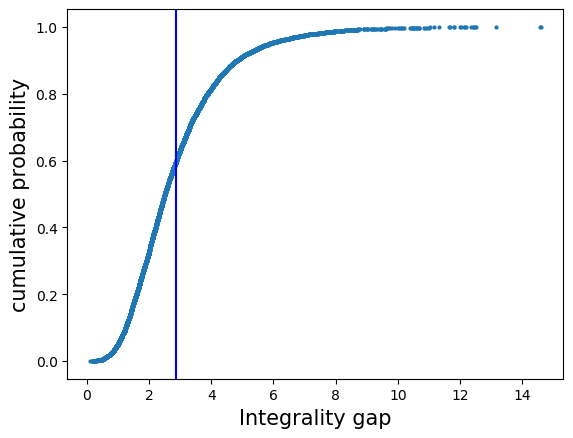

In [157]:
process(data)

<function matplotlib.pyplot.show(*args, **kw)>

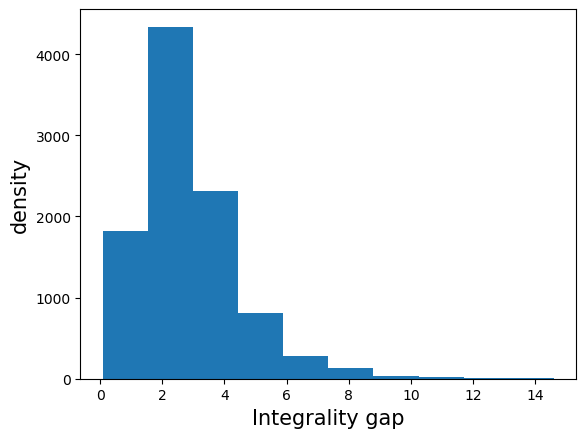

In [158]:
n, bins, patches = plt.hist(data)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

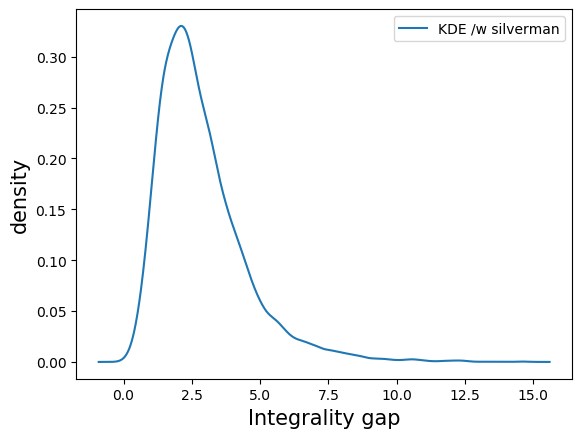

In [159]:
kernelDensity(data)

In [41]:
data1 = the_loop(20,50,1000)

[ 1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.
 -0. -0.  1. -0. -0.  1.  0. -0.  1. -0.  1. -0.  1.  1.]
Obj: 14.5866
[0.85468835 0.         0.         1.         1.         1.
 0.         0.         0.14778014 0.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.28850552 0.         1.         0.         0.
 1.         0.         0.         0.         0.78881777 0.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         1.         0.00116442 0.74576614
 0.24751554 0.         0.54176762 0.         0.06514014 0.
 0.         1.        ]
Obj: 19.6125
19.612525560319316 relaxed 
14.58659607846334 original 
[ 1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.
  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.]
Obj: 1

[-0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  0.  1. -0.  1.  1. -0. -0.
  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.
  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.]
Obj: 14.6755
[0.         0.         0.808486   1.         0.         1.
 1.         1.         1.         0.83952867 0.06127422 1.
 1.         0.         0.         1.         0.         0.
 1.         0.         0.0555147  0.         0.         1.
 0.         0.25508734 0.         0.         0.         1.
 0.         0.         0.1496685  0.         1.         1.
 1.         1.         0.75029648 0.97756237 0.         0.
 1.         0.         1.         1.         0.63715132 0.75780872
 0.         1.        ]
Obj: 17.4635
17.46354062401607 relaxed 
14.675482298710714 original 
[0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0.
 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0.
 1. 0.]
Obj: 6.45469
[0.         0.89237888 1.         0.1445352

[ 1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0. -0. -0. -0.  1.
 -0.  0. -0. -0.  1. -0.  1.  1.  1.  0. -0.  1.  1.  1.  0. -0.  1. -0.
 -0.  0. -0. -0.  0.  0.  0. -0.  0. -0.  1. -0. -0.  1.]
Obj: 6.8488
[1.         0.22682675 0.         0.         0.         0.78390226
 0.         0.         0.         0.         0.         0.28613761
 1.         0.         0.         0.         0.         1.
 0.         0.69396042 0.         0.201556   1.         0.
 0.38260003 1.         1.         0.82099583 0.41136213 1.
 1.         0.31015327 0.14898148 0.05862369 1.         0.
 0.         1.         0.         0.67218244 0.         0.
 0.78385652 0.         1.         0.         1.         0.
 0.         1.        ]
Obj: 11.5599
11.559949410509185 relaxed 
6.848798666823214 original 
[-0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  0.  1.  0.  1.  1.  0.  1. -0. -0.  0.  1.  1. -0. -0.  1.
  1.  0.  1.  0. -0.  1.  1. -0.  1. -0. -0. -0.  0. -0.]

[ 1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.
 -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.
 -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.]
Obj: 14.9443
[1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.85071629 0.45727338 0.         1.         1.         0.99868278
 0.10529002 0.69185336 0.50489844 0.         0.         0.59803165
 0.80562893 0.         1.         0.18321082 1.         1.
 0.60292992 0.45826694]
Obj: 16.5519
16.551917600703877 relaxed 
14.944268990025163 original 
[ 1.  0. -0.  1.  1.  0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  0.  1.  1.
  1.  1.  1.  1.  1. -0. -0. -0.  0.  1. -0.  1.  1.  1.  1.  0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0. -0.  1.  0. -0. -0. -0.  0

[ 1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  0.  1.  1.  0.  1.  0. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.]
Obj: 9.52465
[0.73916009 0.         1.         1.         1.         0.
 0.91578681 0.92540722 1.         0.         0.         0.04037288
 1.         0.         1.         0.3286338  0.         0.73447144
 1.         0.         0.         0.         0.         0.
 0.         0.94717608 0.34137588 0.         0.         0.03905994
 0.         1.         0.         1.         1.         0.
 0.09544816 1.         1.         0.43526612 0.         1.
 1.         0.         0.         1.         1.         0.
 1.         0.        ]
Obj: 12.2397
12.239686808008448 relaxed 
9.524652845526894 original 
[1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1.
 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1.
 0. 1.]
Obj: 11.1044
[0.6681766  1.         0.  

[-0. -0. -0.  1.  1. -0.  0.  0.  0.  0.  0.  0.  1.  1. -0.  1. -0. -0.
  0.  1. -0.  1. -0.  1.  1.  1.  0.  1. -0.  0.  1.  1. -0.  0.  1.  0.
  1.  0. -0.  0.  0.  1. -0.  0.  0. -0.  1.  1.  0.  1.]
Obj: 2.48152
[0.         0.         0.         1.         1.         0.
 0.         0.         0.08610422 0.         0.         0.
 0.25104023 0.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.55127661 0.         1.         0.         0.91735602
 0.33847059 0.94575328 0.         0.         0.50800721 0.
 1.         0.         0.         0.         0.         0.62953416
 0.         1.         0.         1.         0.61381849 1.
 0.         1.        ]
Obj: 7.0328
7.032804693249214 relaxed 
2.4815168716165608 original 
[-0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  0. -0.]

[-0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.
 -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 11.0873
[1.         1.         0.13223319 0.7655744  0.         0.
 1.         0.         0.         0.81516437 0.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         0.06127637 0.         0.         0.40917602
 1.         0.76111317 0.         0.         0.21626549 0.
 1.         0.53757623 1.         0.         1.         0.69588458
 0.         1.         0.         0.01597265 0.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.        ]
Obj: 12.826
12.826031942499135 relaxed 
11.087315482260006 original 
[ 1. -0. -0.  0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.
 -0. -0.  1.  1. -0.  1.  0.  1.  1. -0.  0. -0.  1.  1.  0. -0. -0. -0.
  1.  1. -0. -0.  1. -0.  1. -0. -0.  0. -0. -0.  0.  0.

[1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1.
 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0.
 0. 0.]
Obj: 11.013
[1.         0.         1.         1.         1.         0.
 0.         1.         1.         0.48840741 0.         0.68648721
 0.         0.         1.         0.         0.         1.
 0.79552227 0.33638841 0.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.62635077 0.
 1.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.        ]
Obj: 11.955
11.954979436142231 relaxed 
11.013031939298765 original 
[ 1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  0.
 -0. -0. -0.  1.  1. -0.  0.  1. -0. -0. -0.  0. -0.  1. -0. -0. -0.  1.
 -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.]
Obj: 0.703752
[1.         0.         0.         0.       

[ 1. -0.  0.  1.  0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.
 -0.  0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  0.
 -0.  1. -0. -0.  0. -0. -0. -0.  1. -0. -0.  0.  0.  0.]
Obj: 14.1281
[1.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         0.         1.
 1.         0.72203712 0.         1.         0.         0.
 0.         0.12972636 0.         0.13163609 1.         0.
 0.         1.         0.13493662 0.         0.96890979 1.
 1.         0.30623548 1.         0.         1.         0.45085338
 0.         0.98861339 0.         0.         0.89194066 0.
 0.         0.         1.         0.         0.         1.
 1.         0.        ]
Obj: 16.5227
16.522706247866537 relaxed 
14.128111791605063 original 
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1.
 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0.
 1. 1.]
Obj: 12.0773
[1.         0.         0.         0.      

[ 0.  0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  0. -0.  0.  1. -0. -0.
  1.  0. -0. -0. -0. -0.  1. -0.  0.  1. -0. -0. -0.  1. -0.  1. -0.  1.
  1.  1. -0. -0.  1.  1.  0.  1.  1.  1.  1.  0. -0.  1.]
Obj: 17.4001
[0.         0.         0.         1.         0.01201961 0.
 0.         0.         1.         1.         0.         0.33836649
 0.         0.         0.         1.         0.         0.46296357
 1.         0.         0.         0.21841978 0.         0.
 1.         0.04986893 0.         1.         0.16101166 0.
 0.         1.         0.         0.95212076 0.         1.
 1.         1.         0.         0.         1.         0.70345944
 0.         1.         1.         0.         0.         0.
 0.         0.8608695 ]
Obj: 20.3119
20.311862705709032 relaxed 
17.400052047328195 original 
[ 1. -0.  1. -0.  0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.
 -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  0. -0. -0.  1.  0. -0. -0.
 -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  0

  1.  1. -0.  1. -0. -0.  0.  1. -0. -0.  1. -0. -0. -0.]
Obj: 12.091
[0.         1.         1.         0.24220831 1.         1.
 1.         0.         0.         0.         1.         0.
 0.09513383 1.         1.         1.         0.85243267 1.
 0.         1.         0.5940603  1.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         0.35554894 0.         0.23157087
 0.02826915 1.         0.         0.54881707 1.         0.
 0.         0.        ]
Obj: 13.3856
13.385588988705706 relaxed 
12.090988371451436 original 
[0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1.
 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1.
 1. 1.]
Obj: 11.8095
[0.         0.72575497 0.         1.         0.         0.62741681
 0.         1.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.8

[ 1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.
 -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.]
Obj: 22.2414
[1.         0.         1.         1.         0.86010065 1.
 0.45773454 0.83118501 1.         1.         0.27814659 1.
 0.         0.         1.         1.         0.         0.99687868
 0.         1.         0.         0.         0.64877342 1.
 0.         1.         1.         0.         1.         1.
 0.         0.46351849 0.         0.         0.         0.
 0.         1.         1.         0.54119786 0.         1.
 0.56247393 1.         0.         0.         1.         0.85415576
 0.         0.25649543]
Obj: 23.816
23.815985954808937 relaxed 
22.241423199632155 original 
[ 1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
 -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.

 1. 1.]
Obj: 8.10046
[0.13275561 0.         1.         0.         0.         0.
 0.         0.         0.14086689 0.         1.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         0.28643953 0.5612177  0.
 0.24851995 0.         0.04301784 1.         1.         0.88524806
 0.         1.         1.         0.         1.         0.
 0.8237736  0.         0.         0.         0.         0.
 1.         1.        ]
Obj: 10.5873
10.587285007818055 relaxed 
8.100461334419427 original 
[-0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.
 -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  0. -0. -0.
  1.  1. -0.  0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.]
Obj: 8.72274
[0.         1.         0.         1.         0.82737975 0.16064117
 0.         0.29811259 1.         0.53352743 1.         1.
 0.         0.17860363 0.         0.         0.         0.65689

[-0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  0. -0.  1.  1.
  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.
  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.]
Obj: 5.4298
[0.         0.1145247  0.07472564 0.         0.         0.
 0.98478519 0.71001491 0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.85509308 0.26584727
 0.         0.         0.         1.         1.         0.99178494
 0.         0.44071498 0.         0.         0.         0.61702698
 0.93408925 0.         0.         1.         1.         0.64137908
 0.         1.         1.         0.         0.         0.
 0.         0.07490247]
Obj: 9.51087
9.510866985633834 relaxed 
5.429796836540628 original 
[-0. -0.  1.  0.  1. -0.  0. -0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  0.
  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  0.  1.  0.  1.  1.  1.  0.  0.
  0.  0. -0.  1.  1. -0.  1.  1.  1. -0.  

[-0. -0. -0.  1.  0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  0.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.]
Obj: 9.67416
[0.         0.         1.         1.         0.         0.
 0.         0.54742065 0.         0.         1.         0.274087
 0.         1.         0.         0.41326655 0.         0.
 0.         0.9214766  0.         1.         1.         0.92025924
 0.77122628 0.54565691 1.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         0.09831757 0.68025283 1.
 1.         0.91346484 0.         0.83114649 0.28864393 0.
 0.65542985 1.        ]
Obj: 16.487
16.486993934666543 relaxed 
9.674163780678965 original 
[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.]
O

[-0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.]
Obj: 8.8588
[0.         1.         0.         0.         0.         0.12792289
 0.         0.         0.         0.17013763 1.         0.92849103
 0.         1.         1.         1.         0.40290273 1.
 0.         0.83846865 0.         1.         0.         0.67236897
 1.         1.         0.         0.         0.         0.97389067
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.47933037 0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.        ]
Obj: 11.0064
11.006388156470958 relaxed 
8.858803857210255 original 
[ 1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  0.  0. -0. -0. -0.
  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  0. -0.  1.  0. -0. -0.  1.
 -0.  0.  1.  1. -0. -0.  1.  1. -0.  1. 

[1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0.
 1. 0.]
Obj: 11.7363
[1.         0.         0.         1.         0.78711081 1.
 0.         0.         0.         1.         0.24021146 0.
 1.         0.         1.         0.         0.10742686 0.
 0.         0.         1.         0.53732401 1.         0.19492304
 0.         1.         0.         0.         0.0232713  0.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.58419611 0.         0.         0.
 0.         1.         0.01484796 0.73824314 1.         0.
 1.         0.        ]
Obj: 14.8237
14.82366929728824 relaxed 
11.73632887777259 original 
[ 0. -0.  1.  1.  1. -0. -0.  1. -0.  0.  1. -0. -0. -0. -0.  1.  1. -0.
  1.  1. -0.  1. -0.  1.  1. -0.  0. -0. -0.  1.  1.  0.  0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.]
Obj: 16.1007
[1.         0.         1.         1.        

[-0.  0. -0.  1.  1. -0. -0.  0. -0. -0.  0.  0.  0.  1.  1.  0.  1. -0.
 -0.  1.  1.  0.  1.  1. -0.  0. -0.  0. -0.  0.  1. -0.  0.  1.  0. -0.
 -0.  0.  1. -0. -0.  1.  1.  1. -0.  0. -0.  1. -0. -0.]
Obj: 8.81319
[0.         0.         0.74470627 1.         1.         0.
 0.         0.         0.         0.60847818 0.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         0.         0.94307281 0.
 1.         0.         0.         1.         0.         0.33557168
 0.         0.         1.         0.         0.         1.
 0.         0.44136593 0.         0.         0.         1.
 0.69186853 0.        ]
Obj: 10.3691
10.369105122912229 relaxed 
8.813186855911669 original 
[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 1

[ 1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.]
Obj: 6.03148
[1.         0.         0.         0.83522215 0.         0.
 0.         1.         1.         0.         0.         0.
 0.69721148 1.         0.         0.92484237 0.         0.41141107
 0.90776209 0.72240756 0.         1.         1.         0.
 0.         0.34663789 0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.7075391  0.81298383 0.         0.         1.
 0.         0.         1.         0.15614396 0.         0.57668969
 0.         1.        ]
Obj: 11.02
11.020021602643265 relaxed 
6.031476398836995 original 
[0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0.
 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 7.66262
[0.         0.         0.         0. 

[0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0.
 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0.
 0. 0.]
Obj: 4.67867
[0.         1.         0.91634991 0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.57482446 0.         0.         0.         0.55674473
 0.         0.         0.76597773 0.         0.         0.
 1.         0.         0.         0.40035622 0.         0.
 0.42726228 0.57745603 0.         1.         1.         0.
 0.         0.26755817 0.56181581 1.         0.0132612  0.
 0.         0.         0.         1.         0.34325338 0.
 0.         0.        ]
Obj: 7.14258
7.142579806818738 relaxed 
4.678666433831656 original 
[-0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.]
Obj: 9.62515
[0.         1.         0.         0.        

[-0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.
 -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.]
Obj: 10.9053
[1.         0.15861851 0.77368286 0.         1.         0.
 1.         0.         0.         0.         1.         1.
 1.         0.79816375 1.         0.         0.         0.
 0.         1.         1.         0.0679438  0.         0.
 0.         0.75594422 0.         0.         0.         0.68783503
 1.         1.         0.12235168 0.         0.         0.
 0.         0.         0.23041941 0.         1.         0.45675501
 1.         0.         1.         1.         0.         0.
 1.         0.        ]
Obj: 13.6053
13.605321029333322 relaxed 
10.905330136022204 original 
[-0.  0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  0. -0. -0.
 -0. -0.  1.  1.  1. -0.  0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  0.  1.  1. -0

[-0.  1.  1.  1.  0.  1. -0.  0.  1. -0.  1.  1. -0.  0. -0. -0. -0.  0.
  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.]
Obj: 11.3179
[0.         1.         1.         1.         0.         0.64669439
 0.         0.37662485 1.         0.         1.         1.
 0.         0.         0.         0.         0.45339505 0.
 1.         0.01287717 0.         1.         0.         1.
 1.         1.         1.         1.         0.         0.
 0.         1.         0.86125284 0.         1.         0.
 1.         0.71838995 0.309041   1.         0.82035649 0.60368456
 0.83866715 0.         0.         0.         1.         1.
 1.         0.84573043]
Obj: 14.86
14.859973534801412 relaxed 
11.317861197096956 original 
[-0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  0.  1. -0.  1. -0. -0. -0.
  1. -0.  0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
 -0. -0.  0. -0.  1.  0.  0.  1.  1. -0.  1. -0.  1.  1.]

Encountered an attribute error
[ 1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0.  0.  1. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0.  1.  0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0. -0. -0. -0.]
Obj: 1.07503
[1.         0.47723295 1.         0.         0.88001145 0.
 0.         0.9454783  0.         0.         0.         1.
 0.         0.         1.         0.43244002 0.         0.
 0.         0.         1.         0.         0.         0.
 0.23738218 0.26991792 0.         0.         0.         0.49620379
 0.         1.         0.         0.11056631 0.         0.
 0.         0.         0.         0.         0.87756765 0.
 0.         0.         0.         0.3484086  0.         1.
 0.         0.        ]
Obj: 4.2656
4.265604374252773 relaxed 
1.0750266872885625 original 
[-0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0.  0.  1.  1.  1.  0.  1.  0.
  0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.
  1.  1. -0.  0.  1.  1. -0.  1.  

[1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0.
 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 0.
 1. 0.]
Obj: 9.42781
[1.         0.         0.         0.         0.75929837 1.
 0.         0.         0.         0.         0.         0.57110495
 0.         0.56318524 0.97956267 0.         0.         0.24245556
 0.         0.         1.         0.         0.         0.
 0.111933   0.         0.         1.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.49301057
 0.45993188 0.        ]
Obj: 10.7928
10.792825080009308 relaxed 
9.42781489267741 original 
[ 1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 9.53199
[1.         0.52086586 0.   

[ 1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  0.  1. -0. -0.
 -0.  0.  1. -0.  1.  1.  0.  0. -0.  0.  0.  1.  1.  1.  1. -0.  1.  1.
  1. -0.  0.  0.  1.  1.  0.  1.  1.  1. -0.  1.  1. -0.]
Obj: 15.1103
[0.55349084 1.         1.         1.         1.         1.
 0.36268435 1.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.26294779 1.         0.         0.8121177  1.
 1.         1.         0.         0.80542487 0.         1.
 0.98805485 1.         1.         0.         1.         0.54647772
 1.         0.         0.00885809 0.28450018 1.         1.
 0.         1.         0.51651358 1.         0.         1.
 1.         0.        ]
Obj: 17.043
17.042973732826567 relaxed 
15.110260145050349 original 
[ 1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  0.  1.
  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  0.  0.]
Obj: 4

[-0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  0. -0. -0.]
Obj: 12.5421
[0.         1.         1.         1.         1.         1.
 0.         1.         0.         0.         0.93731278 1.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         0.26652559 0.43424524
 0.48255103 0.         0.05186632 0.93448588 1.         0.
 0.37169858 0.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.77017351]
Obj: 14.6267
14.62674296652008 relaxed 
12.542050566746644 original 
[ 1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0.
 -0. -0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  0.  1. -0.  1.  1. -0.  1. -0.  1. -0.]
Obj: 1

[ 1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.]
Obj: 9.14573
[1.         0.52469761 0.         0.         0.         1.
 0.89279404 0.         0.         0.         1.         1.
 0.         1.         0.73916717 0.         0.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.63743515 0.59551393 0.1917172  0.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         0.80530214 0.
 1.         0.        ]
Obj: 10.5642
10.564182959375021 relaxed 
9.145729834103976 original 
[-0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.]
Obj: -0.411162

[-0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.
  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.
 -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.]
Obj: 11.5524
[0.         0.         0.         0.         1.         0.
 0.10353153 1.         1.         0.         0.         0.
 0.93923996 0.         0.         1.         1.         1.
 0.44547891 0.         0.         1.         0.         0.63735687
 0.         0.61078767 0.         0.         1.         1.
 0.57102074 1.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.91994887 1.         0.74269911 1.         0.         0.
 1.         0.14621658]
Obj: 13.264
13.264047879112022 relaxed 
11.552442652073909 original 
[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.
 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1.
 1. 0.]
Obj: 11.7382
[0.         0.         0.         0.       

[-0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  0.  0.  1.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.
  1. -0.  1.  0.  1. -0.  0. -0. -0.  0. -0.  1. -0.  1.]
Obj: 10.1225
[0.         0.         0.         0.         0.64413733 1.
 0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         0.13650717 0.
 0.         0.673703   0.29324538 0.         1.         0.
 0.         1.         1.         0.57096669 0.         0.20161663
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.21308566 1.         0.
 0.         0.         0.8281211  0.3309476  0.34994023 1.
 0.         1.        ]
Obj: 12.6113
12.611263239381646 relaxed 
10.122475285195037 original 
[-0. -0. -0. -0. -0. -0.  1. -0. -0.  0.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0.  1.  1.  0.  1. -0. -0. -0. -0.  0.  1.  1.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.]
Obj: 

[-0. -0. -0. -0.  1. -0. -0. -0.  0.  1. -0. -0.  0. -0.  1.  0.  0.  1.
  0.  1.  1.  0. -0.  0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.
  0.  1.  0.  1.  0. -0. -0.  1.  0.  0.  0. -0.  1.  1.]
Obj: 13.0021
[0.         0.         0.         0.         1.         0.
 0.29987572 0.         0.         1.         0.         0.
 0.         0.         0.37466029 0.         0.54677397 1.
 0.88518623 1.         1.         0.94084185 0.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.2149515  0.         0.34127906 1.         1.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         0.27858231 0.         0.
 1.         1.        ]
Obj: 15.5346
15.53459190333356 relaxed 
13.00214414850215 original 
[ 1. -0. -0.  1.  1.  0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.
 -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  0.  1. -0.  1. -0.  1.
 -0. -0.  1. -0. -0. -0.  0. -0. -0. -0.  0. -0.  0. -0.]
Obj: 11.2157
[1

[-0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 8.14423
[1.         1.         0.22378916 0.         1.         0.
 0.8531376  1.         0.         0.         0.00610879 0.
 0.         0.         1.         1.         1.         0.
 0.46220595 0.         0.         0.66952331 0.97311074 0.
 0.         0.         0.         1.         0.         1.
 0.         0.88404816 0.         0.         0.         0.
 1.         0.         0.56610352 0.         1.         0.44929374
 0.         1.         0.         1.         0.         0.93611672
 0.         0.        ]
Obj: 10.7128
10.712828259081622 relaxed 
8.144226041640605 original 
[ 0.  1.  1.  0. -0.  1.  1.  1. -0.  1.  0. -0.  1. -0.  1.  0. -0. -0.
 -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  0. -0.
  1. -0.  1.  1.  1.  0. -0. -0. -0.  1.  0.  1. -0.  1.

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0.
 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1.
 0. 1.]
Obj: 10.6744
[0.         0.         0.         0.11808094 1.         1.
 0.26512256 0.         0.         0.         0.         1.
 0.         0.         0.97665758 1.         1.         0.44221376
 0.         0.         1.         1.         0.         0.
 0.         0.87921753 0.48976963 0.         0.5065493  1.
 0.         0.         0.17261703 1.         1.         0.
 0.         0.         0.         1.         1.         0.
 1.         1.         1.         0.31142325 0.         1.
 0.         0.49257969]
Obj: 12.7891
12.789053480932045 relaxed 
10.674446591516881 original 
[-0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 0.819129
[0.48288834 0.         0.         0.     

[ 1. -0. -0. -0.  0. -0.  1.  1.  0.  0. -0. -0.  1. -0. -0.  1. -0. -0.
  0. -0. -0. -0.  0. -0. -0.  0.  1.  0. -0. -0. -0.  0. -0.  1. -0. -0.
  0. -0.  0. -0. -0. -0. -0.  1.  1. -0.  0.  1. -0. -0.]
Obj: 3.73223
[1.         0.         0.         0.         0.54755862 0.
 1.         1.         0.21947765 0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.22362047 0.         1.         0.         0.
 0.30402593 0.         0.12961918 0.         0.52088489 0.
 0.         1.         1.         0.         0.41254044 0.18613344
 0.         0.        ]
Obj: 7.0413
7.041297126766067 relaxed 
3.7322324058204575 original 
[1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 1.
 0. 1.]
Obj: 12.401
[1.         0.         0.68143433 1.         

[ 1. -0.  0. -0. -0. -0.  1.  1. -0. -0.  1.  0.  1.  1.  1. -0.  1. -0.
  1.  0.  1.  1. -0.  0. -0.  1.  1. -0.  1.  1.  0. -0.  1.  1. -0. -0.
 -0. -0. -0.  0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.]
Obj: 20.0353
[1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 1.         1.         0.17769471 0.         1.         0.
 1.         0.33391942 1.         1.         0.         0.70448291
 0.         1.         1.         0.         0.69835556 0.58447483
 1.         0.         0.65940111 0.62452024 0.         0.
 0.         0.         0.         0.28432252 1.         1.
 1.         0.         0.78764393 0.         1.         1.
 1.         1.        ]
Obj: 21.3676
21.36756489928543 relaxed 
20.03530841937717 original 
[ 1.  1. -0. -0. -0.  0.  0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.
 -0.  1. -0.  1. -0. -0.  0. -0. -0.  1. -0. -0. -0. -0.]

[-0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.]
Obj: 9.82455
[0.30232157 1.         1.         1.         0.         0.
 0.         1.         1.         0.91939634 1.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.53693201 1.         0.         1.         1.
 0.86175811 0.5879871  1.         0.         0.         0.
 0.60549056 0.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         0.85504178
 0.         1.         0.37431859 0.22319036 0.46450504 0.
 1.         0.        ]
Obj: 12.6258
12.62584766140624 relaxed 
9.824551779592925 original 
[-0. -0.  1. -0. -0.  0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.
  1. -0.  1. -0. -0.  1.  0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.]
Obj: 10

[0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1.
 0. 1.]
Obj: 7.14909
[0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.23238202 0.
 0.         0.         1.         0.74853657 0.         1.
 0.         0.         0.87641211 0.         0.         0.
 0.         0.         1.         0.         0.5003473  1.
 1.         0.         0.54847292 1.         0.         0.
 0.         0.         0.57403426 0.         1.         1.
 0.44115132 0.37736539 0.45424842 0.         0.         0.55098501
 0.68511311 0.        ]
Obj: 10.3245
10.324468570515853 relaxed 
7.149086750616385 original 
[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.
  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.
 -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.]
Obj: 8.63567
[0.00000000e+00 0.00000000e+00 0.00000000e+

[-0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.  0.  1.  1. -0. -0.  1.  0.
 -0.  1.  0.  1.  1.  1. -0. -0.  1.  0.  0. -0. -0. -0. -0.  0. -0.  1.
 -0. -0. -0.  0. -0.  0. -0.  1.  1.  1.  0.  1. -0.  1.]
Obj: 8.22555
[0.         0.         0.         0.26863377 1.         0.65528604
 0.         0.         1.         1.         1.         0.05301311
 1.         0.90095935 0.20478822 0.         1.         0.12440399
 0.         1.         1.         0.61716742 1.         1.
 0.         0.         1.         0.9106785  1.         0.
 0.         0.         0.         0.78244482 0.         0.
 0.         0.         0.37499626 0.42273108 0.06636276 0.37934387
 0.         1.         1.         1.         0.         1.
 0.         1.        ]
Obj: 12.7549
12.754858611104655 relaxed 
8.225548475987786 original 
[-0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0. -0.
  1.  1.  0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  0.
  0.  1. -0. -0.  1. -0.  0.  1. -0.  1.

[ 1.  0.  1. -0. -0. -0. -0.  1.  1.  0.  0. -0.  1. -0.  0.  1.  1.  1.
  0. -0.  1.  1.  0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.
  1. -0.  1.  1.  1.  1.  1.  1. -0.  0.  1.  0.  1.  1.]
Obj: 18.1424
[1.         0.12078478 1.         0.         0.         0.
 0.         1.         1.         1.         0.2670843  0.38403594
 1.         0.         0.93277824 0.38274338 0.24212131 0.57125242
 0.         0.         1.         1.         0.0863648  1.
 0.         1.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.48307334
 1.         1.        ]
Obj: 18.9434
18.943449687172627 relaxed 
18.142379410927038 original 
[ 1. -0.  1.  1.  1.  0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. -0. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0.  0. -0. -0. -0.  1.
 -0.  0.  0. -0.  1.  1.  1. -0.  1. -0.  1.  1

[ 1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.
 -0.  1. -0.  1. -0.  1.  1.  0.  0.  1. -0. -0. -0.  1.]
Obj: 7.67577
[1.         1.         0.         0.         0.         0.
 0.         0.         0.72059183 0.         0.         0.
 0.27893108 0.         0.         0.         0.         0.
 1.         0.         1.         0.40251871 1.         1.
 1.         0.         1.         0.         0.24074578 0.
 0.92605446 0.         1.         0.         1.         1.
 0.47403904 1.         0.         1.         0.         0.64487799
 0.37888393 0.47605486 0.24186082 1.         0.         0.
 0.25842846 1.        ]
Obj: 9.26518
9.26518177230321 relaxed 
7.675765962842737 original 
[0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0.
 0. 1.]
Obj: 14.3191
[0.03432699 0.         0.         0.         

[-0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.
  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 16.0047
[0.         0.         1.         1.         0.58175958 0.37128107
 0.         0.         1.         0.         0.         1.
 1.         1.         0.57189431 0.04780502 0.         0.
 1.         0.         1.         0.         1.         1.
 0.66563561 1.         1.         1.         0.         1.
 0.         0.         1.         0.8230814  1.         0.
 0.         0.05949559 0.         1.         1.         0.
 0.         0.         0.3461495  0.50646527 0.         1.
 1.         0.        ]
Obj: 17.9769
17.976948042799823 relaxed 
16.004699046400912 original 
[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.]
Obj: 

[-0. -0.  1.  1.  0. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  0.  1.  0.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0.  0.  0. -0.  0.  1. -0. -0.  1. -0.]
Obj: 10.9381
[0.16966142 0.         0.58793767 0.75558152 0.         0.
 1.         0.         0.         1.         0.65224727 0.
 0.         0.         0.         0.41211272 0.         0.697937
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.86845453 1.         1.         1.         0.         0.
 0.         0.79224228 1.         0.         0.         0.90708299
 0.90038106 0.         1.         1.         0.         0.
 1.         0.        ]
Obj: 13.4424
13.442407217686306 relaxed 
10.938136576240446 original 
[ 1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.]

[-0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.]
Obj: 9.57798
[0.26894708 0.         1.         0.         0.         0.
 0.57421216 0.32431112 1.         1.         0.83848579 0.
 0.         0.36807868 0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.28147624 0.75815359 0.85133498 1.         1.         0.
 1.         0.46548355 1.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.        ]
Obj: 11.7539
11.753874818950617 relaxed 
9.577981388121982 original 
[1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1.
 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 8.3121
[1.         1.         0.21622538 0.         0.     

[-0.  0. -0. -0.  1. -0. -0. -0.  1.  0. -0.  1.  1.  1.  0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0.  1.  1.  0.  0.  1. -0.  1.  1.]
Obj: 4.61444
[1.         0.07474962 0.         0.33238705 1.         0.
 0.         1.         0.81879775 0.         0.         1.
 0.05270369 0.76953951 0.         0.         0.         0.
 0.37605915 0.         0.         0.         0.01276856 1.
 1.         0.         0.         0.46413073 1.         0.
 0.         1.         0.         0.07964211 0.         0.887168
 0.         0.49699848 0.01579181 0.         0.         0.
 1.         0.67919247 0.         0.         1.         1.
 1.         1.        ]
Obj: 9.50177
9.501772811535204 relaxed 
4.614442030431125 original 
[ 0.  1. -0. -0.  0. -0.  1. -0. -0. -0.  0.  0.  0.  0.  1. -0.  1.  1.
  1.  0. -0. -0.  1. -0.  0. -0.  1. -0.  1.  0. -0. -0.  1. -0.  0.  1.
  1.  0.  0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  0.]
Obj: 9.47

[-0. -0.  0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.
 -0.  1. -0.  1. -0.  1.  0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.
 -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0.]
Obj: 8.78145
[0.         0.19259742 0.         0.43984117 1.         0.
 0.         0.         0.         0.         1.         0.
 0.29224542 0.89696112 0.41078539 0.85440462 0.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.71888926 1.         0.         0.         1.
 0.         0.         1.         0.27036801 0.         0.
 0.         0.        ]
Obj: 11.4377
11.43770023022997 relaxed 
8.781451141964364 original 
[ 1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.
  1. -0.  1. -0.  1. -0.  0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.
  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.]
Obj: 8.87116
[1

  1. -0. -0.  1.  0. -0. -0. -0.  1.  1. -0.  0. -0.  1.]
Obj: 19.0056
[0.         1.         1.         0.19400797 0.         0.02995774
 0.         0.         0.7884862  1.         0.         1.
 0.         1.         1.         1.         0.22420989 1.
 0.         0.         0.         0.         1.         0.
 0.09847988 1.         0.11871691 0.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         0.63059094
 0.         1.        ]
Obj: 20.161
20.16099115877205 relaxed 
19.00559565237508 original 
[ 1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.
  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.]
Obj: 11.463
[1.         0.         1.         0.         0.         0.
 0.37664407 0.         0.         1.         0.         0.
 1.         0.  

[0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0.
 0. 0.]
Obj: 6.01207
[0.         0.         0.32362252 0.         0.         0.
 0.         0.         1.         0.16311718 1.         0.
 0.52801271 1.         0.         0.08671885 0.         0.
 0.3753444  1.         0.         0.         1.         0.
 0.         0.         0.1698065  0.82373077 0.         0.
 0.36124923 1.         1.         1.         0.         0.37275741
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.99379073 0.         0.
 0.         0.        ]
Obj: 8.80254
8.802536898823114 relaxed 
6.01207034238697 original 
[0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0.
 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0.
 1. 1.]
Obj: 11.4483
[0.         0.         0.         1.         1.         0.09624901
 1.         0.         0.   

[-0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.
  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.]
Obj: 8.96769
[0.         1.         0.16257966 1.         1.         0.
 1.         0.70385994 0.         0.         1.         0.
 0.39436597 0.4737839  1.         0.         1.         0.
 0.74587579 0.         1.         1.         0.06845654 0.
 1.         0.         0.         0.         0.         0.
 0.45315912 0.98564328 1.         0.29898323 1.         0.
 0.         0.         0.         0.63449021 1.         0.
 0.0233046  1.         0.         0.         1.         1.
 1.         1.        ]
Obj: 13.5907
13.590690709945177 relaxed 
8.967690766753364 original 
[ 1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.
  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.]
Obj: 9.11627
[

[ 1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  0. -0. -0. -0.  1.  1.  1.  1.
  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.]
Obj: 12.6113
[1.         0.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.99825859 0.         1.         0.         1.         1.
 1.         1.         0.         1.         0.03296614 0.
 0.77339404 0.         0.         0.30025228 1.         0.
 1.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.81141587
 0.         0.81003912 0.         0.92320023 0.         0.25969664
 1.         0.        ]
Obj: 14.1315
14.131546277573829 relaxed 
12.61130682240675 original 
[-0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.

[-0.  1. -0. -0.  1.  0.  0.  1.  0.  0.  0. -0.  1.  0. -0.  1. -0.  1.
  0.  1.  1.  0.  1.  0.  1. -0. -0.  0. -0. -0. -0.  1.  1.  1. -0.  1.
  1. -0. -0.  1.  0. -0.  1.  0.  1.  0.  0.  0.  1. -0.]
Obj: 9.33528
[0.         1.         0.         0.         0.60647005 1.
 0.09739951 1.         0.         0.         0.         0.
 0.17542705 1.         0.         0.84727928 0.         1.
 0.         0.8954476  1.         0.52357683 0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         0.30931024
 1.         0.         0.         0.32154243 0.         0.9417365
 1.         0.        ]
Obj: 13.3501
13.350063900124091 relaxed 
9.335277996871246 original 
[-0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.
 -0.  1. -0.  0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  0.  1. -0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.]

[ 1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  0. -0.  1. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  0. -0. -0.  0. -0.
 -0. -0.  0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.]
Obj: 6.06094
[1.         0.         0.71600645 0.         1.         0.
 0.04320126 0.         0.         0.44868803 1.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.65761378 0.         0.         0.
 0.         0.34241729 1.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.08350715]
Obj: 7.73561
7.735605243990304 relaxed 
6.060937852278297 original 
[-0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  0.  1. -0.
  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.
 -0.  1. -0.  0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.]
Obj: 11.2089
[0

[-0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  0. -0. -0.  1.  1.
  1.  1. -0.  1.  0. -0.  0. -0.  1. -0. -0.  1.  0. -0.]
Obj: 13.2407
[0.63119824 1.         0.13188895 0.         0.64894626 1.
 0.91082811 0.05404821 1.         0.         0.         1.
 1.         1.         0.         1.         0.37164201 0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.70654241 0.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.52793633 1.         0.         1.         0.         0.
 0.52896349 0.         1.         0.         0.         0.
 0.81955298 0.        ]
Obj: 15.8599
15.859896856594773 relaxed 
13.24071431786566 original 
[ 0. -0.  1.  0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.
  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.]
Obj: 12.9291
[

[0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0.
 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0.
 0. 0.]
Obj: 3.68184
[0.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.766696   1.         0.         0.         1.         0.97889709
 0.         0.         0.2711695  0.         1.         0.00290776
 0.07073112 0.26802127 0.27673392 0.         0.         1.
 0.         0.         0.         1.         1.         0.4877031
 1.         0.02861915 0.         1.         0.14757115 0.
 0.         0.         1.         0.         0.08496919 0.
 0.         0.        ]
Obj: 6.73928
6.739275244946181 relaxed 
3.681844185524607 original 
[-0. -0.  1.  0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.
 -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.
  1.  1. -0. -0.  0. -0. -0.  1.  1. -0. -0.  1. -0. -0.]
Obj: 14.2821
[0.         0.         1.    

[0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1.
 0. 0.]
Obj: 10.962
[0.         1.         0.05102861 1.         0.         0.
 0.         0.65141368 1.         0.94797888 0.71847065 0.0684605
 0.         0.42474366 1.         1.         0.         0.
 1.         1.         1.         0.         0.         0.51307932
 0.         0.         0.         0.         0.         0.67514483
 0.         1.         0.         0.         1.         1.
 0.         0.69784937 0.         0.         0.03411503 0.
 0.         1.         0.32384365 0.         0.         1.
 0.4842203  0.        ]
Obj: 12.8188
12.818774870783052 relaxed 
10.962043427756841 original 
[-0. -0. -0. -0.  1.  0. -0.  1.  1. -0. -0.  1.  1.  1.  0. -0. -0.  1.
 -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  0. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.]
Obj: 14.7239
[0.         0.         0.   

[ 1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  0.  0.  1. -0.
 -0.  1.  0. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1. -0.  1. -0. -0. -0.
 -0. -0.  1.  1. -0.  0. -0.  1.  1. -0.  1. -0. -0.  0.]
Obj: 10.3984
[1.         0.         0.         0.90090881 0.         0.
 0.         1.         0.36594706 1.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.15082119 0.         0.         0.01482511 1.
 0.         0.         0.40973732 0.         0.1800033  0.
 0.67554903 0.         1.         0.85588451 0.         0.
 0.         0.         1.         1.         0.         0.03349783
 0.         1.         1.         0.         1.         0.
 0.         0.        ]
Obj: 13.3918
13.39184142308333 relaxed 
10.398446399271371 original 
[-0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  0. -0. -0.  0.  1.
 -0. -0. -0. -0.  0.  0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.
 -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.]
Obj: 1

[-0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.
  1. -0. -0.  1.  0.  1. -0. -0. -0. -0. -0. -0.  0. -0.]
Obj: 4.22731
[0.         0.8683821  0.         0.34716445 0.         0.
 0.73478523 0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.406799   1.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.19198127 1.         0.         0.09947912 0.37847206 0.
 0.91395173 0.         0.         1.         0.         0.31258184
 0.         0.         0.         0.3264284  0.         0.
 0.         0.        ]
Obj: 6.82841
6.828409585772545 relaxed 
4.227305480212221 original 
[ 1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.
 -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.]
Obj: 13

[-0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 5.01856
[0.         0.20634358 0.         1.         0.28634073 0.
 0.         0.         0.         1.         0.94678286 0.9951967
 0.         1.         0.         0.         0.         1.
 0.         0.42924305 0.         0.         0.         0.29507222
 0.98361883 0.62226865 0.         0.         0.         1.
 0.         0.         0.         0.8632276  1.         0.
 0.         0.         1.         0.38334586 0.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.        ]
Obj: 7.54753
7.5475281579235345 relaxed 
5.018564103137887 original 
[-0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.
  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  0. -0.  1.  1. -0. -0.  1. -0. -0.  1.]

[-0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.
 -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.]
Obj: 9.09038
[0.         0.68084894 0.38811969 0.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         0.08679362 0.         0.
 1.         1.         0.         0.         0.         0.24725512
 0.         0.         0.63650847 0.81715425 0.         1.
 1.         0.55648317 0.         1.         0.         0.2377751
 0.         1.         0.75296607 0.         1.         1.
 0.         0.         0.85172557 1.         0.10765364 1.
 1.         0.        ]
Obj: 11.8782
11.878219647140336 relaxed 
9.090384485217001 original 
[-0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  0.  1. -0. -0. -0. -0.  1.
 -0.  1.  1.  1. -0. -0.  1. -0.  0.  1.  0. -0.  1. -0. -0.  1. -0.  1.
 -0. -0.  0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.]

[-0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.]
Obj: 6.20301
[0.         1.         0.         0.         0.         0.62796409
 0.         0.         0.         1.         0.         0.87805294
 0.         0.         0.41263366 0.         0.         0.12203049
 0.         0.         0.         1.         1.         0.
 0.41346412 0.68767881 1.         0.68046495 0.         1.
 0.         1.         0.         0.         0.497716   0.46128035
 0.         0.         0.         0.         0.         1.
 1.         0.7876946  0.         0.         0.         0.15067507
 0.         0.        ]
Obj: 9.93599
9.935994846834978 relaxed 
6.203006788897916 original 
[0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1.
 0. 1.]
Obj: 18.004
[0.57294592 0

[-0.  1.  1.  0.  1. -0.  0. -0. -0. -0. -0.  0. -0. -0.  1.  1.  1.  0.
  0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  0.  1.  1.  0.
 -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  0. -0.]
Obj: 12.1065
[0.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.76785849
 0.         0.         0.94762048 1.         0.97625508 0.
 1.         1.         1.         1.         1.         1.
 0.26032477 0.         0.         0.         0.         1.
 0.70867469 0.         1.         1.         0.2643263  0.
 0.         1.         0.         0.         0.         0.65543962
 0.02110576 0.         0.         0.         1.         1.
 0.71876371 0.        ]
Obj: 14.1405
14.14050402995109 relaxed 
12.106468220888651 original 
[-0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.

[-0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.
  1. -0.  0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 2.62484
[0.         0.         1.         0.         0.94922978 0.
 1.         0.         0.         1.         1.         1.
 0.61030804 0.         0.91131632 0.         0.63953661 0.
 0.51522268 0.         0.         0.         0.         1.
 0.         0.84967429 0.         0.         0.         0.06907432
 0.         1.         1.         0.         0.         1.
 0.48420509 0.         0.         0.         0.         0.08956933
 0.87188508 0.         0.         0.         0.49678109 1.
 0.         0.        ]
Obj: 6.90522
6.905216969090008 relaxed 
2.6248361123435195 original 
[-0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.
 -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.

[0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1.
 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0.
 0. 0.]
Obj: 11.3515
[0.         0.         0.69611577 0.         0.         0.
 0.         1.         1.         0.24626144 0.         0.
 0.         0.565328   1.         0.98416678 0.26221373 1.
 1.         1.         0.         0.10759314 0.         1.
 0.         0.         0.53710283 0.35230131 0.         0.
 0.         1.         0.         0.         0.         1.
 1.         1.         0.36662239 0.         0.         1.
 1.         0.81374103 0.12286308 0.         1.         0.
 0.         0.        ]
Obj: 12.4395
12.439529800182903 relaxed 
11.351450609392536 original 
[-0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.]
Obj: 14.8201
[0.         1.         1.         0.         1.   

[-0.  0.  1.  1. -0.  1.  1.  0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.
  1. -0. -0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1. -0.  0. -0.  1. -0.
 -0. -0. -0.  1. -0.  0.  1.  0. -0. -0. -0.  1. -0.  1.]
Obj: 13.0785
[0.         0.91804849 1.         1.         0.         0.94200149
 1.         0.         0.02056019 0.         0.03309661 0.33252943
 1.         1.         0.         1.         0.         1.
 1.         0.         0.2503312  1.         0.         1.
 0.46551144 0.         0.54662922 1.         0.         0.
 0.18840263 1.         0.         0.         1.         0.
 0.         0.         0.86412508 1.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.        ]
Obj: 16.7813
16.781317264890305 relaxed 
13.078515348521915 original 
[ 1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0

[-0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.]
Obj: 12.5726
[0.         0.         0.57767976 1.         0.         0.
 0.         1.         1.         0.07791432 0.         0.82255112
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         0.00999333 1.
 0.         0.         0.         1.         0.17968014 0.54672315
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.42061249 0.
 1.         0.46257961 0.         0.86029611 0.74173577 0.
 1.         1.        ]
Obj: 14.8964
14.89644727215445 relaxed 
12.572555681430144 original 
[1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1.
 0. 0.]
Obj: 6.69812
[1.         0.         0.         0

[-0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.
  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.
 -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.]
Obj: 21.7551
[0.01931384 1.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.96696531 0.         1.         1.         0.35464627
 0.066265   1.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         0.49895849 0.         0.84285942
 0.         1.         0.         1.         1.         1.
 1.         0.        ]
Obj: 22.745
22.745025261065333 relaxed 
21.75514487302794 original 
[ 1. -0.  1.  1.  0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
  0. -0.  1. -0. -0.  1.  0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.]

[-0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.]
Obj: 11.0448
[0.97351385 1.         0.         0.         0.         0.64557233
 0.31142375 0.         0.         0.27883751 0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.21218985 1.         0.         0.         0.24599123
 0.         1.         0.         0.         0.         0.
 0.         0.         0.86460248 1.         0.         0.
 0.         1.         0.0329405  0.         1.         1.
 0.         0.         0.81572045 0.         0.         0.40822318
 1.         1.        ]
Obj: 12.6305
12.630526392858156 relaxed 
11.044797019182317 original 
[-0. -0.  1.  0.  1.  1.  1.  1.  0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  0.  1.  1. -0.  0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  0.  1. -0.  1.
  1.  1. -0. -0.  1.  0.  1. -0. -0.  1. -0. -0

[ 1.  1. -0. -0. -0.  1.  0.  1. -0.  1. -0.  0. -0.  1.  1.  1.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.
  1.  0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.]
Obj: 11.9306
[0.83561255 1.         0.         0.         0.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.89840508 1.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.80585954 0.         0.94759422 0.
 0.         1.         0.         1.         0.90057905 0.81413294
 0.92761798 1.         0.         0.         1.         0.
 0.         1.         0.61533798 0.         0.         0.82727731
 0.         0.        ]
Obj: 15.8221
15.8221449484828 relaxed 
11.930593174493833 original 
[ 1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.]

[-0.  0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  0.  1.  1.
 -0.  0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.
 -0. -0. -0. -0.  0.  0.  1. -0. -0.  1. -0. -0.  1. -0.]
Obj: 4.58058
[0.         0.8839067  0.33837325 0.22175951 0.08377894 0.
 0.         0.62075874 0.17401244 0.30386956 0.82061155 0.
 1.         0.         1.         1.         0.         0.68195075
 0.         0.         0.1589199  1.         0.         0.
 1.         1.         0.00777622 1.         0.         0.
 1.         1.         1.         0.34872227 0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         0.0072397  0.         0.
 1.         0.        ]
Obj: 9.84122
9.841220135443699 relaxed 
4.5805841771176175 original 
[-0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.
 -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.
 -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.]
Obj: 1

[-0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.]
Obj: 13.9425
[0.         0.10639085 1.         0.         0.         0.03597621
 0.3763041  1.         0.         0.         0.         0.
 1.         0.         0.         0.3658998  0.         0.
 0.         0.28800253 1.         0.         0.         0.
 1.         0.         1.         0.         0.         1.
 0.61623531 0.30798037 1.         1.         0.         1.
 0.60057523 0.03670423 0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.        ]
Obj: 15.4503
15.450300501177743 relaxed 
13.942530647441732 original 
[-0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.]
Obj: 

[1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0.
 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1.
 0. 1.]
Obj: 20.798
[1.         0.         1.         1.         0.         0.
 0.92146707 0.         1.         0.         0.         0.
 1.         0.57387303 1.         0.         1.         0.
 0.         0.38525993 1.         0.74677273 0.6666712  0.
 1.         1.         0.41873136 1.         0.         0.
 0.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         0.         0.15514715
 0.         1.         1.         1.         0.         1.
 0.         1.        ]
Obj: 22.1643
22.164284875834486 relaxed 
20.797995370256345 original 
[-0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.
  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  0.  1.  1. -0. -0.  1.
  1.  0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.]
Obj: 12.8877
[1.         1.         0.         0.2104790

[ 1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.
 -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.]
Obj: 13.8963
[0.67005911 0.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         0.78906303
 0.         0.85750838 0.         0.96511071 0.         1.
 0.         1.         0.         1.         0.         1.
 0.17789586 0.         1.         1.         0.         0.
 1.         0.23512949 0.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.72188049 0.         1.         0.         0.07221703 0.37325257
 1.         1.        ]
Obj: 15.8399
15.83994054839068 relaxed 
13.89626342171976 original 
[0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0.
 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0.
 0. 0.]
Obj: 11.4669
[0.         0.79106464 0.43749528 0.

[-0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.
  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 11.7772
[0.         1.         1.         0.         0.910658   0.
 0.4149986  0.         1.         1.         0.         0.
 0.         1.         0.30411893 0.         0.69601348 0.
 1.         0.         1.         0.         0.         0.97501971
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         0.87881854
 0.         0.         0.35623753 0.         1.         1.
 1.         0.09604131 0.         0.4244862  1.         0.
 0.05708347 0.        ]
Obj: 14.4737
14.473659212110576 relaxed 
11.77724493031648 original 
[-0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.
  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1.
 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1.
 1. 0.]
Obj: 16.6863
[0.         0.         0.         0.         0.         0.09622787
 0.         0.         1.         0.         1.         1.
 0.         0.82634547 0.         1.         0.         1.
 0.         1.         0.67340169 0.         1.         1.
 0.24043716 1.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.86166382 0.         1.         0.09991343 1.         0.
 1.         1.         0.95790709 1.         0.         1.
 1.         0.        ]
Obj: 18.0523
18.052275367134285 relaxed 
16.68630991896629 original 
[-0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.]
Obj: 4.65178
[0.00000000e+00 1.39073273e-01 0.00000000e+

[-0.  1.  0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0.  0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.]
Obj: 10.0524
[0.         1.         0.         0.         0.20964379 1.
 1.         0.00840607 0.         1.         0.         0.
 0.         0.24943905 0.         1.         0.         0.
 0.23521209 0.57343446 0.         1.         0.         0.
 1.         1.         0.         0.66594776 0.         0.
 1.         1.         0.         0.         0.         0.73410862
 0.         0.         0.         0.56934866 1.         1.
 0.81694393 0.         0.00756912 1.         1.         1.
 0.         0.44916515]
Obj: 13.7271
13.727091134754769 relaxed 
10.052429230384922 original 
[-0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 

[ 1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  0. -0.  1. -0.  1. -0.  1. -0.]
Obj: 8.29901
[1.         0.61041245 0.         1.         0.77817957 0.
 0.11313444 0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.42397188
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.37125668 0.         0.
 0.         0.49514122 0.66185164 1.         0.         0.
 0.03682774 0.         1.         0.18517195 0.68729036 1.
 1.         1.        ]
Obj: 10.6516
10.651624482496503 relaxed 
8.29900571302753 original 
[0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0.
 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1.
 0. 1.]
Obj: 20.3039
[0.         0.         1.         0.        

[-0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.]
Obj: 10.3996
[0.         1.         1.         1.         0.         0.78974403
 0.         0.         1.         0.         0.         0.
 1.         0.         0.47235848 1.         0.         0.
 1.         0.         0.         1.         0.         0.95868777
 0.         0.         0.         0.         1.         0.
 1.         0.04088904 1.         0.         1.         0.
 0.         1.         0.38218664 0.47809581 0.         1.
 1.         0.         0.96647061 1.         0.         1.
 0.72114804 1.        ]
Obj: 12.9381
12.938087468328723 relaxed 
10.399584168764383 original 
[0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0.
 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 16.023
[0.93523514 0.40157526 0.         0

[-0. -0. -0.  1.  1. -0.  1. -0.  1.  0.  1. -0.  1. -0. -0.  1. -0.  0.
  1. -0.  1.  0.  1.  0. -0.  0. -0. -0.  1.  1.  1.  1. -0.  1.  0.  0.
  1.  0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  0. -0. -0.]
Obj: 17.1253
[0.         0.48716086 0.         1.         0.94594078 0.
 1.         0.29915745 1.         0.         1.         0.
 1.         0.         0.         1.         0.         0.71826166
 1.         0.         1.         0.39148274 1.         0.16831125
 0.         1.         0.         0.         1.         0.47310101
 1.         1.         0.         1.         0.08679641 0.48963462
 1.         1.         0.         0.14773896 0.         1.
 0.         0.         1.         0.54301657 1.         1.
 0.         0.        ]
Obj: 19.6112
19.61118403103784 relaxed 
17.125302318659227 original 
[-0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  0.  0. -0.  1.  0.  1.
 -0. -0.  1.  1. -0.  1. -0.  1.  0.  1. -0. -0.  0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.

[-0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.
  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.]
Obj: 11.7269
[0.         0.30777138 0.         0.         0.         0.
 0.49352923 0.         0.         1.         0.         0.
 0.         1.         1.         0.16692877 0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.07845108 1.         1.         0.10686072 0.
 0.41439907 0.         0.         1.         1.         1.
 0.         0.15995492 0.         1.         0.         0.
 0.34168755 0.         1.         0.79546369 0.03176702 0.
 0.         1.        ]
Obj: 14.1816
14.181644201866954 relaxed 
11.726928501801037 original 
[-0. -0.  1. -0. -0.  1. -0.  1. -0.  0.  0. -0. -0.  1. -0.  1.  1. -0.
  1.  1.  1. -0.  1.  0.  1. -0. -0. -0. -0. -0.  0.  1.  1.  1. -0.  1.
 -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.]
Obj: 11.3707


[ 1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0.  1. -0.  1.  1.  0. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1.  1. -0.
  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.]
Obj: 6.46748
[0.60145142 0.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.2889199  0.         1.         1.         0.         1.
 0.         1.         0.         1.         0.09359606 0.
 0.         0.         0.         0.         0.         0.
 0.         0.8974497  0.60688612 0.73580303 0.         0.
 0.21261372 0.         1.         0.0821434  0.         0.
 1.         0.47202528 0.59966377 0.         0.11398861 0.
 1.         0.        ]
Obj: 9.36509
9.365086775899613 relaxed 
6.467478717248249 original 
[0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1.
 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1.
 0. 1.]
Obj: 10.6091
[0.         1.         0.         0.         0.     

[-0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.]
Obj: 11.3482
[0.         0.04609117 1.         0.         0.         0.03246302
 1.         0.20323462 1.         1.         1.         0.31560652
 0.         1.         0.57118106 0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         0.99215897 0.         0.
 0.         0.         0.62236898 0.         0.         0.
 0.         1.         0.         0.04715997 0.28781112 0.
 1.         0.8231022  0.31742747 1.         0.         0.20044634
 0.40244734 1.        ]
Obj: 13.549
13.549035563628587 relaxed 
11.348217744278589 original 
[-0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.
  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.

[0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1.
 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 12.1482
[0.00000000e+00 2.61535753e-01 1.00000000e+00 0.00000000e+00
 0.00000000e+00 6.89688377e-01 0.00000000e+00 1.00000000e+00
 0.00000000e+00 1.00000000e+00 1.00000000e+00 9.48001142e-01
 0.00000000e+00 1.00000000e+00 0.00000000e+00 1.00000000e+00
 4.16381694e-01 5.45464881e-01 6.68023278e-01 8.79236272e-01
 1.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 1.00000000e+00 0.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 7.05215574e-01 0.00000000e+00 1.00000000e+00
 1.00000000e+00 0.00000000e+00 1.00000000e+00 5.94976642e-01
 0.00000000e+00 0.00000000e+00 6.16500792e-01 0.00000000e+00
 3.05059284e-04 0.00000000e+00 1.00000000e+00 0.00000000e+00
 1.00000000e+00 0.00000000e+00 3.76604761e-01 0.00000000e+00
 1.00000000e+00 0.00000000e+00]
Obj: 16.8364
16.83637595807911 relaxed 
12.148156000876657 original 


[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0.  1. -0.  0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.]
Obj: 6.81933
[0.         0.19213751 0.         0.         0.         0.21041379
 0.         1.         0.         0.08368948 0.         0.
 1.         0.         0.         0.         0.         0.6628598
 0.88975056 0.         1.         0.         0.         0.
 0.87707474 1.         1.         1.         1.         0.
 0.         1.         0.09626842 0.62659403 0.         1.
 1.         0.         0.0210395  0.         0.11776863 0.01685512
 0.         0.         0.         0.         1.         1.
 0.         0.        ]
Obj: 12.9839
12.98387588989755 relaxed 
6.819332101934337 original 
[1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1.
 0. 1.]
Obj: 1.88608
[0.96930147 1.         1.    

[-0. -0.  1. -0. -0.  0.  0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  0.
 -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.
 -0. -0. -0. -0. -0.  0. -0. -0. -0.  1.  1. -0. -0.  0.]
Obj: 5.38617
[0.         1.         1.         0.         0.         0.
 0.36520763 1.         0.         0.         0.64749564 1.
 0.         0.3173649  0.         0.         0.         0.
 0.         0.         0.22342207 0.         1.         1.
 1.         0.12749686 0.         0.         1.         1.
 0.24969643 0.         1.         0.         1.         0.61700587
 0.         0.         0.         0.         0.0942509  0.
 0.30716628 0.         0.         0.         1.         0.91200823
 0.         0.        ]
Obj: 9.23702
9.237018874777382 relaxed 
5.386171190688161 original 
[1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 11.7255
[1.         0.         0.         0.

[ 1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.
 -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.]
Obj: 9.32517
[1.         0.         0.         1.         0.         0.
 0.         0.         0.52158752 1.         0.         0.27382078
 1.         0.5804876  1.         1.         0.52508187 1.
 0.         0.         0.         1.         0.         0.
 0.         1.         1.         0.46184426 0.         0.49746603
 1.         0.         0.26522495 0.         0.         0.
 0.         0.16908464 0.         0.         0.         1.
 1.         0.         0.         0.40493421 0.         0.
 1.         0.        ]
Obj: 11.7642
11.764192637671515 relaxed 
9.32517145392785 original 
[ 1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.
 -0.  1.  0.  1. -0.  0. -0. -0. -0.  1.  0.  1. -0. -0.]

[1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 1. 0.
 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1.
 1. 0.]
Obj: 9.33836
[0.76513099 0.         0.         1.         0.         1.
 0.         0.21599089 0.         0.         0.6567509  0.35589372
 0.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         0.53549848
 0.14798552 0.         0.         0.         0.         0.
 0.         0.71903484 1.         0.         1.         0.
 1.         0.64661796 0.         0.         1.         0.
 0.93983573 0.        ]
Obj: 10.9748
10.974761357236531 relaxed 
9.338356068175623 original 
[ 1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.]
Obj: 14.1704
[1.         0.         1.         1

[ 1.  0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  0. -0.  1. -0.  1. -0.
  0.  1. -0. -0. -0. -0.  1.  1.  0. -0.  1. -0.  0. -0.  1.  1.  0.  1.
  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.]
Obj: 8.76683
[0.58227465 1.         0.         0.         1.         0.46617889
 0.50058466 0.34332618 0.81658351 0.14681007 0.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.30799871 0.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 0.07358795 0.         0.54096146 1.         0.         1.
 0.08530073 0.         0.         1.         0.         0.
 0.         0.70294798 1.         0.         0.         0.
 0.         1.        ]
Obj: 12.5689
12.568908823072071 relaxed 
8.766831666531589 original 
[ 1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.
  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 9

[-0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.]
Obj: 5.81344
[0.         0.         0.         1.         1.         0.22932178
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.76298952 0.         0.38166287 0.81699138
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.57174371 0.         0.14756003 1.         1.
 0.79643894 0.36017289 0.20724904 0.         1.         1.
 0.         1.        ]
Obj: 7.48819
7.4881908181447345 relaxed 
5.813443124534693 original 
[ 0. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  0. -0.  1. -0.

[0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0.
 0. 1.]
Obj: 9.23348
[0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.1420873
 0.27698636 0.43532091 0.8798934  0.28905736 0.         0.
 0.56168724 0.         0.22006778 0.97196304 0.35568009 1.
 0.         0.         0.         0.06353704 0.         1.
 0.         0.         0.2730521  1.         0.92978632 0.
 0.         1.         1.         0.01076753 0.43779749 1.
 0.         0.63303523 0.         0.         0.         1.
 0.         1.        ]
Obj: 12.5286
12.528612596475245 relaxed 
9.233476257146854 original 
[-0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.
 -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 1.46797
[0.         0.03454223 0.         0.        

[ 1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.
  0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.
  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 7.64121
[0.28969595 1.         0.         0.03508612 1.         0.
 0.         0.         0.         1.         0.         0.8845341
 0.         1.         0.         0.65352551 0.11098071 1.
 0.         1.         0.         0.51204941 0.76208998 0.
 0.26863593 0.         0.         0.         0.         0.
 1.         0.         0.         1.         0.60805823 1.
 0.58409675 1.         1.         0.         0.         0.
 1.         0.         0.57426507 0.         0.         0.
 1.         0.        ]
Obj: 12.4869
12.48686264661934 relaxed 
7.641211798579101 original 
Encountered an attribute error
[-0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.
 -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0.  1. -0.  1. -0.  1

[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.
  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 6.31187
[0.94453867 0.         0.         0.         0.         0.
 0.934674   0.         0.         0.         1.         0.
 0.847639   1.         1.         0.         0.         0.84296787
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.32785337
 1.         1.         0.29254858 0.         0.         0.40277629
 0.         0.         0.         1.         0.         1.
 0.         0.        ]
Obj: 10.09
10.089975442829374 relaxed 
6.311873088111784 original 
[-0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0.
 -0. -0.  0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  

[ 1. -0. -0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0. -0.  1.  0.
  0. -0. -0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.  0. -0.  0.  1. -0.
  1.  1.  1. -0.  1. -0. -0. -0.  0.  0.  0.  1.  1.  1.]
Obj: 20.4452
[0.71237212 0.         0.         0.         0.7291259  1.
 1.         0.64848367 1.         1.         0.         0.
 0.         1.         0.54139138 0.         1.         0.78197322
 0.         0.         0.         0.         0.00788376 1.
 0.66877155 1.         1.         0.         0.78230683 1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.97714653 0.         0.67462109 0.
 0.         0.         0.         0.         0.         1.
 1.         1.        ]
Obj: 23.7821
23.782108925199186 relaxed 
20.445167339519287 original 
[ 1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  0.
  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.]
Obj: 

mean: 2.791204306621977
median: 2.4953142485056787
standard deviation:1.532674470251442


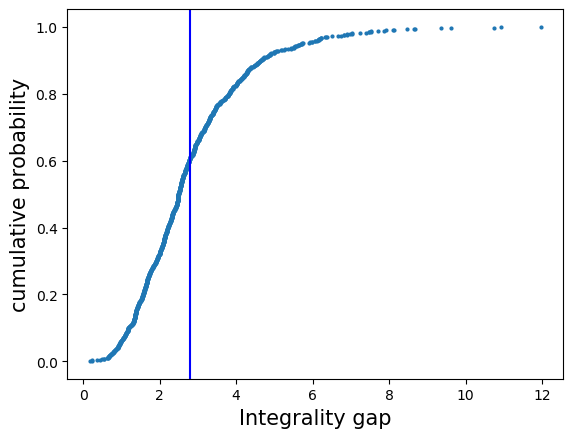

In [160]:
process(data1)

<function matplotlib.pyplot.show(*args, **kw)>

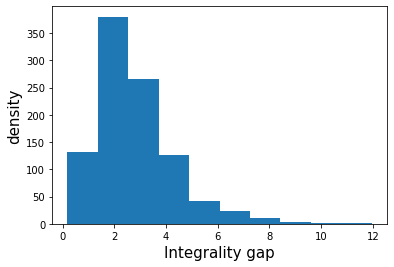

In [63]:
n, bins, patches = plt.hist(data1)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

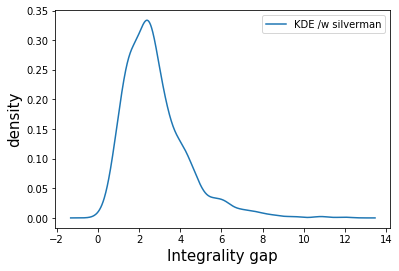

In [64]:
kernelDensity(data1)

In [46]:
data2 = the_loop(20,50,500)

[-0.  1.  1. -0.  1. -0.  0. -0.  0.  1.  1. -0.  1.  1. -0. -0. -0. -0.
 -0.  1. -0.  0.  1. -0. -0.  0. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.
 -0. -0. -0.  0.  1.  1. -0.  0. -0. -0. -0. -0.  0.  1.]
Obj: 14.0644
[0.         1.         1.         0.         1.         0.
 0.67850044 0.         0.16460974 0.89930316 1.         0.
 1.         1.         0.         0.         0.         0.
 0.33817983 1.         0.         0.6304731  1.         0.
 0.         0.42795021 0.         0.         1.         0.
 0.         1.         1.         0.         0.         0.49892157
 0.         0.         0.         0.38398889 1.         1.
 0.         0.         0.         0.         0.         0.
 0.59619779 1.        ]
Obj: 15.2123
15.212318358737935 relaxed 
14.064424216272137 original 
[-0.  0.  1.  0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.
 -0.  1.  0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.
  1.  1.  1.  1. -0. -0. -0.  0.  1. -0. -0. -0.  1.  1.]
Obj: 

[ 1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.
  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.
 -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.]
Obj: 15.9998
[1.         1.         0.         1.         1.         0.
 0.         0.79557314 0.48793599 0.         1.         0.
 1.         1.         0.         0.         1.         0.61246974
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.44334735 1.         0.59461768
 0.46072518 1.         0.         0.         1.         0.55563534
 0.         1.         0.         0.         1.         1.
 1.         1.        ]
Obj: 17.6406
17.640610241481255 relaxed 
15.999797666610624 original 
[ 1. -0.  0.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  0.  1.  1.
  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.
  0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  0. -0

[0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0.
 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1.
 0. 0.]
Obj: 11.3154
[0.         0.         1.         0.51467541 0.         0.90606712
 1.         1.         0.06509992 0.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.02459061 1.         0.7892109  0.         0.97951215
 0.         1.         1.         1.         0.         0.
 0.         1.         0.9239461  0.         0.20376979 0.84688914
 0.         0.0672116  0.27558558 1.         1.         0.
 0.51699173 0.         0.         0.         0.         1.
 0.13076925 0.        ]
Obj: 15.3903
15.39030473774286 relaxed 
11.315437249146626 original 
[ 1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  0. -0. -0. -0.
  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  0.  1. -0. -0.  1.  1.
  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.]
Obj: 14.6339
[1.         1.         0.  

[-0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.
  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 14.053
[1.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         1.
 1.         1.         1.         0.78047773 0.44412776 0.58142476
 0.         1.         0.         0.         1.         1.
 0.         0.98862741 1.         1.         0.44672469 0.70744514
 0.26884844 0.         0.         1.         0.96240879 1.
 0.         0.         0.         0.         1.         0.12731234
 0.         0.        ]
Obj: 15.1649
15.164852931637908 relaxed 
14.052996090997532 original 
Encountered an attribute error
[-0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0.  1. -0. 

[-0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.]
Obj: 9.36029
[0.         0.         0.         1.         0.         0.
 1.         0.         0.88305524 0.         0.         0.26116549
 1.         1.         1.         0.8239506  0.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.15108462 1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.30142018
 0.05946065 0.         0.74734324 0.         1.         0.
 0.         0.54103868 0.         0.         0.         0.98387406
 1.         0.        ]
Obj: 10.6542
10.654247960370313 relaxed 
9.36029070496939 original 
[-0. -0. -0.  1. -0.  0.  1.  0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.
  0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. 

[-0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
 -0.  1.  0. -0.  0. -0.  1.  1. -0. -0. -0.  1.  1. -0.]
Obj: 9.67779
[0.         0.97542588 0.         1.         1.         0.
 0.04861314 0.72197516 0.         0.         0.         0.10788133
 0.         0.         1.         0.         0.         0.30698487
 1.         1.         0.         1.         0.         0.54453486
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.68381512
 0.         0.49762845 0.3731811  0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.22527927 0.        ]
Obj: 13.6116
13.611616019950556 relaxed 
9.67778941386397 original 
[ 0.  1.  1.  0. -0. -0.  1. -0.  0. -0.  0.  1.  1.  1. -0. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0.
 -0.  0. -0. -0. -0.  1. -0.  1. -0.  0. 

[ 1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  0.  1. -0.  1. -0.  1.
 -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  0. -0.  1.  1. -0.  0.
 -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.]
Obj: 15.9471
[0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         0.80289133
 0.         1.         0.         0.95294467 0.         0.53099311
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.22789918 1.
 0.95845223 0.         1.         1.         0.08879156 0.
 0.85774879 0.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         0.72789415
 1.         0.        ]
Obj: 17.4747
17.474672912845946 relaxed 
15.94708897563331 original 
[0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0.
 0. 1.]
Obj: 14.1714
[0.         0.         0.  

[-0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.
 -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  0. -0.  0.  0.]
Obj: 10.9883
[0.3650589  0.         1.         0.         0.         0.
 0.32463437 0.43156209 0.41682055 1.         0.         1.
 1.         0.         0.59815719 1.         0.         0.
 0.81053631 0.         1.         0.26303074 0.         0.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.78284515 0.         0.79522347
 0.         0.10165057]
Obj: 13.38
13.37995724076284 relaxed 
10.988259972505118 original 
[-0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.
 -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 3.9

[-0.  0. -0.  0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  0. -0. -0.  1.  1.
 -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.]
Obj: 7.08173
[0.         0.31872025 0.         1.         1.         0.65299734
 0.55742268 0.         0.         0.24353994 0.2747194  1.
 0.         0.         0.         0.         0.93239921 0.84417946
 0.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.89775952 0.44956167 0.78987478 0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.79137988 1.         0.
 0.         0.        ]
Obj: 10.0985
10.098470909183687 relaxed 
7.081727943326108 original 
[-0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  0.  1. -0.  0. -0.  1.  1.
  1.  1.  1.  0.  1. -0. -0.  0.  0.  1. -0. -0.  1. -0. -0.  1. -0.  0.
 -0. -0. -0. -0. -0. -0. -0.  0.  1.  1. -0. -0.  1.  1.

[0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0.
 1. 0.]
Obj: 8.48022
[0.         1.         0.17316112 0.96921423 0.         1.
 0.         0.         1.         0.0684385  0.         0.56219587
 1.         1.         0.28844478 0.         0.48241515 1.
 0.         1.         1.         0.         0.         0.
 0.         0.59714763 0.49184982 0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.14227498 1.         0.3741911  0.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.        ]
Obj: 12.3445
12.344505362705346 relaxed 
8.480215834565081 original 
[ 1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.]
Obj: 13.2662
[1.         1.         0.         0.       

[ 1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  0. -0.  1. -0.  0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0. -0.  1.  1.  0. -0. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 2.90861
[1.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         0.02984135 0.
 0.         1.         0.         0.         0.1656627  1.
 0.         0.47473566 0.22084077 0.81902399 0.         0.
 1.         0.         1.         0.         0.         0.
 0.22248438 0.36478001 0.75455008 0.36049388 0.         0.
 0.         0.         1.         0.99274195 0.         0.57710102
 0.         0.22432694 0.1155276  0.         0.         0.7568228
 0.         1.        ]
Obj: 7.19666
7.196664249681154 relaxed 
2.9086084144296147 original 
[ 1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.
 -0. -0.  1. -0. -0.  1.  1.  0. -0.  1.  1.  0.  1.  1.]

[-0.  0.  1. -0.  0.  0. -0. -0. -0. -0.  1. -0.  0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  0. -0.  1. -0. -0.  1.  0. -0.  1. -0. -0.  1.
 -0. -0.  1. -0.  0. -0.  0. -0. -0.  1. -0.  1. -0. -0.]
Obj: 6.65941
[0.         0.         1.         0.         0.52431364 0.
 0.         0.         0.20705526 0.         1.         0.
 0.8683594  1.         1.         0.         0.63584286 0.
 0.         0.         0.         0.         0.02989595 1.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.53342955 0.08826052 0.
 0.25188829 0.         1.         0.         0.         0.
 0.12883593 0.         0.         1.         0.         0.
 0.44481587 0.        ]
Obj: 10.0272
10.027159232885893 relaxed 
6.65940904974324 original 
[ 1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.]
Obj: 12.6571
[1

 1. 0.]
Obj: 10.7247
[1.         0.9056869  1.         0.91367749 0.         0.82967323
 0.         0.         0.         0.         0.         0.
 0.         0.96695159 0.         1.         1.         1.
 1.         1.         0.         0.         0.07895633 0.
 0.         0.         0.         0.         0.         0.
 0.         0.68901283 0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.4644401  1.
 0.69247805 0.        ]
Obj: 12.8124
12.812399163423443 relaxed 
10.724722946185237 original 
[ 1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 8.77761
[1.         0.         1.         0.37998591 1.         0.
 1.         1.         0.         0.         0.         0.
 0.26795315 0.         0.         0.28752511 0.         1.
 0.77687885

[ 1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.
 -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.]
Obj: 9.81951
[1.         0.58375421 0.         1.         1.         0.43280958
 0.         0.         0.         0.         0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.03141835 0.05132023 0.         0.         0.         1.
 0.         0.88790949 1.         0.         0.71577855 0.
 0.         0.         0.09616373 1.         0.         1.
 1.         1.        ]
Obj: 11.0116
11.01164380091232 relaxed 
9.819514120564117 original 
[ 1.  1.  1. -0. -0.  1. -0.  0.  1. -0.  1. -0. -0. -0.  1. -0.  0. -0.
 -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  0. -0. -0.  0.
  1. -0.  1. -0.  1.  1. -0. -0. -0.  0. -0. -0.  1. -0.]
Obj: 11

[-0.  1. -0.  0. -0.  1. -0. -0. -0. -0.  0.  1.  0. -0. -0.  0. -0. -0.
 -0.  1. -0.  0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0. -0.  1.  1.  0. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 4.56211
[0.         0.         0.         0.52833837 0.         1.
 0.         0.         0.         0.         0.52383488 1.
 0.         0.         0.         0.23247175 0.07048538 0.
 0.         1.         0.         0.         0.         0.51209231
 0.         1.         1.         0.         0.         0.
 0.         0.92434753 0.         0.98909742 1.         1.
 0.         0.         0.         1.         1.         0.60717208
 0.         0.         0.         0.         0.32226362 0.
 1.         0.        ]
Obj: 6.96999
6.969991283167625 relaxed 
4.562112141335989 original 
[ 1. -0.  1. -0.  1. -0. -0.  0. -0. -0. -0.  1.  1. -0.  1. -0.  0. -0.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.
  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.]

[ 1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.
  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 12.0034
[1.         0.         0.77240918 0.         0.         0.
 0.21842098 1.         1.         0.         0.42695165 1.
 0.         1.         0.81952741 0.         0.         0.
 0.         0.         0.         0.51687639 1.         0.
 0.03006315 0.2293811  1.         1.         0.5523051  1.
 0.98137252 0.36885951 0.         0.         1.         0.
 0.         0.         0.17714126 0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.        ]
Obj: 14.556
14.55601615163132 relaxed 
12.00335657530074 original 
[-0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.
  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.]
Obj: 13.9565
[0.

[-0.  0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  0.  1.  1.  1. -0.
 -0. -0.  1.  0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  0.
 -0. -0.  1.  1.  1. -0. -0.  1.  0. -0. -0. -0.  1. -0.]
Obj: 10.1208
[0.         0.         1.         0.         0.         1.
 0.38344929 0.         0.53855467 0.         0.         0.
 0.15246695 0.21279635 0.         1.         1.         0.
 0.17912723 0.3345818  1.         0.         1.         0.
 1.         1.         1.         0.97013525 0.23763934 0.85456595
 0.         1.         1.         1.         1.         0.
 0.         0.         0.61068286 1.         1.         0.
 0.44704943 1.         0.         0.         0.74315224 0.
 0.         0.        ]
Obj: 13.0353
13.035339019117552 relaxed 
10.120815667709468 original 
[-0.  1.  0. -0.  0. -0. -0.  0. -0. -0. -0. -0. -0.  0.  1. -0. -0. -0.
  1.  0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  0.  1.  1.  1.  1.
 -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  0.  0.  1.  0.]
Obj: 

[-0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.
  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.
  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.]
Obj: 14.0903
[0.         0.         0.         1.         0.3999456  0.
 0.75547543 0.         1.         0.31700745 0.         0.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.61915636 0.         1.
 0.         1.         0.         1.         1.         0.36504009
 0.         1.         0.15993695 1.         0.68570386 1.
 0.55488928 0.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         1.
 0.         0.        ]
Obj: 16.0611
16.06111971879651 relaxed 
14.090290679574379 original 
[ 1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.]
Obj: 2

[-0.  0.  1.  0.  1. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0.  0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0.  0.  0. -0. -0.  0. -0.  1. -0. -0.
 -0.  1.  0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  0.]
Obj: 5.25636
[0.         0.         1.         0.00718169 1.         0.
 0.89383227 0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.26859157
 0.         1.         0.         0.26677394 0.         0.
 0.41831294 1.         0.62234355 0.83510458 0.         0.
 0.         0.         0.71729712 1.         1.         1.
 1.         0.36835064]
Obj: 7.32934
7.329336526619216 relaxed 
5.2563568451079945 original 
[-0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.
  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.]
Obj: 1

[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
 -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.]
Obj: 12.2898
[0.         0.         0.90282605 0.82726448 0.         0.25522786
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         1.         1.         0.         0.92358964 1.
 1.         0.36209462 0.63541207 1.         1.         0.
 0.         0.         1.         0.1645901  0.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         0.30765354 0.         0.
 0.         0.        ]
Obj: 14.8276
14.827564845149679 relaxed 
12.289792334178768 original 
[0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0.
 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0.
 0. 1.]
Obj: 10.976
[0.         1.         1.         1.       

[-0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.
  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.]
Obj: 11.1852
[1.         0.78670974 0.         0.         0.         1.
 0.         0.2440502  0.88714961 0.         1.         0.
 0.         0.60613624 0.         0.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.93407535 0.         0.         1.         0.05838414 0.
 0.         0.67595338 0.         0.         0.         0.86773749
 1.         0.         1.         1.         0.         1.
 0.48407008 0.68804808 0.         1.         1.         1.
 0.         0.        ]
Obj: 13.7981
13.798147873825918 relaxed 
11.185177635043036 original 
[-0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.
  1.  0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.]
Obj: 

[ 1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.
 -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.]
Obj: 11.1787
[1.         0.         0.         1.         0.         1.
 0.93908056 1.         0.         0.         1.         0.20966031
 0.         1.         0.         0.         1.         0.31036893
 0.         1.         0.         0.         1.         0.
 0.61610487 1.         0.6297499  0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.1665371  0.         0.         0.06427021 0.         0.
 0.7868254  0.         0.52297359 0.39767972 1.         1.
 0.         0.        ]
Obj: 13.5006
13.500613334560839 relaxed 
11.178664861108636 original 
[-0. -0.  1.  1. -0.  1.  1.  0. -0.  1.  0.  1. -0. -0. -0. -0.  1. -0.
  1.  0. -0.  1.  1.  1. -0. -0.  1. -0.  0.  0. -0.  1.  1. -0.  0.  1.
 -0. -0. -0. -0.  1.  1. -0.  1.  0.  1. -0. -0. -0.  1

[-0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  0. -0. -0.  1.
 -0. -0.  0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 6.14138
[0.         1.         1.         0.         1.         0.
 0.         0.         1.         0.80391054 1.         0.
 0.         0.         0.         0.         0.         0.24607363
 0.         1.         1.         1.         0.         1.
 0.         0.         0.57519174 0.         0.11903062 0.
 0.         1.         0.91970033 0.         0.18831535 0.85433849
 0.         0.         0.60781786 1.         0.         0.
 0.         0.         0.         0.         0.41822391 1.
 0.         0.        ]
Obj: 7.3633
7.363295279051483 relaxed 
6.141380728726431 original 
[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  0.  0. -0. -0. -0. -0.  0.
  1.  1. -0.  1. -0. -0.  0. -0.  1. -0.  1. -0.  1.  1.  0.  0. -0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.]


[0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0.
 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0.
 1. 1.]
Obj: 11.6929
[0.         0.         1.         1.         0.         0.75092508
 1.         0.38997372 0.         1.         1.         1.
 1.         0.75527817 0.         0.         0.         0.
 0.         0.25111017 1.         0.46386199 0.4854442  0.
 1.         0.         1.         0.         1.         0.
 0.09431949 1.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         0.04264039 0.
 1.         0.95197514]
Obj: 13.5144
13.51438574448332 relaxed 
11.692941310843278 original 
[ 1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 5.53864
[1.         0.55069952 1.         0.3169244

[ 1. -0.  0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  0.  0.  1.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  0. -0.
 -0. -0.  0.  1. -0. -0.  0.  0.  1. -0.  1.  1. -0. -0.]
Obj: 1.06658
[0.68633399 0.         0.20722085 1.         0.74136388 0.
 0.         1.         0.         0.15551636 0.         0.
 0.         1.         0.26817498 1.         1.         0.
 0.16267453 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.96390877 0.
 0.         1.         1.         0.         0.         0.
 0.         0.06698246 0.22367158 1.         0.         0.
 0.17127223 0.22285215 0.         0.         1.         0.
 0.         0.        ]
Obj: 5.04913
5.0491264372130775 relaxed 
1.0665829222719863 original 
[-0.  1.  1. -0.  0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0.  1.
 -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  0.  1.  1.]
Obj: 10.5963


[0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0.
 0. 0.]
Obj: 6.13482
[0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.0809207  1.         0.         1.         0.15109306
 1.         0.         0.48003192 0.         0.66938524 1.
 0.         0.         0.         1.         0.63348466 0.
 0.51609609 0.34613625 0.         1.         0.39762793 0.
 0.69015179 1.         1.         1.         0.         0.60906027
 0.         0.18648441 1.         0.6458455  0.         0.53195794
 0.         0.        ]
Obj: 10.2778
10.27777607455659 relaxed 
6.13481738693485 original 
[-0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.
  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.]
Obj: 11.463
[0.64479721 1.         0.     

[ 1. -0. -0.  0.  1. -0.  0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  0.
 -0. -0.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.]
Obj: 3.96828
[0.48256928 1.         0.         0.         0.55857788 0.23533255
 0.         0.         0.         0.         0.02492023 0.25831855
 0.74857374 0.         0.09081952 0.         0.03219127 0.13853319
 0.         0.         0.         0.17113179 1.         1.
 0.         0.         0.67736791 0.         0.         0.
 0.         0.83355258 1.         0.         0.         1.
 0.         1.         1.         1.         0.         0.09755229
 0.21930985 0.         0.35085071 0.         0.         0.
 0.         1.        ]
Obj: 10.8136
10.813608870569393 relaxed 
3.9682768171260165 original 
[1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0.
 1. 1.]
Obj: 8.11427
[1.         0.    

[1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1.
 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0.
 1. 0.]
Obj: 13.593
[1.         0.         1.         0.86862488 1.         0.
 1.         0.         1.         0.         1.         0.
 0.73217733 0.         0.         0.63585847 0.         1.
 0.         1.         0.         0.90998019 1.         1.
 0.         0.83438076 1.         0.         0.71285575 0.
 0.38060382 0.         0.         1.         0.         0.
 0.         0.         0.29208876 0.49606992 1.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.        ]
Obj: 14.5998
14.599750190763949 relaxed 
13.592996713921572 original 
[-0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0.  0.  1.  1. -0. -0.  0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 4.57345
[0.         0.         0.         1.         0.    

Encountered an attribute error
[-0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  0.  1.
 -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.
 -0.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  0. -0.]
Obj: 12.5107
[1.         0.         1.         0.         1.         0.63879638
 0.         0.0111423  0.         0.         0.         0.
 0.19119035 0.05516195 1.         1.         0.         0.44131893
 0.01585943 0.         1.         0.         0.19541627 1.
 0.         0.41016003 1.         1.         0.87288433 1.
 1.         0.         0.         1.         0.         0.
 0.         0.60380327 1.         0.55074688 0.66118185 1.
 0.         0.         1.         0.         0.89278922 0.
 1.         1.        ]
Obj: 17.7942
17.794168456001792 relaxed 
12.510667647188937 original 
[ 1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.
 -0. -0. -0.  1. -0.  1.

[1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1.
 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0.
 0. 0.]
Obj: 11.1258
[1.         0.         0.         0.         0.59555617 0.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         0.84288737 0.         1.
 0.01272987 0.         1.         0.10532993 1.         1.
 0.         0.         0.         0.         0.17085942 1.
 1.         0.         0.         1.         0.50316029 0.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.52335021 0.96178656 0.         0.5167355
 0.125253   1.        ]
Obj: 12.965
12.964996261715708 relaxed 
11.125832064099418 original 
[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.
  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.]
Obj: 17.0437
[0.         0.         0.2255576  0.        

[-0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.
 -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.]
Obj: 5.18624
[0.         1.         0.98391307 0.34958404 0.         0.
 0.22120012 0.         0.         0.         0.         0.
 0.         0.         0.         0.25416895 0.         0.
 0.77658329 0.         1.         0.98323703 0.         0.
 0.         1.         0.         1.         0.61878264 1.
 0.         1.         0.         0.         0.         0.83851756
 0.         0.83781097 1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.01415991
 0.99162498 0.85865968]
Obj: 11.3994
11.399356219443042 relaxed 
5.18623728538966 original 
[0. 1. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0.
 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1.
 1. 0.]
Obj: 17.1988
[0.         1.         1.         0.

[ 0. -0. -0. -0.  0. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0. -0.  1. -0.  1. -0.  0.  1. -0. -0. -0.  1.  0.  1.  1. -0.
  1.  1. -0.  1. -0. -0.  0.  1. -0.  1.  0. -0. -0. -0.]
Obj: 12.6447
[0.71878399 0.         0.         0.         1.         0.
 1.         0.28180551 0.3379515  1.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.2521755  1.         0.         0.
 0.         0.97154374 0.15022437 1.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         0.09594879 0.
 0.         0.        ]
Obj: 13.9523
13.952280968175572 relaxed 
12.64473013395067 original 
[1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1.
 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1.
 1. 0.]
Obj: 13.6084
[0.11248521 0.1830584  0.19669135 0.88247213 0.    

[-0. -0.  0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  0.  1.  0.  0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.
  0. -0.  1.  1. -0.  0. -0. -0.  1.  1. -0.  1. -0.  1.]
Obj: 17.7018
[0.         0.         0.47575032 1.         0.         0.45157681
 0.         0.         1.         0.         0.07555087 1.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         0.87387914 0.
 0.         0.         0.03886717 1.         1.         1.
 0.         0.2041669  1.         1.         0.         0.
 0.3853706  0.         1.         0.76495954 0.         0.57724048
 0.         0.         1.         1.         0.27740658 0.95457424
 0.         1.        ]
Obj: 19.7604
19.760401354365214 relaxed 
17.701790475086852 original 
[-0. -0. -0.  1.  0. -0.  1. -0.  1.  0.  1.  1.  1. -0. -0.  0.  0. -0.
  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.
  0. -0.  1. -0.  0. -0. -0.  1. -0.  0. -0.  1

[ 0.  0.  1.  0.  1.  0.  0.  1. -0. -0.  1.  0. -0. -0. -0. -0. -0.  1.
 -0.  1.  0.  0. -0.  0. -0.  1.  0.  0.  1.  0. -0.  0. -0. -0.  0. -0.
  1. -0.  0.  0.  0. -0.  1.  0. -0. -0. -0.  1.  1.  1.]
Obj: 4.34996
[0.3314196  0.07564184 1.         0.37116344 1.         0.26431042
 0.         0.17270805 0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.79762164 0.37572182 0.         0.         0.
 0.         1.         0.80690062 0.         0.46447097 1.
 0.         0.         0.         0.         0.41120629 0.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.        ]
Obj: 9.30886
9.30885941248566 relaxed 
4.349960539496104 original 
[ 1.  1.  1.  1.  0. -0.  1. -0.  1. -0.  1.  0.  1.  1. -0. -0.  1.  1.
 -0.  0.  1.  1. -0. -0.  1.  1.  0.  1. -0.  1.  1.  1.  0. -0.  1. -0.
  1. -0.  0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.]
Obj: 22.

[ 0.  0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  0. -0.  1. -0.  1.  1.  1.
 -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.
  0. -0. -0.  1. -0.  1. -0.  0. -0. -0.  1. -0.  1. -0.]
Obj: 19.8109
[1.         0.38524948 0.08919842 0.         1.         0.
 0.         0.84039137 1.         1.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.01140703 0.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.94858719 0.         0.14261283 1.         0.
 1.         0.        ]
Obj: 20.9332
20.933206655488537 relaxed 
19.810872736987264 original 
[-0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.]
Obj: 13.4621


[-0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.]
Obj: 13.2964
[0.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.52418926 0.92066671 0.17961965 1.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         0.79729128
 0.50562748 0.         0.         0.         0.         0.89897851
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.        ]
Obj: 14.4924
14.492377171911974 relaxed 
13.29638887380833 original 
[ 1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.
  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.

[ 1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.]
Obj: 9.1297
[1.         0.         1.         1.         0.         0.
 0.12539776 1.         0.         1.         0.         0.
 1.         1.         1.         0.43587974 0.         0.
 0.         0.66501266 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.06905029
 0.         0.         0.         0.         0.57410359 0.80012665
 1.         1.         1.         1.         0.         1.
 1.         0.         0.81357884 0.15667105 0.         1.
 1.         0.        ]
Obj: 11.2677
11.26773813519137 relaxed 
9.129701803192763 original 
[ 1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.
  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.]


[1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0.
 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0.
 1. 1.]
Obj: 13.3836
[1.         1.         0.         0.         0.59396156 0.
 1.         0.         0.36673142 0.         0.7947902  0.
 0.         1.         1.         1.         0.43915962 0.
 1.         0.         0.91542852 1.         0.         0.
 0.         1.         0.         1.         0.         0.07080101
 0.         1.         0.         0.         0.65218518 0.97928164
 0.         0.         0.         1.         0.         0.
 0.         0.6395875  0.         1.         1.         0.
 1.         1.        ]
Obj: 16.4589
16.458904179730535 relaxed 
13.383601670705277 original 
[-0.  1.  0. -0. -0. -0. -0.  1. -0.  0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0. -0.  0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.
 -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.]
Obj: 7.97894
[0.         1.         0.34711763 

[-0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.
 -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.]
Obj: 8.61954
[0.         0.85351829 1.         0.         0.         1.
 0.         0.         0.         0.99647909 0.54953798 0.63541265
 1.         1.         0.81714097 0.         1.         0.66938777
 0.         0.         0.39404709 1.         0.         0.
 0.         1.         0.         0.01833781 0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         0.         0.01652882 1.
 0.         0.49826266 0.         0.37423616 1.         1.
 0.         0.        ]
Obj: 10.6517
10.651666765022847 relaxed 
8.619544943511587 original 
[ 1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  0. -0. -0. -0.  0.  1.  0.  1.
  1.  0.  0. -0. -0.  1.  0. -0. -0. -0. -0. -0.  0.  0. -0. -0. -0.  0.
  1. -0. -0.  0. -0.  1.  1. -0.  1.  1. -0.  0. -0. -0.

[-0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  0.
  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  0.  1.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.]
Obj: 15.5588
[0.         1.         1.         0.         0.         0.
 0.         1.         0.29580184 1.         1.         0.
 0.         0.         0.50034848 0.41927822 0.         0.
 1.         1.         0.45505498 0.         0.         1.
 1.         0.         0.         0.81181752 1.         0.
 0.         1.         0.4159245  1.         1.         0.65497786
 1.         0.         1.         0.72571584 0.90357572 0.69316232
 1.         1.         0.         0.         0.66438784 1.
 1.         1.        ]
Obj: 17.4868
17.486834864952158 relaxed 
15.558753239135829 original 
[-0.  1. -0. -0.  1.  1.  0.  1. -0. -0.  1.  1.  0.  1. -0. -0. -0.  1.
 -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0.  0. -0.
  1.  0. -0.  1.  1.  1.  0.  1. -0. -0.  1.  1.  1. -0

[ 1.  0.  1.  1.  1.  0.  1. -0. -0.  1.  0.  1.  1. -0.  1.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.]
Obj: 14.7134
[0.56916257 1.         1.         0.00413756 0.         0.
 0.98653324 0.         0.         1.         0.         1.
 1.         0.         0.97453987 1.         1.         0.
 1.         0.12770679 0.         0.         0.35494241 0.
 1.         0.         0.         1.         0.         1.
 1.         0.83863557 1.         0.         1.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         0.         0.68146302 1.         1.
 0.02626167 0.50735441]
Obj: 16.4479
16.447871149891654 relaxed 
14.713415145091863 original 
[-0.  0. -0. -0.  1.  1.  0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0.  0.  0. -0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1. -0. -0.
 -0.  1.  0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  0.]
Obj: 18.1376


[ 0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.
 -0.  1. -0. -0.  0.  0. -0. -0.  1.  1.  0. -0. -0.  1.  1.  0.  0. -0.
 -0.  1.  1.  1. -0.  0. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 10.6994
[1.         0.         0.83259737 1.         0.         0.
 0.34724986 1.         1.         0.         0.54415827 0.
 1.         0.         0.41979943 0.72528077 0.         1.
 0.         1.         0.         0.         0.31196018 0.
 0.97185703 0.         1.         1.         0.48414759 0.
 0.         0.73407097 1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.91518945
 0.51447372 0.         0.         0.         0.09756178 0.
 0.         1.        ]
Obj: 14.7696
14.769645715630215 relaxed 
10.699380305465121 original 
[-0.  0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.
 -0. -0.  1.  1.  1. -0. -0.  1.  1.  0. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  0. -0. -0. -0.  1. -0. -0.]
Obj: 

[-0. -0.  1. -0. -0. -0. -0.  1. -0.  0.  1.  0.  0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.]
Obj: 6.46611
[0.         0.         1.         0.         0.         0.
 0.79861691 1.         0.         0.         0.84289424 0.94222678
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.77029807 1.         0.         0.         0.         0.
 0.         0.         0.27237473 0.         0.         0.
 0.75168995 0.         0.         0.37888059 0.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.        ]
Obj: 8.11424
8.114243359750564 relaxed 
6.466106763492654 original 
[-0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.]
Obj: 12

[ 1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.
 -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.
  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.]
Obj: 12.3481
[0.         0.         0.         1.         0.         0.
 0.         1.         1.         0.79079457 0.         1.
 0.97198776 0.20088809 1.         1.         0.         1.
 0.         0.4796508  0.         1.         0.         0.
 1.         0.         1.         0.         0.01436546 0.429222
 0.         0.50628642 0.         0.         0.         0.46258195
 1.         0.35240376 1.         0.23839281 0.         1.
 0.17072725 1.         0.         0.         1.         1.
 1.         1.        ]
Obj: 15.3455
15.345504432047226 relaxed 
12.348119127859555 original 
[ 1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  0. -0. -0. -0.
  1.  1. -0. -0.  1.  0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0.  1.  1.  1.  0. -0. -0. -0. -0. -0.  1.  1. -0.]

Encountered an attribute error
[-0.  1. -0.  1.  1.  1.  1.  1. -0.  0. -0. -0.  1.  0. -0. -0.  0.  0.
  1. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  0. -0.  1.  1.
  1.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.]
Obj: 17.7605
[0.         1.         0.         1.         1.         1.
 0.54798071 1.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.26625887 0.         0.99093079 1.         1.
 1.         0.34214108 0.         0.58632735 0.         1.
 1.         0.51734097 0.49984416 0.         1.         1.
 1.         1.         1.         0.         1.         0.39814841
 1.         1.         1.         0.         0.         0.
 1.         0.        ]
Obj: 19.9809
19.980851779095435 relaxed 
17.760538027962212 original 
[ 1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1. -0.

mean: 2.556228862510789
median: 2.26843636088244
standard deviation:1.4133946237856678


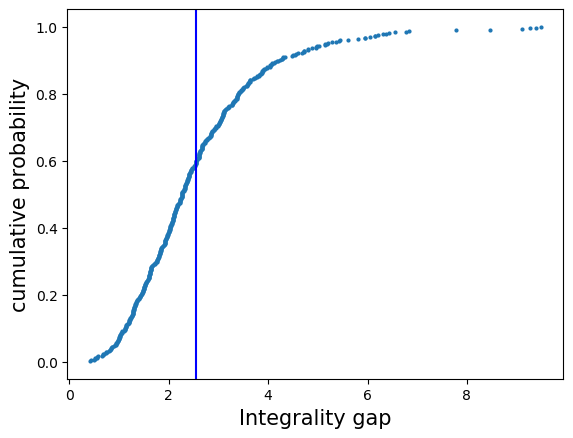

In [161]:
process(data2)

<function matplotlib.pyplot.show(*args, **kw)>

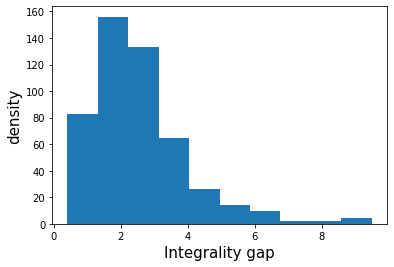

In [65]:
n, bins, patches = plt.hist(data2)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

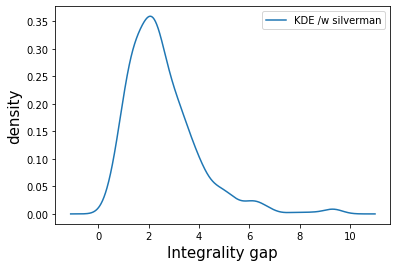

In [66]:
kernelDensity(data2)

In [50]:
data3 = the_loop(20,50,100)

[-0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  0.  1.]
Obj: 5.53986
[0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.31477089 0.         0.         1.         0.         0.
 0.06879626 1.         0.         0.         0.         0.
 0.         0.         0.80294269 0.23994988 0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.11446926 0.06040998 0.         0.67369875
 0.         0.22854116 0.         0.         0.19776822 0.
 0.         0.49659183]
Obj: 10.9666
10.96659282502783 relaxed 
5.539859288353149 original 
[ 1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.]
Obj: 9.

[-0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  0. -0.  1. -0.
 -0. -0.  0. -0. -0. -0.  1. -0. -0.  1. -0.  0.  1. -0. -0.  1. -0. -0.
  0.  1. -0. -0. -0. -0.  1.  0. -0. -0.  0. -0.  1. -0.]
Obj: 6.11306
[0.64544851 0.         1.         0.         0.11587861 1.
 0.80630862 0.20821456 0.         1.         0.         0.
 0.08773142 0.         0.20066868 1.         1.         0.43297959
 0.         0.         0.         0.         0.         0.
 1.         0.         0.96374114 1.         0.         0.
 1.         0.         0.         1.         0.23039574 0.65172255
 0.43314183 1.         0.25448187 0.         0.         0.
 0.         0.66882245 0.         0.         0.20515993 0.
 1.         1.        ]
Obj: 11.9844
11.98440217108694 relaxed 
6.113056395844197 original 
[ 1.  1.  0.  0.  1.  1. -0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.
  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  0.  1.  1.  1.  1. -0.
 -0.  1.  1. -0. -0.  1.  0. -0.  1. -0.  1. -0.  0. -0.]

[ 1. -0. -0.  1. -0.  1.  1.  1. -0.  0.  1.  1. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.
  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 14.9133
[1.         0.         0.9265699  1.         0.         0.72719364
 1.         1.         0.98055753 0.         1.         1.
 0.         0.         0.         0.6433909  0.09176087 0.53938231
 0.         0.11019319 0.         0.         1.         0.
 0.70358714 1.         1.         0.         1.         1.
 0.33916172 0.         0.         0.         1.         1.
 1.         0.         0.00543653 0.         0.59075786 0.73916091
 0.         0.         0.32709026 0.         1.         0.
 0.17652433 1.        ]
Obj: 18.7665
18.766496016973736 relaxed 
14.913284691470981 original 
[1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 1.
 0. 1.]
Obj: 9.47442
[1.         1.         0. 

[1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 1.
 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0.
 1. 1.]
Obj: 17.0969
[0.70889763 1.         1.         0.06498957 0.94611325 1.
 0.         0.56877126 1.         0.         1.         0.
 0.67375195 1.         1.         1.         1.         0.78419532
 0.43008211 0.         0.         1.         0.         1.
 0.51356562 0.         1.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 0.27623235 0.         0.43382766 0.         1.         1.
 1.         1.         0.         0.         0.         0.24266081
 1.         1.        ]
Obj: 19.9142
19.91423058286693 relaxed 
17.096898334915043 original 
[-0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.
 -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  0.  1. -0. -0. -0.
 -0. -0. -0.  0. -0. -0.  0. -0.  1.  1.  1.  1.  1. -0.]
Obj: 14.2455
[0.05108369 0.         0.         0

[ 0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.
  1. -0. -0.  0.  1. -0. -0. -0.  1.  1. -0.  1.  0. -0.]
Obj: 4.01309
[0.58460505 0.         0.85157861 0.         1.         0.
 1.         0.23871532 0.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.17654459 0.28258327 0.         0.
 0.         0.         0.         0.         0.27948129 0.
 0.95378017 1.         0.         0.59200657 0.79369473 0.10469665
 1.         0.         0.         0.         0.97343725 0.
 0.         0.         0.69733854 0.         0.         1.
 0.         0.        ]
Obj: 8.03609
8.036094319213529 relaxed 
4.013088668809478 original 
[-0.  0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.
  1. -0.  1.  1.  1.  1. -0.  0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  0.
 -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  0. -0. -0.]
Obj: 15

[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0.
 1. 1.]
Obj: 7.30164
[0.         0.60701144 0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         0.61734096 0.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.89776899 0.
 0.         0.         0.         0.         1.         0.81535642
 0.         0.35253429 0.         0.         1.         1.
 0.11675856 1.         0.70797157 0.         0.         0.
 1.         1.        ]
Obj: 8.671
8.671004421560962 relaxed 
7.30163858178236 original 
[ 1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  0.
 -0. -0.  0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  0.  1. -0.  1.]
Obj: 21.1199
[1.         1.         1.         0.79425596 1.

[ 0.  0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.
  1. -0.  1.  0. -0.  0.  0.  1. -0.  1. -0. -0.  0. -0.  0.  0.  1.  0.
  1. -0. -0. -0.  0. -0. -0.  1. -0.  0.  1.  0.  1.  1.]
Obj: 11.973
[0.         0.07848209 0.         0.         0.57112616 0.
 1.         0.         0.         0.         0.         1.
 0.66949606 0.36602875 0.         0.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.972902   0.         1.         0.32393285 0.
 0.37626365 0.         0.36028221 0.94930226 1.         1.
 1.         0.         0.71276308 0.26116811 0.         0.
 0.         0.         0.         0.18986037 1.         1.
 1.         1.        ]
Obj: 14.7263
14.726344837029176 relaxed 
11.973036835517547 original 
[-0.  1. -0.  0.  1.  1. -0. -0. -0.  0. -0.  1. -0. -0. -0. -0.  0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  0. -0. -0.  1.  1. -0.
 -0.  1.  0.  1.  0. -0. -0. -0.  0.  1.  1.  1. -0. -0.]
Obj: 14.3702
[

[-0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.
  1. -0.  1. -0. -0.  1.  1. -0. -0.  0.  0.  1.  1.  1.  1.  1.  1.  1.
  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.]
Obj: 13.4533
[0.         0.         0.         0.704711   0.         0.
 0.         1.         1.         0.         0.         0.7908013
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         0.23567868 0.         1.
 1.         0.         0.         0.93060644 0.         1.
 1.         1.         1.         1.         0.88077144 1.
 0.22064598 0.         0.00564252 0.41257994 0.86848481 0.
 1.         0.         1.         1.         0.         0.9570465
 0.         0.        ]
Obj: 15.3906
15.390603686029568 relaxed 
13.453269715118024 original 
[ 1. -0. -0.  1.  0.  1. -0. -0.  1.  1.  0. -0. -0.  1.  1.  1. -0. -0.
 -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  0. -0.  1. -0. -0.  0.  0.  1.
  0.  0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.]

[0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0.
 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1.
 0. 0.]
Obj: 15.7792
[0.74953518 0.         0.         0.56643548 0.         1.
 1.         0.         0.48897221 0.         0.         1.
 1.         0.         0.         1.         0.         0.70334043
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         0.16541485 0.79179572
 0.82504541 0.         1.         0.1475585  1.         0.
 1.         0.         0.         0.71405848 0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.27626085]
Obj: 18.2688
18.2687627831828 relaxed 
15.779248118301657 original 
[1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0.
 1. 0.]
Obj: 2.64959
[1.         1.         0.         0.         0.         0.
 1.         0.         0.  

mean: 2.4989509167032717
median: 2.0534916210323324
standard deviation:1.4484020199070764


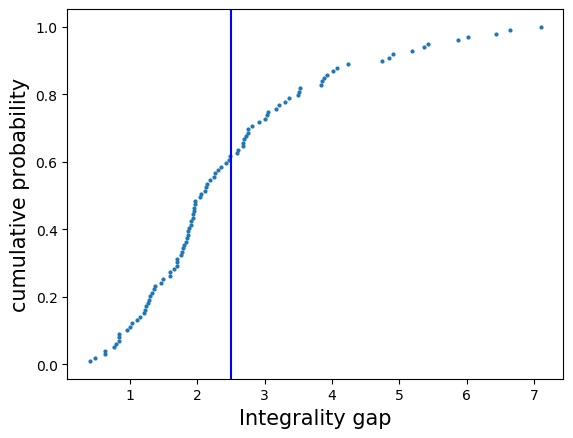

In [162]:
process(data3)

<function matplotlib.pyplot.show(*args, **kw)>

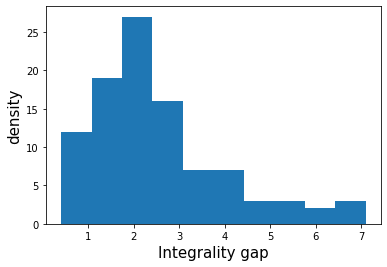

In [67]:
n, bins, patches = plt.hist(data3)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

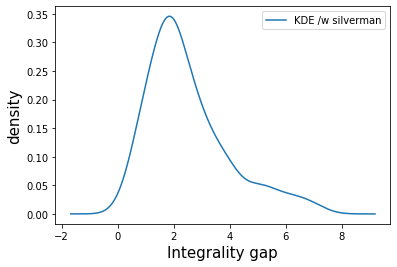

In [68]:
kernelDensity(data3)

In [54]:
data4 = the_loop(20,50,50)

[1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1.
 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0.
 1. 0.]
Obj: 16.031
[1.         0.11829985 1.         0.         0.30812042 0.3666282
 0.         1.         0.13926391 1.         1.         1.
 1.         0.         0.         0.         0.         0.61727862
 0.         0.07954539 1.         1.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.4651957  1.         0.05548747 1.
 1.         0.         1.         0.97153372 0.         1.
 0.76714019 0.         0.         0.         1.         0.
 1.         0.        ]
Obj: 17.4184
17.41843827909304 relaxed 
16.0310134898565 original 
[ 1. -0. -0.  1.  0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  0. -0.
  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  0.  1.  1.  1.  1.
  1.  0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.]
Obj: 10.7225
[1.         0.         0.08327837 1.   

[0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1.
 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 1. 0.]
Obj: 5.78855
[0.         1.         0.         1.         1.         0.38946913
 0.         0.         0.         0.         1.         0.
 0.3629828  0.         0.27453639 0.86323733 0.         1.
 0.         1.         1.         1.         0.         0.67224364
 0.94034508 1.         0.         0.         1.         1.
 1.         0.80494835 0.44362733 0.         0.         0.
 0.30557477 0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.43693159 0.        ]
Obj: 7.7715
7.771498826278221 relaxed 
5.788546088703059 original 
[ 1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.]
Obj: 1.04952
[0.35023577 1.         1.         0. 

[-0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 15.627
[0.13802552 1.         1.         0.         0.44076835 1.
 1.         1.         1.         1.         0.92407911 1.
 0.         0.         1.         1.         1.         0.
 0.61665886 1.         0.         1.         1.         1.
 1.         0.         1.         0.71744772 0.         0.
 0.13844214 1.         0.         1.         1.         0.
 1.         1.         0.         0.58353918 1.         1.
 0.01142724 0.         0.         1.         0.         1.
 0.         0.        ]
Obj: 17.6082
17.608193228171523 relaxed 
15.627026856432828 original 
[-0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  0. -0. -0. -0.  1. -0. -0.  1.
 -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.
 -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.]
Obj: 8.27184
[

[0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1.
 0. 1.]
Obj: 10.6693
[0.         1.         1.         1.         0.         1.
 0.28021281 0.211777   0.         0.         1.         0.
 0.         1.         0.45886236 0.         0.         0.52784223
 0.         1.         0.         0.         0.         0.36581371
 1.         0.         0.         0.31228949 0.         0.38479831
 0.86724085 0.74238998 1.         1.         0.         1.
 0.37093099 0.         0.15296404 0.45010305 0.         0.16236034
 0.         0.57298855 0.         1.         1.         1.
 0.         0.        ]
Obj: 16.3823
16.382256514649 relaxed 
10.669260533019777 original 
[ 1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.
 -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.]
Obj: 13.0024
[0.87055071 0.       

[1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1.
 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0.
 1. 0.]
Obj: 8.57094
[1.         0.19330394 0.73208156 1.         0.1285509  1.
 0.53382308 0.         0.         1.         1.         0.77666594
 1.         0.         1.         0.87083288 0.         1.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.57974891 0.         0.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.30192046 0.        ]
Obj: 10.6015
10.601532657696065 relaxed 
8.570943832049029 original 
[0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0.
 0. 0.]
Obj: 3.2986
[0.         0.         0.05631763 1.         1.         0.38793552
 0.         0.         0.01

mean: 3.5030367912954166
median: 2.6256286021676725
standard deviation:2.850797254241118


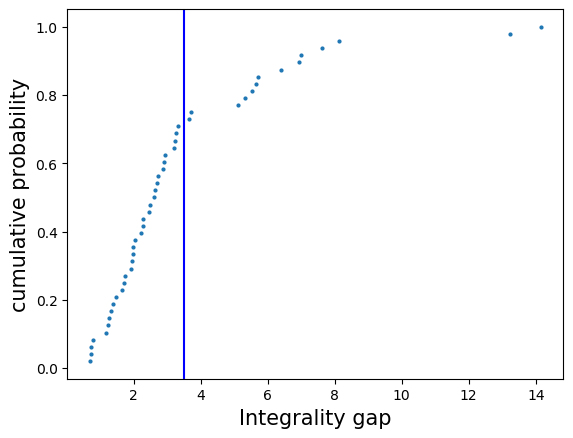

In [163]:
process(data4)

<function matplotlib.pyplot.show(*args, **kw)>

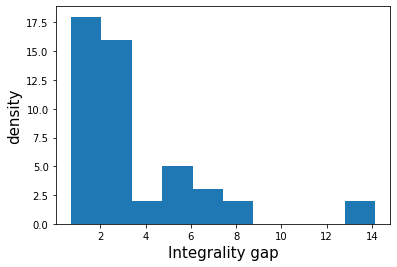

In [69]:
n, bins, patches = plt.hist(data4)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

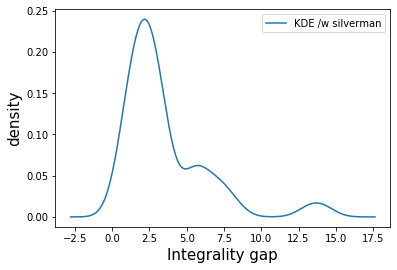

In [70]:
kernelDensity(data4)

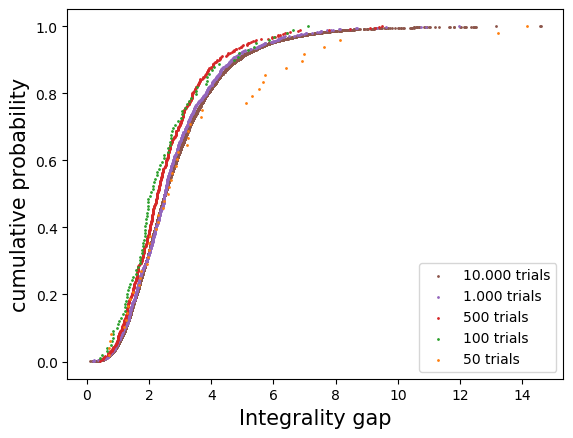

In [164]:
x_10000 = np.sort(data)
n1 = x_10000.size
y_10000 = np.arange(1, n1+1) / n1
plt.scatter(x=x_10000, y=y_10000, c='#8c564b', s = 1, label='10.000 trials')
x_1000 = np.sort(data1)
n2 = x_1000.size
y_1000 = np.arange(1, n2+1) / n2
plt.scatter(x=x_1000, y=y_1000, c='#9467bd', s = 1, label='1.000 trials')
x_500 = np.sort(data2)
n3 = x_500.size
y_500 = np.arange(1, n3+1) / n3
plt.scatter(x=x_500, y=y_500, c='#d62728', s = 1,  label='500 trials')
x_100 = np.sort(data3)
n4 = x_100.size
y_100 = np.arange(1, n4+1) / n4
plt.scatter(x=x_100, y=y_100, c='#2ca02c', s = 1,  label='100 trials')
x_50 = np.sort(data4)
n5 = x_50.size
y_50 = np.arange(1, n5+1) / n5
plt.scatter(x=x_50, y=y_50, c='#ff7f0e', s = 1,  label='50 trials')
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('cumulative probability', fontsize=15)
plt.legend()

In [72]:
#now we start looking at what happens when we run 500 trials, but with different m's and n's
data_mn1 = the_loop(5, 15, 500) #for m/n <= 1, we have close to zero feasible programs. 

[1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
Obj: 0.924983
[1.         0.89337042 0.         0.         0.         0.
 0.         0.93571926 0.         0.         0.         0.
 1.         0.         0.        ]
Obj: 1.60572
1.6057163110548989 relaxed 
0.9249828294203943 original 
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1.]
Obj: 1.94523
[0.06365151 0.         0.         0.16912346 0.         1.
 1.         0.59285229 0.         0.         1.         1.
 1.         0.         0.87315092]
Obj: 6.69787
6.69786552863174 relaxed 
1.9452265609675272 original 
[ 1. -0.  1.  1.  0.  1.  0. -0.  1.  1. -0. -0.  1.  1.  1.]
Obj: 2.13944
[0.         0.         0.31523819 1.         0.         0.
 0.         0.         0.77614273 1.         0.         0.
 1.         0.         1.        ]
Obj: 2.93672
2.9367214769229166 relaxed 
2.139440987915514 original 
[1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1.]
Obj: 4.68426
[1.         0.         0.         1.         1.         1.
 1.         0.48148

[0.40664737 0.         1.         0.         0.59418931 1.
 1.         0.         0.         0.         0.         0.
 1.         0.62561392 0.        ]
Obj: 4.04974
4.049735534129669 relaxed 
3.6038891652521086 original 
[0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0.]
Obj: 1.50686
[0.         1.         0.         0.         0.59537395 1.
 0.         0.         1.         1.         0.         0.09677398
 0.         0.         0.15182374]
Obj: 2.4314
2.4313951831492124 relaxed 
1.5068632369077977 original 
[ 1.  0. -0.  0.  1.  1.  1.  0.  0. -0.  1. -0.  1. -0. -0.]
Obj: 1.95245
[1.         1.         0.57963708 1.         1.         1.
 1.         0.         0.         0.         0.         0.3934341
 0.99235819 0.         0.12562662]
Obj: 3.61671
3.616712946716085 relaxed 
1.9524503723080255 original 
[0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1.]
Obj: 7.81634
[0.         1.         0.23318113 1.         0.91266667 1.
 0.         1.         0.         1.         0.         1.
 1.   

[1.         0.         1.         0.         0.         0.98088118
 0.         0.         0.         0.77732084 0.78025977 0.
 0.         0.         1.        ]
Obj: 4.20102
4.2010238859512405 relaxed 
2.8963326700909833 original 
[-0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.]
Obj: 3.20563
[0.         0.         0.         0.         0.         0.
 0.59743306 1.         0.         0.         1.         0.
 0.         0.23962667 0.        ]
Obj: 3.34136
3.3413550752361676 relaxed 
3.2056271734959036 original 
[1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
Obj: -1.98663
[0.         0.         0.11642096 0.         0.         0.
 0.         0.         0.43637507 0.         0.42652257 0.
 0.         0.         1.        ]
Obj: 0.086967
0.086966989345578 relaxed 
-1.9866326716872595 original 
[1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0.]
Obj: 3.92624
[1.         1.         0.         0.9125605  1.         0.
 1.         0.1878538  0.61825862 0.         0.         1.
 1.     

[-0.  0.  1. -0. -0.  1. -0. -0. -0.  0. -0. -0. -0.  1.  1.]
Obj: 0.553011
[0.         0.         1.         0.         0.31651067 0.3665948
 0.         0.         0.         0.         0.         0.
 0.         1.         1.        ]
Obj: 1.36504
1.3650359129207064 relaxed 
0.5530112406676686 original 
[1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 1. 1.]
Obj: 6.47411
[1.         0.         0.61538896 0.         1.         1.
 0.         0.         1.         1.         0.         0.76186769
 0.86556898 1.         1.        ]
Obj: 6.97448
6.974483963483319 relaxed 
6.474106729397465 original 
[0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
Obj: 6.42915
[0.         0.         0.         1.         1.         1.
 0.         0.         0.         1.         1.         0.
 0.         0.         0.61382664]
Obj: 6.7377
6.737702341527694 relaxed 
6.429151506082532 original 
[1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0.]
Obj: 3.08577
[1.         1.         0.         0.         0.         1.
 0.   

[0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0.]
Obj: 5.88334
[0.         1.         0.73307446 0.         1.         0.
 0.         0.79901272 0.8047062  1.         1.         1.
 1.         0.         0.        ]
Obj: 6.68048
6.680478078631329 relaxed 
5.883344937762753 original 
Encountered an attribute error
[0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1.]
Obj: 4.70703
[0.         1.         0.         0.12944419 0.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.        ]
Obj: 4.74569
4.745690405073627 relaxed 
4.707029590097489 original 
[0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1.]
Obj: 6.83192
[0.         1.         1.         0.         0.         1.
 0.         0.1141001  1.         0.         0.37240617 1.
 1.         1.         1.        ]
Obj: 7.21335
7.21335234734108 relaxed 
6.831916896696221 original 
[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
Obj: 0.451292
[0.         0.         0.         0.         0.         0.41657186

[0.30168513 0.         1.         0.         0.         1.
 1.         0.         0.01588922 0.45984254 0.         0.
 0.         0.03149018 1.        ]
Obj: 4.2089
4.208904330394286 relaxed 
2.6190646606119543 original 
[0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
Obj: -0.472551
[0.         0.         0.0944729  0.         0.30749149 0.
 0.         0.         0.         0.         0.1924981  1.
 0.36736184 0.         0.        ]
Obj: 1.21116
1.211163546136492 relaxed 
-0.4725511752902827 original 
[ 1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  0.]
Obj: 2.9274
[1.         1.         0.         1.         0.         0.
 0.46383424 0.         0.64492144 0.         1.         0.
 1.         0.         0.        ]
Obj: 3.34891
3.3489060746720436 relaxed 
2.9274005290116727 original 
[ 0. -0. -0. -0. -0. -0.  1.  0.  1. -0.  1. -0. -0. -0. -0.]
Obj: 2.7067
[0.         1.         0.         0.         0.         0.
 0.73824892 0.         0.59988705 0.         1.         0.784162

[ 0. -0.  0.  1. -0.  0.  0. -0. -0.  1.  1.  0.  1. -0.  1.]
Obj: 0.650959
[0.         0.21523075 0.         0.         0.         0.
 0.         0.3652434  0.         1.         1.         0.
 0.         0.         1.        ]
Obj: 1.20378
1.2037767958476175 relaxed 
0.6509588340879391 original 
[ 1.  1. -0. -0. -0. -0.  0.  1.  1. -0. -0.  0. -0.  1. -0.]
Obj: 4.00216
[1.         1.         0.         0.         0.01884696 0.
 1.         0.         1.         0.         0.29871259 1.
 0.         1.         0.        ]
Obj: 4.38714
4.387143644724961 relaxed 
4.002155255910024 original 
[0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0.]
Obj: 5.49149
[0.         0.96640734 1.         1.         0.         0.
 1.         0.57202174 1.         1.         1.         0.
 0.         0.76426933 0.        ]
Obj: 6.87053
6.870532473076329 relaxed 
5.491489734933004 original 
[ 1.  1. -0.  0.  1. -0.  1. -0.  1.  0. -0. -0.  0.  1.  0.]
Obj: 4.48239
[1.         1.         0.         0.43062353 1.  

[0.         1.         1.         1.         0.         0.07384141
 0.         0.         1.         0.         0.         0.53045634
 0.         0.11621977 0.        ]
Obj: 0.544491
0.5444912101067413 relaxed 
0.11054237815885985 original 
[0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 0.]
Obj: 7.1409
[0.         0.57869469 1.         0.         1.         0.94162279
 1.         0.         1.         0.         0.         1.
 0.2073982  1.         0.52003351]
Obj: 7.54322
7.543216951879541 relaxed 
7.140901579787037 original 
[-0.  1.  1. -0.  0.  1. -0.  1.  1. -0. -0. -0.  0. -0.  1.]
Obj: 4.2359
[1.         1.         1.         0.         0.         1.
 0.01497965 1.         1.         0.         0.         0.
 0.         0.         0.65186655]
Obj: 4.81824
4.81823830039733 relaxed 
4.235899714355876 original 
[1. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0.]
Obj: 4.65186
[0.8951248  0.         0.         0.         0.596862   1.
 1.         0.         0.68012745 1.         1.         0.

[-0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.]
Obj: 6.10397
[0.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         0.42615928]
Obj: 6.34391
6.34390731534863 relaxed 
6.103968213805152 original 
[0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0.]
Obj: -0.0482155
[0.         0.         0.         0.98930134 0.         0.
 0.87062266 0.         0.         0.         0.         1.
 0.84158156 1.         0.        ]
Obj: 1.41763
1.4176254209045682 relaxed 
-0.048215534366515156 original 
[ 1.  0. -0.  1.  0.  1.  0. -0.  1.  1. -0.  0.  1. -0.  1.]
Obj: 2.37894
[1.         0.         0.         0.         0.62732473 1.
 0.         0.         0.         0.98886616 0.         0.10054678
 1.         0.         1.        ]
Obj: 3.87909
3.8790920219774145 relaxed 
2.3789437492514356 original 
[-0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  0. -0.  1. -0.  1.]
Obj: 5.27307
[1.         0.         0.         0

[0.         1.         0.         0.         0.85360992 0.99201275
 1.         0.         0.         0.         0.         1.
 1.         0.         0.        ]
Obj: 5.15484
5.154843882643888 relaxed 
4.586767364813118 original 
[0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0.]
Obj: 0.839755
[0.         0.         0.         1.         0.83176502 1.
 1.         0.         0.         0.         0.         0.78410649
 0.83758837 0.         0.        ]
Obj: 1.58504
1.5850411699465499 relaxed 
0.8397549614864024 original 
[0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0.]
Obj: 0.711262
[1.         1.         0.         0.         0.         0.07337822
 1.         0.         0.         0.         0.         0.83866688
 0.         0.         0.        ]
Obj: 2.4817
2.4816967592788597 relaxed 
0.7112615935049921 original 
Encountered an attribute error
[-0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.]
Obj: 7.19888
[0.         1.         0.         1.         0.         0.
 1.         0. 

[1.         1.         1.         0.         1.         1.
 0.         1.         0.02887224 0.         0.         0.
 0.44151307 1.         0.        ]
Obj: 4.19128
4.191275845771485 relaxed 
3.973785527499839 original 
[0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0.]
Obj: 10.5685
[0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0.]
Obj: 10.5685
10.568547786854891 relaxed 
10.568547786854891 original 
[0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0.]
Obj: 2.32283
[0.65303616 0.         0.         0.01452094 1.         0.6823172
 0.         1.         0.         0.91649537 1.         0.
 1.         0.         0.        ]
Obj: 3.40498
3.404981424382258 relaxed 
2.322832513138819 original 
[ 1.  1.  1. -0.  1.  1.  1.  0. -0. -0.  1. -0.  1.  1.  1.]
Obj: 9.7591
[0.         1.         1.         0.         1.         0.64515769
 0.84373051 1.         0.         0.         1.         0.
 0.80575754 1.         1.        ]
Obj: 10.987
10.986958148496356 relaxed 
9.759102749153962 original 
[0. 1. 1. 1

mean: 0.8100009570570714
median: 0.6260902441119227
standard deviation:0.7291817569641957


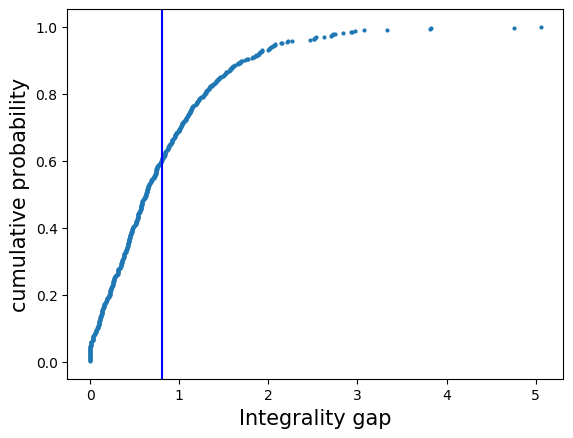

In [165]:
process(data_mn1)

<function matplotlib.pyplot.show(*args, **kw)>

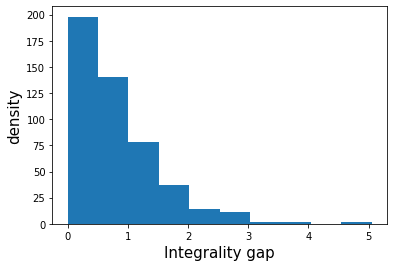

In [74]:
n, bins, patches = plt.hist(data_mn1)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show


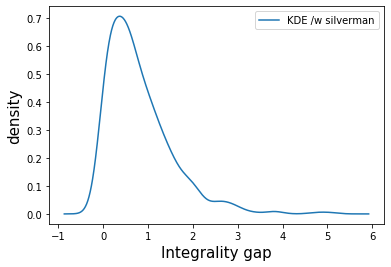

In [75]:
kernelDensity(data_mn1)

In [76]:
data_mn2 = the_loop(5, 30, 500)

[-0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.
  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.]
Obj: 12.0098
[0.         0.82746682 1.         1.         0.         1.
 0.         1.         1.         0.         0.76475367 1.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         0.3024991
 1.         1.         0.78809336 0.         0.         0.        ]
Obj: 12.7581
12.758101410556192 relaxed 
12.009841259709702 original 
[1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1.
 0. 0. 0. 0. 0. 0.]
Obj: 7.72159
[1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1.
 0. 0. 0. 0. 0. 0.]
Obj: 7.72159
7.72158705665022 relaxed 
7.72158705665022 original 
[-0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.
 -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.]
Obj: 12.8483
[0.         1.         1.         0.50722265 1.         0.
 1.         0.         

[1.         1.         0.         1.         1.         0.13361266
 0.         1.         0.         1.         0.83116863 0.27966161
 0.87825853 1.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         0.        ]
Obj: 10.3669
10.366868962749702 relaxed 
9.606690247095116 original 
[ 1. -0.  0. -0.  1.  1.  1.  1.  1.  1.  0. -0.  0. -0.  1.  1.  1.  0.
 -0.  0. -0.  1. -0.  0.  1.  1. -0.  1.  1.  0.]
Obj: 9.72687
[1.         0.         0.76209273 0.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         1.         1.         0.        ]
Obj: 10.1944
10.194436448449913 relaxed 
9.7268717551934 original 
[0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1.
 0. 0. 0. 0. 1. 1.]
Obj: 12.746

[0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0.
 1. 1. 0. 1. 1. 0.]
Obj: 6.82032
[0.         0.54130655 1.         0.47312308 0.97394349 0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         1.         0.21010848 1.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0.83823996 0.        ]
Obj: 7.88788
7.887876885551549 relaxed 
6.8203201945418295 original 
[0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 0. 1. 0. 0. 0.]
Obj: 8.12474
[0.         0.         0.         1.         1.         1.
 1.         0.44145163 0.         0.74177013 0.62583715 1.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         0.         0.         0.        ]
Obj: 9.53068
9.530684255484495 relaxed 
8.124736681409454 original 
[-0.  1. -0. -0. -0. -0.  1. -0.  0.  1.  0

[1.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.11144527 0.79086579 0.         1.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         0.46107791 0.         0.         0.         0.        ]
Obj: 11.6744
11.674445733320383 relaxed 
11.198698666489896 original 
[-0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.
  1.  1. -0. -0.  1.  1.  1.  1.  1.  0.  1. -0.]
Obj: 10.8821
[0.         1.         1.         1.         0.         0.
 0.         0.         0.7533743  1.         0.16360611 0.
 0.         0.8413561  1.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         0.32483255 0.        ]
Obj: 11.1985
11.198456061992974 relaxed 
10.88214165783324 original 
[-0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.
 -0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.

[0.         0.         0.         0.13621808 1.         0.56446023
 1.         0.         0.68811329 1.         0.         1.
 0.72118652 0.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         0.        ]
Obj: 7.95096
7.950963703845005 relaxed 
7.076601489479529 original 
[-0.  1.  1.  1. -0.  1. -0. -0.  1.  0.  1. -0. -0. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.]
Obj: 9.13893
[0.         1.         1.         1.         0.         0.
 0.         0.         0.72760979 0.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.13024582 0.         0.         0.         0.         0.
 1.         1.         0.42302252 0.         0.         1.        ]
Obj: 9.61737
9.617369281575026 relaxed 
9.138930205314166 original 
[-0. -0. -0. -0. -0. -0.  0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.
  0.  1. -0. -0. -0. -0. -0. -0. -0.  1

[ 0.  1.  0.  0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.
 -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  0.  1.]
Obj: 10.6311
[0.         0.80041014 0.         1.         1.         1.
 0.41972589 0.         0.         1.         0.         1.
 1.         1.         0.         1.         1.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         1.        ]
Obj: 10.8742
10.87417288211929 relaxed 
10.631093805998367 original 
[0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1.
 0. 1. 0. 0. 0. 0.]
Obj: 13.7496
[0.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 1.         1.         1.         0.16430296 1.         0.
 1.         1.         0.         1.         0.00718365 1.
 0.         1.         0.         0.         0.         0.        ]
Obj: 13.7879
13.787911225082725 relaxed 
13.74955766532535 original 
[-0. -0.  1.

[1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1.
 0. 0. 0. 1. 1. 0.]
Obj: 7.11646
[1.         0.         0.         0.         0.03464672 0.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         0.99953914 0.
 0.         0.69216075 0.         1.         1.         1.
 0.         0.         0.         1.         1.         0.08876754]
Obj: 8.27219
8.272192529315534 relaxed 
7.116460719337331 original 
[ 1.  1. -0.  1.  0.  0.  1. -0. -0.  1.  0.  0.  0. -0. -0.  0.  1. -0.
  1. -0.  0.  0.  1.  1. -0.  0.  1.  1.  1.  1.]
Obj: 8.65215
[1.         1.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.39515484 0.         0.         0.37160331 1.         0.
 1.         0.         0.55974447 0.         1.         1.
 0.         0.09022547 1.         1.         1.         1.        ]
Obj: 9.41862
9.418621710023732 relaxed 
8.652153511492086 original 
[0. 1. 1. 1. 0

[1.         1.         0.36137126 1.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         0.24310607 0.57264368 1.        ]
Obj: 16.2323
16.23230705123624 relaxed 
15.777087938639191 original 
[0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0.
 1. 1. 0. 1. 0. 0.]
Obj: 11.8806
[0.         1.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.28386965 0.7252452  0.         0.        ]
Obj: 11.9245
11.924495666710802 relaxed 
11.880584481173178 original 
[1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0.
 0. 0. 0. 0. 1. 0.]
Obj: 6.38489
[1.         0.         1.         0.     

[-0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  0. -0. -0. -0.  1.
  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.]
Obj: 8.53273
[0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.68443106 0.         0.38721164
 0.         0.         0.         0.         0.         0.75865636
 1.         1.         0.         1.         1.         0.
 1.         0.         0.         1.         1.         1.        ]
Obj: 9.12778
9.127776358918949 relaxed 
8.53273372026802 original 
[1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1.
 1. 0. 1. 0. 0. 1.]
Obj: 10.9209
[1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1.
 1. 0. 1. 0. 0. 1.]
Obj: 10.9209
10.920941593219496 relaxed 
10.920941593219496 original 
[0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0.
 1. 0. 0. 0. 1. 0.]
Obj: 13.9357
[0.         1.         0.         1.         1.         1.
 1.         0.         0.         1.       

[0.01144646 0.99490971 0.         0.         1.         1.
 1.         1.         0.         0.         0.21399301 0.
 0.         0.24927312 0.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.76741451 1.         1.        ]
Obj: 12.0064
12.006423359187608 relaxed 
10.868513065034884 original 
[0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0.
 0. 1. 1. 0. 0. 0.]
Obj: 7.10824
[0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         0.41473457 0.34900507
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.        ]
Obj: 7.57443
7.574433667321798 relaxed 
7.1082418155926 original 
[1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 1. 0. 1. 0. 1.]
Obj: 10.4254
[1.         1.         0.         0.

[0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.27660018 0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.0748349  1.         0.         1.         0.         0.        ]
Obj: 8.06083
8.060828822596713 relaxed 
7.830066363561408 original 
[1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1.
 0. 0. 0. 1. 1. 0.]
Obj: 13.1598
[1.         0.         0.55398373 0.         0.         0.84149065
 0.         1.         0.         0.63821096 0.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         1.         0.        ]
Obj: 13.6153
13.615265157949125 relaxed 
13.159766156802135 original 
[1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
Obj: 5.36867
[1.         1.         1.         

[1.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.99141462]
Obj: 7.5633
7.563297314156436 relaxed 
7.545576789494193 original 
[1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1.
 0. 0. 1. 1. 0. 1.]
Obj: 9.24109
[1.         1.         0.         1.         0.         0.
 0.         0.         0.47716598 0.         0.         0.
 0.47661484 1.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         1.        ]
Obj: 9.7458
9.745800690068574 relaxed 
9.241088916631696 original 
[ 1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.
  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.]
Obj: 10.6325
[0.         0.  

[0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.49702569 0.         0.
 0.02496951 0.         1.         0.         0.         0.
 1.         1.         1.         1.         0.55225882 1.
 1.         0.         1.         0.         0.         0.        ]
Obj: 11.5624
11.56239657315852 relaxed 
10.958730781029073 original 
[ 1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.
  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.]
Obj: 14.4824
[1.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         0.         1.         0.         0.         1.
 1.         0.78145082 0.56007071 0.         1.         1.        ]
Obj: 14.6619
14.661906169884082 relaxed 
14.482445234824338 original 
[ 1.  1.  1. -0.  0.  1.  1.  1. -0.  0.  0. -0.  1. -0. -0.  0. -0. -0.
 -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.

[0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1.
 0. 0. 1. 1. 1. 1.]
Obj: 9.48092
[0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1.
 0. 0. 1. 1. 1. 1.]
Obj: 9.48092
9.480920345332686 relaxed 
9.480920345332684 original 
[1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0.
 1. 0. 0. 1. 0. 0.]
Obj: 11.6407
[1.         0.92269445 0.         0.         1.         1.
 0.         1.         0.         1.         1.         0.80223356
 0.         0.         0.         1.         0.         0.
 0.62770319 0.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         0.        ]
Obj: 11.7109
11.710914114032965 relaxed 
11.640725185782575 original 
[-0.  1. -0.  1. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1.  1.  1. -0. -0.
  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.]
Obj: 8.37613
[0.         0.         0.         1.         0.         0.99660305
 0.         0.         0.23052711 0.      

[0.         0.         0.         1.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         0.         1.         0.91254168 0.66516914
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         1.         1.         0.03131658]
Obj: 8.39281
8.39281122818832 relaxed 
7.369463067797704 original 
[0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1.
 1. 0. 1. 0. 1. 0.]
Obj: 10.1888
[0.         0.75004481 0.         0.         1.         1.
 1.         0.         1.         0.         0.91971581 1.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.        ]
Obj: 10.2266
10.226631792113468 relaxed 
10.188756013215526 original 
[ 0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1.  0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.]
Obj: 8.94086
[0.  

[0.         0.91750165 0.10294084 0.18205529 1.         0.14340853
 0.         0.         0.         0.         0.         1.
 1.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         0.        ]
Obj: 10.9443
10.94434664995287 relaxed 
10.24905024401404 original 
[ 1.  0.  0. -0. -0.  0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  0. -0.
  1.  1.  1.  0. -0.  1.  0. -0.  1.  0.  1. -0.]
Obj: 9.91241
[1.         0.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         1.
 1.         1.         1.         0.54690667 0.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         0.        ]
Obj: 9.99625
9.996252085723853 relaxed 
9.912412130427063 original 
[ 1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  0.  0.
  0.  1. -0. -0. -0. -0.  1. -0.  0. -0

[0.         1.         1.         0.         1.         0.
 0.85992999 1.         0.28198515 1.         0.         1.
 0.99622383 1.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         0.5814251
 1.         0.         1.         0.         0.         0.45110827]
Obj: 12.8004
12.800417920461834 relaxed 
10.996844747399583 original 
[ 1.  1. -0.  0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.
 -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.]
Obj: 10.7736
[1.         1.         0.         0.36447191 0.         0.
 1.         0.65280065 1.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         1.        ]
Obj: 10.8704
10.870363467462223 relaxed 
10.773634236927613 original 
[ 1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.
  1.  1.  1.  1.  1. -0. -0. -0.  1.

[1. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 1. 1.]
Obj: 7.79453
[1.         1.         1.         1.         0.         1.
 0.         0.         0.44941843 0.         0.         0.
 1.         0.         1.         0.         0.         0.68306386
 1.         0.         0.         0.         0.         0.27583912
 0.         0.         0.         1.         1.         1.        ]
Obj: 8.20495
8.204947757009739 relaxed 
7.7945258531893105 original 
[0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1.
 0. 1. 0. 0. 1. 1.]
Obj: 14.1841
[0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1.
 0. 1. 0. 0. 1. 1.]
Obj: 14.1841
14.18409573448853 relaxed 
14.184095734488533 original 
[1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0.
 1. 0. 0. 0. 0. 1.]
Obj: 6.69724
[1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.8059659  1.         1.
 0.         0

[0.         0.         1.         0.         0.         1.
 1.         0.         0.97258446 0.         1.         0.09340919
 0.         0.         0.         0.         1.         0.88309996
 1.         0.         0.         1.         0.         0.
 1.         0.22243157 0.         1.         0.         1.        ]
Obj: 6.03573
6.0357321135607584 relaxed 
5.473241703403659 original 
[-0.  1.  1. -0. -0. -0.  1. -0. -0.  0. -0.  1. -0.  1.  1.  0. -0. -0.
  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  0. -0.]
Obj: 11.3976
[0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.03912598 1.         1.         0.         0.         0.56436488
 0.         1.         1.         1.         1.         0.
 1.         0.         1.         0.         0.         0.        ]
Obj: 11.9114
11.911369124650374 relaxed 
11.397603777537212 original 
[ 1.  1.  1. -0.  1. -0.  0.  1.  1. -0. -0. -0.  0.  1.  1. -0.  0.  1.
 -0. -0.  1. -0.  1.

[0.         1.         1.         0.96168998 0.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.43652743 0.         1.         1.        ]
Obj: 8.61401
8.61400690668486 relaxed 
8.322566835856273 original 
[1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1.
 1. 1. 0. 0. 1. 0.]
Obj: 15.7348
[1.         0.         0.         1.         1.         1.
 0.72871085 1.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         0.        ]
Obj: 15.7386
15.738593274544664 relaxed 
15.734770864202323 original 
[ 1.  1. -0.  0.  0. -0.  1. -0.  1.  1. -0.  0.  0.  0.  0. -0.  1. -0.
 -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.]
Obj: 10.2197
[1.         1

[0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 1. 1.
 1. 1. 0. 0. 0. 0.]
Obj: 9.3158
[0.         0.13595559 0.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         1.         0.         0.32689628 0.86061959
 1.         0.         0.         0.70165671 1.         1.
 1.         1.         0.         0.         0.         0.        ]
Obj: 9.65595
9.655950258448334 relaxed 
9.315804163482579 original 
[ 0.  1.  1.  1.  1. -0. -0.  0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.
  1. -0.  0. -0. -0. -0. -0. -0.  1. -0. -0. -0.]
Obj: 12.4433
[0.         1.         0.29438226 1.         1.         0.
 0.         0.02884277 1.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.06643442 0.         0.         0.
 0.         0.         1.         0.         0.         0.        ]
Obj: 12.6741
12.67406300329705 relaxed 
12.443288846674363 original 
[ 1.  

 0. 0. 0. 1. 0. 0.]
Obj: 7.45934
[0.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.85520616 0.         1.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.19165729 0.         1.         0.         0.        ]
Obj: 7.57914
7.57914433077982 relaxed 
7.459335103381586 original 
[0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1.
 0. 0. 1. 0. 0. 1.]
Obj: 10.6985
[0.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         0.62819457
 0.         0.84130507 1.         0.         0.         1.        ]
Obj: 10.764
10.763954875828176 relaxed 
10.698469676185367 original 
[1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 1. 1. 1. 0. 0.
 0. 0. 0. 1. 0. 0.]
Obj: 10.8603
[1.

[ 1.  0.  0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1.  1.  1.  1.  1.  0. -0.  0.  1.  0.  1.]
Obj: 7.71676
[1.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.25614924 0.
 0.         1.         1.         1.         1.         0.32130864
 0.28925523 0.         1.         1.         1.         1.        ]
Obj: 8.16472
8.164720445959812 relaxed 
7.716755278771181 original 
[ 1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.
 -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.]
Obj: 5.95241
[1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0.
 1. 1. 0. 0. 0. 0.]
Obj: 5.95241
5.952412317568737 relaxed 
5.9524123175687365 original 
[-0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.
  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 10.932
[0.         0.         0.         0.         0.    

 0. 1. 0. 1. 1. 1.]
Obj: 11.6932
[1.         0.         0.         0.         1.         1.
 1.         0.         1.         0.         1.         1.
 0.08418127 0.         0.         1.         1.         1.
 0.6551268  0.         0.         0.         0.         0.
 0.26310513 1.         0.         1.         1.         1.        ]
Obj: 12.271
12.271032656163339 relaxed 
11.69321683194768 original 
[1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1.
 1. 0. 0. 0. 1. 0.]
Obj: 10.3924
[1.         1.         0.         0.         1.         0.89495848
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.69199169 0.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         0.57354451]
Obj: 11.1857
11.185704448077516 relaxed 
10.392445958066917 original 
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 1. 1. 0.]
Obj: 7.22095
[

[1.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.31121187 0.         0.         0.         0.         0.52403355
 0.         0.         0.         0.         1.         0.19552792]
Obj: 9.15902
9.159018536575275 relaxed 
8.865913212629795 original 


mean: 0.4255157816579175
median: 0.3605675772400412
standard deviation:0.3462734426859386


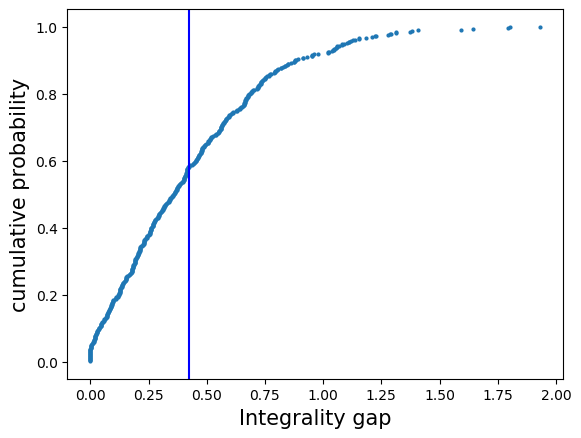

In [166]:
process(data_mn2)    

<function matplotlib.pyplot.show(*args, **kw)>

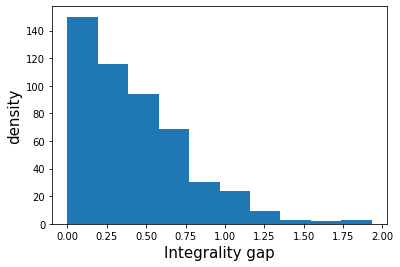

In [79]:
n, bins, patches = plt.hist(data_mn2)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

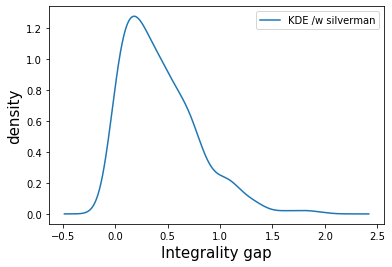

In [80]:
kernelDensity(data_mn2)

In [82]:
data_mn3 = the_loop(5, 45, 500)

[1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0.
 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1.]
Obj: 7.41482
[1.         0.         0.         0.93079376 1.         1.
 0.         0.         1.         0.         1.         0.1814031
 0.         1.         0.         1.         1.         0.
 0.         1.         0.66435095 0.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         1.        ]
Obj: 7.98972
7.989720351393479 relaxed 
7.414824826013567 original 
[-0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.
  1. -0. -0. -0.  0.  0.  0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.
 -0.  0. -0. -0. -0. -0.  1. -0. -0.]
Obj: 7.30415
[0.27453816 0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 1.        

[0.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         0.52935242
 1.         1.         1.         1.         0.         0.91440234
 0.         1.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         0.12112405 1.         0.
 1.         0.         0.        ]
Obj: 16.1968
16.196819846930353 relaxed 
15.556603318752808 original 
[1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0.
 0. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0.]
Obj: 13.8415
[1.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         0.53166929 1.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.59995948 1.         0.         0.
 0.         0.      

[1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1.]
Obj: 11.9867
[1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.81017267 1.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         0.2069151
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.66630399]
Obj: 12.5047
12.504673813228116 relaxed 
11.986674246006862 original 
[ 1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  0.  1.  1. -0.  1. -0.  1.  1.
 -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.
 -0.  1.  1. -0. -0.  1.  1. -0. -0.]
Obj: 17.5904
[1.         0.         1.         1.         0.         1.
 0.         1.         0.         1.         0.         1.
 1.      

[1.         1.         0.14484426 1.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         1.         1.         0.49812114 0.         0.
 0.         0.         1.         0.         0.13733906 1.
 1.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         0.48673295 1.
 1.         0.         0.        ]
Obj: 21.1836
21.183644823223233 relaxed 
20.902867977769226 original 
[0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1.
 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0.]
Obj: 15.2245
[0.         0.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.51185244 0.         0.87289332 1.         0.         0.
 0.         0.16846909 1.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.

[0.         1.         1.         0.         0.84288608 1.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         0.29453413 1.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.        ]
Obj: 14.3983
14.398260170500985 relaxed 
13.81721209327165 original 
[ 1.  1. -0.  0.  1.  1. -0.  1.  1.  1.  1.  1.  0.  1.  1. -0. -0. -0.
  1.  1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.  1.  0.  1.  1.  0.
  1. -0.  1.  0.  1.  1.  0.  0.  0.]
Obj: 14.1721
[1.         1.         0.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         0.70105033 0.99668259
 1.         1.         0.         0.         1.         0.
 0.         1.         1.         1.      

[1.         0.         1.         0.         0.         1.
 0.         0.         0.94070134 1.         0.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         0.67567447
 0.         0.         0.77100839 1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.        ]
Obj: 8.15058
8.150584821982548 relaxed 
7.807252348532469 original 
[ 1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.
  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  1. -0.]
Obj: 10.9514
[1.         0.         0.         0.         1.         1.
 1.         0.         0.69379486 0.         1.         0.97547037
 0.         0.         0.         0.         1.         1.
 1.         1.         0.62047283 0.         1.         0.
 1.         0.         1.         0

[1. 1. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1.
 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 1.]
Obj: 18.5632
[1.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.47964504 1.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.95049897 1.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.22918254 1.        ]
Obj: 18.8941
18.8940739736523 relaxed 
18.563228026613004 original 
[-0. -0.  0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.
 -0. -0.  0. -0.  1.  0.  1.  1.  1. -0.  0.  1. -0.  1.  1.  1. -0. -0.
 -0. -0.  1. -0.  1.  1. -0.  1.  1.]
Obj: 13.8855
[0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.    

  0.  1. -0.  1.  1.  1. -0. -0.  0.]
Obj: 8.59133
[0.         0.51449697 0.32636046 0.         0.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.61008778 0.         0.         0.18114421 1.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         1.
 1.         0.         0.        ]
Obj: 9.31377
9.313768923590525 relaxed 
8.591334704890134 original 
[1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1.
 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1.]
Obj: 15.0662
[1.         1.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         1

[0.11630285 0.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         0.17101737 1.
 1.         0.         1.         1.         0.         1.
 0.         1.         0.         0.         0.03907521 1.
 1.         1.         0.        ]
Obj: 15.3778
15.37782829437443 relaxed 
15.234269552458528 original 
[-0.  1.  1. -0. -0.  0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.
 -0.  1.  1. -0.  1.  1.  1.  1.  1.  0. -0. -0.  1. -0. -0.  1. -0.  1.
  1.  0.  1.  0.  1. -0. -0.  1.  1.]
Obj: 15.3801
[0.         1.         1.         0.         0.         0.01508638
 0.         0.         0.         0.         1.         1.
 0.80859686 0.         1.         1.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.332464

[0.         1.         0.         0.95610165 0.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.17203221 0.         1.         1.         0.
 0.41242725 1.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.        ]
Obj: 15.1213
15.121346051395081 relaxed 
14.859839811715423 original 
[ 1. -0.  1.  0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  0.  1.  1.  1.
  0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  0. -0.
  1. -0. -0. -0.  0.  1. -0.  1.  1.]
Obj: 23.0816
[1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.42259839 1.         1.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         0.  

[0.         1.         1.         1.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.28078763 0.         1.         0.21558813 0.         0.23957299
 1.         1.         1.        ]
Obj: 16.601
16.60096079321385 relaxed 
16.321418649942775 original 
[0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1.
 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1.]
Obj: 14.8695
[0.         1.         1.         1.         1.         1.
 1.         0.         0.56621901 1.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         0.77144618 0.
 1.         0.         1.     

[-0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.
  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  1.  1.  1. -0.]
Obj: 17.2847
[0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         1.         0.29292464 1.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         0.9112437  1.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.67314863 1.         1.
 1.         0.58740327 0.        ]
Obj: 18.6297
18.62970760506097 relaxed 
17.28468369118709 original 
[0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1.
 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1.]
Obj: 17.9723
[0.         0.         0.         1.         0.91988253 1.
 0.3873021  1.         0.         1.         0.         1.
 0.         1.    

[1.         0.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.87125702
 1.         0.         0.         1.         0.         0.
 1.         1.         1.         0.32104164 1.         0.
 0.9549736  0.         1.         1.         1.         1.
 0.         1.         1.         0.11161403 1.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.        ]
Obj: 21.1164
21.11637565668854 relaxed 
20.891736033111943 original 
[ 1. -0.  1.  1.  0. -0.  1. -0.  1. -0. -0. -0.  0.  1.  1. -0.  1.  1.
  0. -0. -0. -0.  1.  1. -0.  1.  0. -0. -0. -0.  1.  1. -0.  1.  1.  1.
  1.  0.  1.  1. -0.  1. -0. -0.  1.]
Obj: 16.2662
[0.40021818 0.         1.         0.59124596 0.1211968  0.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.42933746 0.         0.         0.         1.         1.
 0.         1.         0.95991681 0.      

[1.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.02199405 0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         0.         1.         1.         1.
 0.27849423 1.         0.        ]
Obj: 15.1164
15.116382171293491 relaxed 
15.046026817142337 original 
[0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0.
 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0.]
Obj: 14.6621
[0.         0.         0.         0.90828349 1.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.78937838 1.         0.         0.
 1.         0.14710619 1.         0.

[0.         0.         0.         0.         1.         1.
 0.         0.         0.         1.         1.         0.7083818
 0.         1.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         0.94699528 0.26422484
 0.         0.         0.         0.         1.         0.
 0.         1.         0.        ]
Obj: 20.1607
20.160661995727654 relaxed 
20.039377363698716 original 
[ 1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.
  1.  1.  1. -0.  1. -0. -0.  1. -0.]
Obj: 13.3398
[1.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.279246   0.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         

[0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.56534868 0.
 1.         1.         0.         0.         0.         0.6109008
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         0.06727324 0.
 0.         0.         0.        ]
Obj: 13.4106
13.410597938346578 relaxed 
13.046487803122488 original 
[ 0.  0.  1.  1.  1.  0.  1.  1.  0.  0. -0.  1.  1.  0.  0.  1.  1.  0.
  1.  1.  1.  0. -0.  1.  1.  1.  1. -0.  0.  0.  1.  1.  0.  1.  1.  0.
  1.  1.  0.  1.  1. -0.  1. -0.  0.]
Obj: 16.4775
[0.         0.         1.         1.         1.         0.
 1.         1.         0.         0.         0.09894888 0.95167443
 0.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         1.         

[0.         0.         0.1901662  1.         0.79032609 1.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         0.
 1.         0.         1.        ]
Obj: 19.3188
19.318809639697875 relaxed 
18.940273766978624 original 
[ 1.  1.  1. -0.  1.  0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  0. -0.
  1. -0.  1.  0.  1.  1. -0. -0. -0.]
Obj: 18.688
[1.         1.         1.         0.86281005 1.         0.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.   

Obj: 10.6196
[0.14916088 0.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.65516232 0.         1.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.        ]
Obj: 11.1373
11.137343540845276 relaxed 
10.619625058839286 original 
[-0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.
  1. -0.  0.  1. -0.  1.  0. -0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.
 -0.  1.  1. -0.  0.  1.  1.  1. -0.]
Obj: 9.14566
[0.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         0.44852622 1.         1.
 1.         0.         0.         1.         0.         0.
 1.         0.         0.         1.

[1.         1.         0.         1.         1.         0.
 1.         1.         0.         0.59135694 1.         1.
 1.         1.         1.         0.91952733 1.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         0.         1.
 1.         0.         0.13381062 0.56422748 1.         0.
 1.         0.         1.        ]
Obj: 15.844
15.843957428286432 relaxed 
15.452989723847727 original 
[0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0.
 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0.]
Obj: 12.5976
[0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.53613335
 0.         0.         0.         1.         0.1754202  1.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.61458924 1.         1.         1.
 1.         0.         0.    

Obj: 14.0803
[0.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.05624832 0.         0.         1.         0.
 0.         0.         0.97051201 1.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.24314241]
Obj: 14.599
14.598976152327712 relaxed 
14.080291462916234 original 
[ 1.  1. -0.  1.  1. -0.  1.  1.  0.  0. -0. -0. -0. -0. -0.  1. -0. -0.
  1. -0. -0. -0.  1. -0. -0.  0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0.  1.]
Obj: 19.3537
[1.         0.50581847 0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.18129335 0.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         1. 

[1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1.
 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1.]
Obj: 15.2035
[1.         1.         1.         1.         0.         0.76423638
 1.         1.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.35933584 0.49994256
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         1.        ]
Obj: 15.5124
15.512405571316794 relaxed 
15.20352473994521 original 
[-0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.
  0. -0. -0. -0. -0. -0. -0. -0. -0.]
Obj: 10.1367
[0.        0.        1.        1.        1.        0.        0.
 0.        1.        1.        0.        1.        0.  

[1.         0.         1.         0.20537787 1.         1.
 1.         1.         0.         0.         0.         0.
 0.05472059 1.         0.         0.01510491 0.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         1.         0.12103703]
Obj: 14.7284
14.728447911421428 relaxed 
14.028883032980358 original 
[ 1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.
 -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.
 -0. -0.  1. -0.  1.  1.  1.  1. -0.]
Obj: 17.9248
[1.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         0.         0.  

[0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         0.393985   1.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.84737251 0.         1.         0.14175622 1.         0.
 0.97779422 0.         1.        ]
Obj: 16.4536
16.453625259524493 relaxed 
16.011945211208328 original 
[ 1.  1.  1. -0. -0.  0.  1. -0.  1. -0.  1. -0.  1. -0.  0.  1.  1. -0.
  1.  1.  1. -0. -0.  1.  1. -0. -0.  0. -0.  1.  1. -0.  1. -0. -0.  1.
  1.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 14.4732
[1.         1.         1.         0.         0.         0.95834798
 1.         0.         1.         0.         1.         0.
 1.         0.         0.17000888 1.         1.         0.
 1.         1.         0.37236174 0.         0.         1.
 0.00996818 0.         0.         0.     

[1.         0.97424797 1.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         0.90317589 0.         0.7327791
 0.         1.         1.         0.58812134 0.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.        ]
Obj: 15.9627
15.962747954008638 relaxed 
15.437953287557283 original 
[1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0.
 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1.]
Obj: 10.5965
[1.         0.         0.63315012 1.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         0.17092103
 1.         1.         1.         0.         0.         0.
 0.         0.       

  1.  1. -0. -0.  0.  1. -0.  1. -0.]
Obj: 21.427
[0.         0.         1.         0.         1.         0.85741748
 1.         1.         0.72610445 1.         0.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         1.
 0.         0.         0.74353036 1.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         0.        ]
Obj: 21.6886
21.688640222080053 relaxed 
21.42699634485269 original 
[-0. -0. -0. -0.  1.  0.  0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  0. -0. -0.  1. -0.  1.  1. -0.
  1. -0. -0.  1.  1. -0.  1.  1.  1.]
Obj: 16.2623
[0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         0.0532326  0.         0.    

[0.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         0.58126123 0.
 0.         0.         0.11467235 0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.08222862 1.         0.10261982 0.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.        ]
Obj: 8.28033
8.280329144837358 relaxed 
7.887298505223956 original 
[ 1. -0.  1.  1. -0. -0.  0.  1. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1.
  1.  1. -0.  1. -0.  0.  0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.
  1.  1. -0. -0. -0. -0.  0.  1.  0.]
Obj: 14.8343
[1.         0.         1.         1.         0.         0.
 0.30439563 1.         0.         0.         1.         1.
 1.         0.         0.         0.         0.27908222 1.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         0.    

 -0.  1.  0. -0.  0.  0.  0.  0.  1.]
Obj: 13.0912
[0.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         0.0398106  0.6594422
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.77560806 0.
 0.         1.         0.         0.         0.         0.
 0.         0.         1.        ]
Obj: 13.3529
13.352875142947708 relaxed 
13.0912030848769 original 
[-0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  0.  1. -0.
  1. -0. -0. -0.  0. -0. -0.  1. -0.]
Obj: 10.4802
[0.         1.         0.         1.         0.         0.
 0.14305916 1.         0.         1.         0.         0.
 0.         0.57573847 0.         0.         1.         0.
 0.         0.         1.         0.         1.     

[1.         0.7375562  0.         1.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.74165238 0.         1.         1.         0.         0.34694933
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.0191122  0.         1.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.        ]
Obj: 14.3575
14.357534939656723 relaxed 
13.68177483365314 original 
[ 1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1. -0.  1.  0.  1.  1.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.
  1. -0. -0.  1.  1.  1.  1. -0. -0.]
Obj: 17.7136
[1.         1.         1.         1.         0.         1.
 1.         0.95004574 0.         0.         1.         1.
 0.         1.         0.68377344 1.         1.         1.
 0.         0.         0.91536708 0.         1.         0.16940807
 0.         0.         0.         

[0.         0.         0.         1.         1.         0.92600157
 1.         0.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.70536942 1.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.69828986]
Obj: 19.0963
19.09625747926721 relaxed 
18.20778013804409 original 
[ 1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  0.  1.
  1.  1.  1. -0. -0. -0. -0.  1. -0.]
Obj: 10.9406
[1.         1.         0.         1.         0.         1.
 0.         0.         0.64396341 1.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         0.       

[0.73785836 0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.75702595 0.         0.         0.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.        ]
Obj: 14.8876
14.887637247394673 relaxed 
14.81420038676552 original 
[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0.
 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1.]
Obj: 13.1921
[0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         0.14994126 1.
 0.         0.         1.         1. 

[0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.86557342 1.         0.         0.
 0.         1.         1.         1.         1.         0.99639711
 0.         1.         1.        ]
Obj: 27.0371
27.037123792179074 relaxed 
26.98748483493322 original 
[-0.  0. -0.  0.  1.  1. -0.  1.  1.  1.  0.  1. -0.  1.  1.  1.  1. -0.
  0. -0.  1.  1.  1.  0.  0. -0.  1.  0.  1. -0.  1.  1. -0.  1. -0. -0.
 -0.  1.  1. -0.  1.  0. -0. -0.  0.]
Obj: 12.4098
[0.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         0.82067932 1.         0.
 0.         0.         1.         1.         0.43739427 0.
 0.         0.         1.         0.      

mean: 0.3623142651611264
median: 0.31266902576598277
standard deviation:0.27402521944345504


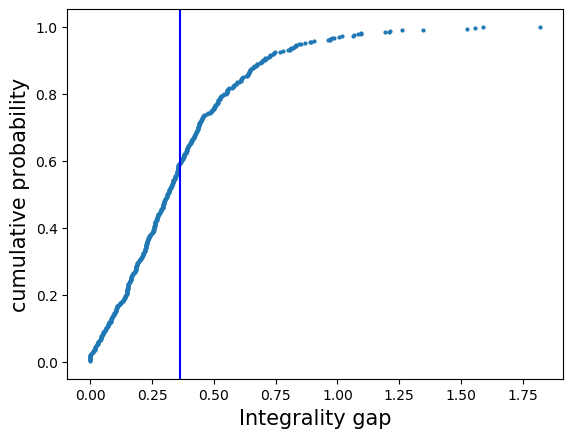

In [167]:
process(data_mn3)

<function matplotlib.pyplot.show(*args, **kw)>

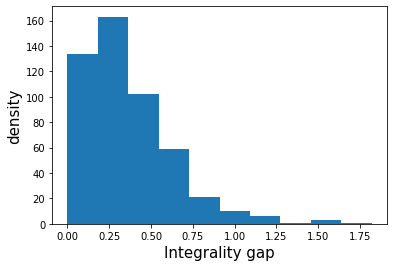

In [85]:
n, bins, patches = plt.hist(data_mn3)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

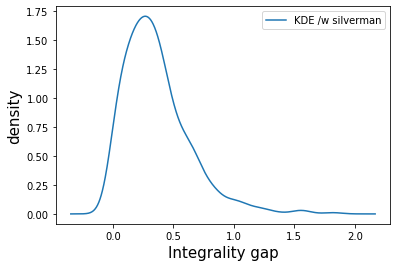

In [86]:
kernelDensity(data_mn3)

In [87]:
data_mn4 = the_loop(5, 60, 500)

[ 1. -0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1. -0.  0.  1.  0.  1.
  0.  1.  1. -0.  0.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.
  1.  0.  0.  0.  0.  1.  0.  0. -0.  1.  0.  1.  0.  1.  0.  0.  0.  1.
  0.  0.  1.  1. -0.  1.]
Obj: 19.0743
[1.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         0.46069174 0.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         0.         1.        ]
Obj: 19.119
19.11898496359693 relaxed 
19.07427935394859 original 
[ 1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.
  1

[1.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         0.         1.
 1.         1.         0.         1.         0.81686652 1.
 0.         1.         1.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         0.23925378
 1.         1.         0.         1.         1.         1.
 0.         1.         1.         0.         1.         0.10755203
 0.         1.         0.         1.         0.         0.        ]
Obj: 30.3945
30.394495949150897 relaxed 
30.26143439128429 original 
[ 0. -0. -0. -0.  1.  0.  1.  1. -0.  1.  0. -0. -0. -0.  1.  1.  1.  1.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  0.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0. -0.]
Obj: 26.4563
[1.         0.         0.         0.         1.         0.

[0.         1.         1.         0.48569019 0.         0.
 1.         1.         0.         1.         0.5022807  1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 0.14634231 0.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.96197214 0.         1.         0.         0.         1.        ]
Obj: 25.8178
25.817812267757375 relaxed 
25.51963209539145 original 
[1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 1.
 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1.]
Obj: 27.9247
[1.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         1.   

[ 1.  0.  1. -0.  1.  1.  0.  1.  1.  1. -0.  0. -0.  0. -0.  1.  1.  1.
  1.  1.  1.  1.  0.  1.  0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  0.  0. -0. -0.  1.  0.  0.  1.  1.  1. -0.  0. -0.  1. -0.
 -0.  1. -0.  0. -0. -0.]
Obj: 19.1439
[0.         0.         1.         0.06363752 1.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.45383756 0.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.81937885 1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.34215594 0.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.        ]
Obj: 20.1588
20.15882010417802 relaxed 
19.143874019761206 original 
[-0. -0.  1.  1.  1.  1. -0. -0.  0.  1. -0. -0. -0.  1.  1.  1.  1. -0.
 

[-0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.
  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
  0.  1. -0.  1.  1.  1.]
Obj: 21.366
[0.         0.         1.         0.         1.         1.
 1.         1.         0.         0.         0.         0.49533655
 0.         0.         0.         0.         1.         0.93512034
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.        ]
Obj: 21.4363
21.436298545049944 relaxed 
21.366041997994703 original 
[ 1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -

[0.13867563 1.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.61043368 0.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         1.         0.        ]
Obj: 22.5043
22.504318129321387 relaxed 
22.425630665003638 original 
[1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1.
 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0.
 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0.]
Obj: 24.2075
[1.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.  

[0.         1.         1.         0.         0.         1.
 1.         0.         1.         0.48813101 0.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         1.         1.        ]
Obj: 20.636
20.635976723469682 relaxed 
20.516384566711213 original 
[-0. -0.  1.  0.  1.  1.  1. -0.  1. -0. -0. -0.  0.  1.  1.  1.  0. -0.
 -0.  0. -0.  0.  0.  1.  1.  1.  1. -0.  1.  1.  0. -0.  0.  1. -0. -0.
 -0.  1.  1. -0. -0.  0.  1. -0.  1. -0.  1. -0.  0.  1. -0. -0.  1.  1.
  1.  1.  1. -0.  1.  1.]
Obj: 25.1913
[0.         0.         1.         0.         1.         1.
 1.         0. 

  1.  1. -0.  1.  1. -0.]
Obj: 26.9283
[0.         0.         0.         0.         0.         1.
 0.         0.         1.         0.39130913 1.         1.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         0.9322129  0.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         0.86737983
 1.         1.         0.         0.         1.         0.        ]
Obj: 27.5091
27.509095800081305 relaxed 
26.928347994918806 original 
[-0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  0. -0. -0.
  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.
 -0. -0.  1. -0. -0. -0.]
Obj: 16.4819
[1.         0.         0. 

[0.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.65386662 0.         1.         0.67475693
 1.         1.         1.         1.         0.         0.
 0.         0.44482092 0.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.08843036 0.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         0.         0.        ]
Obj: 19.3041
19.30409175432922 relaxed 
19.00111033310858 original 
[-0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.
  1. -0.  1. -0.  1. -0.  0.  1. -0. -0. -0. -0.  1.  0.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  0. -0.  1.
 -0.  1.  1.  1.  1.  1.]
Obj: 21.7857
[0.         0.         1.         1.         0.         1.
 0.     

[0.         0.         1.         0.09919912 1.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         0.63211508 0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.        ]
Obj: 21.0195
21.019539256242776 relaxed 
20.705912543939807 original 
[1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0.
 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1.]
Obj: 23.2911
[1.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.  

Obj: 29.3955
[1.         0.         1.         1.         0.         0.83839461
 0.         1.         0.         0.         1.         1.
 0.         1.         0.64711897 1.         0.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.07299493 0.         0.         0.         0.
 0.         0.         1.         0.19397246 0.         1.
 1.         0.         0.         1.         0.         0.
 1.         1.         1.         0.         1.         1.        ]
Obj: 29.6649
29.664915197704406 relaxed 
29.395535011100606 original 
[1. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0.
 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0.
 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0.]
Obj: 21.5247
[1.         1.         0.63982678 0.         0.         0.
 1.         1.         1.         1.         0.       

[1.         1.         1.         1.         0.         1.
 1.         0.         0.         0.35138446 0.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.        ]
Obj: 25.7999
25.799904112489198 relaxed 
25.758937580455616 original 
[ 1.  1.  1. -0. -0.  0.  1.  1.  0.  1.  0.  0.  0.  0. -0. -0.  1.  0.
  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  0.  1.  1. -0.  1. -0. -0.  1.
  1.  1.  1.  0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.
  0.  1.  1.  1.  1.  0.]
Obj: 25.7911
[1.         0.30729449 1.         0.         0.         0.
 1.         1.

[1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 0.         1.         1.         0.88413471 1.         1.
 0.         0.         1.         1.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         1.         0.29051723 0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         1.        ]
Obj: 36.3063
36.30625038226094 relaxed 
36.01891753340371 original 
[ 0.  1. -0.  0. -0. -0.  0.  1.  1. -0.  1.  0. -0. -0.  1.  1.  0.  0.
  1. -0.  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1. -0.  1.  1.
  1.  0.  1.  1.  0.  1.  0. -0. -0. -0. -0.  0.  1.  0.  1. -0.  0.  0.
  0.  1.  1.  1. -0.  0.]
Obj: 19.6116
[0.         1.         0.         0.         0.         0.
 0.         1.  

  1. -0. -0. -0. -0. -0.]
Obj: 21.6495
[0.         1.         0.90372455 1.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         0.46257666 0.
 1.         1.         1.         0.79999405 0.         1.
 1.         0.         0.         0.         0.         0.        ]
Obj: 21.8614
21.861358466735897 relaxed 
21.649517147840815 original 
[-0.  1.  1. -0.  1. -0.  1.  1.  0.  1.  1. -0. -0. -0.  0. -0.  1.  1.
 -0.  0.  1. -0.  0.  1. -0.  0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  0.  1. -0.
  1. -0.  1.  1.  1. -0.]
Obj: 28.2516
[0.         1.         1.         

  1.  1. -0. -0.  1.  1.]
Obj: 20.2177
[1.         0.         0.         1.         0.49740719 0.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         0.81040968 1.
 0.         1.         0.         1.         1.         1.
 0.06799096 1.         0.         0.         1.         1.        ]
Obj: 20.3312
20.331199814635514 relaxed 
20.217708969494343 original 
[ 0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  0.  1.  1.  1.
 -0. -0. -0.  1. -0. -0.  0. -0. -0. -0. -0.  1.  1.  1. -0.  0. -0.  0.
  0. -0.  0.  0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  0.
 -0. -0.  1. -0. -0.  1.]
Obj: 12.8675
[0.         1.         1.         

22.685315221740083 relaxed 
22.383415302091958 original 
[ 1. -0.  1.  1. -0.  1.  1.  0. -0.  0.  1.  1.  1.  1.  1.  0. -0.  0.
  1.  0.  1.  0. -0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.
  0.  0.  0. -0.  0.  0.  1.  1. -0. -0.  1.  0.  1. -0.  0.  1. -0.  1.
  1.  0.  0.  0.  1.  1.]
Obj: 24.5917
[1.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.22476783 1.         1.         0.
 1.         0.         0.         1.         0.24276814 1.
 1.         0.         0.         0.         1.         1.        ]
Obj: 25.0283
25.02829786136908 relaxed 
24.591691030014008 original 
[ 1.  1. -0.  1. 

[0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         0.         0.32510692
 0.88522217 1.         0.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         1.         0.         1.         0.         0.43950392
 0.         1.         1.         0.         0.         1.
 0.79255849 1.         0.         0.         1.         0.        ]
Obj: 24.4769
24.47685587423603 relaxed 
24.22060556259896 original 
[ 0.  1.  1.  0.  1.  1. -0.  1.  0.  1. -0.  0.  1.  0. -0.  0.  0.  1.
  0. -0.  0. -0.  1.  0. -0.  0.  0.  1.  0.  1. -0. -0.  0.  1.  1.  0.
  0.  0.  1.  0. -0.  1.  1.  1.  0.  1. -0.  0. -0. -0.  0.  1. -0.  1.
 -0.  1.  0.  1. -0.  0.]
Obj: 19.4471
[0.         0.72280463 1.         0.         1.         1.


[1.         1.         1.         0.67381651 1.         0.
 1.         0.94588307 1.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         1.         0.72666417 1.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         0.         0.47546008 0.         1.
 1.         0.         1.         1.         0.         1.        ]
Obj: 25.5463
25.54630403552146 relaxed 
24.597526906962518 original 
[1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1.
 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0.
 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0.]
Obj: 28.2408
[0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.   

[0.         0.         0.         0.         1.         0.
 0.83672223 0.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         0.7916754
 1.         1.         1.         1.         0.         0.
 1.         1.         0.         0.         0.         1.        ]
Obj: 19.8446
19.84464791665739 relaxed 
19.79122475316212 original 
[0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0.
 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1.]
Obj: 18.4465
[0.         0.19598871 0.         1.         0.77220069 1.
 1.         1.         1.         1.         1.         0.
 0.        

[1.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.87490032 0.
 1.         1.         1.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.43823943 0.         0.        ]
Obj: 19.0108
19.01077402483836 relaxed 
18.914873504218974 original 
[ 1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.
  0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1.  1. -0. -0. -0.  1.]
Obj: 24.2727
[1.         0.         1.         0.65981571 1.         1.
 1.         0. 

  1.  1.  1.  1. -0.  1.]
Obj: 15.2903
[0.         0.90108412 0.         0.         0.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.59846868 0.
 0.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         0.4973678
 0.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.15656411 1.         0.         1.         0.46706643 1.        ]
Obj: 16.0614
16.061361711841077 relaxed 
15.290349354869466 original 
[0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1.
 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0.
 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1.]
Obj: 23.7728
[0.         0.         1.         0.         1.         0.
 1.         1.         0.    

[0.         0.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         0.5786621  1.
 1.         1.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         1.         0.00552923 0.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.        ]
Obj: 18.3052
18.305240568631135 relaxed 
18.10655432565345 original 
[0. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1.
 0. 1. 1. 1. 1. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0.
 0. 0. 1. 1. 0. 1. 1. 1. 1. 1. 0. 0.]
Obj: 23.8747
[0.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.   

[1.         0.         0.17664758 0.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.84920692 1.         0.         1.         0.         1.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         0.15286437 0.         1.        ]
Obj: 26.9764
26.976432503162737 relaxed 
26.5466114938836 original 
[1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0.
 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0.
 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0.]
Obj: 23.8484
[1.         0.         1.         1.         0.         0.
 0.         0.         0.         0.87830045 0.         0.
 1.         0.    

[1.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         0.56847486 1.         0.30096144
 1.         0.         1.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         0.        ]
Obj: 26.1907
26.190686879610027 relaxed 
26.046764100350938 original 
[0. 1. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0.
 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1.
 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
Obj: 20.9362
[0.         1.         1.         1.         0.         1.
 0.13238009 0.         0.         1.         1.         1.
 0.     

[0.         0.         0.         0.         0.         1.
 1.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.83299558 0.         0.         0.
 1.         1.         1.         0.         0.         0.16810322
 0.         1.         0.         1.         0.         1.
 1.         1.         1.         0.08192608 1.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         1.        ]
Obj: 27.2998
27.299842138019685 relaxed 
26.800721550809964 original 
[1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 1.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0.]
Obj: 18.4525
[1.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.     

 -0.  1. -0. -0.  1.  1.]
Obj: 20.2748
[1.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         0.42675408
 1.         1.         1.         0.         0.74734149 0.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.71639817 1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.         0.         0.27047617 1.        ]
Obj: 20.6381
20.638124983500337 relaxed 
20.27479774056342 original 
[ 1.  1.  0.  1.  1.  0.  0.  1. -0.  1. -0.  0.  1.  0.  1. -0.  1.  1.
  1. -0.  1.  1.  1. -0.  1.  0. -0.  0.  0.  1.  1.  0.  1.  0.  1.  0.
  0.  1.  1.  0. -0.  1.  1.  1.  1. -0.  1. -0.  0.  0.  1.  0.  1.  1.
  1.  0. -0.  0.  0. -0.]
Obj: 18.0388
[1.         1.         0.  

[1.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         0.31436062
 1.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         1.        ]
Obj: 27.9839
27.98394870765627 relaxed 
27.96075639758849 original 
[ 1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  0.
  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0.  0.  1. -0.  1.
  1.  1. -0.  1. -0.  1.]
Obj: 29.2998
[1.         1.         1.         1.         0.         0.
 1.     

[0.         0.         1.         0.         1.         1.
 0.17830595 1.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         0.         0.03451903 0.         1.         1.
 0.         1.         0.         0.30655109 1.         1.
 0.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         1.        ]
Obj: 29.4489
29.448891138105434 relaxed 
29.328746001114723 original 
[-0.  0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.
  1.  1. -0.  0. -0. -0.  0. -0. -0.  1.  1.  0. -0.  1. -0.  0.  1.  1.
 -0. -0.  1.  1.  1. -0. -0. -0.  0.  1.  0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0.  0.  1.  1.  1.]
Obj: 19.2946
[0.         0.95917442 0.9636594  0.         0.         1.
 1.         1.

[1.         0.         1.         0.         1.         0.
 0.         1.         0.12484002 1.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.84146081 0.         0.376658   0.         0.         0.
 0.         1.         1.         1.         1.         0.        ]
Obj: 25.8455
25.84554748405118 relaxed 
25.228149182861028 original 
[-0. -0.  1. -0.  1.  0.  1. -0.  0.  1.  0.  1. -0. -0.  1.  1.  1. -0.
  1.  1.  0.  1. -0.  1.  1. -0.  0. -0. -0. -0.  1. -0. -0.  1. -0.  1.
  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.
  1.  1.  1.  1. -0.  1.]
Obj: 27.0517
[0.         0.         1.         0.         1.         0.89934656
 1.    

[0.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         0.6970867  0.         1.
 0.80458263 1.         0.         0.17107726 1.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.05958656 0.         1.         1.         1.         1.        ]
Obj: 21.4991
21.49911988839754 relaxed 
21.090502356569413 original 
[-0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  0. -0. -0. -0.  1. -0.  1. -0.
  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.
  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.
 -0. -0.  1.  1. -0.  1.]
Obj: 21.2868
[0.         1.         0.         0.         1.         0.
 0.         1. 

[1.         0.         0.         1.         1.         1.
 0.         0.         1.         0.         0.65075091 0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         0.038476
 0.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         0.        ]
Obj: 15.4166
15.416582571105126 relaxed 
15.273973392080931 original 
[ 1. -0.  0.  0.  1.  0.  0.  0.  0. -0.  0.  1.  1.  1. -0.  1.  0.  1.
  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0. -0.  0.
  0.  0. -0.  1.  0. -0. -0.  1. -0. -0.  1.  0.  1.  0.  0.  0. -0.  1.
  1.  1. -0.  1.  1.  0.]
Obj: 17.73
[1.         0.         0.         0.         0.53488159 0.
 0.       

[1.         1.         1.         1.         0.         0.
 0.07843356 1.         0.         1.         0.         1.
 1.         1.         0.         1.         1.         0.02393325
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         0.         0.75996264 0.
 0.         1.         1.         1.         0.         1.        ]
Obj: 19.7913
19.791340615375976 relaxed 
19.512066144910925 original 
[ 1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.
  1. -0.  1. -0. -0. -0.  1.  0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.
  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.
  1.  1.  1. -0.  1. -0.]
Obj: 32.9919
[0.0667691  1.         0.         0.         0.         0.
 0.   

[ 1.  1.  1. -0.  1. -0.  1.  0. -0. -0. -0.  0. -0.  1.  1.  1.  1.  0.
 -0. -0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  1. -0.  0.  1.  1.  1.  1.
 -0.  1. -0.  1.  0. -0.  1.  0. -0.  1.  1.  0. -0.  0.  0.  0.  0.  0.
  1. -0. -0. -0.  1.  1.]
Obj: 17.8201
[1.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.04898571 0.
 0.         0.13079491 1.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         1.
 0.         1.         0.95042431 1.         0.         0.5597406
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         1.        ]
Obj: 18.4317
18.43166620371221 relaxed 
17.820063338920097 original 
[1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 

 -0.  0.  1.  1. -0. -0.]
Obj: 17.9299
[1.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         1.
 0.         0.32112756 1.         0.         0.         1.
 0.         0.25528303 0.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         0.         0.        ]
Obj: 18.4059
18.405864518296926 relaxed 
17.929935657760996 original 
[0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 0.
 1. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1.
 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1.]
Obj: 25.4691
[0.         1.         0.         0.         0.         0.
 0.         0.         1.         0.

  0.  0.  1.  0.  0.  0.]
Obj: 15.5609
[0.         1.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         1.         0.48108658 1.         0.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         0.59455097 0.0845737
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.        ]
Obj: 15.9046
15.904632405881426 relaxed 
15.560948453311049 original 
[ 1. -0.  0.  1.  0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  0.  1.  1.  0.
 -0.  1.  0.  1.  1. -0. -0. -0. -0.  1.  1.  0.  1.  1.  0.  1. -0.  1.
  1.  1. -0.  1. -0.  1.  1.  0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.
 -0. -0.  0.  0. -0.  0.]
Obj: 22.6756
[0.51354225 0.         0.  

31.325580976796598 original 
[ 1.  0.  0. -0. -0.  0.  1.  0.  1. -0.  1. -0.  1.  0.  1.  0.  0.  0.
  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.
  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0. -0.  0. -0.
  1.  0.  1.  1.  0.  0.]
Obj: 21.8802
[1.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.62355893 0.17296095 1.         1.         0.65612131 1.
 0.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.        ]
Obj: 22.0933
22.093270099600144 relaxed 
21.880236108505294 original 
[ 1.  1.  0.  1.  0.  1.  1.  0.  0.  0.  0.

[1.         1.         1.         1.         0.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.48690055 1.         1.         1.         0.         0.
 1.         0.         0.19842807 0.         1.         1.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.50369072 0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         0.5218639  1.         1.
 1.         0.         0.         1.         1.         1.        ]
Obj: 26.1583
26.158302972688283 relaxed 
25.517870640089797 original 
[0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0.
 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1.
 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1.]
Obj: 25.9679
[0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0.
 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 

[-0.  1. -0. -0. -0.  0.  1.  1.  1.  1.  0. -0.  0. -0.  0. -0.  1. -0.
  1. -0. -0. -0. -0.  0.  1.  1.  1. -0.  1. -0. -0.  0.  1.  0.  1. -0.
  1.  1. -0.  0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.
  1.  1. -0.  1.  1.  1.]
Obj: 25.4025
[0.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         0.52104637
 0.24620825 1.         1.         0.         1.         0.
 0.         0.98733341 1.         0.         1.         0.
 1.         1.         0.         0.05697579 0.         0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         1.        ]
Obj: 25.7387
25.738728790016552 relaxed 
25.40252119045074 original 
[-0.  1.  0. -0.  1.  1.  0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  

[-0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.
  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.
  1. -0. -0.  1.  1. -0.]
Obj: 23.6633
[0.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         0.
 1.         0.96292813 0.         1.         1.         1.
 1.         1.         1.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         0.22169965 1.         0.
 1.         1.         0.         0.84637137 0.         0.
 1.         0.         1.         0.7738219  1.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         0.        ]
Obj: 24.5378
24.537793346537338 relaxed 
23.66329015334884 original 
[ 1.  0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  0. -0.  1. -0.
 

[ 1.  0.  1. -0. -0.  1. -0.  0. -0.  1.  0.  0. -0.  1. -0.  0. -0. -0.
  0.  0.  0.  1.  1.  0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
  1.  1. -0.  0.  0.  0.  0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.
  1.  1.  1.  0. -0.  1.]
Obj: 20.7731
[1.         0.         1.         0.         0.         1.
 0.         0.         1.         0.81436837 0.         0.
 0.         1.         0.87384915 0.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.9896299
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.65799754 0.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         0.         1.        ]
Obj: 21.4438
21.443845590702054 relaxed 
20.7730768433834 original 
[ 1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.

mean: 0.2616860095356341
median: 0.21345436101997173
standard deviation:0.20170107842348906


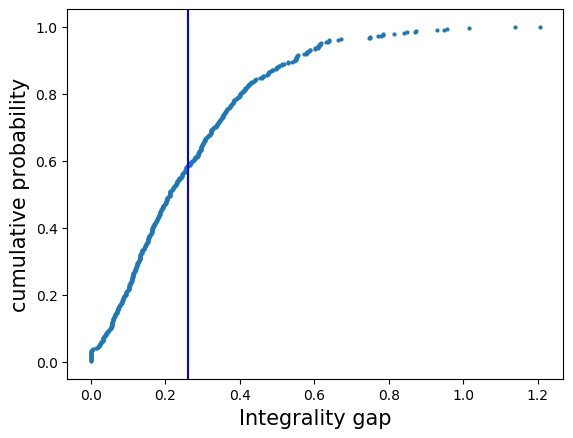

In [168]:
process(data_mn4)

<function matplotlib.pyplot.show(*args, **kw)>

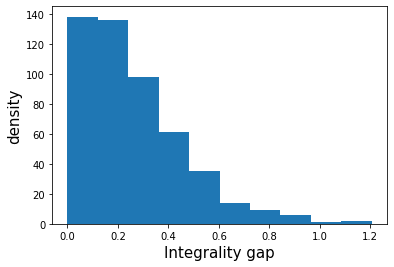

In [91]:
n, bins, patches = plt.hist(data_mn4)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

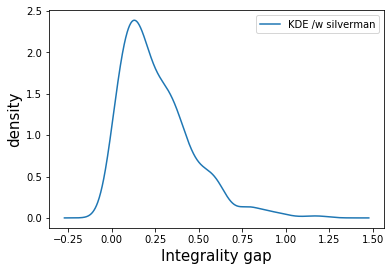

In [90]:
kernelDensity(data_mn4)

In [92]:
data_mn5 = the_loop(5, 90, 500)

[-0. -0. -0. -0.  1.  0. -0. -0. -0.  0. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  0. -0.  1.  1.  1. -0.  0.  1.
  0.  0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  0.  1.  0.  1.  1. -0.
  1.  1.  1.  1. -0.  1. -0.  1.  1.  0.  1.  0.  1. -0.  1.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0.  0.  0. -0. -0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 36.783
[0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.74791492 0.         1.
 0.         0.29987633 1.         0.         0.         1.
 1.         0.         1.         1.         1.         1.
 0.98860044 0.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         0.87978439 0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.       

 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0.]
Obj: 38.8907
[1.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.28183011 1.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.64852609 1.         1.         0.         1.
 0.83479938 0.37436598 0.         1.         1.         0.84221754
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         1.         0.        ]
Obj: 39.3045
39.3045242623015

[0.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         0.63211024 0.         1.         1.         1.
 1.         0.28035221 0.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         0.        ]
Obj: 30.4005
30.40054258044903 relaxed 
30.3568371660628 original 
[-0. -0.  1. -0. -0.  1.  0.  1. -0. -0

[1.         1.         1.         1.         0.         0.94936941
 1.         1.         1.         1.         0.         0.
 1.         0.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.70145868 1.         0.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         1.         0.        ]
Obj: 37.3723
37.37230033905415 relaxed 
37.17337206301238 original 
[-0. -0. -0. -0.  1. -0. -0. -

[1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1.
 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1.]
Obj: 34.2159
[1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1.
 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1.]
Obj: 34.2159
34.21591751361331 relaxed 
34.21591751361332 original 
[-0.  0.  0.  1.  1. -0.  1. -0. -0.  0.  1.  1.  1. -0. -0. -0.  1.  1.
  1.  1. -0.  1. -0. -0. -0. -0.  0. -0.  0.  1.  1.  1. -0. -0.  1. -0.
 -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.
 -0.  0.  1.  1.  1.  1.  1. -0.  0. -0. -0. -0. -0. -0. -0.  1.  1.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.]
Obj

[ 1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.
  1.  1. -0.  1. -0. -0. -0. -0.  0.  1. -0. -0. -0.  1.  1. -0. -0.  0.
  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.
 -0.  0.  1.  0. -0. -0.  0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1. -0.  1. -0.  0. -0.  1. -0. -0.  1.  1. -0.  1.]
Obj: 39.0664
[1.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.6657203  1.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.50617858 1.      

[0.99557042 0.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         1.
 1.         1.         0.80031116 0.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.76035194
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         0.         0.        ]
Obj: 35.3043
35.30432708260573 relaxed 
35.22250390974834 original 
[ 1. -0. -0.  1.  1. -0.  1. -

  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.]
Obj: 29.3736
[0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.27034752 1.         0.         0.         1.         0.
 1.         1.         0.52464778 0.         1.         1.
 1.         1.         0.         1.         0.         1.
 1.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.14445882 0.         1.         1.
 1.         0.         1.         0.78695925 1.         0.        ]
Obj: 29.7923
29.792

[-0. -0.  0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.
  1.  1.  1.  0. -0.  1.  1.  0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  0.
  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.
  1.  1. -0. -0.  1.  1.  1.  1.  1.  0.  1. -0. -0.  0. -0. -0. -0. -0.]
Obj: 39.8904
[0.05467364 0.         1.         0.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.560429

[0.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         0.41824086 0.         1.
 1.         1.         0.         1.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.96989021 0.         1.         0.         0.         1.
 0.         1.         1.         0.         0.         1.        ]
Obj: 31.4299
31.429946613836748 relaxed 
31.09579077069003 original 
[-0.  1.  1. -0. -0.  1.  1.  1. -0. 

[0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1.
 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0.
 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1.
 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
Obj: 33.4729
33.472877558613845 relaxed 
33.472877558613845 original 
[ 0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  0.
 -0.  1.  1. -0. -0.  1.  0.  1. -0. -0.  1.  1.  0. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
  0. -0.  1.  0.  0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  0. -0. -0. -0.  1.]
Obj: 27.4787
[0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.93328854 0.         1.         0.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         0.    

30.77425591635186 relaxed 
30.66234996202133 original 
[0. 1. 1. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.
 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0.
 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0.
 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1.]
Obj: 40.8425
[0.         1.         1.         1.         1.         1.
 0.12725232 0.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         0.
 0.     

[0.         0.         0.         0.         1.         0.
 1.         0.         0.95406463 1.         1.         0.
 1.         0.         0.38568367 1.         1.         0.
 0.92911022 1.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.97319773 0.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         0.         1.        ]
Obj: 31.2434
31.243449561252802 relaxed 
30.881210247517306 original 
[ 1.  1.  1.  1. -0.  0. -0.  1. -0.

[1.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         1.         1.
 1.         0.02671824 0.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         0.         1.         1.         1.         1.        ]
Obj: 34.5306
34.53060561407724 relaxed 
34.492683891416775 original 
[ 1. -0.  1.  1.  0.  1.  1.  1. -0. 

[1.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         0.51946929
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.08940876 1.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.73561372 0.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         1.        ]
Obj: 27.2323
27.232293461898127 relaxed 
26.933160459201027 original 
[ 1. -0. -0. -0. -0.  1. -0.

[ 1.  1.  1.  1.  0. -0.  0.  1. -0.  0.  1.  1.  1.  0.  1.  0.  1.  0.
  0.  1.  0. -0. -0.  0.  1.  1.  0.  1.  0. -0. -0.  1.  1.  1.  1.  1.
  1.  1.  0.  1.  1.  0.  1.  1. -0.  0. -0.  0.  1. -0. -0.  1. -0.  0.
  1.  0.  0. -0.  1.  0.  1.  1.  0.  1. -0.  1.  1.  1.  1.  1.  1.  1.
  0.  0.  1. -0.  1.  1.  1.  1.  1. -0.  0.  1. -0.  0.  1.  1.  1.  0.]
Obj: 37.0134
[1.         1.         1.         1.         0.         0.28654152
 0.         1.         0.         0.         1.         1.
 0.18666226 0.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         1.         

Obj: 35.6751
[0.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         1.         0.03519404 1.         1.
 0.         0.         0.         0.20322302 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         1.         1.         0.         0.         1.        ]
Obj: 35.9933
35.99328066587152 relaxed 
35.675145423385985 original 
[1. 0. 0. 1. 1. 0. 1. 0.

[1.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.76201738
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         1.        ]
Obj: 42.8801
42.880098187836175 relaxed 
42.873789271842114 original 
[-0. -0. -0. -0. -0.  1. -0.

[0.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         1.         1.         0.86983317 1.         0.
 0.         1.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         0.35146641 1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.13557523 1.         0.         1.         0.         0.        ]
Obj: 37.2166
37.21658299368919 relaxed 
37.16098902221515 original 
[ 1. -0. -0.  1. -0. -0. -0.  1.  1.  

[ 1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1.
 -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.
  1.  1. -0.  0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  0.  1.]
Obj: 36.9289
[1.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         1.         0.53569959 1.         1.         1.
 0.         0.         0.         0.         0.         1.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         0.76753476
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         

  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  0.]
Obj: 27.416
[0.         1.         1.         0.87620602 1.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.47638963 0.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         0.36229873 0.        ]
Obj: 27.7197
27.7197

[1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0.
 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 1. 0.
 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0.]
Obj: 30.589
[1.         0.         0.         1.         0.         1.
 1.         0.         0.         0.49385093 0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.27676341 0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         0.72598192 1.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.  

Obj: 34.8702
[1.         1.         0.         0.         0.68613873 0.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         0.32989115 0.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.11876982 0.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         1.        ]
Obj: 35.0878
35.08783074191275 relaxed 
34.87016227901635 original 
[ 1. -0.  1.  1.  0.  0. 

[ 0.  0.  0.  1. -0.  0. -0. -0.  0.  1.  0. -0.  0.  0.  1.  0.  0.  1.
 -0.  1.  1.  1.  1. -0.  0.  0.  1.  0.  0.  1.  1.  0. -0.  0.  1.  0.
 -0.  1.  0.  1.  1. -0.  1. -0.  0.  0.  0.  1.  1.  1.  1.  1.  1. -0.
 -0.  1.  1. -0.  1. -0.  0.  1.  0.  1. -0. -0.  1.  0.  1.  1.  0.  1.
 -0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.  0.  1. -0.  1.  1. -0.  1.]
Obj: 27.5249
[0.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.1252591  0.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.      

[0.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         1.         1.
 0.         1.         1.         1.         0.         1.
 1.         1.         1.         0.         0.         0.
 1.         0.         0.         0.89340153 0.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.52636976 0.         1.         1.         0.         0.70012177
 0.         0.         0.         0.         0.         0.73055716]
Obj: 26.7433
26.743298231507183 relaxed 
26.60691636235817 original 
[ 1.  1. -0.  1.  1. -0. -0. 

[ 1.  1.  1.  0. -0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  1. -0.  0. -0.
 -0.  1.  1.  0.  0.  0.  0.  0. -0.  1.  0. -0.  1.  1.  1.  1.  1. -0.
  1.  1.  1. -0. -0. -0.  1.  0.  0.  1.  1.  1.  1.  0.  1. -0. -0.  1.
  0. -0.  1. -0.  1.  1.  1. -0.  0.  0.  0.  1.  1.  1.  1. -0.  0.  1.
  1.  1. -0.  0.  0.  1. -0.  1.  1. -0.  0. -0.  0.  1.  0.  0.  1. -0.]
Obj: 26.7556
[1.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         0.30407681
 1.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.00324409 1.
 0.         1.         1.         0.         1.         1.
 1.         0.         

  0.  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.]
Obj: 31.9201
[1.         0.         1.         1.         0.         0.
 0.         0.         1.         1.         0.         1.
 1.         1.         1.         1.         0.         1.
 0.         1.         0.         1.         0.40094391 1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         0.49342482]
Obj: 32.087
32.0870

[-0.  1.  0.  1.  1. -0. -0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0.
  1.  0.  0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  0.  0. -0.  0.  0.
  1.  1. -0. -0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  0.  0.  1. -0.
 -0.  0. -0.  0.  0.  1. -0. -0.  1.  0.  0.  0.  0.  0.  0. -0.  1.  0.
 -0.  0.  1.  1.  1.  1.  1.  0. -0. -0.  1.  0.  1.  1.  0.  0.  1.  0.]
Obj: 23.3045
[0.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         0.25541733 0.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.2791074  1.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         1.      

[0.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         1.         1.         0.         0.14282346
 0.         1.         1.         1.         0.36529463 1.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         0.57191697 0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.28981261 0.         1.         0.
 1.         1.         0.         1.         0.         0.        ]
Obj: 35.5696
35.569604384156605 relaxed 
35.394772221149935 original 
[-0. -0. -0.  1. -0. -0. -0.

[0.         0.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         0.5642053
 1.         1.         1.         0.         0.1776222  0.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 1.         0.42684552 0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         0.         0.3753775
 0.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.        ]
Obj: 32.8166
32.816625996439754 relaxed 
32.48787718770075 original 
[0. 0. 1. 1. 0. 1. 0. 0

  1.  0.  0.  1.  0. -0.  1.  0.  1.  0.  0.  1.  1.  1.  1.  0.  1.  1.]
Obj: 33.1286
[1.         0.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.42266964 0.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.74259638 0.         0.         0.         1.
 0.         0.         1.         0.         0.10652665 0.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         0.63224451
 1.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         1.         1.        ]
Obj: 33.515

[0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.42560956 0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.43820663 0.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.10568989 1.         0.         0.         1.         1.
 0.         0.11316952 1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.        ]
Obj: 30.7415
30.74147896189551 relaxed 
30.06934792975476 original 
[ 1. -0. -0. -0. -0. -0. -0. -0.  1.  

  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.]
Obj: 35.8125
[0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.49243349 1.         1.         0.         1.         1.
 0.27094572 1.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         1.        ]
Obj: 36.0012
36.001

  1. -0.  1.  1. -0. -0. -0.  1. -0.  0.  1. -0. -0. -0. -0.  1. -0. -0.]
Obj: 33.3854
[0.         1.         1.         1.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         0.35365584 0.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.        ]
Obj: 33.4138
33.413

  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  0.  1.  1.  0. -0. -0.]
Obj: 32.0454
[1.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.56983225 0.         0.
 0.         0.         1.         0.         0.         0.6333283
 1.         0.         1.         1.         1.         1.
 1.         1.         1.         1.         0.6889555  0.
 0.         1.         1.         0.24904911 0.         0.        ]
Obj: 32.5309

Obj: 33.6789
[1.         0.         0.         0.41950282 0.         0.05292571
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         0.        ]
Obj: 33.8458
33.84584254644635 relaxed 
33.678867055494436 original 
[ 0. -0. -0. -0.

[-0. -0.  1.  1.  1.  0.  0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.
  1.  1.  0.  1.  0.  0.  1.  1. -0.  0.  0. -0.  1.  1.  1.  1.  1.  0.
 -0. -0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  1.  1.
 -0.  1.  1.  1. -0. -0.  1.  0. -0.  1.  1.  0.  0.  0. -0.  1. -0.  1.
  1.  0.  0. -0.  0.  1.  1.  1.  1.  1. -0. -0.  0.  1.  1.  0.  0. -0.]
Obj: 35.172
[0.         0.         1.         1.         1.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 1.         0.98400698 1.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.11201555 1.         1.         1.         0.         0.
 1.         0.         0.       

[0.         1.         1.         1.         0.         0.12156766
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         1.         0.         1.         0.06746581
 0.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         0.04445767
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.28019129 1.         1.
 1.         0.         1.         1.         0.         0.        ]
Obj: 39.0302
39.030150094538484 relaxed 
38.81497271576519 original 
[1. 0. 0. 0. 

Obj: 29.4551
[0.         0.         1.         1.         0.         1.
 1.         0.         0.         0.51322722 0.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.32335695 1.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         0.25662349 0.         1.
 1.         1.         0.         0.89436858 0.         0.
 1.         1.         0.         1.         0.         0.        ]
Obj: 29.7576
29.757596127377877 relaxed 
29.45508047896781 original 
[ 1.  1. -0.  1. -0.  1.

[0.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         0.99747063 0.         1.
 0.         1.         0.         0.         0.9120276  0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         1.         1.         0.
 0.         0.         0.53402023 1.         0.         1.
 1.         1.         1.         1.         1.         0.        ]
Obj: 39.6677
39.66772255624876 relaxed 
39.56374371269097 original 
[ 0.  1.  0.  0.  1.  1.  1.  0.  0.  

  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.  0. -0.  0.  1.  1.  1. -0.  1.]
Obj: 25.0318
[0.         0.28680892 0.         0.         0.         1.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.44994792 1.         1.         1.         0.         1.        ]
Obj: 25.2172
25.217

  0.  0.  1. -0. -0.  1.  0.  1.  0.  0.  0. -0.  1.  1.  0.  0.  0.  0.]
Obj: 34.351
[0.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.26634015 1.         1.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.31954083 1.         0.         1.         0.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         0.57128749 0.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.        ]
Obj: 34.8257
34.8256

 -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.]
Obj: 29.7414
[0.         1.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         1.         1.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.69456795 1.         1.
 1.         1.         1.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         0.74285003 0.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.37317643 0.         1.         0.         0.         0.
 0.         0.38331575 1.         0.         1.         0.        ]
Obj: 30.5076
30.507

[1.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.59084267 1.         1.         0.
 1.         1.         1.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.90688348 0.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.31797243 1.         1.         0.         1.         0.        ]
Obj: 32.0834
32.08338474380052 relaxed 
31.9298605795519 original 
[-0.  0. -0.  1. -0.  1.  1. -0. -0. -0

[0.         1.         0.         0.         1.         1.
 1.         1.         0.         0.         0.27005237 0.
 0.         1.         0.06343819 0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         0.27090961 1.         1.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.04873105 1.         1.         0.         1.         1.
 0.         1.         0.         0.37394497 1.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         1.        ]
Obj: 45.4402
45.44020286674571 relaxed 
45.0268656155736 original 
[-0.  1. -0. -0. -0. -0. -0. -0.  1. -0

[ 0.  1.  0.  0. -0.  0.  0.  0.  1.  1. -0.  1.  0.  1. -0.  1.  0.  1.
  1.  1.  0.  0. -0.  1. -0.  0.  1. -0.  1.  1.  0.  1.  0.  0.  1.  1.
  0.  1. -0.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  1.  0.  0.  0.
  1.  0. -0. -0.  0. -0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  1. -0.
  0.  1.  1.  1.  1. -0.  1.  1. -0.  0. -0.  1.  1.  1.  0.  1. -0. -0.]
Obj: 23.6968
[0.         1.         0.         0.         0.         0.
 0.         0.         1.         1.         0.73729144 1.
 0.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         0.97379139
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         0.11268745
 1.         1. 

[0.         1.         0.         0.         0.55440561 0.
 0.         0.         1.         1.         0.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.79497923 0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.11260637 0.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         1.        ]
Obj: 27.9886
27.988595505188382 relaxed 
27.64316017309484 original 
[ 1.  1.  0.  0.  0.  0.  0.  1.  0. 

[1.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.40293154 0.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         1.         1.         0.55188025
 1.         1.         0.         1.         1.         0.        ]
Obj: 36.1827
36.182665888925456 relaxed 
35.89984515761151 original 
[1. 1. 1. 1. 1. 0. 0. 0. 0. 1

mean: 0.18227365332857023
median: 0.15517756159776397
standard deviation:0.14289958280994425


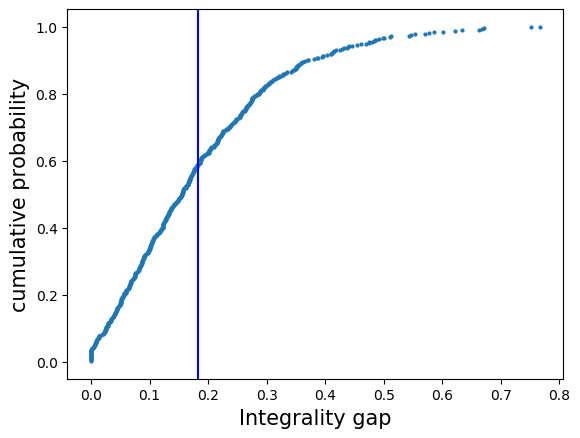

In [169]:
process(data_mn5)

<function matplotlib.pyplot.show(*args, **kw)>

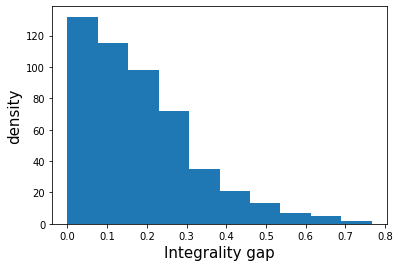

In [94]:
n, bins, patches = plt.hist(data_mn5)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

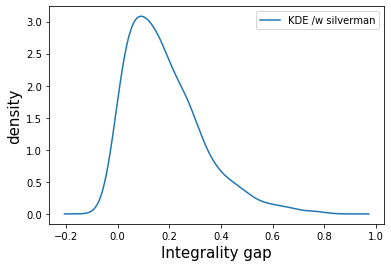

In [95]:
kernelDensity(data_mn5)

In [96]:
data_mn6 = the_loop(5, 150, 500)

[1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0.
 0. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0.
 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1.
 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 1. 1.
 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1.
 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0.
 0. 0. 0. 1. 0. 0.]
Obj: 63.5182
[1.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         0.         1.         0.         0.39429843
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         1.         0.
 1.         1.         0.         0.         1.  

[-0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  0.  1.
 -0.  0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  0. -0.  1. -0.
  0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  0.  1.  0.  1. -0.  1.  1. -0.
  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  0. -0.  1.  1. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.
  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  0. -0.  1.
 -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.
 -0. -0.  1.  0. -0.  0.]
Obj: 53.9297
[0.         0.         0.         1.         1.         1.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         0.0581176  0.
 1.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         

[1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1.
 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0.
 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0.
 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1.
 0. 1. 0. 1. 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0.
 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1.
 0. 0. 1. 0. 0. 1.]
Obj: 61.8537
[1.         1.         0.63014234 0.         1.         1.
 0.         0.         1.         0.80568315 1.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         0.17724775 0.         1.
 1.         1.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         0

[ 1. -0.  1.  1.  1. -0. -0.  0.  1.  1. -0.  1.  0. -0. -0. -0. -0. -0.
  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.
  1.  0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.
  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.
 -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.  0. -0. -0.
 -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0.]
Obj: 62.8396
[1.         0.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         0.         

[1.         1.         1.         0.         1.         0.08222957
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         0. 

[0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.57009722 0.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         1.
 1.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         

 -0. -0.  1.  1. -0. -0.]
Obj: 52.8696
[1.         1.         0.         0.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         0.79851974 0.
 1.         1.         0.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.   

[ 1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.
  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1.  1.  0. -0.  1. -0.  0.  1. -0.  1.  0.  1. -0.  0.  1. -0.  1.  1.
  1.  1.  1. -0.  1.  1. -0. -0.  0.  1.  1.  1.  1. -0. -0.  0.  1.  1.
 -0. -0.  0.  1.  0. -0.  1.  1.  1. -0. -0. -0.  0. -0.  1.  0. -0. -0.
  1. -0.  1. -0.  1.  1. -0. -0. -0.  0.  1.  1.  0.  1.  0. -0.  1.  1.
  1.  1.  1.  1.  1.  0. -0.  1.  1.  0.  1.  1.  1.  1.  1.  1. -0.  1.
  1. -0. -0.  1.  1.  0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.
 -0. -0.  1.  1.  0. -0.]
Obj: 63.2395
[1.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.95800139 

[0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1.
 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0.
 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0.
 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 0. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0.
 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1.
 0. 0. 1. 1. 0. 1.]
Obj: 56.8866
[0.         0.         0.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.73073483 1.         0.         1.         1.
 0.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         1

[0.         0.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         1.
 0.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.44687765 0.         1.         1.         0.40924672 1.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.25232633 1.         1.
 0.         0.         0.         1.         1.         

 0. 0. 1. 1. 0. 1.]
Obj: 70.7359
[0.         1.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         0.43121444 0.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         0.18790243
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.         1. 

[0.         0.         1.         1.         0.         1.
 0.         1.         0.57541735 0.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         0.         

[1.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         0.49612491 1.
 0.         0.         1.         0.         0.         0.
 1.         0.02762323 0.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         

[ 1. -0.  1.  0.  0.  1. -0.  1.  1.  0.  1. -0. -0.  1.  0.  0. -0.  1.
  0.  0. -0. -0.  1.  1.  1.  1.  0.  1. -0.  1.  0.  0. -0.  0.  1.  1.
  0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  1.  1. -0.  1.  1.  1.  1. -0.
  0.  1.  1.  1.  0.  1.  0.  1. -0.  0.  0.  0.  1.  1. -0.  1.  1.  1.
 -0.  1.  0.  0.  0.  1. -0.  1.  1.  1.  0. -0.  1.  0.  1.  1.  1. -0.
 -0.  0.  0.  1.  1.  1. -0.  0. -0.  0.  1.  1.  1.  1.  1.  0.  1.  0.
  1.  0. -0. -0.  1.  0. -0.  1.  0.  1.  0.  0.  1. -0.  0.  0. -0.  1.
  1. -0.  0.  1.  1. -0.  1.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.
  1.  0.  0.  1.  1.  0.]
Obj: 59.8785
[1.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         

  1. -0.  0. -0.  1.  0.]
Obj: 64.3769
[0.         1.         1.         0.         1.         0.
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 0.58282851 1.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.   

[0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1.
 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 1. 0. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1.
 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1.
 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1.
 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1.
 0. 0. 1. 1. 0. 0.]
Obj: 51.6317
[0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         0

[0.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.97010543 0.         1.         0.
 1.         0.         0.         1.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 1.         0.         1.         0.         0.43886297 1.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         

[0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         1.         0.41450839 0.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.55291159 1.         0.         1.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         

[1.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         0.87156088 0.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         0.95859629 0.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         

[ 0.  0.  0.  1.  0.  1.  0.  1.  0.  0.  1.  0.  0.  1.  1.  1. -0.  0.
  0. -0.  1.  1.  0. -0.  0.  1. -0.  0.  1.  1.  1.  0.  0.  0.  1.  1.
  1.  1.  1.  0.  0.  1. -0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  1. -0.
  0.  0. -0.  1. -0.  1.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.  0.
  1.  0.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1. -0.  0.  0. -0.  1.
  1.  1.  0.  0.  1.  1.  0.  1.  1. -0.  1.  1.  0.  1.  1.  1.  1.  1.
  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.  0.  0. -0.  0.  0.  1.  1.  1.
  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0. -0.  1.  0.  0.
  1.  0.  0.  0.  0. -0.]
Obj: 54.7867
[0.         0.         0.         1.         0.         1.
 0.80910029 1.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.98296094 1.         1.         0.         0.74553762
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         1. 

[ 0.  0.  1.  1. -0.  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1.
  1.  1.  1.  0.  1.  0. -0.  1.  1. -0.  0. -0.  1.  1.  1.  0.  1.  0.
  1.  0.  0.  1. -0.  1.  1. -0.  0.  1.  0.  1.  0.  0.  1. -0.  1.  1.
  1.  1.  0.  1. -0. -0.  1. -0.  1.  0. -0.  1.  1. -0.  0.  1.  1. -0.
  1. -0. -0.  0.  1.  0. -0.  0.  0.  1.  1.  1.  0.  1. -0.  1.  1.  0.
  1. -0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1. -0. -0. -0. -0.  1. -0.
  1.  0.  0.  1.  1.  1.  0.  1. -0. -0.  0. -0.  0.  1.  1. -0. -0.  1.
 -0.  0.  0.  1.  0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.
  0.  1.  1.  0.  1.  1.]
Obj: 61.2193
[0.         0.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 1.         0.         

[ 0.  0.  0.  0.  1.  0.  0.  0.  1.  0.  0.  1. -0.  0. -0.  1.  0. -0.
 -0.  1.  1.  0.  1. -0.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.
  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  0. -0.  1.  1.  1.  1.
  0.  0.  1.  1.  1.  1.  0.  0. -0.  0. -0.  0.  0.  0.  0.  1.  0. -0.
  1.  1.  1.  0.  0.  0.  0. -0.  1.  1.  1.  1.  0.  0.  0.  1.  1. -0.
  1.  1. -0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1. -0.  0.  0.  0.  1.
  0.  1.  0.  0.  0. -0. -0.  0.  0.  0.  0. -0.  1.  1.  1.  1.  1.  0.
  0. -0.  1.  0.  0.  0. -0.  0.  1.  1.  0.  0.  1.  1.  0.  0.  0.  0.
  0.  1. -0.  1.  1.  1.]
Obj: 44.9119
[0.         0.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.55656122 

  1.  1.  0.  1.  0.  1.]
Obj: 52.8759
[1.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         0.76540069 1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.19016751
 1.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.      

 -0. -0. -0. -0.  1.  1.]
Obj: 60.9565
[0.         1.         0.23476268 1.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.   

 -0. -0. -0.  1. -0. -0.]
Obj: 62.5322
[0.         1.         0.         1.         1.         1.
 0.01059976 1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.73138439
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         0.96914869 1.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.03152938 0.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 1.      

  1.  0.  1.  1.  1.  0.]
Obj: 60.1006
[1.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         1.
 0.35711403 1.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.         1.         0.         0.         0.54780409 0.
 0.         1.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         0.
 1.         0.         0.         0.25874022 0.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.   

[ 1.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1.  1.
  1.  1.  0.  1.  0.  0. -0.  1.  1.  0.  0.  1.  0.  1. -0.  0.  0.  1.
  1.  1.  1.  0. -0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1. -0.
  1.  0. -0.  1. -0.  1. -0.  1.  0.  0.  0.  1.  1.  0.  1.  0. -0.  1.
  1.  1.  1.  0.  0.  1. -0.  1.  1. -0.  1.  0.  1.  0.  1.  0.  1.  1.
  0.  0.  1.  1.  1.  1.  1.  1.  0. -0.  0.  1.  0.  0.  0.  1.  1. -0.
  1.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  1. -0.
  0.  1. -0.  0.  0. -0.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  0.
 -0. -0.  1.  0.  1. -0.]
Obj: 66.5311
[1.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.48722653 0.         0.         1.
 1.         1.         

[-0.  0.  0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  0. -0.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.
  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.
  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.
  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.
 -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0.]
Obj: 53.9515
[0.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         

[ 1.  0.  1.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.
  0. -0.  1.  1. -0.  0. -0. -0.  0.  0. -0.  0.  0.  1.  0.  0.  1.  0.
  0.  0.  1.  1.  0.  1. -0.  1.  1.  1. -0.  0.  0.  1.  1.  0. -0.  1.
  1.  1.  0.  1.  1.  1.  1. -0. -0.  0.  0.  0.  1.  1.  0.  1.  0.  0.
  1.  1.  1.  1. -0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.
  1.  1.  0.  1.  1.  1.  0. -0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.
  0.  1.  0.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.
 -0.  1. -0.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0. -0.  0.
  0.  1. -0.  0.  1.  0.]
Obj: 51.9524
[1.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         

[1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1.
 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0.
 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0.
 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0.
 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1.
 0. 0. 0. 1. 0. 1.]
Obj: 66.8768
66.87680194197353 relaxed 
66.87680194197354 original 
[0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1.
 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 1. 1.
 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 1.
 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1.
 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0.
 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0.
 1. 1. 1. 0. 1. 0.]
Obj: 56.2311
[0.

[0.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.42893226
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.21967725 0.01470589 0.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         1. 

[1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         0.94265542 0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         0.75629119
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         0.63050032
 1.         0.         1.         1.         1.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         0.    

[-0.  1.  1.  1. -0. -0.  0.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.
  0.  0. -0.  1.  1.  1.  1.  0. -0.  0.  0.  1.  1.  0.  0.  0.  0. -0.
  0.  0. -0. -0.  1.  1.  1. -0.  1.  0.  0. -0. -0.  0.  1.  1. -0.  1.
  1.  0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  1.  1. -0.  1.  0.  1.  1.
  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1. -0.  0.  0.  1.
  1.  0.  0.  0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  0.  0.  1.  1.  0.
 -0.  0.  1.  1.  0.  0.  1.  1. -0.  1.  0.  0.  1.  1.  0.  1.  1.  1.
  0. -0.  1.  1. -0.  1.  1.  1.  0.  0. -0.  0.  1.  0.  1.  1. -0.  1.
  0.  0.  1.  1.  0.  1.]
Obj: 51.4008
[0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         1.         0.5212196  1.         0.
 0.         0.         0.         1.         1.         0.92428418
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0. 

[ 1.  1.  0.  0.  1.  1.  1.  1.  0.  0. -0.  1.  0.  0.  0.  1. -0.  1.
  0.  0.  0.  0.  0.  1.  1.  0. -0.  1.  1.  1.  0.  0.  0.  0.  1.  0.
 -0.  0.  1.  1.  0.  0. -0.  0.  1.  0. -0. -0.  0.  1.  1.  0.  1.  0.
  1. -0.  1.  1.  0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  0. -0.
  1.  1.  1.  1.  1.  0. -0.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.
  1.  0.  0. -0.  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.
  0.  1. -0.  0.  1.  1.  0.  0.  1. -0.  0.  1.  1.  1.  1.  1.  0.  0.
  0.  0.  0. -0.  1.  1.  0.  1.  0.  1.  1.  0. -0. -0.  1.  0.  1.  1.
  0.  0.  1.  0.  0. -0.]
Obj: 53.3268
[1.         1.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         

[1.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         0.19095246 1.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.56143098 0.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.28919485 1.         0.         1.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.51729848 1.         0.         1.         1.
 0.         0.         1.         0.         0.         

[ 0.  1.  1.  1.  1.  0.  0.  0. -0.  0.  0.  1.  1. -0.  1.  1.  1.  0.
 -0.  1.  1.  0.  0.  0.  0. -0.  1.  0.  1.  1.  0. -0.  0.  1.  1.  0.
  1. -0. -0.  1.  0.  1.  1.  1. -0.  0. -0.  0. -0. -0. -0.  1.  1.  1.
  1.  1.  0.  1.  0.  1.  0. -0.  1.  0. -0.  0.  1.  1.  1.  1.  0.  1.
 -0. -0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.
  1.  0.  1. -0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
 -0.  1.  0.  1.  0.  0.  1.  1. -0.  1.  1.  1.  1.  1.  0.  0.  0.  1.
  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0. -0. -0.  1. -0.  1.  0.  1.
  1.  1. -0.  0.  1.  1.]
Obj: 66.3792
[0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 0.62041245 1.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.81142276 

[-0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.
  1.  0.  1.  0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.
 -0.  1. -0.  1.  1.  0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.
  1. -0. -0. -0.  0.  1. -0. -0.  0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.
 -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.
 -0.  1.  1. -0.  1.  1.]
Obj: 52.4262
[0.         0.         0.         0.         0.         1.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 0.         1.         

[1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         1.
 0.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         1.         1.         1.         

[ 0.  1.  0.  1.  1.  0.  1.  1.  0.  0. -0.  1.  1.  1.  0. -0.  1.  0.
  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1. -0.  0.
  1.  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.
  0.  0.  1.  0.  0.  1.  1.  0. -0.  0.  1.  0.  1.  0.  0.  0.  1.  1.
  0.  1.  1.  0.  0.  1.  0.  1.  0.  1. -0.  1.  1.  0.  1.  0.  1.  0.
  0.  0.  1. -0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  1. -0.
  1.  1.  0.  1.  0.  1. -0.  1. -0.  1. -0.  0.  0.  0.  1.  0.  1.  1.
  0.  1.  1.  0.  0.  1.  0.  0. -0.  1.  0.  0. -0.  1.  1. -0.  0.  1.
 -0. -0.  1.  1.  0.  0.]
Obj: 66.716
[1.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         1.
 0.17365911 1.         0.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         0.         0.
 1.         1.         1

[-0.  1.  0.  1. -0.  1. -0.  1. -0.  1.  0.  1.  0. -0. -0.  1.  1. -0.
  0.  1.  1.  0.  1.  0. -0.  1.  1.  0. -0.  1.  1.  0.  0.  1.  1. -0.
  1.  1.  1.  0.  1.  0.  1.  0. -0. -0.  0.  0. -0.  0.  1.  0.  1.  1.
 -0.  0.  0.  1.  1.  1.  0.  1.  1. -0. -0.  0.  0. -0.  0.  1.  1.  1.
  0.  0.  0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  0.  0.  0.  1.
  1. -0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.  0.
  1.  0. -0.  0.  0. -0.  0.  1.  1.  0.  1.  0.  1.  1.  1. -0.  0.  0.
  1.  1.  1. -0.  1.  0.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.
  0.  1.  0.  1.  0.  0.]
Obj: 46.3003
[0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 0.         0.         0.         0.34271704 1.         0.
 0.         1.         1.         0.         1.         0.
 0.70239088 1.         1.         0.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         

[1.         1.         1.         1.         1.         1.
 0.         0.         1.         0.93548577 1.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         0.         0.60340098 0.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.48774698 0.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         0.         1.         0.         

[0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1.
 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 1.
 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1.
 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1.
 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0.
 0. 1. 0. 0. 1. 0.]
Obj: 54.1829
[0.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.46833155 1.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 0.         0.         0.0496957  1.         1.         1.
 0.         0.         0.         1.         0.         1

[ 1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.
 -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.
 -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.
 -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.
 -0. -0.  1.  1. -0.  1.]
Obj: 48.704
[1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.60608499 0.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         0

[0.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         

[ 0.  0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1. -0.  0.  1.  0.  0.  1.
  0.  1.  0.  0.  1.  1.  1. -0.  0.  1.  1.  0.  1.  1.  1. -0.  0.  0.
  0.  0.  1.  0.  1.  0.  0.  1.  0.  0. -0.  0.  1.  1.  0.  1.  1.  1.
  1.  1.  0.  0.  1.  0.  0. -0.  1. -0.  1.  1.  0.  0.  0.  0.  1.  1.
  1.  1.  0.  1.  1. -0.  1.  1.  0.  0.  1.  0. -0.  0. -0. -0.  0.  1.
  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.
 -0.  1.  1.  1.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  1.  1. -0.  1.
  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1. -0.  1. -0.  1.  1.  1.  1.
  1.  1.  0.  0.  0.  0.]
Obj: 58.6075
[0.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         

[1.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         0.65841657 1.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         0.         1.         0.         1.         0.32260818
 0.         1.         1.         1.         1.         0.
 0.         0.08405962 0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         0.30800927 0.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         1.         1.         0. 

[1.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.05661869 1.         0.69479357 1.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         

[0.         1.         1.         0.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         1.         1.         0.63967445
 0.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.         1.         0. 

[ 0.  1. -0.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.  0. -0.  0. -0.  1.
  0.  0.  0. -0.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.  1.  0.  0.
  1. -0.  0. -0. -0.  1.  1.  0.  1.  1. -0.  1.  0.  1.  0.  0.  1.  1.
  1. -0.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  0. -0. -0.  1.  1. -0.
  0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  0.  1.  1.  1.  0.
  0.  1.  0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  0.  0.  1.  0.  0. -0.
  1.  0. -0.  1.  0.  1.  1.  1.  1.  0.  1.  0. -0. -0.  1.  0.  1.  0.
  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  1. -0.  1.  0.  1.  0.  1.  1.
  0.  1.  1.  1.  0.  1.]
Obj: 55.4461
[0.         1.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.29059247 0.         0.83408228 1.
 0.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         1.         0.         0.
 1.         0.         

 1. 1. 0. 1. 1. 0.]
Obj: 50.9772
[0.         0.         0.         0.         1.         1.
 0.47482641 1.         0.         1.         0.         0.
 0.         1.         0.         0.06899171 0.         1.
 0.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.39539702 0.         1.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.         1.         

  0.  1.  1.  0.  1.  1.]
Obj: 56.5892
[1.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.72337079 0.831

[ 0.  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.  1. -0.  1.  0.  0.  1.  0.
  0.  1.  1. -0. -0.  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.
 -0.  0.  1. -0.  0. -0.  0. -0.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.
 -0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1. -0.  0.  1.  1.
  0.  1.  0. -0.  1.  1. -0.  0.  1.  0.  0.  1.  0.  1. -0.  0.  1.  0.
  0.  0.  0.  0.  1.  1.  1.  0. -0.  0. -0.  1.  0.  0.  0.  1.  1.  0.
  1.  1.  1.  1.  1.  0.  0. -0.  1.  0.  0.  0.  1.  0.  0.  0.  1.  0.
 -0.  0.  1.  1.  0.  1. -0.  0. -0.  0.  1.  0.  0.  1.  0.  1.  1.  1.
  0.  0.  0.  1. -0.  1.]
Obj: 56.9915
[0.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         1.
 0.44806958 1.         0.         0.         1.         0.
 0.         1.         1.         0.19366133 0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         1.
 0.         0.         

[ 1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.
  1.  1.  1. -0.  1. -0. -0.  0.  1.  1. -0.  0.  1.  1.  1.  1. -0.  1.
 -0.  1. -0.  1.  1. -0.  0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.
  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  0. -0.  1.  1.  1.
 -0.  0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.
  1.  1.  1. -0. -0.  1.  0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.
  1. -0. -0.  1. -0.  1.]
Obj: 59.9065
[1.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         

[ 0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.
  1.  0.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.
  0.  1.  1.  1.  0. -0.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0. -0.  1.
  0.  0.  1.  0.  1.  0. -0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.
  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.  0.  1. -0.  0.  0.  0.
  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.  0.  0.
  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  0.
 -0.  1.  0.  0.  1.  1.  1.  1.  0.  1.  0.  0.  0.  0. -0.  0.  0.  1.
  0.  1.  0.  0.  0.  0.]
Obj: 68.9412
[0.         0.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.         1.         1.         0.93394093 0.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         1.         

[ 1.  1.  1. -0. -0.  1.  0.  1.  0.  1.  1.  1. -0.  1. -0.  0.  1.  1.
  1. -0.  0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  0.
  1.  1.  1.  1.  0.  1.  1.  0. -0.  1.  1.  0.  1.  1.  0.  0. -0.  0.
  1.  1.  1.  1.  1.  0. -0.  0.  1.  0.  1.  0.  1. -0.  0.  1.  1. -0.
  1.  1.  1. -0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  0. -0.  1.  0.  0.
  1. -0.  1.  1. -0.  1.  0.  1.  1.  0. -0. -0.  0.  1.  0.  1. -0.  0.
  1.  1. -0.  1.  1.  0.  1.  0.  0.  1. -0.  1.  0.  1.  1.  0.  0.  1.
  0.  1.  0.  1.  1.  0.  0.  0.  0.  1.  1.  0.  1. -0.  1.  1.  1. -0.
  1.  1.  0.  1.  0.  1.]
Obj: 71.655
[1.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.3170528  1.         1.         1.         0.
 1.         1.         1

[0.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         0.78309458
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         0.59338667
 1.         0.         1.         1.         0.         1.
 0.75867843 0.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         1.    

[0.         0.00815957 0.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         0.60223281 0.         0.
 1.         0.76804153 0.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         1.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         

[1.         0.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.89378778 1.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.25137467 1.         1.         0.         0.
 1.         0.         0.40191853 1.         0.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         

[0.         0.         1.         1.         0.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.         0.9718746  1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         1.         1.         0.
 0.48345608 0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         

[-0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  0.  1. -0.  1.  1.  1. -0. -0.
 -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.
  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  0. -0. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.
 -0.  1.  1. -0. -0.  1.]
Obj: 52.3409
[0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         

[-0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  0.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  1.  1. -0.  0.  0.  1. -0. -0. -0. -0. -0. -0.
  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  0.
 -0.  1.  1.  1.  0.  1.  0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  0.
 -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.
  1.  1.  0. -0.  0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
 -0.  1. -0. -0.  1.  1.]
Obj: 54.1911
[0.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         0.
 1.         1.         

[ 1. -0.  0.  1. -0.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0. -0.  0.  0.
  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.
  1.  1. -0. -0.  0.  0.  0.  1.  0.  0.  0.  0.  1. -0. -0. -0.  0.  0.
  1.  0.  1. -0.  1.  0. -0. -0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.
  0. -0. -0.  1. -0.  0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  0.  1. -0.
  1. -0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.  0.  0.  0.  0.  1.
  1. -0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.
  1. -0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.
  1.  1.  0.  1.  1.  0.]
Obj: 55.6695
[0.13371631 0.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         

57.30317311605352 relaxed 
57.0681308455333 original 
[ 0.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.
  1.  1.  0.  0.  1.  1.  1. -0.  0.  0.  0.  1.  0.  1.  1. -0.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  0.  1.  1. -0.  1.  0.  1.  1.
  0.  1.  1.  1.  1.  1.  0.  0.  0.  0. -0. -0.  0.  1. -0.  1. -0.  0.
  1.  1.  0.  0. -0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  0. -0.  0.  0.
 -0.  0.  1.  1.  0.  0.  1. -0.  1.  0.  1. -0.  1.  0.  0. -0.  0.  1.
  1.  1.  1.  0.  0.  1.  0.  0. -0.  0.  1.  1.  0.  0. -0.  0.  1.  1.
  0.  1.  0.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1. -0.  0.  1.  1.
  0.  1.  1.  0.  1.  1.]
Obj: 69.247
[0.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.    

[ 0.  1.  0.  0. -0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0.
  1.  1.  0.  1.  0.  0.  0. -0. -0.  1.  0. -0.  1. -0.  0.  1.  1. -0.
  1.  1. -0.  1.  0.  1.  1.  1.  0.  0. -0.  1.  1.  1.  0.  0.  1. -0.
  0. -0.  1. -0.  1.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0. -0.  1.  1.
  1.  1. -0.  0.  1.  0.  0. -0.  0. -0.  1.  0.  0.  1.  1.  1.  0.  1.
  0.  1. -0.  1.  0.  1. -0.  1.  1.  0.  0.  0.  0.  1.  0. -0. -0.  1.
  0.  0.  1.  1.  0.  1.  1. -0.  1.  0.  1.  1.  0.  1.  1.  1.  0. -0.
  0.  1. -0. -0.  0.  0. -0.  1.  0.  0.  1.  1.  1.  0.  0. -0.  0.  1.
  1.  1. -0.  0.  1.  0.]
Obj: 44.0355
[0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.83774791 1.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         1.         

[0.         1.         0.         0.         0.51371832 0.
 1.         0.54804193 1.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         1.         0.         1.         

[-0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.
 -0.  0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  0.  0.  0.
 -0. -0.  1.  1. -0.  0. -0. -0. -0. -0. -0.  0. -0.  1. -0.  1.  1.  1.
 -0. -0.  0.  1.  0.  1.  1. -0. -0.  0. -0.  1. -0.  1.  1.  1.  1.  1.
  0. -0. -0.  1.  0.  1. -0. -0.  1.  0.  1.  1.  1.  1.  1. -0.  0. -0.
 -0. -0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.
 -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  0.  0.  1.
  1.  0. -0. -0. -0. -0. -0.  1.  0.  1.  1.  1.  0. -0.  1. -0. -0. -0.
  1. -0. -0.  1. -0.  1.]
Obj: 57.1683
[0.         1.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         

[0.         1.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.60098671 1.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.83153524 0.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 1.         1.         0.         0.95404424 1.         1.
 1.         1.         1.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         

 0. 1. 0. 1. 0. 1.]
Obj: 63.9094
[0.         1.         0.48404392 1.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         

  1. -0.  1. -0. -0. -0.]
Obj: 60.881
[1.         1.         0.         1.         0.         1.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         0.         0.95108496 1.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.30009353
 0.       

  0.  1. -0.  1.  1.  1.]
Obj: 50.445
[1.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         0.         0.00744011 0.
 1.         0.         1.         1.         1.         1.
 0.         0.60552313 0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         0.82387354
 0.       

 0. 0. 1. 1. 1. 1.]
Obj: 59.8896
[1.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         1.         1.
 0.9106132  0.56466332 0.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         

[0.         0.         0.08530921 1.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.19693066 1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         

[1.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         

[ 0.  1. -0.  0. -0.  1.  1. -0.  1.  1.  0.  0. -0.  1. -0.  0.  0. -0.
  1. -0. -0.  0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.
  1.  1. -0.  1.  0.  1. -0.  0.  0.  0.  1.  1.  1. -0.  0.  0.  1.  1.
  0.  1.  0.  0.  1. -0.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.
  1.  1. -0. -0.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.
  0.  1.  1.  0.  0.  1.  1. -0.  1.  0.  1.  0.  0.  1. -0.  0.  0.  1.
  0.  0. -0.  1.  0.  1. -0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.
  1. -0.  1.  0.  0.  0.  1.  1.  0. -0.  1.  0.  0. -0.  0.  0. -0.  0.
  1.  1.  0.  0.  1.  0.]
Obj: 57.7744
[0.         1.         0.         0.         0.         1.
 1.         0.17189467 1.         1.         0.         0.
 0.         1.         0.31738554 0.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.82765223
 1.         1. 

[ 1. -0.  1.  0.  1.  0. -0.  0.  1.  0.  0.  0. -0. -0.  1.  1.  1.  1.
  0.  1.  1.  1.  1. -0.  1. -0.  1.  0.  1.  1.  1. -0. -0.  1.  1.  1.
 -0.  0.  0.  1. -0.  1. -0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  0.
 -0.  1.  1.  1.  1. -0. -0.  0.  0.  0.  0. -0.  1.  0. -0. -0.  0.  0.
 -0.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.  1. -0.  1.  0.  1.  1.
 -0.  1.  1.  0.  1.  0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  0.  0.  0.
  1.  0. -0.  0.  0.  1.  0.  1. -0.  0.  1.  0.  1.  1.  0.  1. -0.  0.
  1.  0.  1. -0.  1.  0.  0.  1.  0.  1.  1.  1. -0.  1.  1.  0.  1.  1.
  0.  0. -0.  0.  0.  1.]
Obj: 54.9711
[0.         0.92061832 1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.20268467 1.         1.         0.         1.
 0.         1.         1.         1.         0.21643116 0.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.03895077 1.         1.         1.
 0.         0.         

[ 1.  0. -0.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1. -0.  0.
  1.  1.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1. -0.  1.
  0.  0.  0.  1.  0.  1.  0. -0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.
  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.  1.  1. -0.  1.  0.  1.
 -0.  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1.
  0. -0.  0.  1.  0.  1. -0.  1. -0.  1.  1.  1. -0.  0.  1.  0.  1.  1.
 -0.  1.  1.  0.  0.  1.  0.  1.  1. -0.  0.  0. -0.  0. -0.  0.  0.  1.
  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  0. -0.  0.  0. -0.  0.
  1. -0. -0.  0.  1.  1.]
Obj: 54.9933
[1.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.82766039 1.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         

[ 0.  0.  1. -0.  1.  0.  1.  1.  0.  1.  0. -0.  1.  0.  1.  0.  1.  1.
  1.  1.  1.  0.  1.  1.  0.  1.  0. -0. -0.  0.  1.  0.  1.  1.  1.  1.
  1.  0.  1.  1.  0.  1.  1.  1.  1.  0. -0.  0.  1.  0.  0.  0. -0. -0.
 -0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.  1. -0.  1.  0.  0.
 -0. -0.  0.  0. -0. -0.  1.  1.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.
 -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  0.  0. -0.
  0. -0. -0.  1.  0.  1.  1.  0.  1. -0.  0.  1.  1.  1.  1.  1.  1.  0.
 -0.  0.  1.  1.  0. -0.  0.  1. -0. -0. -0.  1.  0.  0.  1. -0.  1.  1.
  1.  1.  0.  1.  1.  1.]
Obj: 52.7015
[0.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         0.         0.
 1.         0.         1.         0.         1.         0.96618233
 1.         1.         1.         0.         1.         1.
 0.         0.46124925 0.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 1.         0. 

mean: 0.13087206256421335
median: 0.11414682406827836
standard deviation:0.0926994157226737


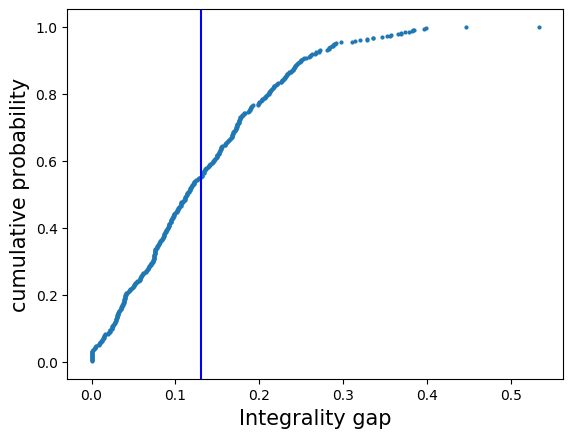

In [170]:
process(data_mn6)

<function matplotlib.pyplot.show(*args, **kw)>

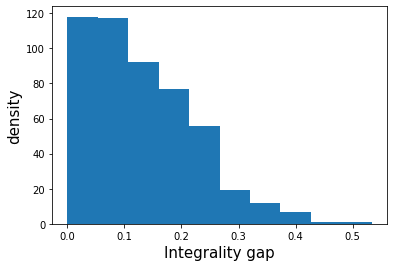

In [98]:
n, bins, patches = plt.hist(data_mn6)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

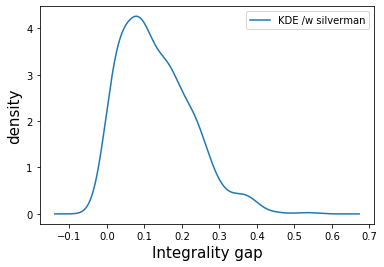

In [99]:
kernelDensity(data_mn6)

In [100]:
data_mn7 = the_loop(5, 225, 500)

[1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1.
 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1.
 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1.
 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0.
 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0.
 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1.
 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0.
 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 0. 1. 0. 1. 1. 0. 1. 1.]
Obj: 90.2716
[1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1.
 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1.
 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1.
 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0.
 1. 1. 0.

[-0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.
  1. -0.  0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.
 -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.
 -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.
  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.
  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0.  0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.
  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.
  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  0.  1.  1.
  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.
  0. -0. -0.  1.  1.  1.  1. -0. -0.]
Obj: 93.3254
[0.         1.         0.         1.         0.         0.
 0.         0.

[1.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         

[ 0.  0.  1.  1.  0.  1.  1.  0. -0.  1.  1.  1.  1.  1. -0.  0. -0.  0.
 -0.  1.  0.  1.  0.  1.  0. -0.  1.  0.  0.  1.  0.  0.  0. -0.  0.  1.
  1. -0.  0.  1.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  1.
  0.  0.  1.  1.  1.  0.  0.  0.  0.  0. -0.  0.  0.  1.  0.  0.  1.  0.
 -0.  0.  1.  0.  0. -0.  1.  0.  1. -0.  1.  0.  1.  0.  0.  0.  1.  0.
  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.
  1.  0.  0.  1.  0.  1. -0.  1.  0.  1. -0.  0. -0.  1.  1.  1.  1.  0.
 -0.  0.  1.  0.  1.  1.  1. -0.  1.  1.  1.  0.  0.  1.  0.  0.  1.  1.
  1.  0.  0.  0. -0.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  0.
  1.  0.  1. -0.  1.  0. -0.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.
  0.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  1.
  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.  0.  0.  0. -0.  1.  0.
  1. -0.  1.  0.  0. -0.  0.  1.  0.]
Obj: 79.8625
[0.         0.         1.         1.         0.         1.
 1.         0.

[ 1.  0.  1.  1.  0.  0.  1.  0.  1. -0.  1.  1.  1.  0. -0. -0. -0.  1.
  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0. -0.  0.
  1.  0.  1.  0.  0.  0.  1.  1.  1.  0. -0.  1.  0.  0. -0.  0.  1.  1.
  1.  0.  0.  1.  1.  0.  1. -0.  1.  1.  1.  1.  0. -0.  0.  1.  1.  1.
  0.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1. -0.  1.  1.  0.  1.  0.  1.
  0.  0.  1.  0.  0.  0.  1.  0.  0.  1. -0.  0.  1.  0.  0.  0.  0.  1.
  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1. -0.  0.  0.
  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0. -0.  1.  1.  0.  0.
  0.  1.  0. -0.  1.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0. -0.  0.  0.
  0.  0.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  1.  1.  1. -0.  0.
  1.  0.  0.  0.  1.  1. -0.  1.  1.  0.  0.  1.  0.  1.  1. -0.  1.  1.
  1.  1.  1.  0. -0.  1.  0.  1.  1.  0.  1.  1.  1. -0.  1.  1.  1.  1.
  1.  1.  1. -0.  1.  1.  1.  0.  1.]
Obj: 89.9052
[1.         0.         1.         1.         0.         0.
 1.         0.

 1. 1. 0. 0. 1. 0. 0. 0. 0.]
Obj: 101.409
[1.         0.         0.         0.97272957 1.         1.
 0.         0.74168471 1.         1.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.

[0.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         1.
 0.         0.44264343 1.         0.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         

 0.         1.         0.        ]
Obj: 100.179
100.17866699425356 relaxed 
100.03137319931825 original 
[ 1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  0. -0. -0.  1. -0.
 -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.
  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.
 -0.  0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.
  1. -0. -0.  1.  1.  1. -0.  1.  0.  0.  1.  1. -0.  1.  1. -0. -0. -0.
  1.  1.  1.  1.  1.  1.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.
  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.
  0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.
  1.  1.  0.  1.  1. -0.  1. -0.  1.  1.  1.  0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.
 -0.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.
  1.  1.  1.  1.  1

[-0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  1.  1.  1. -0. -0.  1. -0.  1.  0. -0. -0. -0.  1. -0.  0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.
  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  0.  0. -0. -0.  1.  1.
 -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.
  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  0. -0.
  1.  1.  1. -0. -0.  0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.
  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  0.  1. -0.
  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0. -0.  1.  1.  1.]
Obj: 85.2193
[0.         0.         1.         1.         0.         1.
 0.         1.

[ 0.  0.  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  0.  0.  1.  0. -0.
  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.
  0.  1.  0.  0.  0.  1.  0.  0. -0. -0.  1.  1.  1.  1.  1.  0.  0. -0.
  0.  0.  0.  0.  1.  1.  1.  0.  0.  1. -0.  1. -0.  0.  1.  1.  0.  1.
  0.  0.  0.  1.  0.  1.  0.  0.  0. -0.  0.  1.  1.  1.  1.  1.  1.  1.
  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.
  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1. -0.
  0.  0.  0.  0.  1.  1. -0.  0.  0.  1.  1.  0.  1.  0. -0.  0.  1. -0.
  0.  0.  1.  1.  0.  0.  0. -0.  0.  1.  0.  0.  1. -0.  1. -0.  1.  1.
  1.  1. -0.  0.  1.  0.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.
  0.  0.  0.  1.  0.  0.  1.  0.  1. -0. -0.  0.  1.  0. -0.  1.  0.  1.
  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  0.  1.
  0.  0.  0.  1.  1.  1.  1.  0.  1.]
Obj: 78.6816
[0.         0.         0.         0.         1.         1.
 0.         1.

[-0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  0.  1.
  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.
  1. -0.  1.  1.  0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.
  1. -0. -0.  1. -0.  1.  0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  0.  1. -0.  1.  0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.
 -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.
 -0.  1.  1.  0.  1.  1.  1.  1. -0.  1. -0.  0.  1.  1. -0.  1. -0. -0.
  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0.  1.  1.  1. -0.  0. -0.  1.  0. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0. -0. -0.  1.  1. -0.  1.]
Obj: 82.3275
[0.         0.         1.         1.         0.         0.
 0.         1.

[ 1.  1. -0.  1.  1.  1.  1.  0. -0. -0.  0.  1. -0.  0.  1.  0. -0.  1.
  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.
  0.  0.  1.  0.  1.  0.  0.  1. -0. -0. -0.  1.  0.  0.  1. -0.  1.  0.
  1.  0. -0. -0.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.  1.  0.
  1.  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.  1.  1.  1.  1.  0. -0.
 -0.  0. -0.  1.  1.  0.  0.  1.  1.  0.  1.  0. -0.  1.  1.  1.  1.  0.
  1.  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.  0.  1.  1.  0.
  1. -0.  0. -0.  0.  0.  1.  1. -0. -0. -0.  1.  0.  0.  0.  0.  1.  1.
  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  0.
  1. -0.  0.  0.  1.  1.  0.  0.  1.  1. -0.  0.  0.  0.  1.  0.  1.  1.
  0.  1.  1.  1.  0.  0.  1.  1.  1.  1. -0.  0.  0.  1.  1.  1.  1.  1.
  1.  0.  0. -0.  1.  0.  1. -0.  0. -0.  1.  0.  1.  0.  0.  0.  1.  1.
  1.  0.  1.  1.  1.  0.  0.  0.  0.]
Obj: 81.7417
[1.         1.         0.         1.         1.         1.
 1.         0.

[ 1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  0.  1. -0.  1.  1. -0.  1.  1.  1. -0.
  1.  1. -0.  1. -0.  0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.
 -0. -0. -0. -0. -0.  1.  1.  1. -0.  0.  1. -0. -0. -0.  1.  1. -0.  1.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.
 -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  0. -0.  1.  1. -0. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  0.
  0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.
  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.
  1.  1. -0.  1.  1.  1.  1.  1. -0.]
Obj: 93.2158
[1.         1.         0.         1.         1.         1.
 1.         0.

[1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.64694443 1.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         1.         1.         1.         1.         0.
 1.         1.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         1.         1.         0.         

[ 1.  0. -0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.  0.  0.
  0.  0.  0.  0.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  0.
  0.  0.  0.  0. -0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.
  1.  0.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.
 -0.  1. -0.  0.  1.  0.  1. -0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.
  1. -0.  0.  1.  0.  1.  1.  0. -0.  1. -0.  0.  0.  1. -0.  1.  1.  1.
  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  0.  1.  1. -0.  1.  1.
  1.  1.  1. -0.  0.  1.  0.  1.  1.  1.  1.  0.  0.  1.  0.  0.  1.  1.
  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.
  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  1.  0.  0.  0.  1. -0. -0.
  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  0.  0.  1.  0.  1.  0.  1.
  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.  0.
  1.  1.  1.  0.  0.  1.  0.  0. -0.]
Obj: 94.704
[1.         0.         0.         0.         1.         1.
 1.         1. 

 -0.  1.  0.  1. -0.  1. -0. -0. -0.]
Obj: 81.258
[0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         1.         1.
 1.   

 -0.  1. -0.  1.  1. -0. -0.  1. -0.]
Obj: 86.8281
[1.         0.36145087 1.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         0.58971718 1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.  

[-0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  0.  1. -0. -0. -0.  1.  1.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.
  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.
  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  0. -0.
 -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.
  1. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0.  0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.
  1.  1.  1.  1. -0.  1. -0.  1.  1.]
Obj: 97.481
[0.         1.         1.         1.         0.         0.
 1.         1. 

 1. 1. 1. 1. 0. 1. 1. 1. 0.]
Obj: 80.1637
[0.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.71257389 1.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.

[1.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.25744743 1.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.81695469 1.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         

[ 1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.
  0. -0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.
 -0.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  1.
  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0. -0.  1.  0.  0.
  1.  1. -0.  0.  1.  0.  1.  0.  1. -0.  0.  0.  1.  1. -0.  0.  1.  1.
  0.  0.  1.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.
  1.  0.  0.  1.  1.  0.  0.  0.  0.  1. -0. -0.  1.  1.  1.  0.  1.  1.
  0.  1.  0.  0. -0.  0.  0. -0.  1.  1.  0.  1.  1. -0. -0.  1.  1.  1.
  1.  1.  0.  1.  0. -0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.  0.  1.
  1.  0.  1.  0.  0.  0.  1.  0.  0.  1.  1.  1. -0.  1.  0.  1.  0.  0.
  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.
  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.
  0.  1.  0.  1.  0.  1. -0.  1.  1.]
Obj: 84.2022
[1.         0.         1.         1.         0.         1.
 0.         0.

[0.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.31002206 0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         

[ 1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0.  0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.
  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.
  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.
  1.  1.  1.  0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.
 -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0.  0. -0. -0. -0.  0.  1. -0. -0. -0.
  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.
 -0.  1.  1.  1. -0.  0. -0. -0.  1.  0.  1.  1.  1.  1.  1.  1. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1. -0.]
Obj: 65.8406
[1.         1.         1.         1.         0.         1.
 0.         0.

 0.         0.         1.        ]
Obj: 95.0741
95.07409258538954 relaxed 
95.03174897927481 original 
[0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1.
 0. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0.
 1. 0. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0.
 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1.
 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0.
 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0.
 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1.
 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1.
 0. 0. 0. 1. 0. 1. 1. 0. 1.]
Obj: 96.8539
[0.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.       

[ 1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.
 -0. -0.  1. -0. -0.  1. -0.  1. -0.  0. -0.  1.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  0. -0.  1.  1.  0.  0. -0. -0.  1. -0.  1.  1.  1.  1.  1.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.
 -0. -0.  1.  1.  1.  1. -0.  0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.
 -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0.  0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.
  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.
  1.  1.  1. -0. -0. -0.  1.  1. -0.]
Obj: 94.9305
[1.         1.         1.         0.         0.         0.44574131
 0.   

[ 1.  0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  0. -0.  1.
 -0.  1.  1.  0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.
  1.  1. -0. -0.  0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.
 -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  0.  1.  1.
 -0.  1.  1.  0. -0.  0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.
 -0.  0.  0. -0. -0.  0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.
  1. -0.  1.  0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  0.  1. -0.
  1. -0.  1.  1.  1.  0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.
  1. -0.  1.  1.  1.  1. -0. -0.  1.  0. -0.  1. -0. -0.  0. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  0. -0. -0.  1.  0.
 -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  0.
  1.  0.  1.  1.  1. -0.  1.  1. -0.]
Obj: 80.7521
[1.         0.         1.         1.         0.         0.
 0.         0.

[1.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         0.
 0.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         

[ 1.  0.  1.  0.  0. -0.  1. -0. -0.  1. -0.  0.  0.  1.  1.  1.  0. -0.
  0.  0.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  0.  0.  0.  1.
  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.
  0.  0.  0.  1. -0.  1.  0.  1.  1.  0.  1.  0.  1.  0. -0.  1.  0.  0.
  1.  0.  1.  0.  0.  0.  0.  0.  0.  1. -0.  1.  0.  0.  1.  1.  0.  0.
  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  0.  1.
  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.
  0.  0.  0. -0.  0.  0.  1. -0.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.
  1.  1.  1.  0.  0.  0.  1.  0.  0.  1.  0. -0.  1.  1.  0.  0.  1.  1.
  0.  1.  1.  0.  0.  0.  0.  1.  0.  1.  1.  1.  0.  1.  1. -0.  1.  1.
  0.  0.  1.  1.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  0.
  1.  0.  0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.
  0. -0. -0. -0.  1.  1.  1.  1.  1.]
Obj: 78.9997
[1.         0.         1.         0.         0.         0.
 1.         0.

[ 1.  1.  0.  0.  0.  1.  1.  1.  0.  0.  1.  1. -0.  0.  1.  0.  0.  0.
  0.  1.  1.  1.  0.  0.  0.  1. -0.  0.  0. -0.  1.  1.  0.  0.  0.  1.
  1.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  0.  1.
  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  0.
 -0.  0.  1.  0.  0.  1.  1. -0.  1.  1.  0.  1.  1.  1.  1.  1.  0. -0.
  0.  1.  0.  0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.
  0.  0.  1.  0.  1.  1.  0.  0.  0. -0.  0.  0.  0.  1.  0.  1. -0. -0.
  0.  1. -0.  1.  0. -0.  1.  1.  0. -0.  1.  1.  0.  1.  1.  1.  1.  1.
  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  1.
  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.
  1.  0.  0.  0.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  1.  1.  0.
  0.  0.  0.  0.  0.  0.  1. -0.  1.  1.  0.  0.  0.  1. -0.  1.  0.  1.
  0.  1.  0.  1.  1.  0.  1.  1.  1.]
Obj: 88.9415
[1.         1.         0.         0.         0.         1.
 1.         1.

[-0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.
  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.
  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.
 -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  0.  1. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.
 -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  0.  1.  0. -0. -0. -0. -0.
  1.  1.  1. -0.  1.  1.  0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  0.  1.
  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  0. -0.  1.
  1.  1.  1.  1. -0. -0.  1.  1. -0.]
Obj: 73.3924
[0.         0.         1.         0.         1.         0.05984951
 1.   

 1. 1. 0. 0. 0. 0. 0. 0. 1.]
Obj: 94.9991
[0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         1.         0.75783427 0.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.         0.95676054 1.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.

[ 1.  0.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.
  0. -0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1. -0.  1.  1.  0.  0.  1.
  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  0.  0.
  0.  1.  1.  0.  0.  0.  1. -0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  1.
 -0.  0.  0.  0.  0. -0.  1.  0.  1.  0.  1.  1. -0.  1. -0.  1.  1.  0.
  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  1.  0.  0.  1.
  0.  1.  0.  0. -0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.
  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.
  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  0.  1.  0. -0.
  0.  0.  0. -0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.
 -0.  0.  0.  0.  1.  1.  1.  1.  1.  1. -0.  1.  0.  1.  1.  1. -0.  1.
  1.  1.  0.  0. -0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0. -0.  1.  1.
  1.  1.  0. -0.  1.  0. -0.  0.  1.]
Obj: 95.6997
[1.         0.         1.         0.         0.         0.
 1.         0.

[ 1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  0. -0.  1.  1.
  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.
 -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  0. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.
  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.
  1. -0. -0.  1.  1. -0.  1.  0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.
 -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  0. -0.
 -0.  0.  0.  1.  0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.
  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.
 -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.
  1. -0. -0.  1.  1.  1. -0.  1.  1.]
Obj: 77.2727
[1.         1.         0.         1.         1.         0.
 0.         0.

[0.         0.78197607 0.         1.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         0.         0.         0.         

 1.         0.         1.        ]
Obj: 103.812
103.81161823342774 relaxed 
103.64487271560202 original 
[1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0.
 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0.
 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1.
 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1.
 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 1.
 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1.
 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1.
 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 1.
 0. 1. 1. 1. 1. 0. 1. 1. 0.]
Obj: 84.9701
[1.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 0.         1.     

[1.         0.         1.         1.         1.         0.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         0.62057759
 1.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         0.66919574 1.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.         1.         0. 

  0.  0.  1.  0.  1.  0.  0.  1.  1.]
Obj: 77.9483
[1.         0.         1.         1.         0.         0.7073016
 0.         0.         1.         1.         0.         0.98459154
 1.         1.         1.         0.         0.         0.
 1.         0.         0.         0.39209358 1.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 1.         1.         1.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         0.  

[0.19286947 0.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.56529912 0.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         

[1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         1.         0.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         1.         

[ 0.  0.  0.  1. -0.  1. -0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  1.
 -0.  0.  0.  0. -0.  0.  1.  0.  1.  0.  0.  1.  1. -0.  0.  0. -0.  1.
 -0.  0.  1.  1.  0.  1.  1.  1. -0.  1.  0.  1.  1. -0.  1. -0.  0.  1.
 -0.  1. -0.  1.  0.  0.  0.  0.  0.  1.  0.  1. -0.  1.  1.  1.  1.  1.
  1. -0. -0.  0.  0.  1.  1.  1.  0.  1.  1.  1. -0.  1.  1.  1.  1.  0.
  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  0. -0. -0.  0.  1. -0.
  1.  1.  0.  0.  1.  1.  0.  1.  0.  0. -0.  1.  1.  1. -0.  1.  0.  1.
  1.  0. -0.  1.  0. -0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.
  1.  1.  0. -0.  1.  1.  1.  0.  1. -0. -0.  0.  1.  0.  0.  0.  0.  0.
  1.  0.  1.  1.  1.  1.  1.  1.  0. -0.  0.  0.  1.  1.  0.  0.  1.  1.
  1.  1. -0.  0.  0.  0.  1.  1.  0.  1.  1.  1. -0.  1.  0.  1.  1.  0.
  1. -0. -0.  0.  0.  1.  0.  0. -0.  0.  1.  1. -0.  0.  0.  0.  1. -0.
  1.  0.  0.  0.  1. -0.  1.  0.  0.]
Obj: 88.2111
[0.         0.         0.         1.         0.         1.
 0.         0.

[ 1. -0.  0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.
  1.  1.  0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.
  1.  1.  1.  1.  1. -0.  0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.
  1. -0. -0. -0. -0. -0. -0.  0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.
 -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.
  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.
 -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  0.
 -0.  1.  1.  1.  1. -0. -0. -0. -0.]
Obj: 82.6181
[1.         0.         0.         1.         1.         0.
 1.         1.

[-0.  0.  1.  0.  1.  0.  0.  0.  1. -0.  1.  0.  1.  0.  0.  1.  1.  0.
  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1. -0.  1. -0.
  1.  1.  1.  0.  1.  0.  1.  0.  0. -0.  0.  0.  0.  1.  1.  1.  1.  0.
  0.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1. -0.  1.  1.  0.  1.  0.  1.
 -0.  0.  1. -0.  0.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.
  0.  0.  1.  1.  0.  1.  0.  0.  1.  1.  0.  0. -0.  0.  0.  0.  1.  1.
  0.  0. -0.  0.  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.
  1. -0.  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  1. -0.  0.  1.  1.
  0.  1.  1.  1. -0.  0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.
 -0.  1.  1.  0.  0.  1.  0.  0. -0.  0. -0.  1.  1.  1.  1.  1.  1. -0.
  1.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  0.
  1.  1.  0.  0.  1. -0.  0.  0. -0.  1.  0.  1.  1.  0.  0.  1. -0. -0.
  0. -0.  0.  0.  1.  0.  1.  1.  1.]
Obj: 87.8399
[0.         0.         1.         0.         1.         0.
 0.         0.

  0. -0.  1.  1.  1. -0.  1.  1. -0.]
Obj: 102.745
[0.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         0.39849861 0.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.  

[ 1.  0.  1.  1.  0. -0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  1.  0.  1.
 -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.  0.  1.  1.  0. -0.  0.  0.  1.
  1.  1. -0.  0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  1.
  1.  0.  0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.
  0.  0.  1. -0.  0.  1.  0. -0.  1.  1.  1.  0.  1.  1.  0. -0.  0.  1.
  1.  1.  1.  1.  1.  0. -0.  0. -0.  0.  0.  1.  1.  0.  1.  0.  0.  0.
 -0.  0.  0.  1. -0. -0.  0.  1.  0.  1.  0.  1.  1.  1. -0.  0.  0. -0.
  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0. -0.
  0.  0.  1. -0.  1.  0. -0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.
  0.  1.  1.  1.  1.  0.  1.  0. -0.  1. -0.  0.  0.  0.  1.  1.  1. -0.
  0.  0. -0.  1.  0.  0.  0.  1.  1.  1.  0.  1. -0.  1.  0.  0.  1.  1.
  0.  0.  1.  0.  1.  1.  1.  0.  1.  0.  0.  1. -0.  0.  1.  1.  1.  0.
  1.  0.  1.  1.  1.  1.  0.  1.  1.]
Obj: 102.397
[1.         0.         0.         1.         0.         0.
 0.         0.

[ 1.  1. -0.  0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  0.  1.
 -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  0. -0.  1.  1.
  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.
 -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.
 -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  0. -0.  1.  1. -0. -0.
  1.  1.  0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  0.  0. -0. -0.  1.
 -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  0. -0.  1. -0.  1.
  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.
  1.  1. -0.  1. -0. -0. -0.  1.  1.]
Obj: 88.9514
[1.         1.         0.         0.         1.         0.
 1.         1.

[ 1. -0.  0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  0.  1. -0.  1.
  1. -0. -0.  1.  1.  1.  1. -0. -0.  0. -0.  1. -0. -0.  0. -0.  1. -0.
  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.
  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.
  1.  0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  0.  1.
 -0.  1. -0. -0.  0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.
  0.  1.  0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  0. -0.
 -0.  1. -0. -0.  0. -0. -0.  1. -0.  1.  1.  1. -0.  0.  0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  0.
  1.  1.  0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  0.
  1.  1. -0. -0.  1.  1.  1.  0. -0.]
Obj: 80.005
[1.         0.         0.         0.         0.         0.
 1.         1. 

[ 1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  1. -0.
  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.
  0.  0.  1.  1.  0. -0.  1.  1.  1.  1.  0.  0.  0.  1. -0.  1.  0.  0.
  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.  0.
  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.
  0.  1.  1. -0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.
  0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  0. -0.  1.  1.  1.  0. -0.  0.
  0.  1.  0.  1. -0.  1.  0.  1.  1.  1. -0.  0.  1.  1.  1.  1.  1.  1.
  1.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.  1. -0.  0.
  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.  1.
  1. -0.  1.  0.  0. -0.  1.  1.  0.  1.  0. -0.  0.  0.  0.  1.  1.  1.
  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.
  0.  0.  1.  1.  1.  0.  1.  1.  1.]
Obj: 103.499
[1.         0.         1.         0.         0.         1.
 1.         1.

  1.  0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 94.747
[1.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.   

[-0. -0.  0. -0. -0.  1.  0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  0. -0.
 -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.
  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.
  1. -0.  1. -0.  1.  0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.
  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  0. -0.  0.  1. -0.
  1. -0.  0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0. -0.  1.  1. -0. -0. -0.  0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.
  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.
  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  0.  1. -0.  1.
 -0. -0.  1. -0. -0.  1. -0. -0. -0.]
Obj: 68.7506
[0.         0.         1.         0.         0.         1.
 0.         1.

 -0. -0.  1.  1.  1.  1.  1. -0.  1.]
Obj: 92.4695
[0.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.  

  1.  1.  1.  0.  1. -0.  1. -0. -0.]
Obj: 89.2317
[1.         1.         0.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.97101494 1.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 1.  

[0.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         1.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.49903826 0.         0.         0.         1.
 0.         1.         1.         1.         0.         

 1.         0.         0.        ]
Obj: 93.596
93.59604830259717 relaxed 
93.54576896913878 original 
[-0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  0.  1.  1. -0. -0. -0.
  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  0.  1. -0.
 -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  0.  1. -0.  1. -0. -0.  1.  1.
  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
  1.  1.  1.  1.  1. -0. -0. -0. -0.  0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.
  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  0. -0.  1.  1.
  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  0. -0.  1.
  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.
  1. -0.  1. -0.  1.  

[ 1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.
  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  0.  1. -0. -0.  1.  1.
 -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  0.
  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.
 -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.
 -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.
 -0.  1.  1.  1. -0. -0. -0. -0.  0.  1.  0. -0. -0. -0.  1. -0.  1. -0.
  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  0.  1.  1.  1. -0. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  0.  1. -0. -0.  1.
  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.
 -0.  0.  1. -0. -0.  1. -0.  0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1.]
Obj: 85.8687
[1.         1.         1.         0.         0.         1.
 1.         0.

[ 1.  0.  1.  1.  0.  1. -0.  0.  0.  0.  1.  1.  0.  0.  1. -0.  1.  0.
  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  0.  1.  0.  0.  0.  0.
  1.  1.  0.  0.  0.  0.  1.  0.  0.  1. -0.  0.  0.  1.  1.  0.  0.  0.
  0.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.
  0.  1.  1.  1.  1.  1.  0. -0.  0. -0.  0.  0.  1.  0.  0.  0.  1.  1.
  0.  0.  1.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  0. -0.  1.  1.
  1.  1.  1.  0. -0.  1.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  0.  1.
  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1. -0.  0.  1. -0.
  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  1. -0.  1. -0.  1.  1.
  1. -0.  0.  0.  1.  0.  1.  0.  0.  0.  0.  0.  1.  1. -0.  0.  1.  0.
  1. -0.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.
  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.
  1.  1.  0.  1.  1.  1.  1.  0.  0.]
Obj: 89.5618
[1.         0.         1.         1.         0.         1.
 0.         0.

[-0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.
  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.
 -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.
  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.
 -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  0. -0.  1.
  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1.  0. -0.  1.  0.  1.  0.  1.  1. -0. -0. -0.
  1. -0. -0.  1.  0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.
 -0.  1. -0. -0.  1. -0. -0. -0. -0.]
Obj: 74.9306
[0.         0.         1.         0.         1.         1.
 0.         0.

 -0.  1. -0. -0.  1.  1.  1.  1. -0.]
Obj: 105.271
[0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         0.         1.
 0.  

  1.  1.  1.  1.  1.  1. -0. -0.  0.]
Obj: 74.0049
[0.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.  

[ 0.  1.  0.  1.  1.  1.  0.  1.  0.  1. -0.  1.  1.  1.  1.  1.  0.  1.
  0.  0.  0.  1. -0.  0.  1.  0.  1.  1.  0.  0.  1.  0. -0.  0. -0. -0.
  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  1.  0. -0. -0. -0.  1.  1.  1.
  0.  1. -0.  1.  1.  1.  0.  1.  1.  1. -0.  0.  1.  0.  1.  0.  0.  1.
  1.  0.  0.  0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  0.  0.  0.  1.  0.
  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.
  1.  1.  1.  1.  0. -0.  1. -0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.
  1.  1. -0.  0.  0.  1.  1.  1.  1.  1. -0.  0.  1.  1.  1.  1. -0.  1.
  1. -0.  0.  1.  0.  0.  1.  1. -0.  1. -0.  0.  1.  0.  1.  1.  1. -0.
  0.  1. -0.  1. -0.  1.  1.  1.  0.  1.  1.  0.  1.  0. -0.  0.  0.  1.
  1.  1.  0.  0.  0.  1. -0.  1.  1.  1.  1. -0.  0.  0. -0.  1. -0.  0.
  1.  1.  1.  0. -0.  1.  1.  0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.
  0.  1.  1.  0.  0.  0. -0.  1.  1.]
Obj: 92.8256
[0.         1.         0.         1.         1.         1.
 0.         0.

[0.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         

[ 1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.
 -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.
 -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.
  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.
  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1.  1.
 -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
 -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0.  0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.
  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  0.  1.  0.  1.
 -0.  1.  0. -0.  1. -0. -0. -0. -0.]
Obj: 89.7666
[1.         1.         0.         0.         0.         0.
 0.         0.

[1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0.
 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0.
 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1.
 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1.
 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0.
 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 1. 1. 1.
 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1.
 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 0.
 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0.
 0. 0. 1. 0. 0. 0. 1. 1. 1.]
Obj: 76.8819
[1.         0.         0.         0.         0.57957174 0.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.   

[ 0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  0.  0.  0.  0. -0.
  1.  1.  1.  0.  0.  0.  1.  0.  0. -0. -0.  0.  1. -0.  1.  0.  1.  0.
  1.  0.  1.  1.  0.  0.  1.  1.  1. -0. -0.  0.  1.  0.  0.  1.  0.  1.
 -0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0.  1.
  1.  1.  1.  0.  0.  1. -0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.
  1.  0. -0.  0.  0.  1.  1.  0. -0.  0. -0.  1.  1.  0.  1.  1.  0.  1.
  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.
  1.  0. -0.  0.  1.  1.  0. -0.  0. -0.  0.  1.  1.  0.  0.  1.  0. -0.
  1.  0.  0.  1.  1.  1.  1. -0.  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.
  1.  0.  1.  1. -0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.  1.  0.
  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.
  1.  0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  1.  1.  0.  1.  1.  0.  1.
  0.  0.  1.  0.  0.  1.  1.  1. -0.]
Obj: 75.1421
[0.         0.         0.         1.         0.         1.
 1.         0.

[-0.  1.  0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.
  0.  1. -0. -0. -0.  1.  1. -0.  0.  1.  1. -0. -0. -0.  0.  1. -0.  0.
 -0.  1. -0. -0.  1.  0.  1.  1.  1.  1.  0. -0.  1.  0.  1.  1.  1.  1.
  1.  0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.
  1. -0.  1.  0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  0.
 -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  0. -0.
 -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  0. -0.  1.  1. -0.  1.  1.
  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  0. -0.
  1.  1. -0. -0.  1.  1.  0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0.  1. -0.  1.]
Obj: 91.6293
[0.         1.         0.         1.         0.         1.
 0.         1.

[0.37634539 1.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.88249307 0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         1.         1.         1.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         

[1.         0.         1.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.55538359 1.         1.         

[ 0.  1.  0.  0.  0. -0.  1.  0.  1.  1. -0. -0.  0.  1.  1.  1.  1.  1.
  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.
  0.  0.  0.  0.  1.  0.  0.  1.  0.  0.  1.  1.  1.  1.  0.  0.  1.  0.
 -0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  1. -0. -0.
 -0.  0.  0.  0.  0.  0.  1.  1.  0. -0.  0.  0.  0.  1.  1.  1.  0.  1.
  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.  0. -0.  0.
 -0.  0.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1. -0.  0.  0. -0.  1.
  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.
  0.  1.  1.  0.  1.  1.  1. -0.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.
  0.  0.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.  0.  1.  0.  0.  0.
  0.  1.  0.  0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  0. -0.
  1.  1.  0.  1.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.
  0.  1.  1.  1.  0. -0.  0.  1.  0.]
Obj: 90.2218
[0.         1.         0.         0.         0.         0.
 1.         0.

[ 0.  0.  1.  0.  0. -0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.
  1.  0. -0.  1.  0. -0.  0.  1. -0.  0.  1. -0.  1. -0. -0.  0.  0.  1.
  1.  1.  0.  1.  0.  1.  1. -0.  1.  0.  1.  1.  1. -0.  1.  0.  1.  1.
  0. -0.  0. -0.  0.  0.  0.  1.  1.  1.  1.  0.  0.  1.  0.  0.  1.  0.
  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  0. -0.  0.
  0.  1.  1. -0.  1.  0.  1.  1.  1. -0.  1.  0.  0. -0.  1.  1.  0.  0.
  0.  1.  0.  0.  1.  0.  0. -0. -0.  0.  1. -0.  0.  1.  0.  0.  1.  0.
  0.  1. -0. -0.  1. -0.  1.  0.  0.  1.  0.  1.  1.  0. -0.  0.  1. -0.
  0. -0.  1.  1.  0. -0.  0.  1.  0. -0.  1.  0.  1.  1. -0.  1.  1.  1.
  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.
  1.  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0.
 -0.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0. -0. -0.  0.
  1.  0.  0. -0.  1.  1.  0.  0.  1.]
Obj: 87.1004
[0.         0.         1.         0.         1.         0.
 0.         1.

[0.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         0.3129469  1.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         0.         

[ 1.  0. -0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  0. -0.
  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  0. -0.  1.  0.  1.  1.  1.
  1.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  1.
  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.
  1.  0.  1.  1.  1.  1. -0.  1.  0.  1.  1. -0.  0.  1.  1.  0.  1.  0.
  1. -0.  0.  1.  0.  1.  1.  0.  1. -0.  0.  0.  1.  1.  1.  1.  1.  0.
  0.  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.
  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1. -0.  0.  0. -0.  1.  1. -0.
  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0. -0.  0. -0.  1.  0.  1.
  1. -0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0. -0.  0.  1.  0.
  0.  1. -0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.
  0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  0. -0.  1.  0.  0.  1.  1. -0.
  1. -0.  1.  1.  0.  0. -0.  1.  1.]
Obj: 97.7234
[1.         0.         0.         1.         1.         1.
 1.         0.

[1.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.04700949
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         0.         0.50122378 0.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0. 

[-0.  0.  1. -0.  1.  0.  1.  1.  0. -0. -0.  0.  0.  0.  0.  0. -0.  0.
  1.  1.  1.  0.  0.  0. -0.  1.  0.  0.  0.  1.  0.  0.  1.  0.  0.  0.
  1.  1.  1.  1.  0.  1. -0.  1. -0.  1.  0.  1.  0.  1. -0.  0.  0.  1.
  0.  1.  0.  1.  0.  1.  0. -0.  0.  1.  1. -0.  1.  1.  1.  0. -0.  0.
 -0.  1.  1. -0.  0.  1.  1. -0.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.
  1.  0.  1.  1.  1.  1.  1.  0.  0. -0.  0.  0.  0.  0. -0.  0.  0.  0.
  0.  1.  0.  0.  1.  1.  0. -0.  0.  0. -0.  0. -0.  1.  1.  0. -0.  0.
  0.  0.  1.  1.  1.  1.  1.  1.  0. -0.  1.  0.  0. -0.  0.  1.  1. -0.
  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.
  1.  1.  1.  1.  1. -0. -0.  1.  0.  1. -0.  1.  1.  0.  0.  1.  0.  0.
  1.  0.  0.  1.  0.  1. -0. -0.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.
  0. -0.  0. -0. -0.  0.  1. -0. -0.  0.  0.  1.  1. -0.  1. -0. -0.  0.
  1.  1. -0.  1.  1.  0.  0.  1. -0.]
Obj: 78.9955
[0.         0.         1.         0.         1.         0.
 1.         1.

[-0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  0.  1.  1. -0. -0.  1. -0.  1.  1. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  0.
  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.
 -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.
  0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  0.  1. -0.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.]
Obj: 81.8647
[0.         1.         0.         0.         1.         1.
 0.         0.

[-0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  0. -0. -0.
 -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.
  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  0. -0. -0.  0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.
  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0. -0.  0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.
 -0.  0. -0.  0. -0. -0.  1. -0.  0.  1. -0.  1.  1. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.
 -0.  1. -0. -0.  1. -0. -0.  1.  1.  0.  1.  1. -0.  1. -0.  0. -0.  1.
 -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.
  1.  0.  1.  1. -0. -0. -0. -0. -0.]
Obj: 78.4653
[0.         1.         0.         0.         1.         0.
 0.         1.

[ 1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.
 -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.
 -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  0.  1.  1.  1. -0. -0.  1.
 -0. -0.  1.  0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  0.  1. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.
  0.  0. -0.  0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.
 -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  0.  1. -0.
  1.  1.  1.  0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.
  1. -0.  1. -0.  0. -0.  1. -0. -0. -0. -0.  1.  1.  0.  1. -0.  1.  1.
 -0. -0.  1.  1. -0.  1.  1. -0.  1.]
Obj: 82.1612
[1.         0.         1.         0.         0.03133737 1.
 0.         1.

[0.         0.         0.         1.         1.         0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.28685784 0.         0.         1.
 1.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         0.508492
 0.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         0.   

111.31046989582255 relaxed 
111.24980550614572 original 
[1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1.
 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1.
 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 1.
 0. 0. 1. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1.
 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0.
 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0.
 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1.
 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1.
 0. 1. 0. 0. 0. 0. 0. 0. 1.]
Obj: 83.3558
[1.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.     

 -0. -0. -0.  1.  1.  1. -0. -0. -0.]
Obj: 71.6309
[1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         1.         1.
 1.         0.08562213 1.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         1.         1.
 1.         0.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         0.19836744 1.         1.
 0.  

[1.         0.         1.         1.         1.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         

[ 0.  0.  1. -0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.
  0.  0.  1.  1. -0.  1.  1.  1.  0.  1. -0.  0.  0.  0.  0. -0.  0.  0.
  1.  1.  0. -0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.
  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1. -0.  0.  1.  1.  1.  0.  1.
  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  0.
  1.  1.  1. -0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.
  1.  1.  0.  0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.
  1.  1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  0. -0.  1.
  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1. -0.  0.  1.  0.
  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0. -0.
  1.  1. -0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  0.  1. -0.
  0. -0.  0.  1.  1.  1.  1.  0.  1.  1. -0.  0.  0.  0.  0.  1.  1.  0.
  1.  1.  0.  1.  0.  0.  0.  0.  0.]
Obj: 103.597
[0.         0.         1.         0.         1.         1.
 0.         1.

[ 1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.
  1.  1.  1.  0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.
  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.
  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.
  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.
 -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.
  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.
  1.  1. -0.  1.  1.  1.  0.  1. -0.  0. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  0. -0.
 -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1.
 -0. -0.  1. -0. -0. -0.  1.  1. -0.]
Obj: 103.48
[1.         1.         1.         1.         1.         0.
 0.         1. 

[-0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  0. -0. -0. -0. -0. -0.  1.
  1.  1.  0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  0.  0. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  0.  1.  1. -0. -0.  1. -0. -0. -0.  0.  1. -0. -0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.
  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  0.  1.  1.  1.  1. -0. -0.
 -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0.
  1.  1.  0. -0.  1. -0.  0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.
  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0.
  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  0.  1.  1.  1.  1.
  1. -0.  1.  1. -0.  1. -0. -0.  0.  1.  1.  1.  1.  1. -0.  1.  1.  1.
  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.
  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.
  1.  1.  1.  1.  1.  1.  1.  1.  1.]
Obj: 90.6773
[0.         0.         0.         1.         0.         0.
 1.         1.

[ 1.  0.  1.  0.  0. -0.  0. -0.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.
  1.  0.  1.  1.  0.  1.  1.  0.  1.  0. -0.  0.  0.  0.  0.  0.  0.  0.
  1.  0.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.
  1.  1. -0.  0.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.
 -0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.
 -0.  0.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.
  0.  1.  1.  0.  1.  1.  0.  0.  0. -0.  1. -0.  1.  1.  1.  0. -0.  1.
  0.  0.  0.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  0.  1.
  0.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  0.  1.
  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0. -0.  1.  0.  1.  1.  1.  1.
  0.  0.  1.  1.  0. -0.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.
  1.  0.  1.  1.  0.  0.  0.  1.  0. -0.  0.  0.  1.  1.  1.  1.  0. -0.
  1.  0.  1.  0.  1.  1.  0.  1.  0.]
Obj: 75.4682
[1.         0.         1.         0.         0.         0.13037239
 0.   

[ 1.  1. -0.  0.  0.  1.  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1.
  0.  1.  0.  1.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  0. -0.  1.  0.
  1.  0. -0.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.  0. -0.  0. -0.  0.
  1.  0.  0.  1.  1.  1. -0.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1.  1.
  0.  1.  0.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  0.  1.  0.  1.
  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.
  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  0. -0.  0.
  1.  0.  0.  0. -0.  0.  0.  0.  0.  1.  1.  0. -0.  0. -0.  1.  1.  1.
  1.  1.  1.  1.  1.  0.  0.  1. -0.  1.  0.  1.  1.  1.  1.  0.  0.  1.
  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1. -0. -0.  1.
  1. -0. -0.  0.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.  0.  0.
  0.  1.  0.  0. -0.  1.  1. -0.  0.  1.  1.  1.  0.  0.  1.  1. -0.  0.
  0.  0.  0.  1.  0.  1. -0.  0.  1.]
Obj: 85.7588
[1.         1.         0.         0.         0.         1.
 0.         0.

[-0.  1.  1.  0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  0. -0.  1.
 -0.  1. -0.  1.  1.  1.  1.  1.  0.  0.  1.  1. -0. -0.  1. -0.  1.  1.
  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  0.  1.
  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.
  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
  0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.
 -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.
 -0.  1.  0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  0. -0.
  0.  1. -0.  1. -0.  1. -0.  0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.
  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.
 -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  0. -0.  1. -0.  1.
 -0. -0. -0. -0.  0.  1.  1.  1.  1.]
Obj: 86.2843
[0.         1.         1.         0.         1.         0.
 1.         1.

 1. 1. 1. 1. 1. 0. 1. 1. 1.]
Obj: 99.727
[1.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         0.         0.         0.61678914 1.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.37444235 1.         0.
 1.         0.91608825 1.         0.         0.         1.
 1.         0. 

[ 1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.
  1.  1. -0.  1.  0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  0. -0.  1.  0.  1.  1.
 -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.
  1.  1.  1. -0. -0.  0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  0.
 -0.  0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  0.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1.
  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.
  1.  1. -0.  1. -0.  0. -0. -0.  1.]
Obj: 84.1439
[1.         1.         1.         1.         0.         0.
 0.         1.

[ 1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.
  1.  1.  1.  0.  1.  0.  1. -0.  0.  1. -0.  1.  1.  0.  1.  1.  1.  1.
  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1. -0.  1.  0.  0.  1.
  0.  0.  0.  1.  1.  0.  1.  1.  0. -0.  1.  1.  0.  1.  1.  0.  1.  0.
  1.  1.  0.  0.  1.  0.  0.  1.  0.  0.  1.  1.  0. -0.  0.  1.  1.  1.
  1.  0.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.
  0.  0. -0.  0.  0.  1.  1. -0. -0.  0.  1. -0.  1.  0.  0. -0.  0.  1.
  1.  1.  1.  0.  1.  1.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.  1.  1.
  1.  0.  1.  0. -0.  0.  1.  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.
  0. -0.  1.  0.  0.  1.  0.  1.  1.  0.  0. -0.  1. -0.  0.  1.  0.  1.
  1.  0.  1.  0. -0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  0.  1.  1.
  0.  0.  0.  1. -0. -0.  1.  1.  0.  1.  1.  1.  1.  0.  1. -0.  0.  0.
  1.  1. -0.  0.  0.  1.  0.  1.  1.]
Obj: 86.4079
[1.         0.         0.         0.         0.         1.
 1.         1.

[1.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         0.84976852 0.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         1.         1.         

 -0. -0. -0.  1.  1.  1.  1. -0.  1.]
Obj: 82.1607
[0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.64104503 1.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.  

[-0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.
  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.
 -0.  1.  0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.
  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.
  1. -0.  1.  1. -0.  1. -0. -0.  1.  0. -0.  1. -0.  1.  1. -0.  1. -0.
  1. -0. -0.  1. -0. -0. -0.  1.  0. -0.  1. -0.  1. -0.  1.  1. -0.  1.
  1. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0.  0.]
Obj: 83.1365
[0.         1.         1.         0.         0.         1.
 0.         0.

[1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1.
 1. 1. 1. 1. 1. 0. 1. 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1.
 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.
 0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1.
 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1.
 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0.
 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 1. 1. 0.
 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1.
 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0.
 1. 0. 1. 1. 1. 0. 1. 0. 1.]
Obj: 106.08
[1.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.    

[-0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.
  0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.
  1.  1. -0. -0.  0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.
 -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.
  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.
  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.
  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.
 -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.
  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0. -0. -0.  1.  1. -0.]
Obj: 98.6885
[0.         0.         0.         0.         0.         1.
 0.         0.

[1.         1.         0.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.14856065 0.
 0.         1.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.93382405 1.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         

[1.         0.         0.         0.         0.94832355 1.
 0.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         

[1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1.
 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1.
 0. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 0.
 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 0.
 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0.
 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 0.
 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0.
 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0.
 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0.
 1. 0. 0. 1. 1. 0. 1. 1. 1.]
Obj: 82.3436
[1.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.40978821 0.         1.         0.
 0.402

[-0. -0.  0.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.
  0.  0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  0.
  0.  1.  1.  0.  0.  0.  0.  1. -0.  0.  1.  1.  1.  0.  0.  1.  1.  1.
  0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1.
  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.
  0.  1.  0.  0.  1. -0.  1.  0.  1.  0. -0.  0.  1.  0.  0.  0.  1.  1.
  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  1.  0.  1.  0.  0.  0.  1.
  0.  0.  1.  1. -0.  1.  1.  1.  1.  0.  1.  0. -0.  1. -0.  0.  0.  0.
  1.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  0.
  1.  1.  1.  0. -0.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.
  0.  1.  0.  1.  1.  0.  1.  1.  0.  0. -0.  0.  0.  0.  1.  1.  0.  1.
  1. -0.  0.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  0.
  1.  1.  1.  0.  0.  0.  1.  1.  1.]
Obj: 73.6101
[0.         0.         0.         1.         1.         0.
 0.17061751 0.

[ 1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  0.  1. -0.  1.  1.
 -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  0.  1. -0. -0.
  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.
 -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  0. -0. -0.  1. -0. -0. -0.  1.
  1. -0.  1.  1. -0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1. -0. -0. -0.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.
 -0.  0. -0. -0. -0. -0.  1.  1.  0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.
  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.
  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.
 -0. -0.  1.  1.  1. -0.  1. -0.  1.]
Obj: 89.9196
[0.47906299 0.         0.         0.         1.         0.
 0.         1.

[-0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  0. -0.  1. -0. -0.  1. -0.  1.
 -0. -0. -0. -0.  0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.
 -0.  1.  1.  1.  1. -0. -0.  0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.
  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  0.  1.  1.  1. -0.
  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.
 -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.
 -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.
 -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.
  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  0.  1.
 -0.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.
 -0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.
 -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.
 -0. -0.  1.  1.  1.  1.  1. -0.  1.]
Obj: 95.1135
[0.         1.         1.         1.         1.         0.
 0.         1.

[-0.  0.  1.  0.  0.  0.  1.  1.  0.  1. -0.  1.  1.  0. -0. -0.  0.  1.
  1.  1.  0. -0. -0.  0.  1.  1.  1. -0.  1.  0.  1.  1.  1. -0.  0. -0.
  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  0. -0.  0.  1.  0.  1.
  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.
 -0.  1. -0.  1.  1.  1.  1.  0.  1.  1. -0.  0.  0.  1.  0.  0.  0.  1.
  0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1. -0.  0.  0.  1.
 -0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  0. -0.  1.  1.  0.  0.  1.  1.
  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.
  1.  0.  1.  1.  1.  1.  1.  1.  1. -0.  0.  0.  1.  1.  0.  0.  1. -0.
  1.  1.  1.  1. -0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.
  0. -0.  1.  1.  0.  0.  0.  1.  0.  0.  0. -0.  0.  0.  0. -0.  0.  1.
 -0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.
  0.  1.  1.  1.  0.  1.  1.  1.  1.]
Obj: 80.8853
[0.         0.         1.         0.         0.         0.
 1.         1.

[ 1. -0. -0.  0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.
  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.
 -0. -0.  1.  1.  0.  1. -0. -0. -0.  1. -0.  1.  0.  1.  1.  1. -0.  1.
 -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.
  1.  0. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  0.  1. -0. -0.  1.  1.
 -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.
  1. -0.  1.  1. -0. -0.  0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  0.
  1.  0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.
  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0.  1.  1. -0.  1. -0. -0. -0. -0.]
Obj: 86.3134
[1.         0.         0.         0.         1.         0.
 1.         0.

[ 0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.
  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.
  1.  1. -0.  0.  0.  0.  0.  1.  0.  1. -0.  1.  1.  0.  1. -0.  0.  1.
 -0.  0.  0. -0.  1.  0. -0.  1.  0.  1. -0.  1.  1.  0.  1.  1.  1.  0.
  0. -0.  0.  0. -0.  1.  0.  1.  1.  1. -0.  1.  1.  0.  1.  1.  0.  0.
  1.  0.  0.  0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.  0. -0.
  1.  0.  0.  0.  1.  0.  0.  1.  1.  1. -0. -0. -0.  0.  0.  1.  0.  1.
  1.  1.  1.  0. -0.  1.  1.  0.  1.  1.  1.  1. -0.  0.  0.  1.  0.  0.
  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0. -0.  1.  0.  1.  1. -0.  0.
  0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0. -0.  1.  1.
  0.  1.  0. -0.  1.  0.  1.  1. -0.  0.  0.  1.  1.  0.  1. -0.  0.  1.
  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.  1.  1.  1.  0.
  1.  1.  1.  1.  0. -0. -0.  1.  1.]
Obj: 91.0057
[0.         0.         1.         1.         1.         1.
 0.         1.

[0.         0.         0.         1.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.93421797 0.         0.         0.         0.         0.
 1.         0.         0.         1.         0.10801031 1.
 0.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         

[-0. -0.  0. -0. -0.  1.  0.  1.  1.  0.  1.  0. -0.  1.  1.  0. -0. -0.
  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  0. -0.  0.
 -0.  1. -0. -0. -0. -0. -0. -0.  0.  0. -0. -0.  1. -0.  1.  1.  1. -0.
 -0.  0.  1.  1.  0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.
  1.  1. -0.  1. -0.  1. -0. -0.  1.  0.  1.  1.  0.  1.  1. -0.  0.  1.
 -0.  1.  1.  0.  0.  1.  1.  1. -0. -0.  0.  0.  1.  1.  1.  0.  1. -0.
  1.  0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.
  0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  0.  1. -0. -0. -0.
 -0.  0.  0. -0. -0. -0.  1. -0.  1. -0. -0.  0.  1. -0.  1.  1. -0.  1.
  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  0.  1.
  0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  0. -0.  1.  1.  1.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0.  0. -0. -0.  1. -0.  1.  1.  1.]
Obj: 79.4653
[0.         0.         0.         0.         0.         1.
 0.         1.

 0. 0. 0. 1. 1. 1. 1. 1. 1.]
Obj: 85.3367
[0.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.40461967 1.         0.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.

[ 1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.  1.  0.
  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  0.
  1.  0.  1. -0.  0.  1.  1. -0. -0.  0.  0.  1.  0.  1.  1.  1. -0.  0.
  0.  0.  1.  1. -0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  1.  1.
  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  0.  0.
  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.
  1.  1.  1. -0.  0.  1.  1.  0.  1.  0.  1.  1.  1. -0. -0.  0.  1.  0.
  1.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0. -0.  0.  1.
  0.  0.  0.  0.  1.  0.  0.  1. -0.  1.  1.  0.  0.  1.  1.  0.  0. -0.
  1.  0.  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  0.  0.  1. -0.  1.  0.
  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.  0.  1.
  1.  1.  1.  1. -0.  0.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  0.  1.
  0.  1.  0.  0.  1. -0.  1.  0.  1.]
Obj: 82.7848
[1.         1.         1.         1.         1.         1.
 0.         0.

[-0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  0.  1.  1. -0.  1. -0.  1.  1.
 -0. -0. -0.  1. -0.  1.  1.  0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
 -0.  1.  1. -0. -0.  1.  1.  1.  1.  0.  0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.
 -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  0.  1. -0.  1.  1.  1.  1.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.
 -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.
  1.  0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.
  1. -0. -0.  1.  1.  1. -0.  0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.
  1.  1.  1.  1.  1. -0.  1.  1. -0.  0. -0.  1.  1.  1. -0.  1. -0.  1.
 -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  0.  1. -0. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0. -0.]
Obj: 97.2764
[0.         0.         0.         0.         1.         1.
 0.         0.

[ 0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.  0.  0.
  1.  0.  0.  1.  0.  0.  1.  1.  0.  0. -0.  1. -0.  0.  1.  1.  0.  0.
  0.  0.  1.  1.  0.  1.  1.  1.  1. -0.  1.  1.  0.  0.  0. -0.  0.  1.
  0.  1.  0.  0.  0.  0. -0.  0.  0.  1.  0.  1.  1.  1.  1.  0.  0. -0.
  1.  1.  1.  0.  1. -0.  0.  1.  1.  1.  0.  0.  1. -0.  1.  1.  1.  1.
  1.  1.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.
  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.  0.  0.  0. -0.  0.  0.  1.  1.
  0.  0.  1.  0.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.  1.  0.
  0.  0.  1.  0. -0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1. -0. -0.  0.
  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.  0. -0.  1.  1.  1.
  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  0.  1.  0.  1.  0.  1.  0.
  0.  0.  1.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.
  0.  0.  1.  0.  0.  1.  0.  0.  1.]
Obj: 87.3872
[0.         1.         1.         1.         0.         1.
 1.         1.

[ 1.  1. -0.  0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  0. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
 -0. -0.  1.  0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  0.
 -0.  1. -0.  1.  0.  0. -0.  1.  1.  1.  1.  0.  1.  0.  1. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.
 -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.
 -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  0. -0. -0.  1. -0.  0.  1.  1.
 -0. -0.  0.  0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  0.
  0.  1.  1. -0. -0.  1.  0. -0. -0.  1.  0. -0. -0. -0. -0.  1. -0. -0.
  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  0.  0. -0. -0.  1.  0.  1. -0.  0.  1.  1. -0.
  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0.  0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0.  1. -0.  1.]
Obj: 71.12
[1.         1.         0.         0.         1.         0.
 0.         0.  

mean: 0.09433505560859413
median: 0.08336142900346744
standard deviation:0.06273645209590628


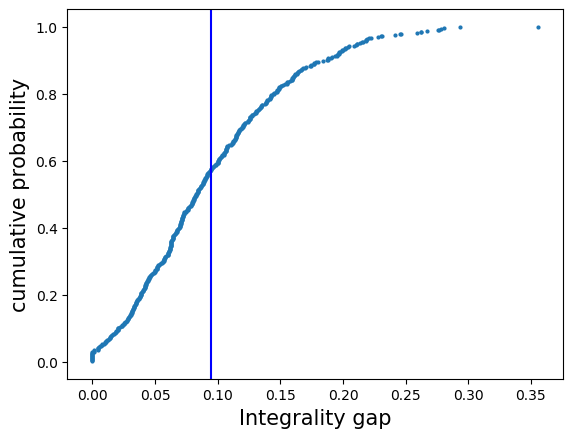

In [171]:
process(data_mn7)

<function matplotlib.pyplot.show(*args, **kw)>

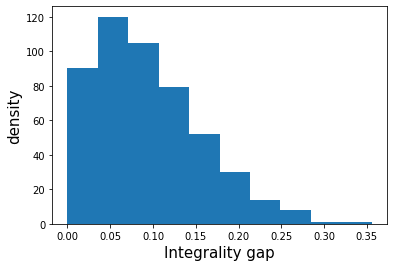

In [102]:
n, bins, patches = plt.hist(data_mn7)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

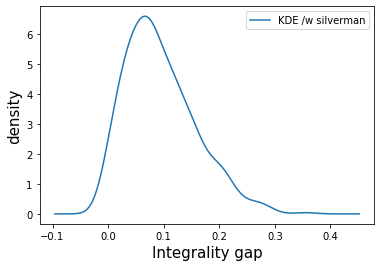

In [103]:
kernelDensity(data_mn7)

In [105]:
data_mn8 = the_loop(5, 300, 500)

[ 1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.
 -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.
 -0.  1. -0. -0.  0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.
  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  0. -0. -0.  1.  1. -0. -0.  1.
  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.
 -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  0. -0. -0.
  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0.  0. -0.  1.  1. -0.  1. -0.
  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1

 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
Obj: 115.296
[1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         0.24992822 1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         1.         1.         1.         1.         0.
 1.         1.         1.         0.         1.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.  

[-0.  0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.
  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0.
 -0. -0. -0.  1.  0.  1. -0.  1. -0.  1.  1.  0. -0.  1. -0.  1. -0.  1.
  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0.  0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  0.  1.  0. -0.  1. -0.
 -0.  1.  1. -0.  1. -0.  0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.
  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.
  1.  1.  1. -0. -0. -0.  0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.
  1.  1.  1.  1. -0. -0.  0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0. -0.  1. -0.  1.  0.  1.  1.  1.  0.  1. -0.  1.  1.  1. -0.  0.
  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  0.
 -0.  0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.
  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0

[ 1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.
  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.
 -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.
 -0.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.
  1.  1.  0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.
  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.
  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.
  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.
 -0.  1.  1. -0.  1. -0.  1.  0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.
  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.
  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.
  1. -0.  1.  0.  1.  1.  1.  1. -0.  1.  1. -0.  1

[ 1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.
  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.
  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.
  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.
  0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.
  1.  1.  0.  1.  1. -0. -0.  1.  1. -0. -0.  0.  1.  1. -0.  1.  1.  1.
  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.
 -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.
  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  0.  1. -0.  1.  1.  1.  1.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  0. -0.
  1.  1.  0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.
  1.  1.  0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.
 -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  0.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  0.  1

[1.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.71367168 0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         

[-0.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.
  0.  1.  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.  0.  1.  1. -0.  0.  1.
  1.  1.  1.  0.  1. -0.  1.  1. -0.  1.  1.  0. -0.  1.  1.  0.  0.  1.
  1.  0.  0.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.
  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.
  0.  0.  1. -0.  1.  0.  0.  1.  1.  0. -0.  1.  0.  1. -0.  0.  1.  0.
  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.
  1.  1. -0.  1.  1.  1.  1.  1.  0.  1.  1.  0. -0.  1.  0. -0.  0.  1.
  0.  1.  1.  0.  0.  1.  1.  0.  0. -0.  1.  1.  1. -0.  1.  1.  1.  0.
  1.  1.  0.  1. -0.  0.  0.  0.  1. -0.  0.  0.  1.  0.  0.  0.  1.  0.
  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.  0.
  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1. -0.  1.  0.  1.  1.  0.  0.
 -0.  1.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.
  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  0

[ 1.  0.  1.  1.  1.  0.  0.  1. -0.  1.  0.  1. -0.  0.  1.  1.  0.  1.
  0.  1.  1.  1.  1.  0.  1. -0.  0.  1. -0. -0.  1. -0.  1. -0.  1.  0.
  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1. -0.  0.  0.  0.  1.  0.
  1.  0. -0.  1.  1.  1. -0.  1.  0.  1. -0.  1.  0.  0.  1.  1.  1.  1.
  1.  0. -0.  1.  0.  0.  1.  0. -0.  1.  0. -0. -0.  1.  1.  0.  0.  1.
  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  0. -0.  0. -0.  0.  0.  0.  1.
  0.  1.  0.  0.  0.  0.  1.  1.  0.  0.  1. -0.  1.  1.  0.  0.  1.  1.
  0.  1. -0.  1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1. -0.  1.  1.
  0.  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.  0.  0.  1.  0. -0.  1.  0.
  1.  1.  0. -0.  1.  0. -0.  1.  1.  0.  1.  1.  0. -0.  0.  0. -0. -0.
  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0. -0.  0.
 -0.  0. -0.  1.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1. -0.
  0.  1.  0.  0.  0.  1.  0.  0.  1. -0.  1.  0.  1.  0.  1.  1.  1.  0.
  1.  1.  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.  0

[-0. -0. -0.  1. -0.  1.  1.  0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.
 -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  0.  1.
  0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.
 -0.  1. -0.  0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.
 -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  0.
  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.
  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  1.  1. -0.  0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
  1. -0.  1.  0.  1.  1.  1.  1. -0.  1. -0.  0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  0. -0. -0.
  0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  0. -0. -0.  1.
  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1

[1.         1.         1.         1.         0.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         

[-0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.
 -0.  1.  1. -0.  1.  1. -0. -0. -0.  0. -0. -0.  1. -0.  1. -0.  1.  0.
 -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.
  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.
 -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.
  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  0. -0. -0. -0.  1.
 -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  0. -0. -0.  1.
 -0. -0. -0.  1. -0. -0.  0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.
  1.  1.  1.  1.  1. -0.  0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  0.
  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1

  1. -0.  1.  1. -0. -0.  1. -0.  1.  0. -0.  1.]
Obj: 123.01
[0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         1.         0.84405928 1.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         1.         0.      

  1.  1. -0. -0. -0.  0.  1.  1.  1. -0.  1. -0.]
Obj: 129.695
[0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.68641131 0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 0.52065888 0.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         0.         0.71044208 1.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         1.     

[ 1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.
  1. -0.  1.  1. -0. -0. -0. -0.  0. -0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0. -0.  0. -0.  1.  1. -0.  1. -0. -0.  0.  1. -0.  1. -0.  1.  1. -0.
 -0.  1.  1.  0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.
  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  0. -0.
 -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.
 -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0.  1.  0.  1. -0. -0.  1. -0.  1.  0. -0. -0. -0.  1.
  1. -0.  1. -0. -0. -0.  0.  0.  1. -0.  1.  0. -0. -0.  1.  1.  1.  1.
 -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  0. -0. -0.  1.  1. -0. -0. -0.
  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.
 -0. -0. -0.  1.  1.  0. -0.  1. -0.  0.  1. -0.  1

[-0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.
 -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.
  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.
 -0.  0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.
 -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.
 -0.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.
 -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.
  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.
  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  0. -0

[ 0.  1.  0.  1.  1.  0.  1.  1.  0.  1. -0.  0.  1.  1.  0.  0.  1.  1.
  0.  1.  1.  1.  0.  0.  1. -0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.
  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.
  0.  0.  0.  0.  0.  0.  1. -0.  0.  1.  1.  1.  1.  0.  0.  0.  0. -0.
  1. -0.  0.  1.  0.  1.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.
  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1. -0. -0.
  0.  1.  1.  0.  1.  0.  1. -0.  1.  0.  1.  0. -0.  0.  0.  1.  1.  0.
 -0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  0.  0.  0.  1.  0. -0.  0.
  1.  0.  1.  1.  1.  0.  1.  1. -0.  1.  1.  1.  1.  1.  0.  0.  0.  0.
  1.  1.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.  0.  0.  1.
  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.  0.
  1.  0.  1.  0.  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  1.  1.  1.  1.
 -0. -0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  0.  1.
  1.  1.  1.  1.  0.  1. -0.  0.  1.  1.  0.  1.  0

 -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.]
Obj: 124.062
[0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         1.     

[0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1.
 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1.
 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1.
 0. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0.
 0. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1.
 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0.
 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1.
 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1.
 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1.
 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0.
 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0.
 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1.
 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1.]
Obj: 126.089
[0.         1.         1.         0.         0.         1.
 0.         0.

[ 1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.
 -0.  1.  1.  1.  0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  0.  1. -0. -0.  1. -0.  1.
 -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.
 -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.
  1. -0. -0.  1.  0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.
 -0. -0. -0.  0. -0.  1.  1.  1. -0. -0. -0.  1.  0. -0. -0. -0.  1.  1.
  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.
  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.
  1.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1

[-0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.
  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.
  1.  0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.
 -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
  1.  0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  0.  1. -0.
  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  0.  0. -0. -0.
  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.
 -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.
  1.  1. -0.  1.  1. -0. -0.  1.  0. -0. -0.  1. -0. -0. -0.  1.  1.  1.
 -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0

[ 1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  1. -0. -0.  1. -0.  1.  0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.
  1. -0.  1. -0.  1.  1. -0.  0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.
  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  0.  1.  1. -0.  1.  1.
 -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  0.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.
 -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.
  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.
  1.  1. -0. -0.  1. -0. -0.  0. -0. -0.  1.  0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0

[ 1.  1.  1.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.
  1. -0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.
  1.  1. -0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.
  0.  0.  1.  1.  1.  0.  1.  1.  0.  0.  1.  0. -0.  0.  1.  1.  1.  0.
  1.  1. -0.  1.  1.  0. -0.  1.  0.  1. -0.  0.  0. -0.  1.  1.  1.  0.
  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.
  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  0.  1.  0.  1.  0.
  1.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  1.
  0.  0.  1.  0.  1.  0.  0.  0.  0.  0.  1. -0.  0.  0.  0.  0.  1. -0.
  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.  0. -0.
  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  1. -0.
  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0. -0.  0.  1.  1.  1.  0.
  1.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.  1.
  1.  0.  1.  0.  0.  0.  0.  1.  0. -0.  0.  1.  1

[ 1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.
  0.  0.  1.  0.  0.  1.  0.  1.  0.  1.  0.  0.  1. -0.  0.  1.  0.  1.
  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  0.  0. -0.  0.  0.  1.  0. -0.
  0.  0.  0.  1.  1.  0. -0.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  0.
  1.  1.  0.  1.  1.  1.  0.  1.  0.  0. -0.  0.  0.  0.  0.  1.  0.  1.
  1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.  0. -0.  1.  0.
  0. -0.  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0.  0.
  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0. -0.  0.  1.  1.
  1.  1.  0.  1.  1.  0.  1. -0.  1.  1.  0.  1.  1.  0. -0.  1.  0.  1.
  0. -0.  1.  1.  0.  0. -0.  1.  1.  1.  0.  1.  1.  0. -0.  0.  1.  0.
  0.  0.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  0.  1.  0.  0.  1.
  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  1. -0.  0.  1.  1.  1.  1.
  0.  1. -0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.
  0.  0.  0.  0.  1.  1.  0.  1.  0.  0.  0.  0.  1

[ 0.  0.  1.  0.  0. -0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0. -0.  0.
  1.  0.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.  1.  0.  0.  1.
  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0. -0.  0.  0.  1.  1.  1.  1.
  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  0.  1.
  0.  0.  1.  0.  1.  0.  0. -0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  1.
  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.
  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1.
  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.
  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0.  0. -0.  0.  1.  1.  0.  0.
  1.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.  0.  1. -0.  1.  1.
  0.  1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.
  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1. -0.  0.  1.  0.  1.  0.
  0.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.
  0.  1.  1.  0.  0.  1.  0.  0.  0.  0.  0.  0.  1

[ 1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.
  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  0. -0.  1. -0.  1.  1.  1.
  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.
  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.
  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.
  1. -0.  0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.
 -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.
  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1

[ 1.  1.  1. -0.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  1.  0.  0.
  0.  1.  0.  0.  0.  1.  1.  0.  1.  1. -0.  1.  1.  0. -0.  0.  1.  0.
  1.  1. -0.  0. -0.  1.  1.  1. -0.  1.  1.  0.  1.  0.  1.  1.  1.  1.
  0.  0.  0.  0.  1. -0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  1.  0.  1.
  0.  1.  0. -0.  1.  1.  0. -0.  1.  1.  1.  0.  0. -0.  1.  1. -0.  0.
  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.  0.
  0.  1.  1. -0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.  0. -0.  0.  1.
  0.  0.  1. -0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.
  0.  1.  0.  1.  1.  0.  0. -0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.
  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  0.  1. -0.  1.
  1.  0.  1. -0.  0.  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.  1.
  0.  0. -0.  1.  0.  0.  0.  1.  0.  1.  1.  0. -0.  0. -0.  1.  0.  1.
  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.
  0.  1.  1.  1.  1.  1. -0.  0.  1. -0. -0.  1.  0

[ 1.  1. -0. -0.  0.  1. -0.  1.  1.  1. -0.  0.  1. -0. -0. -0. -0. -0.
  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.
 -0. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  0.  1.  1.  1. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  0.  1. -0.
  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  1.  1. -0.  0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.
  1. -0.  0. -0. -0. -0. -0.  0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.
  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.
  1. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.
 -0. -0.  0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  0. -0.  1

[ 1.  1.  0.  0. -0.  0.  1.  1.  0.  1.  0.  1.  0.  0.  0.  1.  0.  1.
  1.  1.  0.  0.  1.  1.  1. -0.  0.  1.  1. -0.  0.  0.  0.  0.  1.  0.
  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.
  1.  1.  0.  1. -0.  0.  0. -0.  1.  1. -0.  1.  0.  1.  0.  1. -0. -0.
  0.  1. -0.  1. -0.  0.  0.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.
  1.  0.  1.  1.  1.  0.  1.  0.  1.  1. -0.  1.  0.  0.  1. -0.  1.  1.
  1.  0.  1. -0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.
  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  0. -0.  1.  1.  0.
 -0.  1.  0. -0.  1.  1.  1.  1.  0.  0.  1.  1. -0.  1.  1.  0.  0. -0.
 -0.  1.  0.  1. -0.  0.  0.  0.  1.  0.  1.  1.  0.  1. -0.  1.  1.  0.
 -0.  0.  0. -0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.
  1. -0.  0.  1.  1.  0. -0.  0.  0.  0.  0.  0. -0.  0.  0.  1.  1.  0.
  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.
 -0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  1

[ 1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.
 -0.  1.  1.  0. -0. -0.  0.  1. -0. -0.  0.  1.  1. -0. -0. -0.  1. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  0.  1. -0. -0.  1.  0.  1. -0. -0.  1.  1.  1.
 -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.
  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1.  0.  1.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1.  0.  1.  1.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.
  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  0. -0. -0. -0.  0.  1.  1.  1.
 -0. -0. -0. -0.  1.  0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.
 -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.
  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1

[ 1.  1. -0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1. -0.  0.
 -0.  0.  1.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.
  0.  1.  1.  0.  1.  0.  1. -0.  0. -0.  1.  1.  0.  1.  0.  0.  1. -0.
  1.  0.  1.  0.  1.  0. -0.  0. -0.  0. -0. -0. -0.  1.  0.  1.  0.  1.
  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0. -0.  1.  1.  0.
  1.  0. -0.  0.  1. -0.  0.  1. -0.  1.  0.  1.  0. -0.  1.  0.  1.  0.
  1. -0.  1.  1.  1.  1.  1.  0. -0.  1.  0.  1. -0.  1.  0.  0.  0.  0.
  0.  1.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  0.  1.  0.  0.
  1.  0.  1. -0. -0.  1.  0.  0. -0.  1.  0.  1.  1.  1.  1.  1.  0.  0.
  0.  0. -0.  0. -0.  1.  0. -0.  1.  0.  1.  0.  1.  1.  0.  1.  1.  0.
  0.  0.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.  1. -0.  1. -0.  1.
  1. -0. -0.  1.  0.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1. -0.  0.
  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1. -0.
  0.  0.  1. -0.  0.  1. -0.  0.  0.  1.  0.  1.  0

[-0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  0. -0. -0. -0.  1.  1. -0.
 -0.  1. -0.  0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.
 -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  0. -0. -0.
 -0.  1.  1. -0.  0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  0.  1.  1.
  1. -0.  1.  0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.
  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1.
  1. -0. -0. -0. -0.  0. -0.  1.  0. -0.  1.  1.  1. -0.  1.  1.  1. -0.
  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.
  1. -0.  0.  1. -0. -0.  1. -0. -0.  1.  0. -0. -0.  1. -0.  1. -0. -0.
  1. -0.  0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.
  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
  1.  1. -0. -0. -0.  1.  1. -0.  0.  1. -0.  1. -0

[0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.80001371 1.         1.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.         1.         0.         1.         0.83332818
 1.         1.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         1. 

[-0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  0. -0.  1.  1. -0. -0.  1.
 -0.  1.  1.  1. -0. -0.  0. -0. -0.  1. -0. -0.  0.  1.  1.  1. -0. -0.
  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  0.  1.  1. -0.  1.
 -0.  1.  1.  0.  0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  0.  1. -0.  0.
 -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  0.  0. -0.  0.  1. -0.  1.
  1.  1. -0. -0.  0. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.
  0. -0.  1.  1. -0. -0. -0.  1.  1.  0.  1.  1. -0. -0. -0. -0.  1.  1.
  1.  1. -0.  0. -0.  1.  0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  0. -0.  0.  1.  1.  1.
 -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1.
 -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  0.
  1.  1.  0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.
 -0.  1. -0. -0.  1.  0. -0.  1.  1. -0.  0.  1. -0

[ 0.  1.  1.  1. -0.  0.  0.  0.  1.  0.  0. -0.  1.  0.  1.  0.  0.  0.
  1.  0.  1.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  0.
 -0.  0. -0.  1.  1.  1. -0.  0.  0.  0.  1.  0.  1.  1.  0.  0.  0.  0.
  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.
  0.  0.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  1.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.
  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.
  1.  1. -0.  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.  0.  0.  0.  1.
  0.  0.  1.  1.  0.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.
  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.  0.
  0.  0.  0.  0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.
  1.  1.  0.  0.  0.  0.  1.  0. -0.  0.  0.  1.  1.  0.  0.  0.  1.  1.
 -0.  1.  0.  1.  0.  1. -0.  1.  0.  1.  1.  0.  1

[0.         0.24367599 0.         0.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         1.         0.67819014 0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         

[0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.04975789 0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         0.82720279 0.
 0.         0.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.         1.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         

[-0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  0.  1.
  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.
  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  0.  1. -0. -0.  1. -0. -0.  1.
 -0.  1.  0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  0.  1.
 -0.  1.  0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.
 -0.  1.  1. -0.  1.  0. -0.  1. -0. -0. -0. -0. -0.  0.  1. -0. -0.  1.
  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  0.  1. -0.  1. -0.
  1. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0. -0.  0.  1. -0.  1.  1.  1.
  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1

[ 1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  0. -0.  1.
  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.
 -0.  1.  0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.
 -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.
  1. -0.  1.  1.  0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.
  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.
  1.  1. -0.  1. -0. -0. -0.  1.  1.  0.  1. -0. -0. -0. -0.  1.  1.  1.
 -0. -0.  0.  1. -0.  0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.
  1.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  0.  1. -0.  1.  1.
 -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1

[0.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         

[ 1. -0.  1.  0.  0.  1.  0.  0.  1.  0. -0.  0.  1.  1.  1.  0.  0.  1.
  1.  0.  0.  1. -0.  1.  0.  1.  1.  1. -0.  0.  1.  0.  1.  1.  0.  1.
  1.  1. -0. -0.  0.  1.  1.  1.  0.  0. -0.  0. -0.  1.  1.  1.  0.  0.
  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.
  0.  0.  0. -0.  0.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.
  1.  1.  0. -0.  1.  1.  1.  0.  1.  0. -0.  1.  0.  1.  1.  1.  1. -0.
  1.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  1. -0.  0.
  0.  1.  1. -0.  1.  1.  0.  0.  1.  0.  0. -0.  1.  1.  1.  0.  0.  1.
  0. -0.  1.  1.  1.  1.  1.  0.  1.  1. -0.  1.  1.  0.  0.  1.  0.  1.
  0. -0.  0.  0.  1.  1.  0.  1. -0.  1.  0.  0.  1.  0.  0.  1.  0.  1.
  1.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.
  1.  1.  0.  1.  1.  1.  1.  0.  1. -0.  1.  1.  1.  0.  1.  0.  0.  0.
  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.
  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  0.  0.  0

[0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.26347487 0.         1.         1.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         1.         1.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         0.         0.         

  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.]
Obj: 127.442
[0.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 0.98014814 0.         0.         1.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.80939198 1.         1.     

[-0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  0.  1. -0.  1. -0.  1.  1.  1.
  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  0.  1. -0.  0. -0. -0.  1. -0.
 -0. -0.  0. -0.  1.  1.  1. -0.  1. -0. -0.  0.  1. -0. -0.  1. -0. -0.
  1. -0.  0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.
 -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.
  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.
  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.
 -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.
  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.
  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.
  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1

[ 1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0.  0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  0. -0.  1.  1.  0. -0.  1. -0.  1.  1.  1.  1.  0.  1.  1.  1.
  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.
 -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  0. -0.
  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.
  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1.  0.  1. -0.  1.  1.  1. -0.  1. -0.
  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.
 -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  0. -0. -0. -0.  1. -0.
  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0

[-0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.
 -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.
  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.
  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.
 -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.
  1.  0.  0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  0. -0.  1. -0. -0. -0.
  1.  1.  1.  0.  1. -0.  1.  0. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.
  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  0. -0. -0. -0. -0. -0.  1.
  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.
  0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.
 -0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0

[ 1.  0.  1. -0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  0.  0.
  1.  1.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.
  0.  0.  0.  0.  1.  1.  1.  1. -0.  0.  1.  1.  0.  0. -0. -0.  0.  0.
  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  0.  0. -0.
  1.  0.  0.  1.  1.  0.  1.  0.  0. -0.  1.  1.  1.  1.  1.  1.  0.  0.
  0.  1.  1.  1.  1.  0.  0.  0. -0.  1.  0.  1.  1.  1.  0.  1.  1.  0.
  0.  0. -0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  0.  0.  1.  1.
 -0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1. -0.  1. -0.  1.
  0.  0.  1.  0.  1.  0.  1.  1. -0.  0.  1.  0.  1.  1.  1.  1.  1.  0.
  0.  0.  1.  1.  1. -0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  1.  0. -0.
  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  0.
  0.  1.  1.  0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0. -0.  1.  1.  0.
  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  1. -0.  1.  0.  1.  1.  1.
  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1. -0.  0

[0.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.00703244 0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         

[0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.85391861 0.         0.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         

[0.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         0.77974009 1.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         

[ 1.  1.  0. -0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.
  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  1.  0.  0.  0. -0.  0.
  0.  1.  1.  1.  0.  1. -0.  1. -0.  1.  1.  0.  1.  0.  0.  1.  0.  0.
  0.  0.  0. -0.  0. -0. -0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.
  0.  1.  0.  1.  0.  0.  0.  0.  1.  0.  0.  1. -0.  0.  1.  1.  0.  1.
  0.  1.  1.  0.  1.  0.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  1. -0.
  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.
  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.
  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  1.  0.
  0.  0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  0.  1.  1.  0.  0.
  0.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.
  0.  1.  0.  1.  1.  1.  0.  1.  1. -0.  0. -0.  1.  1.  1.  1.  0.  0.
  0.  1.  1. -0.  1.  1.  0.  1.  0.  0.  1.  0.  1.  1.  1.  0.  0.  0.
 -0.  1.  0.  1.  1.  1.  1.  1. -0.  1.  1.  0.  0

[1.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.22008846
 1.         0.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         1.         0. 

[ 1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.
  1.  1. -0. -0.  1.  0. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.
 -0.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.
 -0. -0.  0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1.
 -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.  0. -0. -0.
  1. -0.  1. -0. -0.  0. -0. -0. -0.  1.  1.  0. -0.  1.  1. -0.  1. -0.
 -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  0.
  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  0. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1

[ 1.  0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.
  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  0.  1.
 -0.  1.  1. -0.  1. -0.  1. -0.  0.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.
  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.
  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  0. -0.  1.  1.  1.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1.
  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.
  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.
  0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.
 -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.
  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0

[ 0.  1.  1.  0.  1.  0.  0. -0.  1.  1.  0.  0.  0. -0.  0.  0.  0. -0.
 -0. -0.  0.  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.
  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  1.
  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.  0.
  0.  0.  0.  0. -0.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1. -0.
  0.  1.  1.  1.  0.  1. -0.  1.  1.  0.  0.  1.  0.  0.  1.  1.  1.  1.
  0. -0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.  0.
  0. -0.  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  0.  1.  1.
  1.  0.  1.  0.  0.  1.  0.  1. -0.  1.  0. -0.  1.  0.  1.  1.  0.  0.
  1. -0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.  0.
 -0.  0.  1.  0.  0. -0.  1.  1.  0.  1.  1.  0. -0.  0.  1.  1.  0.  0.
 -0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.
  0.  0.  1.  1.  0.  0.  0.  1.  0. -0.  1. -0.  0.  1.  1.  1.  1.  1.
  1.  1.  0.  0.  1.  0. -0. -0.  0.  1.  0.  1.  1

[ 0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.
 -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0. -0.  0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.
  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.
  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.
 -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.
  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  0.  1.  1. -0.  1.
 -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0

[-0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.
  1.  1. -0. -0.  1.  1.  1.  0. -0.  1.  1. -0. -0.  1.  0. -0. -0.  1.
 -0.  1.  1. -0.  1.  0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.
 -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  0. -0.
 -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.
  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  0.  1. -0. -0.  1. -0.
  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.
 -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.
  0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  0. -0. -0. -0.  1. -0.
 -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.
  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.
 -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.
 -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1

[ 1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.
  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.
 -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.
  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.
  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.
  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.
  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.
 -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.
 -0.  1.  1. -0.  1.  1. -0.  0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.
  1.  1.  1.  1.  1.  1. -0. -0.  0. -0.  1.  1.  1

[ 1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.
 -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.
 -0. -0.  1. -0.  0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  0.  1. -0. -0.
 -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  0.  1. -0.  1.  1.
  1. -0. -0. -0.  1. -0.  1.  1.  0. -0. -0.  1. -0. -0. -0.  1.  1. -0.
  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.
  1. -0.  1.  1. -0.  1. -0. -0. -0.  0. -0. -0.  0.  1. -0.  1.  1.  1.
  1.  1.  1.  1. -0. -0.  0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.
 -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.
  1. -0. -0.  0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.
  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  0.  1.  1.  1.  1.  1.  0.
 -0. -0.  1.  0. -0.  1.  1.  1.  1. -0.  1. -0. -0

[1.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         0.06285888 0.         1.         0.
 1.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         0.         0.31990283 1.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.45165588 0.         1.         

[1.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         0.         1.         1.         0.
 1.         1.         1.         0.28155437 0.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         

[1.         0.         0.         0.         0.         0.
 1.         1.         0.         0.96601831 0.         0.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.77547445 0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         

[0.         1.         0.         1.         1.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.21635693
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         1.         0. 

[0.         1.         0.         0.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         

[ 0.  0.  1.  0.  0.  0.  1.  1. -0.  0.  1.  0. -0.  1. -0.  0.  1. -0.
 -0.  0. -0.  1.  0.  0.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.  0.  1.
 -0.  1.  0.  1.  0.  0.  1.  1.  1. -0.  0.  1.  1. -0.  1.  1.  0.  1.
  1.  1.  1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.
  1.  0.  1.  1.  1.  1.  1.  1.  1.  0. -0.  1.  0.  1.  0.  0. -0.  0.
  0.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.  1.  1.  1.  0.  0.  0.  1.
  1.  1.  0.  1.  0.  1.  1.  1.  0. -0.  1.  0. -0.  1.  1.  1.  0.  1.
  1.  0.  1. -0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.
  0.  0.  0. -0.  1. -0. -0.  0. -0.  1.  1.  1.  1.  0.  1.  0.  0.  1.
  1.  0.  1.  0. -0.  0.  1.  1.  0.  1.  1.  0.  1. -0.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  0.  0.  0. -0.  0.  1.  1.  0.  1.  0.  1.  0.
 -0.  1.  0.  0.  1. -0. -0.  0. -0.  0.  1.  0.  0.  0.  1. -0.  0.  1.
  1.  1.  1.  0.  1.  1.  0.  0. -0.  1.  0.  0.  1.  1.  1.  0.  0.  0.
  1.  0. -0. -0.  0.  0.  1. -0.  1.  1. -0. -0.  1

[0.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.77500216 0.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         

 -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.]
Obj: 108.998
[1.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.28646716 0.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         0.     

[ 1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1.  1.  1.  0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  0.  1.  1.  1.
  0. -0.  1.  1. -0. -0.  1.  0.  0. -0.  0.  1.  1. -0. -0. -0. -0.  1.
  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  0.  1.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
  0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.
  0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  0.  1.  1.  1.
 -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.
  1. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  0. -0. -0.  1.  1. -0.
 -0.  0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.
  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  0.
  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  0.  1

[0.         0.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.14900535
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         1. 

[ 0.  0.  0.  0. -0.  1. -0.  0.  0.  0.  0.  1.  0.  1. -0.  0.  0. -0.
  1.  1.  0.  0. -0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1. -0.  1.
  0.  0.  0.  1.  1.  1.  0.  1.  0. -0.  1.  1.  1.  0.  0. -0.  0.  0.
  1.  1.  1.  1.  0.  0.  0. -0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  1.
  1. -0.  0.  0.  1. -0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.
  1.  0.  1.  0. -0.  1.  0.  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  1.
  0.  0.  1.  1.  0.  0.  1.  1.  0.  0. -0.  1.  0.  0.  0.  0.  1.  1.
  0.  1.  1.  1.  1. -0.  0.  0.  1.  1.  1. -0.  1.  0.  0. -0. -0.  1.
 -0.  1. -0.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1.
  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.
  0.  0. -0.  1.  1. -0.  0.  1.  1.  1.  0. -0.  1.  0.  1.  1.  1.  0.
  0. -0.  0.  1.  1. -0.  1.  0. -0.  0.  1.  1.  0.  0.  0.  1.  0. -0.
  1.  1.  0.  1. -0.  1.  1. -0.  1.  1.  0.  1.  1. -0. -0.  0.  1.  0.
  1.  0.  1.  0. -0.  0.  1.  1.  1.  1.  0.  0.  0

[1.         0.         1.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         1.         0.73187069 0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         

[-0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.
  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.
 -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  0. -0. -0.
  1.  1. -0.  1.  1.  1. -0.  0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  0.  1. -0. -0. -0. -0.  1.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.
  1.  1. -0.  0.  1.  1.  1. -0.  1.  1.  1. -0.  1

[0.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         1.         0.41628538 1.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         

[1.         1.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         1.         

[ 1.  1.  1.  1.  1.  1.  1.  1.  0.  1. -0.  0.  1.  0.  0.  0.  0.  1.
  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0. -0.  1.  0.  0.
  1.  0.  1.  1.  1.  0.  1.  0. -0. -0.  0.  1.  1.  0.  1. -0.  1.  0.
  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  0.
  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0. -0.
  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1. -0.  1.  1.  1.  1.
  0.  0.  1.  1.  1.  1.  0.  0.  1.  1. -0.  0.  0. -0.  1.  1.  1.  1.
  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  0.  0.  0.
  0.  1.  1. -0.  1.  1.  1. -0. -0.  0.  1. -0.  0.  1.  1.  1.  1.  0.
  1.  1.  0.  0.  0. -0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.
  1. -0.  1.  0.  1.  1.  1. -0.  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.
  0.  0.  0.  0.  0.  1.  1.  0. -0.  1.  1.  1. -0.  1.  1. -0.  1.  0.
  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.
  1.  0. -0.  1.  0.  0.  1.  1.  0.  0.  0.  1.  0

[0.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         1.         1.         

[0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         0.07823513 0.         1.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         0.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.79324336 0.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         

 -0. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.]
Obj: 108.889
[1.         1.         1.         0.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         1.         0.09351843 0.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         1.     

[0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         0.
 1.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.         1.         0.         1.         

[-0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.
  1.  1.  1. -0.  0.  1.  1.  0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.
 -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.
  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.
 -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.
 -0. -0. -0.  1. -0. -0.  0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.
 -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.
  1. -0. -0.  0. -0. -0.  1. -0. -0.  0. -0.  0. -0.  1. -0.  1. -0. -0.
 -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.
  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.
  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.
 -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1

[ 1.  1. -0.  1. -0. -0.  0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.
  1. -0. -0.  0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.
 -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.
  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0. -0.  1.  0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.
  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.
 -0.  1. -0. -0. -0.  1. -0.  1.  1.  0. -0.  1. -0.  1. -0. -0.  1. -0.
  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.
 -0.  1.  1.  1. -0. -0.  1.  0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.
  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  0. -0.  1

[-0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  0. -0.
  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  0. -0. -0.  1.
 -0.  1.  1.  1. -0.  1.  1. -0.  0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.
  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.
  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.
 -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0.  1.  1. -0.  0. -0. -0.  1.  1. -0. -0.  1.  1.  1.
 -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.
 -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.
  1. -0.  1.  1. -0.  0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0

[ 1.  1.  1.  1.  0.  0.  1. -0.  0.  0.  1.  0.  1.  1.  0.  0.  0.  0.
  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  1.  0.  1. -0.  1.  0.  1.
  1.  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  0.
  0.  0.  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1. -0.  0.  0.
  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.
  1.  0.  1.  0.  1.  1. -0.  0.  1.  1.  1.  0.  1.  1.  1.  0. -0.  1.
  1.  1.  0.  1.  0.  0.  1.  0. -0.  0.  1.  0.  0.  0.  1.  1. -0.  0.
  0.  1.  1.  1.  0.  1. -0.  1.  0.  0.  1.  1.  0.  1.  1.  1. -0. -0.
  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0. -0.  0.
  0.  0.  1.  1.  0.  0.  0.  1. -0.  0.  1.  1.  0. -0.  0.  0.  1.  1.
  0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.
  0.  1.  0.  0.  1.  1.  1.  1.  0.  0.  1.  0. -0.  1.  1.  1.  0.  1.
  1.  1.  0.  0.  1.  0.  0.  1.  0. -0.  1.  1.  1.  0.  0.  0.  1.  0.
  0.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1

[-0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
  1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.
  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.
 -0.  1.  1. -0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.
 -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0.  0.  1. -0.  1. -0.  1. -0.  1. -0.  1.
  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.
  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  0.
 -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.
  1. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1

[-0.  1. -0.  1.  1.  1.  1. -0.  1.  0.  1. -0. -0.  1.  1.  1.  1.  1.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  0.  1.  0. -0. -0.
 -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.
 -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.
  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.
  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0.
  1.  1.  1. -0. -0.  0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.
  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.
  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0

[-0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  1.
  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  0.  1.  0.  0.
  0.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1. -0.  0.  0.  0.  1.  1.  0.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0. -0. -0.  1.  0.  1.
  1.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.
  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.  0.  0.
 -0.  1.  0.  0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  0.  1.  0.  1.  1.
  1. -0.  1.  1.  0.  0.  0.  0. -0.  0.  0.  1.  0.  1.  0.  1.  1.  0.
  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.  0.
  0.  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.
  0.  0.  0.  1.  1.  0.  1. -0. -0.  1.  0.  1.  0. -0.  1.  1. -0.  1.
  1.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.  0.  0.
 -0.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.
  0.  1.  0.  1.  0.  0.  0. -0.  1.  1.  0.  0.  0

[ 1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0. -0.  1.  1.  0.  1.  0.
  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0. -0.  0.  1.  0.
  1.  1.  0.  0.  0.  0.  1.  1.  0. -0.  0.  1.  0.  1.  0.  0.  0.  0.
 -0.  1.  0.  0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  0.  1.  0.  1. -0.
  0.  0.  1. -0.  0.  0.  0.  1.  1. -0.  0.  1.  0.  1.  1.  1.  1.  1.
  0.  1. -0.  0.  1. -0.  0.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.
  0.  1.  0.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  0.  1.  1.  1.
  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0.  0.
  1.  0.  1.  1.  1. -0.  1.  0.  1.  1.  1.  0. -0.  1. -0.  1.  1.  1.
  0.  0.  1.  1.  1.  1.  1.  0.  1. -0.  0.  0.  0.  1.  0.  1. -0.  1.
  1.  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1. -0.
  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.
  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0.  0. -0.  1. -0.  1.  1.  1.
  1.  1.  1.  0.  0.  1. -0.  1.  0.  0.  1.  0.  0

  0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.]
Obj: 124.803
[0.         1.         1.         0.         1.         1.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         0.         1.         1.
 1.         1.         1.         1.         1.         0.2902356
 0.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         0.         

[ 1. -0.  0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.
  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.
 -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.
 -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.
  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.
 -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.
 -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
 -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  0.  0. -0.  1. -0.  1. -0.  1.
 -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0

[-0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  0. -0.  1. -0. -0.
 -0.  1. -0.  0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  1.  1. -0.  0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.
 -0. -0.  1. -0. -0.  1.  0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.
 -0. -0. -0.  1. -0.  0.  1. -0. -0. -0.  0.  1.  1.  1. -0.  1.  1.  1.
 -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.
 -0.  1.  1. -0. -0.  1.  1.  1.  0.  1.  1.  1. -0. -0. -0.  1. -0.  1.
  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  0. -0. -0. -0. -0.  1.
  1.  1.  1.  1.  1.  1.  1. -0. -0.  0. -0.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0.  1.  1.  1. -0. -0.  1.
 -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.
  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.
  1.  1.  1.  1. -0.  1.  1.  1.  1.  0. -0. -0.  1. -0.  0. -0.  1.  1.
  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1

[ 1. -0.  0. -0.  0.  1.  1.  0.  1.  1.  0. -0.  0.  0.  0. -0.  1.  0.
  1.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.  1.  0.  0.  0.
  0.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.
  0.  1.  1.  1.  0.  1.  1. -0.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.
  0.  1.  1.  1.  0. -0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1. -0.  1.
  0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.
  0.  1.  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.
  0.  0.  1.  0.  0.  1. -0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.
  0.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.
  0.  1.  1.  1.  1.  1.  0.  0.  1.  1. -0.  1.  1.  1.  0.  1.  0.  1.
  1.  0.  0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.
 -0.  1.  0.  0.  0. -0.  0. -0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.
  0.  1.  1.  1.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.
 -0.  1. -0.  1.  1.  1.  1.  0.  1.  0.  0.  0.  1

[ 1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.
  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
 -0.  1.  1. -0.  0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  0. -0. -0.  1.
 -0. -0.  1. -0. -0.  0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1.
  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.
  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.
  1. -0.  1.  1. -0.  1. -0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  1. -0.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  0.  1.
  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0.  1.  1. -0.  1. -0.  1.
  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.
  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  0.  1.  1

[0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1.
 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1.
 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1.
 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0.
 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1.
 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0.
 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1.
 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0.
 0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0.
 1. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0.
 0. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0.
 1. 1. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0.]
Obj: 111.761
[0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1.


[ 1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  0.  1.  1.  1. -0.  1.  1.  1.
 -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.
 -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  0. -0. -0.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.
 -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.
  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.
 -0.  1.  1.  1. -0.  1. -0.  0. -0. -0. -0. -0.  0.  1.  1.  1. -0. -0.
 -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.
 -0.  1.  1.  0.  1.  1.  1. -0. -0. -0. -0.  0. -0.  1.  1. -0.  1.  1.
 -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.
  0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.
  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  0.  1.  1. -0.  1.  1.
 -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1

[ 1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.
  1. -0. -0. -0.  0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  0.
  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  0.  1.  1.  1. -0.
  1.  0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  0.
  0.  1.  1. -0. -0. -0.  0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.
  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.
  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  0. -0.  0.
  1.  1. -0. -0. -0. -0.  1.  0. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.
 -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  0.  1. -0. -0.  0.
 -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.
  1. -0. -0.  1.  0. -0. -0.  1. -0.  1.  0. -0. -0.  0.  1. -0. -0.  1.
  1. -0. -0.  1.  1.  1. -0.  1.  0.  1. -0.  1.  1. -0. -0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1

[0.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         

[-0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  0.
 -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  0. -0.
 -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.
  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  0.  1. -0. -0.  0.  1. -0.
 -0.  1.  1.  1. -0.  1. -0.  0.  1. -0. -0.  0.  1. -0. -0.  1.  1.  1.
 -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.
 -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.
 -0.  1.  1.  1. -0. -0. -0. -0.  0. -0. -0.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  0. -0.  0.  1. -0

 1.         0.         0.         1.         0.         0.        ]
Obj: 117.555
117.55540348508427 relaxed 
117.51580332142835 original 
[ 1.  1.  0.  1. -0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.
  0.  0.  0.  1.  0.  1.  1. -0. -0.  1.  1.  1.  0.  0.  0.  1.  1.  1.
  0.  0.  0.  0.  1.  1.  1.  0.  1. -0. -0.  0.  0.  1.  0.  1.  0.  1.
  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  1.
 -0.  0.  0.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.
  1.  1.  1.  1. -0. -0.  1.  1. -0.  0. -0.  1.  0.  0.  1.  0.  1.  1.
  0.  1.  1.  1.  0.  0. -0.  1.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.
  0.  0.  1.  0. -0.  0.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.
  0.  0.  1.  1.  0.  1.  0.  0. -0.  1.  0.  0.  0.  0.  0.  0.  1.  0.
  0.  1.  1.  0.  1.  1.  1.  0.  1. -0.  0.  0.  1.  1.  1.  1. -0.  0.
  0.  1.  1.  1.  0.  1. -0.  0.  1.  1.  0.  0.  0.  1.  0. -0.  1.  1.
  0.  1.  1.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1

  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.]
Obj: 118.31
[0.         1.         1.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         1.      

[1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         

 -0. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  0.]
Obj: 130.817
[0.         0.         1.         1.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         0.         1.         0.35435858 1.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         0.     

[-0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  0. -0.
  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.
  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.
  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.
  1. -0.  1.  1.  1. -0.  1.  1.  0.  1. -0. -0. -0.  1.  1.  1.  1.  1.
  1. -0. -0.  0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0.
 -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  0. -0. -0.  1. -0. -0.
  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.
  1. -0.  1. -0.  1.  1.  0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.
 -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.
  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0

[ 0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  1.
  0.  1.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  1. -0.  0.
  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1. -0.
  1.  1.  1.  1.  1.  0.  0.  0. -0. -0.  0.  1.  0.  1.  1.  1.  0.  0.
  1.  0.  0.  0.  1.  0.  1.  1.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.
  1.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0. -0.  0.  0.  0.  0.  0.  1.
  1.  1.  0.  1.  1.  1. -0.  0. -0.  0.  1.  1.  1.  0.  1.  0.  0.  0.
  1.  1.  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1. -0.  0.  0.  1.  0.
  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  1.  0. -0.
  0.  0.  1. -0.  0.  0. -0.  0. -0.  0.  0.  0.  0.  0.  0.  1.  1.  0.
  0. -0.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0. -0.
  0. -0.  1.  0.  1.  1.  1.  1.  0. -0.  0.  1.  1.  0.  1.  1.  1.  1.
  0.  0. -0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1. -0.  0.  1.  1.  0.
  1.  1.  1.  0.  1.  0.  0.  1.  0.  1.  1.  1.  0

[ 1.  0.  0.  1.  1. -0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  0.
  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  0.  0.
  0.  0.  1.  0.  1.  0.  1.  1.  0. -0.  0.  1.  0.  1.  1.  0.  1.  1.
  0.  0.  0.  0.  1.  1.  1.  0.  0.  0. -0.  0.  0. -0.  1.  1.  0.  1.
  0.  1.  1.  1.  1.  0. -0.  1.  1.  0.  0.  0.  0.  0. -0.  0.  1. -0.
  1.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0. -0.  0.  0.  1.  0.  1.  1.
  1.  1.  1.  0.  0.  0.  0.  0.  0. -0.  1.  0.  1.  0.  1.  1.  0.  0.
  1.  0.  1.  1.  0.  1.  0.  1.  1.  1.  0.  0.  0.  1. -0. -0.  1.  1.
  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  0.
 -0.  1.  1. -0.  0.  1.  0.  1.  1.  1.  1.  0.  1. -0.  0. -0.  0.  1.
  0.  0.  1.  0.  0.  0.  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  0.  1.  0.  1.  1.  1. -0.  1.  0.  1.  0.  0.  0.  1.
  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1. -0.  0.  1.  1.  1.  1.
  1.  0.  0.  1.  1.  0.  1.  1.  1. -0.  1.  1.  0

  1.  1.  1. -0.  1.  1. -0. -0.  0.  1.  1.  1.]
Obj: 109.906
[0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         1.     

[ 1. -0.  1.  1. -0.  0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.
 -0.  0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  0.  1.  1.
 -0.  1. -0. -0.  1.  1. -0. -0.  0. -0.  1. -0.  1.  1.  1. -0.  1.  1.
  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.
 -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  0. -0.  1. -0.  1.  1.
 -0. -0. -0.  1. -0.  1. -0.  0. -0.  1.  1.  1. -0.  0.  1.  1.  1. -0.
  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.
  0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  0. -0. -0.
 -0.  0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  0.  1. -0.  1.  1. -0. -0.
  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.
  1.  1. -0.  1.  0.  1.  1.  1.  1. -0.  0. -0. -0

[ 1. -0. -0.  1. -0. -0.  0. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.
  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.
  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.
 -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.
 -0. -0.  1. -0.  0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.
  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  0. -0. -0.  1.  1. -0.  1.
  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.
 -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.
  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.
  1.  1. -0. -0.  0.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0

[1.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         

[1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1.
 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0.
 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1.
 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0.
 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1.
 0. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 0. 1.
 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1. 0.
 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1.
 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 1.
 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 1.
 1. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
Obj: 104.837
[1.         1.         0.         1.         1.         1.
 1.         0.

[0.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         0.84313898 0.
 1.         0.         0.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 1.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         

[1.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.36413606 1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         

[ 1. -0.  1. -0.  1.  0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.
  0.  1.  1.  1. -0.  1. -0.  1.  0. -0. -0.  0.  1.  1.  1.  1.  1.  1.
  1. -0. -0.  0. -0. -0.  0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.
 -0.  0. -0.  1.  1.  0.  0.  1.  1. -0.  0. -0.  1. -0.  0. -0. -0. -0.
  0. -0. -0. -0.  0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  0. -0.  1.
  1.  1.  0. -0.  0.  1.  1. -0. -0.  0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0.  0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  0.  1. -0.  0.
 -0.  0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  1. -0.  0.  1. -0.  0.
 -0. -0.  1.  0. -0.  0. -0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.
  0. -0.  1.  1.  0. -0.  1.  1. -0. -0.  0.  1. -0.  1.  1. -0.  1.  0.
  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.
  1.  0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  0.  1.  0.  1.  1.  1.
 -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  0. -0.  0. -0.  1.
 -0.  1.  1.  0.  0. -0.  0. -0.  1. -0.  1.  1.  1

[ 1.  0.  0.  0.  0.  0.  0.  1. -0.  0.  1.  0.  0.  1.  1. -0.  1.  0.
 -0.  1.  1.  0.  0.  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  1.  1.
  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.
  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1. -0.  0.
  1. -0.  1.  0. -0.  0.  1.  1.  1.  0.  1. -0.  0.  1.  1.  0.  1.  0.
  0.  0.  1. -0.  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.  1. -0.  1.  0.
  1. -0. -0.  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1. -0.  1.
  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.  0.  0. -0.
  0.  0.  1.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.
  0.  0.  1.  0.  1.  0.  0.  0.  0. -0.  0. -0.  1. -0.  0.  1. -0.  0.
  0.  1. -0. -0.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.
  1.  0. -0.  1.  1.  0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.  0.  1.
  1.  1.  0.  0.  1.  1.  1. -0.  0.  1.  0.  0.  0.  0.  1.  0.  0.  1.
  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1. -0.  1

[1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         0.         1.         

[ 0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.
  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  1.
  1.  1.  0.  1.  0.  0.  0.  1.  0.  1. -0.  0.  0.  1.  1.  1.  1.  0.
 -0. -0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  0.  1.  1.  1.  1.  0.
  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  1.  0. -0.  0.
  1.  0.  0.  1.  0.  0.  1.  0. -0.  0.  0.  1.  1.  1.  0.  0.  0.  1.
  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0. -0.  1.  1.  1.  0.
  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1. -0.  0.  1.  1.  0.  0.  0.
  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1. -0.  0.  1.
  0.  1.  0. -0.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.
  1.  0.  1. -0.  1.  1. -0.  0. -0.  0.  0.  1.  0.  1.  1.  1.  0.  1.
  0.  0.  0.  1.  1.  0.  0.  1.  0.  0.  0.  0.  1.  0.  1.  1.  0.  1.
  0.  0.  1.  1.  1.  0.  1.  0.  1. -0.  0.  0.  1.  0.  0.  0.  1.  1.
  0.  0.  1.  0.  0.  1.  0.  1. -0.  1.  1.  0.  1

[ 1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.
 -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.
  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.
  1.  0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0.  1.  0. -0. -0.  1.  1.  1.  0. -0. -0.  1.  1.  1.
  1.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  0.
  1.  1.  1.  1. -0.  1.  0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  0. -0.  1.  1. -0.
  1. -0.  1. -0.  1. -0.  0.  1.  1. -0.  1. -0. -0

[1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         0.18915446 1.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         

[ 0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0. -0.  0.  1.  1.  1.  0. -0.
  1.  1.  1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0. -0.  0.  1.
  0.  0.  1.  0.  0.  1. -0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1. -0.
  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.  0.  1.  0.  0.  0.  0.  0.  1.
  0.  0.  0.  1.  1.  0.  1. -0. -0. -0.  0.  1.  0.  0.  1.  1.  0.  1.
  1.  1.  1.  1.  0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.  1.  0.
  1. -0.  1.  1.  1.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.  0.  1.
  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.
  1.  0.  0.  0.  1. -0.  0. -0.  0.  1.  1. -0.  1.  0.  0.  1.  1.  0.
  0. -0.  0.  1.  0.  0.  1.  0. -0.  1.  0.  0.  1.  0.  1.  1.  1.  0.
  1.  0.  1.  0.  1.  1. -0.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.
  1.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.
  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.
  0.  1.  1.  0.  0. -0.  1.  1.  1.  1.  0.  1.  0

[ 0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.
  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.
  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.
  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  0.  1.  1.  1.  1. -0. -0. -0.
 -0.  1.  1.  1.  1.  1. -0.  0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  0.
  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.
 -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.
  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.
 -0.  1.  1. -0.  1.  1.  0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1

[ 1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  0. -0. -0.  1.
  1.  1. -0. -0.  0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.
  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  0. -0.  0. -0. -0. -0.
  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.
  1.  1. -0.  1.  1.  0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.
  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  0. -0. -0. -0. -0. -0.
 -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.
  1. -0. -0.  1.  1.  1.  1.  1. -0.  0.  1. -0. -0.  1.  0.  1.  1. -0.
 -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.
  1.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  0.  1.
 -0.  1. -0.  1. -0. -0. -0.  1.  0. -0.  1. -0.  1

[0. 1. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0.
 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1.
 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1.
 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0.
 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1.
 1. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 1. 1. 0.
 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0.
 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0.
 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1. 0.
 0. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0.
 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1.
 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 1.]
Obj: 115.804
[0.         1.         1.         1.         1.         0.
 1.         0.

[1. 1. 0. 0. 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 1.
 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1.
 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1.
 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0.
 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0.
 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0.
 1. 0. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0.
 1. 1. 0. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1.
 0. 1. 0. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 0.
 1. 1. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 0.
 1. 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1.
 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0.]
Obj: 107.177
[1.         1.         0.         0.         0.         1.
 1.         0.

[0.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         1.
 1.         1.         0.         1.         1.         0.
 1.         1.         1.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         

[ 1.  0.  1.  1.  0.  1. -0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.  0.
  0.  1.  1.  1.  1.  0.  0.  1. -0.  0.  1.  1.  0.  1.  1.  1.  1.  1.
 -0.  1.  0. -0. -0.  1. -0.  0.  0. -0.  1.  1.  1.  0.  1.  0.  0. -0.
  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.
  1.  1.  1. -0.  1.  1. -0.  0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.
  0.  0.  0.  0. -0.  0.  1. -0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.
  1.  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1. -0.
  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  0. -0.  1.  1.  0.  1.
  0.  1.  1.  0.  1.  0.  1.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.
  0.  1.  0.  0.  1.  0.  0. -0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.
  1.  0.  1.  1.  1. -0.  0.  0.  1. -0.  0.  0.  1. -0.  0.  0.  0.  0.
  0. -0.  1.  0. -0. -0.  0.  0.  1.  1. -0.  0.  1.  1.  0.  1.  1.  1.
  1.  0.  1.  1.  0. -0.  1.  1.  0. -0.  1.  0.  0.  0.  0.  0.  1. -0.
  0.  1.  1.  0. -0. -0.  0.  1.  1. -0.  0.  1.  1

 1.         0.         1.         0.         0.         0.        ]
Obj: 100.762
100.76210834965954 relaxed 
100.66704095194599 original 
[ 1.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1. -0.  1. -0.  0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.
  1. -0.  0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
  1.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.
 -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  1.
 -0.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1.  0. -0.
  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.
 -0. -0.  1.  1.  1.  1. -0.  0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  0.  1.  1.
 -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  0.  1.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1

[ 1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0. -0.  0.  1.
  1. -0.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1. -0.  1.
  1.  1.  1.  1. -0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  0.  0.
  0.  1.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1. -0.  0.
  1.  0.  1.  0.  0.  1.  0.  1.  0. -0.  0.  1.  1.  0.  0.  0.  1.  1.
  1.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  0.
  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.
  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  1.
  1.  1. -0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0.  0.  0.
  0.  1.  0.  0.  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  0.  0.  1.
  0.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0. -0.  0.  1.  1.  1.
  0.  1.  0.  1.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  1.  0.
  1.  1.  1.  0.  1.  1.  0.  0.  0.  0. -0.  0.  1.  1.  0.  1.  0.  0.
  1.  1.  1.  1.  0. -0.  1.  1.  1.  1.  0.  1.  0

[-0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.
  1.  0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1.  1.  1. -0. -0. -0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.
 -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  0.  1.  1.
 -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.
 -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.
 -0.  1. -0. -0.  1.  1.  1.  0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.
  0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.
  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.
 -0.  1.  1.  1.  1.  1.  1.  0. -0.  1. -0. -0.  1.  0. -0. -0. -0. -0.
  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.
  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.
  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0

[ 1.  1. -0. -0.  1. -0.  1.  1.  1.  1.  0.  1.  1. -0.  1. -0. -0.  1.
 -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.
  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.
  0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.
  1. -0. -0.  0.  1.  1. -0.  0. -0.  1.  0.  1. -0. -0. -0.  0.  0. -0.
 -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.
 -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  0. -0. -0.  1. -0.  1.  1.  1.
 -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.
  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  0.  1. -0.  0.  1.
  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.
  1.  1.  1. -0. -0.  1.  1. -0.  0.  1.  1. -0. -0. -0. -0. -0.  1. -0.
  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1

[0.         1.         1.         1.         0.85470199 1.
 0.         0.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         

[-0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.
  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.
 -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.
  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.
 -0.  1.  0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.
  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1

[ 1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.
  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  0.  1. -0. -0. -0.  1. -0. -0.
  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.
  1.  1.  1. -0.  1.  1.  0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.
 -0.  0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.
  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.
 -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.
  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.
  0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.
 -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.
 -0.  0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0

[-0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  0. -0.
  1. -0.  1.  1.  0.  1.  1. -0. -0. -0.  1. -0.  0. -0. -0.  1. -0.  1.
  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.
 -0. -0.  1.  1.  1. -0. -0.  0.  0.  1. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  0. -0.  0.  1.  1. -0.  1. -0.
  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  0. -0.  1. -0.  1.  1.
  1. -0. -0. -0.  1.  1.  1. -0.  1.  0.  1.  1.  1.  1.  1.  0. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  0. -0.  1. -0.  1.  1.  1.  1.
 -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.
  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.
 -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1

mean: 0.07566466478035795
median: 0.06414950168138489
standard deviation:0.057670689805729695


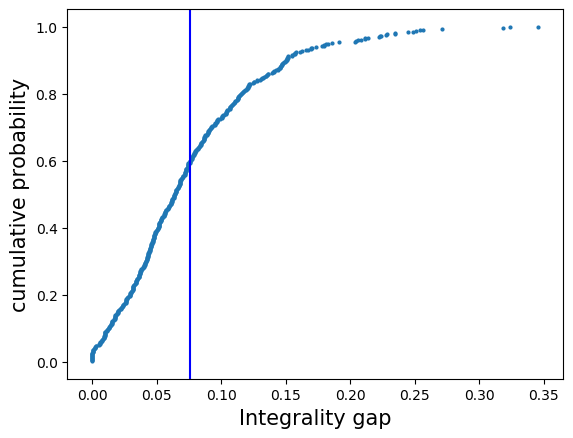

In [172]:
process(data_mn8)

<function matplotlib.pyplot.show(*args, **kw)>

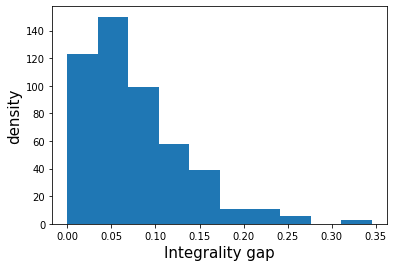

In [107]:
n, bins, patches = plt.hist(data_mn8)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

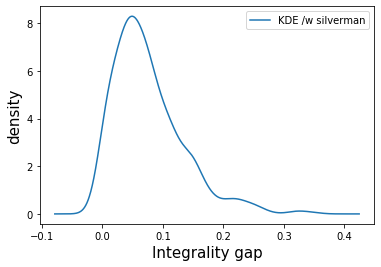

In [108]:
kernelDensity(data_mn8)

In [109]:
data_mn9 = the_loop(5, 600, 500)

[-0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.
 -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  0.  1. -0. -0.  1.  1. -0.
 -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.
  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.
  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  0.  1.
 -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.
  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.
  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1

[0.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         1.         0.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         

[-0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.
  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.
  1. -0. -0. -0.  1.  0.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.
  1. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  0.  1.  1.  0. -0.  1.  1. -0. -0. -0. -0. -0.
  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.
  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.
 -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.
 -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1.  0.  1. -0.
  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.
 -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1

[ 1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0.  1.  1.  0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  0.
 -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.
  1.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.
  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
  1. -0.  1. -0. -0.  1.  1.  0.  0.  1.  1. -0.  1.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.
  1.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.
 -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  0. -0.  1.  1. -0.  1.
 -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  0.  1

[1.         0.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         0.41723936
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.14127858 0.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         1.         1.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         1. 

 1.         1.         1.         0.         0.         1.        ]
Obj: 211.406
211.40554781687595 relaxed 
211.3570229093763 original 
[-0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  0. -0.  1. -0. -0.  1. -0.  1.
  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  0. -0. -0. -0.  1.  1.
  1.  1. -0. -0. -0.  1. -0.  1.  1.  0. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.
  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.  0. -0.  1. -0. -0. -0.
  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  0.  1.  1.  1.  0.  1. -0.
 -0. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.
  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  0.  1.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.
 -0.  1.  1. -0. -0.  1. -0. -0.  0.  1.  1. -0. -0. -0.  1.

[0.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         1.         0.         

[1.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         1.         0.83636231 1.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         1.         1.         1.         

[1.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         

[-0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  0. -0. -0.
  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.
 -0.  1. -0.  0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.
  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  0. -0.  1.
  0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  0. -0.  1.  1.  0.  0. -0.
  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0.  1. -0.  0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.
 -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  0.
  1. -0.  1.  0.  1.  1.  1.  0.  0.  1.  1. -0.  1. -0. -0.  1.  1. -0.
 -0.  0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.
 -0.  0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.
  1.  0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.
  0.  1. -0. -0.  1. -0. -0. -0. -0.  0.  1.  1. -0.  1.  1.  1. -0. -0.
  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1

[ 1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.  1. -0.  1.  1.  1.
  1.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  0.  0.
  0.  1.  1.  0.  0. -0.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.  0.
  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.
  1.  0.  1.  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.  0.  0.  1.  0.  1.
  1.  1.  0.  1.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.
  0.  1.  1.  0.  1.  1. -0.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.  1.
  1.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.
  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.  1.  1.  0. -0.  0.  1.  0.  1.
  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.
  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1.
  1.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  0.
  0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.
  0.  0.  1.  1.  0.  0.  0.  0.  1.  0. -0.  0.  1

[ 0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0. -0. -0. -0. -0.  0. -0.  1. -0. -0.  1.  1.  1.  1.
  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.
  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.
  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.
 -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.
  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0

[0.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         0.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         0.         

[-0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.
 -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
  1.  1. -0.  1. -0. -0.  1.  0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.
  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.
 -0. -0.  1.  1.  1. -0.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1. -0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.
  0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1.
  1.  0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.
  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.
 -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.
  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.
  1.  1. -0.  1. -0.  0. -0. -0. -0. -0.  1. -0.  1

[0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         

[0.         0.         0.         1.         1.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         0.         0.         1.         0.         1.
 1.         1.         1.         0.         0.         1.
 1.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         

[1.         0.         1.         0.         1.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         1.         0.         0.         0.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         

[ 1.  1.  1.  0.  0.  1.  1. -0.  1.  1.  0.  1.  0.  0.  0.  0. -0.  1.
  1. -0.  1. -0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0.
  0.  0.  1.  0. -0.  1.  0.  1. -0.  1.  0.  1.  1.  1.  1.  1.  0.  0.
  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.
  0.  1.  1.  0.  1.  0.  1.  1.  1.  0.  1.  0.  0.  1.  0.  1.  0.  0.
  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0. -0.  1.  0.  1.  1.
  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.
  1.  0.  0.  1. -0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0. -0.  1.
 -0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.
  1.  0.  0. -0.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  0.  0.  1.  1.
  1.  1.  0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1. -0.  0.  0.  1.  1.
  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  0.
  0.  1.  0.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.
  1.  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.  0.  0

[ 1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.
  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1.
 -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  0. -0. -0.
 -0.  0. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.
 -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.
 -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  0.  1.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.
 -0.  1.  1.  1.  0. -0.  1. -0.  1.  1. -0.  1.  1

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0.
 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0.
 0. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1.
 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 1. 0.
 1. 1. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0.
 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0.
 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0.
 0. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1.
 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1.
 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 1. 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0.
 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 0. 0.
 1. 0. 0. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 1.
 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0.

[-0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.
 -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.
 -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.
 -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  0. -0. -0.  1.  1. -0. -0. -0.
  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.
  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.
  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.
 -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.
 -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0.
  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.
 -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0

[1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         

[0.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         0.51326433
 1.         1.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         0.         1.
 0.         1.         1.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         1. 

 -0. -0.  1. -0.  1.  0.]
Obj: 233.825
[1.         1.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         0.31057448 0.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         1.   

[1.         0.         0.         1.         1.         1.
 0.         1.         1.         1.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.10018255 0.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         

[ 0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  0.  1.  0.
  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  0.  0.
 -0.  1.  1. -0. -0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.
 -0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.  1.  1.
  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.
  0.  1.  0.  1.  1.  0.  1.  0.  0.  0. -0.  0.  0.  0.  1.  1.  0.  0.
  1.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  1.  0.  1.
  0.  1.  0.  1.  0. -0.  1.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.
  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.
  0.  1.  1.  1.  0.  0.  1. -0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.
 -0.  1.  0.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  1.  0.  1.
  0.  0.  0.  1.  0.  1.  0.  1.  1.  0.  0.  0. -0.  0.  0.  0.  0.  1.
  0. -0.  0.  0. -0.  0. -0.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.
  0.  0.  1.  0.  1.  1.  1.  1.  0.  0.  1.  0.  0

[-0.  1.  0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  1.  0.  0.
  0.  0.  1.  0.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.  1.
  1.  1.  1.  1.  1.  1.  0.  1.  1.  0. -0.  1.  1.  1.  1.  0.  1.  1.
  0.  0.  0.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  0.
  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  0.  0.  0. -0.
  0.  1.  1.  1.  0.  1.  1.  0.  0. -0.  0.  0.  1.  0.  0.  1.  0.  0.
  1.  0.  0.  1.  0.  1. -0.  0.  0.  0.  1.  0. -0.  1.  1.  1.  1.  1.
  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.
  1.  1.  0.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.
  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.
  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  0.  1.
  1.  0.  1.  0.  1.  1. -0.  1.  0.  0.  1.  0.  1. -0.  1.  1.  0. -0.
  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.
  0.  1.  1.  0.  1.  0.  0.  1.  1.  0.  0.  1.  1

[ 1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.
 -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  0. -0. -0.  1. -0. -0.  1.
  1. -0. -0. -0. -0.  1. -0.  0. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.
 -0.  1. -0.  1.  1.  0. -0.  1.  0. -0.  1. -0.  1.  1. -0. -0. -0.  1.
 -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.
 -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.
  1. -0.  1.  1.  0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0.
  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.
  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.
  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.
 -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.
 -0. -0. -0.  0. -0.  1. -0. -0. -0. -0.  1.  1. -0

[ 1.  1.  1.  1. -0.  1.  1.  1. -0.  0. -0. -0. -0. -0.  1. -0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.
  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  0.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.
  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.
  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.
  1.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.
 -0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.
  1. -0. -0.  0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.
  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.
  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.
  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.
  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1

[ 1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.
  0.  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  0.  0.
  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0. -0.  0.  1.  1.  1.  0.  0.
  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.
  0.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.  0.
  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  0.  0.
  1. -0. -0.  1.  1.  1.  0.  1.  0.  1.  0.  0.  0.  1.  0.  0.  0.  1.
  1.  1. -0.  1.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1. -0.  1.
  0.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  0.  1.  1.  0.
 -0.  0.  0.  1.  0.  0.  1.  0.  0. -0. -0.  1.  1.  0.  1.  0.  0.  1.
  0.  0. -0.  1.  1.  0.  0.  0.  1. -0.  1.  0.  1.  1. -0.  0.  0. -0.
  0.  1. -0.  1.  1.  0.  1.  0.  1.  1.  1.  1. -0.  0.  1.  1.  1.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  0.  0.  1.  1.  0.  1.
  1.  1.  0.  0.  0.  0.  0.  0.  0. -0.  1.  0.  1

[0.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.74753491 0.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         0.         1.         1.         1.         

[1.         1.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         0.         0.         0.         

[1.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         0.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         

[ 1.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.
  1.  1.  1. -0.  1.  0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  0. -0.  1.
 -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  0. -0. -0. -0.  1.  1.  1. -0.
 -0.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.
  1.  1.  0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.
  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  0.  1.  1.  1.  0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.
  1. -0.  0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.
 -0. -0.  1.  1.  0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.
  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.
 -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  0.  1. -0.  0.  1.  1. -0.
  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1

[0.         1.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         1.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         0.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.         1.         0.         0.         0.         

[-0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  0. -0.  1.  1. -0.  1.  1.
  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.
  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.
  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  0.
  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.
  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0.  0. -0.  1.  1. -0.
 -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.
  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.
  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.
  1.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0.  1.  1.  1. -0.  1.  1.  1.  0.  1. -0.  1.  1. -0.  1. -0.  1.
 -0. -0. -0.  1.  1. -0. -0.  0.  1.  1.  1. -0. -0

[ 1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.
  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.
  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1.  0.
  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.
  1. -0.  1. -0.  1. -0.  0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.
  1.  1. -0.  0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.
 -0.  1. -0.  1.  1. -0.  1.  1. -0.  0.  1. -0. -0.  1. -0.  1. -0.  1.
 -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.
  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  0. -0.  1.
  1. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0.
  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1

[1.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         

[ 1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.
  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.
 -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.
 -0.  0.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.
 -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.
  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.
 -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.
  0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
 -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.
  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.
 -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.
 -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.
  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0

[-0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.
  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.
 -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.
 -0.  0. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.
  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.
 -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  0. -0.
  1. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.
 -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  0. -0. -0.  1. -0. -0.
  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.
 -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.
  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.
 -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0

[0.        1.        0.        0.        1.        0.        0.
 0.        0.        1.        0.        0.        0.        1.
 1.        0.        1.        1.        1.        0.        0.
 0.        0.        0.        1.        1.        1.        0.
 0.        0.        0.        1.        1.        0.        0.
 0.        0.        1.        1.        0.        1.        0.
 0.        1.        1.        1.        0.        1.        0.
 1.        1.        0.        0.        1.        0.        1.
 0.        1.        0.        1.        1.        1.        0.
 1.        1.        1.        1.        1.        1.        0.
 0.        0.        1.        0.        0.        1.        1.
 1.        1.        1.        1.        1.        1.        1.
 0.        0.        1.        0.        0.        0.        1.
 0.        1.        1.        1.        0.        1.        1.
 0.        1.        0.        1.        1.        1.        0.
 1.        0.        1.        1.       

[ 1.  1.  1.  1.  1.  0.  0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.
 -0. -0. -0.  1.  1.  1.  1.  1.  0.  1.  1. -0. -0.  1.  1. -0.  1. -0.
  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.
 -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.
  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.
  0.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  0.  1. -0. -0.
 -0. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.
  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.
  0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.
  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.
 -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.
  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0

[-0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.
  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.
  1. -0.  0. -0.  1.  0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.
  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.
 -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.
  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.
  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.
  1. -0.  0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.
  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1

[1.         1.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         1.         0.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         1.         

[ 1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1.
 -0. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.
 -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.
 -0. -0.  1. -0. -0.  0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.
 -0. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.
 -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.
 -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.
  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.
  1. -0.  1.  0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.
 -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  0. -0.  1

[ 1.  1.  1.  0.  0.  1. -0.  0. -0. -0.  1.  1.  1. -0.  0.  1.  1. -0.
  0.  0.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.
  0.  1.  1. -0.  1.  1.  1.  0.  0.  1. -0.  1.  1.  1.  0.  0.  0.  0.
  0.  0.  0.  1.  1. -0.  1.  1.  0.  0.  1.  1.  0.  1.  0. -0.  1.  1.
  1. -0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.
  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1. -0.  1.  0.
  1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  0.
  1.  1.  0.  0.  1. -0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.  0.  1.
  0.  1.  0. -0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  0.
  0.  1.  0.  1. -0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.
  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.
  0.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1. -0.  0.  0.  1.  0.  0.  1.
  1.  0.  0.  0.  0.  1.  1. -0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.
  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0

[ 1.  0.  0.  0.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.
  0.  0.  1.  0.  1.  1.  0.  1.  0. -0.  0.  1.  1.  0.  1.  1.  1.  0.
  1.  0. -0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1. -0.  0.  0.  1.
  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  0.
  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  0.  0.  0.
  0.  0.  1.  1.  0.  0. -0.  1.  1.  0.  1.  1.  1. -0.  1.  1.  0.  0.
  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  0.  1.  1.  1.  0.  1.  1.  0.
  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.
  0. -0. -0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0.  1.  1.  1.  0.
  0.  0.  1.  0. -0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  1.
  0.  0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.  1.
  1.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1. -0.  1.  1.  0.  0.  0.  1.
  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.
  0.  0.  1.  0.  0.  0. -0. -0.  1.  0.  1.  0.  0

[0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         1.
 1.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         1.         1.         1.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         0.         

[-0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.
  0. -0.  0.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.
 -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  0.  1.  1.  1. -0.  1.  0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.
 -0.  1.  1. -0.  1. -0. -0. -0.  0.  1. -0. -0. -0.  1. -0. -0. -0. -0.
 -0.  1. -0. -0.  0.  1.  0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.
 -0. -0.  1.  0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  0.  1. -0. -0.
  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.  0. -0. -0.  1.  1.  1.  1.  1.
 -0.  1.  1.  1.  1.  1. -0.  0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  0.  1. -0.
 -0. -0.  1.  1. -0.  1. -0.  1. -0.  0. -0. -0.  1.  1.  1.  1. -0.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.
 -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0

[-0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  0. -0. -0.  1.
 -0.  0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  0. -0. -0.  1. -0. -0. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0. -0.  1. -0.  0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.
 -0.  1. -0. -0. -0.  1.  0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.
 -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.
  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  0. -0.  1.
 -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.
  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.
 -0. -0.  0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.
  1.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0

[0.        0.        1.        1.        0.        1.        0.
 1.        0.        1.        0.        0.        1.        1.
 1.        1.        0.        0.        1.        0.        1.
 0.        0.        0.        0.        0.        0.        1.
 0.        0.        1.        1.        0.        0.        0.
 1.        0.        1.        0.        1.        0.        1.
 0.        0.        0.        1.        1.        0.        0.
 0.        0.        1.        1.        0.        0.        1.
 1.        0.        0.        1.        0.        1.        0.
 1.        1.        1.        1.        0.        0.        1.
 1.        0.        1.        0.        1.        1.        0.
 0.        1.        1.        1.        0.        0.        0.
 0.        0.        0.        1.        1.        1.        0.
 1.        1.        1.        0.        1.        1.        1.
 1.        1.        1.        0.        1.        0.        1.
 0.        0.        0.        1.       

  1.  1.  1.  1.  1.  1.]
Obj: 223.055
[1.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         0.         1.         1.
 1.         0.   

[0. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0.
 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 0. 1.
 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1.
 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0.
 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1.
 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1.
 1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0.
 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0.
 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0.
 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1.
 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 1. 0.
 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1.

[-0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.
 -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.
 -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.
 -0.  0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.
 -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0.
 -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.
  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.
  1.  1.  1.  1.  0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  0. -0.  1.  1. -0.  1. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.
 -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  0.  1.  1. -0.  1. -0.
  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  0.  1.  1

[0.         0.56924574 0.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         0.         0.
 1.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.         1.         0.         0.         0.         

[0.         1.         0.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.01502406 0.         1.         1.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         1.         

[ 1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.
  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
 -0.  1.  0.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.
  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1.
  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.
  1. -0. -0.  1.  1. -0.  0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.
 -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.
  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1.
  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.
 -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  0. -0. -0.
 -0.  0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  0.  1.  1. -0.  1.  1. -0.  1.
 -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.
  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0

[-0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.
 -0.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.
  1.  1.  1.  1.  1.  1. -0.  1.  0.  1.  0.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0. -0. -0.  0.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.
  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.
  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.
  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.
  1.  1. -0.  1. -0.  1. -0.  0. -0.  1. -0. -0. -0. -0.  1.  1.  0.  1.
  1.  1.  1.  1.  1.  0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.
 -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  0. -0.  1. -0. -0. -0.
 -0.  1.  1. -0.  1.  0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1

[-0.  1.  0. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  0. -0. -0.  1.
 -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1.
  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.
  1. -0. -0.  0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.
  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.
  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.
 -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.
  1.  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.
 -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.
  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.
  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0

[-0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.
 -0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.
  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.
  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.
 -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.
  0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  0.  1.  1. -0.  1.  1.  1.  1.
  1.  1. -0. -0. -0.  1. -0.  1.  1.  0.  1.  1. -0.  1.  1.  1.  1.  1.
  0. -0. -0. -0.  1. -0. -0.  0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.
  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.
 -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.
 -0.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  0. -0.  1. -0. -0.  1.
 -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0

[ 1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.
 -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.
  1.  0. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.
  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.
  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.
  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  0.  1.  1.  1.  1. -0.  1.
 -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.
 -0. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.
  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.
 -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.
  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0.  0. -0. -0.  1. -0.  1.
 -0.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.
  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0

[ 0.  0.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  0.  1.
  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  0.  0.  0.
 -0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  0.  0.
  0.  0.  0.  1.  0.  1.  1.  0.  0. -0.  1.  0.  0.  1.  0.  0. -0.  0.
  1.  1.  1. -0.  1.  0.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.
  0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1.  0.  1.  0.  0.
  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  0.
  0.  0.  0.  0.  0.  0.  1.  0. -0.  0.  1.  1.  0.  1.  1.  1.  1.  1.
  1.  0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  0.
  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1.  0.
  0.  0.  0.  0.  1.  0.  1.  0.  1. -0.  0.  1.  1.  1.  1.  0.  0.  0.
  0.  1.  1.  0.  1.  0.  0.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.
  0.  1.  1.  1.  1.  1.  1.  0.  1. -0.  0.  0.  0.  0. -0.  0.  0.  1.
  0.  1.  1.  0. -0.  1.  1.  0.  1.  1.  1.  0.  1

[-0.  1.  1. -0.  1. -0.  1. -0.  1.  0.  1.  1. -0.  1.  1. -0. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.
  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1.
 -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.
 -0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.
 -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0. -0.  0. -0.  1. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.
  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.
 -0.  1.  1. -0.  1.  1. -0. -0.  1.  0.  1.  1.  1.  1. -0.  1.  1. -0.
  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.
  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  0. -0.  1. -0.  1.
  1. -0.  1.  0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1

 -0.  1. -0. -0.  1. -0.]
Obj: 218.503
[0.         1.         1.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.15554656 1.
 1.         1.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.   

[ 1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.  1. -0.  0.
  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.
  0.  1.  1.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.
  1.  0.  1.  0.  0.  1.  1.  1. -0.  0.  0.  1.  0.  0. -0.  1.  1.  1.
  0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.
  0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1. -0.
  0.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  0.  0.
  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.
  0.  0.  0.  0.  1.  1.  0.  0.  0. -0.  1.  1.  1.  0.  0.  1.  1.  1.
  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.  1.
  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.
  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0.
  0.  0.  1. -0.  1.  1.  0. -0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.
  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0

[ 1.  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  0.  1.  1.  0. -0.
  1.  1.  1.  1. -0.  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.
  1.  0.  0.  0.  0.  1.  1.  1.  1. -0.  0.  0.  1.  1.  1.  1.  1.  0.
  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0.  1.  1. -0.
  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  0. -0.  0.
  0.  0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  1.  1. -0.  1.  0.
  1.  1.  0.  1. -0.  1. -0.  1.  0.  0.  1. -0.  1.  1.  1.  1.  1.  0.
  1.  1.  0.  1.  1.  1. -0.  1.  0.  1.  1.  1.  0. -0.  0.  0.  0.  0.
  0.  0.  1.  0.  0.  0.  1.  1.  0.  1. -0.  1.  1.  0.  0.  0.  0.  1.
  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.
  0.  1.  0.  1.  0.  1.  1.  1.  0. -0. -0.  1.  0.  0.  0.  1.  1.  1.
  0.  0.  1.  0.  0.  1.  0. -0.  1.  1.  1.  1.  1.  0.  1.  0.  1.  1.
  1.  0.  1.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0. -0.  1.  0.
  0.  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  1

[ 1.  0.  0.  0.  1.  1.  1.  1.  0.  0.  1.  1.  1.  0.  1.  1.  0.  0.
  0.  1.  1.  1. -0.  0. -0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.
 -0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.
  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.
  1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  1. -0.  0.  0.  0.  0.
  1.  1.  0.  1.  0. -0.  1.  0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  1.
  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  0.  1.  0.  0.  1.  0.  1.  1.
  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1. -0.  0.  1.  1.  0.  1.
  0.  1.  0.  0.  1.  1.  0.  1.  1.  1. -0.  1. -0.  0. -0.  1.  0.  1.
  1.  1.  1.  1.  1.  0.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  0. -0.
  0.  0. -0. -0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  0.  1.  1.
  1.  1.  0.  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  0.  0.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.
  1.  0.  1.  1.  1.  1.  0.  0.  1.  0.  0.  1.  1

[ 0.  0.  0.  0.  0. -0.  1.  0.  1.  1.  1.  0.  1. -0.  0.  0.  1.  1.
  1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.
  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1.  0.  1.
  0.  1.  0.  1.  0.  1.  1.  0.  0.  1. -0.  1. -0.  0.  0.  1.  0.  0.
  0.  0.  1.  0.  1.  1.  0.  0.  0. -0.  0.  1.  0.  1.  0.  1.  1.  0.
  0.  1.  1.  0.  1.  0.  0. -0.  1.  1.  0.  0.  0.  1.  0.  1.  0.  0.
  0.  0.  1.  1.  0.  0.  1.  0.  0. -0.  0.  1.  1.  1.  1.  0.  1. -0.
 -0.  0.  1.  0.  1.  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.
  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  1. -0.  1.  1.  1.  0.  0.  0.
  0.  1.  0.  0.  0. -0.  1.  0.  0.  1. -0.  1.  1.  1.  1.  1.  1.  0.
  0. -0.  0.  0.  0.  1.  0.  1.  0.  1.  1.  0.  0.  1. -0.  0.  0.  0.
  1.  1.  1. -0.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  1.
  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.
  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  1

[1.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.43481286 0.         0.         1.         

[ 0.  1.  0.  1.  0. -0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.
  0.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.
  0.  0.  0.  1.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.
  0.  0.  0.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  0.
  0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  0.  1.  0. -0.
  0.  1.  1.  1.  1.  1.  1.  0. -0.  1.  0.  1.  1. -0.  1.  0.  1.  1.
  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  1. -0.  1.  0.  0.  0.  0.
  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.  0.  1.
  0.  0.  1.  1.  1.  0. -0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.
  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.
  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  0.  1.  0.
  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  0.  1.
  0.  0.  0. -0. -0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.
  0.  1.  1.  0.  0.  0.  1.  1.  0.  1.  0.  1.  0

[ 1.  0.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0. -0.  0.  0.
  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.
  1.  1.  0.  1.  0.  0.  0.  1.  1. -0.  1.  1.  0.  1.  0.  0.  1.  1.
  1.  1.  0.  0.  0.  1.  0.  0.  1. -0.  1.  1. -0.  0. -0.  1.  0.  0.
  0.  1.  0.  1.  1.  1.  0. -0.  0.  0. -0.  1.  1.  0.  1.  1. -0.  0.
  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.  1.
  0.  0.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  0.  0. -0.
  0.  0.  1.  0.  1.  1.  1.  0.  0.  0. -0.  1.  0.  1.  1.  0.  0.  1.
 -0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.
  0.  0.  1.  0.  0.  0. -0.  0.  0.  1.  1.  0.  1.  0.  0.  1.  0.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.
  1.  1. -0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.  1. -0.  1.
  0.  1.  1.  1.  0.  0.  1.  0.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.
  1.  1.  0.  0.  0.  1.  0.  0.  1.  0. -0. -0.  0

[ 1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.
 -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.
  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.
 -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0.  1.
 -0. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.
  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  0.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.
  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.
 -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.
  1.  1.  1. -0. -0.  0.  1.  1. -0.  1. -0.  1.  0.  1. -0. -0.  1.  1.
 -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.
  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  0. -0. -0. -0.
 -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1

[ 1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.
  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  0.  1. -0.  1.  1. -0.  1.  1.
 -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.
  1.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.
  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  0. -0. -0. -0.
  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.
  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.
  1. -0.  1.  0.  1.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.
  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0

[ 1.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.
 -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
 -0.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.
  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.
 -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.
  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.
  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.
 -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.
  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.
  1. -0.  1.  1.  0. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.
 -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.
  1.  0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.
  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0

[ 1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1. -0.  1. -0.
  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.
  1.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.
  1.  0.  0.  1.  0.  1.  0.  1.  0.  1.  0.  0. -0.  0.  0.  0.  1.  0.
  0.  0.  1.  1.  1.  1.  1.  1.  0. -0.  1.  1.  0.  1.  1.  0.  1.  1.
  0.  1.  0.  0.  1.  0.  0.  0. -0.  0.  0.  1.  0.  0.  0.  0.  0.  1.
  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.  1.  0.  0.  1.
  0.  0.  0.  0.  0. -0.  0.  1.  0.  1.  0. -0.  1.  0.  0.  0.  1.  1.
  1. -0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0. -0.  0.  0.  1.
  0.  0.  1.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.  0.  0.  1.  0.
  0.  0.  1.  0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.
  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.  0.  1.  0.
  1.  1.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  0.  0.
  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.  0.  1

 1.         0.         0.         0.         0.         1.        ]
Obj: 273.025
273.024555996765 relaxed 
272.97422563210716 original 
[ 0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.  1.
  1.  1. -0.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.  0.
  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  0.  1.  1.
  0.  0.  0.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  1.  1.
  1.  0.  0.  0. -0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.
  1.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.
  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  1.
  1.  0.  1.  1.  1.  0.  0.  1.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.
  0.  1.  1.  1.  1.  0. -0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.
  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.
  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1. 

[ 1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0. -0.  0. -0.
  1. -0. -0. -0.  1.  1. -0. -0. -0.  0.  1.  0.  1. -0. -0. -0. -0.  1.
  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.  0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.
 -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.
 -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1.
  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.
 -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.
  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.
  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  0.  1.  1. -0. -0.
 -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  0.  1.  0

[0.         0.         1.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         0.59513306 0.         1.         0.         1.
 1.         0.         1.         0.         1.         

[ 0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  0.  0.  1.  0.  0. -0.  0.  0.
  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0.  1.  0.
  1.  0.  1.  1.  1. -0.  0.  0.  0.  1.  1.  0.  0.  1. -0.  0.  0.  1.
  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.
  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.  0.
 -0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.
  1.  0.  1.  0.  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.
  1.  0.  0.  1.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.
  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.  1.  0.
  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.
  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.
  0.  0.  1.  1. -0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.
  1.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  0.  1.  0.  1.  0.
  0.  1.  1.  1.  0.  0.  0.  1.  0.  0.  1.  0.  1

[1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         0.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         0.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         

[ 1.  1.  0.  1. -0.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  0.  0.  1.
  1.  1.  0.  1.  1.  1.  0.  1.  0.  0.  0. -0.  1.  1.  1.  0.  1.  0.
  0.  0. -0.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  1. -0.  0.  1.  0.
  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  0.  1.  1.
  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.
  1.  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.
  0.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1.  1.  0.  1.
  0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1.
  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  1.  0.  1. -0.
 -0.  1.  1.  1.  1.  0.  1. -0.  0.  1.  1. -0.  1.  0.  0.  1.  0.  0.
  0.  0. -0.  0.  1.  1.  1.  0.  0. -0.  0.  0.  1.  1.  1.  0.  0.  1.
  1.  0.  0.  1.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  1.
 -0.  0.  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  1.
  1.  1.  1. -0.  1.  1.  1.  1.  0.  1.  0.  0.  1

[0.         0.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         1.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         1.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         1.         

[ 0.  0.  1.  1.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0. -0.  0.  1.
  1.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1. -0.
  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.  1.  0.  1. -0.  0.  0.
  0.  0.  0.  0.  1.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.
  0.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.
  0.  0.  0.  0.  1.  1.  1.  0.  0.  0.  1.  0. -0.  0.  1.  0.  0.  1.
  1.  1.  1.  1.  0.  1.  1. -0.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.
  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  0.
  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  0.  0.  0.  1.
  0.  1. -0.  0. -0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.
  0.  1. -0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.
  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  0.  0.
  1.  1.  0.  1. -0.  1.  1.  0.  0.  1.  0.  0.  1.  1.  1.  1.  1.  0.
  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1

[ 1.  1.  0.  0.  1.  0.  1. -0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.
  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1. -0.  0.  1.
  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.  1.
  1. -0.  1.  1.  0.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.
  0.  1.  0.  1.  0.  0.  1. -0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.
  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  0. -0.  1.  1.  0.  0.
  0.  1. -0.  0.  0.  0.  0. -0.  1.  1.  0.  0. -0.  1.  0.  0.  0.  1.
  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.
  1.  0.  1.  0.  1.  0.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.
  0.  1.  1.  0. -0.  0.  1.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.
  1.  0.  1.  0.  0.  0.  0.  1.  0. -0.  1.  1.  0.  0.  0.  1.  1.  1.
  0.  1.  1.  0.  0.  0. -0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.
  0.  0.  0.  0. -0.  1.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  1.  1.
  0.  0.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  0

[ 0.  1. -0.  0.  1.  0.  1.  1. -0.  0.  1. -0.  0.  1.  1.  0.  0.  1.
  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  1.  0. -0.  1.  0.  1.  1.
  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0.  1. -0.  1.
  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  1. -0.  0.  1.
  1.  1.  1.  0.  0.  0.  0.  1.  1. -0.  1.  1.  0.  1.  1.  0.  1. -0.
 -0.  0.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0. -0.  0.  0.  1.  1.  0.
  1.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1. -0.  1.  1.  0.  0.  1.  0.
  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.
  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.
  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.
  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.  0.  0.  1.  0. -0.  1.  1.
  1.  0.  0.  1.  0.  0.  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.
  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  0.  0.  1.  0.  1.  0.  1.  0.
  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0

[-0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.  0. -0.  1. -0. -0.
  1. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.
 -0. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.
  1. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  0. -0.  1.  1.  1.  0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.
  1.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1.
  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.
 -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.
  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.
  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.
  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.
 -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1

  1.  1.  1.  1.  1. -0.]
Obj: 253.478
[1.         1.         1.         1.         0.14020171 1.
 0.         0.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.         0.         1.         0.         0.
 0.         0.         0.         1.         0.         1.
 1.         1.         1.         0.         0.         1.
 1.         1.         1.         0.         1.         1.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.   

[-0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1.
 -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  0.  1. -0.  0. -0.
  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.
  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.
 -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.
  1.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.
  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  0.  1. -0. -0.  1.
  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.
  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.
 -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.
  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0

[ 0.  1.  1.  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.
  0.  1. -0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.
  0.  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.
  0.  0.  0.  0.  1.  1.  1.  0.  1.  1. -0.  1.  1.  0.  0.  0.  1.  0.
 -0.  0.  0.  0.  1.  1.  0.  0.  0.  1.  0.  1.  0.  0. -0.  1.  0.  1.
 -0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.
  0.  0.  0.  1.  0.  0.  1.  0.  0. -0.  1.  0.  0.  0.  0.  1.  1.  1.
 -0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  0.  1.  1.
  0.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.  0.  0.  1.  0.  1.  0.
  0.  0.  0.  0.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.
  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.  0.  1.  1.  0.
  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.  0.  0.  1.
  1.  0.  0.  0.  0.  1.  1.  0.  1.  0.  1.  1.  1

  0.  1. -0.  1. -0.  1.]
Obj: 257.037
[0.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         1.         1.
 0.         1.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 1.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         0.         1.
 1.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.   

[ 1. -0.  0.  1. -0. -0.  1.  1.  0.  1.  1.  1. -0. -0.  1.  1.  1.  1.
  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.
  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.
  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.
  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.
 -0. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.
  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.
 -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  0. -0. -0. -0.  1. -0.  1.
  1.  1. -0.  1. -0.  1. -0.  1.  1.  0.  1. -0. -0.  1. -0. -0. -0.  1.
  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  0.  1.  1. -0. -0.
  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.
  1. -0.  1.  1.  0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1. -0.
  1. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1.
 -0. -0.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1

[0.         1.         1.         1.         1.         0.
 0.         1.         1.         0.         1.         0.
 0.50201139 0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         1.         1.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         

  1.  1.  1. -0.  1. -0.]
Obj: 202.904
[0.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         1.         1.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         0.   

[ 1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.
  0. -0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0.
 -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.
  0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.
 -0. -0. -0.  1.  1. -0.  0.  0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.
 -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.
  1. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0.
 -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.
  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.
  1.  1.  1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  0

[1.         1.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         0.         1.
 0.         1.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         1.         0.
 1.         0.         0.         1.         1.         

[ 1. -0.  1.  1. -0.  1. -0.  1. -0.  0.  1.  1. -0.  1. -0. -0. -0.  1.
  1.  1. -0. -0.  1.  0. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.
 -0.  0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  0. -0.  1. -0.
  0.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.
 -0. -0.  1. -0. -0. -0.  0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.
 -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.
  1.  1.  1.  0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.
  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.
 -0.  0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.
  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.
  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.
  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0.  0.  1.  1. -0.
  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1

[1.         1.         1.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         1.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         0.         

[-0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.
  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1.
  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.
  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  0. -0.
 -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1.
 -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.
 -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  0.  1. -0.  1.
  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.
 -0.  1.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
  1. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.
 -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.
 -0. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1

[ 1.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.  0.
  0.  1.  0.  0.  0.  1.  0.  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  1.
  1.  1.  0. -0.  1.  0.  0.  0.  1. -0.  1.  0.  1.  1.  0.  1.  1.  0.
  0.  0.  1. -0.  0.  1.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.
  1.  1.  1.  0. -0.  1.  0.  1. -0.  1.  1.  1.  0.  0.  0.  0.  1.  0.
  1.  0.  1.  1.  0.  1. -0.  1.  0.  0.  1.  1.  1.  0.  1. -0.  0.  1.
  1.  0.  1. -0.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  0.  0.
  1.  0.  0.  1.  0.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  1.
  1.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  1.  0.
  1.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.  0.
  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  1.
  1.  1.  1.  0.  0.  1.  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.
  1.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  0.  0.  1.
 -0.  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1

[ 0.  1. -0.  1.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.
  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  1.  1.  0.
  1.  1. -0.  1.  1.  0.  1.  1.  0.  1.  1.  0. -0.  0.  1.  0. -0.  0.
  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1. -0.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  0.  1.  1.  1. -0.  1.  0.  1.  1.  1.  1.  1.  0. -0.
  1.  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  0.
  1.  0.  1. -0.  0.  1.  1.  0.  0.  0.  1.  1. -0.  0.  1.  0.  1.  0.
  1. -0.  0.  1.  1.  0.  0. -0.  0.  1.  1.  1.  1.  0.  1.  0.  0.  0.
  0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.
  0.  1.  1.  1.  1. -0.  0.  0.  0.  1.  0.  0.  0.  0.  1. -0.  1.  1.
  0.  1.  1.  1.  0.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.  0.  0.  1.
  0.  1.  1.  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1.  0.  0.  0.  1.
  0.  1.  0.  0.  1.  0. -0.  0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  0.
  0.  0.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1.  1

[1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 1.         0.         1.         0.         0.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         0.         0.         1.         0.         

[1.         0.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         1.
 0.         0.         1.         1.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         1.         1.
 0.         0.         0.         0.47016096 1.         0.
 1.         0.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 1.         0.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         0.         0.         0.         0.         

[0.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         1.         0.         1.
 1.         0.         0.         1.         1.         1.
 0.37819532 0.         1.         1.         1.         

  1.  1. -0. -0.  1.  1.]
Obj: 219.804
[1.         1.         0.         1.         0.         0.
 0.         1.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         0.         1.         1.         1.
 0.         0.         0.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         0.         0.         1.
 0.         1.         1.         1.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.         1.         1.         1.         0.22740775
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 1.      

[ 1. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  0.  1. -0.  1. -0. -0.  1.
  1. -0.  1.  0. -0.  1. -0.  0. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0.
  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0.
  1. -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.
 -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1.
  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.
 -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1.
 -0.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  0.
 -0.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0.
 -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.
  0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0

[ 0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.
  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.
  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.  0.  0.
 -0.  1.  0.  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  0.  0.  1.
  1.  1.  1.  1.  1.  0.  0.  1.  0.  1. -0.  0.  1.  1.  0.  0.  0.  1.
  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.
  1.  1.  0.  1.  1. -0.  0.  0.  1.  1.  1. -0.  1.  0.  0.  0. -0.  0.
  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  0.  0.  1.
 -0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1. -0.  1.
  1.  0.  1.  1.  1.  0. -0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.
  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.
  0.  0.  0.  1.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  1.
  1.  1.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  0.  0.
  1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0.  0

[1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0.
 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1.
 1. 0. 1. 1. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 0. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1.
 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0.
 1. 1. 1. 1. 1. 1. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0.
 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 1.
 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0. 0.
 1. 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1.
 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1.
 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 1.
 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 0. 0. 1. 0. 1. 0. 1. 1. 1. 0. 0. 1.
 0. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1.
 0. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1.

[ 1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.
  1.  1.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.
 -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.
  1. -0. -0. -0. -0.  1.  1.  1.  0. -0.  1. -0.  1. -0. -0.  1.  1. -0.
  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0.
  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.
 -0. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0. -0.  1. -0.  1.  1. -0. -0.  0. -0.  1.  1. -0.  1.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  0.  1.  1.  1.  1.  1. -0. -0

[-0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1.  0.  1.  1. -0. -0.  1.
 -0. -0. -0. -0.  0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.
 -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.
 -0.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.
  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0.
  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.
  1.  1.  1.  1. -0.  0.  1.  1.  0. -0.  1. -0.  1. -0.  0.  1.  1. -0.
 -0.  1.  1. -0.  1.  1.  1. -0.  1.  0. -0. -0. -0.  1. -0.  1. -0.  1.
  1. -0. -0.  1. -0.  0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.
  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1.
 -0. -0.  1. -0.  1.  1.  1.  1. -0. -0.  1. -0. -0

[ 1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.
  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1.
 -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  0.
  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0. -0.
  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.
 -0. -0. -0.  1.  1.  1.  0.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  0. -0.  1.  1.
  1.  0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.
 -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.
  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
 -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0.  1

[ 1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.
 -0.  1.  0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.
  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.
  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  0. -0.  1.  1. -0.  1. -0.
  1. -0. -0.  1.  1. -0.  1. -0.  1.  0. -0. -0. -0. -0. -0.  1.  1. -0.
  1. -0.  1. -0.  0. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0.
 -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  0.
 -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  0.  1.  1.
  1.  1. -0.  1.  1.  1.  0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1.
 -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1.
  1. -0.  1.  1.  1. -0. -0.  1.  0. -0.  1.  1. -0.  1. -0.  1. -0.  0.
  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0. -0.
 -0. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1

[ 1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0. -0.
  1.  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.  0.  1.
  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  1.  1.  0.  0.  1.  0.  0. -0.
  0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.
  1.  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.  0.  0.
  1.  0.  1.  1.  0.  0.  1.  0.  1.  0. -0.  0.  0.  0.  1.  1.  1.  1.
  1.  0.  0.  1.  1.  0.  0.  0.  1.  1.  1.  0.  0.  0.  0.  0.  1.  0.
  0.  0.  1.  0.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.
  1.  1.  0.  1.  1.  0.  0.  0.  0.  0. -0.  0.  1.  0.  0.  1.  0.  1.
  1.  1.  0. -0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.
  0.  1.  0.  1.  0. -0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  1.
  0.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.
  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.
  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.  0.  1

[-0.  0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.
 -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.
  1. -0.  0.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.
 -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1.
 -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1.
 -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.
 -0.  1.  1. -0.  0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.
 -0. -0.  1. -0.  1.  1.  1. -0.  1.  0.  1.  1. -0.  1. -0.  1. -0. -0.
 -0. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.
  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.
  1. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  0.
 -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1

[ 1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0.
  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.
  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.
  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.  0. -0. -0.  1.  0.  1.
  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.
  1. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.
 -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.
  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0. -0.
  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.
  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.  0. -0. -0.  1. -0.
  1. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.
 -0. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.
 -0.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0. -0.  1.  1.  0. -0. -0.  1.  1

[-0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.
 -0. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
 -0.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.
  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.
 -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  0.  1.  1.  1. -0.  1.  1.  1.
 -0. -0.  1. -0.  1.  0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1.
  1. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.
  1.  1.  0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
 -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.
  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.  1.
 -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  0. -0.
  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.
 -0. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.
 -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1

[ 0.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  1.  0.  0.
  0.  1. -0.  1.  1.  0.  1.  0.  1.  0.  1. -0.  1.  1.  1.  1.  1.  1.
  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.  0.
  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1.  1.  0.  0.  1.  1.  0.  0.
  1. -0.  1.  0.  1.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  1.  0.  0.
  1. -0.  0.  1. -0.  0.  1.  0. -0. -0.  0.  0.  0.  1.  1.  0.  1.  0.
  0.  1.  0.  1.  1.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  1.  0.
  1.  0.  1. -0.  1. -0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  1.  1.
  1.  0.  0.  0. -0.  0.  1.  1.  0.  0.  0.  1.  0.  0.  1.  0.  1.  1.
  1.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0.  0.  0. -0.  0.  1.  0.
  0.  1. -0. -0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0.  1. -0.
  1.  1.  0.  1. -0.  1.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.
  0.  0.  0.  1.  1.  1.  0.  0.  0. -0.  1. -0.  0.  1.  1. -0.  1.  1.
  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1

[-0.  1. -0.  1.  1.  1.  1.  0. -0.  1.  1.  1. -0.  1. -0.  0. -0. -0.
  1. -0. -0. -0.  0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.  0.  1.
  1. -0.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.
 -0. -0. -0. -0. -0. -0. -0. -0. -0.  0. -0.  1. -0. -0.  1. -0.  1.  1.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.
  0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0.
  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1. -0.
  1. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.
  1.  1.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  0.  0. -0. -0.
 -0.  1. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0.
 -0.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1. -0.  1

  1. -0. -0.  1. -0.  1.]
Obj: 256.298
[0.         0.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         0.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         1.   

[ 1.  1. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.
 -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1.
 -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.
 -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.
  1.  1. -0.  1. -0.  1.  1.  0. -0.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1. -0.
  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.
  1.  1. -0. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1.  0.  1. -0.  1. -0.
  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1.
  1. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1.
  1. -0.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.
 -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  0. -0. -0. -0.  1.
 -0. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1. -0

[1.         1.         1.         0.         0.         1.
 0.         0.         1.         1.         0.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         1.         0.
 1.         0.         0.         0.85855536 0.         0.
 1.         0.         1.         0.         1.         0.
 0.47082448 0.         0.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         1.         

[-0.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.
  1.  1. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.
 -0.  1.  0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.
  1.  1. -0. -0.  1. -0. -0. -0.  1. -0.  0.  1.  1. -0. -0. -0.  1.  1.
 -0.  1. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.
 -0. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.
  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  0. -0. -0.  1.  1.
  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  1.
 -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.
  1. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.
  1.  1.  0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.
 -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.
 -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0.  1

[ 1.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.
 -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0. -0. -0. -0.
 -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.
 -0. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0. -0.  1.  0.  1.  1. -0.
  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1.
  1.  1. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.
  1.  1.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.
 -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1.
  1.  1. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  1. -0. -0. -0.
  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  0. -0. -0.  1. -0.  1.  1.
  1. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  0.  1.  1. -0.  1.
  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1.  0.  1. -0. -0.  1.  1. -0.
  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0

[0.         0.         0.         1.         1.         1.
 1.         1.         1.         0.         0.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         0.         1.         1.
 1.         1.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.         0.05434773 1.         1.
 0.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         1.
 0.         1.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         

[ 1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1. -0.
 -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.
  1.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0.  0. -0.  1.  1. -0.
 -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.
  0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0.
  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0.
  1. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0.
  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.
  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.
 -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.
  1.  1.  1. -0.  1.  1. -0.  0.  0.  1. -0. -0.  1.  1.  1.  1. -0.  1.
  1.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0. -0. -0.  1.
 -0.  1.  1.  1.  0. -0.  1.  1.  1. -0.  1.  1.  1

[ 0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.
 -0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.
  0.  1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  1.  0.  1.  0.
  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.
 -0.  0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  0.  1.  1.  0.
  1. -0.  1.  1.  0.  0.  0.  1.  0.  0.  1.  0.  0.  1.  0.  0.  0.  1.
  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  0.
  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.
  0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  0.  0.  0.
  0.  0.  1.  1.  0.  1.  1. -0.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.
  0.  0.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  0.  0.  1.  1.  1.
  0.  0.  0.  1.  0.  0.  0.  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.
  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  1.
  1.  1.  0.  0.  0.  1.  0.  0. -0.  0.  0.  0.  1

[1.         0.         0.         0.         1.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         1.         1.         0.         1.
 1.         1.         1.         0.         1.         1.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         

[1.         1.         1.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 1.         1.         1.         0.         0.         0.
 1.         0.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         0.
 0.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         

[-0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.
 -0.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1. -0. -0.
 -0. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.
  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1.
 -0.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0. -0. -0.
  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.
  1.  1.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1.
  1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1. -0.
  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.
 -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.
 -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.
  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0. -0. -0.
  1. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1

[-0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1.
  1. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.
 -0. -0. -0.  0.  1.  1. -0. -0. -0. -0.  1.  0. -0.  1.  1.  1.  1. -0.
 -0. -0. -0.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.
  1. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.
  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.
  1. -0. -0.  0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.
 -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1.  0.  1. -0.  1.
  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.
  1. -0.  1. -0. -0.  1.  0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1.
  0.  1.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.
  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.
 -0.  1. -0. -0.  1.  1.  0.  1. -0. -0.  1. -0.  1

[ 1.  1.  1.  1. -0.  1.  1.  1. -0.  0.  1. -0.  1.  1. -0.  1.  1.  1.
  1.  1.  1.  1.  1.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.
  1. -0.  1.  1. -0.  1. -0.  0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.
 -0.  1. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.  1. -0.
  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  0.  1.  1.  1.  1.  1. -0.  1.
  1.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.
 -0. -0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1. -0.
 -0.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.
 -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.
 -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1.  1. -0.
  1.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  0. -0.  1. -0. -0

[-0. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.
  1.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.
 -0.  1. -0. -0. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.
  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.
 -0. -0. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0.
  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  0.  1.  1. -0. -0.
 -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.
  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1. -0.
  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1.
 -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1.
 -0. -0. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  0. -0. -0. -0.
 -0.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1.
 -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0

[0.         0.         0.         0.         0.         1.
 0.         1.         1.         0.         0.         1.
 0.         1.         1.         1.         1.         1.
 1.         1.         0.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         0.         1.
 1.         1.         1.         1.         1.         0.
 0.         0.         0.         1.         0.         1.
 1.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         1.         0.         

[1.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 1.         1.         0.82749599 1.         0.         0.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 1.         0.         0.         0.         0.         0.
 0.         1.         0.         1.         1.         0.
 0.         1.         0.         1.         0.         1.
 0.         0.         0.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         1.         1.         1.         0.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         1.         

[ 0.  1.  1.  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.
  0.  1.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  0.  0.  1.  0.  1.
  1.  1.  1.  1.  1.  0.  1.  0.  1.  0. -0.  0.  0.  1.  1.  1.  1.  0.
  1.  0.  1.  0.  1.  0.  1.  0.  1. -0.  1.  0.  0.  0.  1.  0.  1.  0.
  1.  1.  1.  1.  0.  1.  1.  1. -0.  1.  0.  1.  1.  1.  0.  0.  0.  1.
  0.  0.  1. -0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.  1.  0.  0.  0.
 -0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.  0.  1.
  0.  0.  0. -0.  1.  0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.
  1.  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.
  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.  1.
  0.  1.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.
  0.  1.  0.  1.  0.  0.  0.  1.  0.  1.  1.  0.  1. -0.  0.  1.  0.  1.
  1.  1.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.
  1.  0.  0.  0.  1.  0.  1.  0.  1.  0.  0.  1.  1

 -0.  1. -0. -0.  1.  1.]
Obj: 232.108
[1.         1.         0.         1.         0.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         1.         1.         1.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         1.         0.         1.         1.
 0.         1.         1.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         0.         0.         0.         0.         0.
 1.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         0.
 1.         0.         1.         1.         0.         1.
 0.         0.   

[-0. -0.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.
  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.
 -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.
  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1. -0.
  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  0.  1. -0. -0.  1.
  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0. -0.
  1. -0.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.
 -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  1.
  1.  1.  1.  1.  1.  0.  1.  1. -0.  1.  1. -0.  1.  1. -0. -0. -0. -0.
 -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1.
 -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1.  0.
 -0.  1. -0.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1

[ 0.  1.  1. -0.  1.  0.  0.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.
  0.  0. -0.  1.  0.  0.  1.  1.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.
  0.  1.  1.  1.  0.  0.  0.  0.  1.  1.  0.  1.  0.  0.  1. -0.  1.  1.
  1.  0.  0.  1.  1.  0.  1.  0.  0. -0.  0.  0.  1.  0.  0.  1.  0.  1.
  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0.  1.  1.  1.
  0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  1. -0.  1.  0.  1.  1.  1.  1.
  1.  0.  0.  0.  1.  0.  1.  1.  1.  0.  0.  0.  0.  0.  0. -0.  0.  1.
  1. -0.  1.  1.  0. -0.  0.  0.  0. -0.  0.  1.  0.  1. -0.  1.  1.  1.
  1.  1. -0.  1.  0.  0.  1.  1.  1.  0. -0.  0.  0.  1.  1.  1.  1.  1.
  1.  1.  0. -0. -0.  1.  0.  0. -0.  0.  0.  0.  1.  1.  0.  1.  1.  0.
  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0. -0.  1. -0.
  0.  1.  1.  1. -0.  1.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  0.  1.
  0.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  1. -0.  0.  1.  0.  0.
  0. -0.  0.  0.  0. -0. -0.  0. -0.  1.  1.  0.  1

[ 1.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  0.  0.
  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1.  0.  0.  0.  1.  0.
  1.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  1.  1.  0.  0. -0.  1.  0.
  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  0.
  0.  0.  1.  0.  1.  0.  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.  1.  0.
  0.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1.  0.  1.
  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.
  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.
  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  0.  0.
  1.  0.  0.  1.  1.  0.  0. -0.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.
  0.  1.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.  0.
  0.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.
 -0.  1.  0.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  0.
  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1

[1.         1.         1.         0.         1.         0.
 1.         1.         0.         0.         1.         0.
 1.         0.         1.         0.         1.         1.
 1.         1.         0.         1.         0.         1.
 0.         1.         0.         1.         1.         0.
 1.         1.         1.         0.         1.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         1.
 0.         1.         1.         0.         0.         1.
 0.         1.         0.         0.         1.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         0.         0.
 1.         1.         1.         1.         0.         1.
 0.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         1.         

[ 1. -0.  1.  1.  1.  1.  1.  0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0.
  1. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.
  1.  1. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0.
 -0.  1. -0. -0.  1.  0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.
 -0. -0. -0.  1.  1.  0. -0. -0. -0.  1. -0.  1.  1.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1. -0.  1.  1.  0.  1. -0. -0.  1.  1.  1.  1.  1.
  1. -0. -0. -0.  1.  1.  0.  1. -0.  1. -0.  1. -0.  1.  1. -0. -0.  1.
 -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1.  1. -0.
 -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1. -0.  1.  0.
  1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.
  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.
 -0. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1

 1.         1.         1.         0.         1.         0.        ]
Obj: 231.491
231.4909361992833 relaxed 
231.44875948058703 original 
[ 1. -0. -0.  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0.
  1. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.
  0.  1.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.
  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.
  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.
  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.
  1.  1.  1.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.
  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0.
 -0.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.
  1. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.
  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1. -0.  0.

[1.         0.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         0.         0.         1.         0.
 0.         1.         0.         0.         0.         0.
 0.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         0.         1.         0.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         0.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         1.         0.         1.         0.         

[ 1. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0.  1.  0. -0.
 -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1.  1.  1.
 -0.  0.  1.  1.  1.  1. -0. -0.  1. -0.  1. -0. -0.  1. -0.  1.  1. -0.
  0. -0. -0.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0. -0.
 -0.  1.  1. -0.  0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1.
 -0.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0.
 -0. -0.  1. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  0.  1. -0.  1.
  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.
 -0.  1.  1. -0.  1.  1.  0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1. -0.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1. -0.  1.
 -0.  1. -0.  1.  1.  1.  1. -0. -0.  0.  1.  0.  1. -0. -0.  1. -0. -0.
  1. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  0

[1.         0.         1.         0.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         0.         0.         0.         1.         1.
 1.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         0.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         0.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         0.         0.         1.         1.         0.
 1.         0.         0.         0.         1.         

[ 1.  0.  1.  1.  1.  1.  1.  1.  1.  1. -0.  1.  0. -0. -0.  1.  0.  1.
  0.  1.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  1.
  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1. -0.
  1.  0.  0.  0.  1. -0.  0.  1.  1.  1.  1. -0.  1.  0.  0.  0.  0.  0.
  0.  1.  1.  1.  0.  1.  0.  0.  0.  1.  1. -0.  0.  1.  1.  1.  1.  1.
  1.  0. -0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.
  0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.  1.  0.  1.  1.  0.  0.  0.
  1.  0.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  0.
  1.  1.  0.  0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0.  1.  1.  0.  1.
  0.  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.
  0.  0.  1.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0.  1.  0. -0.  0.  1.
  1.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.  1.  0.  1. -0.  1.
  1.  1.  0.  1.  0.  0.  1.  1. -0.  1.  1.  1.  0.  0.  0.  0.  1.  1.
  1.  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1

  1. -0. -0.  1. -0.  1.]
Obj: 236.506
[0.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         0.         1.         0.         0.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         1.         1.         1.         0.
 1.         1.         1.         0.         1.         1.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         1.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         1.         1.         0.         1.
 1.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         0.
 0.         0.   

[ 1.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  0.  1.  1.  1.  0.
  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1.  0.  1.
  0.  1.  1.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0.  0.  0.  0.
  1.  0.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1. -0.
  0.  0.  1.  1.  1. -0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.
 -0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  0.
  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.
  1.  0.  1.  0.  1.  0.  0.  1.  0.  1.  0.  0.  0. -0.  1.  0.  0.  0.
  0.  0.  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  1.  0.  1.  0.
  1.  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.
  0.  0.  0.  0.  1.  1.  0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1.
  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.
  1.  0.  1.  1.  0.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.
  1.  1.  1.  1.  1.  1.  1.  0.  1.  1. -0.  0.  0

[ 0.  1.  1.  0.  1.  0.  1.  0.  0.  1. -0.  1.  1. -0.  0.  0.  0.  1.
  1. -0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.
  0.  1.  1.  1.  0.  0.  0.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.
  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  0.
  1. -0.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  0. -0.  0. -0.  1.
  1.  0.  1.  1.  0.  0.  0.  1.  0.  0.  1.  1.  0.  0. -0.  0.  1.  0.
  1.  0.  1.  1.  1.  1.  1.  0.  1. -0.  1.  0.  0.  0.  0.  1.  1.  0.
  1.  0.  1.  0.  1.  1.  1.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.
  0.  1.  1.  1.  0. -0.  0. -0.  1.  1.  1.  0.  1.  1.  1.  1.  0.  1.
  0. -0.  1.  1.  1.  0.  1.  1.  0. -0. -0.  0.  0.  1.  1.  0.  1.  0.
 -0.  1.  0.  0.  0.  0. -0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  1.
  0. -0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  1.  0.  0.  0.  0.  1.  1.
  1.  0.  0.  0.  1.  1.  0. -0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  0.
  0.  1.  1.  1.  1. -0.  1.  0.  0.  0.  1.  1. -0

  1.  0.  1.  1.  1.  1.]
Obj: 229.236
[1.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 1.         0.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 1.         1.         0.         0.         1.         1.
 1.         1.         1.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         1.         1.
 0.         1.         1.         0.         0.         0.
 1.         0.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 1.         1.   

[ 1.  1.  1.  1.  1. -0.  1.  0. -0. -0.  1.  0.  1.  1. -0. -0.  1.  1.
  1. -0.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0.
  1.  1. -0.  1. -0.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0.  1.  0.  0. -0.
 -0.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0. -0.  1. -0.  1.
  1. -0.  1.  1. -0. -0.  1.  1. -0.  1. -0.  1.  0.  1.  1.  1.  1.  1.
 -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.
 -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0.  0. -0.  1.  1.
  1. -0. -0. -0.  1. -0. -0. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1. -0.
 -0.  1. -0.  1.  1.  1. -0. -0. -0.  0. -0. -0. -0. -0.  1.  1. -0. -0.
 -0.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1.  1.
  1. -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.
 -0.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1

[1.         0.         1.         1.         0.         1.
 1.         0.         0.         0.         0.         1.
 1.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         1.         0.
 0.         0.         0.         1.         0.         0.
 1.         1.         0.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         1.         1.
 1.         1.         0.         1.         1.         0.
 1.         0.         0.         0.         0.         1.
 0.         0.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         0.         0.         0.
 1.         1.         1.         1.         0.         0.
 0.         0.         0.         1.         1.         

[-0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1. -0.
 -0.  1.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1.
 -0. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0.  0.
 -0.  1.  0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0.
 -0.  1.  1.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0. -0.
  1.  0.  1.  1. -0. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.
 -0. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0. -0. -0.  1. -0.  1.  1.  1.
 -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1.
 -0.  1.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.  1.  0. -0.
  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1. -0.  1.  1.  1.  1.
 -0. -0. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0. -0.
 -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.
  1.  0. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.
 -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0

[1.         0.         0.         0.         1.         1.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         1.         0.         1.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         0.
 1.         1.         0.         1.         1.         1.
 1.         1.         0.         1.         0.         0.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         1.         1.
 1.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         1.         1.         0.         1.
 1.         0.         1.         1.         0.         1.
 1.         1.         0.         1.         1.         1.
 0.         0.         0.         1.         0.         

[-0. -0.  1.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1. -0.  1.  0.  1. -0.
 -0. -0. -0. -0.  1.  1. -0.  1. -0. -0.  1. -0. -0.  1.  1. -0.  1. -0.
 -0.  1.  1. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1. -0. -0.
 -0. -0. -0.  1. -0.  1. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0.
  1.  1.  1. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.  1.  1. -0. -0.  1.
 -0. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1.
 -0.  1.  0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0. -0. -0.
  1.  1. -0. -0.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.
  1.  1. -0. -0.  1. -0. -0.  1. -0.  1.  1. -0. -0. -0.  1.  1. -0.  1.
 -0.  1. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0.
 -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.
 -0.  0.  1. -0. -0. -0.  1.  0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.
  1. -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1.  1.
 -0.  1. -0.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1

[1.         1.         1.         0.         1.         0.
 0.         1.         1.         0.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         1.         0.         0.         0.         1.
 1.         1.         1.         1.         0.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         0.         1.         0.         1.
 0.         1.         0.         0.         0.         1.
 1.         1.         0.         0.         1.         1.
 0.         0.         1.         0.         1.         1.
 0.         0.         0.         0.         1.         0.
 1.         1.         0.         0.         0.         0.
 0.         1.         0.         0.         0.         1.
 0.         0.         0.         1.         1.         0.
 0.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         

[-0.  1.  1. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0. -0.  1. -0.  1. -0.
 -0.  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0. -0.
  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1. -0.
  1.  1. -0.  1. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1. -0. -0. -0.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1. -0.  1.  1.  1.
  1.  1.  1.  1. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.  1.  1.  1. -0.
  1.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0.  1.
 -0. -0.  1.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  1.  1.  0. -0.  1.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1.  1.
  1.  1. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.
 -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.
  1. -0.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1. -0.  1.  1.
  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0. -0.  1.  1. -0.  1.
 -0.  0.  1. -0. -0.  1. -0.  1. -0. -0. -0.  1. -0

[-0. -0.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1. -0. -0. -0. -0.  0. -0.
 -0. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.  0. -0. -0. -0.  1.  1. -0.
 -0.  1.  1.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.
  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0.
  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1. -0.  1. -0.
 -0. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.
  1. -0. -0.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.
  1. -0. -0.  1.  1.  1.  1. -0.  1.  1. -0.  1.  1.  1. -0.  1.  1.  1.
 -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1. -0. -0.
 -0. -0.  1.  1.  1. -0.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.
  1. -0.  1. -0. -0.  1. -0.  1. -0.  1. -0.  1.  1. -0.  1.  1. -0.  1.
  1.  1.  1. -0.  1.  1.  1. -0. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.
  1. -0. -0.  1.  1.  1. -0. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.
 -0.  1. -0. -0. -0.  1.  1.  0.  1.  1. -0.  1.  1

[ 0.  1.  0.  0.  0.  0.  0.  1.  0.  1.  1.  0.  1.  1.  0.  0.  1.  1.
  0.  1.  1.  1.  0.  1.  1.  1. -0.  0.  1.  0.  0.  1.  0.  0.  1.  1.
  1.  0.  0.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.  0.
  0.  1.  0.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.  0.  1.  0.  1.  1.
  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  1.  1.  0.  0.  0.  0.  0.  1.
  0.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1. -0.  0.  1.  0.  0.  1. -0.
 -0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  0.
  1.  0.  0.  1.  1.  1.  0.  0.  0.  0.  0.  1.  0.  0.  1.  0.  1.  1.
  0.  0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  0.  0.  1.  1.  1.  0.
  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.
  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.
  0.  0.  0.  1.  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  1. -0.  1.  1.
  0.  1.  0.  0.  0.  0.  1.  1.  0.  0.  1.  0.  1.  0.  1. -0.  0.  1.
  1.  0.  1.  0.  1.  0.  0. -0.  0.  0.  0.  1.  1

 1.         1.         0.         0.         1.         1.        ]
Obj: 232.238
232.23795325868488 relaxed 
232.20870927794647 original 
[1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 1.
 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1.
 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0.
 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 0.
 0. 0. 1. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0.
 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0.
 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0.
 1. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 1.
 0. 0. 1. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1. 0. 1. 1. 1. 0.
 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 0. 0. 1. 0. 0. 0. 1. 0.
 1. 0. 1. 1. 1. 0. 0. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 1.
 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1

[-0. -0. -0.  1. -0.  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1.
  1.  1.  1.  1.  1.  1. -0. -0.  1.  1. -0.  0.  1.  1.  1. -0. -0.  1.
  0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.  1. -0.  1.
 -0.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1. -0. -0.  1.  1.
  1. -0.  0.  1. -0.  1. -0. -0. -0.  1. -0.  1. -0. -0. -0.  1.  1.  1.
  1.  1.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1.  1.  1.  1.  1.  1.  1.
  1. -0. -0.  1.  1.  1.  1. -0. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0.
 -0.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1. -0.  0.
  1. -0. -0. -0. -0. -0.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1. -0.  1.
 -0.  1.  1. -0. -0. -0. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0.  1. -0.
 -0.  1.  1. -0.  1.  1. -0.  1.  1.  1.  1.  1. -0.  1. -0.  1.  1.  1.
 -0. -0.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0.  1.  1.
 -0.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.
 -0.  1.  1.  1. -0.  1. -0.  1.  1.  1.  1. -0. -0

[0.         0.         0.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         0.         1.         1.         0.         0.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         1.         0.         0.
 0.         0.         1.         0.         1.         0.
 1.         1.         1.         0.         0.         1.
 0.         0.         0.         1.         0.         0.
 1.         0.         0.         0.         1.         0.
 1.         1.         1.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         1.
 1.         0.         1.         0.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         0.         1.         0.         

[ 0.  0.  1.  0.  1.  1.  1.  0.  0.  0.  1.  0.  0.  1.  0.  1.  1.  0.
  0.  1. -0.  0.  0.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.  0.  0.  1.
  0.  1.  0.  0.  0.  1. -0.  1.  0.  0.  0.  0.  1.  1.  1.  1.  0.  1.
  0.  1.  0.  1.  1.  1.  0.  1.  1.  0.  0.  1.  1. -0.  0.  0.  0.  0.
  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  1.  0.  1.  1.  1.  1.  1.
  1.  0.  0.  0.  1.  1.  1.  1.  0.  0.  1.  0.  0.  0.  0.  1.  1.  1.
 -0.  1.  1.  0.  0.  1.  1.  1.  0.  0. -0.  0.  0.  0.  0.  0.  0.  0.
  0.  1.  0. -0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0. -0.  1.
  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  1.  0.  1.  1.  0.  1.  0.  1.
  0.  0.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.
 -0.  1.  0.  0.  1.  0.  1.  1. -0. -0.  1.  0.  0. -0.  0.  0.  0.  1.
 -0.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  1.  1.  0.  0.  0.
  1.  1.  1.  0.  1.  0.  1. -0.  0.  1.  1.  1. -0

 -0. -0. -0. -0. -0.  1.]
Obj: 245.92
[1.         0.         0.         1.         1.         0.
 0.         0.         1.         0.         1.         1.
 0.         0.         1.         1.         1.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         1.         1.         0.
 0.         0.         1.         1.         0.         1.
 0.         1.         1.         1.         0.         0.
 0.         1.         1.         1.         1.         0.
 1.         1.         1.         1.         0.         1.
 1.         1.         0.         1.         1.         1.
 1.         0.         0.         1.         0.         0.
 1.         1.         0.         1.         1.         0.
 1.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         0.         1.
 0.         0.    

[ 1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.  0.  1. -0.  0.  0.  1.  1.
  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0.  1.  1.
  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  0.  1.  1.  1.  0.  1.  0.
  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  1.  0.  0.  1.  1.  0.  0.  1.
  0.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  1.  0.  1.
  0.  1.  1.  0.  0.  1.  0.  1.  0.  0.  1.  0.  0.  0.  1.  0.  1.  1.
  1.  0.  0.  1.  0.  0.  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  0.
  1.  1.  0.  1.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  0.  0.  0.  1.
  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  1.  1.  1.
  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.
  1.  0.  1.  1.  0.  0.  0.  0.  1.  1.  1.  1.  0.  1.  1.  0.  0.  1.
  0.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  0.  1.  1.  1.
  1.  0.  1.  1.  0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.
  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  0.  1

[-0.  1.  1. -0. -0.  1.  1.  1. -0. -0.  1. -0. -0. -0. -0. -0. -0.  1.
 -0.  1. -0. -0.  1.  1.  1. -0. -0. -0.  1.  1.  1.  1.  0. -0.  1. -0.
  1.  1. -0. -0.  1. -0.  1. -0.  1.  1.  1. -0.  1.  0. -0.  1. -0.  1.
  1.  1. -0. -0. -0.  1.  1.  0.  1.  1.  1. -0.  1.  1. -0. -0.  1.  1.
  1.  1.  1. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.
  1. -0.  1.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1.  1.  1.
  1.  1.  1.  0.  1.  1. -0. -0. -0. -0.  1. -0.  1.  1. -0. -0.  1. -0.
 -0.  1.  1.  0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.
  1.  1.  1. -0. -0.  1.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.
  1. -0.  1. -0.  0.  1.  1.  1. -0.  1. -0.  1. -0. -0.  1. -0. -0.  1.
  1.  1.  1. -0. -0. -0. -0. -0. -0.  0. -0. -0.  1.  1. -0.  1.  1.  1.
  1.  1.  0.  1. -0. -0. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1.  1.
  1. -0.  1.  1. -0.  1.  1. -0. -0. -0.  1.  0. -0.  1. -0.  1.  1. -0.
  1. -0. -0.  1.  1. -0. -0.  0. -0.  1. -0.  1.  1

[0.         0.         1.         1.         0.         0.
 0.         1.         1.         1.         0.         0.
 1.         0.         1.         1.         0.         1.
 1.         0.         0.         1.         0.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         0.         0.         0.         1.
 0.         1.         0.         1.         0.         1.
 1.         0.         1.         0.         1.         0.
 0.         0.         1.         0.         0.         0.
 0.         1.         0.         0.         1.         1.
 0.         1.         0.         0.         1.         1.
 0.         0.         0.30179381 1.         1.         0.
 0.         1.         1.         1.         1.         0.
 0.         0.         0.         1.         1.         0.
 0.         1.         1.         1.         1.         1.
 0.         1.         1.         0.         1.         1.
 0.         0.         1.         0.         1.         

[ 1.  0. -0.  0.  0.  1.  0.  0.  1.  1. -0.  1.  0.  0.  1.  1.  1.  0.
  0.  1.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.  1.  1.
  1.  0.  1.  0.  0.  1.  1.  0.  1.  1.  0.  0.  0. -0.  0.  1.  0.  1.
  0.  0.  0.  1.  1.  0.  1.  1.  1.  1. -0.  1.  0.  0.  1. -0.  0.  0.
  0.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.
  0.  1.  0.  0.  0. -0.  1.  0.  0.  0.  1.  0.  1. -0.  1.  1.  1.  0.
  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.  1.  0.  0.  1. -0.  0.  0.
  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.
  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  0.  0.  0.
  1.  0.  0.  1.  0.  0.  1.  1.  0.  1.  0.  0.  0.  1.  0.  1.  0.  1.
  0.  1.  0.  1.  0.  0.  0.  0.  0.  1.  0.  1.  0.  0.  1.  1.  1.  0.
  0.  0.  1.  0.  0.  0.  1.  1.  1.  1.  0.  0.  1.  0.  1.  1.  1.  1.
  0. -0.  0.  0.  1.  0.  0.  1.  0. -0.  0.  1.  1.  1.  1. -0. -0.  0.
  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.  0.  0

[ 1.  1.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0.  1.  1.  1.  1. -0.
 -0.  1.  1.  1. -0.  1.  1. -0. -0. -0.  0. -0.  1.  1. -0.  1.  1. -0.
 -0. -0.  1. -0. -0.  1. -0.  1.  1.  1. -0.  1.  1. -0.  1. -0.  1.  1.
 -0. -0. -0. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0.  1. -0. -0.
 -0. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1.  1.  1.  1. -0.
 -0. -0.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.
 -0. -0.  1. -0. -0.  1.  1. -0.  1. -0. -0.  1.  1.  1.  1. -0.  0.  1.
  1.  1. -0.  1.  1.  1. -0. -0. -0.  1.  1. -0. -0. -0.  1. -0.  1. -0.
  1. -0. -0.  1.  1.  1.  1. -0. -0. -0. -0. -0. -0.  1.  1.  0.  1.  1.
  1. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0. -0. -0.  1.  1. -0.
  0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.
 -0. -0. -0. -0.  1.  1.  1.  1.  1. -0. -0.  1.  1.  1. -0.  1.  1.  0.
 -0. -0.  1. -0. -0.  1. -0.  1.  1. -0.  1.  1.  0. -0. -0. -0. -0. -0.
  1.  1.  1.  1. -0. -0. -0.  1. -0. -0. -0.  1. -0

[ 1. -0. -0. -0.  1. -0. -0.  1.  1.  1.  1. -0.  0. -0.  1.  0.  1. -0.
 -0.  1.  1. -0. -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  0.  1.  1.  1.
  1.  1. -0. -0. -0.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0.  1. -0. -0.
  1. -0. -0.  1.  1.  1. -0. -0. -0. -0.  1.  1. -0. -0.  1. -0. -0.  1.
 -0. -0.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.
 -0.  1. -0. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.
 -0.  1. -0.  1.  1. -0. -0.  1. -0. -0.  1.  1.  1. -0.  1.  1.  1.  1.
  1.  1.  1. -0.  1. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0. -0. -0. -0.
 -0. -0.  1. -0.  1. -0.  1. -0. -0.  1.  1. -0. -0. -0.  1. -0. -0.  1.
  1. -0.  1.  0. -0. -0.  1. -0. -0. -0. -0.  1.  1.  1.  1.  1. -0.  1.
 -0. -0. -0. -0.  1.  1.  1.  1.  1.  1.  1.  1. -0. -0. -0. -0.  1. -0.
 -0.  1. -0.  1. -0. -0. -0. -0. -0.  1.  1.  1. -0.  1.  0.  1.  1.  1.
  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0. -0.  1. -0.
  0.  1. -0.  1.  1.  1.  1. -0.  1.  1. -0. -0. -0

[ 1.  1.  1. -0.  1. -0. -0. -0.  1.  1.  1. -0.  1. -0.  1. -0. -0. -0.
  1. -0.  1. -0.  1.  1. -0.  1. -0.  1.  1. -0.  0.  1. -0.  1.  1.  1.
 -0.  0.  1. -0.  1.  1.  1.  1. -0.  1.  1.  1.  1. -0.  1. -0. -0.  1.
  1.  1.  1.  1. -0.  1.  1.  1. -0.  1. -0.  1.  1. -0.  1. -0. -0. -0.
 -0. -0.  1. -0. -0. -0. -0. -0. -0. -0. -0.  1.  1. -0.  1. -0.  1. -0.
 -0. -0. -0.  1. -0.  1. -0. -0.  1.  1.  1. -0. -0.  1.  0. -0. -0.  1.
  1.  1.  1.  1.  1. -0.  1.  1. -0.  1. -0. -0.  1. -0.  1. -0.  1.  1.
  1.  1.  1.  1. -0. -0. -0. -0. -0. -0. -0.  1. -0.  0. -0. -0. -0. -0.
 -0. -0. -0.  1. -0.  1.  1.  1. -0.  1. -0.  1. -0.  1. -0.  1.  1.  0.
 -0. -0.  1.  1. -0. -0. -0. -0.  1. -0. -0.  1. -0. -0. -0. -0.  1.  1.
  1.  1.  1. -0.  1.  1.  1.  1.  1.  1. -0.  1.  1.  1. -0. -0. -0. -0.
 -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0. -0. -0.  1. -0.  1. -0.  1.
 -0.  1.  1. -0.  1. -0.  1. -0.  1.  1.  1. -0. -0.  1.  1. -0. -0. -0.
 -0. -0. -0.  1. -0. -0.  1.  1. -0.  1.  1.  1. -0

  1.  0.  1.  1.  1.  1.]
Obj: 258.177
[0.         0.         0.         1.         0.         1.
 0.         0.         0.         1.         1.         1.
 0.         1.         0.         1.         1.         1.
 1.         1.         0.         0.         0.         0.
 1.         1.         1.         1.         1.         0.
 1.         0.         1.         1.         1.         1.
 0.         0.         1.         0.         0.         0.
 1.         0.         1.         0.         0.         1.
 0.         0.         0.         0.         1.         1.
 1.         0.         1.         1.         0.         1.
 1.         0.         1.         1.         0.         0.
 1.         0.         0.         1.         1.         1.
 1.         1.         1.         1.         0.         0.
 1.         1.         1.         0.         1.         0.
 0.         1.         0.         1.         0.         0.
 0.         1.         1.         0.         1.         1.
 1.         0.   

[ 1.  1.  1.  1.  0.  0.  0.  0.  1.  0.  1.  1.  1.  0.  0.  0.  1.  1.
  0.  1.  1.  0.  1.  0.  0.  1.  0. -0.  0.  1.  0.  0.  0.  1.  1. -0.
  1.  0.  0.  0.  0.  0.  0.  1.  1.  1.  0.  1.  0.  1.  1.  1.  0.  0.
  0.  1.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.  0.  1. -0.  1.  0.  0.
  1.  0.  1.  0.  1.  1.  0.  0.  1. -0.  1.  1.  0.  1.  0.  0.  0.  0.
  1.  1.  1.  0.  1.  1.  1.  1.  1.  1.  0.  1.  0.  0.  1.  0.  0.  1.
  0.  1.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  0.  1.  0.  1.  0.  1.
  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.  0.  1.  0.  0.  1.  1.  1.
  1.  1.  1.  1.  1.  0.  1.  1.  1.  0.  1.  1.  1.  1.  1.  0.  1.  0.
  0.  0.  1.  0.  1.  1.  0. -0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  0.
  0.  1.  1.  1.  0.  0.  1.  1.  0.  1.  0.  1.  0.  0.  0.  1.  0.  0.
  0.  0.  1.  1.  0.  0.  0.  0.  0.  1.  0.  1.  0.  1.  0.  0.  1.  0.
  0.  0.  0.  1.  1.  1. -0.  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.
  0.  1.  1.  1.  0.  0.  0.  0.  1.  0.  0.  1.  0

[ 1.  1.  1.  0.  1.  1.  0.  1. -0.  0.  0.  1.  1.  0.  0.  1. -0.  0.
  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  1.  1.
  0.  1.  1.  0.  0.  1.  0.  1. -0.  1.  1.  0.  0.  1.  1.  1.  1.  0.
  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  0.
  1.  0.  0.  1.  1. -0.  0.  0.  1. -0.  1.  0.  0.  1.  1.  1.  0.  0.
  1.  1.  0. -0.  1.  0.  1.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.
  1.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  0.  1.  1.  1.  1.  1.  1.
 -0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  0.  0.  0.  1.  0.  1.  0.
  0.  1.  0.  0.  0.  1.  1.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  0.
  0.  0.  0.  1.  0.  1.  0.  1.  1. -0.  0.  1.  1.  1.  0.  0.  1.  0.
  1.  1.  1.  1.  0. -0.  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.
  1.  1.  0.  1. -0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  1.
  1.  0.  1. -0.  0.  1.  1.  0.  0.  1.  0. -0.  0.  0.  1.  0.  1.  1.
  0.  1.  1.  0.  1.  1.  1.  0.  0.  0.  1.  0.  0

[ 1.  1.  0.  0. -0.  1.  1.  1.  0.  0.  1.  1.  1.  0.  1.  1.  1.  0.
  0.  0.  0.  1.  0.  0.  1.  0.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.
  1.  1.  0.  0.  1.  0.  1.  1.  0.  0.  0.  0.  1.  0.  0.  0.  1.  1.
  1.  1.  1.  1.  0.  1.  1.  0.  1.  0.  1.  0.  1.  1.  0.  1.  0.  1.
  1.  0.  0.  0.  1. -0.  1. -0.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.
  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  0.  0.  1. -0.  1.  0.  0.  0.
  1.  1. -0.  0.  1.  0.  1.  1.  0.  1.  1.  0.  0.  0.  1.  0.  1.  1.
  0.  0.  0.  1.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  0.  1.
  1.  0.  0.  1.  0.  1.  0.  1.  0.  0.  0.  1.  1.  1.  0.  1.  1.  1.
  0.  1.  0.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.  0.  1. -0.  0.  0.
  0.  0.  0.  0.  0.  1.  0.  1.  1.  1.  1.  1.  1.  1.  0.  0.  0.  0.
 -0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  0.
  0.  0.  0. -0.  0.  1.  0.  0.  1.  1.  0.  0.  1.  1.  1.  0.  0.  1.
  0.  0.  1.  1.  0.  1.  1.  1.  1.  0.  1.  1.  1

[ 0.  1.  1.  0. -0.  1.  0.  0.  1.  1.  0.  1.  0. -0.  0.  1.  1.  1.
  0.  1.  1.  1.  0.  1.  0.  0.  1.  1.  1.  1.  1.  1.  1.  0.  1.  1.
  0.  0.  1.  1.  1.  0.  1.  1.  1.  0.  1.  0.  1.  0.  1.  1.  1.  1.
  0.  1.  1.  0.  0.  0.  0.  1.  0.  1.  1.  0.  1.  0.  0.  0.  1.  1.
  1.  1.  0.  1.  1.  0.  0. -0.  0.  1.  1.  1.  1.  1.  0.  0.  0.  0.
  0.  0.  1.  1.  0.  1.  0.  1.  0.  0.  1.  0.  1.  1.  1.  0.  0.  1.
  0.  1.  0.  1.  0.  1.  0.  1.  1.  0.  0.  1.  0.  0.  0.  1.  1.  0.
  0.  1.  0.  0. -0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  0.  1.  1.
  1.  0.  0.  0.  1.  0.  0. -0.  0.  1.  1.  0.  0.  0.  0.  0.  1.  1.
  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.  0.  0.  0.  1.  1.  0.  1.  0.
  1.  0.  1.  1.  1.  0.  1.  0.  1.  1.  0.  1.  0.  0. -0.  1.  1.  0.
  0. -0.  0.  0.  0.  1. -0.  0.  0.  1. -0.  1.  0.  1.  1.  1.  1.  1.
  1.  1.  1.  1.  1.  1.  0.  1.  0.  1.  0.  0.  0.  0.  1.  1.  0.  1.
  0. -0.  1.  0. -0.  1.  1.  1.  1.  0.  0.  0. -0

mean: 0.043966101355461376
median: 0.036337400169728085
standard deviation:0.032479309614645915


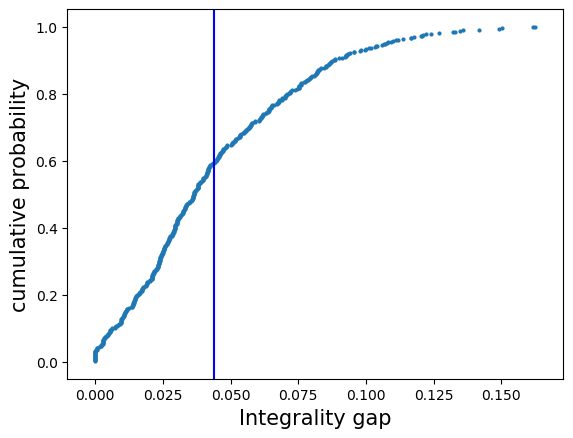

In [173]:
process(data_mn9)

<function matplotlib.pyplot.show(*args, **kw)>

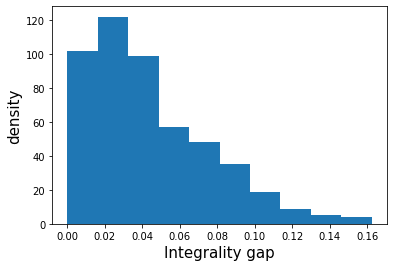

In [111]:
n, bins, patches = plt.hist(data_mn9)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

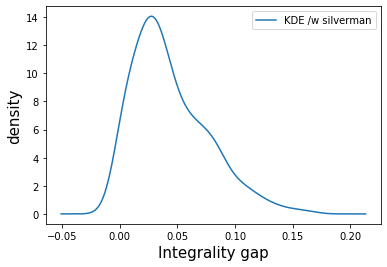

In [112]:
kernelDensity(data_mn9)

In [114]:
data_mn10 = the_loop(5, 1200, 500)

[ 1. -0.  1. ...  1. -0. -0.]
Obj: 471.519
[1. 0. 1. ... 1. 0. 0.]
Obj: 471.563
471.56291065300456 relaxed 
471.5189439348967 original 
[ 1. -0. -0. ...  1. -0. -0.]
Obj: 460.221
[1. 0. 0. ... 1. 0. 0.]
Obj: 460.266
460.26551015467885 relaxed 
460.2208550546528 original 
[1. 0. 1. ... 0. 1. 0.]
Obj: 500.938
[1. 0. 1. ... 0. 1. 0.]
Obj: 500.985
500.98470224600436 relaxed 
500.93818298741473 original 
[-0. -0. -0. ... -0.  1. -0.]
Obj: 466.405
[0. 0. 0. ... 0. 1. 0.]
Obj: 466.438
466.43814932905633 relaxed 
466.4052902470547 original 
[ 1. -0.  1. ...  0.  1. -0.]
Obj: 484.83
[1. 0. 1. ... 0. 1. 0.]
Obj: 484.873
484.87347448251967 relaxed 
484.8304229899114 original 
[1. 0. 0. ... 1. 1. 1.]
Obj: 498.372
[1. 0. 0. ... 1. 1. 1.]
Obj: 498.406
498.406057323454 relaxed 
498.3719510132576 original 
[0. 0. 0. ... 1. 1. 0.]
Obj: 474.13
[0. 0. 0. ... 1. 1. 0.]
Obj: 474.13
474.1304460516688 relaxed 
474.1304460516689 original 
[-0.  1.  1. ... -0.  1.  1.]
Obj: 468.991
[0. 1. 1. ... 0. 1. 1.]
Obj:

Obj: 483.007
[1. 0. 1. ... 1. 0. 1.]
Obj: 483.039
483.0386761592371 relaxed 
483.00653330122 original 
[ 1. -0.  1. ... -0. -0.  1.]
Obj: 529.001
[1. 0. 1. ... 0. 0. 1.]
Obj: 529.033
529.0328120767624 relaxed 
529.0005041577332 original 
[ 1. -0.  1. ... -0.  1. -0.]
Obj: 492.271
[1. 0. 1. ... 0. 1. 0.]
Obj: 492.309
492.30941816115626 relaxed 
492.2711876943982 original 
[ 1.  1.  1. ...  1. -0. -0.]
Obj: 470.644
[1. 1. 1. ... 1. 0. 0.]
Obj: 470.695
470.6951333733051 relaxed 
470.6444181368235 original 
[ 1.  1. -0. ...  1.  1.  1.]
Obj: 505.773
[1. 1. 0. ... 1. 1. 1.]
Obj: 505.788
505.7877473349772 relaxed 
505.77274051283 original 
[ 1.  1.  1. ... -0.  1.  1.]
Obj: 483.857
[1. 1. 1. ... 0. 1. 1.]
Obj: 483.904
483.90365601740666 relaxed 
483.85675643119987 original 
[-0.  1.  1. ...  1.  1.  1.]
Obj: 479.364
[0. 1. 1. ... 1. 1. 1.]
Obj: 479.401
479.4011260917703 relaxed 
479.3644460472631 original 
[1. 1. 1. ... 0. 0. 1.]
Obj: 515.586
[1. 1. 1. ... 0. 0. 1.]
Obj: 515.634
515.63444216

[1. 0. 0. ... 1. 0. 0.]
Obj: 459.63
459.62969537517796 relaxed 
459.6212984460055 original 
[-0.  1.  1. ... -0. -0.  1.]
Obj: 458.829
[0. 1. 1. ... 0. 0. 1.]
Obj: 458.888
458.88786316820267 relaxed 
458.82936325189365 original 
[1. 1. 1. ... 1. 1. 1.]
Obj: 484.68
[1. 1. 1. ... 1. 1. 1.]
Obj: 484.698
484.69844883948315 relaxed 
484.6799462319918 original 
[ 1.  1.  0. ...  1.  1. -0.]
Obj: 455.628
[1. 1. 0. ... 1. 1. 0.]
Obj: 455.666
455.6660202760391 relaxed 
455.62777878737296 original 
[-0.  1.  1. ...  1.  1. -0.]
Obj: 464.278
[0. 1. 1. ... 1. 1. 0.]
Obj: 464.322
464.3221246858257 relaxed 
464.2781820145114 original 
[1. 1. 0. ... 0. 1. 0.]
Obj: 500.315
[1. 1. 0. ... 0. 1. 0.]
Obj: 500.34
500.339778322598 relaxed 
500.3148027681456 original 
[ 1. -0.  1. ...  1. -0. -0.]
Obj: 445.923
[1.         0.         1.         ... 1.         0.04740487 0.        ]
Obj: 445.981
445.9805258342593 relaxed 
445.9233540841368 original 
[-0.  1. -0. ... -0.  1.  1.]
Obj: 518.943
[0. 1. 0. ... 0. 1

[1. 1. 0. ... 1. 1. 1.]
Obj: 474.706
474.7064320357881 relaxed 
474.6605899438908 original 
[0. 1. 0. ... 1. 1. 0.]
Obj: 455.522
[0. 1. 0. ... 1. 1. 0.]
Obj: 455.662
455.6619912434284 relaxed 
455.5217382568845 original 
[1. 0. 1. ... 0. 0. 0.]
Obj: 501.16
[1. 0. 1. ... 0. 0. 0.]
Obj: 501.16
501.15957825740134 relaxed 
501.15957825740145 original 
[0. 1. 0. ... 0. 1. 0.]
Obj: 489.176
[0. 1. 0. ... 0. 1. 0.]
Obj: 489.27
489.2696339285698 relaxed 
489.1758480580275 original 
[ 1. -0.  1. ... -0.  1. -0.]
Obj: 484.425
[1. 0. 1. ... 0. 1. 0.]
Obj: 484.473
484.473048396873 relaxed 
484.4248720154008 original 
[0. 0. 1. ... 0. 1. 1.]
Obj: 476.243
[0. 0. 1. ... 0. 1. 1.]
Obj: 476.354
476.35409200160984 relaxed 
476.2434634157206 original 
[ 1.  1.  1. ...  1. -0. -0.]
Obj: 473.434
[1. 1. 1. ... 1. 0. 0.]
Obj: 473.46
473.460089482263 relaxed 
473.4341177284903 original 
[-0.  1. -0. ...  1.  1. -0.]
Obj: 476.996
[0. 1. 0. ... 1. 1. 0.]
Obj: 477.003
477.0027409417069 relaxed 
476.9962771027724 

[0. 1. 0. ... 1. 1. 1.]
Obj: 448.535
448.5354544458213 relaxed 
448.53545444582136 original 
[ 1. -0. -0. ... -0. -0.  1.]
Obj: 501.672
[1. 0. 0. ... 0. 0. 1.]
Obj: 501.71
501.71028439581875 relaxed 
501.67178621245245 original 
[0. 1. 1. ... 1. 1. 0.]
Obj: 496.046
[0. 1. 1. ... 1. 1. 0.]
Obj: 496.139
496.13859439183665 relaxed 
496.04562392327927 original 
[-0. -0.  1. ... -0. -0.  1.]
Obj: 476.367
[0. 0. 1. ... 0. 0. 1.]
Obj: 476.412
476.4115813144444 relaxed 
476.36663943603213 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 418.821
[0. 1. 1. ... 0. 0. 0.]
Obj: 418.853
418.8526508929155 relaxed 
418.82147943197094 original 
[ 1.  1. -0. ... -0. -0. -0.]
Obj: 465.205
[1. 1. 0. ... 0. 0. 0.]
Obj: 465.208
465.20833494589675 relaxed 
465.20523158944513 original 
[ 1.  1. -0. ...  1.  1.  1.]
Obj: 466.046
[1. 1. 0. ... 1. 1. 1.]
Obj: 466.075
466.07546615261526 relaxed 
466.04615082679385 original 
[ 1.  1.  1. ... -0.  1.  1.]
Obj: 496.929
[1. 1. 1. ... 0. 1. 1.]
Obj: 496.979
496.9793056374

[1. 1. 0. ... 0. 0. 0.]
Obj: 462.965
462.9653078320955 relaxed 
462.94120671631697 original 
[ 1.  1. -0. ...  1. -0.  1.]
Obj: 495.649
[1. 1. 0. ... 1. 0. 1.]
Obj: 495.701
495.7012644865442 relaxed 
495.64930478254587 original 
[ 1. -0.  1. ...  1.  1. -0.]
Obj: 488.041
[1. 0. 1. ... 1. 1. 0.]
Obj: 488.086
488.0856679756753 relaxed 
488.040809733981 original 
[-0. -0.  1. ... -0.  0.  1.]
Obj: 466.571
[0. 0. 1. ... 0. 0. 1.]
Obj: 466.578
466.57833888637026 relaxed 
466.5706374094034 original 
[ 1. -0. -0. ... -0.  1. -0.]
Obj: 473.541
[1. 0. 0. ... 0. 1. 0.]
Obj: 473.558
473.5578863892562 relaxed 
473.54091264408896 original 
[ 1. -0.  1. ... -0.  1.  1.]
Obj: 480.256
[1. 0. 1. ... 0. 1. 1.]
Obj: 480.283
480.2828329242615 relaxed 
480.25551853633175 original 
[-0. -0. -0. ... -0. -0.  1.]
Obj: 500.907
[0. 0. 0. ... 0. 0. 1.]
Obj: 500.93
500.93017349255615 relaxed 
500.9074551077962 original 
[ 1.  1.  1. ...  1.  1. -0.]
Obj: 482.478
[1. 1. 1. ... 1. 1. 0.]
Obj: 482.517
482.5170438819

[1. 1. 0. ... 0. 1. 0.]
Obj: 506.846
[1. 1. 0. ... 0. 1. 0.]
Obj: 506.903
506.9025981304122 relaxed 
506.8464111314327 original 
[-0.  1. -0. ...  1.  1. -0.]
Obj: 481.123
[0. 1. 0. ... 1. 1. 0.]
Obj: 481.141
481.1409636124603 relaxed 
481.12258065742503 original 
[ 0.  1.  1. ...  1. -0.  1.]
Obj: 481.282
[0. 1. 1. ... 1. 0. 1.]
Obj: 481.314
481.31445180871935 relaxed 
481.282253732693 original 
[-0.  1.  1. ... -0.  0.  1.]
Obj: 493.393
[0. 1. 1. ... 0. 0. 1.]
Obj: 493.465
493.46537757575135 relaxed 
493.3932756660559 original 
[-0. -0.  1. ...  1. -0. -0.]
Obj: 504.425
[0. 0. 1. ... 1. 0. 0.]
Obj: 504.45
504.4495800430338 relaxed 
504.4254601649972 original 
[-0.  1.  1. ... -0.  1. -0.]
Obj: 448.91
[0. 1. 1. ... 0. 1. 0.]
Obj: 448.937
448.93665083748203 relaxed 
448.91038088931396 original 
[ 1.  1.  1. ...  1. -0. -0.]
Obj: 494.113
[1. 1. 1. ... 1. 0. 0.]
Obj: 494.157
494.1571649272775 relaxed 
494.11329323355955 original 
[0. 0. 1. ... 1. 1. 1.]
Obj: 476.89
[0. 0. 1. ... 1. 1. 1.

[0. 0. 0. ... 0. 0. 1.]
Obj: 457.332
457.3317985736197 relaxed 
457.29709678164636 original 
[ 1. -0. -0. ... -0.  1.  1.]
Obj: 513.068
[1. 0. 0. ... 0. 1. 1.]
Obj: 513.112
513.11225969429 relaxed 
513.0678950859269 original 
[-0. -0. -0. ... -0. -0.  1.]
Obj: 488.718
[0. 0. 0. ... 0. 0. 1.]
Obj: 488.762
488.76185500241843 relaxed 
488.7184115414101 original 
[1. 1. 1. ... 1. 1. 1.]
Obj: 470.377
[1. 1. 1. ... 1. 1. 1.]
Obj: 470.42
470.4196403850341 relaxed 
470.37684390495247 original 
[-0.  0.  1. ...  1.  1.  1.]
Obj: 487.919
[0. 1. 1. ... 1. 1. 1.]
Obj: 487.975
487.97465236267567 relaxed 
487.91855894843314 original 
[-0. -0. -0. ... -0. -0.  1.]
Obj: 499.473
[0. 0. 0. ... 0. 0. 1.]
Obj: 499.516
499.51590656204354 relaxed 
499.47276261136744 original 
[ 1. -0.  1. ...  1. -0. -0.]
Obj: 499.202
[1. 0. 1. ... 1. 0. 0.]
Obj: 499.213
499.2129515476806 relaxed 
499.20219075109503 original 
[1. 1. 0. ... 1. 1. 0.]
Obj: 473.695
[1. 1. 0. ... 1. 1. 0.]
Obj: 473.743
473.74299618933486 relaxe

[1. 1. 1. ... 1. 0. 0.]
Obj: 506.109
[1. 1. 1. ... 1. 0. 0.]
Obj: 506.157
506.1570417074348 relaxed 
506.10909019323105 original 


mean: 0.03367896260803934
median: 0.03379735340044476
standard deviation:0.018531475019276353


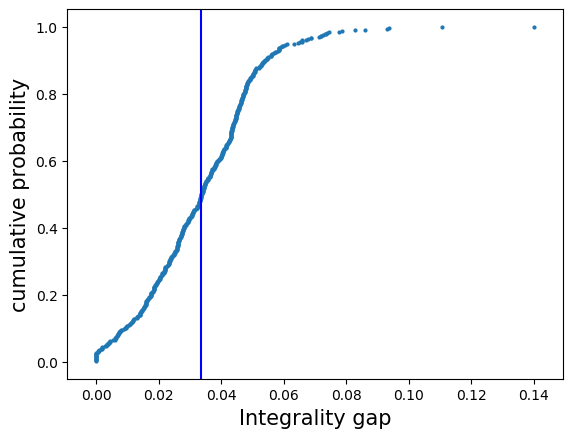

In [174]:
process(data_mn10)

<function matplotlib.pyplot.show(*args, **kw)>

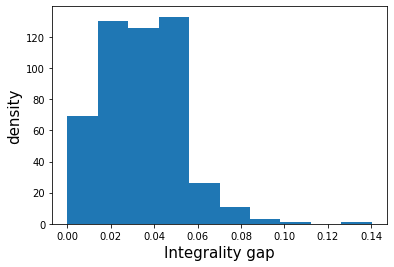

In [116]:
n, bins, patches = plt.hist(data_mn10)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

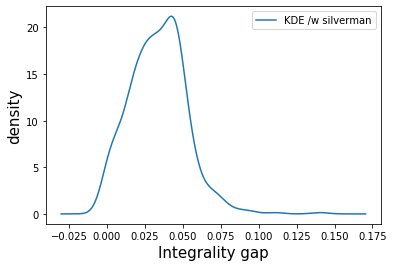

In [117]:
kernelDensity(data_mn10)

In [118]:
data_mn11 = the_loop(5, 2000, 500)

[-0.  1. -0. ...  1. -0. -0.]
Obj: 820.022
[0. 1. 0. ... 1. 0. 0.]
Obj: 820.088
820.088440617132 relaxed 
820.021589272293 original 
[-0.  1. -0. ...  1. -0. -0.]
Obj: 800.554
[0. 1. 0. ... 1. 0. 0.]
Obj: 800.645
800.6445465946938 relaxed 
800.5539230961257 original 
[-0. -0.  1. ...  1.  1. -0.]
Obj: 786.285
[0. 0. 1. ... 1. 1. 0.]
Obj: 786.357
786.3568106471296 relaxed 
786.2851556610099 original 
[ 1.  1. -0. ...  1.  1.  1.]
Obj: 787.078
[1. 1. 0. ... 1. 1. 1.]
Obj: 787.12
787.1203636193338 relaxed 
787.0781726935927 original 
[ 1.  1.  1. ...  0.  1. -0.]
Obj: 832.051
[1. 1. 1. ... 0. 1. 0.]
Obj: 832.058
832.0576762902671 relaxed 
832.0511852667747 original 
[ 0. -0.  1. ...  1. -0.  1.]
Obj: 788.857
[0. 0. 1. ... 1. 0. 1.]
Obj: 788.919
788.9191650345442 relaxed 
788.8572931231391 original 
[ 1.  1. -0. ... -0. -0. -0.]
Obj: 756.681
[1. 1. 0. ... 0. 0. 0.]
Obj: 756.686
756.6861427279615 relaxed 
756.6808159863399 original 
[ 1. -0.  1. ... -0. -0. -0.]
Obj: 802.523
[1. 0. 1. ... 0

[0. 1. 1. ... 1. 0. 0.]
Obj: 824.327
824.3271136191335 relaxed 
824.2548132963911 original 
[-0.  1. -0. ...  1. -0. -0.]
Obj: 815.909
[0. 1. 0. ... 1. 0. 0.]
Obj: 815.99
815.9896425908662 relaxed 
815.9094370221836 original 
[-0.  1.  1. ... -0.  1.  1.]
Obj: 795.032
[0. 1. 1. ... 0. 1. 1.]
Obj: 795.081
795.0808624603259 relaxed 
795.0317658038264 original 
[1. 1. 1. ... 1. 0. 1.]
Obj: 786.25
[1. 1. 1. ... 1. 0. 1.]
Obj: 786.26
786.2596678805472 relaxed 
786.2496857808038 original 
[ 1.  1.  1. ...  1. -0.  1.]
Obj: 751.72
[1. 1. 1. ... 1. 0. 1.]
Obj: 751.74
751.7401724825205 relaxed 
751.7198569412471 original 
[0. 1. 1. ... 0. 1. 0.]
Obj: 789.682
[0. 1. 1. ... 0. 1. 0.]
Obj: 789.714
789.7142188602439 relaxed 
789.682288302271 original 
[ 1.  1. -0. ... -0.  1. -0.]
Obj: 776.457
[1. 1. 0. ... 0. 1. 0.]
Obj: 776.473
776.4728279559616 relaxed 
776.4571155788531 original 
[1. 1. 1. ... 1. 0. 0.]
Obj: 795.354
[1. 1. 1. ... 1. 0. 0.]
Obj: 795.409
795.4092521829399 relaxed 
795.35414458155

[0. 0. 1. ... 1. 0. 0.]
Obj: 799.717
799.7168619186623 relaxed 
799.7096719309316 original 
[-0. -0. -0. ... -0.  1. -0.]
Obj: 784.79
[0. 0. 0. ... 0. 1. 0.]
Obj: 784.828
784.8284822148462 relaxed 
784.7898182360544 original 
[ 1. -0. -0. ...  1.  1. -0.]
Obj: 819.967
[1. 0. 0. ... 1. 1. 0.]
Obj: 820.02
820.0204261129977 relaxed 
819.9673926933547 original 
[ 1.  1.  0. ... -0.  1. -0.]
Obj: 799.798
[1. 1. 1. ... 0. 1. 0.]
Obj: 799.854
799.8543144842249 relaxed 
799.797827104241 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 781.235
[0. 1. 1. ... 0. 0. 0.]
Obj: 781.284
781.284381508328 relaxed 
781.2345851097615 original 
[ 1.  1.  1. ...  1. -0.  1.]
Obj: 815.758
[1. 1. 1. ... 1. 0. 1.]
Obj: 815.835
815.8347598678401 relaxed 
815.7584073610944 original 
[0. 1. 0. ... 1. 1. 0.]
Obj: 803.822
[0. 1. 0. ... 1. 1. 0.]
Obj: 803.873
803.8729827685261 relaxed 
803.8224895501914 original 
[-0. -0.  1. ...  1.  1.  1.]
Obj: 792.835
[0. 0. 1. ... 1. 1. 1.]
Obj: 792.873
792.872686742801 relaxed 
79

[ 1.  1.  1. ...  1. -0.  1.]
Obj: 762.031
[1. 1. 1. ... 1. 0. 1.]
Obj: 762.081
762.081285624959 relaxed 
762.0311131606718 original 
[ 1.  1.  1. ... -0. -0.  1.]
Obj: 726.054
[1. 1. 1. ... 0. 0. 1.]
Obj: 726.106
726.1060744269151 relaxed 
726.0538890046588 original 
[ 1.  1. -0. ...  1. -0. -0.]
Obj: 760.71
[1. 1. 0. ... 1. 0. 0.]
Obj: 760.77
760.7703313624498 relaxed 
760.7100993740835 original 
[ 1.  1. -0. ... -0. -0.  1.]
Obj: 796.487
[1. 1. 0. ... 0. 0. 1.]
Obj: 796.505
796.5047754598744 relaxed 
796.4870231269547 original 
[-0.  1.  1. ... -0.  1.  1.]
Obj: 788.656
[0. 1. 1. ... 0. 1. 1.]
Obj: 788.704
788.704332341006 relaxed 
788.6559294064176 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 787.864
[0. 1. 0. ... 1. 1. 1.]
Obj: 787.929
787.9287632327586 relaxed 
787.8637994949253 original 
[-0. -0.  1. ...  1.  1. -0.]
Obj: 833.091
[0. 0. 1. ... 1. 1. 0.]
Obj: 833.135
833.1346155203527 relaxed 
833.091247526717 original 
[-0. -0. -0. ...  1. -0. -0.]
Obj: 782.245
[0. 0. 0. ... 1. 

[-0.  1.  1. ...  1.  1. -0.]
Obj: 793.324
[0. 1. 1. ... 1. 1. 0.]
Obj: 793.389
793.3889645285092 relaxed 
793.3236682347422 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 806.252
[0. 1. 0. ... 1. 1. 1.]
Obj: 806.292
806.2919093633355 relaxed 
806.2516657953897 original 
[ 1. -0.  1. ...  1. -0. -0.]
Obj: 794.648
[1. 0. 1. ... 1. 0. 0.]
Obj: 794.686
794.6858015916227 relaxed 
794.6475182193641 original 
[1. 0. 1. ... 0. 1. 0.]
Obj: 802.305
[1. 0. 1. ... 0. 1. 0.]
Obj: 802.379
802.3788238038794 relaxed 
802.3054337076715 original 
[ 1.  1.  1. ...  1.  1. -0.]
Obj: 831.694
[1. 1. 1. ... 1. 1. 0.]
Obj: 831.702
831.7016611731136 relaxed 
831.6935577213176 original 
[-0.  1.  1. ...  1.  1.  1.]
Obj: 798.67
[0. 1. 1. ... 1. 1. 1.]
Obj: 798.678
798.6777738948919 relaxed 
798.6698749905386 original 
[ 1. -0. -0. ... -0.  1.  1.]
Obj: 794.835
[1. 0. 0. ... 0. 1. 1.]
Obj: 794.864
794.8636121831279 relaxed 
794.8347073085688 original 
[ 1. -0.  1. ...  1. -0.  1.]
Obj: 795.856
[1. 0. 1. ... 1. 0.

[ 1. -0.  1. ... -0.  1. -0.]
Obj: 815.766
[1. 0. 1. ... 0. 1. 0.]
Obj: 815.82
815.8198977524165 relaxed 
815.766156561249 original 
[ 1.  1. -0. ... -0. -0.  1.]
Obj: 777.354
[1. 1. 0. ... 0. 0. 1.]
Obj: 777.376
777.3763067870716 relaxed 
777.3540203313454 original 
[-0. -0.  1. ... -0.  1.  1.]
Obj: 759.899
[0. 0. 1. ... 0. 1. 1.]
Obj: 759.915
759.9147310722351 relaxed 
759.899226916346 original 
[ 1. -0. -0. ... -0.  1. -0.]
Obj: 771.653
[1. 0. 0. ... 0. 1. 0.]
Obj: 771.676
771.6758752763989 relaxed 
771.6528565579115 original 
[ 1.  1. -0. ... -0.  1. -0.]
Obj: 777.997
[1. 1. 0. ... 0. 1. 0.]
Obj: 778.072
778.0717352949625 relaxed 
777.9967589063525 original 
[1. 0. 1. ... 0. 1. 1.]
Obj: 812.408
[1. 0. 1. ... 0. 1. 1.]
Obj: 812.482
812.4819065692318 relaxed 
812.4080302597426 original 
[-0. -0.  1. ...  1. -0.  1.]
Obj: 841.634
[0. 0. 1. ... 1. 0. 1.]
Obj: 841.713
841.7131238187573 relaxed 
841.6337050091456 original 
[ 1.  0.  1. ... -0.  1.  1.]
Obj: 805.999
[1. 0. 1. ... 0. 1. 1

[1. 0. 1. ... 1. 0. 0.]
Obj: 769.759
769.7593109243851 relaxed 
769.7238607274232 original 
[ 1. -0. -0. ...  1.  0.  1.]
Obj: 800.631
[1. 0. 0. ... 1. 0. 1.]
Obj: 800.667
800.6668133229111 relaxed 
800.6309335464349 original 
[ 1. -0.  1. ...  1.  1. -0.]
Obj: 791.987
[1. 0. 1. ... 1. 1. 0.]
Obj: 792.043
792.043486876345 relaxed 
791.9872652863247 original 
[-0.  1. -0. ... -0.  1.  1.]
Obj: 809.575
[0. 1. 0. ... 0. 1. 1.]
Obj: 809.616
809.6156624891987 relaxed 
809.5753848977113 original 
[ 1. -0. -0. ... -0.  1.  1.]
Obj: 786.805
[1. 0. 0. ... 0. 1. 1.]
Obj: 786.848
786.8483967050165 relaxed 
786.8045742223206 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 753.949
[1. 1. 0. ... 1. 1. 0.]
Obj: 753.985
753.9845018850592 relaxed 
753.9492105292356 original 
[ 1.  1. -0. ... -0. -0.  1.]
Obj: 778.785
[1. 1. 0. ... 0. 0. 1.]
Obj: 778.793
778.7933411924151 relaxed 
778.7847541899273 original 
[1. 0. 0. ... 0. 1. 1.]
Obj: 804.728
[1. 0. 0. ... 0. 1. 1.]
Obj: 804.801
804.8008724520628 relaxed

[-0.  1. -0. ...  1. -0.  0.]
Obj: 811.819
[0. 1. 0. ... 1. 0. 0.]
Obj: 811.866
811.8658887303095 relaxed 
811.8188838400346 original 
[ 1. -0.  1. ...  1. -0.  1.]
Obj: 786.642
[1. 0. 1. ... 1. 0. 1.]
Obj: 786.683
786.6834450915858 relaxed 
786.6423065966953 original 
[-0.  1.  1. ...  1.  1.  1.]
Obj: 756.972
[0. 1. 1. ... 1. 1. 1.]
Obj: 757.022
757.0221839866557 relaxed 
756.9723175645922 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 803.623
[0. 1. 0. ... 1. 1. 1.]
Obj: 803.685
803.6848945023262 relaxed 
803.6228502441356 original 
[1. 0. 1. ... 1. 1. 1.]
Obj: 833.261
[1. 0. 1. ... 1. 1. 1.]
Obj: 833.333
833.3331045349545 relaxed 
833.2611834224047 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 807.388
[1. 1. 0. ... 1. 1. 0.]
Obj: 807.4
807.400353655128 relaxed 
807.3884137416605 original 
[ 1.  1. -0. ...  1.  1.  0.]
Obj: 791.517
[1. 1. 0. ... 1. 1. 0.]
Obj: 791.571
791.570940202019 relaxed 
791.5168902984889 original 
[ 1. -0. -0. ...  1.  1. -0.]
Obj: 817.776
[1. 0. 0. ... 1. 1. 0.

mean: 0.04018515983788075
median: 0.04061206718131416
standard deviation:0.022661179562436507


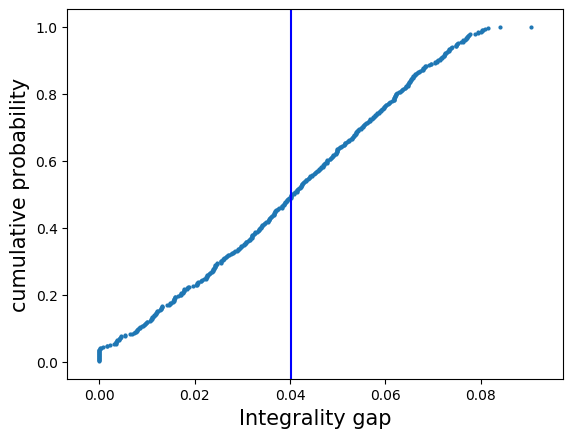

In [175]:
process(data_mn11)

<function matplotlib.pyplot.show(*args, **kw)>

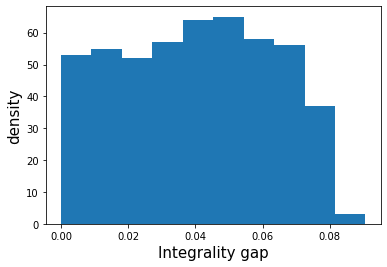

In [120]:
n, bins, patches = plt.hist(data_mn11)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

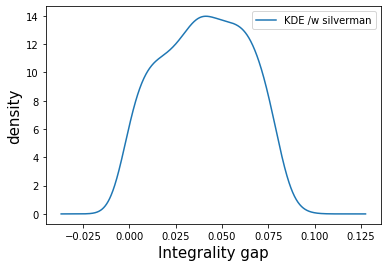

In [121]:
kernelDensity(data_mn11)

In [134]:
data_mn12 = the_loop(5, 4000, 500)

[1. 1. 0. ... 1. 1. 1.]
Obj: 1561.61
[1. 1. 0. ... 1. 1. 1.]
Obj: 1561.67
1561.6658199798542 relaxed 
1561.6106377199328 original 
[-0. -0. -0. ... -0.  1. -0.]
Obj: 1540.08
[0. 0. 0. ... 0. 1. 0.]
Obj: 1540.2
1540.2029655946974 relaxed 
1540.082866951242 original 
[0. 1. 0. ... 0. 1. 0.]
Obj: 1604.75
[0. 1. 0. ... 0. 1. 0.]
Obj: 1604.83
1604.8337454016055 relaxed 
1604.7475031258518 original 
[-0.  1. -0. ...  1. -0.  1.]
Obj: 1634.48
[0. 1. 0. ... 1. 0. 1.]
Obj: 1634.5
1634.5004366068251 relaxed 
1634.4766808950862 original 
[0. 1. 0. ... 0. 1. 0.]
Obj: 1577.94
[0. 1. 0. ... 0. 1. 0.]
Obj: 1577.99
1577.9917899482418 relaxed 
1577.9439153082903 original 
[1. 1. 0. ... 0. 0. 0.]
Obj: 1553.67
[1. 1. 0. ... 0. 0. 0.]
Obj: 1553.77
1553.7736383330327 relaxed 
1553.6748928436064 original 
[0. 1. 0. ... 1. 0. 1.]
Obj: 1600.35
[0. 1. 0. ... 1. 0. 1.]
Obj: 1600.46
1600.45690814871 relaxed 
1600.349322621862 original 
[-0.  1. -0. ... -0. -0.  1.]
Obj: 1598.27
[0. 1. 0. ... 0. 0. 1.]
Obj: 1598.

[0. 1. 1. ... 0. 1. 0.]
Obj: 1561.36
1561.3641819567197 relaxed 
1561.2990833126578 original 
[-0.  1.  1. ... -0.  1.  1.]
Obj: 1510.13
[0. 1. 1. ... 0. 1. 1.]
Obj: 1510.21
1510.2054088547027 relaxed 
1510.134813686406 original 
[-0. -0. -0. ... -0.  1.  1.]
Obj: 1591.24
[0. 0. 0. ... 0. 1. 1.]
Obj: 1591.28
1591.2831036755456 relaxed 
1591.2413260118453 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 1636.64
[1. 1. 0. ... 1. 1. 0.]
Obj: 1636.64
1636.6435518123612 relaxed 
1636.6384678246259 original 
[-0. -0. -0. ... -0.  1.  1.]
Obj: 1578.61
[0. 0. 0. ... 0. 1. 1.]
Obj: 1578.63
1578.6341228175124 relaxed 
1578.6055450701306 original 
[ 1.  1. -0. ... -0. -0.  1.]
Obj: 1478.32
[1. 1. 0. ... 0. 0. 1.]
Obj: 1478.33
1478.3305021782887 relaxed 
1478.31585409598 original 
[-0.  1.  1. ...  1. -0.  1.]
Obj: 1665.04
[0. 1. 1. ... 1. 0. 1.]
Obj: 1665.06
1665.0564435768838 relaxed 
1665.0434376590122 original 
[0. 0. 0. ... 0. 1. 0.]
Obj: 1557.58
[0. 0. 0. ... 0. 1. 0.]
Obj: 1557.59
1557.59382973

[-0.  1.  1. ... -0. -0. -0.]
Obj: 1548.6
[0. 1. 1. ... 0. 0. 0.]
Obj: 1548.69
1548.6878648796323 relaxed 
1548.6008890126843 original 
[0. 0. 1. ... 0. 1. 0.]
Obj: 1574.48
[0. 0. 1. ... 0. 1. 0.]
Obj: 1574.52
1574.5203979496787 relaxed 
1574.4780046342635 original 
[ 1.  1. -0. ... -0.  1. -0.]
Obj: 1565.6
[1. 1. 0. ... 0. 1. 0.]
Obj: 1565.61
1565.614184770096 relaxed 
1565.602129041142 original 
[ 1. -0. -0. ...  1.  1.  1.]
Obj: 1551.32
[1. 0. 0. ... 1. 1. 1.]
Obj: 1551.44
1551.442489732249 relaxed 
1551.3204159956917 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 1585.5
[0. 1. 0. ... 1. 1. 1.]
Obj: 1585.5
1585.5044837685127 relaxed 
1585.4951996277146 original 
[-0. -0.  1. ...  1. -0. -0.]
Obj: 1586.74
[0. 0. 1. ... 1. 0. 0.]
Obj: 1586.83
1586.831043530934 relaxed 
1586.7439691831416 original 
[ 1.  1.  1. ... -0. -0. -0.]
Obj: 1603.71
[1. 1. 1. ... 0. 0. 0.]
Obj: 1603.74
1603.7354332949187 relaxed 
1603.711332289667 original 
[ 1. -0. -0. ... -0.  1. -0.]
Obj: 1578.5
[1. 0. 0. ... 

[-0. -0. -0. ...  1. -0. -0.]
Obj: 1610.75
[0. 0. 0. ... 1. 0. 0.]
Obj: 1610.81
1610.8104497206803 relaxed 
1610.7532406265886 original 
[1. 0. 1. ... 0. 0. 1.]
Obj: 1577.66
[1. 0. 1. ... 0. 0. 1.]
Obj: 1577.7
1577.7016342274962 relaxed 
1577.6624123064187 original 
[-0. -0.  1. ...  0.  1.  0.]
Obj: 1617.06
[0. 0. 1. ... 0. 1. 0.]
Obj: 1617.07
1617.0709461020265 relaxed 
1617.0573835837263 original 
[ 1. -0. -0. ...  1.  1.  1.]
Obj: 1565.53
[1. 0. 0. ... 1. 1. 1.]
Obj: 1565.55
1565.5523117926068 relaxed 
1565.5307203519114 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 1592.07
[0. 1. 1. ... 0. 0. 0.]
Obj: 1592.15
1592.1502453514504 relaxed 
1592.0722301404148 original 
[-0.  1. -0. ... -0. -0. -0.]
Obj: 1577.87
[0. 1. 0. ... 0. 0. 0.]
Obj: 1577.9
1577.9032617796968 relaxed 
1577.86559548559 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 1609.44
[1. 1. 0. ... 1. 1. 0.]
Obj: 1609.44
1609.4404775759988 relaxed 
1609.4377138712664 original 
[ 1. -0. -0. ... -0.  1. -0.]
Obj: 1632.25
[1. 0. 0

[0. 0. 0. ... 1. 0. 1.]
Obj: 1608.5
1608.4954039910394 relaxed 
1608.3687083919217 original 
[-0. -0. -0. ... -0.  1.  1.]
Obj: 1665.06
[0. 0. 0. ... 0. 1. 1.]
Obj: 1665.15
1665.1545583883815 relaxed 
1665.0631642800618 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 1638.67
[0. 1. 1. ... 0. 0. 0.]
Obj: 1638.82
1638.8223731051405 relaxed 
1638.6667625969117 original 
[-0.  1. -0. ... -0.  1.  1.]
Obj: 1539.59
[0. 1. 0. ... 0. 1. 1.]
Obj: 1539.6
1539.5993893243792 relaxed 
1539.585451738502 original 
[ 1.  1.  1. ...  1.  1. -0.]
Obj: 1514.42
[1. 1. 1. ... 1. 1. 0.]
Obj: 1514.42
1514.4217272427875 relaxed 
1514.4196265496905 original 
[0. 0. 1. ... 0. 0. 1.]
Obj: 1656.05
[0. 0. 1. ... 0. 0. 1.]
Obj: 1656.17
1656.1670469697442 relaxed 
1656.045899967354 original 
[0. 1. 1. ... 0. 1. 1.]
Obj: 1611.17
[0. 1. 1. ... 0. 1. 1.]
Obj: 1611.25
1611.25393458976 relaxed 
1611.1719046777037 original 
[ 1. -0.  1. ...  0. -0. -0.]
Obj: 1575.86
[1. 0. 1. ... 0. 0. 0.]
Obj: 1575.93
1575.925929630999 rela

[-0. -0.  1. ... -0. -0.  1.]
Obj: 1553.69
[0. 0. 1. ... 0. 0. 1.]
Obj: 1553.85
1553.8450808917191 relaxed 
1553.6897333119637 original 
[-0.  1. -0. ...  1.  1. -0.]
Obj: 1595.92
[0. 1. 0. ... 1. 1. 0.]
Obj: 1595.93
1595.927139318076 relaxed 
1595.923464255327 original 
[-0.  1. -0. ... -0.  1. -0.]
Obj: 1584.49
[0. 1. 0. ... 0. 1. 0.]
Obj: 1584.53
1584.525072909924 relaxed 
1584.4922686723164 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 1547.65
[0. 1. 1. ... 0. 0. 0.]
Obj: 1547.68
1547.675418544271 relaxed 
1547.6529525617386 original 
[ 1. -0. -0. ... -0.  1.  1.]
Obj: 1547.13
[1. 0. 0. ... 0. 1. 1.]
Obj: 1547.19
1547.1887875284092 relaxed 
1547.1348425479327 original 
[1. 0. 1. ... 1. 0. 0.]
Obj: 1630.52
[1. 0. 1. ... 1. 0. 0.]
Obj: 1630.55
1630.5476349189719 relaxed 
1630.5205395653543 original 
[1. 0. 0. ... 0. 0. 0.]
Obj: 1623.14
[1. 0. 0. ... 0. 0. 0.]
Obj: 1623.18
1623.1842336601158 relaxed 
1623.1362931969752 original 
[ 1.  1.  1. ... -0. -0. -0.]
Obj: 1663.39
[1. 1. 1. ... 

[0. 1. 0. ... 0. 0. 0.]
Obj: 1586.3
[0. 1. 0. ... 0. 0. 0.]
Obj: 1586.31
1586.305211370216 relaxed 
1586.3007349585448 original 
[ 1. -0.  1. ... -0. -0. -0.]
Obj: 1553.12
[1. 0. 1. ... 0. 0. 0.]
Obj: 1553.25
1553.2479225173895 relaxed 
1553.1152506381939 original 
[ 1.  1. -0. ... -0. -0.  1.]
Obj: 1552.79
[1. 1. 0. ... 0. 0. 1.]
Obj: 1552.87
1552.8691880743932 relaxed 
1552.791941546327 original 
[ 1. -0. -0. ...  1. -0. -0.]
Obj: 1594.04
[1. 0. 0. ... 1. 0. 0.]
Obj: 1594.1
1594.1031201812136 relaxed 
1594.0384780668137 original 
[1. 1. 1. ... 0. 0. 1.]
Obj: 1559.3
[1. 1. 1. ... 0. 0. 1.]
Obj: 1559.34
1559.336067247865 relaxed 
1559.301761779304 original 
[0. 0. 0. ... 0. 1. 1.]
Obj: 1592.04
[0. 0. 0. ... 0. 1. 1.]
Obj: 1592.04
1592.0419355669542 relaxed 
1592.0419355669565 original 
[-0.  1.  1. ... -0.  1.  1.]
Obj: 1602.42
[0. 1. 1. ... 0. 1. 1.]
Obj: 1602.43
1602.4260673405472 relaxed 
1602.4243832918014 original 
[-0.  1. -0. ... -0. -0.  1.]
Obj: 1562.63
[0. 1. 0. ... 0. 0. 1.]

[0. 0. 1. ... 0. 0. 0.]
Obj: 1617.75
1617.7489046535259 relaxed 
1617.6830720060198 original 
[-0. -0.  1. ...  1.  1. -0.]
Obj: 1529.27
[0. 0. 1. ... 1. 1. 0.]
Obj: 1529.3
1529.2980701872582 relaxed 
1529.2739603763346 original 
[ 1.  1.  1. ... -0.  1.  1.]
Obj: 1662.94
[1. 1. 1. ... 0. 1. 1.]
Obj: 1663.09
1663.0925274590822 relaxed 
1662.9446579751832 original 
[-0.  1. -0. ... -0.  1. -0.]
Obj: 1556.64
[0. 1. 0. ... 0. 1. 0.]
Obj: 1556.71
1556.7069489414098 relaxed 
1556.6358723546068 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 1594.86
[0. 1. 0. ... 1. 1. 1.]
Obj: 1594.87
1594.8685654440276 relaxed 
1594.8621100378182 original 
[ 1. -0.  1. ... -0. -0. -0.]
Obj: 1624.07
[1. 0. 1. ... 0. 0. 0.]
Obj: 1624.1
1624.0977329844077 relaxed 
1624.0689741009712 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 1620.44
[1. 1. 0. ... 1. 1. 0.]
Obj: 1620.45
1620.45195653427 relaxed 
1620.437430027166 original 
[ 1. -0.  1. ...  1. -0.  1.]
Obj: 1579.21
[1. 0. 1. ... 1. 0. 1.]
Obj: 1579.26
1579.2640

[ 1.  1. -0. ... -0. -0. -0.]
Obj: 1549.93
[1. 1. 0. ... 0. 0. 0.]
Obj: 1550.08
1550.0773344095887 relaxed 
1549.932808741123 original 
[1. 0. 0. ... 1. 0. 1.]
Obj: 1591.87
[1. 0. 0. ... 1. 0. 1.]
Obj: 1591.93
1591.931971967444 relaxed 
1591.870427134662 original 
[-0. -0.  1. ... -0.  1. -0.]
Obj: 1644.34
[0. 0. 1. ... 0. 1. 0.]
Obj: 1644.39
1644.3938750523985 relaxed 
1644.3413228612549 original 
[1. 0. 1. ... 0. 1. 0.]
Obj: 1592.37
[1. 0. 1. ... 0. 1. 0.]
Obj: 1592.41
1592.4110600616073 relaxed 
1592.3685279654126 original 


mean: 0.05684114147931132
median: 0.04704279046154625
standard deviation:0.04356459027573569


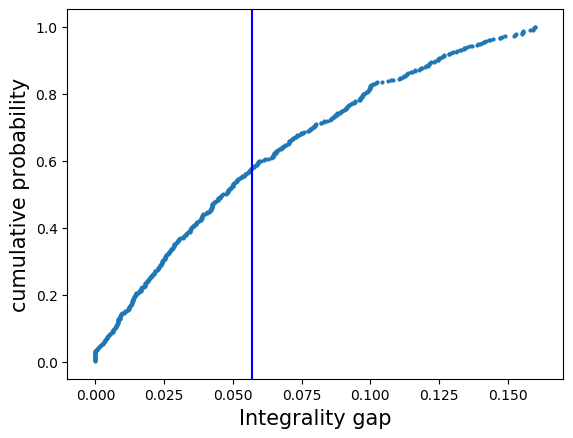

In [176]:
process(data_mn12)

<function matplotlib.pyplot.show(*args, **kw)>

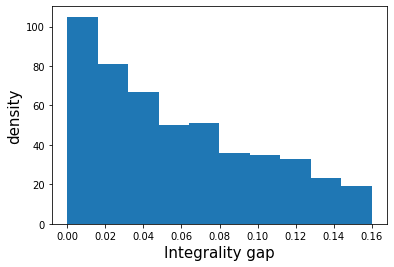

In [136]:
n, bins, patches = plt.hist(data_mn12)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

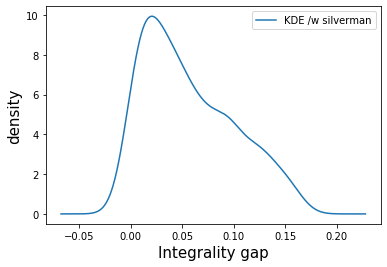

In [137]:
kernelDensity(data_mn12)

In [138]:
data_mn13 = the_loop(5, 8000, 500)

[-0.  1.  1. ... -0.  1.  1.]
Obj: 3192.89
[0. 1. 1. ... 0. 1. 1.]
Obj: 3192.92
3192.919618179883 relaxed 
3192.8856684750954 original 
[-0.  1. -0. ... -0.  1. -0.]
Obj: 3134.03
[0. 1. 0. ... 0. 1. 0.]
Obj: 3134.03
3134.0332369819175 relaxed 
3134.0328263576394 original 
[-0.  1.  1. ...  1.  1. -0.]
Obj: 3215.92
[0. 1. 1. ... 1. 1. 0.]
Obj: 3216.01
3216.005390161316 relaxed 
3215.916841197617 original 
[-0. -0. -0. ... -0. -0. -0.]
Obj: 3175.28
[0. 0. 0. ... 0. 0. 0.]
Obj: 3175.38
3175.378891783094 relaxed 
3175.2821856248393 original 
[-0. -0. -0. ...  0.  1.  1.]
Obj: 3195.86
[0. 0. 0. ... 0. 1. 1.]
Obj: 3195.99
3195.98969003397 relaxed 
3195.858709142041 original 
[ 1. -0.  1. ...  1.  1. -0.]
Obj: 3174.29
[1. 0. 1. ... 1. 1. 0.]
Obj: 3174.32
3174.323429662163 relaxed 
3174.2869505306608 original 
[ 0.  1. -0. ...  1. -0. -0.]
Obj: 3181.86
[0. 1. 0. ... 1. 0. 0.]
Obj: 3181.87
3181.8695954193054 relaxed 
3181.861663127296 original 
[-0.  1.  1. ...  1. -0.  1.]
Obj: 3139.08
[0. 1. 

[-0.  1.  1. ... -0.  1.  1.]
Obj: 3189.18
[0. 1. 1. ... 0. 1. 1.]
Obj: 3189.27
3189.2676601409157 relaxed 
3189.1757334889035 original 
[-0. -0.  1. ... -0. -0. -0.]
Obj: 3156.83
[0. 0. 1. ... 0. 0. 0.]
Obj: 3157.03
3157.028252761465 relaxed 
3156.8262835908126 original 
[1. 0. 0. ... 0. 0. 0.]
Obj: 3180.85
[1. 0. 0. ... 0. 0. 0.]
Obj: 3180.88
3180.8818022203845 relaxed 
3180.8504053141237 original 
[ 0.  1.  1. ... -0.  1.  1.]
Obj: 3146.18
[0. 1. 1. ... 0. 1. 1.]
Obj: 3146.44
3146.435728321663 relaxed 
3146.1833664274463 original 
[-0.  1.  1. ... -0.  1. -0.]
Obj: 3202.19
[0. 1. 1. ... 0. 1. 0.]
Obj: 3202.2
3202.203738553502 relaxed 
3202.193685322355 original 
[ 1.  1. -0. ... -0.  1. -0.]
Obj: 3215.97
[1. 1. 0. ... 0. 1. 0.]
Obj: 3216.13
3216.1280568022676 relaxed 
3215.9680899273026 original 
[ 1.  0. -0. ... -0. -0.  1.]
Obj: 3184.35
[1. 0. 0. ... 0. 0. 1.]
Obj: 3184.4
3184.4000020788294 relaxed 
3184.3477339359233 original 
[ 1. -0. -0. ...  1. -0. -0.]
Obj: 3130.2
[1. 0. 0. .

[-0. -0.  1. ...  1. -0. -0.]
Obj: 3164.29
[0. 0. 1. ... 1. 0. 0.]
Obj: 3164.31
3164.3129301663616 relaxed 
3164.2889959241143 original 
[ 1.  1.  1. ...  1.  1. -0.]
Obj: 3160.57
[1. 1. 1. ... 1. 1. 0.]
Obj: 3160.6
3160.597758015778 relaxed 
3160.566817533682 original 
[ 1.  1. -0. ... -0.  0.  1.]
Obj: 3269.6
[1. 1. 0. ... 0. 0. 1.]
Obj: 3269.69
3269.690211387181 relaxed 
3269.598818244008 original 
[1. 1. 1. ... 1. 1. 0.]
Obj: 3087.17
[1. 1. 1. ... 1. 1. 0.]
Obj: 3087.3
3087.2995942674274 relaxed 
3087.17438025288 original 
[ 1.  1.  1. ... -0.  1. -0.]
Obj: 3158.94
[1. 1. 1. ... 0. 1. 0.]
Obj: 3159.04
3159.0441282323336 relaxed 
3158.9407512726 original 
[ 0.  1. -0. ...  1. -0.  0.]
Obj: 3141.3
[0. 1. 0. ... 1. 0. 0.]
Obj: 3141.36
3141.361790176425 relaxed 
3141.2965301159347 original 
[-0. -0. -0. ... -0. -0. -0.]
Obj: 3127.19
[0. 0. 0. ... 0. 0. 0.]
Obj: 3127.3
3127.2971559199996 relaxed 
3127.193717230247 original 
[ 1.  1.  1. ... -0. -0.  1.]
Obj: 3318.16
[1. 1. 1. ... 0. 0. 

[ 1. -0.  0. ... -0. -0. -0.]
Obj: 3216.7
[1. 0. 0. ... 0. 0. 0.]
Obj: 3216.97
3216.9651877369597 relaxed 
3216.7031671354384 original 
[ 1. -0.  1. ... -0. -0. -0.]
Obj: 3249.14
[1. 0. 1. ... 0. 0. 0.]
Obj: 3249.3
3249.2952059198155 relaxed 
3249.1398128996802 original 
[0. 1. 1. ... 0. 0. 1.]
Obj: 3238.77
[0. 1. 1. ... 0. 0. 1.]
Obj: 3238.84
3238.84157930886 relaxed 
3238.7703880265785 original 
[-0.  1.  1. ... -0. -0.  1.]
Obj: 3148.98
[0. 1. 1. ... 0. 0. 1.]
Obj: 3149.09
3149.0933553851355 relaxed 
3148.9797339557435 original 
[-0.  1. -0. ...  1. -0.  1.]
Obj: 3160.39
[0. 1. 0. ... 1. 0. 1.]
Obj: 3160.48
3160.481132404195 relaxed 
3160.3923589812957 original 
[0. 0. 1. ... 0. 0. 0.]
Obj: 3187.26
[0. 0. 1. ... 0. 0. 0.]
Obj: 3187.33
3187.3270023352275 relaxed 
3187.257205934231 original 
[ 1.  1. -0. ...  1. -0. -0.]
Obj: 3164.75
[1. 1. 0. ... 1. 0. 0.]
Obj: 3164.87
3164.865147691795 relaxed 
3164.747249052231 original 
[-0. -0.  1. ...  1. -0. -0.]
Obj: 3206.25
[0. 0. 1. ... 1. 0

[ 1. -0.  1. ... -0. -0.  1.]
Obj: 3183.48
[1. 0. 1. ... 0. 0. 1.]
Obj: 3183.52
3183.524446135608 relaxed 
3183.4773865543616 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 3180.71
[1. 1. 0. ... 1. 1. 0.]
Obj: 3180.75
3180.7465502346336 relaxed 
3180.711478627645 original 
[1. 1. 0. ... 1. 1. 1.]
Obj: 3175.01
[1. 1. 0. ... 1. 1. 1.]
Obj: 3175.08
3175.0802450690417 relaxed 
3175.0101566147127 original 
[1. 1. 1. ... 0. 1. 1.]
Obj: 3143.63
[1. 1. 1. ... 0. 1. 1.]
Obj: 3143.68
3143.6816520153156 relaxed 
3143.632070250946 original 
[ 1. -0. -0. ... -0. -0. -0.]
Obj: 3172.17
[1. 0. 0. ... 0. 0. 0.]
Obj: 3172.43
3172.4272404485087 relaxed 
3172.174691915891 original 
[0. 0. 1. ... 0. 1. 0.]
Obj: 3213.09
[0. 0. 1. ... 0. 1. 0.]
Obj: 3213.26
3213.2591547880234 relaxed 
3213.089552432193 original 
[ 1.  0.  0. ...  0.  1. -0.]
Obj: 3155.25
[1. 0. 0. ... 0. 1. 0.]
Obj: 3155.34
3155.3351720932537 relaxed 
3155.2487899169773 original 
[0. 1. 1. ... 1. 0. 1.]
Obj: 3176.57
[0. 1. 1. ... 1. 0. 1.]
Obj

[-0.  1.  1. ...  1. -0.  1.]
Obj: 3220.78
[0. 1. 1. ... 1. 0. 1.]
Obj: 3220.94
3220.9390021939116 relaxed 
3220.7814885198886 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 3139.9
[0. 1. 1. ... 0. 0. 0.]
Obj: 3139.96
3139.95726887883 relaxed 
3139.8959445616374 original 
[-0. -0.  0. ...  1. -0. -0.]
Obj: 3026.47
[0. 0. 0. ... 1. 0. 0.]
Obj: 3026.47
3026.469714614048 relaxed 
3026.4667510365907 original 
[ 1.  1.  1. ... -0. -0.  1.]
Obj: 3115.18
[1. 1. 1. ... 0. 0. 1.]
Obj: 3115.49
3115.4945347748708 relaxed 
3115.183258163025 original 
[-0. -0.  1. ...  1.  1. -0.]
Obj: 3140.46
[0. 0. 1. ... 1. 1. 0.]
Obj: 3140.54
3140.539935860325 relaxed 
3140.4597447558135 original 
[-0.  1. -0. ... -0. -0. -0.]
Obj: 3211.07
[0. 1. 0. ... 0. 0. 0.]
Obj: 3211.19
3211.1884647616266 relaxed 
3211.071588640445 original 
[0. 0. 1. ... 0. 1. 0.]
Obj: 3253.05
[0. 0. 1. ... 0. 1. 0.]
Obj: 3253.16
3253.1561997999006 relaxed 
3253.0466042622147 original 
[-0. -0.  1. ... -0. -0. -0.]
Obj: 3173.5
[0. 0. 1. ..

[0. 1. 1. ... 1. 1. 0.]
Obj: 3221.85
3221.8458381770774 relaxed 
3221.7682394582644 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 3226.26
[0. 1. 0. ... 1. 1. 1.]
Obj: 3226.43
3226.432386054078 relaxed 
3226.2636917060595 original 
[ 1. -0. -0. ...  1. -0. -0.]
Obj: 3189.92
[1. 0. 0. ... 1. 0. 0.]
Obj: 3189.98
3189.9841701789387 relaxed 
3189.9227741843633 original 
[0. 1. 1. ... 0. 1. 1.]
Obj: 3225.52
[0. 1. 1. ... 0. 1. 1.]
Obj: 3225.52
3225.5167411613534 relaxed 
3225.516741161357 original 
[-0. -0. -0. ...  1.  1. -0.]
Obj: 3145.72
[0. 0. 0. ... 1. 1. 0.]
Obj: 3145.85
3145.8492996226305 relaxed 
3145.721947116537 original 
[-0. -0.  1. ... -0.  1.  1.]
Obj: 3246.61
[0. 0. 1. ... 0. 1. 1.]
Obj: 3246.75
3246.754411194754 relaxed 
3246.606311729618 original 
[0. 0. 1. ... 1. 0. 1.]
Obj: 3208.12
[0. 0. 1. ... 1. 0. 1.]
Obj: 3208.15
3208.1540743643022 relaxed 
3208.1235149735585 original 
[-0.  1.  1. ... -0.  1.  1.]
Obj: 3253.8
[0. 1. 1. ... 0. 1. 1.]
Obj: 3253.91
3253.9081810088064 rel

[ 1.  1.  1. ...  1. -0. -0.]
Obj: 3222.58
[1. 1. 1. ... 1. 0. 0.]
Obj: 3222.59
3222.592817230989 relaxed 
3222.5799956865494 original 
[-0.  1.  1. ... -0.  1.  1.]
Obj: 3178.08
[0. 1. 1. ... 0. 1. 1.]
Obj: 3178.08
3178.07902080409 relaxed 
3178.0769750599807 original 
[-0.  1. -0. ...  1. -0.  1.]
Obj: 3125.9
[0. 1. 0. ... 1. 0. 1.]
Obj: 3125.94
3125.9434018127185 relaxed 
3125.89955417812 original 
[ 1. -0.  1. ...  1.  1. -0.]
Obj: 3270.05
[1. 0. 1. ... 1. 1. 0.]
Obj: 3270.07
3270.068923802931 relaxed 
3270.0547905894628 original 
[-0.  1.  1. ... -0.  1. -0.]
Obj: 3173.66
[0. 1. 1. ... 0. 1. 0.]
Obj: 3173.84
3173.8424905400298 relaxed 
3173.656878862919 original 
[-0.  1.  1. ...  1. -0. -0.]
Obj: 3209.19
[0. 1. 1. ... 1. 0. 0.]
Obj: 3209.21
3209.210696659377 relaxed 
3209.1882197459704 original 
[ 1. -0. -0. ... -0.  1.  1.]
Obj: 3293.5
[1. 0. 0. ... 0. 1. 1.]
Obj: 3293.5
3293.496555401667 relaxed 
3293.49602605801 original 
[-0.  1.  1. ...  1. -0. -0.]
Obj: 3157.58
[0. 1. 1. ..

[0. 1. 1. ... 0. 0. 1.]
Obj: 3209.11
[0. 1. 1. ... 0. 0. 1.]
Obj: 3209.22
3209.217885901156 relaxed 
3209.1073094899316 original 
[ 1.  1. -0. ...  1. -0. -0.]
Obj: 3197.64
[1. 1. 0. ... 1. 0. 0.]
Obj: 3197.66
3197.6643475678507 relaxed 
3197.642974578834 original 
[0. 1. 0. ... 1. 1. 0.]
Obj: 3189.72
[0. 1. 0. ... 1. 1. 0.]
Obj: 3189.97
3189.9745858664596 relaxed 
3189.717213779787 original 
[1. 1. 0. ... 1. 0. 0.]
Obj: 3263.34
[1. 1. 0. ... 1. 0. 0.]
Obj: 3263.63
3263.6335701767002 relaxed 
3263.338535111227 original 
[-0. -0.  1. ...  1.  1.  1.]
Obj: 3165.42
[0. 0. 1. ... 1. 1. 1.]
Obj: 3165.5
3165.495095036779 relaxed 
3165.42418392788 original 
[-0.  1.  1. ... -0.  1. -0.]
Obj: 3098.94
[0. 1. 1. ... 0. 1. 0.]
Obj: 3099
3098.995746738902 relaxed 
3098.9374944415363 original 
[-0. -0. -0. ...  1. -0. -0.]
Obj: 3177.29
[0. 0. 0. ... 1. 0. 0.]
Obj: 3177.46
3177.460799364758 relaxed 
3177.293818640971 original 
[ 1. -0.  1. ... -0. -0.  1.]
Obj: 3144.94
[1. 0. 1. ... 0. 0. 1.]
Obj: 3

mean: 0.10753167872887934
median: 0.08633240219432992
standard deviation:0.08788907150517332


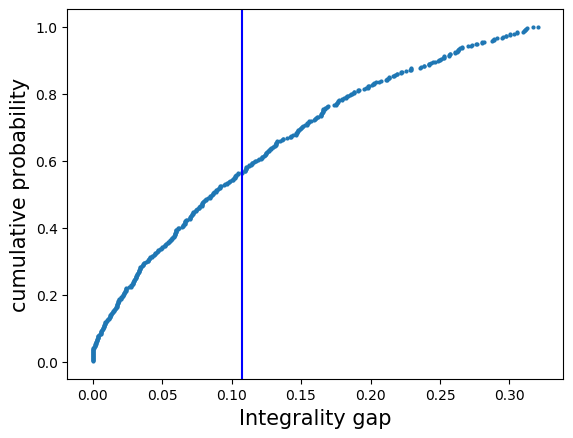

In [177]:
process(data_mn13)

<function matplotlib.pyplot.show(*args, **kw)>

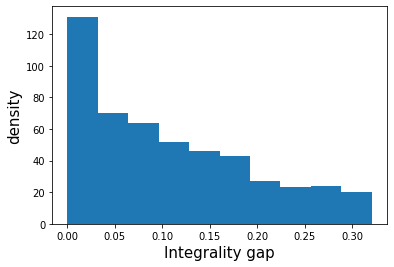

In [140]:
n, bins, patches = plt.hist(data_mn13)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('density', fontsize=15)
plt.show

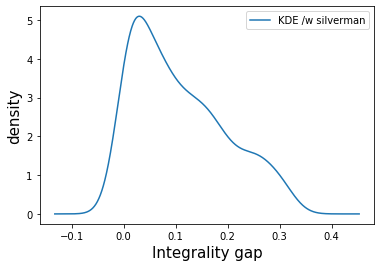

In [141]:
kernelDensity(data_mn13)

In [142]:
from scipy import stats
stats.kstest(data_mn13, 'uniform', args=(min(data_mn12), max(data_mn12)))


KstestResult(statistic=0.278, pvalue=1.1711942361728516e-34)

<function matplotlib.pyplot.show(*args, **kw)>

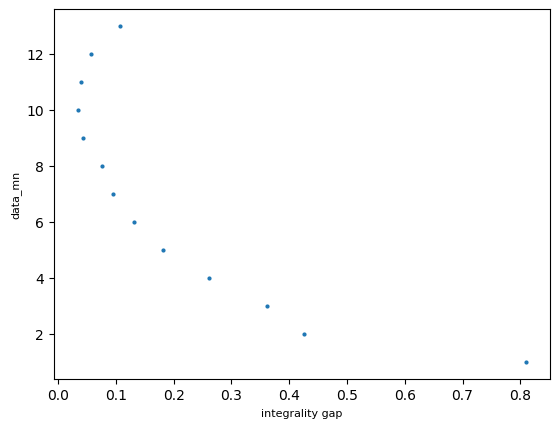

In [356]:
list = [data_mn1,data_mn2,data_mn3,data_mn4,data_mn5,data_mn6,data_mn7,data_mn8,data_mn9,data_mn10,data_mn11,data_mn12, data_mn13]
means = []
count = 0
for i in list:
    count += 1
    means.append((statistics.mean(i), count))

x_val = [x[0] for x in means]
y_val = [x[1] for x in means]
plt.scatter(x=x_val, y=y_val, s = 4);
plt.xlabel('integrality gap', fontsize=8)
plt.ylabel('data_mn', fontsize=8)

plt.show

<function matplotlib.pyplot.show(*args, **kw)>

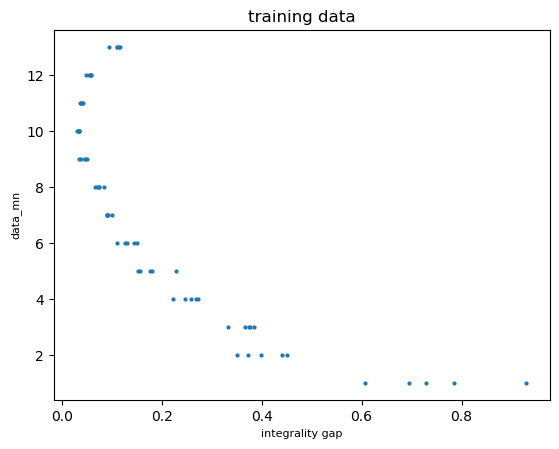

In [368]:
#lets create some training data
list = [data_mn1,data_mn2,data_mn3,data_mn4,data_mn5,data_mn6,data_mn7,data_mn8,data_mn9,data_mn10,data_mn11,data_mn12, data_mn13]
count = 0
means = []
for i in list:
    count += 1
    for j in range(5):
        sample = random.sample(i, 50)
        means.append((statistics.mean(sample), count))

x_val = [x[0] for x in means]
y_val = [x[1] for x in means]
plt.scatter(x=x_val, y=y_val, s = 4);
plt.xlabel('integrality gap', fontsize=8)
plt.ylabel('data_mn', fontsize=8)
plt.title("training data")
plt.show

Degree: 2, R^2 score: 0.5887675560845356
Degree: 3, R^2 score: 0.5974147028136623
Degree: 4, R^2 score: 0.5953254714807733
Degree: 5, R^2 score: 0.5895685437387594


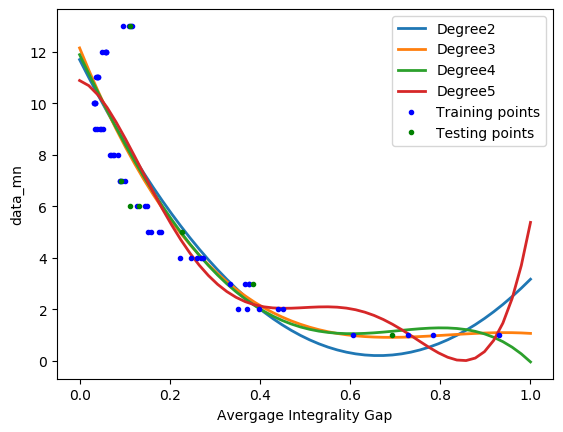

In [386]:
#applying polynomial regression degree 2
x_train, x_test, y_train, y_test = train_test_split(np.array(x_val).reshape(-1,1), np.array(y_val), test_size=0.1, random_state=2)

#applying polynomial regression for different degrees
for i in range(2, 6):
    poly = PolynomialFeatures(degree=i, include_bias=True)
    x_train_trans = poly.fit_transform(x_train)
    x_test_trans = poly.transform(x_test)
    #include bias parameter
    lr = LinearRegression()
    lr.fit(x_train_trans, y_train)
    y_pred = lr.predict(x_test_trans)
    X_new = np.linspace(0, 1, 50).reshape(50, 1)
    X_new_poly = poly.transform(X_new)
    y_new = lr.predict(X_new_poly)
    plt.plot(X_new, y_new, linewidth=2, label=("Degree" + str(i)))
    print("Degree: " + str(i) + ", R^2 score: " + str(r2_score(y_test, y_pred)))

plt.plot(x_train, y_train, "b.",label='Training points')
plt.plot(x_test, y_test, "g.",label='Testing points')
plt.xlabel("Avergage Integrality Gap")
plt.ylabel("data_mn")
plt.legend()
plt.show()


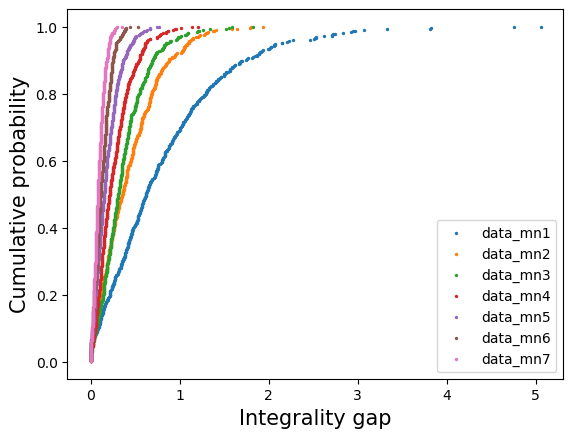

In [181]:
import matplotlib as mpl
list = [data_mn1,data_mn2,data_mn3,data_mn4,data_mn5,data_mn6,data_mn7]
count = 0
for i in list:
    count += 1
    x = np.sort(i)
    n1 = x.size
    y = np.arange(1, n1+1) / n1
    plt.scatter(x=x, y=y, s = 2, label= ('data_mn' + str(count)) )

mpl.rcParams.update(mpl.rcParamsDefault)
plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('Cumulative probability', fontsize=15)
plt.legend()

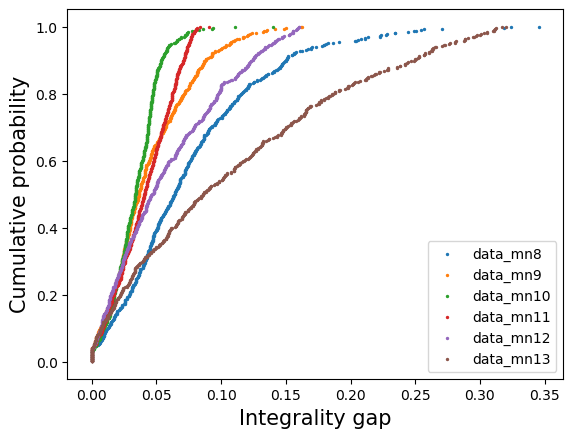

In [178]:
list = [data_mn8,data_mn9,data_mn10,data_mn11,data_mn12, data_mn13]
count = 7
for i in list:
    count += 1
    x = np.sort(i)
    n1 = x.size
    y = np.arange(1, n1+1) / n1
    plt.scatter(x=x, y=y, s = 2, label= ('data_mn' + str(count)) )

plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('Cumulative probability', fontsize=15)
plt.legend()

In [10]:
def calcProbability(m, n, C):
    b = construct_b(m)
    check_b(b, n)
    
    A = generate_A(m, n)
    c = generate_c(n)
    
    original_lp = linear_program(A, b, c, False)
    relaxed_lp = linear_program(A, b, c, True)
    
    IPGAP = relaxed_lp - original_lp
    
    upper_bound_t = (n) / (C * m**2.5 * (m + math.log(n))**2)
    lower_bound_t = 1
    t = random.uniform(lower_bound_t, upper_bound_t)
    
    prob_value = 10**15 * t * ((m**2.5 * (m + math.log(n))**2) / n)
    rhs = 5 * (1 - 1/25)**t + n**-7
    
    return IPGAP, prob_value, rhs, upper_bound_t

In [282]:
#relation between size of the program and the integrality gap
data_c1 = []
for i in range(6,16):
    m_val = i
    n_val = round(i**4.5)
    data_found = the_loop(m_val, n_val, 50)
    data_c1.append((statistics.mean(data_found), i))


[ 1.  1.  1. ...  1.  1. -0.]
Obj: 1245.71
[1. 1. 1. ... 1. 1. 0.]
Obj: 1245.72
1245.7182982406805 relaxed 
1245.7054530296607 original 
[-0. -0. -0. ... -0.  0.  1.]
Obj: 1246.12
[0. 0. 0. ... 0. 0. 1.]
Obj: 1246.12
1246.1226265469804 relaxed 
1246.1162682589888 original 
[ 1.  1. -0. ...  1.  1.  1.]
Obj: 1255.41
[1. 1. 0. ... 1. 1. 1.]
Obj: 1255.46
1255.4625343802757 relaxed 
1255.4069639461875 original 
[0. 0. 1. ... 0. 1. 0.]
Obj: 1258.77
[0. 0. 1. ... 0. 1. 0.]
Obj: 1258.83
1258.8324882649347 relaxed 
1258.768754916628 original 
[0. 0. 1. ... 1. 0. 1.]
Obj: 1300.02
[0. 0. 1. ... 1. 0. 1.]
Obj: 1300.08
1300.082774484259 relaxed 
1300.022022864503 original 
[-0. -0.  1. ...  1.  1.  1.]
Obj: 1269.49
[0. 0. 1. ... 1. 1. 1.]
Obj: 1269.54
1269.5365614269608 relaxed 
1269.4934277386762 original 
[-0.  1. -0. ... -0.  1.  1.]
Obj: 1272.19
[0. 1. 0. ... 0. 1. 1.]
Obj: 1272.3
1272.3022010805046 relaxed 
1272.1939616915934 original 
[-0.  1. -0. ...  1. -0.  1.]
Obj: 1285.27
[0. 1. 0. ... 

[-0.  1. -0. ... -0.  1. -0.]
Obj: 2493.28
[0. 1. 0. ... 0. 1. 0.]
Obj: 2493.36
2493.3627167554423 relaxed 
2493.281256364745 original 
[ 0.  1.  1. ...  1. -0. -0.]
Obj: 2442.12
[0. 1. 1. ... 1. 0. 0.]
Obj: 2442.3
2442.3019181338395 relaxed 
2442.123330869201 original 
[-0. -0.  1. ...  1.  1.  1.]
Obj: 2555.26
[0. 0. 1. ... 1. 1. 1.]
Obj: 2555.33
2555.3334518983897 relaxed 
2555.2562747924057 original 
[ 1. -0. -0. ...  1.  1.  1.]
Obj: 2568.58
[1. 0. 0. ... 1. 1. 1.]
Obj: 2568.7
2568.7041133592065 relaxed 
2568.576886467731 original 
[-0.  1.  1. ...  1.  1. -0.]
Obj: 2578.28
[0. 1. 1. ... 1. 1. 0.]
Obj: 2578.42
2578.4234277500805 relaxed 
2578.2811517388063 original 
[ 1.  1.  1. ... -0.  1. -0.]
Obj: 2424.03
[1. 1. 1. ... 0. 1. 0.]
Obj: 2424.15
2424.1541385738 relaxed 
2424.0342216084596 original 
[ 1.  1. -0. ... -0.  1.  1.]
Obj: 2458.85
[1. 1. 0. ... 0. 1. 1.]
Obj: 2458.87
2458.8721824452323 relaxed 
2458.852433325883 original 
[-0.  1. -0. ... -0.  1. -0.]
Obj: 2510.41
[0. 1. 

[-0. -0. -0. ...  0. -0.  1.]
Obj: 4511.16
[0. 0. 0. ... 0. 0. 1.]
Obj: 4511.2
4511.2007996411185 relaxed 
4511.155409893535 original 
[ 1. -0.  0. ...  1.  1.  1.]
Obj: 4553.91
[1. 0. 0. ... 1. 1. 1.]
Obj: 4553.93
4553.932128129799 relaxed 
4553.906588139823 original 
[-0. -0. -0. ...  1.  1.  1.]
Obj: 4680.42
[0. 0. 0. ... 1. 1. 1.]
Obj: 4680.49
4680.489504852888 relaxed 
4680.420946960798 original 
[-0.  1. -0. ... -0. -0.  1.]
Obj: 4586.08
[0. 1. 0. ... 0. 0. 1.]
Obj: 4586.25
4586.251104137573 relaxed 
4586.076307230501 original 
[-0.  1. -0. ...  1.  1. -0.]
Obj: 4545.24
[0. 1. 0. ... 1. 1. 0.]
Obj: 4545.39
4545.386338540057 relaxed 
4545.242308062431 original 
[ 1.  1.  1. ... -0. -0. -0.]
Obj: 4591.65
[1. 1. 1. ... 0. 0. 0.]
Obj: 4591.84
4591.840206061604 relaxed 
4591.6461968610265 original 
[-0. -0.  1. ... -0. -0.  1.]
Obj: 4514.38
[0. 0. 1. ... 0. 0. 1.]
Obj: 4514.4
4514.4049001417025 relaxed 
4514.380119826425 original 
[ 1. -0. -0. ... -0. -0. -0.]
Obj: 4647.76
[1. 0. 0. .

[-0.  1.  1. ...  1.  1. -0.]
Obj: 7776.17
[0. 1. 1. ... 1. 1. 0.]
Obj: 7776.43
7776.433896707341 relaxed 
7776.17275731801 original 
[-0. -0.  1. ... -0.  0. -0.]
Obj: 7952.6
[0. 0. 1. ... 0. 0. 0.]
Obj: 7952.65
7952.653282184079 relaxed 
7952.603071517144 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 7821.93
[0. 1. 0. ... 1. 1. 1.]
Obj: 7822.3
7822.29523525959 relaxed 
7821.928441459093 original 
[ 1. -0.  1. ...  1.  1. -0.]
Obj: 7910.51
[1. 0. 1. ... 1. 1. 0.]
Obj: 7910.85
7910.853404668548 relaxed 
7910.507121818105 original 
[ 1. -0. -0. ...  1. -0.  1.]
Obj: 7847.87
[1. 0. 0. ... 1. 0. 1.]
Obj: 7848.17
7848.166485051166 relaxed 
7847.8708168865405 original 
[ 1.  1. -0. ... -0.  1.  1.]
Obj: 7776.89
[1. 1. 0. ... 0. 1. 1.]
Obj: 7777.47
7777.4701805264185 relaxed 
7776.885315447867 original 
[1. 0. 0. ... 0. 0. 1.]
Obj: 7793.21
[1. 0. 0. ... 0. 0. 1.]
Obj: 7793.58
7793.584275566568 relaxed 
7793.213414113547 original 
[ 1.  1.  1. ... -0.  1.  1.]
Obj: 7722.91
[1. 1. 1. ... 0. 1. 

[-0.  1. -0. ... -0. -0.  1.]
Obj: 12662.9
[0. 1. 0. ... 0. 0. 1.]
Obj: 12663.6
12663.574345146997 relaxed 
12662.851374325395 original 
[-0. -0. -0. ...  1. -0. -0.]
Obj: 12675.7
[0. 0. 0. ... 1. 0. 0.]
Obj: 12676
12675.98175285185 relaxed 
12675.694243507036 original 
[ 1.  1. -0. ...  1.  1.  1.]
Obj: 12604.2
[1. 1. 0. ... 1. 1. 1.]
Obj: 12604.9
12604.851174987196 relaxed 
12604.158680036822 original 
[-0. -0.  1. ... -0. -0.  0.]
Obj: 12439.4
[0. 0. 1. ... 0. 0. 0.]
Obj: 12440.2
12440.181920141342 relaxed 
12439.402649745043 original 
[-0.  1. -0. ... -0.  1.  1.]
Obj: 12561.2
[0. 1. 0. ... 0. 1. 1.]
Obj: 12561.3
12561.347577184697 relaxed 
12561.183006296329 original 
[ 1.  1.  1. ... -0. -0.  1.]
Obj: 12857.4
[1. 1. 1. ... 0. 0. 1.]
Obj: 12858.2
12858.232176142199 relaxed 
12857.37970647974 original 
[ 1.  0.  1. ...  1. -0.  1.]
Obj: 19346.9
[1. 0. 1. ... 1. 0. 1.]
Obj: 19347.6
19347.641449646515 relaxed 
19346.860127971406 original 
[ 1.  1. -0. ... -0. -0. -0.]
Obj: 19279
[1. 

[0. 1. 0. ... 0. 1. 0.]
Obj: 28472.3
28472.25092902151 relaxed 
28471.117316566015 original 
[ 1.  1. -0. ...  1. -0. -0.]
Obj: 28670.8
[1. 1. 0. ... 1. 0. 0.]
Obj: 28671.8
28671.8484024244 relaxed 
28670.79201946487 original 
[ 1.  1. -0. ... -0.  1.  1.]
Obj: 28208.1
[1. 1. 0. ... 0. 1. 1.]
Obj: 28209
28208.9622108855 relaxed 
28208.149765551632 original 
[ 1.  1.  1. ... -0. -0. -0.]
Obj: 28592
[1. 1. 1. ... 0. 0. 0.]
Obj: 28593.9
28593.856579072977 relaxed 
28591.984326079983 original 
[ 1.  1.  1. ... -0.  1.  1.]
Obj: 28352.7
[1. 1. 1. ... 0. 1. 1.]
Obj: 28353.8
28353.768636294026 relaxed 
28352.727071422407 original 
[ 1.  1. -0. ...  1. -0. -0.]
Obj: 28671.2
[1. 1. 0. ... 1. 0. 0.]
Obj: 28672.6
28672.577777212522 relaxed 
28671.23410635131 original 
[ 1.  1.  1. ... -0. -0.  1.]
Obj: 28708.3
[1. 1. 1. ... 0. 0. 1.]
Obj: 28709.8
28709.849653865676 relaxed 
28708.322092874747 original 
[ 1. -0.  1. ...  1. -0.  1.]
Obj: 28511.5
[1. 0. 1. ... 1. 0. 1.]
Obj: 28511.8
28511.769620411

[-0. -0. -0. ... -0.  1.  1.]
Obj: 40886.8
[0. 0. 0. ... 0. 1. 1.]
Obj: 40888.6
40888.566886553075 relaxed 
40886.786864509646 original 
[-0. -0.  1. ... -0.  1.  1.]
Obj: 41112.7
[0. 0. 1. ... 0. 1. 1.]
Obj: 41113.7
41113.70730665938 relaxed 
41112.66019685293 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 41031.9
[0. 1. 0. ... 1. 1. 1.]
Obj: 41034
41034.0043884658 relaxed 
41031.86976895948 original 
[-0. -0.  1. ...  1.  1.  1.]
Obj: 40862.7
[0. 0. 1. ... 1. 1. 1.]
Obj: 40863.6
40863.55127039483 relaxed 
40862.652355221566 original 
[-0. -0.  1. ...  1. -0.  1.]
Obj: 41056.6
[0. 0. 1. ... 1. 0. 1.]
Obj: 41056.9
41056.918339366835 relaxed 
41056.63027496472 original 
[ 1. -0.  1. ...  1. -0. -0.]
Obj: 41272.5
[1. 0. 1. ... 1. 0. 0.]
Obj: 41274.5
41274.51036361235 relaxed 
41272.51377003973 original 
[-0.  1. -0. ...  1.  1. -0.]
Obj: 41182.4
[0. 1. 0. ... 1. 1. 0.]
Obj: 41184.7
41184.71600981007 relaxed 
41182.43907891512 original 
[-0. -0. -0. ...  1. -0. -0.]
Obj: 41002.9
[0. 0. 0. .

[ 1. -0.  1. ...  1. -0. -0.]
Obj: 57343.1
[1. 0. 1. ... 1. 0. 0.]
Obj: 57345.7
57345.7230153834 relaxed 
57343.06071505884 original 
[ 1.  1.  1. ... -0. -0. -0.]
Obj: 57502.8
[1. 1. 1. ... 0. 0. 0.]
Obj: 57503.7
57503.6682386899 relaxed 
57502.80523535797 original 
[-0. -0.  1. ... -0. -0.  1.]
Obj: 56898.8
[0. 0. 1. ... 0. 0. 1.]
Obj: 56901
56901.04376968279 relaxed 
56898.80029092848 original 
[-0. -0. -0. ...  1.  1.  1.]
Obj: 57055.8
[0. 0. 0. ... 1. 1. 1.]
Obj: 57057.3
57057.33416235972 relaxed 
57055.78953402102 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 57623.3
[1. 1. 0. ... 1. 1. 0.]
Obj: 57624
57623.98672745502 relaxed 
57623.345183253674 original 
[ 1. -0. -0. ...  1.  1. -0.]
Obj: 57945.7
[1. 0. 0. ... 1. 1. 0.]
Obj: 57947.2
57947.21090133191 relaxed 
57945.683948257465 original 
[-0.  1. -0. ... -0. -0. -0.]
Obj: 57468.7
[0. 1. 0. ... 0. 0. 0.]
Obj: 57469.9
57469.89700155904 relaxed 
57468.687542112566 original 
[ 1. -0.  1. ...  1. -0. -0.]
Obj: 57277.3
[1. 0. 1. ... 1

[1. 0. 0. ... 1. 0. 1.]
Obj: 78279
78278.98945061961 relaxed 
78278.28518932642 original 
[-0.  1.  1. ...  1.  1.  1.]
Obj: 78108.4
[0. 1. 1. ... 1. 1. 1.]
Obj: 78111
78110.96043021457 relaxed 
78108.39426805705 original 
[-0.  1. -0. ... -0.  1. -0.]
Obj: 78175.1
[0. 1. 0. ... 0. 1. 0.]
Obj: 78175.3
78175.25894088593 relaxed 
78175.1375822043 original 
[ 1.  1.  1. ...  1. -0.  1.]
Obj: 78404.5
[1. 1. 1. ... 1. 0. 1.]
Obj: 78405.1
78405.05513196845 relaxed 
78404.46205922728 original 
[0. 1. 0. ... 1. 1. 0.]
Obj: 77742.3
[0. 1. 0. ... 1. 1. 0.]
Obj: 77744.4
77744.36859923422 relaxed 
77742.25952182448 original 
[ 1. -0. -0. ...  1. -0.  1.]
Obj: 78338.3
[1. 0. 0. ... 1. 0. 1.]
Obj: 78340.7
78340.70882923028 relaxed 
78338.30709590431 original 
[-0. -0. -0. ... -0.  1. -0.]
Obj: 78365.1
[0. 0. 0. ... 0. 1. 0.]
Obj: 78365.1
78365.08940772033 relaxed 
78365.0823993406 original 
[0. 0. 1. ... 1. 0. 0.]
Obj: 77979.2
[0. 0. 1. ... 1. 0. 0.]
Obj: 77980.4
77980.35711167191 relaxed 
77979.172

<function matplotlib.pyplot.show(*args, **kw)>

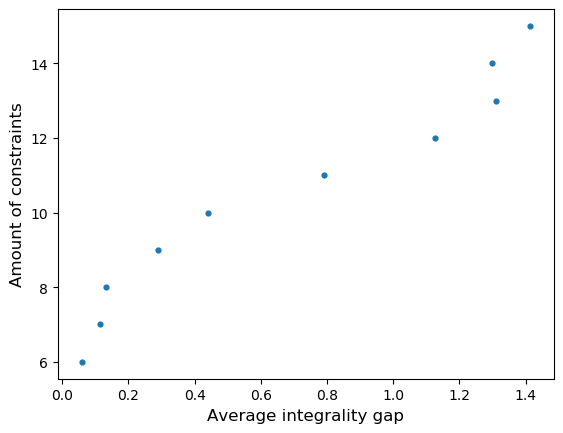

In [342]:
x_val = [x[0] for x in data_c1]
y_val = [x[1] for x in data_c1]
plt.scatter(x=x_val, y=y_val, s = 12);
plt.xlabel('Average integrality gap', fontsize=12)
plt.ylabel('Amount of constraints', fontsize=12)
plt.show

In [344]:
from sklearn.linear_model import LinearRegression
from scipy.optimize import curve_fit

x = np.linspace(0, 2, 20)

x = np.array(x_val).reshape((-1, 1))
y = y_val
model = LinearRegression().fit(x,y)

In [345]:
r_sq = model.score(x, y)
print(f"coefficient of determination: {r_sq}")

t = (model.coef_ - 0)/(np.std(x) * math.sqrt(len(x)))
print('t-value = ' + str(t))

coefficient of determination: 0.9443099344524786
t-value = [3.22006895]


intercept: 6.782983603037632
slope: [5.33119677]


<function matplotlib.pyplot.show(*args, **kw)>

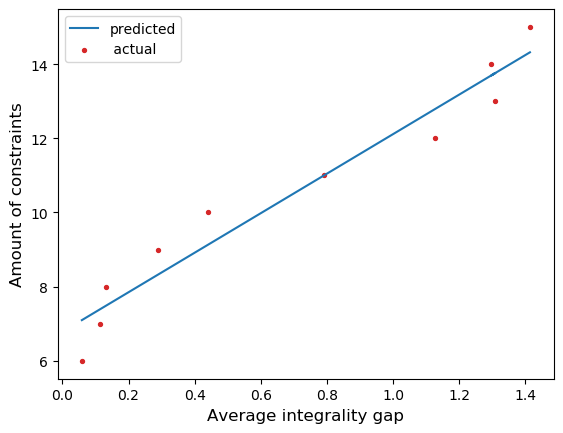

In [346]:
print(f"intercept: {model.intercept_}")
print(f"slope: {model.coef_}")
y_pred = model.intercept_ + model.coef_ * x
plt.plot(x, y_pred, label='predicted')
plt.scatter(x=x, y=y, s = 8, c='#d62728', label=' actual')
plt.xlabel('Average integrality gap', fontsize=12)
plt.ylabel('Amount of constraints', fontsize=12)
plt.legend()
plt.show

In [277]:
#summarizing IPGAP
data_stats = the_loop(14, 150000, 500)

[-0. -0.  1. ...  1.  1.  1.]
Obj: 59834.1
[0. 0. 1. ... 1. 1. 1.]
Obj: 59835.4
59835.370963410074 relaxed 
59834.074342376836 original 
[ 1.  1. -0. ...  1. -0.  1.]
Obj: 59970.5
[1. 1. 0. ... 1. 0. 1.]
Obj: 59972.5
59972.49990525183 relaxed 
59970.47216638781 original 
[ 1.  1. -0. ...  1.  1.  1.]
Obj: 59933.3
[1. 1. 0. ... 1. 1. 1.]
Obj: 59935.2
59935.240826072346 relaxed 
59933.30687598091 original 
[-0. -0. -0. ... -0. -0.  1.]
Obj: 60015.3
[0. 0. 0. ... 0. 0. 1.]
Obj: 60016.7
60016.74862853601 relaxed 
60015.344516627745 original 
[ 1. -0. -0. ...  1. -0. -0.]
Obj: 59504.2
[1. 0. 0. ... 1. 0. 0.]
Obj: 59504.4
59504.392607618815 relaxed 
59504.22023760945 original 
[ 1. -0. -0. ... -0. -0.  1.]
Obj: 59762.8
[1. 0. 0. ... 0. 0. 1.]
Obj: 59764.4
59764.35564048542 relaxed 
59762.805155090755 original 
[-0.  1.  1. ...  1. -0.  1.]
Obj: 59852.5
[0. 1. 1. ... 1. 0. 1.]
Obj: 59853.7
59853.66894169627 relaxed 
59852.46554794987 original 
[ 1.  1.  1. ... -0.  1.  1.]
Obj: 59937.6
[1. 1.

[0. 1. 1. ... 1. 0. 0.]
Obj: 59914.8
59914.80005423432 relaxed 
59914.074171354594 original 
[-0. -0. -0. ...  1. -0.  1.]
Obj: 59979.5
[0. 0. 0. ... 1. 0. 1.]
Obj: 59980.3
59980.31107293245 relaxed 
59979.51108739151 original 
[-0. -0.  1. ... -0. -0. -0.]
Obj: 59600.5
[0. 0. 1. ... 0. 0. 0.]
Obj: 59601.8
59601.827028599226 relaxed 
59600.48982653031 original 
[-0.  1.  1. ... -0.  1. -0.]
Obj: 59720.7
[0. 1. 1. ... 0. 1. 0.]
Obj: 59722.6
59722.57657347757 relaxed 
59720.74307434383 original 
[-0. -0. -0. ... -0.  1. -0.]
Obj: 59649.5
[0. 0. 0. ... 0. 1. 0.]
Obj: 59650.3
59650.32529312581 relaxed 
59649.5279781787 original 
[-0. -0.  1. ... -0. -0. -0.]
Obj: 59901.7
[0. 0. 1. ... 0. 0. 0.]
Obj: 59904.7
59904.73049125931 relaxed 
59901.73461715542 original 
[ 1. -0. -0. ... -0.  1. -0.]
Obj: 59996.3
[1. 0. 0. ... 0. 1. 0.]
Obj: 59997.2
59997.21911408715 relaxed 
59996.28567808828 original 
[ 1.  1.  1. ...  1. -0.  1.]
Obj: 59509.2
[1. 1. 1. ... 1. 0. 1.]
Obj: 59510.6
59510.64736668716

[0. 0. 1. ... 1. 0. 0.]
Obj: 59676.5
59676.46130945182 relaxed 
59675.41375722336 original 
[-0. -0. -0. ...  1.  1.  1.]
Obj: 59817.1
[0. 0. 0. ... 1. 1. 1.]
Obj: 59818
59818.005091013634 relaxed 
59817.13645747886 original 
[ 1.  1. -0. ...  1. -0. -0.]
Obj: 59755.7
[1. 1. 0. ... 1. 0. 0.]
Obj: 59757.3
59757.28748170291 relaxed 
59755.6648035698 original 
[ 1.  1. -0. ... -0. -0.  1.]
Obj: 60196.4
[1. 1. 0. ... 0. 0. 1.]
Obj: 60198.6
60198.614106023866 relaxed 
60196.36086989522 original 
[-0.  1. -0. ... -0. -0. -0.]
Obj: 59618.9
[0. 1. 0. ... 0. 0. 0.]
Obj: 59619.1
59619.123022534775 relaxed 
59618.85678506291 original 
[ 1.  1.  1. ...  1. -0. -0.]
Obj: 59954.6
[1. 1. 1. ... 1. 0. 0.]
Obj: 59958.9
59958.934698198325 relaxed 
59954.6102897845 original 
[ 1. -0. -0. ... -0.  1. -0.]
Obj: 59841.9
[1. 0. 0. ... 0. 1. 0.]
Obj: 59844.6
59844.59652932291 relaxed 
59841.93032579401 original 
[ 1. -0. -0. ...  1. -0.  1.]
Obj: 59903
[1. 0. 0. ... 1. 0. 1.]
Obj: 59904.1
59904.10648216704 re

[1. 0. 1. ... 0. 1. 1.]
Obj: 59763.5
59763.45387619082 relaxed 
59762.12496119584 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 60000.5
[1. 1. 0. ... 1. 1. 0.]
Obj: 60001.1
60001.093154765025 relaxed 
60000.45440266349 original 
[ 1.  1. -0. ...  1.  1. -0.]
Obj: 59513.2
[1. 1. 0. ... 1. 1. 0.]
Obj: 59516.7
59516.73367216365 relaxed 
59513.154369787546 original 
[ 1. -0. -0. ... -0. -0.  1.]
Obj: 59937.6
[1. 0. 0. ... 0. 0. 1.]
Obj: 59940.8
59940.83803150512 relaxed 
59937.64517209754 original 
[-0. -0. -0. ...  1. -0. -0.]
Obj: 59580.5
[0. 0. 0. ... 1. 0. 0.]
Obj: 59581.3
59581.27160564907 relaxed 
59580.45737354644 original 
[ 1.  1. -0. ... -0. -0.  1.]
Obj: 59840.6
[1. 1. 0. ... 0. 0. 1.]
Obj: 59842
59841.99996911763 relaxed 
59840.572252286205 original 
[-0. -0. -0. ...  1.  1. -0.]
Obj: 60236.4
[0. 0. 0. ... 1. 1. 0.]
Obj: 60237.5
60237.47319503152 relaxed 
60236.40026780669 original 
[ 1.  1. -0. ...  1. -0.  1.]
Obj: 59981.6
[1. 1. 0. ... 1. 0. 1.]
Obj: 59983.7
59983.71786231144

[0. 0. 1. ... 0. 0. 0.]
Obj: 59660.4
59660.35341038791 relaxed 
59658.91516209432 original 
[ 1. -0.  1. ... -0.  1. -0.]
Obj: 59358.3
[1. 0. 1. ... 0. 1. 0.]
Obj: 59360.2
59360.185480528955 relaxed 
59358.340198305275 original 
[-0. -0.  1. ...  1.  1. -0.]
Obj: 59828.8
[0. 0. 1. ... 1. 1. 0.]
Obj: 59829.2
59829.174524461334 relaxed 
59828.84704056599 original 
[-0. -0.  1. ...  1. -0. -0.]
Obj: 59900.9
[0. 0. 1. ... 1. 0. 0.]
Obj: 59902.7
59902.672966983184 relaxed 
59900.911150169326 original 
[-0.  1. -0. ...  1. -0.  1.]
Obj: 59906.5
[0. 1. 0. ... 1. 0. 1.]
Obj: 59909
59908.962062977116 relaxed 
59906.53861986305 original 
[-0.  1.  1. ... -0. -0.  1.]
Obj: 59991.8
[0. 1. 1. ... 0. 0. 1.]
Obj: 59993.4
59993.37235524388 relaxed 
59991.84400174999 original 
[ 1.  1.  1. ... -0. -0.  1.]
Obj: 59838.7
[1. 1. 1. ... 0. 0. 1.]
Obj: 59839
59838.96701698358 relaxed 
59838.7315852296 original 
[-0.  1. -0. ...  1.  1.  1.]
Obj: 59790.5
[0. 1. 0. ... 1. 1. 1.]
Obj: 59793.7
59793.70043804395

[1. 0. 1. ... 0. 1. 1.]
Obj: 59707.4
59707.36968439963 relaxed 
59706.45538713173 original 
[ 1.  1. -0. ... -0.  1. -0.]
Obj: 59721.2
[1. 1. 0. ... 0. 1. 0.]
Obj: 59723.4
59723.39091163221 relaxed 
59721.1835861873 original 
[-0.  1. -0. ... -0. -0. -0.]
Obj: 60231.8
[0. 1. 0. ... 0. 0. 0.]
Obj: 60232.5
60232.53433083234 relaxed 
60231.78369190175 original 
[ 1.  1.  1. ... -0. -0.  1.]
Obj: 59856.8
[1. 1. 1. ... 0. 0. 1.]
Obj: 59859.1
59859.08732537852 relaxed 
59856.7765387828 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 59515.9
[0. 1. 1. ... 0. 0. 0.]
Obj: 59516.9
59516.86575084701 relaxed 
59515.89570826011 original 
[ 1.  1.  1. ...  1. -0.  1.]
Obj: 59449.8
[1. 1. 1. ... 1. 0. 1.]
Obj: 59450.9
59450.85075515499 relaxed 
59449.827704732204 original 
[1. 1. 1. ... 0. 0. 1.]
Obj: 60266.2
[1. 1. 1. ... 0. 0. 1.]
Obj: 60268.4
60268.37549379121 relaxed 
60266.23872012186 original 
[-0. -0.  1. ...  1. -0.  1.]
Obj: 59818.4
[0. 0. 1. ... 1. 0. 1.]
Obj: 59822.1
59822.09575428331 relaxed

[1. 0. 1. ... 1. 1. 1.]
Obj: 59699.1
59699.114013093305 relaxed 
59698.27574105319 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 60042.8
[0. 1. 1. ... 0. 0. 0.]
Obj: 60046.6
60046.56468033245 relaxed 
60042.8220825288 original 
[-0.  1. -0. ... -0. -0.  1.]
Obj: 59571.7
[0. 1. 0. ... 0. 0. 1.]
Obj: 59572.3
59572.34394118892 relaxed 
59571.65940457375 original 
[-0. -0.  1. ... -0. -0. -0.]
Obj: 59645.1
[0. 0. 1. ... 0. 0. 0.]
Obj: 59649.1
59649.11536369594 relaxed 
59645.09078908792 original 
[-0. -0. -0. ... -0. -0. -0.]
Obj: 60025.7
[0. 0. 0. ... 0. 0. 0.]
Obj: 60027.2
60027.24950995586 relaxed 
60025.717040683114 original 
[ 1. -0. -0. ...  1.  1. -0.]
Obj: 60046.1
[1. 0. 0. ... 1. 1. 0.]
Obj: 60046.6
60046.57920758293 relaxed 
60046.118223233316 original 
[-0.  1.  1. ... -0. -0. -0.]
Obj: 60153.9
[0. 1. 1. ... 0. 0. 0.]
Obj: 60155.6
60155.60117391888 relaxed 
60153.9167669005 original 
[-0. -0. -0. ...  1.  1.  1.]
Obj: 59501.5
[0. 0. 0. ... 1. 1. 1.]
Obj: 59501.6
59501.61837238126

[1. 0. 1. ... 1. 1. 1.]
Obj: 59648.3
59648.26042251786 relaxed 
59647.497180690305 original 
[ 1.  1.  1. ... -0.  1.  1.]
Obj: 59635
[1. 1. 1. ... 0. 1. 1.]
Obj: 59635
59635.04124084764 relaxed 
59634.95856658616 original 
[ 1. -0.  1. ...  1. -0.  1.]
Obj: 60179
[1. 0. 1. ... 1. 0. 1.]
Obj: 60180.6
60180.58188246961 relaxed 
60178.9783955472 original 
[-0.  1. -0. ... -0.  1.  1.]
Obj: 59942.1
[0. 1. 0. ... 0. 1. 1.]
Obj: 59943.5
59943.50279414714 relaxed 
59942.0608520515 original 
[ 1.  1. -0. ...  1.  1.  1.]
Obj: 59874.8
[1. 1. 0. ... 1. 1. 1.]
Obj: 59876.2
59876.238831554394 relaxed 
59874.76363274052 original 
[ 1.  1.  1. ... -0. -0. -0.]
Obj: 60298.2
[1. 1. 1. ... 0. 0. 0.]
Obj: 60300.4
60300.39929749476 relaxed 
60298.160517401964 original 
[0. 0. 0. ... 1. 0. 1.]
Obj: 59240.2
[0. 0. 0. ... 1. 0. 1.]
Obj: 59240.8
59240.831175205814 relaxed 
59240.18971361108 original 
[ 1.  1.  1. ...  1. -0. -0.]
Obj: 59559.5
[1. 1. 1. ... 1. 0. 0.]
Obj: 59561.8
59561.80618528918 relaxed 
5

[0. 1. 0. ... 1. 0. 0.]
Obj: 60065.1
60065.10579933053 relaxed 
60063.0365088923 original 
[-0. -0.  1. ...  1.  1. -0.]
Obj: 59965.5
[0. 0. 1. ... 1. 1. 0.]
Obj: 59968
59968.01490798981 relaxed 
59965.47479666855 original 
[-0. -0.  1. ... -0.  1.  1.]
Obj: 60131.7
[0. 0. 1. ... 0. 1. 1.]
Obj: 60132.8
60132.783472524236 relaxed 
60131.65257467212 original 
[-0. -0. -0. ... -0. -0. -0.]
Obj: 59831.1
[0. 0. 0. ... 0. 0. 0.]
Obj: 59833.3
59833.32385396252 relaxed 
59831.0980593822 original 
[ 1. -0. -0. ...  1.  1. -0.]
Obj: 60118.5
[1. 0. 0. ... 1. 1. 0.]
Obj: 60118.5
60118.523951984054 relaxed 
60118.521655403085 original 
[-0. -0.  1. ... -0.  1. -0.]
Obj: 59710.3
[0. 0. 1. ... 0. 1. 0.]
Obj: 59711.3
59711.30485732688 relaxed 
59710.29117460987 original 
[ 1. -0.  1. ... -0.  1. -0.]
Obj: 59859.4
[1. 0. 1. ... 0. 1. 0.]
Obj: 59859.8
59859.78804739717 relaxed 
59859.42303535292 original 
[1. 1. 0. ... 0. 1. 0.]
Obj: 59635.3
[1. 1. 0. ... 0. 1. 0.]
Obj: 59638.2
59638.20148783911 relaxed

mean: 1.4451686283053713
median: 1.2597740318633441
standard deviation:0.9471468947411767


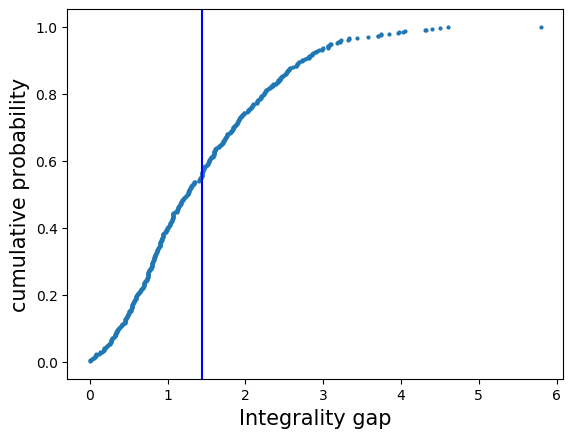

In [391]:
process(data_stats)

<function matplotlib.pyplot.show(*args, **kw)>

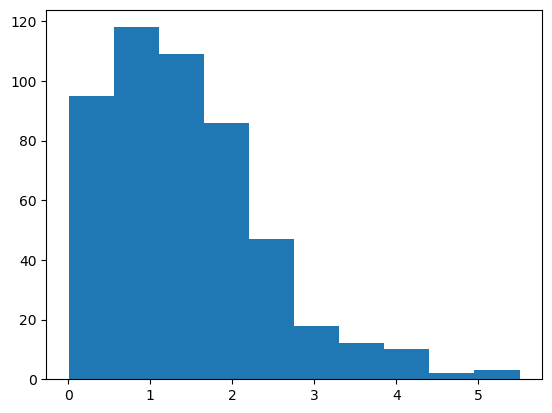

In [192]:
n, bins, patches = plt.hist(data_stats)
plt.show

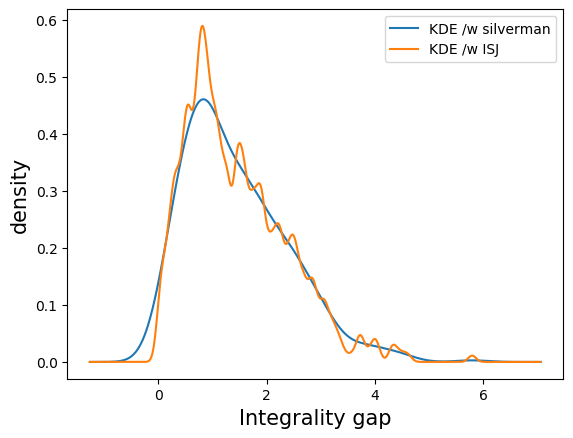

In [394]:
kernelDensity(data_stats)

In [194]:
#testing gamma distribution, first we estimate alpha and beta
total_sum = 0
log_sum = 0
xlog_sum = 0
n = len(data_stats)
for i in data_stats:
    total_sum += i
    log_sum += math.log(i)
    xlog_sum += (i * math.log(i))
    
alpha = (n*total_sum)/(n*xlog_sum - total_sum * log_sum)
beta = (1/n**2)*(n*xlog_sum - total_sum * log_sum)
print(alpha)
print(beta)

1.841288333758827
0.776746277106869


In [389]:
from scipy.stats import shapiro, kstest
data_stats = np.sort(data_stats)
kstest(data_stats, 'gamma', args=(alpha, 0, beta))

KstestResult(statistic=0.04967261372620435, pvalue=0.16404560250234962)

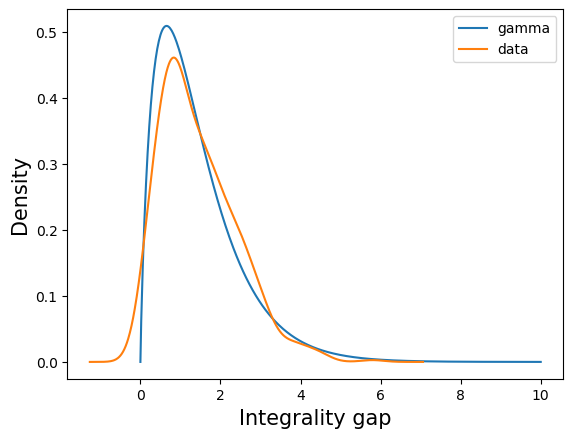

In [390]:
import scipy.stats as stats 

x = np.linspace(0,10,500)
y = stats.gamma.pdf(x, a=alpha, scale=beta)
plt.plot(x,y, label='gamma')
x_fit, y_fit = FFTKDE(kernel='gaussian', bw='silverman').fit(data_stats).evaluate()
plt.plot(x_fit, y_fit,label="data")

plt.xlabel('Integrality gap', fontsize=15)
plt.ylabel('Density', fontsize=15)
plt.legend()
plt.show()

Text(0, 0.5, 'Density')

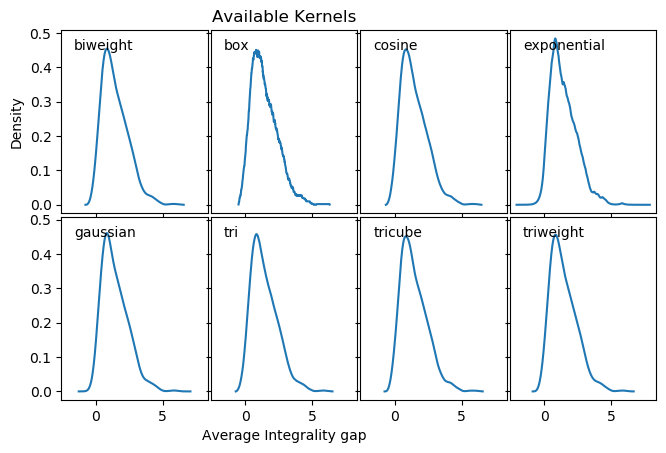

In [288]:
fig, ax = plt.subplots(2, 4, sharex=True, sharey=True)
fig.subplots_adjust(left=0.02, right=0.95, hspace=0.02, wspace=0.02)

for i, kernel in enumerate(
    ['biweight', 'box', 'cosine', 'exponential', 'gaussian', 'tri', 'tricube', 'triweight']
):
    axi = ax.ravel()[i]
    x, y = FFTKDE(kernel=kernel, bw='silverman').fit(data_stats).evaluate()
    axi.plot(x, y, label=('KDE /w ' + kernel))
    axi.text(-1.6, 0.45, kernel)

    #y = FFTKDE(kernel='gaussian', bw='ISJ').fit(data).evaluate(x)
    #plt.plot(x, y, label='KDE /w ISJ')

ax[0,1].set_title("Available Kernels")
ax[1,1].set_xlabel('Average Integrality gap')
ax[0,0].set_ylabel('Density')